In [1]:
import pandas as pd
import csv
import os

import linecache
import sys

import matplotlib.pyplot as plt
import math
import plotly.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.graph_objs as go

#from prettytable import PrettyTable

#簡轉繁用 
#https://pypi.python.org/pypi/hanziconv/0.2.1
from hanziconv import HanziConv

import matplotlib_venn 
from matplotlib_venn import venn2, venn2_circles


import numpy as np
from sklearn.model_selection import train_test_split

from sklearn.metrics import mean_squared_error
from numpy import mean, sqrt, square, arange

import pickle

import random
import datetime
import operator

from mylib.PrintException  import PrintException
from mylib.is_chinese import is_chinese
from mylib.is_number import is_number
from mylib.Taiwan_name_seperate import GetFirstName
from mylib.Taiwan_name_seperate import GetLastName
from mylib.Taiwan_name_seperate import checkLastName
from mylib.Taiwan_name_seperate import is_biFirstName
from mylib.findSimName import findSimName


In [2]:
def name_char_add_to_dic(name,i):
    for c in name:
        if(c in name_rate_dic_list[i] ):
            name_rate_dic_list[i][c]+= 1
        else:
            name_rate_dic_list[i][c] = 1 

            
def name_evolve_5(name_rate_dic_list, data_df,Exam):
    #1940~2005  5歲一區間
    
    for i in range(0,14):
        ocr_total_char = 0
        for j in range(5):
            orc_year = 1958+i*5+j
            FB_year = 1940+i*5+j
            no_orc_year = False
            if str(orc_year) in Missing_year_list or orc_year>2000:
                no_orc_year = True

            #Total_df時Exam=True,1976~1982不看OCR
            if Exam and orc_year>=1994 and orc_year<=2000:
                no_orc_year = True
                
            if(no_orc_year==False):
                for  c in year_character_dic[str(orc_year)]:
                    ocr_total_char+=year_character_dic[str(orc_year)][c]
                    if(c in name_rate_dic_list[i] ):
                        name_rate_dic_list[i][c]+= year_character_dic[str(orc_year)][c]
                    else:
                        name_rate_dic_list[i][c] = year_character_dic[str(orc_year)][c]

        FB_year = 1940+i*5
        FB_name_list = data_df[data_df.message.apply(lambda x: x>=FB_year and x<FB_year+5)].name.tolist()
        FB_total_char=0
        
        tmp_dic = {}

        for name in FB_name_list:
            FB_total_char+=len(name)
            for c in name:
                if(c in name_rate_dic_list[i] ):
                    name_rate_dic_list[i][c]+= 1
                else:
                    name_rate_dic_list[i][c] = 1        
                    
        #根據此字出現在姓和名中的比例來調整次數    
        Total_char = 0
        for c in name_rate_dic_list[i]:
            char = c[0]
            if(char in LF_common_char_intersection_ratio_dict): 
                 name_rate_dic_list[i][char] = name_rate_dic_list[i][char] * (1- LF_common_char_intersection_ratio_dict[char]) 
            Total_char+=name_rate_dic_list[i][char]
            
        print(1940+i*5,"DF:",FB_total_char,"OCR:",ocr_total_char,"Total:",Total_char)
        
        for c in name_rate_dic_list[i]:
            name_rate_dic_list[i][c]/= Total_char
    

In [3]:
def wrtie_csv_df(row,File_csv,columns):
    output_string = ''
   
    row_len = len(columns)
    for index,i in enumerate(columns) :
        if index != (row_len-1):
            output_string+=(str(row[i])+',')
        else:
            output_string+=(str(row[i]))
    output_string+=('\n')
    File_csv.write(output_string)
    
def save_df_to_csv(data_df,path,FileName):
    
    File_csv =  open(path+FileName+'.csv','w')
    
    output_string = ''
    row_len = len(data_df.columns.values)
    for index,i in enumerate(data_df.columns.values): 
        if index != (row_len-1):
            output_string+=(i+',')
        else:
            output_string+=(i)
    output_string+='\n'   
    File_csv.write(output_string)
    
    
    data_df.apply(lambda row: wrtie_csv_df(row,File_csv,data_df.columns.values) ,axis=1)
    File_csv.close()

# Read current files

In [4]:
with open('./data_output/intersection_name_dict.txt', 'rb') as handle:
    intersection_name_dict = pickle.loads(handle.read())

with open('./data_output/LF_common_char_intersection_ratio_dict.txt', 'rb') as handle:
    LF_common_char_intersection_ratio_dict = pickle.loads(handle.read())

#print(intersection_name_dict[1984])
with open('./data_output/Simchar_list.txt', 'rb') as handle:
    Simchar_list = pickle.loads(handle.read())


In [5]:
#vector
with open('./data_output/final/vector/DF_dict.txt', 'rb') as handle:
    DF_dict = pickle.loads(handle.read())

with open('./data_output/final/vector/single_common_char_TF_IDF_dict.txt', 'rb') as handle:
    single_common_char_TF_IDF_dict = pickle.loads(handle.read())

with open('./data_output/final/vector/sorted_TF_IDF_dict.txt', 'rb') as handle:
    sorted_TF_IDF_dict = pickle.loads(handle.read())
    
with open('./data_output/final/vector/TF_dict.txt', 'rb') as handle:
    TF_dict = pickle.loads(handle.read())

In [6]:
#
    
with open('./data_output/final/specail_word_dict.txt', 'rb') as handle:
    specail_word_dict = pickle.loads(handle.read())
    
with open('./data_output/final/moe_additional_dict.txt', 'rb') as handle:
    moe_additional_dict = pickle.loads(handle.read())

with open('./data_output/final/radical_list.txt', 'rb') as handle:
    radical_list = pickle.loads(handle.read())

with open('./data_output/final/Totalname_list.txt', 'rb') as handle:
    Totalname_list = pickle.loads(handle.read())
    
with open('./data_output/final/son_in_list.txt', 'rb') as handle:
    son_in_list = pickle.loads(handle.read())
    
with open('./data_output/final/moe_data_dict.txt', 'rb') as handle:
    moe_data_dict = pickle.loads(handle.read())
    
with open('./data_output/final/mu_in_list.txt', 'rb') as handle:
    mu_in_list = pickle.loads(handle.read())


In [448]:
# filename = './data_output/final/prob/hope/test_index'
# pickle.dump(test_index,open(filename, 'wb'))

# filename = './data_output/final/prob/hope/train_index'
# pickle.dump(train_index,open(filename, 'wb'))

# filename = './data_output/final/prob/hope/trained_model'
# pickle.dump(trained_model,open(filename, 'wb'))

filename = './data_output/final/prob/hope/x_feature'
pickle.dump(x_feature,open(filename, 'wb'))

In [ ]:
filename = './data_output/final/prob/hope/rs_comprae_trained_model'
pickle.dump(rs_comprae_trained_model,open(filename, 'wb'))

In [7]:
# -*- coding: utf-8 -*-
import operator
import editdistance

#得取OCR 出來的榜單資料
#1958-2000年榜單　37份（缺6年）　1988　1989 1990　1991　1992　1994　
#1940-1982　出生
#77歲-35歲

Path ='../univeristyName/'
year_character_dic = {}
Missing_year_list = ['1988','1989','1990','1991','1992','1994']
for root, dirs, fileNames in os.walk(Path):
    if fileNames ==[]:
        continue
    for fileName in fileNames:
        try:
            with open(root+"/"+fileName ,'r',encoding = 'utf-8') as F:
                character_dic = {}
                #一行一行讀
                for line in F.readlines():
                    #print(line)
                    for character in line:
                        if is_chinese(character)==True and findSimName(character)==False:
                            if (character in character_dic):
                                character_dic[character]+=1
                            else:
                                character_dic[character] = 1 
                year_character_dic[fileName[:4]] = character_dic
            
        except Exception as e:
            print (e)
            print (fileName)
            PrintException() 

In [457]:
#Real name
#Path = './data_output/final/0.93/resampled_Real_data_df.csv'
Path = './data_output/final/prob/resampled_Real_data_df.csv'
resampled_Real_data_df = pd.read_csv(Path, dtype='str')

In [416]:
#Real name
#Path = './data_output/final/0.93/resampled_FB_data_df.csv'
Path = './data_output/final/prob/resampled_FB_data_df.csv'

resampled_FB_data_df = pd.read_csv(Path, dtype='str')

In [458]:
def restore_correct_type(Total_df,mode):
    Total_df['BirthYear'] = Total_df.BirthYear.apply(lambda x: int(x))
    Total_df['FN1'] = Total_df.FN1.apply(lambda x: int(x))
    Total_df['FN2'] = Total_df.FN2.apply(lambda x: int(x))
    
    Total_df['GuessedGender'] = Total_df.GuessedGender.apply(lambda x: int(float(x)))
    
    Total_df['BFN12P'] = Total_df.BFN12P.apply(lambda x: int(x))
    
    Total_df['天格'] = Total_df.天格.apply(lambda x: int(x))
    Total_df['人格'] = Total_df.人格.apply(lambda x: int(x))
    Total_df['地格'] = Total_df.地格.apply(lambda x: int(x))
    Total_df['外格'] = Total_df.外格.apply(lambda x: int(x))
    Total_df['總格'] = Total_df.總格.apply(lambda x: int(x))

    Total_df['FN1_sonin_index'] = Total_df.FN1_sonin_index.apply(lambda x: int(x))
    Total_df['FN2_sonin_index'] = Total_df.FN2_sonin_index.apply(lambda x: int(x))
    Total_df['FN1_muin_index'] = Total_df.FN1_muin_index.apply(lambda x: int(x))
    Total_df['FN2_muin_index'] = Total_df.FN2_muin_index.apply(lambda x: int(x))
    
    Total_df['FN1_radical_index'] = Total_df.FN1_radical_index.apply(lambda x: int(x))
    Total_df['FN2_radical_index'] = Total_df.FN2_radical_index.apply(lambda x: int(x))
    
    Total_df['Female_prob'] = Total_df.Female_prob.apply(lambda x: float(x))
    Total_df['Male_prob'] = Total_df.Male_prob.apply(lambda x: float(x))
    if mode=='real':
        Total_df['FN12PY0'] = Total_df.FN12PY0.apply(lambda x: float(x))
        Total_df['FN12PY1'] = Total_df.FN12PY1.apply(lambda x: float(x))
        Total_df['FN12PY2'] = Total_df.FN12PY2.apply(lambda x: float(x))
        Total_df['FN12PY3'] = Total_df.FN12PY3.apply(lambda x: float(x))
        Total_df['FN12PY4'] = Total_df.FN12PY4.apply(lambda x: float(x))
        Total_df['FN12PY5'] = Total_df.FN12PY5.apply(lambda x: float(x))
        Total_df['FN12PY6'] = Total_df.FN12PY6.apply(lambda x: float(x))
    Total_df['FN12PY7'] = Total_df.FN12PY7.apply(lambda x: float(x))
    Total_df['FN12PY8'] = Total_df.FN12PY8.apply(lambda x: float(x))
    Total_df['FN12PY9'] = Total_df.FN12PY9.apply(lambda x: float(x))
    Total_df['FN12PY10'] = Total_df.FN12PY10.apply(lambda x: float(x))
    
    if mode=='FB':
        Total_df['FN12PY11'] = Total_df.FN12PY11.apply(lambda x: float(x))
        Total_df['FN12PY12'] = Total_df.FN12PY12.apply(lambda x: float(x))
        Total_df['FN12PY13'] = Total_df.FN12PY13.apply(lambda x: float(x))
    return Total_df

In [417]:
#resampled_Real_data_df = restore_correct_type(resampled_Real_data_df,'Real')
resampled_FB_data_df = restore_correct_type(resampled_FB_data_df,'FB')

In [423]:
resampled_FB_data_df.columns.values

array(['name', 'message', 'userID', 'LastName', 'FirstName', 'FN1', 'FN2',
       'FN1_sonin', 'FN1_muin', 'FN2_sonin', 'FN2_muin', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index',
       'FN1_radical', 'FN2_radical', 'FN1_radical_index',
       'FN2_radical_index', 'BirthYear', 'GuessedGender', '天格', '人格', '地格',
       '外格', '總格', 'FN12PY7', 'FN12PY8', 'FN12PY9', 'FN12PY10', 'FN12PY11',
       'FN12PY12', 'FN12PY13', 'BFN12P', 'FirstName1', 'FirstName2',
       'Female_prob', 'Male_prob'], dtype=object)

In [9]:
resampled_Real_data_df[resampled_Real_data_df.FirstName.apply(lambda x:len(x)==1)]

,FirstName,LastName,gender,message,name,FN1,FN2,FN1_sonin,FN1_muin,FN2_sonin,...,FN12PY6,FN12PY7,FN12PY8,FN12PY9,FN12PY10,BFN12P,FirstName1,FirstName2,Female_prob,Male_prob


In [424]:
resampled_FB_data_df[resampled_FB_data_df.FirstName.apply(lambda x:len(x)==1)]

,name,message,userID,LastName,FirstName,FN1,FN2,FN1_sonin,FN1_muin,FN2_sonin,...,FN12PY9,FN12PY10,FN12PY11,FN12PY12,FN12PY13,BFN12P,FirstName1,FirstName2,Female_prob,Male_prob


In [27]:
resampled_Real_data_df.loc[3788].FirstName=' 嘯'

/usr/local/lib/python3.5/dist-packages/pandas/core/generic.py:2999: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [7]:
def make_nameto2(FN):
    if len(FN)==1:
        return ' '+FN
    else:
        return FN

In [8]:
resampled_Real_data_df['FirstName'] = resampled_Real_data_df.FirstName.apply(lambda x:make_nameto2(x))


# Random Forest Classifier Function

In [445]:
## from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

def dataset_statistics(dataset):
    """
    Basic statistics of the dataset
    :param dataset: Pandas dataframe
    :return: None, print the basic statistics of the dataset
    """
    print (dataset.describe())
    
#http://dataaspirant.com/2017/06/26/random-forest-classifier-python-scikit-learn/
#Split train and test
def split_dataset(dataset, train_percentage, feature_headers, target_header):
    """
    Split the dataset with train_percentage
    :param dataset:
    :param train_percentage:
    :param feature_headers:
    :param target_header:
    :return: train_x, test_x, train_y, test_y
    """

    # Split dataset into train and test dataset
    train_x, test_x, train_y, test_y = train_test_split(dataset[feature_headers], dataset[target_header],
                                                        train_size=train_percentage)
    return train_x, test_x, train_y, test_y

def random_forest_classifier(features, target):
    """
    To train the random forest classifier with features and target data
    :param features:
    :param target:
    :return: trained random forest classifier
    """
    clf = RandomForestClassifier(n_estimators=32,n_jobs=4 , min_samples_leaf =1)
    clf.fit(features, target)
    return clf

In [212]:
def basic_RFClassifier(data_df,x_feature,y_feature,Validation_times):

    #N fold cross-validation
    Train_accuracy_score=0
    Test_accuracy_score=0
    
    
    for i in range(Validation_times):
        train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)
 
        # Create random forest classifier instance
        trained_model = random_forest_classifier(train_x, train_y)


        predictions = trained_model.predict(test_x)

        # Train and Test Accuracy
        if(Validation_times!=1):
            print('Run times:',i+1)
        print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
        print ("Test Accuracy  :: ", accuracy_score(test_y, predictions))
        #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

        Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
        Test_accuracy_score+= accuracy_score(test_y, predictions)
        #calculate_error( predictions, test_y )
        #validate_error( predictions, test_y,test_x ,data_df)
        
    if(Validation_times!=1):
        Train_accuracy_score/=Validation_times
        Test_accuracy_score/=Validation_times
        print ("Average Train Accuracy :: ", Train_accuracy_score)
        print ("Average Test Accuracy  :: ",Test_accuracy_score)
    
    return trained_model

In [14]:
def get_test_name_dict_list(test_x,test_y,data_df):
    test_name_dict_list = {}
    for index in range(len(test_x)):
        #FN = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
        
        #print(FN)
        #df_index = test_x.iloc[index].name
    #             FN = data_df.loc[df_index].FirstName
        FN = data_df.loc[ test_x.iloc[index].name ].FirstName
        year = test_y.iloc[index]['BirthYear']
        #print(year)
        if FN in test_name_dict_list:
            if year  not in test_name_dict_list[FN]:
                test_name_dict_list[FN][year] =1
            else:
                test_name_dict_list[FN][year]+=1
        else:
            test_name_dict_list[FN] = {}
            test_name_dict_list[FN][year] =1
            
    return test_name_dict_list

In [452]:
def get_test_name_dict_list2(test_index,data_df,year_column):
    test_name_dict_list = {}
    FN_list = data_df.loc[test_index]['FirstName'].tolist()
    #year- message / birthyear
    Year_list = data_df.loc[test_index][year_column].tolist()
    for index in range(len(FN_list)):
        FN = FN_list[index]
        year = Year_list[index]
        #print(year)
        if FN in test_name_dict_list:
            if year  not in test_name_dict_list[FN]:
                test_name_dict_list[FN][year] =1
            else:
                test_name_dict_list[FN][year]+=1
        else:
            test_name_dict_list[FN] = {}
            test_name_dict_list[FN][year] =1
            
    return test_name_dict_list

In [16]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.decomposition import PCA

from imblearn.ensemble import BalanceCascade

print(__doc__)

Automatically created module for IPython interactive environment


In [17]:
def Imbalanced_resample_classifier(data_df,x_feature,y_feature,n,mode):
    print(datetime.datetime.now())
    X = data_df[x_feature]
    y = data_df[y_feature]


    # Apply Balance Cascade method
    bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
    X_resampled, y_resampled,indice = bc.fit_sample(X, y)
    
    print('Resample後data總數',len(X_resampled[0]))
    if(mode==1 or mode==3):
    #for i in range(len(indice)):
        #print('Resample set:',i)
        resampled_data_df = data_df.iloc[indice[0]]
        basic_RFClassifier(resampled_data_df, x_feature , y_feature ,n)

    if(mode==2 or mode==3):     
    #for i in range(len(indice)):
        #print('Resample set:',i)
        resampled_data_df = data_df.iloc[indice[0]]
        basic_RFClassifier2(resampled_data_df, x_feature , y_feature ,n)

In [18]:
def Imbalanced_resample_classifier_ts(data_df,x_feature,y_feature,n,mode):
    #n = n folder 
    print(datetime.datetime.now())
#     X = data_df[x_feature]
#     y = data_df[y_feature]

#     # Apply Balance Cascade method
#     bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
#     #bc = BalanceCascade( classifier = 'random-forest')
#     X_resampled, y_resampled,indice = bc.fit_sample(X, y)
#     resampled_data_df = data_df.iloc[indice[0]] 
#     print('Resample後data總數',len(X_resampled[0]))

    resampled_data_df = data_df 
    if(mode==1 or mode==3):
        #return basic_RFClassifier(resampled_data_df, x_feature , y_feature ,n)
        pass
    if(mode==2 or mode==3):     
        trained_model = basic_RFClassifier_ts(resampled_data_df, x_feature , y_feature ,n)
        #return trained_model
    
    if mode==4:
        test_x,predictions,test_name_dict_list,data_df,trained_model =basic_RFClassifier_ts_prob(resampled_data_df, x_feature , y_feature ,n)
        #return test_x,predictions,test_name_dict_list,data_df,trained_model

In [19]:
#印出猜錯的年齡和實際年齡差距,算絕對值的差
#印出Test data的INDEX
#print(test_x.iloc[0].name)
#iloc[0].name是印第一列的編號名字
#loc[123].name會印編號名字123的編號名字，嗯，就是123
#用Total_df.loc[index]可以印該編號名字的那列....好像有重複的編號名字

#

def calculate_error(predictions,test_y):
    Error = 0
    list_y = list(test_y)
    
    for i in range(0, len( predictions)):
        if(list_y[i]!= predictions[i]):
            #index = test_x.iloc[i].name
            #print( 'Name:', Totalname_list[ int( test_x.iloc[i]['FN1'])] ,Totalname_list [ int(test_x.iloc[i]['FN2']) ])
            #print( 'BirthYear:',list_y[i],str(list_y[i]*5+1940))
            #print('Predicted outcome:',predictions[i],str(predictions[i]*5+1940))

            Error+= abs(list_y[i]-predictions[i])
            
    print('平均絕對值誤差：',Error/len(predictions))
    print('RMSE:',sqrt(mean_squared_error(list_y,predictions)))

def validate_error(predictions,test_y,test_x,data_df):
    validation_list = []
    list_y = list(test_y)
    for i in range(10):
        validation_list.append( random.randint( 0,len( predictions)) )
        
    for i in range(0, len( predictions)):
            if i in validation_list:
                df_index =  test_x.iloc[i].name
                name = data_df.loc[df_index].FirstName
                
                #print("Name:",Totalname_list[ int ( test_x.iloc[i].FN1)],Totalname_list[ int(test_x.iloc[i].FN2)])
                print('Name',name)
                if 'GuessedGender' in test_x.columns.values:
                    print('Gender:',test_x.iloc[i].GuessedGender)
                print('answer:',list_y[i],'Classfier result:',predictions[i])

                
def calculate_errorr_multi_answer(predictions,test_x,name_dict_list,data_df):
    Error = 0
    Min_error_answer_list = []
    
    #print(test_x.iloc[0].name)
    for index,year in enumerate(predictions):
        df_index =  test_x.iloc[index].name
        name = data_df.loc[df_index].FirstName
        
        #name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]

        
        if name in name_dict_list:
            if year not in name_dict_list[name]:
                smallest_dist = 99
                min_error_answer=0
                for answer in (name_dict_list[name]):
                    dist = abs(answer - predictions[index])
                    if(dist<smallest_dist):
                        smallest_dist=dist
                        min_error_answer=answer

                Error+=smallest_dist
                Min_error_answer_list.append(min_error_answer)
            else:
                Min_error_answer_list.append(year)
            
        else:
            print('WTF')
            print('1',df_index)
            print('2',name,test_x.iloc[index])
            print('3',data_df.loc[df_index])

         
    print('平均絕對值誤差：',round(Error/len(predictions),4))
    print('RMSE:',round(sqrt(mean_squared_error(Min_error_answer_list,predictions)),4))
    
def validate_error_multi_answer(predictions,data_df,test_y,test_x,name_dict_list):
    validation_list = []
    list_y = list(test_y)
    for i in range(10):
        validation_list.append( random.randint( 0,len( predictions)) )
        
    for index,year in enumerate(predictions):
            if index in validation_list:
                df_index =  test_x.iloc[index].name
                name = data_df.loc[df_index].FirstName

                #name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
                if name in name_dict_list:
                    print("Name:",name)
                    if 'GuessedGender' in test_x.columns.values:
                        print('Gender:',test_x.iloc[i].GuessedGender)
                    print('answer:',name_dict_list[name],'Classifier result:',predictions[index])
                    

# RFC

In [26]:
%%time

x_feature = [ 'FN1', 'FN2']
y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

2017-10-07 20:51:57.507360
x_feature: ['FN1', 'FN2']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
test dataset 有 96234 個名字, 48523 種名字
Train Accuracy ::  0.556714437131
Test Accuracy  ::  0.502629008458549
平均絕對值誤差： 1.2596
RMSE: 2.241
Name: 月瑛
answer: {2: 1, 5: 1} Classifier result: 6
Name: 進順
answer: {4: 2, 5: 3, 6: 2} Classifier result: 3
Name: 文玲
answer: {2: 1, 3: 6, 4: 10, 5: 3, 6: 2, 7: 2, 8: 1} Classifier result: 4
Name: 維仁
answer: {1: 1, 2: 1, 3: 1, 5: 1, 7: 1, 9: 1} Classifier result: 4
Name: 寶原
answer: {6: 1} Classifier result: 5
Name: 小慧
answer: {1: 1, 3: 1, 6: 4} Classifier result: 7
Name: 育翰
answer: {7: 2} Classifier result: 9
Name: 國欽
answer: {8: 1, 1: 1, 3: 2, 5: 2} Classifier result: 5
Name: 政皓
answer: {10: 2} Classifier result: 10
CPU times: user 3min 51s, sys: 700 ms, total: 3min 52s
Wall time: 2min 14s


In [32]:
%%time
x_feature = ['FN1','FN2','FN1_sonin_index','FN2_sonin_index','FN1_muin_index','FN2_muin_index',
             'FN1_radical_index','FN2_radical_index']
y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

2017-10-07 20:16:15.796730
x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
test dataset 有 96234 個名字, 48552 種名字
Train Accuracy ::  0.55568124126
Test Accuracy  ::  0.5060789326017832
平均絕對值誤差： 1.2048
RMSE: 2.1573
Name: 合力
answer: {4: 1} Classifier result: 3
Name: 恂德
answer: {3: 1} Classifier result: 3
Name: 倩如
answer: {8: 2, 9: 3, 5: 3, 6: 4, 7: 5} Classifier result: 7
Name: 兆廷
answer: {10: 1} Classifier result: 7
Name: 瑋揚
answer: {10: 1} Classifier result: 8
Name: 東榮
answer: {1: 1, 2: 1, 4: 2, 5: 2, 6: 1, 10: 1} Classifier result: 6
Name: 憲堂
answer: {8: 1} Classifier result: 5
Name: 明蒲
answer: {9: 1} Classifier result: 5
Name: 瑞楓
answer: {5: 1} Classifier result: 6
Name: 志濠
answer: {7: 1} Classifier result: 10
CPU times: user 3min 41s, sys: 1.19 s, total: 3min 42s
Wall time: 2min 21s


In [ ]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', 'GuessedGender', '天格', '人格', '地格', '外格', '總格',
       'FN12PY1', 'FN12PY2', 'FN12PY3', 'FN12PY4', 'FN12PY5', 'FN12PY6',
       'FN12PY7', 'FN12PY8', 'FN12PY9', 'FN12PY10']

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

In [21]:
#silver!!
#multi-answer RFC 
def basic_RFClassifier_ts_prob(data_df,x_feature,y_feature,Validation_times):

    #N fold cross-validation
    Train_accuracy_score=0
    Test_accuracy_score=0
    Test_accuracy_prob_score=0
    
    for i in range(Validation_times):
        train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)

        # Create random forest classifier instance
        trained_model = random_forest_classifier(train_x, train_y)


        predictions = trained_model.predict(test_x)
        predictions_prob = trained_model.predict_proba(test_x)

        # Train and Test Accuracy
        if(Validation_times!=1):
            print('Run times:',i+1)



        test_name_dict_list= get_test_name_dict_list(test_x,test_y,data_df)

        
        print('test dataset 有',len(test_x),'個名字,',len(test_name_dict_list),'種名字')    

        
        accuracy=0
        for index,year in enumerate(predictions):
            #print(test_x.iloc[index])
            name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
            #print(name)
            ##test 是不是印正確的名字
            #df_index = test_x.iloc[index].name
            #name = data_df.loc[df_index].FirstName
            #print(name)
            
            if name in test_name_dict_list:
                if year in test_name_dict_list[name]:
                    accuracy+=1
            else:
                print('wtf')
        
        accuracy_pro = 0
        for index,prob_list in  enumerate(predictions_prob):
            name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
            for index2,prob in enumerate(prob_list):
                year=index2+1
                
                if name in test_name_dict_list: 
                    if year in test_name_dict_list[name]:
                        accuracy_pro+=prob
                    else:
                        for answer_year in test_name_dict_list[name]:
                            if abs(answer_year-year)==1:
                                accuracy_pro+=prob*0.5
                                break
                else:
                    print('test name not in test_name_dict_list')
        
        accuracy/=len(predictions)      
        accuracy_pro/=len(predictions_prob)
        
        print ("Train Accuracy :: ", round(accuracy_score(train_y, trained_model.predict(train_x)),4))
        print ("Test Accuracy  :: ", round(accuracy,4))
        print ("Test Accuracy_Prob :: ", round(accuracy_pro,4))
        #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

        Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
        Test_accuracy_score+= accuracy
        Test_accuracy_prob_score+=accuracy_pro
        
        calculate_errorr_multi_answer( predictions, test_x ,test_name_dict_list,data_df)
        validate_error_multi_answer( predictions,data_df, test_y,test_x ,test_name_dict_list)
        
    if(Validation_times!=1):
        Train_accuracy_score/=Validation_times
        Test_accuracy_score/=Validation_times
        Test_accuracy_prob_score/=Validation_times
        print ("Average Train Accuracy :: ", round(Train_accuracy_score,4))
        print ("Average Test Accuracy  :: ",round(Test_accuracy_score,4))
        print ("Average Test Accuracy_Prob  :: ",round(Test_accuracy_prob_score,4))
        
    return test_x,predictions,test_name_dict_list,data_df,trained_model


In [7]:
#(resampled_Real_data_df)

In [25]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', 'GuessedGender', '天格', '人格', '地格', '外格', '總格',
       'FN12PY1', 'FN12PY2', 'FN12PY3', 'FN12PY4', 'FN12PY5', 'FN12PY6',
       'FN12PY7', 'FN12PY8', 'FN12PY9', 'FN12PY10']

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,4)

2017-10-07 20:57:45.122850


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



test dataset 有 96234 個名字, 48519 種名字
Train Accuracy ::  0.7723
Test Accuracy  ::  0.5055
Test Accuracy_Prob ::  0.4631
平均絕對值誤差： 1.1772
RMSE: 2.112
Name: 肇堅
Gender: 0
answer: {3: 1} Classifier result: 3
Name: 佩艷
Gender: 0
answer: {8: 1} Classifier result: 4
Name: 恒正
Gender: 0
answer: {8: 1, 1: 2, 3: 1, 4: 1} Classifier result: 1
Name: 淳咸
Gender: 0
answer: {10: 1} Classifier result: 1
Name: 慶賢
Gender: 0
answer: {1: 1, 2: 2, 3: 1, 4: 2, 7: 1} Classifier result: 6
Name: 春香
Gender: 0
answer: {1: 1, 2: 1, 3: 2, 4: 2, 5: 1, 6: 1} Classifier result: 2
Name: 上甯
Gender: 0
answer: {9: 1} Classifier result: 10
Name: 益弘
Gender: 0
answer: {9: 1, 7: 1} Classifier result: 9
Name: 澄財
Gender: 0
answer: {2: 1} Classifier result: 2
CPU times: user 8min 2s, sys: 1.7 s, total: 8min 4s
Wall time: 4min 38s


In [38]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', 'GuessedGender',  '地格', '外格',
       'BFN12P']

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,4)

2017-10-07 21:18:50.271838


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



test dataset 有 96234 個名字, 48502 種名字
Train Accuracy ::  0.5567
Test Accuracy  ::  0.5099
Test Accuracy_Prob ::  0.576
平均絕對值誤差： 1.1729
RMSE: 2.1159
Name: 倚華
Gender: 1
answer: {9: 1, 1: 2} Classifier result: 9
Name: 孝英
Gender: 1
answer: {2: 1} Classifier result: 5
Name: 玉梅
Gender: 1
answer: {1: 2, 2: 10, 3: 6, 4: 4, 5: 12, 6: 3, 7: 1, 8: 3} Classifier result: 4
Name: 昭銘
Gender: 1
answer: {8: 2, 10: 2, 5: 2, 7: 1} Classifier result: 4
Name: 宏達
Gender: 1
answer: {1: 1, 2: 3, 4: 2, 5: 1, 6: 1, 9: 1, 10: 1} Classifier result: 5
Name: 秋菊
Gender: 1
answer: {1: 3, 2: 7, 3: 6, 4: 6, 5: 2, 6: 3, 7: 3, 8: 1} Classifier result: 5
Name: 竹軒
Gender: 1
answer: {8: 1} Classifier result: 2
Name: 金城
Gender: 1
answer: {1: 2, 2: 3, 3: 4, 4: 3, 5: 5, 6: 1, 8: 1} Classifier result: 6
Name: 琇雅
Gender: 1
answer: {9: 1, 5: 1, 6: 1} Classifier result: 6
Name: 博嘉
Gender: 1
answer: {7: 1} Classifier result: 8
CPU times: user 5min 10s, sys: 2.03 s, total: 5min 12s
Wall time: 3min 2s


In [39]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', 'GuessedGender', '天格', '人格', '地格', '外格', '總格',
       'FN12PY1', 'FN12PY2', 'FN12PY3', 'FN12PY4', 'FN12PY5', 'FN12PY6',
       'FN12PY7', 'FN12PY8', 'FN12PY9', 'FN12PY10','BFN12P']

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,4)

2017-10-07 21:24:06.661942


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



test dataset 有 96234 個名字, 48688 種名字
Train Accuracy ::  0.7725
Test Accuracy  ::  0.5042
Test Accuracy_Prob ::  0.576
平均絕對值誤差： 1.174
RMSE: 2.1037
Name: 世光
Gender: 1
answer: {1: 5, 2: 2, 3: 1, 4: 1, 7: 1} Classifier result: 2
Name: 衛良
Gender: 1
answer: {3: 1} Classifier result: 4
Name: 立婷
Gender: 1
answer: {8: 3, 9: 1, 7: 1} Classifier result: 10
Name: 法斌
Gender: 1
answer: {2: 1} Classifier result: 5
Name: 永乾
Gender: 1
answer: {9: 1, 2: 1, 3: 1} Classifier result: 2
Name: 小平
Gender: 1
answer: {1: 2, 2: 2, 3: 1, 4: 1, 6: 1, 7: 1, 10: 1} Classifier result: 2
Name: 紅琴
Gender: 1
answer: {5: 1} Classifier result: 3
Name: 嘉惠
Gender: 1
answer: {1: 1, 2: 1, 4: 1, 5: 2, 6: 7, 7: 5, 8: 2, 9: 4, 10: 1} Classifier result: 10
Name: 佳慧
Gender: 1
answer: {4: 1, 5: 2, 6: 2, 7: 8, 8: 8, 9: 7, 10: 4} Classifier result: 8
Name: 錫雄
Gender: 1
answer: {1: 1, 3: 1, 5: 1} Classifier result: 1
CPU times: user 9min 9s, sys: 3.44 s, total: 9min 12s
Wall time: 5min 18s


In [24]:
import sys

# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)

[('resampled_Real_data_df', 464941099),
 ('resampled_FB_data_df', 171173532),
 ('DF_dict', 6291552),
 ('TF_dict', 6291552),
 ('moe_data_dict', 6291552),
 ('sorted_TF_IDF_dict', 846112),
 ('moe_additional_dict', 393312),
 ('single_common_char_TF_IDF_dict', 393312),
 ('specail_word_dict', 98400),
 ('Totalname_list', 72112),
 ('LF_common_char_intersection_ratio_dict', 49248),
 ('Taiwan_LastName_List', 12096),
 ('Taiwan_LastName_len1_List', 11184),
 ('radical_list', 2064),
 ('mu_in_list', 1624),
 ('Simchar_list', 1104),
 ('BalanceCascade', 1016),
 ('HanziConv', 1016),
 ('PCA', 1016),
 ('PrettyTable', 1016),
 ('RandomForestClassifier', 1016),
 ('Taiwan_LastName_len2_List', 976),
 ('intersection_name_dict', 864),
 ('son_in_list', 448),
 ('sqrt', 192),
 ('square', 192),
 ('handle', 176),
 ('GetFirstName', 136),
 ('GetLastName', 136),
 ('Imbalanced_resample_classifier', 136),
 ('Imbalanced_resample_classifier_ts', 136),
 ('PrintException', 136),
 ('accuracy_score', 136),
 ('basic_RFClassifier'

In [54]:
FB_name_dict = {}
Real_name_dict = {}
def get_name_dict(row,name_dict):
    FN = row['FirstName']
    BirthYear= row['BirthYear']
    if FN not in name_dict:
        name_dict[ FN ]={}
        name_dict[ FN ][BirthYear]=1
    else:
        if BirthYear not in name_dict[FN]:
            name_dict[FN][BirthYear]=1
        else:
            name_dict[FN][BirthYear]+=1
    
resampled_FB_data_df.apply(lambda row: get_name_dict(row,FB_name_dict),axis=1)
resampled_Real_data_df.apply(lambda row: get_name_dict(row,Real_name_dict),axis=1)
print('resample FB有幾種名字:',len(FB_name_dict),'幾個名字:',len(resampled_FB_data_df))
print('resample Real有幾種名字:',len(Real_name_dict),'幾個名字:',len(resampled_Real_data_df))

NameError: ("name 'Real_name_dict' is not defined", 'occurred at index 0')

In [327]:
#{10:name*n  9:name*n}
def get_unique_name(FB_name_dict,start,end):
    FB_unique_name={}
    #7 14
    for label in range(start,end+1):
        unique_name = []
        for name in  FB_name_dict:
            if len(FB_name_dict[name])!=1:
                continue
            if label in FB_name_dict[name] and len(FB_name_dict[name])!=(end+1-start):
            #print(FB_name_dict[name])
                biggest = FB_name_dict[name][label]
                for year in FB_name_dict[name]:
                    if FB_name_dict[name][year]>=biggest and year!=label :
                        biggest = FB_name_dict[name][year]+3
                if  biggest == FB_name_dict[name][label]  and biggest>2:
                    unique_name.append(name)
                    #print(name,FB_name_dict[name])    

        FB_unique_name[label] = unique_name
 

    return FB_unique_name
#FB_unique_name = get_unique_name(FB_name_dict,7,13)   
#Real_unique_name = get_unique_name(Real_name_dict,1,10)   
small_unique_name = get_unique_name(small_name_dict,1,10)  
#print(FB_unique_name)

In [8]:
#for name in small_unique_name[1]:
#    print(small_name_dict[name])

In [111]:
c=0
for label in range(7,14):
    print(len(FB_unique_name[label]))
    c+=len(FB_unique_name[label])
print(c)

8038
7940
8076
8132
8344
8770
8624
57924


In [26]:
def compare_classifier(data_df,x_feature,target_name_list):
#     target = data_df[data_df.FirstName.apply(lambda x:x==target_name)].iloc[0]
#     target_age = target['BirthYear']
    tmp_attribute= []
    for f in x_feature:
        tmp_attribute.append(f)
    tmp_attribute.append('FirstName')
    tmp_attribute.append('BirthYear')
    data_df = data_df[tmp_attribute]
    
    new_data_df = pd.DataFrame()
    
    for index,target_name in enumerate(target_name_list):
        target_data_df = add_target_name(data_df,target_name,x_feature)
        new_data_df = pd.concat(  [ new_data_df, target_data_df] )
        print('Finished :No.',index,target_name)
#         print(data_df.columns.values)

#     print('new_data_df:',new_data_df.columns.values)
#     print('x_feature:',x_feature)
    
    c_feature=[]
    for x_f in x_feature:
        
        c_feature.append(x_f)
    for x_f in x_feature:
        c_feature.append('c'+x_f)
        
#     c_feature=[]
#     for x_f in x_feature:
#         #print(x_f,target[x_f])
#         data_df['c'+x_f] = target[x_f]
#         c_feature.append('c'+x_f)
#     for x_f in c_feature:
#         x_feature.append(x_f)
#     #data_df['younger'] = data_df.BirthYear.apply(lambda x:compare_age(x,target_age))
#     #x_feature.append('younger')
#     #data_df['similar'] = data_df.BirthYear.apply(lambda x:similar_name_age(x,target_age))
#     data_df['similar'] = data_df.FirstName.apply(lambda x:similar_name_age(x,target_age))

    print('c_feature:',c_feature)
    basic_RFClassifier(new_data_df,c_feature,'similar',1)

In [25]:
def compare_classifier2(data_df,x_feature,sample_times):
    target_name_dict = {}
    #sample_times=
    for year in range(7,14):
        #每年取10個代表性的名字出來
        target_name_list = []
        for i in range(sample_times):
            sample = random.randint(0, len( FB_unique_name[year] ) )
            target_name = FB_unique_name[year][sample]
            target_name_list.append(target_name)
            
        target_name_dict[year] = target_name_list

    tmp_attribute= []
    for f in x_feature:
        tmp_attribute.append(f)
    tmp_attribute.append('FirstName')
    tmp_attribute.append('BirthYear')
    data_df = data_df[tmp_attribute]
    
 
    c_feature=[]
    for x_f in x_feature:
        c_feature.append(x_f)
    for x_f in x_feature:
        c_feature.append('c'+x_f)
        

    print('c_feature:',c_feature)
    new_data_df = pd.DataFrame()
    train_x =  pd.DataFrame()
    test_x =  pd.DataFrame()
    train_y =  pd.DataFrame()
    test_y =  pd.DataFrame()
    
#     for year in target_name_dict:
#         target_name_list = target_name_dict[year]
#         for index,target_name in enumerate(target_name_list):
#             target_data_df = add_target_name(data_df,target_name,x_feature)
#             new_data_df = pd.concat(  [ new_data_df, target_data_df] )
#             print('Finished :No.',index,target_name)
            
#             #tmp_train_x, tmp_test_x, tmp_train_y, tmp_test_y = split_dataset(target_data_df, 0.7, c_feature, 'similar')
#             train_x  = pd.concat(  [ train_x, tmp_train_x] )
#             test_x  = pd.concat(  [ test_x, tmp_test_x] )
#             train_y  = pd.concat(  [ train_y, tmp_train_y] )
#             test_y  = pd.concat(  [ test_y, tmp_test_y] )

    #固定sample 70%的index
    train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, 'BirthYear')
    
    
    FB_name_dict = {}

def get_name_dict(row,name_dict):
    FN = row['FirstName']
    BirthYear= row['BirthYear']
    if FN not in name_dict:
        name_dict[ FN ]={}
        name_dict[ FN ][BirthYear]=1
    else:
        if BirthYear not in name_dict[FN]:
            name_dict[FN][BirthYear]=1
        else:
            name_dict[FN][BirthYear]+=1
    
resampled_FB_data_df.apply(lambda row: get_name_dict(row,FB_name_dict),axis=1)

print(len(FB_name_dict))
#     sample_size = int (len(data_df)*0.7)
#     sample_index = (data_df.sample(sample_size).index)
    test_index = test_x.index
    train_index= train_x.index

    for year in target_name_dict:
        target_name_list = target_name_dict[year]
        for index,target_name in enumerate(target_name_list):
            target_data_df = add_target_name(data_df,target_name,x_feature)
            #new_data_df = pd.concat(  [ new_data_df, target_data_df] )
            print('Finished :No.',index,target_name)
            
            tmp_train_x = target_data_df.loc[train_index][c_feature]
            tmp_test_x =  target_data_df.loc[test_index][c_feature]
            tmp_train_y =  target_data_df.loc[train_index]['similar']
            tmp_test_y =  target_data_df.loc[test_index]['similar']
            
            #tmp_train_x, tmp_test_x, tmp_train_y, tmp_test_y = split_dataset(target_data_df, 0.7, c_feature, 'similar')
            train_x  = pd.concat(  [ train_x, tmp_train_x] )
            test_x  = pd.concat(  [ test_x, tmp_test_x] )
            train_y  = pd.concat(  [ train_y, tmp_train_y] )
            test_y  = pd.concat(  [ test_y, tmp_test_y] )

    trained_model = random_forest_classifier(train_x, train_y)
    predictions = trained_model.predict(test_x)
    print ("Similar Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
    print ("Similar Test Accuracy  :: ", accuracy_score(test_y, predictions))
    
    for df_index in test_x:
        for year in target_name_dict:
            for index,target_name in enumerate(target_name_list):
                
    #calculate_error( predictions, test_y )
    #validate_error( predictions, test_y,test_x ,data_df)

IndentationError: unexpected indent (<ipython-input-25-d63190c68a74>, line 72)

In [50]:
%%time

x_feature = [ 'FN1',
        'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]
data_df = resampled_FB_data_df
sample_times = 11
#working

#固定sample 70%的index
train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, 'BirthYear')
test_index = test_x.index
train_index= train_x.index

FB_name_dict = {}
#test_data_df = data_df.loc[train_index]
data_df.apply(lambda row: get_name_dict(row,FB_name_dict),axis=1)

print(len(FB_name_dict))
FB_unique_name = get_unique_name(FB_name_dict,7,14)   

target_name_dict = {}
#sample_times=
for year in range(7,14):
    #每年取10個代表性的名字出來
    target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( FB_unique_name[year] ) )
        target_name = FB_unique_name[year][sample]
        target_name_list.append(target_name)

    target_name_dict[year] = target_name_list
print(target_name_dict)

tmp_attribute= []
for f in x_feature:
    tmp_attribute.append(f)
tmp_attribute.append('FirstName')
tmp_attribute.append('BirthYear')
data_df = data_df[tmp_attribute]


c_feature=[]
for x_f in x_feature:
    c_feature.append(x_f)
for x_f in x_feature:
    c_feature.append('c'+x_f)


print('c_feature:',c_feature)


#     for year in target_name_dict:
#         target_name_list = target_name_dict[year]
#         for index,target_name in enumerate(target_name_list):
#             target_data_df = add_target_name(data_df,target_name,x_feature)
#             new_data_df = pd.concat(  [ new_data_df, target_data_df] )
#             print('Finished :No.',index,target_name)

#             #tmp_train_x, tmp_test_x, tmp_train_y, tmp_test_y = split_dataset(target_data_df, 0.7, c_feature, 'similar')
#             train_x  = pd.concat(  [ train_x, tmp_train_x] )
#             test_x  = pd.concat(  [ test_x, tmp_test_x] )
#             train_y  = pd.concat(  [ train_y, tmp_train_y] )
#             test_y  = pd.concat(  [ test_y, tmp_test_y] )




new_data_df = pd.DataFrame()
train_x =  pd.DataFrame()
test_x =  pd.DataFrame()
train_y =  pd.DataFrame()
test_y =  pd.DataFrame()


for year in target_name_dict:
    target_name_list = target_name_dict[year]
    for index,target_name in enumerate(target_name_list):
        target_data_df = add_target_name(data_df,target_name,x_feature,FB_name_dict)
        #new_data_df = pd.concat(  [ new_data_df, target_data_df] )
        print('Finished :No.',index,target_name)

        tmp_train_x = target_data_df.loc[train_index][c_feature]
        tmp_test_x =  target_data_df.loc[test_index][c_feature]
        tmp_train_y =  target_data_df.loc[train_index]['similar']
        tmp_test_y =  target_data_df.loc[test_index]['similar']

        #tmp_train_x, tmp_test_x, tmp_train_y, tmp_test_y = split_dataset(target_data_df, 0.7, c_feature, 'similar')
        train_x  = pd.concat(  [ train_x, tmp_train_x] )
        test_x  = pd.concat(  [ test_x, tmp_test_x] )
        train_y  = pd.concat(  [ train_y, tmp_train_y] )
        test_y  = pd.concat(  [ test_y, tmp_test_y] )

trained_model = random_forest_classifier(train_x, train_y)
predictions = trained_model.predict(test_x)
print ("Similar Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
print ("Similar Test Accuracy  :: ", accuracy_score(test_y, predictions))
    

                
    #calculate_error( predictions, test_y )
    #validate_error( predictions, test_y,test_x ,data_df)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



68270
{7: ['奇隆', '士麟', '菊惠', '淳伃', '鈺容', '宛瑛', '瑞明', '道洪', '郁連', '粲棠', '雙龍'], 8: ['家熊', '瀞尹', '佳馨', '明展', '妹儀', '幸伶', '蕙伶', ' 密', '曉眉', '曉御', '昱菲'], 9: ['其倩', '福均', '小臭', '彗君', '立名', '明卓', '亦朋', '赤赫', '郁莉', '苡晨', '睿淵'], 10: ['孟暄', '褌勝', '彦祖', '嘉王', '泓煊', '尾宇', ' 佐', '恆宇', '嘉鄭', '勻巧', '啓瑞'], 11: ['恩謙', '懷筠', '祺鈞', '煊煊', '千無', '千無', '羽析', '佳諳', '娟偵', '舜智', '子銘'], 12: ['蔚俊', '譔全', '焄辰', ' 莫', '遠遠', '昌駿', '言柔', '崇慎', '玄曄', '祉均', '京郁'], 13: ['成恩', '芷亭', '雪菲', '彤臻', '馥萱', '又曦', '騰廣', '煇熺', '尹宣', '奕嘉', '佑民']}
c_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', 'GuessedGender', '地格', '外格', 'BFN12P', 'cFN1', 'cFN2', 'cFN1_sonin_index', 'cFN2_sonin_index', 'cFN1_muin_index', 'cFN2_muin_index', 'cFN1_radical_index', 'cFN2_radical_index', 'cGuessedGender', 'c地格', 'c外格', 'cBFN12P']


/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Finished :No. 0 奇隆
Finished :No. 1 士麟
Finished :No. 2 菊惠
Finished :No. 3 淳伃
Finished :No. 4 鈺容
Finished :No. 5 宛瑛
Finished :No. 6 瑞明
Finished :No. 7 道洪
Finished :No. 8 郁連
Finished :No. 9 粲棠
Finished :No. 10 雙龍
Finished :No. 0 家熊
Finished :No. 1 瀞尹
Finished :No. 2 佳馨
Finished :No. 3 明展
Finished :No. 4 妹儀
Finished :No. 5 幸伶
Finished :No. 6 蕙伶
Finished :No. 7  密
Finished :No. 8 曉眉
Finished :No. 9 曉御
Finished :No. 10 昱菲
Finished :No. 0 其倩
Finished :No. 1 福均
Finished :No. 2 小臭
Finished :No. 3 彗君
Finished :No. 4 立名
Finished :No. 5 明卓
Finished :No. 6 亦朋
Finished :No. 7 赤赫
Finished :No. 8 郁莉
Finished :No. 9 苡晨
Finished :No. 10 睿淵
Finished :No. 0 孟暄
Finished :No. 1 褌勝
Finished :No. 2 彦祖
Finished :No. 3 嘉王
Finished :No. 4 泓煊
Finished :No. 5 尾宇
Finished :No. 6  佐
Finished :No. 7 恆宇
Finished :No. 8 嘉鄭
Finished :No. 9 勻巧
Finished :No. 10 啓瑞
Finished :No. 0 恩謙
Finished :No. 1 懷筠
Finished :No. 2 祺鈞
Finished :No. 3 煊煊
Finished :No. 4 千無
Finished :No. 5 千無
Finished :No. 6 羽析
Finished :No. 7 佳諳
Finished

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Similar Train Accuracy ::  0.964390764165
Similar Test Accuracy  ::  0.931700451146
CPU times: user 2h 11min 9s, sys: 1min 40s, total: 2h 12min 50s
Wall time: 41min 42s


In [54]:
print(len(predictions))

accurate = 0
#print(len(data))
#TP,FP,TN,FN=0,0,0,0
for index ,df_index in enumerate(test_index):
    print(index)
    print(data_df.loc[df_index].FirstName , data_df.loc[df_index].BirthYear)
    print(FB_name_dict[data_df.loc[df_index].FirstName])
    #print( len(predictions.loc[df_index] )
    
    similar_year = []
    for index_year, year in enumerate(target_name_dict):
        #print(target_name_dict[year])
        vote =0
        
        for index_target,target_name in enumerate(target_name_dict[year]):
            print(target_name,index_year+7, predictions[ len(test_index)*index_year+index])
            if predictions[ len(test_index)*index_year+index] ==1:
                vote+=1
            else:
                vote-=1
        if vote>0:
            similar_year.append(index_year+7)
    if index==50:
        break
#     for i in range(7,14):
#         if i in similar_year and i in  FB_name_dict[data_df.loc[df_index].FirstName]:
#             #accurate+=1
#             TP +=1
#         if i in similar_year and i not in  FB_name_dict[data_df.loc[df_index].FirstName]:
#             FP+=1
#         if i not in similar_year and i not in  FB_name_dict[data_df.loc[df_index].FirstName]:
#             #accurate+=1
#             TN+=1
#         if i not in similar_year and i  in  FB_name_dict[data_df.loc[df_index].FirstName]:  
#             FN+=1
            
# print(accurate/(7*test_index))
                                                            

3807419
0
小達 7
{8: 1, 9: 2, 10: 2, 7: 4}
奇隆 7 1.0
士麟 7 1.0
菊惠 7 1.0
淳伃 7 1.0
鈺容 7 1.0
宛瑛 7 1.0
瑞明 7 1.0
道洪 7 1.0
郁連 7 1.0
粲棠 7 1.0
雙龍 7 1.0
家熊 8 1.0
瀞尹 8 1.0
佳馨 8 1.0
明展 8 1.0
妹儀 8 1.0
幸伶 8 1.0
蕙伶 8 1.0
 密 8 1.0
曉眉 8 1.0
曉御 8 1.0
昱菲 8 1.0
其倩 9 1.0
福均 9 1.0
小臭 9 1.0
彗君 9 1.0
立名 9 1.0
明卓 9 1.0
亦朋 9 1.0
赤赫 9 1.0
郁莉 9 1.0
苡晨 9 1.0
睿淵 9 1.0
孟暄 10 1.0
褌勝 10 1.0
彦祖 10 1.0
嘉王 10 1.0
泓煊 10 1.0
尾宇 10 1.0
 佐 10 1.0
恆宇 10 1.0
嘉鄭 10 1.0
勻巧 10 1.0
啓瑞 10 1.0
恩謙 11 1.0
懷筠 11 1.0
祺鈞 11 1.0
煊煊 11 1.0
千無 11 1.0
千無 11 1.0
羽析 11 1.0
佳諳 11 1.0
娟偵 11 1.0
舜智 11 1.0
子銘 11 1.0
蔚俊 12 1.0
譔全 12 1.0
焄辰 12 1.0
 莫 12 1.0
遠遠 12 1.0
昌駿 12 1.0
言柔 12 1.0
崇慎 12 1.0
玄曄 12 1.0
祉均 12 1.0
京郁 12 1.0
成恩 13 1.0
芷亭 13 1.0
雪菲 13 1.0
彤臻 13 1.0
馥萱 13 1.0
又曦 13 1.0
騰廣 13 1.0
煇熺 13 1.0
尹宣 13 1.0
奕嘉 13 1.0
佑民 13 1.0
1
曜光 11
{11: 1}
奇隆 7 0.0
士麟 7 0.0
菊惠 7 0.0
淳伃 7 0.0
鈺容 7 0.0
宛瑛 7 0.0
瑞明 7 0.0
道洪 7 0.0
郁連 7 0.0
粲棠 7 0.0
雙龍 7 0.0
家熊 8 0.0
瀞尹 8 0.0
佳馨 8 0.0
明展 8 0.0
妹儀 8 0.0
幸伶 8 0.0
蕙伶 8 0.0
 密 8 0.0
曉眉 8 0.0
曉御 8 0.0
昱菲 8 0.0
其倩 9 0.0

彦祖 10 1.0
嘉王 10 1.0
泓煊 10 1.0
尾宇 10 1.0
 佐 10 1.0
恆宇 10 1.0
嘉鄭 10 1.0
勻巧 10 1.0
啓瑞 10 1.0
恩謙 11 1.0
懷筠 11 1.0
祺鈞 11 1.0
煊煊 11 1.0
千無 11 1.0
千無 11 1.0
羽析 11 1.0
佳諳 11 1.0
娟偵 11 1.0
舜智 11 1.0
子銘 11 1.0
蔚俊 12 1.0
譔全 12 1.0
焄辰 12 1.0
 莫 12 1.0
遠遠 12 1.0
昌駿 12 1.0
言柔 12 1.0
崇慎 12 1.0
玄曄 12 1.0
祉均 12 1.0
京郁 12 1.0
成恩 13 1.0
芷亭 13 1.0
雪菲 13 1.0
彤臻 13 1.0
馥萱 13 1.0
又曦 13 1.0
騰廣 13 1.0
煇熺 13 1.0
尹宣 13 1.0
奕嘉 13 1.0
佑民 13 1.0
12
明郎 13
{13: 1}
奇隆 7 0.0
士麟 7 0.0
菊惠 7 0.0
淳伃 7 0.0
鈺容 7 0.0
宛瑛 7 0.0
瑞明 7 0.0
道洪 7 0.0
郁連 7 0.0
粲棠 7 0.0
雙龍 7 0.0
家熊 8 0.0
瀞尹 8 0.0
佳馨 8 0.0
明展 8 0.0
妹儀 8 0.0
幸伶 8 0.0
蕙伶 8 0.0
 密 8 0.0
曉眉 8 0.0
曉御 8 0.0
昱菲 8 0.0
其倩 9 0.0
福均 9 0.0
小臭 9 0.0
彗君 9 0.0
立名 9 0.0
明卓 9 0.0
亦朋 9 0.0
赤赫 9 0.0
郁莉 9 0.0
苡晨 9 0.0
睿淵 9 0.0
孟暄 10 0.0
褌勝 10 0.0
彦祖 10 0.0
嘉王 10 0.0
泓煊 10 0.0
尾宇 10 0.0
 佐 10 0.0
恆宇 10 0.0
嘉鄭 10 0.0
勻巧 10 0.0
啓瑞 10 0.0
恩謙 11 0.0
懷筠 11 0.0
祺鈞 11 0.0
煊煊 11 0.0
千無 11 0.0
千無 11 0.0
羽析 11 0.0
佳諳 11 0.0
娟偵 11 0.0
舜智 11 0.0
子銘 11 0.0
蔚俊 12 0.0
譔全 12 0.0
焄辰 12 0.0
 莫 12 0.0
遠遠 12 

郁莉 9 1.0
苡晨 9 1.0
睿淵 9 1.0
孟暄 10 1.0
褌勝 10 1.0
彦祖 10 1.0
嘉王 10 1.0
泓煊 10 1.0
尾宇 10 1.0
 佐 10 1.0
恆宇 10 1.0
嘉鄭 10 1.0
勻巧 10 1.0
啓瑞 10 1.0
恩謙 11 1.0
懷筠 11 1.0
祺鈞 11 1.0
煊煊 11 1.0
千無 11 1.0
千無 11 1.0
羽析 11 1.0
佳諳 11 1.0
娟偵 11 1.0
舜智 11 1.0
子銘 11 1.0
蔚俊 12 1.0
譔全 12 1.0
焄辰 12 1.0
 莫 12 1.0
遠遠 12 1.0
昌駿 12 1.0
言柔 12 1.0
崇慎 12 1.0
玄曄 12 1.0
祉均 12 1.0
京郁 12 1.0
成恩 13 1.0
芷亭 13 1.0
雪菲 13 1.0
彤臻 13 1.0
馥萱 13 1.0
又曦 13 1.0
騰廣 13 1.0
煇熺 13 1.0
尹宣 13 1.0
奕嘉 13 1.0
佑民 13 1.0
24
丞祐 11
{11: 4, 12: 6, 13: 1}
奇隆 7 0.0
士麟 7 0.0
菊惠 7 0.0
淳伃 7 0.0
鈺容 7 0.0
宛瑛 7 0.0
瑞明 7 0.0
道洪 7 0.0
郁連 7 0.0
粲棠 7 0.0
雙龍 7 0.0
家熊 8 0.0
瀞尹 8 0.0
佳馨 8 0.0
明展 8 0.0
妹儀 8 0.0
幸伶 8 0.0
蕙伶 8 0.0
 密 8 0.0
曉眉 8 0.0
曉御 8 0.0
昱菲 8 0.0
其倩 9 0.0
福均 9 0.0
小臭 9 0.0
彗君 9 0.0
立名 9 0.0
明卓 9 0.0
亦朋 9 0.0
赤赫 9 0.0
郁莉 9 0.0
苡晨 9 0.0
睿淵 9 0.0
孟暄 10 0.0
褌勝 10 0.0
彦祖 10 0.0
嘉王 10 0.0
泓煊 10 0.0
尾宇 10 0.0
 佐 10 0.0
恆宇 10 0.0
嘉鄭 10 0.0
勻巧 10 0.0
啓瑞 10 0.0
恩謙 11 0.0
懷筠 11 0.0
祺鈞 11 0.0
煊煊 11 0.0
千無 11 0.0
千無 11 0.0
羽析 11 0.0
佳諳 11 0.0
娟偵 11 0.0
舜智 11

 密 8 0.0
曉眉 8 0.0
曉御 8 0.0
昱菲 8 0.0
其倩 9 0.0
福均 9 0.0
小臭 9 0.0
彗君 9 0.0
立名 9 0.0
明卓 9 0.0
亦朋 9 0.0
赤赫 9 0.0
郁莉 9 0.0
苡晨 9 0.0
睿淵 9 0.0
孟暄 10 0.0
褌勝 10 0.0
彦祖 10 0.0
嘉王 10 0.0
泓煊 10 0.0
尾宇 10 0.0
 佐 10 0.0
恆宇 10 0.0
嘉鄭 10 0.0
勻巧 10 0.0
啓瑞 10 0.0
恩謙 11 0.0
懷筠 11 0.0
祺鈞 11 0.0
煊煊 11 0.0
千無 11 0.0
千無 11 0.0
羽析 11 0.0
佳諳 11 0.0
娟偵 11 0.0
舜智 11 0.0
子銘 11 0.0
蔚俊 12 0.0
譔全 12 0.0
焄辰 12 0.0
 莫 12 0.0
遠遠 12 0.0
昌駿 12 0.0
言柔 12 0.0
崇慎 12 0.0
玄曄 12 0.0
祉均 12 0.0
京郁 12 0.0
成恩 13 0.0
芷亭 13 0.0
雪菲 13 0.0
彤臻 13 0.0
馥萱 13 0.0
又曦 13 0.0
騰廣 13 0.0
煇熺 13 0.0
尹宣 13 0.0
奕嘉 13 0.0
佑民 13 0.0
38
玟靜 11
{7: 2, 8: 1, 9: 1, 10: 2, 11: 2, 12: 1, 13: 2}
奇隆 7 1.0
士麟 7 1.0
菊惠 7 1.0
淳伃 7 1.0
鈺容 7 1.0
宛瑛 7 1.0
瑞明 7 1.0
道洪 7 1.0
郁連 7 1.0
粲棠 7 1.0
雙龍 7 1.0
家熊 8 1.0
瀞尹 8 1.0
佳馨 8 1.0
明展 8 1.0
妹儀 8 1.0
幸伶 8 1.0
蕙伶 8 1.0
 密 8 1.0
曉眉 8 1.0
曉御 8 1.0
昱菲 8 1.0
其倩 9 1.0
福均 9 1.0
小臭 9 1.0
彗君 9 1.0
立名 9 1.0
明卓 9 1.0
亦朋 9 1.0
赤赫 9 1.0
郁莉 9 1.0
苡晨 9 1.0
睿淵 9 1.0
孟暄 10 1.0
褌勝 10 1.0
彦祖 10 1.0
嘉王 10 1.0
泓煊 10 1.0
尾宇 10 1.0
 佐 10 1.0
恆宇

In [52]:
print('precision:',TP/(TP+FP))
print('Recall:',TP/(TP+FN))

precision: 0.7738986887349428
Recall: 0.645009342649948


[ 0.11054291  0.11746614  0.0491402   0.04260906  0.05932832  0.04995379
  0.05498355  0.04838296  0.00863769  0.06065783  0.03955887  0.0316828
  0.03550621  0.03331105  0.02394182  0.02366562  0.03470653  0.03215294
  0.03017643  0.03012077  0.00838907  0.02680868  0.026808    0.02146877]


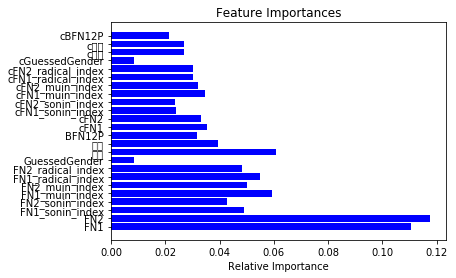

In [57]:
features = c_feature
importances = trained_model.feature_importances_
#indices = np.argsort(importances)
print(importances)
plt.title('Feature Importances')
plt.barh(range(len(importances)), importances, color='b', align='center')
plt.yticks(range(len(importances)), features) ## removed [indices]
plt.xlabel('Relative Importance')
plt.show()

In [54]:
%%time

x_feature = [ 'FN1',
        'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]

#working

compare_classifier2(resampled_FB_data_df,x_feature,1)


c_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', 'GuessedGender', '地格', '外格', 'BFN12P', 'cFN1', 'cFN2', 'cFN1_sonin_index', 'cFN2_sonin_index', 'cFN1_muin_index', 'cFN2_muin_index', 'cFN1_radical_index', 'cFN2_radical_index', 'cGuessedGender', 'c地格', 'c外格', 'cBFN12P']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Finished :No. 0 麗如
Finished :No. 0 粉多
Finished :No. 0 昊鵬
Finished :No. 0 芯苓
Finished :No. 0 失去
Finished :No. 0 岑臻
Finished :No. 0 善茹


/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Similar Train Accuracy ::  0.959205076614
Similar Test Accuracy  ::  0.920180048479
CPU times: user 8min 35s, sys: 1.74 s, total: 8min 36s
Wall time: 2min 55s


In [50]:
sample_index = (resampled_FB_data_df.sample(125).index)
print(sample_index)
print(resampled_FB_data_df.index)
#resampled_FB_data_df.loc[!sample_index] 

Int64Index([ 53586,  45180, 139593,  33043,  15165,  16181,  29882,   8274,
            138602,  14415,
            ...
            112781,  32729, 107247,  43076,  67260, 105283, 123934, 153465,
             17315, 106588],
           dtype='int64', length=125)
RangeIndex(start=0, stop=164822, step=1)


In [4]:
#FB_name_dict

In [36]:
def trend_classifier(data_df,x_feature,target_name_list,name_dict):


    train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, 'BirthYear')
    train_index = train_x.index
    test_index = test_y.index
    test_name_dict ={}
    data_df.loc[test_index].apply(lambda row: get_name_dict(row,test_name_dict),axis=1)

    classifier_list=[]
    for index,target_name in enumerate(target_name_list):
    #         target = data_df[data_df.FirstName.apply(lambda x:x==target_name)].iloc[0]
    #         target_name = target['BirthYear']
        tmp_df = data_df.loc[train_index]
        tmp_df['similar_age'] = tmp_df.loc[train_index].BirthYear.apply(lambda x:similar_name_age2(target_name,x,name_dict) )

        X = tmp_df[x_feature]
        y = tmp_df['similar_age']

#         # Apply Balance Cascade method
#         bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
#         X_resampled, y_resampled,indice = bc.fit_sample(X, y)
#         resampled_tmp_df = tmp_df.iloc[indice[0]] 
        smallest =99999999
        for value in tmp_df.similar_age.value_counts():
            if smallest >value:
                smallest=value
        tmp_data_df = pd.DataFrame()
        tmp_data_df = pd.concat( [ tmp_data_df[tmp_data_df.similar_age.apply(lambda x:x==0)].sample(smallest), tmp_data_df[tmp_data_df.similar_age.apply(lambda x:x==1)].sample(smallest)  ])
        #train_y = data_df.loc[train_index].BirthYear.apply(lambda x:similar_name_age2(target_name,x,name_dict) )

        trained_model = random_forest_classifier(resampled_tmp_df[x_feature], resampled_tmp_df['similar_age'])
        classifier_list.append( trained_model)
        print('Finished No.',index,target_name)
    
    importances = trained_model.feature_importances_
    #indices = np.argsort(importances)
    print(importances)
    plt.title('Feature Importances')
    plt.barh(range(len(importances)), importances, color='b', align='center')
    plt.yticks(range(len(importances)), x_feature) ## removed [indices]
    plt.xlabel('Relative Importance')
    plt.show()
    
    predict_list = []
    for index,target_name in enumerate(target_name_list):
        predictions = classifier_list[index].predict(test_x)
        #print(predictions)
        predict_list.append(predictions)

    answer_len_list = [ 0 for x in range(10) ]
    answer_score_len_list = [0 for x in range(10)]
    score=0
    for test_no,answer in enumerate((test_y)):
        predict_answer_dic ={}
        for classifier_no,target_name in enumerate(target_name_list):
                predict = predict_list[classifier_no][test_no]
                #print(len(test_y),len(predictions),predictions[test_no])
                #print(predictions.iloc[test_no])

                if predict ==1:
                    
                    for year in name_dict[target_name]:
                        #print(year)
                        if year not in  predict_answer_dic:
                            #predict_answer_dic[year]=1
                            predict_answer_dic[year]= name_dict[target_name][year]
                        else:
                            #predict_answer_dic[year]+=1
                            predict_answer_dic[year]+= name_dict[target_name][year]
                            

        sorted_predict_answer_dic = sorted(predict_answer_dic.items(), key=operator.itemgetter(1),reverse=True)
        if len(sorted_predict_answer_dic)>0:
            predict_answer = sorted_predict_answer_dic[0][0]
    #         print('sorted_predict_answer_dic:',sorted_predict_answer_dic)
    #         print('test_name_dict:',test_name_dict)
            if  test_x.iloc[test_no].FN1 !=-1:
                test_name = Totalname_list [ test_x.iloc[test_no].FN1 ]  + Totalname_list [ test_x.iloc[test_no].FN2 ]
            else:
                test_name = ' ' + Totalname_list [ test_x.iloc[test_no].FN2 ]
            #print(test_name)
            
            leng = len(test_name_dict[test_name])-1
            #print(leng)
            answer_len_list[leng]+=1   
            if test_no<30:
                print(sorted_predict_answer_dic,test_name_dict[test_name])
            if  predict_answer in test_name_dict[test_name]:
                score+=1
                answer_score_len_list[leng]+=1  
    print('Test accuracy:',score/len(test_y))

In [26]:
import operator
x = {1: 2, 3: 4, 4: 3, 2: 1, 0: 0}
sorted_x = sorted(x.items(), key=operator.itemgetter(1),reverse=True)
#sorted_x.reverse
sorted_x[0][1]

4

['柊憲', '盈宏', '椀騏', '琦豐', '旭景', '進森', '個玲', '品毅', '艾浩', '悠優', '啟帆', '家寶', '孟柔', '爰蓁', '皇星', '大山', '容達', '俊煒', '舜凱', '基宇', '宣善', '宥盛', '粲家', '清彬', '議槿', '汯廷', '霖昂', '凱斌', '依玲', '享颐', '塏晙', '卉甄', '嘉宁', '姸甄', '芸钰']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Finished No. 0 柊憲
Finished No. 1 盈宏
Finished No. 2 椀騏
Finished No. 3 琦豐
Finished No. 4 旭景
Finished No. 5 進森
Finished No. 6 個玲
Finished No. 7 品毅
Finished No. 8 艾浩
Finished No. 9 悠優
Finished No. 10 啟帆
Finished No. 11 家寶
Finished No. 12 孟柔
Finished No. 13 爰蓁
Finished No. 14 皇星
Finished No. 15 大山
Finished No. 16 容達
Finished No. 17 俊煒
Finished No. 18 舜凱
Finished No. 19 基宇
Finished No. 20 宣善
Finished No. 21 宥盛
Finished No. 22 粲家
Finished No. 23 清彬
Finished No. 24 議槿
Finished No. 25 汯廷
Finished No. 26 霖昂
Finished No. 27 凱斌
Finished No. 28 依玲
Finished No. 29 享颐
Finished No. 30 塏晙
Finished No. 31 卉甄
Finished No. 32 嘉宁
Finished No. 33 姸甄
Finished No. 34 芸钰
[ 0.12784369  0.11320435  0.06923779  0.0622646   0.09601744  0.07878588
  0.09685337  0.08299536  0.01496685  0.09988202  0.06055116  0.09739751]


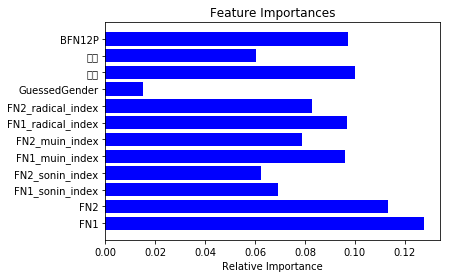

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 6, 9: 4, 10: 1, 11: 2, 12: 1, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1, 12: 2, 13: 4}
[(7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 7), (11, 6), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {10: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 3, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 5, 9: 3, 10: 2, 11: 1, 12: 1, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 2)] {10: 2, 11: 1, 12: 

[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 13, 8: 9, 9: 7, 10: 5, 11: 2, 12: 2}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 3, 9: 1, 10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9,

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 6, 9: 6, 10: 7, 11: 8, 12: 4, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 4, 12: 1, 13: 2, 7: 4}
[(12, 10), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 2, 10: 1, 11: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 4, 11: 8, 12: 3, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 2, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 1, 9: 7, 10: 4, 11: 6, 12: 5, 13: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 2, 11: 2, 13: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 2, 12: 3, 13: 3, 7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 11: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 6, 11: 1, 12: 1, 7: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 2, 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 5, 13: 5, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 5, 11: 1, 12: 2}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 9: 2, 10: 1, 11: 3, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 4, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 3, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3),

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 2, 7: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 10: 5, 11: 10, 12: 6, 13: 8}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 

[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 12: 2, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 1, 10: 1, 11: 7, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 2, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 1, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {8: 1, 13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 12: 3, 13: 1, 7: 2}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {8: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 3, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 2, 9: 2, 11: 2, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 9: 3, 10: 2, 11: 1, 12: 2, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 10: 3, 11: 1, 12: 2, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 1, 11: 3, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 1}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)]

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 5, 11: 4, 12: 6, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 4, 12: 4, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 4, 11: 3, 13: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 1, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 9: 2, 10: 2, 11: 5, 12: 8, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 6, 11: 1, 12: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 1, 10: 1, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 3}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 12: 1, 13: 2}
[(10, 6), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {10: 2, 7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 3, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 5, 10: 3, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 10: 1, 11: 1, 12: 7, 13: 8}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 11: 1, 12: 2, 13: 1}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 10: 2, 12: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 5}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8:

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 10, 9: 3, 13: 1, 7: 6}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 1, 12: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 7: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 9: 1, 10: 2, 11: 3, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 10: 2, 12: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 9: 1, 10: 3, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 13: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 4, 12: 2, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 10: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 4, 8: 6, 9: 7, 10: 4, 11: 1, 12: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 5, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 1, 12: 2}
[(7, 13), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2}
[(7, 8), 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 9: 4, 10: 1, 11: 1, 12: 2, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 3, 10: 2, 11: 3, 12: 5, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 12: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (

[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 3, 9: 2, 10: 1, 7: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 3, 12: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 1, 11: 1, 12: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(1

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 11: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 5), (10, 1)] {9: 1, 10: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 4, 10: 1, 11: 2, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(7, 8), (8, 7), (12, 6), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 4, 10: 1, 11: 3, 12: 4, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 13: 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 9: 1, 10: 6, 11: 3, 12: 5, 13: 6}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 1, 10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 3, 8: 4, 9: 1, 10: 5, 11: 1, 12: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 8, 10: 9, 11: 7, 12: 7, 13: 7}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 2, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7)

[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 5, 9: 6, 10: 3, 11: 3, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 2, 7: 1}
[(7, 14), (12, 6)

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 1, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 9: 3, 10: 1, 11: 3, 12: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 2, 9: 1, 10: 3, 11: 1, 12: 7, 13: 6}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 9, 8: 3, 9: 2, 10: 3, 11: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7,

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 4, 9: 5, 10: 1, 11: 1, 12: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 1, 10: 1, 11: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 3, 12: 1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 12: 1}
[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 7: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 12: 1}
[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2, 11: 3, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 11: 2, 12: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 4, 10: 1, 7: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 5, 9: 3, 10: 4, 11: 8, 12: 3, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 9, 9: 3, 10: 7, 11: 5, 12: 3, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4, 11: 1, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 2, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 1, 11: 3, 12: 3, 13: 6}
[(13, 8), (12, 7), (7, 5

[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 11: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 1, 13: 4, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 11: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 2, 10: 3, 11: 3, 13: 2}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 4}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(11, 10), (13, 7)

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 2, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 9: 3, 10: 3, 11: 3, 12: 1}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 12: 1, 13: 1}
[(13, 7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 3, 11: 2, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 11: 2, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 1, 7: 2}
[(13, 8), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 2, 12: 1, 7: 2}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 10: 3, 12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 2, 12: 1, 13: 3}
[(12, 6

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 3, 13: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 13: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 12: 2}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 7: 2}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1}
[(8, 10), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 2, 9: 3, 10: 2, 11: 7, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 5), (7, 4), (13, 4), (10, 3), (8, 2), (9, 1), (11, 1)] {10: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {

[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 2, 9: 2, 10: 1, 11: 1, 12: 2}
[(7, 7), (12, 5), (13, 4), (8, 3), (9, 1), (10, 1), (11, 1)] {11: 3, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 10: 2, 13: 1, 7: 2}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {10: 1, 11: 1, 12: 1, 13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 15, 8: 9, 9: 3, 10: 3, 11: 5, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (10, 5), (7, 4), (11, 4), (8, 3)] {8: 2, 11: 1, 12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1, 13: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(12, 5), (7, 4), (10, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {13: 1}


[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 8, 10: 9, 11: 7, 12: 7, 13: 7}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 4, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 6, 9: 8, 10: 1, 7: 7}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 1

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 9: 1, 10: 2, 11: 3, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 4, 11: 3, 12: 1, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 5, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 5, 11: 2, 12: 4, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 7, 9: 3, 10: 12, 11: 6, 12: 5, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), 

[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 3, 11: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 3, 12: 2, 7: 3}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 2, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 11: 2, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 8, 11: 4, 12: 4, 13: 5}
[(13, 8), (12, 7), (7, 5), 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 5, 9: 2, 10: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 9: 2, 10: 5, 11: 3, 12: 4, 13: 4}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 3, 13: 1}
[(7, 8), (8, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 2}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 2, 11: 2, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 2, 13: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 4, 11: 3, 13: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 10: 4, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 3, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 11: 2, 13: 1}
[(1

[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1, 7: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 10: 3, 12: 2, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 1, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 10: 1, 11: 1, 12: 7, 13: 8}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 8, 9: 11, 10: 2, 11: 3, 12: 7, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 9, 10: 8, 11: 5, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 1

[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 13: 1}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 4, 11: 2, 12: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 1, 10: 2, 11: 1, 12: 8, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)]

[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 4, 10: 1, 12: 3, 13: 4, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 4, 10: 4, 11: 5, 12: 3, 13: 6}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 10: 2, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 3, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 1, 9: 3, 10: 3, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 1, 9: 7,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 3, 13: 2, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 1, 10: 1, 11: 5, 12: 7, 13: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 2, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(11, 7), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10

[(13, 7), (12, 6), (9, 5), (10, 5), (7, 4), (11, 4), (8, 3)] {8: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 1, 12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 8, 10: 9, 11: 4, 12: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 1, 10: 2, 11: 2, 12: 4, 13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 12: 1, 13: 1}
[(13,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 3, 12: 3, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 3, 8: 4, 9: 2, 11: 2, 12: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 12: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 9, 9: 3, 10: 7

[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {9: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 2, 12: 2, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 2, 12: 2, 13: 3, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 2, 10: 3, 11: 4, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2)

[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 2, 7: 6}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 2, 7: 5}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 3, 9: 4, 10: 2, 11: 4, 13: 3}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 1, 12: 1}
[(9, 9), (13, 7

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 2, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 10: 1, 13: 1}
[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 1, 10: 1, 11: 5, 12: 7, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9

[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 7, 9: 15, 10: 3, 11: 4, 12: 4, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 14), (12, 6), (8, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 2, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 5, 12: 4, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 6, 10: 1, 11: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 6, 9: 1, 10: 6, 11: 5, 12: 4, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1, 13: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (1

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 9, 8: 3, 9: 2, 10: 3, 11: 1, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 9, 8: 10, 9: 11, 10: 13, 11: 12, 12: 3, 13: 7}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 12: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(12, 5), (7, 4), (10, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 11: 1, 12: 5, 7: 6}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 11: 3, 12: 1, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8),

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 4, 10: 1, 11: 2, 12: 1, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 15, 8: 9, 9: 3, 10: 3, 11: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 3, 10: 2, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 7, 9: 1, 10: 4, 11: 6, 12: 4, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 4, 12: 4, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 11, 9: 2, 10: 1, 7: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 1, 12: 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {8: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 3, 9: 2, 10: 1, 11: 3, 12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 13: 1

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 7: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 5, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 13: 1}
[(7, 9), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 5, 11: 4, 12: 6, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 2, 12: 1, 13: 1, 7: 1}
[(12, 6), (7, 5), (10, 5), (13, 5), (8, 4), (9, 1), (11, 1)] {9: 1, 10: 1, 7: 1}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 9: 3, 10: 1, 11: 2, 12: 2, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 4, 10: 1, 11: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 12: 1, 7: 4}
[(13, 8), (12

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 3, 7: 1}
[(11, 8), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1}
[(

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 12: 1, 7: 1}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 6, 9: 6, 10: 7, 11: 8, 12: 4, 13: 3}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2, 13: 3}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 4, 10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 1, 10: 2, 11: 1, 12: 8, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 3, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 3, 11: 4, 12: 3, 13: 4}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 2}
[(13, 8), (12, 7), (7, 5

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 3, 10: 3, 11: 5, 12: 8, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 1, 10: 2, 11: 1, 12: 3, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 10: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 11: 1, 12: 2, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 12: 1, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 11, 9: 2, 10: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7,

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 7: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 5, 10: 2, 13: 2, 7: 2}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 9: 1, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 12: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 3, 9: 2, 10: 1, 12: 2, 13: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 2, 11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 5, 11: 4, 12: 6, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 3, 11: 3, 12: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(12, 8), (13, 7), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 7, 8: 8, 9: 5, 10: 6, 11: 6, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 13: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 1, 13: 2}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 3, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 7, 9: 2, 12: 1, 13: 1, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), 

[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 2, 11: 1, 12: 2}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 8, 9: 2, 10: 4, 11: 3, 12: 6, 13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 12: 1, 13: 2, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 2, 13: 1, 7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 3, 12: 1, 13: 5, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)]

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 12: 2, 13: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 9, 9: 2, 10: 4, 11: 9, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 3, 9: 2, 10: 1, 11: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 2, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 2, 9: 1, 10: 4, 11: 1, 12: 2, 13: 3}
[(1

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 9: 1, 10: 3, 11: 4, 12: 2, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 3, 11: 3, 12: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 10: 3}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(12, 5), (7, 4), (13, 4), (10, 3), (8, 2), (9, 1), (11, 1)] {11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 11: 4, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (1

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 10: 1, 11: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 2, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6)

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 3, 11: 3, 12: 2, 13: 4}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 12: 1, 13: 1}
[(9, 7), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {10: 2}
[(13, 7), (12, 6), (9, 5), 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 2, 10: 1, 11: 2, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2}
[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 2, 7: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 5, 9: 6, 10: 5, 11: 4, 12: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 3}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 5, 9: 2, 10: 3, 11: 2, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 10: 3, 11: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 3, 12: 5, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 9, 10: 8, 11: 5, 12: 2, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 1, 9: 2, 10: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 1, 7: 5}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 7, 9: 4, 10: 5, 11: 2, 12: 1, 13: 2}
[(11, 9), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)]

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 4, 10: 4, 11: 5, 12: 3, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 2, 10: 3, 11: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 4, 11: 2, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 3, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 10: 1, 11: 1, 12: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 2, 7: 2}
[(13, 7), (9, 6), (12, 6), (7,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(9, 7), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {11: 1}
[(11, 9), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 1, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 1, 10: 2, 11: 1, 12: 3, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 3, 9: 2, 10: 1, 11: 3, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 9: 1, 10: 1, 11: 5, 12: 7, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 7, 9: 7, 10: 2, 11: 2, 7: 24}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 2)] {10: 2, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 13: 2, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 2, 11: 3, 12: 3, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 12: 3, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 2, 7: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9:

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 15, 8: 9, 9: 3, 10: 3, 11: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 7, 9: 15, 10: 3, 11: 4, 12: 4, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 3, 13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 3, 9: 2, 10: 3, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 1, 9: 1, 10: 3, 11: 3, 12: 4, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 13, 9: 12, 10: 9, 11: 2, 12: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 14), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 4, 9: 2, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 7: 1}
[(13, 8), (12, 7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 7, 9: 15, 10: 3, 11: 4, 12: 4, 13: 6}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 4, 11: 4, 13: 2, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 4, 11: 3, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 11: 1, 12: 2, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 2, 12: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 8, 11: 4, 12: 4, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 12: 1, 13: 2, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(9, 9),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 3, 9: 1, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 10: 3, 13: 1, 7: 5}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 10: 5, 11: 6, 12: 3, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 2, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 4, 11: 6, 12: 2, 13: 4}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 1, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 2, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 8, 9: 2, 10: 4, 11: 3, 12: 6, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 9: 2, 10: 3, 11: 2, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 3, 9: 2, 10: 1, 11: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 2, 9: 1, 10: 2, 11: 2, 12: 4, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 10: 5, 11: 6, 12: 3, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 2, 9: 2, 10: 3, 11: 4, 12: 6, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 2, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 5, 11: 1, 12: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 8, 8: 1, 9: 1, 10: 1, 11: 1, 12: 3, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 4, 10: 2, 11: 2, 12: 1, 7: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 5, 11: 3, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 1, 12: 1, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6)

[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 12: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (8, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 5, 11: 4, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 4, 9: 2, 13: 1, 7: 10}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 2, 11: 2, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 10: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 3, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 4, 10: 1, 11: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 7, 12: 2, 13: 1, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 2, 10: 1, 11: 1}
[(10, 6), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 2, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {11: 1, 12: 1, 13: 1}


[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 12: 1, 13: 2}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 1, 7: 3}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 4, 11: 2, 12: 4, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 5, 9: 2, 10: 2, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 2), (10, 1), (11, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (11, 6), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {10: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 11, 9: 8, 10: 8, 11: 4, 12: 2, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 1, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 9: 2, 10: 1, 11: 2, 12: 1, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 7, 9: 15, 10: 3, 11: 4, 12: 4, 13: 6}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 10: 2, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 12: 2, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 13: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(11, 7), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 2, 12: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 10: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10,

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 3, 11: 3, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 6, 9: 6, 10: 2, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(10, 5), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 7, 10: 6, 11: 5, 12: 2, 13: 3}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 4, 10: 4, 11: 5, 12: 3, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 3, 12: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 1, 10: 2, 11: 5, 12: 3, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 5, 11: 6, 12: 9, 13: 8}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 6, 9:

[(11, 7), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 1, 11: 3, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 11: 3, 12: 3, 7: 7}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 4, 10: 1, 7: 5}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 2, 11: 4, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 2, 13: 1, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 3, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 3}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2, 11: 1, 12: 1, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 4, 12: 1, 13: 2, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 11: 2, 13: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (11, 6), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {11: 1}
[(7, 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 6, 9: 5, 11: 1, 13: 1, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5),

[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 3, 10: 1, 11: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 13, 8: 7, 9: 2, 10: 5, 11: 3, 12: 1}
[(7, 9), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 8, 8: 3, 9: 2, 10: 2, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 4, 10: 3, 11: 3, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 10, 8: 6, 9: 5, 11: 4, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(11, 9), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 3, 9: 4, 10: 2, 11: 4, 13: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 3, 9: 3, 10: 1, 11: 1, 12: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 4, 9: 3, 10: 4, 11: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 2, 10: 2, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {7: 4, 8: 2, 9: 2, 10: 2, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 4, 11: 1, 13: 1, 7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {10: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 4, 10: 4, 11: 6, 12: 7, 13: 7}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 7: 7}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {10: 2, 11: 1, 1

[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 4, 10: 4, 11: 3, 12: 5, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 1, 9: 2, 10: 2, 11: 5, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1}
[(13, 7), (12, 6), (9

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 13: 2, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {10: 2, 11: 1, 12: 1, 13: 2, 7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 12: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 3, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 1, 7: 1}
[(12, 10), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 2, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 3, 9: 2, 10: 1, 11: 1, 12: 1}
[(

[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 2, 11: 2, 12: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(8, 10), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3}
[(13, 8), (12, 7), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1, 13: 1, 7: 2}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 2, 12: 3, 13: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 1, 7: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 3, 9: 2, 10: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 8, 10: 4, 11: 4, 12: 5, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1, 13: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {

[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 3, 11: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1, 12: 1, 7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 2, 11: 2, 12: 4, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(10, 6), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 3, 9: 2, 10: 4, 11: 2, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 13: 1,

[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 2}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 4, 9: 5, 10: 4, 11: 3, 12: 11, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 13), (12,

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 10: 1, 7: 5}
[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 12: 1, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 2}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2}
[

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {10: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 2, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 5, 9: 2, 10: 3, 11: 2, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 10: 5, 11: 10, 12: 6, 13: 8}
[(8, 10), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2, 13: 2}


[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 1, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 5, 9: 2, 10: 3, 11: 1, 12: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 12), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 7: 1}
[(13, 8), (12, 7), (7,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 2, 10: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 7, 9: 7, 10: 2, 11: 2, 7: 24}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 5), (7, 4), (13, 4), (10, 3), (8, 2), (9, 

[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 12: 1, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 1, 11: 3, 12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(7, 8), (13

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 3, 12: 1, 13: 1, 7: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 7: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 9: 2, 10: 5, 11: 3, 12: 4, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1)

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 5, 8: 3, 9: 3, 10: 4, 11: 1, 12: 2, 13: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 2, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 3, 10: 3, 11: 5, 12: 8, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 2, 10: 1, 13: 2, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 1, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1

[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 1, 7: 5}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 11: 2, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3}
[

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 3, 13: 5, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 2, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (8, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 3, 13: 2, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 2, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 11: 1, 7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 2, 9: 2, 10: 6, 11: 1, 13: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 5, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1, 12: 1}
[(7, 10), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 5, 9: 2, 10: 3, 11: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 6, 9: 1, 10: 6, 11: 5, 12: 4, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 10: 2, 13: 4}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 3, 10: 1, 11: 1, 12: 1, 7: 8}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 5, 10: 1, 13: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 5, 12: 1, 13: 1}
[(13, 12), (12, 7), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 10: 1, 11: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 13: 2}
[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 6, 9: 5, 11: 1, 13: 1, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 4, 10: 4, 11: 3, 12: 5, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 5, 8: 3, 9: 4, 10: 10, 11: 5, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 10: 5, 11: 2, 12: 5, 7: 1}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 1, 12: 4, 13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 1, 12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 5, 10: 3, 11: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (12, 6), (8,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 1, 7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 3, 10: 3, 11: 2, 12: 7, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 4, 9: 2, 13: 1, 7: 10}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 10: 2, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 3, 9: 2, 10: 3, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(12, 5), (7, 4), (13, 4), (10, 3), (8, 2), (9, 1), (11, 1)] {11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 4, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 10: 3, 11: 2, 13: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 2, 10: 1, 11: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 9, 8: 10, 9: 11, 10: 13, 11: 12, 12: 3, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11,

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 2, 10: 12, 11: 4, 12: 10, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 3, 8: 1, 9: 2, 10: 3, 11: 2, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 2, 11: 2, 7: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 3, 11: 1, 12: 2}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 2, 13: 4, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 11: 3, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 12: 2, 13: 2}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 11: 3, 12: 4, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1}
[(8, 9), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 1, 12: 1, 7: 5}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 9, 8: 3, 9: 2, 10: 3, 11: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 3, 10: 3}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 2}
[

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 7, 9: 1, 13: 1, 7: 12}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 2, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1, 10: 3, 7: 1}
[(12, 10), (13, 8),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 13), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 13, 8: 13, 9: 9, 10: 15, 11: 8, 12: 8, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4)

[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 2, 13: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 2, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(9, 7), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 3, 9: 2, 10: 1, 11: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 12: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 10: 2, 13: 4}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 3, 10: 1, 11: 1, 12: 1, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 2, 11: 3, 12: 4, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 1, 7: 2}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1, 7: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {9: 1, 11: 1, 12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 2, 12: 2}
[(12, 5), (7, 4), (13, 4), (10, 3), (8, 2), (9, 1), (11, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 10: 2, 11: 2, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 13: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 6, 10: 2, 12: 3, 13: 2, 7: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 12: 1, 13: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 10: 2, 12: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 10: 2, 11: 2, 12: 8, 13: 10}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 9, 10: 8, 11: 5, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 1, 9: 1, 10: 1, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 1, 10: 2, 11: 1, 12: 4, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 4, 9: 2, 10: 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 3, 11: 1, 7: 3}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 4, 13: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 10: 3, 11: 5, 12: 8, 13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 4, 10: 3, 11: 3, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 12: 1, 13: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 1, 11: 1, 12: 1, 13: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 

[(9, 7), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 1, 10: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 4, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 5, 12: 4, 13: 3}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 5, 8: 6, 9: 4, 10: 1, 11: 2, 12: 1, 13: 5}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3}
[(11, 9), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {9: 2, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 3, 10: 3, 11: 4, 7: 7}
[(7, 8), (8, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 3, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 2, 9: 2, 10: 3, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 3, 10: 2, 11: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 12: 1, 13: 1, 7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {8: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 13: 3}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 11: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 11: 2, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 3, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 7, 8: 4, 9: 4, 10: 3, 11: 5, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 1, 11: 1, 7: 4}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 5, 11: 1, 12: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 11: 2, 7: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 10: 2, 11: 1, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 4, 10: 1, 13: 1}
[(10, 5), (12, 5), (7, 4), (13, 4), (8, 2

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 2, 13: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 8, 8: 3, 9: 2, 10: 2, 11: 1, 12: 1, 13: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(12, 10), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(7, 12), (12, 6), (8, 5), (13,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12: 4, 13: 1}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 13: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 9, 8: 3, 9: 2, 10: 3, 11: 1, 13: 3}
[(

[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {8: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 12: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 1, 7: 3}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 1, 12: 3, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12:

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 2, 11: 1, 12: 6, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 4, 9: 2, 10: 2, 11: 1, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 10), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 13), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 4, 9: 1, 7: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 2}
[(7, 8), (13, 8), (12,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 2, 7: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 2, 11: 4, 12: 1}
[(7, 8), (13, 8), (8, 7), (12, 7), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1, 7: 2}
[(7, 10), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 2, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 3, 10: 3, 11: 4, 7: 7}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 5, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 1, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 3, 11: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 3, 12: 2, 13: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 2)] {9: 1, 12: 1, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)]

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 1, 9: 4, 10: 2, 11: 2, 13: 2}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 6, 9: 1, 10: 3, 11: 2, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 1, 7: 4}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1, 12: 3, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), 

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 3, 9: 2, 10: 3, 11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 10), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 3, 11: 1, 13: 1, 7: 1}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 10: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {10: 3, 11: 1}
[(11, 9), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (10, 2), (9, 1), (11, 1)] {12: 1}
[(10, 7), (12, 5

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 4, 11: 3, 13: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {7: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 10: 2, 11: 2, 12: 8, 13: 10}
[(13, 7), (9, 6), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 11: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 2, 12: 5, 13: 4, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 13: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)]

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 1, 10: 2, 11: 7, 12: 2, 13: 1}
[(7, 9), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(7, 9), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 2, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 2, 11: 1, 12: 2, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(7, 10), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3, 8: 4, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1, 12: 2, 7: 1}
[(13, 8), (1

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 2, 10: 1, 11: 2, 12: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 11: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 15, 8: 9, 9: 3, 10: 3, 11: 5, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 2, 9: 6, 10: 2, 12: 2, 13: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {10: 1}
[(12, 9), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 6, 9: 6, 10: 7, 11: 8, 12: 4, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 5, 9: 9, 10: 8, 11: 5, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 2, 9: 2, 10: 1, 11: 2, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 12: 1}
[(7, 7), (12, 6), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 7, 9: 3, 10: 12, 11: 6, 12: 5, 13: 7}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (11, 5), (7, 4), (8, 3), (10, 1)] {8: 1, 10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 4, 11: 3, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 2, 11: 1, 12: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 13: 1}
[(7, 9), (13, 8), (12, 7), (8

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 1, 10: 3, 11: 1, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8),

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 7, 9: 4, 10: 5, 11: 2, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 12: 2}
[(13, 8), (12, 7), (7, 5), 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 15, 8: 9, 9: 3, 10: 3, 11: 5, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 2, 12: 4, 13: 3, 7: 1}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 13: 4}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 6, 8: 9, 9: 3, 10: 7, 11: 5, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 11: 1, 12: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 3, 13: 1, 7: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 4, 9: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 13: 1}
[(7, 8), (13, 8), 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 12: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {7: 3}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 4, 8: 13, 9: 12, 10: 9, 11: 2, 12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 13), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 11: 1, 7: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(9, 8), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 3, 8: 1, 9: 2, 10: 3, 11: 4, 12: 2, 13: 2}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 9), (8, 7), (12, 6), (13, 5), (9, 1), (10, 1), (11, 1)] {11: 2, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 3, 11: 1, 12: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 9: 2, 7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 2, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 1, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 13: 1}
[(7, 8), (9, 8), (13, 8), (12, 7), (8, 6), (11, 4), (10, 1)] {8: 1, 9: 1, 7

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(7, 9), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 2, 11: 1, 12: 2, 13: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 1, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 5, 8: 3, 9: 4, 10: 10, 11: 5, 12: 1, 13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 4, 9: 2, 13: 1, 7: 10}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 1, 9: 2, 10: 3, 11: 1, 12: 2, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 2, 10: 5, 11: 9, 12: 1, 13: 9}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 4, 10: 5, 12: 3, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 2}
[(13, 8), (12, 7), 

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 1, 11: 3, 12: 3, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 2, 12: 4, 13: 6}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 2, 10: 5, 11: 9, 12: 1, 13: 9}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 5), (10, 1)] {9: 1, 10: 1, 12: 1, 13: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 10: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 7), (12, 6), (9, 5), (7

[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 3}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {9: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 2, 8: 2, 9: 3, 10: 1, 11: 2, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 5, 7: 3}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 2, 13: 2}

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 9: 2, 11: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 2, 11: 1, 7: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {8: 1, 9: 1, 11: 1, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1, 7: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 12: 1, 13: 1}
[(7, 11), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {9: 1,

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 10: 1, 12: 3, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 11: 3, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (11, 6), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {10: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(9, 9), (13, 7), (12, 6), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 5, 8: 3, 9: 3, 10: 4, 11: 1, 12: 2, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 3, 10: 1, 12: 1, 7: 1}
[(13, 11), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10

[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 5, 10: 1, 13: 1, 7: 3}
[(12, 8), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 11: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 7: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 9: 1, 10: 3, 11: 1, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1, 12: 2, 13: 1}
[(8, 11), (7, 8), (13, 8), (12, 7), (9, 5), (11, 4), (10, 1)] {11: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 4, 9: 2, 10: 1, 11: 3, 13: 5}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {9: 1, 11: 1}
[(10, 7), (12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (11, 1)] {8: 1}
[(7, 8), (12, 6), (8, 5

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 2, 8: 3, 9: 1, 10: 1, 11: 2, 12: 2, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 2, 13: 4}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 7: 1}
[(7, 8), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {8: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 4, 9: 2, 11: 1, 12: 3, 13: 5}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(11, 7), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(7, 8), (13, 8), (12, 7), (8, 6), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 9: 1, 11: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 3, 11: 2, 7: 4}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 11: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1, 8: 1, 9: 3, 10: 3, 11: 3, 12: 5, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {9: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {7: 1, 8: 1, 9: 1, 10: 5, 11: 4, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9,

[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {7: 2}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 2, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1, 10: 4, 11: 2, 12: 1, 13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {13: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 6, 8: 3, 10: 1, 11: 7, 12: 2, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1, 13: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2, 9: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 11: 1, 12: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10

[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2}
[(12, 6), (7, 5), (13, 5), (8, 4), (9, 1), (10, 1), (11, 1)] {9: 1, 10: 1, 12: 1, 13: 2, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 10: 1, 11: 1, 12: 1, 13: 3}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 1, 9: 4, 10: 4, 11: 5, 12: 3, 13: 6}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {9: 1}
[(12, 5), (7, 4), (13, 4), (8, 2), (9, 1), (10, 1), (11, 1)] {13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {10: 2, 11: 2, 12

[(12, 11), (13, 8), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {12: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {8: 3, 9: 1, 10: 2, 13: 2, 7: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {7: 1}
[(7, 12), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {10: 1, 12: 1}
[(7, 14), (12, 6), (8, 5), (13, 5), (9, 1), (10, 1), (11, 1)] {7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {11: 2, 13: 1, 7: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 2, 10: 2, 13: 1, 7: 1}
[(13, 7), (12, 6), (9, 5), (7, 4), (11, 4), (8, 3), (10, 1)] {10: 1, 11: 1}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {8: 1, 12: 3, 13: 2}
[(13, 8), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(13, 9), (12, 7), (7, 5), (8, 5), (9, 5), (11, 4), (10, 1)] {12: 1, 13: 1}
[(11, 10), (13, 7), (12, 6), (9, 5), (7, 4), (8, 3), (10, 1)] {12: 

In [40]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', #'GuessedGender', 
        '地格', '外格',
       'BFN12P']

y_feature = ['BirthYear']

# target_name_list = []
# classifier_size=100
# FB_name_list = []
# for FN in FB_name_dict:
#     FB_name_list.append(FN)
# # for i in range(classifier_size):
# #     random_index = random.randint(0,len(FB_name_list))
# #     target_name_list.append(FB_name_list[random_index] )
    

target_name_dict = {}
target_name_list = []
sample_times=5
for year in range(7,14):
    #每年取7*n個代表性的名字出來
    #target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( FB_unique_name[year] ) )
        target_name = FB_unique_name[year][sample]
        target_name_list.append(target_name)

    target_name_dict[year] = target_name_list
#print(target_name_dict)
print(target_name_list)

trend_classifier(resampled_FB_data_df,x_feature,target_name_list,FB_name_dict)



['本日', '書孛', '春理', '可歸', '嬌美', ' 海', '一偉', '世雄', '邱錦', '運水', '新來', '勝堂', '優美', '遠青', '元和', '素香', '雲華', '其萬', '濟青', '宗盛', '繼斌', '泰欽', '瑛雀', '秀絢', '敬賢', '嘉泉', '露華', '正亮', '長鋼', '正寰', '愛珠', '宗薇', '秋煌', '小明', '叔平', '俊邦', '廷浩', '庭玫', '廣源', '惠蓮', '晶晶', '文伯', '仁懿', '文安', '金澤', '榮梅', '維明', '若舉', '瑞星', '翠靜', '惠賢', '騰飛', '增慶', '俊祥', '慧莊', '銀葉', '明通', '媚娥', '宜輝', '瑞瑤', '淑妃', '美莉', '秋分', '碧晶', '毓蘭', '世元', '清通', '曼莉', '阿麵', '如鎏', '濱熊', '志宙', '進庭', '延洲', '登燦', '桂樑', '榮濱', '宏遠', '德鄰', '文學', '瓊黛', '森山', '晁璋', '添智', '春蘭', '郁卿', '媚漪', '敏慧', '懿德', ' 啟', '燿鴻', '孟麟', '琇媚', '宏濤', '淑韻', '培瑋', '進芳', '玉凰', '繁中', '再欽', '心儀', '健富', '憲雄', '惠香', '春平', '立安', '佳男', '彥廣', '宏明', '俊良', '永佳', '仙智', '銘信', '石堅', '燕蓮', '嘉煌', '玉琴', '韋秀', '瀞文', '桂吟', '憶珊', '宏安', '文偉', '品芳', '華真', '育翰', '文遠', '鈺如', '淑甄', '玉霖', '映純', '安祺', '東霖', '裕銘', '青芳', '怡純', '詠鈴', '立青', '敏良', '惠淋', '家媛', '佳伶', '振勛', '伶真', ' 琍', '之軒', '彥智', '依容', '明儒', '詩萍', '修良', '若珊', '秉良', '芝吟', '綿綿', '學霖', '鈞惠', ' 帆', '彥捷', '家筠', '欣瑤', '昕頤', '哲儀', '姿妤', '瑀宣', '巧蓁', '芸茜

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Finished No. 0 本日
Finished No. 1 書孛
Finished No. 2 春理
Finished No. 3 可歸
Finished No. 4 嬌美
Finished No. 5  海
Finished No. 6 一偉
Finished No. 7 世雄
Finished No. 8 邱錦
Finished No. 9 運水
Finished No. 10 新來
Finished No. 11 勝堂
Finished No. 12 優美
Finished No. 13 遠青
Finished No. 14 元和
Finished No. 15 素香
Finished No. 16 雲華
Finished No. 17 其萬
Finished No. 18 濟青
Finished No. 19 宗盛
Finished No. 20 繼斌
Finished No. 21 泰欽
Finished No. 22 瑛雀
Finished No. 23 秀絢
Finished No. 24 敬賢
Finished No. 25 嘉泉
Finished No. 26 露華
Finished No. 27 正亮
Finished No. 28 長鋼
Finished No. 29 正寰
Finished No. 30 愛珠
Finished No. 31 宗薇
Finished No. 32 秋煌
Finished No. 33 小明
Finished No. 34 叔平
Finished No. 35 俊邦
Finished No. 36 廷浩
Finished No. 37 庭玫
Finished No. 38 廣源
Finished No. 39 惠蓮
Finished No. 40 晶晶
Finished No. 41 文伯
Finished No. 42 仁懿
Finished No. 43 文安
Finished No. 44 金澤
Finished No. 45 榮梅
Finished No. 46 維明
Finished No. 47 若舉
Finished No. 48 瑞星
Finished No. 49 翠靜
Finished No. 50 惠賢
Finished No. 51 騰飛
Finished No. 52 增慶
Fin

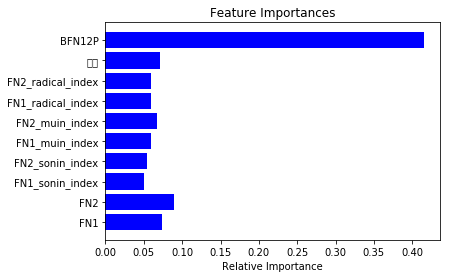

[(3, 143), (4, 143), (6, 139), (2, 136), (5, 134), (1, 124), (7, 47), (8, 23), (9, 11), (10, 4)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(9, 136), (8, 132), (10, 113), (7, 92), (6, 68), (4, 66), (5, 65), (2, 62), (3, 34), (1, 22)] {10: 1}
[(6, 130), (1, 112), (5, 108), (3, 94), (4, 85), (2, 84), (7, 69), (8, 68), (9, 61), (10, 56)] {1: 1, 2: 2, 5: 1, 6: 2}
[(8, 135), (9, 132), (7, 131), (10, 122), (6, 113), (5, 79), (4, 56), (2, 55), (3, 44), (1, 40)] {1: 1, 10: 1, 5: 1, 7: 1}
[(10, 146), (9, 138), (8, 127), (7, 119), (6, 76), (5, 54), (4, 44), (3, 31), (1, 29), (2, 28)] {1: 1, 5: 1, 6: 2, 7: 8, 8: 4, 9: 5, 10: 5}
[(1, 133), (3, 125), (2, 124), (6, 109), (5, 95), (4, 93), (7, 47), (8, 31), (9, 17), (10, 12)] {2: 1, 3: 1, 5: 1}
[(2, 128), (6, 126), (3, 117), (5, 115), (4, 102), (1, 97), (7, 41), (9, 24), (8, 22), (10, 7)] {4: 1}
[(7, 156), (8, 147), (6, 128), (10, 118), (5, 112), (4, 105), (9, 91), (3, 80), (2, 72), (1, 48)] {4: 1, 5: 1, 6: 1, 7: 1, 8: 2, 10: 1}
[(3, 135),

[(10, 108), (6, 107), (3, 106), (5, 99), (8, 93), (4, 87), (7, 80), (2, 74), (9, 69), (1, 47)] {6: 3}
[(10, 147), (9, 127), (8, 114), (7, 93), (6, 53), (5, 43), (4, 37), (3, 25), (1, 20), (2, 19)] {9: 1}
[(8, 147), (10, 137), (7, 135), (9, 122), (6, 112), (5, 81), (4, 67), (3, 55), (2, 48), (1, 27)] {9: 2, 10: 1}
[(4, 160), (6, 144), (5, 130), (2, 127), (3, 118), (1, 117), (7, 61), (8, 40), (9, 31), (10, 24)] {4: 2}
[(2, 133), (3, 132), (1, 128), (5, 127), (4, 124), (6, 120), (7, 55), (8, 24), (9, 11), (10, 4)] {1: 3, 2: 4, 3: 3, 4: 3, 5: 3, 6: 1, 8: 2, 10: 1}
[(2, 154), (3, 147), (6, 132), (5, 129), (1, 127), (4, 126), (7, 44), (8, 37), (9, 17), (10, 8)] {4: 1}
[(2, 143), (1, 128), (3, 126), (5, 115), (6, 114), (4, 101), (7, 46), (8, 26), (9, 14), (10, 7)] {1: 7, 2: 5, 3: 3, 4: 3, 5: 1, 6: 2, 7: 1, 9: 1}
[(8, 151), (10, 141), (9, 137), (7, 98), (6, 64), (5, 60), (2, 45), (4, 45), (3, 32), (1, 24)] {10: 1}
[(3, 155), (2, 143), (4, 139), (6, 129), (5, 125), (1, 124), (7, 65), (8, 37), (

[(8, 141), (10, 135), (9, 133), (7, 129), (6, 70), (5, 65), (4, 40), (3, 31), (2, 30), (1, 20)] {3: 1, 4: 1, 6: 1, 7: 1, 8: 1, 10: 2}
[(9, 145), (8, 138), (10, 134), (7, 126), (6, 100), (5, 88), (4, 58), (3, 45), (2, 40), (1, 38)] {7: 1}
[(10, 148), (9, 133), (8, 116), (7, 86), (6, 63), (5, 50), (4, 44), (2, 29), (3, 29), (1, 11)] {8: 1}
[(4, 156), (6, 147), (5, 127), (3, 110), (1, 109), (2, 103), (7, 69), (9, 32), (8, 28), (10, 24)] {7: 1}
[(7, 154), (6, 141), (8, 135), (10, 128), (5, 121), (4, 101), (9, 99), (3, 75), (2, 62), (1, 42)] {8: 5, 9: 2, 10: 1, 6: 11, 7: 14}
[(2, 152), (1, 125), (6, 124), (4, 115), (3, 111), (5, 110), (7, 59), (8, 36), (9, 23), (10, 11)] {2: 1, 6: 1}
[(10, 148), (9, 137), (8, 117), (7, 100), (6, 64), (5, 46), (4, 41), (3, 18), (2, 17), (1, 13)] {8: 1, 10: 1, 7: 1}
[(6, 152), (3, 143), (4, 142), (5, 139), (2, 134), (1, 109), (7, 70), (8, 24), (9, 14), (10, 10)] {1: 3, 2: 2, 3: 1, 4: 4, 5: 3, 6: 5, 7: 5, 8: 2, 10: 1}
[(2, 146), (3, 140), (5, 132), (4, 130), (

[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(6, 135), (2, 134), (1, 130), (4, 124), (3, 120), (5, 110), (7, 68), (8, 33), (9, 21), (10, 12)] {1: 1, 2: 1, 5: 2, 6: 1}
[(10, 115), (9, 89), (6, 87), (7, 85), (8, 85), (4, 72), (5, 55), (1, 34), (3, 29), (2, 27)] {4: 1, 5: 2, 6: 1, 7: 2}
[(5, 141), (2, 126), (6, 122), (3, 115), (1, 106), (4, 100), (7, 83), (8, 63), (9, 63), (10, 41)] {1: 1, 2: 1, 5: 2}
[(10, 154), (9, 130), (8, 108), (7, 94), (6, 58), (5, 42), (4, 37), (3, 18), (2, 16), (1, 13)] {8: 2, 9: 4, 10: 3, 7: 1}
[(10, 151), (9, 137), (8, 133), (7, 102), (6, 64), (5, 48), (4, 41), (3, 29), (2, 19), (1, 16)] {9: 1}
[(10, 152), (9, 135), (8, 126), (7, 94), (6, 55), (5, 47), (4, 36), (3, 18), (2, 17), (1, 13)] {8: 1}
[(8, 146), (10, 144), (7, 134), (9, 127), (6, 82), (5, 63), (4, 56), (2, 52), (3, 37), (1, 27)] {4: 1}
[(10, 142), (8, 127), (9, 127), (7, 109), (6, 106), (5,

[(5, 146), (6, 137), (8, 123), (7, 117), (10, 117), (4, 113), (3, 97), (9, 97), (2, 84), (1, 58)] {4: 1, 7: 1}
[(6, 141), (7, 126), (5, 123), (3, 118), (4, 109), (8, 99), (2, 84), (10, 79), (1, 76), (9, 76)] {7: 1}
[(10, 142), (8, 125), (9, 122), (7, 68), (2, 44), (6, 36), (1, 25), (5, 24), (4, 20), (3, 18)] {10: 1}
[(6, 147), (7, 118), (10, 117), (8, 112), (9, 108), (5, 94), (4, 87), (3, 66), (2, 62), (1, 44)] {9: 1}
[(2, 146), (3, 129), (1, 128), (5, 116), (6, 114), (4, 102), (7, 58), (8, 31), (9, 19), (10, 13)] {2: 1}
[(6, 163), (7, 123), (5, 120), (4, 113), (3, 102), (8, 94), (9, 93), (10, 93), (2, 87), (1, 78)] {10: 1}
[(2, 151), (1, 127), (6, 105), (3, 103), (4, 92), (5, 92), (7, 58), (8, 36), (9, 21), (10, 17)] {10: 1, 3: 1, 6: 1}
[(10, 129), (7, 127), (8, 125), (6, 113), (5, 100), (4, 89), (9, 86), (3, 70), (2, 41), (1, 19)] {2: 2, 4: 3, 6: 3, 7: 2, 8: 5, 9: 1}
[(10, 154), (9, 129), (8, 116), (7, 84), (6, 56), (5, 44), (4, 36), (3, 18), (2, 16), (1, 13)] {10: 1}
[(4, 150), (6, 

[(8, 153), (7, 144), (10, 133), (9, 125), (6, 110), (5, 95), (4, 68), (3, 64), (2, 59), (1, 40)] {3: 1, 4: 1, 6: 5, 7: 4, 8: 4, 9: 2, 10: 2}
[(10, 151), (9, 137), (8, 129), (7, 94), (6, 58), (5, 45), (4, 36), (3, 20), (2, 19), (1, 13)] {8: 1, 9: 1, 10: 1}
[(10, 151), (8, 135), (9, 134), (7, 98), (6, 56), (5, 45), (4, 40), (2, 31), (3, 18), (1, 15)] {9: 1}
[(10, 156), (8, 129), (7, 115), (9, 111), (6, 76), (5, 72), (4, 56), (3, 30), (2, 29), (1, 14)] {3: 2, 4: 2, 7: 1, 8: 1, 9: 1, 10: 1}
[(6, 165), (5, 162), (4, 161), (3, 152), (2, 132), (1, 106), (7, 65), (8, 36), (9, 23), (10, 21)] {1: 3, 2: 5, 3: 2, 4: 7, 5: 7, 6: 5, 7: 1}
[(3, 148), (2, 130), (6, 124), (4, 120), (5, 116), (1, 113), (7, 61), (8, 57), (9, 33), (10, 17)] {3: 1}
[(6, 148), (2, 143), (3, 142), (5, 136), (4, 133), (1, 116), (7, 61), (8, 28), (9, 17), (10, 10)] {3: 2}
[(10, 149), (8, 140), (9, 137), (7, 103), (6, 62), (5, 46), (4, 37), (2, 31), (3, 22), (1, 15)] {6: 1}
[(10, 145), (8, 144), (9, 133), (7, 129), (6, 77), (5,

[(8, 149), (9, 139), (10, 136), (7, 123), (6, 97), (5, 87), (4, 60), (2, 51), (3, 51), (1, 34)] {5: 1, 6: 2, 7: 2}
[(2, 133), (3, 129), (4, 115), (1, 114), (6, 108), (5, 96), (7, 65), (8, 32), (9, 29), (10, 14)] {8: 1}
[(6, 175), (4, 154), (3, 153), (5, 153), (2, 120), (7, 87), (1, 84), (8, 55), (9, 28), (10, 16)] {1: 1, 2: 7, 3: 1, 4: 7, 5: 4, 6: 9, 8: 1}
[(10, 135), (8, 134), (9, 120), (7, 116), (6, 104), (5, 83), (4, 55), (3, 48), (2, 46), (1, 16)] {1: 1, 2: 1, 3: 1, 4: 3, 5: 1, 6: 3, 7: 5, 8: 4, 9: 1, 10: 1}
[(2, 137), (1, 134), (3, 119), (6, 105), (4, 98), (5, 90), (7, 43), (8, 31), (9, 14), (10, 10)] {5: 1, 6: 1}
[(2, 135), (1, 130), (3, 125), (4, 121), (6, 121), (5, 115), (7, 44), (8, 22), (9, 11), (10, 5)] {1: 4, 2: 10, 3: 6, 4: 4, 5: 5, 6: 4, 7: 2, 8: 1, 9: 1}
[(6, 191), (5, 137), (4, 133), (7, 115), (3, 106), (2, 101), (10, 96), (9, 90), (1, 83), (8, 78)] {8: 1, 4: 1, 6: 1, 7: 2}
[(6, 161), (5, 123), (4, 111), (3, 104), (8, 104), (2, 99), (7, 93), (10, 80), (9, 70), (1, 69)] 

[(10, 150), (9, 134), (8, 132), (7, 100), (6, 56), (5, 42), (4, 34), (2, 24), (3, 19), (1, 14)] {9: 1}
[(4, 122), (1, 120), (2, 118), (6, 116), (3, 114), (5, 110), (7, 47), (8, 29), (9, 24), (10, 9)] {1: 1}
[(6, 166), (5, 144), (3, 126), (7, 111), (4, 102), (2, 94), (8, 82), (1, 72), (10, 66), (9, 61)] {3: 1, 4: 2, 6: 9, 7: 3, 8: 3, 9: 1, 10: 1}
[(10, 144), (8, 117), (9, 116), (7, 94), (6, 72), (4, 55), (2, 52), (5, 42), (3, 26), (1, 18)] {9: 1, 4: 1}
[(9, 145), (8, 140), (10, 130), (7, 110), (6, 99), (5, 73), (4, 50), (2, 40), (3, 39), (1, 32)] {8: 2, 9: 1, 10: 1, 6: 1, 7: 2}
[(1, 132), (2, 132), (6, 130), (3, 127), (4, 122), (5, 116), (7, 53), (8, 27), (9, 20), (10, 12)] {8: 1}
[(2, 138), (3, 134), (1, 131), (4, 131), (6, 121), (5, 115), (7, 49), (8, 27), (9, 14), (10, 4)] {3: 1, 5: 2}
[(8, 154), (10, 130), (9, 127), (7, 100), (6, 68), (5, 55), (4, 46), (2, 43), (3, 38), (1, 25)] {10: 1}
[(6, 162), (3, 154), (4, 154), (5, 144), (2, 141), (1, 104), (7, 67), (8, 41), (9, 22), (10, 13)]

[(7, 133), (6, 116), (4, 111), (5, 107), (8, 101), (3, 96), (10, 96), (9, 75), (2, 64), (1, 55)] {6: 1}
[(3, 137), (2, 134), (1, 128), (5, 124), (6, 121), (4, 118), (7, 52), (8, 23), (9, 15), (10, 2)] {1: 8, 2: 4, 3: 7, 4: 4, 5: 1, 6: 2, 7: 1}
[(1, 130), (2, 122), (3, 116), (5, 112), (6, 107), (4, 104), (7, 37), (8, 21), (9, 13), (10, 6)] {1: 1, 2: 1, 4: 1}
[(10, 156), (9, 122), (8, 118), (7, 90), (6, 68), (5, 54), (4, 49), (3, 30), (2, 23), (1, 14)] {8: 1}
[(2, 155), (6, 153), (4, 148), (5, 137), (1, 130), (3, 125), (7, 60), (8, 29), (9, 22), (10, 13)] {1: 7, 2: 6, 3: 4, 4: 10, 5: 8, 6: 8, 7: 4, 8: 1, 9: 1}
[(6, 174), (5, 173), (4, 163), (3, 142), (2, 135), (1, 110), (7, 78), (8, 46), (9, 30), (10, 22)] {1: 5, 2: 8, 3: 7, 4: 5, 5: 13, 6: 4, 7: 1, 8: 2, 10: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(4, 149), (2, 143), (3, 129), (5, 127), (6, 126), (1, 120), (7, 55), (

[(10, 146), (8, 110), (9, 103), (7, 80), (6, 56), (2, 47), (1, 46), (5, 40), (4, 39), (3, 29)] {4: 1}
[(2, 144), (3, 140), (4, 137), (6, 136), (5, 133), (1, 121), (7, 53), (8, 26), (10, 11), (9, 8)] {2: 1, 3: 1, 4: 1, 10: 1, 6: 2}
[(1, 106), (2, 102), (3, 74), (4, 74), (5, 73), (6, 65), (7, 50), (8, 42), (9, 42), (10, 26)] {1: 2}
[(10, 149), (9, 134), (8, 107), (7, 101), (6, 61), (5, 46), (4, 40), (2, 21), (3, 19), (1, 13)] {8: 1, 10: 2}
[(3, 146), (2, 135), (6, 135), (4, 134), (5, 131), (1, 128), (7, 44), (8, 25), (9, 15), (10, 5)] {5: 1}
[(10, 152), (8, 138), (9, 129), (7, 98), (6, 66), (5, 63), (4, 47), (2, 43), (3, 28), (1, 14)] {9: 1}
[(10, 154), (9, 131), (8, 120), (7, 88), (6, 57), (5, 44), (4, 37), (2, 19), (3, 18), (1, 13)] {7: 1}
[(3, 133), (2, 132), (4, 129), (1, 121), (6, 115), (5, 112), (7, 48), (8, 22), (9, 13), (10, 5)] {10: 1}
[(10, 145), (8, 141), (9, 122), (7, 116), (6, 70), (5, 47), (4, 38), (2, 29), (3, 23), (1, 19)] {9: 1}
[(10, 153), (8, 138), (9, 135), (7, 111), 

[(2, 164), (4, 150), (6, 149), (5, 146), (3, 133), (1, 106), (7, 85), (8, 53), (9, 28), (10, 22)] {2: 1, 3: 1}
[(10, 155), (8, 132), (9, 126), (7, 101), (5, 68), (6, 67), (4, 53), (2, 36), (3, 28), (1, 17)] {5: 1, 6: 3, 7: 5, 8: 1, 9: 1, 10: 3}
[(6, 136), (3, 132), (4, 128), (5, 118), (1, 116), (2, 113), (7, 49), (9, 31), (8, 27), (10, 11)] {9: 1}
[(1, 128), (2, 128), (6, 116), (3, 108), (4, 96), (5, 96), (7, 51), (8, 34), (10, 22), (9, 13)] {4: 1}
[(6, 153), (5, 148), (4, 134), (1, 132), (3, 132), (2, 119), (7, 80), (8, 41), (9, 37), (10, 27)] {1: 1, 4: 1}
[(10, 145), (8, 127), (9, 123), (7, 107), (6, 73), (5, 62), (4, 49), (3, 30), (2, 25), (1, 12)] {4: 1}
[(1, 131), (2, 114), (3, 106), (6, 96), (5, 90), (4, 88), (7, 38), (8, 31), (9, 28), (10, 10)] {1: 1}
[(7, 142), (9, 120), (8, 116), (10, 115), (6, 104), (5, 78), (4, 63), (2, 50), (3, 45), (1, 40)] {8: 2, 2: 1, 6: 1}
[(6, 133), (4, 123), (7, 120), (10, 105), (5, 104), (9, 96), (8, 90), (3, 71), (2, 54), (1, 43)] {8: 1, 9: 2, 10: 2

[(2, 138), (1, 125), (3, 117), (6, 107), (5, 103), (4, 99), (7, 40), (8, 19), (9, 12), (10, 4)] {2: 8, 3: 4, 4: 1, 5: 2, 6: 2}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(6, 173), (7, 144), (8, 125), (5, 124), (9, 122), (4, 118), (10, 111), (3, 84), (2, 76), (1, 69)] {1: 1, 2: 1, 4: 3, 6: 3, 7: 2, 8: 3, 9: 4, 10: 2}
[(2, 154), (4, 147), (6, 138), (5, 136), (3, 135), (1, 112), (7, 79), (8, 72), (9, 32), (10, 25)] {2: 1, 3: 1, 4: 1}
[(2, 151), (3, 143), (6, 142), (4, 134), (5, 128), (1, 122), (7, 46), (8, 28), (9, 16), (10, 7)] {1: 3, 2: 2, 4: 2, 6: 1, 7: 1}
[(2, 141), (4, 141), (6, 138), (3, 124), (5, 120), (1, 107), (7, 60), (8, 39), (9, 30), (10, 14)] {2: 1, 3: 1, 4: 1, 6: 1, 7: 2}
[(10, 154), (9, 135), (8, 126), (7, 109), (6, 78), (5, 62), (4, 53), (2, 26), (3, 26), (1, 14)] {8: 1}
[(10, 152), (9, 133), (8, 131), (7, 91), (6, 54), (5, 45), (4, 35), (2, 22), (3, 18), (1,

[(6, 149), (5, 142), (4, 124), (3, 108), (7, 92), (1, 86), (9, 85), (8, 81), (2, 77), (10, 59)] {1: 1, 4: 1, 5: 1, 6: 2, 7: 1, 9: 1}
[(7, 141), (10, 131), (8, 130), (9, 104), (6, 84), (4, 72), (5, 69), (2, 44), (3, 44), (1, 23)] {7: 1}
[(6, 160), (7, 155), (5, 138), (8, 107), (3, 102), (4, 101), (9, 95), (10, 89), (2, 80), (1, 60)] {8: 2, 10: 1, 4: 2}
[(4, 143), (5, 140), (6, 138), (3, 131), (2, 127), (1, 114), (7, 46), (8, 23), (9, 9), (10, 5)] {3: 1}
[(6, 127), (7, 127), (8, 119), (5, 114), (10, 103), (3, 94), (9, 94), (4, 79), (2, 59), (1, 41)] {1: 3, 3: 4, 5: 3, 6: 3, 7: 2, 8: 1}
[(2, 150), (1, 124), (3, 121), (6, 120), (4, 112), (5, 97), (7, 54), (8, 32), (9, 17), (10, 9)] {2: 1}
[(6, 135), (1, 133), (2, 122), (3, 119), (5, 113), (4, 112), (7, 56), (8, 32), (9, 25), (10, 13)] {1: 1, 2: 1, 4: 1, 6: 1}
[(2, 146), (4, 143), (6, 132), (5, 130), (1, 126), (3, 122), (7, 77), (8, 46), (9, 34), (10, 22)] {1: 1, 2: 1}
[(8, 139), (10, 137), (7, 133), (9, 131), (6, 101), (5, 85), (4, 67), (3

[(6, 178), (5, 139), (7, 136), (8, 130), (10, 111), (3, 107), (4, 103), (9, 102), (2, 69), (1, 52)] {2: 1, 3: 1, 4: 1, 7: 3, 8: 3, 9: 1, 10: 1}
[(10, 155), (9, 121), (8, 118), (7, 92), (6, 66), (5, 56), (4, 49), (3, 28), (2, 22), (1, 12)] {8: 1, 9: 1, 10: 1, 5: 1, 6: 1}
[(2, 142), (3, 134), (1, 124), (4, 113), (6, 109), (5, 101), (7, 46), (8, 24), (9, 13), (10, 5)] {2: 1}
[(6, 152), (7, 144), (5, 110), (10, 110), (8, 106), (4, 95), (9, 95), (2, 80), (3, 78), (1, 55)] {5: 1, 6: 2, 7: 1}
[(2, 135), (3, 134), (1, 126), (6, 124), (4, 121), (5, 113), (7, 42), (8, 22), (9, 12), (10, 6)] {4: 1}
[(5, 162), (6, 162), (3, 151), (4, 140), (2, 123), (1, 98), (7, 59), (8, 37), (9, 28), (10, 17)] {1: 2, 4: 1, 5: 1}
[(4, 153), (5, 141), (3, 138), (6, 133), (2, 130), (1, 93), (7, 60), (8, 36), (9, 29), (10, 29)] {1: 2, 7: 1}
[(6, 193), (4, 161), (5, 154), (2, 131), (3, 129), (1, 120), (7, 95), (8, 67), (9, 37), (10, 30)] {1: 1, 3: 6, 4: 1, 5: 2, 6: 4, 7: 1}
[(2, 133), (1, 128), (3, 121), (6, 105), (5,

[(5, 143), (6, 129), (2, 127), (3, 120), (1, 111), (4, 108), (7, 74), (8, 40), (9, 27), (10, 17)] {2: 1, 3: 1}
[(4, 169), (6, 145), (5, 130), (3, 107), (2, 101), (1, 84), (7, 78), (9, 58), (8, 55), (10, 53)] {4: 1}
[(5, 126), (10, 126), (6, 115), (9, 101), (8, 100), (4, 98), (7, 98), (3, 69), (2, 53), (1, 33)] {4: 3, 5: 5, 6: 2, 7: 4, 8: 3, 9: 1, 10: 3}
[(1, 127), (2, 125), (6, 120), (3, 114), (4, 106), (5, 104), (7, 41), (8, 21), (9, 16), (10, 13)] {1: 2, 6: 1}
[(1, 135), (4, 125), (5, 124), (6, 121), (2, 120), (3, 120), (7, 49), (8, 23), (9, 17), (10, 11)] {1: 4, 3: 3, 4: 1, 5: 2, 6: 1}
[(1, 134), (2, 114), (6, 97), (3, 95), (5, 81), (4, 76), (7, 44), (8, 36), (9, 28), (10, 8)] {1: 1, 2: 1, 3: 2, 5: 1}
[(10, 147), (8, 140), (9, 133), (7, 100), (6, 58), (5, 49), (4, 33), (2, 27), (3, 23), (1, 19)] {10: 1, 7: 1}
[(5, 147), (6, 143), (2, 140), (4, 140), (3, 130), (1, 113), (7, 53), (8, 30), (9, 12), (10, 12)] {1: 2, 2: 4, 3: 3, 4: 1, 5: 3, 6: 1, 7: 3, 8: 2}
[(3, 142), (2, 119), (5, 112)

[(3, 127), (2, 122), (4, 122), (6, 119), (1, 118), (5, 103), (7, 44), (8, 24), (9, 14), (10, 8)] {2: 1}
[(2, 158), (4, 146), (5, 143), (6, 141), (1, 129), (3, 123), (7, 65), (8, 31), (9, 17), (10, 11)] {1: 4, 2: 1, 4: 1, 5: 4, 6: 1, 7: 1}
[(8, 133), (10, 106), (9, 99), (2, 83), (7, 80), (6, 67), (3, 61), (4, 50), (5, 49), (1, 24)] {8: 2, 4: 1, 5: 2, 7: 2}
[(6, 188), (4, 166), (5, 144), (2, 118), (3, 114), (1, 99), (7, 78), (8, 51), (9, 50), (10, 41)] {3: 2, 5: 1, 6: 2}
[(10, 149), (8, 137), (9, 129), (7, 120), (6, 72), (5, 58), (4, 50), (2, 36), (3, 27), (1, 13)] {8: 3, 9: 4, 7: 1}
[(6, 171), (5, 151), (3, 136), (4, 127), (2, 114), (1, 104), (7, 83), (8, 43), (10, 41), (9, 40)] {1: 2, 2: 1, 3: 1, 4: 1, 7: 1}
[(2, 145), (3, 133), (6, 128), (1, 122), (5, 122), (4, 117), (7, 74), (8, 51), (9, 37), (10, 26)] {3: 1}
[(5, 136), (4, 134), (6, 123), (2, 118), (1, 115), (3, 107), (7, 58), (8, 49), (10, 35), (9, 29)] {1: 1}
[(5, 175), (6, 169), (2, 140), (4, 139), (3, 137), (7, 112), (1, 91), (8

[(3, 132), (2, 118), (6, 106), (4, 102), (5, 101), (1, 93), (7, 50), (8, 43), (9, 29), (10, 17)] {3: 2}
[(5, 162), (6, 160), (7, 136), (4, 124), (3, 116), (1, 115), (2, 104), (8, 71), (9, 63), (10, 53)] {4: 1, 6: 1}
[(2, 156), (3, 136), (5, 119), (4, 118), (6, 118), (1, 115), (7, 51), (8, 27), (9, 14), (10, 9)] {4: 1}
[(4, 152), (5, 147), (3, 143), (6, 142), (2, 121), (1, 114), (7, 83), (8, 47), (9, 30), (10, 27)] {4: 1, 7: 1}
[(1, 116), (6, 108), (4, 98), (5, 91), (2, 90), (3, 83), (7, 62), (8, 56), (10, 55), (9, 37)] {9: 1, 10: 1, 3: 2, 5: 1, 7: 2}
[(6, 181), (4, 178), (5, 160), (3, 118), (2, 110), (1, 100), (7, 86), (8, 53), (9, 49), (10, 42)] {2: 1, 4: 1, 7: 2}
[(10, 147), (9, 133), (8, 109), (7, 104), (6, 85), (5, 63), (4, 46), (3, 40), (1, 37), (2, 30)] {8: 2, 10: 2, 3: 1, 2: 1}
[(2, 163), (4, 133), (5, 129), (6, 124), (1, 116), (3, 116), (7, 65), (8, 46), (9, 28), (10, 16)] {2: 2}
[(10, 152), (9, 136), (8, 131), (7, 101), (6, 57), (5, 50), (4, 36), (2, 21), (3, 18), (1, 13)] {8:

[(10, 149), (8, 138), (9, 137), (7, 103), (6, 61), (5, 49), (4, 37), (2, 23), (3, 20), (1, 16)] {9: 1}
[(2, 140), (1, 130), (4, 129), (3, 126), (6, 125), (5, 121), (7, 57), (8, 25), (9, 13), (10, 8)] {1: 1}
[(4, 158), (6, 144), (5, 139), (3, 111), (2, 84), (7, 81), (1, 64), (8, 55), (9, 49), (10, 44)] {4: 3, 5: 3, 6: 2, 7: 2, 8: 1, 10: 1}
[(2, 139), (3, 128), (6, 126), (1, 123), (4, 108), (5, 101), (7, 75), (8, 33), (9, 15), (10, 13)] {2: 1}
[(2, 114), (1, 109), (3, 102), (6, 79), (4, 77), (5, 73), (8, 50), (7, 41), (9, 37), (10, 30)] {3: 1}
[(10, 145), (8, 139), (9, 124), (7, 103), (6, 62), (5, 56), (4, 47), (2, 32), (3, 25), (1, 11)] {10: 1}
[(6, 169), (5, 165), (4, 143), (3, 141), (7, 136), (2, 110), (8, 83), (1, 79), (9, 60), (10, 47)] {3: 5, 4: 3, 5: 2, 7: 7, 8: 6, 9: 1, 10: 2}
[(2, 143), (1, 129), (6, 118), (3, 117), (4, 109), (5, 105), (7, 44), (8, 23), (9, 16), (10, 7)] {3: 1, 1: 1, 2: 5, 10: 1, 5: 3}
[(6, 154), (5, 130), (7, 124), (4, 120), (3, 100), (2, 99), (1, 83), (8, 78),

[(2, 150), (3, 136), (4, 113), (5, 111), (1, 109), (6, 108), (7, 55), (8, 41), (9, 18), (10, 11)] {1: 1}
[(5, 156), (4, 151), (6, 151), (3, 144), (2, 135), (1, 110), (7, 64), (8, 56), (9, 37), (10, 28)] {2: 1}
[(9, 106), (8, 97), (10, 93), (7, 80), (4, 73), (3, 62), (1, 61), (2, 61), (6, 61), (5, 42)] {2: 1}
[(10, 149), (8, 144), (7, 120), (9, 118), (5, 80), (6, 74), (4, 53), (2, 38), (3, 38), (1, 17)] {8: 2, 9: 1, 10: 1, 7: 1}
[(10, 154), (9, 137), (8, 126), (7, 91), (6, 61), (5, 47), (4, 38), (2, 23), (3, 20), (1, 13)] {8: 1}
[(2, 151), (5, 134), (1, 131), (6, 129), (3, 125), (4, 117), (7, 56), (8, 29), (9, 22), (10, 11)] {1: 1, 3: 1, 4: 2}
[(2, 143), (1, 134), (3, 119), (6, 115), (4, 111), (5, 97), (7, 43), (8, 30), (9, 18), (10, 14)] {2: 1, 3: 1, 4: 1, 6: 1, 7: 2, 8: 1}
[(2, 150), (3, 147), (6, 136), (5, 134), (4, 133), (1, 116), (7, 70), (8, 66), (9, 39), (10, 24)] {6: 1}
[(5, 149), (6, 140), (4, 132), (2, 125), (3, 123), (1, 105), (7, 93), (8, 72), (9, 55), (10, 49)] {8: 1}
[(9, 

[(7, 126), (8, 126), (10, 118), (4, 100), (9, 99), (6, 69), (5, 60), (1, 50), (3, 50), (2, 41)] {1: 2, 10: 1, 9: 1, 7: 5}
[(5, 149), (6, 145), (4, 144), (3, 121), (2, 113), (7, 90), (1, 89), (8, 65), (9, 55), (10, 38)] {8: 1, 2: 1, 3: 1, 4: 1, 7: 2}
[(5, 135), (3, 130), (6, 129), (4, 126), (1, 118), (2, 106), (7, 64), (10, 29), (9, 28), (8, 25)] {1: 1, 2: 1}
[(4, 168), (5, 152), (6, 148), (3, 142), (2, 129), (1, 106), (7, 63), (8, 35), (9, 30), (10, 25)] {3: 1}
[(10, 148), (9, 119), (8, 107), (7, 65), (6, 47), (3, 38), (5, 38), (4, 35), (2, 29), (1, 13)] {8: 1, 10: 2, 3: 2}
[(4, 155), (6, 153), (5, 135), (2, 131), (3, 130), (7, 114), (1, 95), (8, 88), (9, 61), (10, 59)] {4: 1, 5: 2, 6: 1}
[(2, 142), (4, 129), (3, 128), (1, 125), (6, 124), (5, 108), (7, 39), (8, 26), (9, 16), (10, 5)] {8: 2, 1: 3, 3: 2, 4: 2, 5: 2}
[(2, 142), (3, 139), (6, 134), (5, 129), (4, 121), (1, 95), (8, 85), (7, 70), (9, 36), (10, 22)] {6: 1}
[(3, 137), (2, 128), (1, 127), (4, 127), (5, 125), (6, 121), (7, 44), 

[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(6, 173), (4, 155), (3, 150), (5, 149), (2, 141), (1, 105), (7, 73), (8, 39), (9, 27), (10, 23)] {2: 1, 3: 4, 4: 1, 5: 6, 6: 4, 8: 2}
[(4, 159), (6, 159), (5, 157), (3, 146), (2, 126), (1, 104), (7, 81), (8, 60), (9, 41), (10, 19)] {4: 1}
[(10, 155), (9, 125), (8, 118), (7, 89), (6, 68), (5, 55), (4, 50), (3, 26), (2, 24), (1, 12)] {10: 2}
[(10, 151), (9, 127), (7, 120), (8, 119), (6, 72), (5, 56), (4, 46), (3, 26), (2, 25), (1, 19)] {7: 1}
[(7, 126), (8, 125), (10, 116), (9, 106), (6, 86), (5, 61), (4, 59), (3, 43), (1, 42), (2, 42)] {5: 1}
[(3, 154), (6, 139), (2, 131), (4, 128), (5, 125), (1, 109), (7, 52), (8, 39), (10, 21), (9, 20)] {6: 1}
[(10, 140), (9, 129), (7, 99), (8, 93), (6, 61), (4, 57), (5, 46), (3, 31), (1, 20), (2, 12)] {9: 1}
[(6, 186), (5, 168), (4, 151), (3, 132), (2, 100), (1, 81), (7, 81), (8, 48), (9, 39), 

[(5, 154), (6, 153), (3, 138), (4, 120), (2, 110), (1, 98), (7, 80), (8, 39), (9, 35), (10, 33)] {7: 1}
[(10, 142), (9, 136), (8, 116), (7, 83), (6, 53), (4, 44), (5, 44), (2, 39), (3, 22), (1, 19)] {8: 1, 9: 1, 6: 1}
[(6, 176), (4, 153), (5, 153), (3, 149), (2, 109), (1, 98), (7, 88), (8, 47), (9, 35), (10, 30)] {3: 1, 4: 1}
[(10, 151), (9, 130), (8, 120), (7, 84), (6, 55), (5, 45), (4, 36), (3, 28), (2, 24), (1, 15)] {8: 2, 7: 1}
[(7, 152), (8, 138), (10, 127), (9, 113), (6, 107), (5, 83), (4, 77), (3, 55), (2, 52), (1, 31)] {8: 1}
[(9, 144), (8, 119), (10, 115), (6, 113), (7, 113), (5, 94), (4, 71), (3, 58), (1, 47), (2, 46)] {9: 1}
[(10, 139), (9, 117), (8, 115), (7, 85), (6, 60), (5, 52), (4, 51), (3, 40), (2, 28), (1, 20)] {9: 1}
[(7, 141), (8, 138), (6, 126), (10, 125), (5, 116), (9, 103), (3, 94), (4, 92), (2, 80), (1, 39)] {10: 1}
[(3, 114), (2, 109), (6, 103), (4, 101), (5, 96), (7, 96), (1, 95), (10, 61), (8, 57), (9, 56)] {4: 1}
[(6, 178), (5, 159), (4, 152), (3, 129), (7, 

[(3, 151), (2, 140), (4, 128), (6, 126), (5, 122), (1, 115), (7, 49), (8, 26), (9, 16), (10, 11)] {3: 1}
[(6, 175), (5, 162), (4, 158), (3, 148), (2, 125), (1, 91), (7, 75), (8, 34), (9, 25), (10, 23)] {1: 2, 2: 1, 3: 6, 4: 10, 5: 8, 6: 6, 7: 3}
[(3, 137), (4, 125), (6, 118), (5, 115), (2, 106), (1, 87), (7, 63), (8, 50), (9, 47), (10, 22)] {8: 1, 1: 1, 2: 1}
[(9, 103), (10, 83), (5, 78), (1, 77), (6, 77), (8, 75), (3, 73), (4, 63), (7, 63), (2, 61)] {9: 1}
[(4, 160), (6, 160), (5, 157), (3, 146), (2, 143), (1, 106), (7, 61), (8, 38), (9, 25), (10, 16)] {1: 3, 2: 4, 3: 4, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1, 9: 1}
[(10, 149), (9, 131), (8, 119), (7, 113), (6, 103), (5, 66), (4, 56), (3, 39), (2, 35), (1, 21)] {7: 1}
[(8, 151), (10, 131), (9, 126), (7, 111), (6, 101), (5, 87), (3, 80), (4, 80), (2, 72), (1, 38)] {10: 1, 2: 1, 4: 1, 5: 1}
[(3, 118), (1, 111), (5, 111), (6, 107), (2, 105), (4, 102), (7, 74), (9, 33), (10, 29), (8, 28)] {9: 1}
[(2, 149), (3, 143), (4, 141), (5, 131), (6, 129), (1

[(3, 151), (6, 143), (4, 141), (2, 130), (5, 124), (1, 122), (7, 50), (8, 23), (9, 17), (10, 7)] {1: 5, 2: 1, 3: 4, 4: 3, 5: 3, 8: 1}
[(2, 126), (1, 110), (3, 101), (4, 100), (5, 91), (6, 84), (7, 34), (8, 27), (9, 12), (10, 12)] {2: 1}
[(6, 204), (5, 156), (4, 144), (7, 115), (3, 113), (2, 94), (1, 90), (10, 86), (8, 68), (9, 65)] {9: 1, 6: 1, 7: 1}
[(6, 140), (4, 135), (2, 130), (3, 127), (1, 119), (5, 113), (7, 51), (9, 41), (8, 36), (10, 23)] {4: 1}
[(7, 144), (8, 129), (9, 125), (10, 122), (6, 92), (4, 82), (5, 70), (3, 46), (2, 44), (1, 24)] {6: 1, 7: 1}
[(2, 138), (6, 127), (1, 124), (4, 107), (3, 97), (5, 94), (7, 50), (9, 46), (8, 36), (10, 30)] {1: 3, 2: 4, 3: 1}
[(8, 155), (10, 135), (6, 118), (9, 115), (7, 114), (5, 82), (2, 61), (4, 61), (3, 60), (1, 37)] {8: 2, 9: 2, 6: 1, 7: 2}
[(6, 144), (1, 127), (5, 127), (3, 126), (2, 116), (4, 112), (7, 78), (8, 27), (9, 15), (10, 10)] {1: 2, 2: 1, 4: 2, 5: 3, 6: 2, 7: 2}
[(10, 154), (9, 123), (8, 116), (7, 88), (6, 64), (5, 47), (4

[(2, 134), (3, 131), (1, 126), (4, 120), (6, 113), (5, 111), (7, 42), (8, 21), (9, 10), (10, 7)] {4: 1}
[(10, 155), (9, 135), (8, 122), (7, 104), (6, 62), (5, 50), (4, 37), (3, 22), (2, 18), (1, 15)] {9: 2}
[(2, 125), (6, 116), (3, 114), (1, 96), (5, 86), (4, 82), (7, 37), (10, 37), (8, 32), (9, 28)] {6: 2}
[(10, 144), (8, 142), (9, 135), (7, 105), (6, 68), (5, 53), (4, 48), (2, 37), (3, 30), (1, 14)] {8: 7, 9: 5, 10: 3}
[(6, 153), (5, 152), (4, 145), (3, 132), (2, 116), (1, 108), (7, 67), (8, 36), (9, 29), (10, 27)] {3: 1}
[(4, 147), (3, 142), (6, 139), (5, 137), (2, 133), (1, 127), (7, 49), (8, 23), (9, 16), (10, 7)] {1: 13, 2: 6, 3: 12, 4: 13, 5: 7, 6: 3}
[(10, 146), (8, 140), (9, 128), (7, 101), (6, 60), (5, 43), (4, 33), (2, 30), (3, 21), (1, 14)] {8: 1, 10: 1, 5: 1}
[(10, 154), (8, 138), (9, 129), (7, 125), (6, 85), (5, 64), (4, 54), (2, 38), (3, 33), (1, 18)] {9: 1}
[(2, 134), (1, 130), (3, 126), (5, 115), (4, 113), (6, 109), (7, 51), (8, 25), (9, 18), (10, 8)] {6: 1}
[(3, 161),

[(3, 153), (4, 133), (2, 130), (1, 125), (5, 123), (6, 120), (7, 59), (8, 40), (9, 24), (10, 10)] {2: 1, 3: 2, 4: 3, 6: 1, 7: 1}
[(8, 122), (9, 105), (10, 97), (2, 78), (3, 76), (1, 69), (7, 57), (4, 53), (5, 53), (6, 52)] {2: 1, 5: 1}
[(10, 155), (8, 133), (9, 130), (7, 104), (6, 68), (5, 56), (4, 50), (2, 33), (3, 28), (1, 13)] {10: 1}
[(4, 101), (7, 99), (6, 94), (8, 87), (9, 83), (10, 80), (5, 73), (3, 51), (2, 44), (1, 39)] {8: 1, 3: 1}
[(8, 125), (10, 125), (9, 120), (6, 111), (7, 98), (2, 84), (5, 77), (4, 73), (3, 56), (1, 40)] {9: 1}
[(3, 135), (1, 131), (2, 122), (6, 112), (5, 100), (4, 96), (7, 46), (8, 27), (9, 18), (10, 10)] {1: 1, 2: 1, 3: 1, 4: 1}
[(7, 145), (8, 145), (6, 141), (5, 135), (10, 132), (9, 125), (4, 98), (3, 82), (2, 55), (1, 38)] {1: 2, 2: 2, 3: 4, 4: 6, 5: 9, 6: 8, 7: 3, 8: 3, 9: 7, 10: 4}
[(8, 135), (6, 134), (9, 131), (10, 129), (5, 117), (7, 115), (4, 80), (3, 73), (2, 56), (1, 47)] {8: 4, 10: 1, 5: 1, 6: 1, 7: 2}
[(8, 144), (10, 140), (9, 120), (7, 101

[(6, 152), (2, 138), (5, 117), (4, 111), (7, 100), (3, 90), (1, 86), (8, 84), (10, 82), (9, 63)] {2: 1}
[(1, 134), (2, 128), (6, 120), (3, 117), (5, 105), (4, 101), (7, 50), (8, 28), (9, 21), (10, 13)] {1: 1, 2: 1}
[(1, 137), (2, 126), (3, 119), (6, 101), (5, 91), (4, 87), (7, 51), (8, 33), (10, 22), (9, 21)] {2: 1}
[(10, 148), (8, 138), (9, 127), (7, 111), (6, 62), (5, 50), (4, 35), (2, 28), (3, 27), (1, 16)] {8: 2, 9: 1}
[(10, 155), (9, 121), (8, 112), (7, 83), (6, 58), (5, 45), (4, 36), (3, 20), (2, 18), (1, 13)] {8: 3, 9: 2}
[(10, 152), (8, 130), (9, 130), (7, 98), (6, 58), (5, 42), (4, 36), (2, 22), (3, 17), (1, 15)] {4: 1}
[(4, 160), (3, 157), (6, 154), (5, 150), (2, 144), (1, 106), (7, 94), (8, 63), (9, 24), (10, 21)] {2: 1, 3: 2}
[(10, 151), (9, 135), (8, 133), (7, 110), (6, 60), (5, 50), (4, 36), (2, 20), (3, 19), (1, 14)] {10: 1}
[(6, 155), (5, 150), (2, 146), (3, 144), (4, 144), (1, 90), (7, 79), (8, 47), (9, 27), (10, 20)] {2: 1, 3: 2, 6: 1}
[(10, 149), (8, 136), (7, 129), 

[(2, 146), (1, 123), (3, 106), (4, 91), (6, 89), (5, 79), (7, 43), (8, 27), (9, 15), (10, 12)] {1: 6, 2: 5, 10: 1, 4: 1, 5: 1}
[(3, 126), (2, 124), (5, 104), (6, 100), (4, 99), (8, 87), (7, 80), (1, 67), (9, 61), (10, 48)] {2: 1}
[(3, 146), (6, 112), (2, 111), (4, 110), (5, 108), (1, 106), (7, 66), (8, 44), (9, 26), (10, 19)] {3: 2}
[(9, 140), (10, 140), (8, 117), (7, 80), (6, 54), (5, 43), (4, 37), (2, 18), (3, 18), (1, 13)] {10: 1}
[(10, 91), (2, 83), (9, 82), (1, 76), (6, 62), (8, 55), (4, 47), (5, 38), (3, 36), (7, 36)] {1: 2, 2: 1}
[(10, 142), (9, 141), (8, 116), (7, 104), (6, 83), (5, 65), (4, 46), (2, 33), (3, 30), (1, 29)] {8: 1, 9: 3, 7: 2}
[(10, 156), (8, 139), (9, 126), (7, 106), (6, 75), (5, 64), (4, 53), (3, 38), (2, 36), (1, 21)] {8: 2, 9: 1, 10: 1, 6: 2, 7: 2}
[(3, 146), (5, 146), (6, 134), (4, 117), (2, 108), (1, 106), (7, 53), (8, 26), (9, 14), (10, 6)] {5: 1}
[(10, 154), (9, 129), (8, 120), (7, 85), (6, 56), (5, 45), (4, 36), (2, 19), (3, 18), (1, 13)] {10: 1}
[(10, 1

[(7, 128), (10, 125), (8, 117), (9, 100), (5, 81), (6, 75), (3, 72), (4, 57), (2, 40), (1, 19)] {3: 1, 6: 1, 7: 4, 8: 2, 9: 4, 10: 1}
[(7, 123), (6, 122), (3, 92), (5, 88), (10, 88), (8, 85), (9, 85), (4, 69), (2, 64), (1, 53)] {2: 1, 4: 1, 7: 2}
[(6, 160), (5, 125), (1, 121), (2, 118), (4, 118), (3, 117), (7, 81), (9, 58), (10, 56), (8, 55)] {1: 2, 6: 1, 7: 1}
[(6, 190), (5, 170), (2, 132), (4, 132), (3, 119), (1, 115), (7, 103), (8, 91), (10, 65), (9, 59)] {8: 1, 4: 1, 5: 1}
[(6, 169), (5, 161), (4, 160), (3, 134), (2, 126), (1, 116), (7, 73), (8, 49), (9, 42), (10, 31)] {1: 3}
[(2, 150), (1, 124), (3, 118), (6, 108), (5, 106), (4, 104), (7, 48), (8, 32), (9, 16), (10, 9)] {1: 5, 2: 1, 3: 1, 4: 2, 6: 1}
[(5, 170), (6, 152), (3, 135), (2, 127), (4, 120), (1, 115), (7, 100), (8, 65), (9, 52), (10, 39)] {6: 1}
[(3, 139), (5, 139), (4, 138), (6, 129), (2, 120), (1, 108), (7, 51), (8, 27), (9, 16), (10, 9)] {7: 1}
[(2, 159), (1, 127), (6, 125), (3, 111), (5, 106), (4, 104), (7, 60), (8, 3

[(8, 141), (10, 139), (9, 130), (7, 122), (6, 68), (5, 61), (4, 40), (2, 30), (3, 27), (1, 19)] {8: 1, 9: 2, 10: 2, 7: 1}
[(9, 141), (10, 141), (8, 110), (7, 97), (6, 61), (4, 44), (5, 44), (2, 21), (3, 21), (1, 14)] {9: 1}
[(10, 90), (9, 86), (7, 76), (8, 73), (6, 64), (4, 54), (5, 54), (3, 45), (1, 44), (2, 38)] {8: 1, 1: 1}
[(6, 143), (2, 138), (1, 123), (5, 120), (3, 110), (4, 107), (7, 59), (8, 46), (10, 29), (9, 25)] {5: 1, 6: 1}
[(10, 143), (9, 135), (8, 129), (7, 122), (6, 74), (4, 54), (5, 54), (2, 18), (3, 16), (1, 15)] {3: 1, 4: 2, 5: 3, 6: 2, 7: 6, 8: 5, 9: 4, 10: 3}
[(10, 143), (8, 100), (9, 98), (7, 92), (6, 60), (2, 49), (4, 41), (5, 35), (1, 30), (3, 28)] {10: 1, 6: 1}
[(3, 136), (2, 133), (6, 127), (1, 126), (4, 117), (5, 113), (7, 51), (8, 26), (9, 15), (10, 5)] {1: 1}
[(10, 156), (8, 132), (9, 122), (7, 91), (6, 69), (5, 58), (4, 49), (3, 30), (2, 27), (1, 13)] {8: 5, 9: 5, 10: 4, 7: 4}
[(6, 190), (5, 152), (7, 138), (4, 110), (10, 104), (8, 103), (3, 100), (9, 82), 

[(2, 162), (6, 160), (4, 153), (5, 152), (3, 150), (1, 101), (7, 79), (8, 48), (9, 27), (10, 16)] {1: 6, 2: 5, 3: 2, 4: 2, 5: 1, 6: 3}
[(4, 149), (6, 127), (5, 117), (3, 105), (2, 100), (1, 96), (7, 90), (8, 68), (9, 61), (10, 59)] {4: 2}
[(2, 145), (3, 131), (1, 127), (6, 125), (4, 124), (5, 112), (7, 44), (8, 25), (9, 15), (10, 9)] {1: 9, 2: 12, 3: 4, 4: 13, 5: 4, 6: 2, 7: 1}
[(4, 158), (5, 157), (3, 156), (6, 151), (2, 135), (1, 117), (7, 63), (8, 36), (9, 20), (10, 15)] {1: 7, 2: 5, 3: 4, 4: 3, 5: 3, 6: 1, 8: 1, 9: 1}
[(6, 186), (5, 153), (4, 150), (3, 142), (2, 113), (7, 102), (1, 87), (8, 69), (9, 58), (10, 49)] {1: 1}
[(6, 141), (2, 137), (3, 125), (5, 120), (4, 110), (1, 102), (7, 66), (8, 49), (9, 31), (10, 20)] {3: 1, 4: 1}
[(6, 185), (4, 179), (5, 157), (2, 120), (3, 119), (1, 100), (7, 93), (8, 61), (9, 51), (10, 41)] {8: 1, 7: 1}
[(6, 183), (5, 148), (2, 121), (3, 118), (4, 112), (1, 96), (10, 96), (8, 92), (7, 91), (9, 85)] {10: 1}
[(10, 154), (9, 127), (8, 119), (7, 94),

[(4, 147), (6, 143), (2, 124), (5, 112), (3, 95), (7, 81), (1, 70), (8, 61), (9, 43), (10, 35)] {2: 1, 6: 1}
[(10, 143), (8, 142), (9, 130), (7, 126), (6, 82), (5, 76), (4, 46), (3, 38), (2, 36), (1, 29)] {8: 2, 10: 4, 5: 1, 6: 4, 7: 3}
[(4, 144), (3, 125), (6, 124), (5, 121), (2, 114), (1, 113), (7, 57), (8, 29), (9, 29), (10, 21)] {3: 1}
[(8, 140), (10, 127), (9, 116), (7, 85), (5, 65), (6, 63), (3, 60), (4, 54), (2, 47), (1, 25)] {8: 1, 3: 1, 6: 1}
[(3, 137), (1, 129), (2, 116), (6, 116), (4, 114), (5, 108), (7, 40), (8, 25), (9, 16), (10, 8)] {3: 1}
[(6, 153), (4, 151), (3, 150), (2, 147), (5, 143), (1, 116), (7, 56), (8, 48), (9, 26), (10, 14)] {1: 2, 2: 1, 4: 1, 5: 1, 7: 2}
[(3, 150), (2, 136), (5, 136), (6, 136), (4, 134), (1, 114), (7, 40), (8, 34), (9, 13), (10, 6)] {1: 5, 2: 5, 3: 3, 4: 2, 5: 4, 6: 2}
[(8, 146), (10, 130), (7, 113), (9, 112), (4, 69), (6, 61), (5, 58), (2, 51), (3, 39), (1, 27)] {3: 1}
[(3, 135), (1, 127), (2, 112), (6, 112), (5, 101), (4, 98), (7, 42), (8, 2

[(8, 127), (10, 122), (9, 119), (7, 112), (6, 103), (5, 87), (4, 64), (2, 54), (3, 50), (1, 43)] {8: 1, 9: 1, 10: 1, 7: 1}
[(8, 137), (7, 102), (10, 102), (5, 99), (6, 97), (3, 92), (4, 89), (9, 86), (2, 81), (1, 51)] {6: 1}
[(6, 161), (5, 152), (4, 144), (3, 143), (2, 116), (1, 77), (7, 53), (8, 38), (9, 31), (10, 31)] {2: 1, 3: 1, 4: 1, 5: 1, 6: 2}
[(2, 139), (6, 117), (4, 111), (5, 105), (3, 91), (7, 80), (8, 73), (1, 63), (9, 40), (10, 33)] {9: 1, 6: 1, 7: 3}
[(1, 87), (2, 71), (10, 70), (8, 64), (9, 64), (7, 48), (6, 47), (4, 45), (3, 40), (5, 36)] {1: 1}
[(6, 165), (5, 162), (4, 161), (3, 152), (2, 132), (1, 106), (7, 65), (8, 36), (9, 23), (10, 21)] {1: 3, 2: 5, 3: 2, 4: 7, 5: 7, 6: 5, 7: 1}
[(10, 153), (8, 142), (9, 129), (7, 102), (6, 77), (5, 48), (4, 39), (2, 28), (3, 24), (1, 17)] {8: 1, 7: 1}
[(3, 144), (2, 124), (1, 118), (5, 107), (4, 102), (6, 102), (7, 49), (8, 47), (9, 26), (10, 14)] {4: 1, 6: 1}
[(8, 141), (10, 136), (9, 130), (7, 114), (6, 69), (5, 47), (4, 40), (2,

[(5, 149), (3, 145), (4, 143), (6, 138), (2, 137), (1, 113), (7, 55), (8, 26), (9, 19), (10, 8)] {1: 3, 2: 3, 3: 2, 4: 4, 5: 2, 6: 5}
[(10, 140), (8, 130), (7, 129), (9, 126), (6, 79), (5, 51), (4, 38), (2, 31), (3, 24), (1, 19)] {10: 1}
[(5, 183), (6, 177), (3, 132), (4, 129), (7, 104), (2, 101), (1, 97), (8, 60), (9, 50), (10, 46)] {1: 3, 3: 1, 6: 1, 7: 2, 8: 1, 9: 1}
[(10, 148), (9, 140), (8, 129), (7, 93), (6, 56), (5, 42), (4, 37), (2, 22), (3, 20), (1, 13)] {8: 1, 9: 1, 10: 1}
[(8, 154), (10, 139), (9, 127), (7, 116), (6, 103), (5, 79), (4, 73), (2, 64), (3, 57), (1, 35)] {9: 1, 6: 2, 7: 1}
[(2, 137), (3, 130), (1, 129), (6, 125), (4, 115), (5, 105), (7, 50), (8, 21), (9, 20), (10, 11)] {1: 1}
[(6, 168), (5, 160), (2, 125), (3, 118), (4, 117), (1, 116), (7, 76), (8, 54), (10, 48), (9, 46)] {1: 2, 2: 2, 4: 1, 5: 1, 6: 1}
[(6, 157), (7, 116), (5, 106), (3, 94), (4, 87), (8, 84), (10, 81), (2, 79), (1, 59), (9, 56)] {3: 1}
[(1, 101), (2, 89), (4, 89), (3, 85), (6, 76), (5, 70), (9, 

[(10, 143), (9, 137), (8, 122), (7, 113), (6, 104), (4, 85), (5, 79), (2, 50), (3, 47), (1, 38)] {8: 1, 9: 2}
[(5, 149), (4, 148), (6, 146), (3, 132), (2, 125), (1, 121), (7, 65), (8, 44), (9, 31), (10, 25)] {5: 1, 6: 1}
[(4, 170), (6, 144), (5, 131), (3, 111), (2, 96), (1, 83), (7, 80), (8, 70), (9, 68), (10, 61)] {4: 1}
[(2, 115), (5, 109), (7, 108), (6, 98), (8, 95), (3, 81), (4, 80), (10, 70), (1, 67), (9, 57)] {2: 1, 10: 1}
[(6, 169), (5, 165), (4, 143), (3, 141), (7, 136), (2, 110), (8, 83), (1, 79), (9, 60), (10, 47)] {3: 5, 4: 3, 5: 2, 7: 7, 8: 6, 9: 1, 10: 2}
[(5, 152), (6, 123), (4, 101), (3, 91), (7, 77), (9, 77), (8, 75), (10, 73), (2, 70), (1, 65)] {10: 1, 5: 1}
[(9, 138), (10, 138), (8, 118), (7, 82), (6, 54), (4, 42), (5, 42), (2, 20), (3, 20), (1, 14)] {8: 2, 9: 6, 10: 2, 7: 1}
[(10, 127), (9, 105), (8, 90), (7, 79), (4, 72), (6, 71), (5, 56), (1, 31), (2, 31), (3, 31)] {3: 1}
[(8, 152), (10, 136), (9, 117), (7, 105), (6, 75), (5, 61), (4, 59), (2, 54), (3, 45), (1, 26)

[(5, 158), (6, 152), (4, 150), (3, 133), (2, 107), (7, 91), (1, 86), (8, 83), (9, 52), (10, 44)] {1: 1}
[(6, 162), (5, 113), (7, 112), (4, 98), (10, 87), (9, 84), (3, 83), (8, 81), (2, 67), (1, 46)] {9: 2, 3: 1, 7: 1}
[(6, 159), (7, 150), (5, 124), (4, 110), (8, 106), (3, 98), (10, 96), (9, 95), (2, 84), (1, 57)] {9: 1, 4: 1, 7: 3}
[(5, 128), (3, 115), (6, 107), (4, 99), (1, 88), (2, 87), (7, 84), (8, 81), (9, 64), (10, 52)] {2: 1, 3: 6, 4: 3, 5: 1, 6: 5, 7: 2, 8: 4}
[(2, 143), (6, 136), (3, 130), (4, 126), (1, 125), (5, 122), (7, 60), (8, 33), (9, 18), (10, 14)] {2: 1}
[(2, 141), (1, 128), (3, 121), (6, 100), (4, 96), (5, 96), (7, 50), (8, 27), (9, 17), (10, 9)] {2: 1}
[(8, 126), (10, 126), (9, 117), (7, 107), (6, 83), (5, 70), (4, 67), (3, 62), (2, 53), (1, 32)] {10: 1}
[(6, 121), (5, 113), (1, 107), (3, 97), (4, 95), (2, 86), (7, 61), (10, 37), (8, 35), (9, 31)] {8: 1, 5: 1, 6: 1}
[(6, 156), (7, 129), (5, 120), (10, 105), (4, 95), (8, 95), (3, 93), (9, 70), (2, 64), (1, 59)] {3: 1, 

[(10, 142), (8, 140), (7, 127), (9, 120), (6, 93), (4, 65), (5, 64), (2, 30), (3, 29), (1, 15)] {5: 1, 6: 6, 7: 7, 8: 3, 9: 6, 10: 6}
[(10, 126), (7, 89), (8, 88), (6, 86), (9, 84), (4, 70), (5, 64), (1, 49), (2, 47), (3, 44)] {10: 1}
[(2, 148), (3, 145), (4, 136), (6, 128), (5, 123), (1, 121), (7, 46), (8, 21), (9, 16), (10, 9)] {6: 1}
[(10, 143), (6, 136), (8, 136), (7, 125), (9, 114), (5, 92), (4, 84), (2, 65), (3, 55), (1, 35)] {1: 2, 2: 1, 3: 1, 4: 2, 5: 1, 6: 5, 7: 2, 8: 1, 9: 2, 10: 2}
[(7, 146), (8, 136), (6, 119), (5, 108), (9, 108), (10, 104), (4, 97), (3, 81), (2, 57), (1, 39)] {7: 1}
[(7, 144), (8, 121), (6, 120), (10, 120), (9, 100), (5, 90), (4, 75), (2, 62), (3, 61), (1, 44)] {9: 1}
[(4, 158), (6, 147), (2, 139), (5, 126), (1, 124), (3, 122), (7, 76), (8, 39), (9, 36), (10, 19)] {4: 2}
[(6, 171), (4, 166), (5, 165), (3, 148), (2, 129), (1, 119), (7, 67), (8, 37), (9, 26), (10, 23)] {1: 5, 2: 2, 3: 6, 4: 13, 5: 9, 6: 12, 7: 2}
[(5, 146), (6, 122), (4, 110), (3, 94), (1, 9

[(4, 159), (2, 155), (5, 155), (6, 147), (3, 142), (1, 112), (7, 69), (8, 41), (9, 27), (10, 16)] {1: 2, 2: 1, 3: 1, 4: 2, 6: 1}
[(2, 144), (5, 142), (3, 135), (6, 127), (1, 122), (4, 118), (7, 59), (8, 31), (9, 21), (10, 6)] {4: 1, 7: 1}
[(3, 155), (5, 125), (2, 117), (6, 116), (1, 107), (4, 107), (7, 67), (8, 54), (9, 26), (10, 21)] {5: 2}
[(10, 149), (9, 136), (8, 132), (7, 93), (6, 57), (5, 41), (4, 34), (2, 20), (3, 17), (1, 13)] {8: 3, 9: 8, 10: 5, 7: 2}
[(8, 139), (10, 139), (7, 131), (9, 121), (6, 85), (5, 76), (4, 60), (3, 54), (2, 49), (1, 21)] {7: 1}
[(6, 150), (2, 142), (3, 142), (1, 129), (4, 129), (5, 127), (7, 59), (8, 37), (10, 19), (9, 18)] {6: 1}
[(3, 133), (4, 125), (2, 124), (5, 96), (1, 95), (6, 95), (7, 66), (8, 61), (9, 21), (10, 12)] {2: 1, 3: 1, 6: 1, 7: 1}
[(2, 140), (3, 139), (1, 126), (6, 116), (5, 108), (4, 95), (7, 40), (8, 34), (9, 17), (10, 7)] {2: 1}
[(2, 156), (1, 112), (3, 112), (6, 108), (5, 99), (4, 96), (7, 59), (8, 38), (9, 20), (10, 11)] {1: 1, 2

[(3, 141), (2, 135), (1, 129), (6, 124), (5, 118), (4, 108), (7, 51), (8, 26), (9, 16), (10, 9)] {1: 6, 2: 12, 3: 9, 4: 7, 5: 1, 6: 7, 7: 2}
[(10, 152), (9, 126), (8, 117), (7, 91), (6, 61), (4, 43), (5, 41), (3, 19), (2, 16), (1, 12)] {8: 2, 10: 1}
[(6, 130), (4, 101), (5, 95), (10, 93), (7, 86), (1, 79), (3, 74), (2, 68), (9, 68), (8, 60)] {9: 1, 6: 3}
[(3, 131), (1, 124), (2, 111), (4, 100), (6, 98), (5, 91), (7, 49), (8, 40), (9, 24), (10, 23)] {1: 4, 2: 1, 4: 1, 5: 1}
[(10, 104), (9, 86), (8, 79), (6, 77), (5, 75), (7, 71), (4, 67), (2, 64), (3, 56), (1, 33)] {10: 1}
[(2, 135), (4, 125), (6, 113), (1, 111), (5, 109), (3, 106), (7, 49), (9, 26), (8, 24), (10, 10)] {4: 1}
[(10, 141), (9, 140), (8, 121), (7, 112), (6, 94), (5, 67), (4, 47), (3, 36), (1, 33), (2, 26)] {8: 1, 10: 2}
[(3, 142), (5, 129), (6, 123), (2, 120), (4, 104), (1, 101), (7, 71), (8, 54), (9, 54), (10, 33)] {8: 1, 9: 1, 6: 1, 7: 1}
[(10, 138), (8, 132), (9, 116), (7, 115), (6, 73), (4, 61), (2, 52), (5, 50), (3, 4

[(6, 148), (2, 146), (4, 142), (5, 138), (3, 124), (1, 116), (7, 89), (8, 32), (9, 20), (10, 15)] {9: 1, 2: 2, 4: 6, 5: 2, 7: 1}
[(3, 109), (6, 94), (5, 80), (7, 78), (4, 76), (10, 75), (8, 74), (2, 68), (9, 65), (1, 48)] {3: 1}
[(4, 138), (3, 130), (2, 119), (5, 117), (6, 110), (1, 105), (7, 48), (8, 46), (9, 25), (10, 20)] {1: 2, 2: 1, 5: 1, 6: 1}
[(6, 171), (5, 156), (4, 128), (7, 114), (3, 111), (10, 88), (9, 87), (8, 74), (2, 73), (1, 66)] {2: 1, 3: 1, 6: 1, 7: 1}
[(2, 130), (3, 130), (6, 126), (1, 125), (4, 124), (5, 118), (7, 41), (8, 29), (9, 24), (10, 10)] {8: 1, 1: 1, 10: 2, 5: 2}
[(6, 149), (1, 133), (2, 117), (4, 117), (5, 116), (3, 115), (7, 65), (9, 34), (8, 32), (10, 18)] {3: 1}
[(1, 133), (2, 130), (6, 117), (3, 116), (5, 103), (4, 96), (7, 42), (8, 26), (9, 15), (10, 10)] {8: 1, 2: 1}
[(7, 148), (6, 139), (8, 118), (5, 103), (3, 100), (4, 96), (9, 91), (10, 91), (2, 76), (1, 62)] {6: 1, 7: 3}
[(10, 143), (8, 141), (9, 111), (7, 103), (6, 59), (5, 52), (4, 40), (2, 39),

[(3, 141), (2, 139), (6, 132), (4, 128), (5, 126), (1, 117), (7, 67), (8, 44), (9, 30), (10, 20)] {6: 1}
[(6, 137), (4, 130), (1, 128), (3, 128), (2, 122), (5, 121), (7, 48), (8, 23), (9, 19), (10, 9)] {2: 1}
[(3, 137), (2, 128), (1, 127), (4, 127), (5, 125), (6, 121), (7, 44), (8, 23), (9, 13), (10, 2)] {1: 5, 2: 16, 3: 5, 4: 5, 5: 3, 6: 6, 7: 1}
[(7, 111), (8, 111), (10, 83), (1, 82), (5, 81), (6, 78), (3, 70), (2, 69), (4, 67), (9, 60)] {9: 1, 7: 1}
[(10, 145), (8, 138), (9, 136), (7, 116), (6, 63), (5, 47), (4, 37), (2, 24), (3, 17), (1, 15)] {4: 2, 6: 3, 7: 3, 8: 5, 9: 6, 10: 7}
[(6, 154), (7, 153), (5, 137), (8, 135), (10, 106), (9, 105), (4, 94), (3, 84), (2, 68), (1, 60)] {4: 1, 5: 1, 6: 3, 7: 4, 8: 1, 10: 1}
[(6, 188), (5, 181), (4, 151), (3, 134), (7, 115), (2, 112), (1, 97), (8, 56), (9, 46), (10, 42)] {1: 3, 2: 3, 3: 5, 4: 4, 5: 11, 6: 11, 7: 7, 8: 5}
[(10, 126), (9, 110), (8, 85), (6, 84), (4, 76), (7, 65), (5, 61), (3, 47), (2, 36), (1, 35)] {2: 1}
[(6, 134), (3, 118), (5

[(1, 133), (3, 120), (5, 115), (6, 110), (2, 106), (4, 98), (7, 49), (8, 23), (9, 18), (10, 15)] {1: 1, 2: 1, 5: 1}
[(6, 189), (5, 170), (4, 146), (3, 138), (2, 104), (7, 95), (1, 83), (8, 57), (10, 42), (9, 39)] {2: 3, 3: 6, 4: 10, 5: 8, 6: 8, 7: 3, 8: 1, 9: 1}
[(7, 141), (8, 130), (6, 114), (10, 110), (9, 109), (5, 85), (4, 76), (3, 63), (2, 57), (1, 45)] {5: 1}
[(10, 144), (9, 137), (8, 134), (7, 105), (6, 58), (5, 46), (4, 35), (3, 24), (2, 22), (1, 16)] {7: 1}
[(2, 156), (4, 134), (6, 132), (5, 123), (1, 121), (3, 121), (7, 77), (8, 49), (9, 31), (10, 19)] {4: 1}
[(1, 92), (8, 86), (6, 78), (2, 77), (7, 73), (5, 66), (4, 60), (3, 50), (9, 45), (10, 41)] {10: 1}
[(2, 149), (3, 146), (4, 137), (6, 129), (1, 122), (5, 119), (7, 48), (8, 27), (9, 16), (10, 7)] {2: 1}
[(3, 140), (1, 115), (4, 115), (5, 115), (2, 105), (6, 103), (7, 53), (8, 28), (9, 16), (10, 11)] {2: 2}
[(3, 145), (5, 139), (2, 138), (1, 121), (6, 121), (4, 116), (7, 50), (8, 39), (9, 18), (10, 15)] {8: 1, 2: 1, 4: 1,

[(2, 160), (3, 131), (6, 123), (5, 112), (4, 107), (1, 104), (7, 60), (8, 46), (10, 21), (9, 20)] {1: 1}
[(6, 145), (2, 142), (3, 138), (5, 133), (1, 118), (4, 110), (7, 56), (8, 33), (9, 17), (10, 8)] {1: 1, 2: 3, 4: 1, 6: 1, 7: 1, 8: 1}
[(10, 155), (8, 142), (9, 124), (7, 102), (6, 73), (5, 61), (4, 49), (2, 37), (3, 34), (1, 20)] {8: 1}
[(8, 150), (7, 136), (9, 134), (10, 128), (6, 121), (5, 116), (4, 77), (3, 61), (2, 52), (1, 35)] {1: 1, 2: 3, 3: 2, 4: 3, 5: 9, 6: 7, 7: 15, 8: 9, 9: 1, 10: 5}
[(5, 178), (6, 160), (4, 129), (3, 113), (7, 107), (2, 90), (1, 78), (8, 71), (9, 70), (10, 57)] {2: 1, 5: 2, 6: 1}
[(10, 154), (9, 127), (8, 122), (7, 90), (6, 57), (5, 43), (4, 39), (2, 21), (3, 16), (1, 12)] {8: 1}
[(7, 152), (8, 151), (6, 129), (10, 123), (9, 112), (5, 111), (4, 96), (3, 81), (2, 73), (1, 50)] {8: 1, 9: 1, 6: 1}
[(3, 130), (6, 122), (2, 120), (1, 114), (5, 108), (4, 92), (7, 89), (8, 80), (10, 71), (9, 64)] {1: 1}
[(7, 127), (6, 123), (8, 94), (5, 88), (4, 85), (10, 84), 

[(2, 160), (1, 123), (3, 123), (6, 123), (5, 116), (4, 115), (7, 61), (8, 42), (10, 20), (9, 19)] {2: 1}
[(10, 147), (8, 138), (9, 136), (7, 91), (6, 70), (5, 55), (4, 49), (2, 32), (3, 27), (1, 13)] {8: 1, 9: 1, 10: 3, 7: 1}
[(3, 148), (4, 144), (6, 141), (2, 140), (5, 135), (1, 123), (7, 59), (8, 26), (9, 17), (10, 16)] {1: 1, 4: 1, 5: 3, 7: 1}
[(6, 148), (1, 138), (5, 127), (2, 108), (3, 108), (4, 103), (7, 93), (8, 46), (9, 33), (10, 20)] {1: 7, 2: 2, 3: 2, 4: 2, 5: 1, 7: 5}
[(4, 143), (5, 127), (6, 125), (2, 121), (3, 98), (1, 73), (10, 70), (8, 66), (7, 64), (9, 49)] {3: 2}
[(6, 161), (4, 120), (5, 105), (7, 94), (10, 92), (8, 91), (9, 86), (3, 84), (2, 75), (1, 54)] {7: 1}
[(2, 136), (6, 134), (1, 129), (4, 129), (3, 128), (5, 122), (7, 48), (8, 25), (9, 13), (10, 5)] {1: 16, 2: 10, 3: 7, 4: 6, 5: 8, 6: 6, 7: 3, 8: 1}
[(8, 156), (10, 127), (9, 118), (7, 114), (6, 89), (5, 74), (2, 66), (3, 66), (4, 65), (1, 40)] {10: 1, 6: 1}
[(6, 145), (7, 119), (2, 118), (4, 116), (5, 113), (3

[(7, 143), (6, 133), (8, 118), (10, 103), (5, 102), (9, 101), (4, 99), (3, 72), (2, 65), (1, 42)] {9: 1, 10: 2, 7: 2}
[(10, 152), (9, 131), (8, 124), (7, 92), (6, 54), (5, 46), (4, 38), (2, 20), (3, 20), (1, 13)] {9: 1, 6: 1}
[(6, 187), (5, 149), (4, 137), (3, 120), (7, 119), (2, 118), (1, 96), (8, 72), (10, 67), (9, 52)] {9: 1}
[(10, 148), (8, 145), (9, 131), (7, 115), (6, 82), (5, 61), (4, 47), (2, 39), (3, 39), (1, 19)] {4: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(10, 143), (9, 137), (8, 135), (7, 98), (6, 59), (5, 43), (4, 35), (2, 24), (3, 18), (1, 15)] {9: 1}
[(6, 181), (4, 136), (5, 136), (2, 128), (3, 122), (1, 111), (7, 100), (8, 65), (10, 51), (9, 46)] {1: 1, 3: 1, 4: 1, 6: 2, 7: 1, 8: 2}
[(3, 131), (2, 129), (1, 128), (6, 126), (4, 122), (5, 121), (7, 43), (8, 25), (9, 14), (10, 3)] {6: 1}
[(1, 134), (3, 122), (2, 111), (6, 111), (4, 108), (5, 102), (7, 43), (8, 22), (9

[(5, 109), (4, 107), (6, 96), (7, 91), (3, 76), (10, 63), (9, 62), (8, 61), (2, 59), (1, 44)] {1: 2, 6: 1}
[(6, 181), (5, 163), (7, 131), (3, 123), (4, 118), (2, 101), (1, 89), (8, 83), (9, 69), (10, 65)] {6: 1}
[(6, 141), (3, 118), (5, 116), (7, 109), (4, 98), (2, 78), (1, 66), (8, 66), (9, 46), (10, 30)] {1: 2, 3: 2, 4: 1, 6: 1, 9: 1}
[(10, 156), (9, 116), (8, 105), (7, 85), (6, 68), (5, 53), (4, 49), (3, 30), (2, 23), (1, 13)] {8: 5, 9: 1, 10: 8, 5: 1, 7: 1}
[(5, 146), (3, 144), (6, 135), (2, 130), (1, 110), (4, 106), (7, 62), (8, 40), (9, 29), (10, 8)] {1: 3, 2: 4, 3: 1, 4: 2, 5: 3, 6: 4, 7: 2, 10: 2}
[(2, 117), (1, 107), (3, 103), (6, 78), (4, 75), (5, 71), (8, 43), (7, 42), (9, 38), (10, 29)] {10: 1}
[(10, 154), (8, 132), (9, 129), (7, 97), (6, 71), (5, 63), (4, 50), (3, 32), (2, 27), (1, 12)] {9: 1}
[(10, 142), (8, 139), (7, 136), (9, 135), (6, 80), (4, 67), (5, 64), (2, 32), (3, 27), (1, 23)] {9: 1}
[(6, 131), (2, 128), (4, 124), (1, 118), (3, 97), (5, 95), (7, 54), (8, 41), (9

[(6, 162), (3, 155), (2, 152), (5, 145), (4, 138), (1, 112), (7, 67), (8, 42), (9, 22), (10, 17)] {1: 1, 2: 3, 3: 1, 4: 2, 5: 4, 6: 2, 7: 1, 8: 1}
[(4, 164), (5, 142), (6, 138), (3, 111), (2, 101), (1, 92), (7, 91), (8, 45), (9, 44), (10, 32)] {2: 1, 4: 1}
[(1, 129), (2, 119), (3, 108), (4, 108), (6, 102), (5, 98), (7, 36), (8, 17), (9, 11), (10, 7)] {1: 5, 2: 3, 3: 6, 4: 5, 5: 6, 6: 1}
[(2, 145), (3, 137), (4, 134), (6, 130), (5, 122), (1, 114), (7, 77), (8, 53), (9, 31), (10, 18)] {6: 1}
[(10, 155), (9, 124), (8, 120), (7, 104), (6, 62), (5, 45), (4, 36), (2, 22), (3, 22), (1, 13)] {8: 1}
[(5, 134), (6, 126), (2, 121), (4, 115), (3, 109), (1, 104), (8, 70), (7, 69), (9, 48), (10, 37)] {8: 1, 3: 1}
[(10, 139), (9, 137), (8, 112), (6, 101), (7, 95), (5, 60), (2, 52), (4, 50), (3, 33), (1, 28)] {2: 1, 4: 1}
[(10, 150), (8, 135), (9, 132), (7, 105), (6, 56), (5, 46), (4, 39), (2, 23), (3, 17), (1, 14)] {8: 4, 9: 3, 10: 2, 3: 1, 7: 1}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1,

[(4, 137), (2, 126), (3, 123), (1, 121), (6, 118), (5, 113), (7, 56), (8, 29), (9, 18), (10, 14)] {3: 1}
[(4, 153), (6, 140), (5, 125), (2, 102), (3, 99), (1, 87), (7, 85), (8, 65), (10, 50), (9, 38)] {1: 1, 5: 1, 6: 3}
[(6, 188), (5, 174), (4, 156), (2, 128), (3, 128), (1, 123), (7, 115), (8, 60), (9, 52), (10, 50)] {8: 1, 1: 1, 6: 1}
[(3, 149), (6, 126), (5, 125), (2, 122), (4, 111), (1, 100), (7, 64), (8, 58), (9, 34), (10, 21)] {5: 1}
[(6, 154), (4, 150), (5, 142), (2, 116), (1, 115), (3, 115), (7, 80), (8, 48), (10, 27), (9, 25)] {4: 1, 5: 1, 6: 1}
[(2, 151), (3, 124), (1, 116), (6, 116), (4, 104), (5, 97), (7, 60), (9, 55), (8, 52), (10, 34)] {1: 1}
[(2, 138), (3, 131), (1, 128), (4, 125), (5, 119), (6, 115), (7, 46), (8, 27), (9, 19), (10, 7)] {4: 1}
[(1, 134), (6, 124), (5, 116), (3, 109), (2, 99), (4, 95), (7, 57), (8, 30), (9, 27), (10, 17)] {8: 1, 1: 2, 3: 1, 6: 1}
[(10, 151), (9, 136), (8, 133), (7, 108), (6, 61), (5, 47), (4, 36), (2, 24), (3, 18), (1, 13)] {4: 1}
[(5, 172

[(10, 147), (8, 142), (9, 132), (7, 113), (6, 96), (4, 69), (5, 61), (3, 36), (2, 35), (1, 13)] {3: 2, 5: 4, 6: 2, 8: 3, 9: 2, 10: 4}
[(8, 124), (2, 92), (3, 83), (10, 81), (1, 72), (7, 67), (6, 66), (5, 65), (4, 63), (9, 59)] {8: 1}
[(2, 143), (1, 128), (4, 119), (3, 117), (5, 106), (6, 105), (7, 45), (8, 22), (9, 16), (10, 7)] {1: 3, 2: 5, 3: 2, 4: 3, 5: 2, 6: 1, 7: 2}
[(7, 131), (10, 117), (8, 116), (6, 115), (5, 113), (4, 87), (9, 84), (3, 69), (2, 50), (1, 21)] {1: 2, 2: 2, 4: 2, 5: 1, 7: 1, 9: 1}
[(3, 142), (5, 129), (2, 128), (6, 120), (4, 119), (1, 107), (7, 55), (8, 53), (9, 34), (10, 9)] {10: 1}
[(6, 176), (4, 166), (5, 154), (3, 135), (2, 121), (1, 86), (7, 81), (8, 35), (9, 31), (10, 28)] {1: 1, 2: 1, 3: 3, 4: 9, 5: 7, 7: 2, 8: 1, 10: 1}
[(10, 135), (9, 101), (7, 83), (8, 78), (6, 73), (3, 71), (5, 70), (4, 52), (2, 34), (1, 8)] {8: 1, 9: 3, 7: 2}
[(2, 137), (1, 133), (6, 119), (3, 117), (5, 107), (4, 94), (7, 45), (8, 29), (9, 17), (10, 9)] {1: 6, 2: 6, 3: 2, 4: 3, 5: 3, 6

[(10, 155), (8, 137), (9, 131), (7, 109), (6, 73), (5, 61), (4, 54), (2, 30), (3, 26), (1, 12)] {10: 1}
[(6, 146), (7, 139), (8, 138), (5, 133), (10, 106), (9, 105), (4, 101), (3, 91), (2, 78), (1, 43)] {2: 3, 3: 5, 4: 5, 5: 3, 6: 5, 7: 5, 8: 4, 9: 3}
[(10, 150), (9, 133), (8, 114), (7, 96), (6, 55), (5, 46), (4, 36), (2, 18), (3, 17), (1, 13)] {9: 1, 10: 1, 7: 1}
[(6, 189), (5, 170), (4, 146), (3, 138), (2, 104), (7, 95), (1, 83), (8, 57), (10, 42), (9, 39)] {2: 3, 3: 6, 4: 10, 5: 8, 6: 8, 7: 3, 8: 1, 9: 1}
[(1, 130), (3, 120), (2, 119), (6, 103), (5, 101), (4, 100), (7, 38), (8, 21), (9, 13), (10, 8)] {2: 4, 4: 1, 5: 1}
[(2, 145), (3, 145), (4, 126), (6, 122), (5, 120), (1, 108), (7, 43), (8, 36), (9, 13), (10, 10)] {1: 1, 3: 1}
[(8, 132), (10, 126), (7, 118), (9, 115), (6, 96), (5, 80), (4, 61), (2, 45), (3, 45), (1, 37)] {5: 1}
[(10, 153), (8, 139), (9, 119), (7, 114), (6, 86), (5, 59), (4, 55), (2, 39), (3, 34), (1, 18)] {8: 1}
[(6, 181), (5, 178), (3, 126), (7, 126), (4, 111), (2

[(5, 164), (3, 155), (6, 152), (2, 147), (4, 142), (1, 110), (7, 65), (8, 46), (9, 30), (10, 17)] {3: 1}
[(8, 142), (10, 142), (9, 128), (7, 126), (6, 68), (5, 50), (4, 42), (2, 30), (3, 22), (1, 15)] {3: 2, 5: 3, 6: 13, 7: 29, 8: 33, 9: 21, 10: 10}
[(10, 152), (9, 137), (8, 118), (7, 102), (6, 58), (5, 47), (4, 37), (3, 20), (2, 17), (1, 13)] {8: 2, 9: 13, 10: 10, 7: 2}
[(2, 138), (6, 123), (4, 95), (5, 95), (3, 91), (7, 84), (8, 79), (1, 75), (9, 63), (10, 53)] {4: 1}
[(10, 151), (9, 136), (8, 121), (7, 91), (6, 75), (5, 55), (4, 53), (2, 32), (3, 27), (1, 15)] {1: 1}
[(10, 149), (8, 137), (9, 136), (7, 107), (6, 58), (5, 43), (4, 34), (2, 30), (3, 17), (1, 14)] {5: 2, 6: 2, 7: 17, 8: 29, 9: 33, 10: 24}
[(10, 133), (8, 124), (7, 121), (9, 116), (6, 84), (4, 67), (5, 60), (2, 46), (1, 31), (3, 30)] {4: 1}
[(10, 149), (8, 134), (9, 132), (7, 96), (6, 55), (5, 41), (4, 33), (2, 22), (3, 17), (1, 13)] {8: 3, 9: 5, 10: 3, 7: 2}
[(4, 150), (6, 141), (3, 138), (5, 136), (2, 114), (1, 93), (

[(4, 158), (5, 145), (6, 140), (1, 119), (3, 118), (2, 117), (7, 78), (8, 34), (9, 31), (10, 31)] {3: 1, 4: 1}
[(4, 141), (7, 116), (6, 113), (8, 104), (5, 103), (10, 103), (9, 90), (2, 73), (3, 70), (1, 38)] {8: 1}
[(2, 138), (1, 136), (3, 124), (6, 104), (4, 97), (5, 95), (7, 44), (8, 30), (9, 18), (10, 13)] {3: 1}
[(10, 148), (9, 134), (8, 133), (7, 109), (6, 86), (5, 81), (4, 69), (2, 33), (3, 29), (1, 17)] {4: 1}
[(3, 73), (4, 70), (2, 67), (1, 61), (7, 56), (6, 54), (8, 51), (5, 46), (10, 41), (9, 40)] {10: 1}
[(7, 133), (10, 131), (8, 123), (9, 123), (6, 104), (5, 76), (4, 63), (1, 51), (3, 51), (2, 41)] {10: 1}
[(6, 205), (5, 161), (4, 134), (3, 118), (7, 110), (2, 93), (1, 90), (10, 82), (8, 74), (9, 69)] {1: 1}
[(2, 152), (4, 148), (3, 142), (6, 141), (5, 132), (1, 117), (7, 51), (8, 33), (9, 19), (10, 13)] {1: 2, 2: 4, 3: 2, 4: 2, 5: 4, 7: 3}
[(5, 174), (6, 168), (4, 165), (3, 137), (2, 105), (1, 93), (7, 79), (8, 52), (9, 38), (10, 28)] {1: 3, 2: 6, 3: 6, 4: 17, 5: 16, 6: 1

[(8, 139), (7, 136), (6, 117), (5, 107), (10, 106), (4, 94), (9, 93), (3, 85), (2, 67), (1, 50)] {8: 1, 1: 1, 7: 2}
[(3, 135), (2, 127), (1, 124), (6, 110), (5, 106), (4, 104), (7, 49), (8, 41), (9, 27), (10, 11)] {3: 1}
[(6, 189), (5, 164), (4, 153), (3, 135), (7, 100), (2, 99), (1, 96), (8, 63), (9, 47), (10, 34)] {1: 2, 2: 3, 3: 3, 4: 6, 5: 6, 6: 4, 7: 3, 8: 2, 10: 1}
[(5, 149), (4, 147), (6, 139), (3, 132), (2, 128), (1, 115), (7, 47), (8, 26), (9, 15), (10, 13)] {3: 1, 5: 2}
[(2, 145), (5, 133), (6, 122), (3, 121), (4, 119), (1, 99), (7, 61), (8, 57), (9, 31), (10, 20)] {6: 4}
[(3, 121), (2, 120), (4, 119), (5, 117), (6, 109), (1, 74), (8, 58), (7, 52), (9, 40), (10, 25)] {2: 1}
[(6, 181), (5, 175), (3, 141), (4, 135), (2, 113), (1, 107), (7, 89), (8, 53), (10, 49), (9, 46)] {5: 1}
[(6, 184), (5, 167), (3, 144), (2, 135), (4, 125), (7, 96), (1, 87), (8, 71), (9, 39), (10, 33)] {1: 2, 2: 5, 3: 8, 4: 5, 5: 7, 6: 1, 7: 1, 10: 1}
[(10, 145), (8, 136), (9, 135), (7, 111), (6, 55), (5, 

[(10, 154), (9, 131), (8, 127), (7, 102), (6, 57), (5, 46), (4, 36), (2, 26), (3, 18), (1, 14)] {3: 1}
[(2, 148), (3, 142), (6, 124), (4, 123), (1, 120), (5, 115), (7, 61), (8, 26), (9, 15), (10, 6)] {3: 2}
[(6, 139), (2, 137), (1, 127), (5, 125), (4, 119), (3, 117), (7, 52), (8, 33), (9, 20), (10, 13)] {4: 1}
[(6, 164), (5, 156), (4, 142), (3, 120), (2, 87), (1, 78), (9, 75), (7, 74), (10, 67), (8, 64)] {7: 1}
[(2, 152), (1, 123), (6, 117), (3, 108), (4, 99), (5, 95), (7, 55), (8, 34), (9, 16), (10, 10)] {1: 1, 2: 1, 6: 1}
[(6, 194), (5, 161), (4, 149), (3, 123), (7, 110), (2, 87), (1, 82), (8, 81), (10, 72), (9, 61)] {8: 1, 9: 1}
[(5, 172), (6, 163), (4, 160), (3, 150), (2, 126), (1, 104), (7, 73), (8, 45), (9, 33), (10, 22)] {2: 1}
[(4, 135), (2, 134), (6, 128), (1, 120), (5, 113), (3, 107), (7, 51), (8, 23), (9, 21), (10, 8)] {2: 2}
[(8, 146), (10, 146), (9, 136), (7, 112), (6, 107), (5, 73), (4, 58), (3, 47), (2, 46), (1, 19)] {8: 1, 10: 1, 5: 1}
[(10, 154), (9, 125), (8, 112), (7

[(10, 118), (6, 115), (7, 108), (8, 97), (4, 75), (5, 73), (9, 72), (2, 62), (3, 52), (1, 48)] {10: 1}
[(10, 146), (9, 137), (8, 127), (7, 92), (6, 56), (5, 45), (4, 36), (2, 19), (3, 19), (1, 13)] {10: 2}
[(6, 156), (7, 151), (5, 143), (8, 137), (10, 123), (9, 106), (4, 98), (3, 87), (2, 68), (1, 55)] {3: 2, 5: 5, 6: 5, 7: 7, 9: 7, 10: 1}
[(8, 151), (7, 141), (6, 105), (10, 105), (5, 95), (9, 93), (2, 85), (3, 84), (4, 81), (1, 53)] {8: 1, 9: 1, 2: 1, 10: 1}
[(2, 158), (6, 151), (5, 140), (4, 134), (3, 126), (1, 102), (7, 84), (8, 56), (10, 30), (9, 29)] {8: 1, 2: 1}
[(4, 114), (6, 95), (5, 94), (2, 92), (3, 76), (7, 67), (8, 65), (1, 61), (10, 58), (9, 55)] {7: 1}
[(6, 169), (4, 157), (5, 151), (3, 150), (2, 132), (1, 101), (7, 64), (8, 58), (9, 27), (10, 20)] {1: 2, 3: 2, 5: 3, 6: 2, 9: 1}
[(3, 151), (6, 144), (4, 143), (5, 142), (2, 141), (1, 106), (7, 50), (8, 28), (9, 14), (10, 7)] {1: 6, 2: 1, 3: 5, 4: 5, 5: 10, 6: 3, 8: 1}
[(6, 151), (5, 147), (3, 124), (4, 118), (2, 109), (7, 

[(5, 139), (4, 131), (6, 128), (2, 102), (3, 102), (7, 84), (1, 79), (8, 78), (10, 72), (9, 60)] {9: 1, 10: 2, 4: 2, 5: 1, 6: 1}
[(8, 149), (10, 136), (9, 125), (7, 106), (6, 87), (4, 83), (2, 79), (5, 74), (3, 62), (1, 44)] {8: 1}
[(2, 148), (3, 135), (6, 129), (4, 123), (5, 114), (7, 83), (1, 79), (8, 63), (9, 44), (10, 35)] {10: 1}
[(3, 153), (4, 133), (2, 130), (1, 125), (5, 123), (6, 120), (7, 59), (8, 40), (9, 24), (10, 10)] {2: 1, 3: 2, 4: 3, 6: 1, 7: 1}
[(10, 121), (8, 91), (9, 88), (7, 79), (6, 76), (5, 59), (1, 55), (3, 50), (4, 45), (2, 37)] {8: 2}
[(4, 161), (6, 145), (5, 130), (3, 123), (2, 122), (1, 112), (7, 68), (8, 36), (9, 34), (10, 29)] {1: 1}
[(2, 143), (1, 128), (3, 126), (5, 115), (6, 114), (4, 101), (7, 46), (8, 26), (9, 14), (10, 7)] {1: 7, 2: 5, 3: 3, 4: 3, 5: 1, 6: 2, 7: 1, 9: 1}
[(3, 143), (5, 141), (4, 137), (2, 133), (6, 131), (1, 125), (7, 42), (8, 23), (9, 15), (10, 3)] {1: 16, 2: 10, 3: 9, 4: 18, 5: 12, 6: 10}
[(2, 146), (4, 141), (3, 133), (6, 128), (1,

[(6, 181), (5, 147), (3, 131), (4, 127), (2, 94), (1, 84), (10, 76), (7, 74), (9, 54), (8, 53)] {8: 1, 9: 1, 4: 2, 5: 5, 6: 2}
[(7, 125), (8, 125), (10, 116), (9, 111), (5, 80), (6, 75), (4, 71), (2, 53), (3, 45), (1, 30)] {6: 1, 7: 1}
[(10, 145), (9, 137), (8, 117), (7, 96), (6, 53), (5, 43), (4, 38), (2, 17), (3, 17), (1, 13)] {9: 1}
[(10, 144), (8, 130), (9, 130), (6, 90), (7, 89), (4, 57), (5, 54), (2, 38), (3, 38), (1, 27)] {6: 1}
[(6, 157), (5, 142), (4, 138), (1, 116), (3, 116), (2, 110), (7, 60), (8, 32), (9, 30), (10, 25)] {8: 1, 7: 1}
[(6, 181), (7, 152), (5, 139), (8, 106), (4, 105), (10, 104), (3, 92), (9, 88), (2, 74), (1, 60)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 4, 6: 16, 7: 31, 8: 14, 9: 8, 10: 2}
[(6, 167), (7, 153), (5, 134), (9, 127), (8, 122), (10, 116), (4, 113), (3, 90), (2, 74), (1, 62)] {8: 1, 6: 2, 7: 3}
[(3, 149), (4, 139), (6, 139), (2, 137), (5, 134), (1, 124), (7, 42), (8, 22), (9, 12), (10, 5)] {1: 16, 2: 23, 3: 24, 4: 22, 5: 17, 6: 9, 7: 1}
[(3, 138), (4, 128), (1

[(6, 144), (1, 130), (2, 127), (5, 119), (4, 117), (3, 103), (7, 48), (8, 28), (9, 22), (10, 20)] {2: 2, 3: 1, 5: 2, 7: 2}
[(10, 102), (9, 92), (8, 66), (4, 65), (3, 60), (5, 56), (7, 54), (2, 50), (1, 49), (6, 29)] {8: 1, 2: 1, 3: 1, 5: 1}
[(8, 145), (10, 142), (9, 131), (7, 110), (6, 71), (5, 47), (4, 38), (3, 32), (2, 31), (1, 20)] {7: 1}
[(5, 175), (6, 166), (4, 147), (3, 140), (2, 137), (1, 103), (7, 102), (8, 81), (9, 44), (10, 35)] {9: 1, 2: 1, 3: 1, 6: 2, 7: 1}
[(10, 147), (8, 142), (9, 130), (7, 97), (6, 77), (5, 61), (4, 52), (2, 38), (3, 34), (1, 19)] {7: 1}
[(3, 162), (5, 144), (6, 136), (4, 134), (2, 118), (1, 97), (7, 76), (8, 55), (9, 32), (10, 19)] {2: 1}
[(10, 154), (9, 132), (8, 123), (7, 94), (6, 57), (5, 43), (4, 37), (2, 25), (3, 16), (1, 14)] {10: 1}
[(6, 154), (3, 145), (2, 138), (4, 128), (5, 127), (1, 114), (7, 66), (8, 28), (9, 14), (10, 5)] {1: 2, 2: 3, 3: 7, 4: 8, 5: 4, 6: 4, 7: 2, 8: 2, 9: 1}
[(3, 100), (8, 83), (10, 79), (5, 78), (6, 77), (4, 76), (2, 72),

[(5, 180), (6, 176), (4, 150), (3, 123), (2, 117), (7, 114), (1, 98), (8, 59), (9, 41), (10, 36)] {8: 1, 4: 1}
[(3, 146), (2, 134), (4, 132), (5, 125), (6, 122), (1, 118), (7, 47), (8, 27), (9, 14), (10, 8)] {6: 1}
[(10, 152), (8, 146), (9, 126), (7, 98), (6, 72), (5, 61), (4, 52), (2, 46), (3, 31), (1, 21)] {8: 1}
[(8, 120), (10, 102), (9, 98), (3, 90), (6, 68), (2, 66), (5, 66), (4, 64), (7, 62), (1, 30)] {6: 1}
[(3, 150), (5, 148), (4, 134), (2, 131), (6, 126), (1, 119), (7, 52), (8, 27), (9, 15), (10, 6)] {1: 2, 4: 1, 5: 1}
[(2, 138), (3, 134), (1, 132), (6, 131), (4, 122), (5, 117), (7, 53), (8, 29), (9, 19), (10, 13)] {1: 1, 5: 1}
[(8, 152), (7, 147), (10, 129), (9, 120), (6, 108), (5, 92), (4, 77), (3, 65), (2, 60), (1, 39)] {2: 4, 3: 2, 4: 2, 5: 4, 6: 8, 7: 18, 8: 16, 9: 3, 10: 3}
[(10, 149), (9, 140), (8, 128), (7, 109), (6, 62), (5, 46), (4, 40), (2, 20), (3, 19), (1, 13)] {5: 1}
[(10, 152), (8, 130), (9, 121), (7, 100), (6, 78), (5, 44), (4, 39), (2, 27), (3, 21), (1, 14)] {

[(10, 156), (8, 127), (9, 116), (7, 88), (6, 68), (5, 56), (4, 49), (3, 30), (2, 27), (1, 13)] {8: 1, 9: 1, 10: 2}
[(3, 149), (4, 139), (6, 139), (2, 137), (5, 134), (1, 124), (7, 42), (8, 22), (9, 12), (10, 5)] {1: 16, 2: 23, 3: 24, 4: 22, 5: 17, 6: 9, 7: 1}
[(6, 180), (5, 169), (4, 157), (3, 133), (1, 123), (2, 101), (7, 74), (8, 46), (9, 31), (10, 28)] {1: 3, 2: 1, 3: 4, 5: 4, 6: 4, 8: 1}
[(2, 139), (3, 130), (1, 119), (5, 113), (6, 109), (4, 106), (7, 41), (8, 26), (9, 17), (10, 7)] {1: 1}
[(10, 154), (9, 135), (8, 117), (7, 108), (6, 68), (5, 49), (4, 45), (2, 20), (3, 20), (1, 16)] {9: 1, 10: 1}
[(1, 134), (2, 129), (6, 124), (3, 122), (4, 106), (5, 106), (7, 48), (8, 31), (9, 18), (10, 6)] {5: 1}
[(3, 142), (4, 141), (2, 137), (5, 133), (6, 126), (1, 112), (7, 37), (8, 22), (9, 13), (10, 4)] {1: 7, 2: 4, 3: 5, 4: 9, 5: 8, 6: 7, 7: 1, 8: 1, 10: 1}
[(3, 149), (2, 146), (4, 139), (5, 134), (6, 131), (1, 126), (7, 46), (8, 26), (9, 12), (10, 9)] {1: 20, 2: 27, 3: 12, 4: 10, 5: 14, 6

[(7, 159), (6, 157), (8, 133), (5, 127), (10, 111), (4, 105), (9, 97), (3, 92), (2, 76), (1, 62)] {8: 7, 10: 1, 7: 7}
[(10, 148), (8, 140), (9, 139), (7, 96), (6, 59), (5, 43), (4, 36), (2, 32), (3, 23), (1, 17)] {7: 1}
[(10, 152), (9, 133), (8, 129), (7, 82), (6, 54), (5, 43), (4, 35), (2, 19), (3, 18), (1, 13)] {9: 1}
[(9, 135), (7, 133), (6, 122), (8, 113), (10, 113), (5, 104), (4, 77), (3, 56), (2, 55), (1, 46)] {6: 1}
[(10, 153), (9, 138), (8, 123), (7, 99), (6, 69), (5, 55), (4, 47), (2, 32), (3, 30), (1, 27)] {8: 2, 9: 1}
[(10, 150), (9, 135), (8, 134), (7, 107), (6, 62), (5, 51), (4, 38), (2, 20), (3, 19), (1, 13)] {10: 1}
[(7, 141), (8, 140), (9, 128), (10, 128), (6, 109), (5, 86), (4, 77), (3, 67), (2, 48), (1, 46)] {2: 2, 3: 1, 5: 1}
[(9, 140), (10, 138), (8, 136), (7, 123), (6, 100), (4, 69), (5, 67), (2, 35), (3, 33), (1, 17)] {7: 1}
[(10, 153), (8, 135), (9, 133), (7, 98), (6, 60), (5, 46), (4, 36), (2, 23), (3, 22), (1, 14)] {9: 1}
[(2, 152), (6, 137), (4, 130), (5, 129)

[(6, 146), (7, 139), (8, 138), (5, 133), (10, 106), (9, 105), (4, 101), (3, 91), (2, 78), (1, 43)] {2: 3, 3: 5, 4: 5, 5: 3, 6: 5, 7: 5, 8: 4, 9: 3}
[(6, 131), (5, 115), (4, 105), (8, 95), (7, 94), (2, 87), (9, 81), (3, 80), (10, 70), (1, 51)] {4: 1}
[(3, 144), (2, 141), (4, 139), (5, 130), (6, 125), (1, 118), (7, 41), (8, 26), (9, 14), (10, 7)] {9: 1, 2: 1, 4: 1}
[(9, 136), (8, 134), (7, 133), (10, 128), (6, 111), (5, 106), (3, 63), (4, 61), (2, 58), (1, 48)] {8: 1, 6: 1, 7: 1}
[(2, 134), (3, 114), (1, 113), (5, 84), (6, 81), (4, 79), (9, 46), (8, 43), (7, 42), (10, 12)] {1: 1, 2: 1, 3: 1, 4: 1, 6: 1, 8: 1, 9: 2}
[(10, 148), (8, 136), (9, 133), (7, 109), (6, 67), (5, 49), (4, 37), (2, 29), (3, 22), (1, 19)] {1: 1}
[(10, 119), (8, 108), (5, 102), (6, 99), (7, 90), (4, 88), (9, 86), (2, 81), (3, 71), (1, 55)] {10: 1}
[(6, 189), (5, 170), (4, 146), (3, 138), (2, 104), (7, 95), (1, 83), (8, 57), (10, 42), (9, 39)] {2: 3, 3: 6, 4: 10, 5: 8, 6: 8, 7: 3, 8: 1, 9: 1}
[(6, 145), (3, 111), (2, 1

[(3, 139), (2, 124), (4, 113), (1, 107), (6, 102), (5, 99), (7, 49), (8, 47), (9, 24), (10, 18)] {3: 1}
[(5, 160), (2, 147), (3, 141), (6, 141), (4, 138), (1, 107), (7, 70), (8, 51), (9, 33), (10, 21)] {2: 2, 3: 1, 4: 1, 5: 3, 6: 3, 8: 1, 9: 1, 10: 1}
[(10, 148), (9, 135), (8, 124), (7, 95), (5, 60), (6, 51), (4, 35), (3, 21), (2, 17), (1, 14)] {10: 1, 7: 1}
[(2, 157), (4, 124), (3, 122), (1, 118), (6, 115), (5, 105), (7, 49), (8, 29), (9, 16), (10, 9)] {5: 1}
[(8, 148), (10, 128), (9, 116), (7, 112), (5, 94), (6, 88), (4, 63), (3, 62), (2, 59), (1, 34)] {5: 1}
[(2, 141), (1, 132), (3, 121), (4, 119), (6, 112), (5, 92), (7, 42), (8, 25), (9, 17), (10, 10)] {1: 4, 2: 7, 3: 5, 4: 5, 5: 4, 6: 1, 9: 1}
[(5, 144), (6, 142), (2, 128), (3, 127), (1, 120), (4, 102), (7, 72), (8, 41), (9, 34), (10, 22)] {2: 2, 3: 1, 5: 1, 6: 2, 7: 2}
[(3, 141), (2, 135), (1, 129), (6, 124), (5, 118), (4, 108), (7, 51), (8, 26), (9, 16), (10, 9)] {1: 6, 2: 12, 3: 9, 4: 7, 5: 1, 6: 7, 7: 2}
[(10, 156), (9, 122), 

[(6, 167), (5, 159), (4, 142), (3, 122), (2, 108), (7, 90), (1, 88), (9, 68), (8, 67), (10, 40)] {1: 1, 5: 1}
[(4, 144), (6, 144), (2, 143), (3, 139), (5, 132), (7, 123), (8, 90), (1, 89), (9, 36), (10, 36)] {2: 1, 4: 2, 5: 1}
[(6, 165), (4, 164), (5, 144), (3, 138), (2, 114), (1, 108), (7, 80), (8, 61), (9, 37), (10, 31)] {1: 1}
[(2, 144), (1, 126), (6, 111), (4, 99), (3, 95), (5, 92), (7, 58), (9, 45), (8, 37), (10, 23)] {2: 2}
[(3, 150), (4, 121), (2, 115), (6, 114), (5, 112), (1, 98), (7, 46), (8, 39), (9, 24), (10, 15)] {1: 1, 4: 1, 5: 1, 6: 1}
[(4, 101), (9, 81), (10, 78), (2, 74), (6, 73), (3, 68), (8, 67), (5, 65), (7, 61), (1, 55)] {8: 1}
[(1, 129), (2, 126), (6, 126), (4, 116), (3, 89), (5, 83), (7, 67), (8, 26), (9, 26), (10, 26)] {1: 2, 3: 1, 4: 2, 5: 2, 7: 3, 10: 3}
[(2, 97), (8, 93), (5, 90), (3, 87), (6, 83), (1, 81), (4, 70), (10, 63), (7, 61), (9, 38)] {3: 1}
[(2, 153), (3, 147), (4, 133), (5, 130), (6, 129), (1, 125), (7, 46), (8, 30), (9, 14), (10, 9)] {1: 7, 2: 5, 3

[(2, 133), (1, 128), (5, 127), (3, 121), (4, 121), (6, 119), (7, 44), (8, 25), (9, 13), (10, 7)] {1: 6, 3: 1, 4: 2, 5: 2, 7: 1}
[(6, 182), (5, 180), (3, 129), (4, 129), (2, 108), (7, 96), (1, 85), (8, 54), (9, 46), (10, 39)] {1: 4, 2: 2, 3: 1, 4: 2, 5: 3, 6: 1, 8: 4, 9: 2}
[(3, 155), (2, 136), (6, 131), (5, 127), (4, 122), (1, 111), (7, 69), (8, 52), (9, 29), (10, 17)] {2: 1, 3: 1}
[(3, 149), (4, 137), (2, 128), (6, 126), (5, 121), (1, 111), (7, 45), (8, 23), (9, 13), (10, 5)] {1: 1}
[(4, 150), (5, 135), (3, 134), (6, 133), (2, 123), (1, 113), (7, 49), (8, 20), (9, 20), (10, 10)] {1: 1, 4: 1, 5: 2, 6: 1, 9: 1}
[(8, 142), (10, 142), (7, 127), (9, 118), (6, 80), (5, 60), (4, 59), (2, 37), (3, 34), (1, 16)] {8: 3, 9: 5, 10: 2, 6: 2, 7: 2}
[(6, 173), (5, 163), (3, 154), (4, 154), (2, 117), (1, 103), (7, 68), (8, 37), (9, 26), (10, 21)] {1: 1, 3: 3, 4: 3, 5: 3, 6: 7, 7: 1, 8: 1, 9: 1}
[(3, 154), (2, 132), (6, 126), (5, 124), (4, 115), (1, 109), (7, 61), (8, 43), (9, 25), (10, 15)] {1: 1, 5:

[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(6, 145), (5, 130), (4, 116), (10, 109), (7, 95), (8, 85), (3, 78), (9, 78), (2, 76), (1, 52)] {4: 1}
[(2, 157), (6, 154), (5, 139), (3, 135), (4, 126), (1, 112), (7, 73), (8, 46), (9, 15), (10, 12)] {1: 1, 2: 3, 3: 2, 4: 1, 5: 2, 6: 3, 7: 1}
[(10, 154), (9, 136), (8, 123), (7, 98), (6, 61), (5, 47), (4, 37), (2, 19), (3, 18), (1, 13)] {9: 1, 10: 1}
[(4, 105), (10, 90), (9, 83), (6, 75), (8, 67), (2, 64), (5, 60), (7, 58), (1, 51), (3, 40)] {9: 1}
[(6, 169), (5, 166), (4, 165), (3, 149), (2, 146), (1, 105), (7, 73), (8, 45), (9, 27), (10, 21)] {1: 10, 2: 11, 3: 17, 4: 20, 5: 16, 6: 20, 7: 7, 8: 5, 9: 1}
[(2, 112), (3, 107), (6, 99), (5, 95), (4, 91), (1, 90), (7, 77), (8, 55), (9, 48), (10, 38)] {3: 1}
[(10, 154), (9, 126), (8, 122), (7, 98), (6, 60), (5, 44), (4, 36), (2, 19), (3, 19), (1, 13)] {7: 1}
[(10, 152), (8, 135), (9, 1

[(10, 145), (8, 140), (9, 140), (7, 112), (6, 65), (5, 48), (4, 38), (2, 28), (3, 20), (1, 14)] {5: 1, 6: 5, 7: 12, 8: 8, 9: 4, 10: 3}
[(4, 141), (6, 124), (2, 121), (3, 115), (5, 113), (1, 104), (7, 55), (9, 30), (8, 27), (10, 17)] {4: 1}
[(6, 150), (3, 145), (5, 143), (4, 136), (2, 135), (1, 126), (7, 57), (8, 29), (9, 18), (10, 10)] {1: 6, 2: 1, 3: 10, 4: 8, 5: 6, 6: 2, 7: 1, 8: 1}
[(7, 136), (9, 113), (10, 113), (8, 103), (6, 99), (5, 75), (4, 56), (2, 35), (3, 28), (1, 23)] {8: 1}
[(6, 188), (5, 149), (4, 147), (3, 139), (7, 109), (1, 92), (2, 88), (8, 75), (10, 69), (9, 55)] {8: 2, 9: 1, 5: 1, 7: 1}
[(10, 147), (9, 127), (8, 126), (7, 110), (6, 105), (5, 66), (4, 57), (3, 45), (2, 33), (1, 24)] {8: 1, 7: 1}
[(2, 135), (3, 132), (1, 117), (4, 113), (6, 112), (5, 106), (7, 43), (8, 23), (9, 16)] {1: 2, 3: 3, 4: 1, 5: 1, 6: 1, 7: 1}
[(10, 153), (8, 131), (9, 131), (7, 108), (6, 65), (5, 59), (4, 48), (2, 27), (3, 26), (1, 14)] {8: 1, 9: 4, 10: 6, 4: 1}
[(10, 152), (9, 105), (8, 104)

[(2, 140), (3, 124), (1, 118), (4, 112), (6, 97), (5, 88), (7, 34), (8, 27), (10, 22), (9, 10)] {10: 1}
[(10, 112), (9, 107), (8, 89), (6, 74), (2, 71), (7, 66), (5, 58), (3, 55), (4, 50), (1, 42)] {8: 1, 1: 1, 9: 2, 7: 1}
[(2, 135), (3, 133), (4, 132), (6, 114), (5, 109), (1, 108), (7, 42), (8, 28), (9, 19), (10, 11)] {8: 1}
[(2, 139), (6, 129), (3, 127), (4, 124), (5, 123), (1, 103), (7, 78), (8, 73), (9, 36), (10, 17)] {1: 1}
[(10, 147), (8, 131), (9, 128), (7, 117), (6, 67), (5, 52), (4, 42), (3, 18), (2, 17), (1, 12)] {9: 1, 7: 1}
[(10, 148), (8, 111), (9, 109), (6, 91), (5, 83), (7, 76), (4, 54), (2, 50), (3, 34), (1, 17)] {8: 2, 3: 1, 5: 1, 6: 1, 7: 2}
[(10, 155), (9, 126), (8, 117), (7, 90), (6, 68), (5, 54), (4, 49), (3, 26), (2, 23), (1, 12)] {8: 2, 9: 7, 10: 4}
[(10, 146), (8, 142), (7, 138), (9, 125), (6, 112), (5, 89), (4, 78), (3, 42), (2, 37), (1, 21)] {3: 1, 4: 2, 5: 1, 6: 2, 7: 4, 8: 5, 9: 3, 10: 1}
[(3, 135), (2, 129), (1, 119), (6, 117), (4, 116), (5, 103), (7, 35), 

[(2, 142), (4, 139), (3, 133), (6, 119), (1, 108), (5, 107), (7, 45), (8, 32), (9, 24), (10, 16)] {9: 1}
[(10, 155), (8, 124), (9, 122), (7, 100), (6, 69), (4, 54), (5, 53), (3, 28), (2, 25), (1, 13)] {8: 1}
[(5, 160), (6, 153), (4, 134), (3, 125), (2, 113), (1, 109), (7, 63), (9, 39), (8, 35), (10, 35)] {6: 1}
[(2, 141), (3, 138), (5, 135), (6, 135), (4, 104), (1, 89), (7, 47), (8, 33), (9, 24), (10, 22)] {2: 2, 3: 1}
[(6, 164), (5, 159), (4, 153), (3, 134), (1, 112), (2, 105), (7, 74), (8, 35), (9, 30), (10, 27)] {1: 6, 2: 8, 3: 6, 4: 24, 5: 23, 6: 20, 7: 4, 8: 1, 9: 1, 10: 1}
[(3, 132), (6, 132), (1, 128), (2, 127), (4, 125), (5, 123), (7, 53), (8, 35), (9, 11), (10, 7)] {1: 3, 2: 2, 3: 2, 4: 3, 5: 3, 6: 3, 9: 1, 10: 2}
[(10, 149), (8, 126), (9, 125), (7, 109), (6, 66), (5, 48), (4, 40), (3, 20), (2, 19), (1, 16)] {2: 1, 10: 1}
[(6, 184), (5, 154), (7, 136), (4, 126), (3, 117), (2, 111), (1, 95), (8, 87), (10, 75), (9, 59)] {5: 1}
[(10, 152), (9, 123), (8, 110), (7, 95), (6, 60), (5

[(6, 167), (3, 148), (5, 142), (4, 133), (2, 124), (1, 91), (7, 82), (8, 39), (9, 19), (10, 13)] {3: 2, 4: 1, 5: 4, 6: 1}
[(1, 131), (2, 123), (3, 117), (6, 112), (4, 92), (5, 89), (7, 45), (8, 27), (9, 17), (10, 11)] {1: 1, 4: 1, 5: 1}
[(3, 134), (1, 130), (2, 117), (4, 106), (5, 102), (6, 101), (7, 52), (8, 26), (9, 16), (10, 11)] {2: 1}
[(3, 138), (2, 137), (6, 134), (4, 131), (1, 130), (5, 126), (7, 60), (8, 31), (9, 18), (10, 18)] {6: 1}
[(1, 116), (4, 108), (3, 100), (6, 95), (2, 94), (5, 83), (7, 51), (9, 44), (8, 32), (10, 22)] {1: 2, 4: 1}
[(10, 91), (7, 88), (9, 88), (6, 84), (8, 78), (1, 62), (4, 56), (5, 50), (3, 48), (2, 43)] {10: 1}
[(5, 167), (6, 139), (2, 123), (3, 121), (4, 121), (1, 103), (7, 74), (8, 41), (9, 40), (10, 31)] {1: 1, 5: 1}
[(3, 134), (4, 117), (5, 114), (6, 114), (2, 101), (8, 80), (1, 76), (7, 67), (9, 64), (10, 56)] {2: 2, 3: 1, 4: 2, 6: 1, 8: 1, 9: 2, 10: 1}
[(4, 139), (6, 132), (5, 128), (1, 126), (2, 123), (3, 100), (7, 72), (8, 29), (9, 24), (10, 

[(6, 142), (5, 94), (7, 91), (10, 91), (8, 88), (9, 87), (4, 83), (3, 71), (2, 64), (1, 56)] {10: 1}
[(6, 155), (7, 144), (9, 131), (10, 126), (8, 122), (5, 108), (4, 86), (3, 71), (2, 61), (1, 56)] {1: 1, 5: 1, 6: 5, 7: 5, 8: 2, 9: 5, 10: 3}
[(2, 148), (5, 147), (6, 146), (4, 144), (3, 133), (1, 116), (7, 62), (8, 29), (9, 16), (10, 10)] {1: 3, 3: 1, 4: 3, 5: 3, 6: 1, 8: 1}
[(6, 168), (5, 139), (3, 132), (4, 126), (1, 121), (2, 114), (7, 64), (8, 30), (9, 24), (10, 13)] {1: 5, 2: 4, 3: 4, 4: 4, 5: 8, 6: 8, 7: 2}
[(2, 142), (3, 133), (1, 127), (6, 126), (4, 117), (5, 115), (7, 50), (8, 29), (9, 20), (10, 9)] {3: 1}
[(6, 180), (4, 153), (5, 140), (3, 125), (2, 110), (1, 103), (7, 65), (8, 37), (9, 32), (10, 29)] {8: 1, 2: 1, 3: 2, 4: 2, 5: 1}
[(6, 156), (3, 138), (4, 135), (5, 135), (2, 115), (1, 101), (7, 83), (10, 52), (8, 48), (9, 34)] {3: 2, 4: 1}
[(10, 154), (9, 117), (8, 105), (7, 91), (6, 58), (4, 42), (5, 39), (2, 16), (3, 16), (1, 13)] {10: 2, 6: 1}
[(10, 140), (8, 133), (7, 13

[(10, 143), (9, 138), (8, 111), (7, 96), (6, 84), (5, 65), (4, 45), (1, 29), (3, 29), (2, 28)] {8: 1}
[(3, 164), (6, 143), (2, 140), (5, 136), (4, 135), (1, 101), (7, 92), (8, 63), (9, 35), (10, 29)] {1: 1}
[(2, 156), (3, 143), (6, 143), (5, 134), (1, 127), (4, 126), (7, 67), (8, 49), (9, 25), (10, 18)] {5: 1}
[(10, 134), (7, 133), (8, 123), (9, 123), (6, 91), (5, 79), (4, 77), (2, 42), (3, 35), (1, 20)] {7: 1}
[(10, 146), (8, 134), (7, 118), (9, 116), (6, 74), (4, 60), (5, 49), (2, 33), (3, 33), (1, 20)] {10: 1}
[(6, 159), (2, 136), (4, 135), (5, 124), (3, 122), (1, 120), (7, 49), (8, 29), (9, 19), (10, 17)] {8: 1, 2: 2, 3: 1, 4: 1}
[(5, 152), (2, 148), (4, 147), (6, 143), (3, 140), (1, 116), (7, 56), (8, 29), (9, 20), (10, 9)] {1: 3, 2: 6, 3: 3, 4: 3, 5: 3, 6: 4, 7: 1}
[(2, 132), (6, 127), (1, 123), (3, 123), (4, 119), (5, 109), (7, 40), (8, 24), (9, 14), (10, 9)] {7: 1}
[(1, 137), (2, 135), (3, 113), (6, 113), (4, 112), (5, 94), (7, 47), (8, 30), (9, 20), (10, 16)] {1: 1}
[(9, 141),

[(8, 144), (9, 141), (10, 134), (7, 112), (6, 74), (5, 73), (4, 43), (2, 36), (3, 36), (1, 31)] {1: 1, 4: 1, 6: 1, 7: 3, 8: 2, 9: 4, 10: 1}
[(8, 152), (7, 143), (10, 134), (9, 131), (6, 117), (5, 90), (4, 70), (3, 57), (2, 54), (1, 35)] {5: 4, 6: 5, 7: 10, 8: 14, 9: 8, 10: 5}
[(5, 171), (6, 170), (4, 163), (3, 140), (2, 107), (1, 96), (7, 93), (8, 59), (9, 39), (10, 30)] {1: 3, 2: 3, 3: 4, 4: 4, 5: 4, 6: 2, 9: 1}
[(6, 189), (5, 155), (4, 154), (2, 146), (3, 141), (1, 105), (7, 90), (8, 55), (9, 52), (10, 35)] {2: 1, 5: 1}
[(2, 146), (4, 146), (5, 142), (3, 137), (6, 136), (1, 105), (7, 46), (8, 26), (9, 15), (10, 7)] {1: 4, 2: 9, 3: 6, 4: 7, 5: 2, 6: 3, 7: 2, 8: 1, 9: 2}
[(10, 152), (9, 136), (8, 131), (7, 101), (6, 57), (5, 50), (4, 36), (2, 21), (3, 18), (1, 13)] {8: 3, 9: 7, 10: 14, 6: 1, 7: 1}
[(8, 153), (7, 130), (10, 122), (9, 112), (6, 93), (2, 86), (5, 85), (4, 68), (3, 61), (1, 42)] {5: 1}
[(10, 151), (9, 138), (8, 131), (7, 93), (6, 70), (5, 54), (4, 42), (2, 32), (3, 31), (1

[(6, 178), (5, 151), (7, 126), (4, 117), (9, 108), (8, 102), (10, 100), (3, 96), (2, 86), (1, 65)] {8: 1, 7: 1}
[(10, 155), (9, 127), (8, 119), (7, 95), (6, 59), (5, 44), (4, 36), (3, 22), (2, 17), (1, 14)] {8: 1}
[(8, 146), (9, 140), (10, 129), (7, 118), (6, 88), (5, 67), (4, 47), (2, 33), (3, 30), (1, 17)] {8: 2, 9: 1, 6: 1, 1: 1}
[(6, 188), (5, 170), (4, 147), (3, 146), (2, 112), (1, 108), (7, 87), (8, 54), (9, 41), (10, 37)] {9: 1, 4: 1, 6: 3}
[(2, 142), (4, 137), (5, 136), (6, 134), (3, 127), (1, 106), (7, 57), (8, 55), (9, 35), (10, 32)] {5: 1}
[(10, 155), (9, 126), (8, 115), (7, 91), (6, 66), (5, 53), (4, 49), (3, 28), (2, 23), (1, 12)] {10: 1}
[(8, 134), (10, 107), (9, 86), (6, 81), (2, 80), (5, 80), (4, 79), (7, 78), (1, 70), (3, 58)] {1: 1, 2: 1}
[(10, 155), (8, 119), (9, 114), (7, 87), (6, 60), (5, 43), (4, 37), (3, 22), (2, 21), (1, 13)] {9: 1, 10: 1, 5: 1}
[(2, 130), (3, 120), (1, 119), (4, 114), (6, 102), (5, 97), (7, 36), (8, 21), (9, 13), (10, 4)] {1: 1, 3: 1, 4: 1}
[(1

[(6, 169), (5, 160), (7, 140), (4, 111), (3, 110), (8, 78), (2, 76), (10, 72), (9, 67), (1, 63)] {3: 5, 4: 3, 5: 6, 6: 7, 7: 5, 8: 2, 9: 2, 10: 1}
[(6, 175), (5, 145), (7, 115), (4, 110), (2, 105), (3, 100), (10, 91), (8, 82), (1, 78), (9, 64)] {8: 2, 1: 1, 6: 1, 7: 1}
[(3, 156), (6, 124), (2, 121), (1, 118), (4, 115), (5, 114), (7, 58), (8, 46), (9, 27), (10, 20)] {5: 1}
[(6, 135), (2, 134), (1, 130), (4, 124), (3, 120), (5, 110), (7, 68), (8, 33), (9, 21), (10, 12)] {1: 1, 2: 1, 5: 2, 6: 1}
[(5, 179), (6, 166), (4, 152), (3, 126), (2, 119), (1, 100), (7, 85), (8, 57), (9, 43), (10, 34)] {1: 2}
[(10, 141), (9, 127), (8, 120), (7, 86), (6, 46), (5, 42), (4, 38), (1, 31), (2, 31), (3, 24)] {4: 1}
[(6, 148), (7, 141), (9, 127), (5, 122), (10, 120), (8, 110), (4, 106), (3, 78), (2, 65), (1, 50)] {9: 1}
[(3, 145), (4, 135), (5, 130), (2, 114), (6, 110), (1, 77), (8, 70), (7, 67), (9, 44), (10, 26)] {9: 1, 3: 1, 4: 1, 5: 2, 6: 1}
[(1, 138), (2, 125), (3, 118), (4, 113), (6, 111), (5, 101), 

[(10, 134), (9, 105), (8, 103), (7, 93), (6, 79), (4, 76), (5, 73), (3, 71), (2, 53), (1, 26)] {9: 1}
[(9, 141), (10, 141), (8, 138), (7, 108), (6, 78), (5, 69), (4, 60), (3, 27), (1, 19), (2, 19)] {1: 2, 3: 1, 6: 2, 7: 1, 8: 1, 9: 7}
[(8, 153), (10, 144), (9, 123), (7, 107), (6, 63), (5, 59), (2, 48), (4, 44), (3, 40), (1, 28)] {10: 1}
[(10, 147), (8, 145), (9, 128), (7, 109), (6, 53), (2, 47), (5, 43), (4, 38), (3, 33), (1, 25)] {9: 1}
[(8, 153), (10, 146), (9, 131), (7, 99), (6, 75), (5, 69), (4, 51), (2, 47), (3, 44), (1, 27)] {8: 1, 9: 3, 10: 2, 5: 1}
[(4, 94), (8, 89), (10, 87), (2, 74), (7, 69), (9, 59), (5, 54), (3, 51), (6, 51), (1, 43)] {1: 1, 10: 3}
[(1, 135), (6, 126), (2, 113), (3, 113), (5, 113), (4, 110), (7, 62), (8, 32), (9, 16), (10, 13)] {2: 1}
[(8, 147), (10, 137), (9, 123), (7, 94), (6, 66), (5, 55), (2, 51), (4, 50), (3, 40), (1, 21)] {8: 1, 2: 1}
[(8, 145), (9, 135), (10, 133), (7, 117), (6, 99), (5, 83), (4, 73), (2, 56), (3, 50), (1, 36)] {8: 1, 9: 2}
[(5, 137)

[(2, 147), (6, 123), (5, 119), (3, 115), (4, 105), (1, 76), (7, 71), (8, 54), (9, 36), (10, 34)] {3: 1, 5: 1}
[(6, 167), (3, 158), (4, 145), (5, 140), (2, 139), (1, 90), (7, 77), (8, 46), (9, 24), (10, 22)] {1: 3, 3: 1, 4: 1, 5: 2, 6: 5, 7: 2}
[(3, 149), (4, 139), (6, 139), (2, 137), (5, 134), (1, 124), (7, 42), (8, 22), (9, 12), (10, 5)] {1: 16, 2: 23, 3: 24, 4: 22, 5: 17, 6: 9, 7: 1}
[(10, 152), (8, 129), (9, 127), (7, 106), (5, 80), (6, 73), (4, 51), (3, 33), (2, 27), (1, 12)] {9: 1, 10: 1, 5: 1}
[(9, 85), (10, 83), (8, 82), (7, 77), (1, 66), (4, 49), (6, 48), (2, 45), (3, 41), (5, 40)] {2: 1}
[(3, 157), (6, 157), (4, 149), (2, 147), (5, 138), (1, 115), (7, 73), (8, 50), (9, 25), (10, 17)] {7: 1}
[(10, 151), (9, 133), (8, 128), (7, 84), (6, 55), (5, 39), (4, 36), (2, 25), (3, 19), (1, 15)] {10: 1}
[(3, 125), (2, 111), (4, 97), (5, 89), (1, 86), (6, 74), (8, 58), (7, 55), (10, 36), (9, 35)] {10: 1}
[(10, 154), (9, 126), (8, 122), (7, 88), (6, 56), (5, 47), (4, 36), (2, 18), (3, 18), 

[(10, 155), (9, 125), (8, 123), (7, 96), (6, 59), (5, 43), (4, 36), (2, 26), (3, 20), (1, 14)] {4: 1}
[(2, 158), (3, 128), (4, 123), (1, 122), (6, 120), (5, 111), (7, 57), (8, 36), (9, 18), (10, 12)] {8: 1}
[(6, 177), (7, 161), (5, 145), (4, 128), (8, 109), (10, 106), (3, 102), (9, 89), (2, 81), (1, 61)] {8: 5, 9: 1, 5: 2, 6: 4, 7: 1}
[(10, 147), (8, 127), (9, 120), (7, 116), (6, 68), (5, 50), (4, 47), (2, 34), (3, 23), (1, 15)] {8: 1, 10: 1}
[(3, 151), (2, 133), (1, 132), (4, 127), (6, 127), (5, 117), (7, 68), (8, 45), (9, 28), (10, 20)] {2: 1}
[(4, 142), (6, 107), (5, 99), (2, 94), (3, 93), (1, 89), (7, 68), (8, 65), (10, 57), (9, 42)] {8: 1, 1: 1}
[(2, 135), (3, 127), (1, 122), (4, 113), (5, 113), (6, 110), (7, 40), (8, 21), (9, 13), (10, 7)] {3: 1}
[(2, 119), (1, 112), (3, 110), (4, 95), (6, 89), (5, 88), (8, 58), (7, 55), (9, 30), (10, 26)] {2: 1}
[(3, 136), (2, 113), (1, 111), (5, 110), (4, 108), (6, 105), (7, 49), (8, 37), (9, 21), (10, 10)] {8: 1, 4: 1, 6: 1}
[(2, 133), (1, 126

[(1, 134), (2, 126), (3, 125), (6, 113), (5, 108), (4, 101), (7, 51), (8, 35), (9, 30), (10, 20)] {2: 1}
[(3, 132), (1, 128), (6, 121), (2, 120), (5, 118), (4, 105), (7, 47), (8, 32), (9, 24), (10, 9)] {3: 1, 6: 1}
[(10, 153), (9, 133), (8, 132), (7, 84), (6, 57), (5, 43), (4, 39), (2, 21), (3, 18), (1, 13)] {8: 4, 9: 2, 10: 4, 2: 1}
[(10, 152), (8, 141), (9, 126), (7, 124), (6, 83), (5, 64), (4, 52), (2, 38), (3, 30), (1, 14)] {4: 2, 5: 1, 6: 4, 7: 3, 8: 5, 9: 7, 10: 4}
[(8, 152), (7, 143), (10, 134), (9, 131), (6, 117), (5, 90), (4, 70), (3, 57), (2, 54), (1, 35)] {5: 4, 6: 5, 7: 10, 8: 14, 9: 8, 10: 5}
[(8, 139), (10, 136), (7, 118), (6, 113), (9, 100), (5, 71), (4, 60), (3, 54), (2, 52), (1, 35)] {8: 1, 10: 1, 4: 2, 6: 1, 7: 3}
[(6, 154), (3, 136), (5, 135), (4, 116), (7, 115), (2, 91), (8, 82), (1, 72), (9, 43), (10, 29)] {4: 1, 6: 1}
[(2, 135), (1, 133), (3, 122), (4, 120), (6, 118), (5, 92), (7, 49), (8, 32), (9, 22), (10, 12)] {8: 1}
[(6, 156), (7, 144), (5, 141), (3, 125), (4,

[(6, 170), (5, 152), (4, 127), (1, 124), (3, 116), (2, 99), (7, 75), (8, 40), (9, 37), (10, 27)] {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 3, 7: 1}
[(6, 202), (5, 146), (4, 133), (3, 120), (7, 94), (2, 90), (1, 81), (10, 76), (8, 69), (9, 68)] {8: 1, 6: 1}
[(9, 140), (10, 140), (8, 121), (7, 89), (6, 59), (5, 43), (4, 39), (2, 18), (3, 17), (1, 13)] {8: 1, 9: 1, 10: 1}
[(10, 149), (8, 133), (9, 130), (7, 122), (6, 69), (5, 52), (4, 40), (3, 21), (2, 17), (1, 16)] {10: 1}
[(7, 149), (6, 137), (5, 135), (10, 120), (8, 118), (9, 109), (4, 88), (3, 83), (2, 57), (1, 43)] {9: 2, 7: 2}
[(7, 154), (6, 137), (8, 135), (10, 114), (9, 108), (5, 106), (4, 93), (3, 73), (2, 60), (1, 43)] {1: 1, 2: 1, 3: 1, 5: 4, 6: 4, 7: 10, 8: 4, 9: 2, 10: 3}
[(6, 120), (5, 109), (3, 100), (4, 84), (10, 76), (1, 71), (2, 60), (7, 57), (8, 56), (9, 52)] {9: 1}
[(1, 133), (2, 133), (3, 115), (6, 109), (5, 106), (4, 97), (7, 41), (8, 26), (9, 21), (10, 12)] {8: 1, 5: 1}
[(10, 142), (9, 136), (8, 116), (7, 83), (6, 53), (4, 

[(2, 140), (3, 137), (4, 137), (6, 128), (1, 121), (5, 117), (7, 55), (8, 27), (9, 13), (10, 9)] {3: 1}
[(2, 144), (3, 131), (4, 126), (1, 122), (6, 121), (5, 106), (7, 42), (8, 24), (9, 14), (10, 9)] {2: 1}
[(9, 140), (10, 135), (8, 130), (7, 87), (5, 68), (6, 64), (4, 46), (2, 26), (3, 25), (1, 17)] {8: 1, 10: 1}
[(10, 156), (8, 132), (9, 122), (7, 91), (6, 69), (5, 58), (4, 49), (3, 30), (2, 27), (1, 13)] {8: 5, 9: 5, 10: 4, 7: 4}
[(8, 142), (9, 135), (10, 134), (7, 122), (6, 69), (5, 57), (4, 39), (2, 28), (3, 24), (1, 19)] {8: 1, 9: 1}
[(4, 148), (2, 137), (3, 133), (5, 133), (6, 126), (1, 107), (7, 42), (8, 30), (9, 27), (10, 22)] {3: 1}
[(8, 152), (10, 129), (7, 112), (6, 111), (9, 102), (5, 89), (4, 78), (2, 70), (3, 64), (1, 38)] {1: 3, 2: 2, 3: 3, 4: 4, 5: 4, 6: 5, 7: 3, 8: 2, 10: 2}
[(6, 126), (5, 119), (1, 117), (2, 101), (3, 88), (4, 83), (7, 67), (9, 58), (8, 42), (10, 38)] {1: 1, 3: 1, 6: 1}
[(3, 146), (5, 134), (6, 133), (2, 127), (1, 125), (4, 124), (7, 55), (8, 31), (

[(5, 150), (3, 142), (6, 139), (2, 133), (4, 126), (1, 114), (7, 67), (8, 49), (9, 31), (10, 19)] {5: 1, 6: 1}
[(8, 144), (7, 132), (10, 113), (9, 111), (6, 92), (5, 88), (4, 85), (3, 63), (2, 57), (1, 39)] {9: 3, 7: 4}
[(4, 119), (5, 97), (2, 95), (6, 90), (7, 84), (9, 78), (8, 76), (10, 76), (1, 69), (3, 57)] {9: 1, 5: 1}
[(8, 131), (7, 114), (10, 98), (9, 83), (1, 79), (2, 68), (4, 63), (6, 61), (3, 55), (5, 47)] {1: 1, 3: 1}
[(10, 154), (9, 130), (8, 110), (7, 86), (6, 57), (5, 43), (4, 37), (3, 18), (2, 16), (1, 13)] {8: 2, 9: 4, 10: 3, 6: 2, 7: 1}
[(6, 166), (5, 157), (3, 137), (4, 134), (2, 124), (7, 104), (1, 100), (8, 51), (9, 30), (10, 24)] {4: 1, 6: 1}
[(4, 170), (6, 169), (5, 146), (3, 137), (2, 127), (1, 107), (7, 74), (8, 47), (9, 40), (10, 30)] {3: 1}
[(7, 125), (10, 123), (8, 119), (9, 116), (6, 71), (4, 67), (5, 64), (3, 45), (2, 31), (1, 23)] {7: 1}
[(2, 137), (3, 137), (6, 136), (4, 128), (1, 127), (5, 122), (7, 48), (8, 29), (9, 14), (10, 5)] {1: 1, 2: 2, 3: 3, 4: 3

[(1, 132), (2, 131), (3, 131), (6, 113), (5, 95), (4, 92), (7, 41), (8, 30), (9, 17), (10, 12)] {1: 2, 2: 1, 3: 1, 4: 1}
[(8, 146), (10, 145), (9, 134), (7, 116), (6, 79), (5, 74), (4, 58), (2, 40), (3, 38), (1, 16)] {8: 1, 10: 1}
[(7, 121), (8, 101), (2, 100), (10, 99), (6, 91), (9, 88), (4, 83), (5, 81), (3, 64), (1, 45)] {9: 1, 1: 1}
[(10, 153), (9, 136), (8, 118), (7, 102), (6, 69), (5, 45), (4, 40), (3, 19), (2, 18), (1, 14)] {8: 1, 9: 2, 10: 4, 7: 1}
[(2, 145), (1, 130), (3, 119), (4, 116), (6, 105), (5, 102), (7, 50), (8, 24), (9, 16), (10, 10)] {1: 2}
[(6, 162), (3, 134), (7, 130), (5, 129), (8, 114), (4, 102), (2, 91), (10, 78), (9, 63), (1, 62)] {3: 1, 4: 1, 5: 1}
[(6, 160), (7, 156), (5, 128), (8, 121), (10, 112), (4, 106), (9, 95), (3, 94), (2, 80), (1, 64)] {8: 1, 10: 1}
[(7, 131), (6, 121), (4, 120), (8, 114), (5, 111), (10, 106), (9, 83), (3, 77), (1, 69), (2, 63)] {9: 1, 3: 1, 4: 1}
[(6, 168), (5, 165), (3, 130), (7, 125), (4, 122), (1, 98), (2, 92), (8, 67), (9, 48), (

[(10, 148), (9, 131), (8, 123), (6, 102), (7, 91), (5, 66), (4, 57), (3, 32), (2, 29), (1, 13)] {8: 3, 9: 1, 10: 4, 7: 3}
[(10, 155), (9, 128), (8, 118), (7, 98), (6, 68), (5, 58), (4, 49), (2, 30), (3, 28), (1, 12)] {7: 1}
[(6, 184), (4, 161), (5, 137), (2, 130), (3, 122), (1, 110), (7, 76), (8, 63), (9, 49), (10, 44)] {2: 1, 4: 1, 6: 1}
[(10, 153), (9, 129), (8, 116), (7, 93), (6, 60), (5, 43), (4, 37), (2, 20), (3, 20), (1, 14)] {10: 1}
[(2, 136), (6, 134), (3, 130), (4, 127), (1, 122), (5, 115), (7, 46), (8, 25), (9, 15), (10, 12)] {4: 1, 5: 1}
[(6, 172), (3, 141), (5, 130), (4, 125), (7, 92), (2, 89), (10, 77), (1, 76), (9, 74), (8, 71)] {8: 2, 2: 1, 6: 4, 7: 2}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(6, 149), (5, 144), (3, 143), (4, 131), (2, 122), (7, 108), (1, 97), (8, 90), (10, 65), (9, 62)] {4: 1}
[(5, 153), (6, 152), (2, 146), (4, 134), (1, 130), (3, 120), 

[(3, 149), (5, 136), (4, 134), (6, 134), (2, 126), (1, 124), (7, 41), (8, 22), (9, 12), (10, 3)] {1: 7, 2: 2, 3: 3, 4: 6, 5: 5, 6: 3, 7: 3, 8: 2, 10: 1}
[(5, 184), (6, 165), (4, 139), (2, 137), (3, 135), (1, 102), (7, 100), (8, 65), (9, 50), (10, 42)] {3: 2}
[(10, 143), (9, 135), (8, 131), (7, 122), (6, 97), (5, 79), (4, 63), (3, 24), (2, 20), (1, 15)] {8: 3, 9: 4, 10: 1, 6: 3, 7: 2}
[(6, 125), (7, 123), (9, 102), (10, 100), (8, 93), (5, 84), (2, 65), (4, 61), (3, 52), (1, 51)] {3: 1}
[(6, 169), (5, 153), (4, 149), (3, 142), (2, 141), (1, 116), (7, 88), (8, 47), (9, 23), (10, 22)] {1: 1}
[(3, 147), (6, 146), (4, 143), (5, 139), (2, 137), (1, 125), (7, 49), (8, 26), (9, 11), (10, 5)] {1: 7, 2: 9, 3: 15, 4: 17, 5: 11, 6: 13, 7: 1, 10: 1}
[(10, 152), (9, 136), (8, 131), (7, 101), (6, 57), (5, 50), (4, 36), (2, 21), (3, 18), (1, 13)] {8: 3, 9: 7, 10: 14, 6: 1, 7: 1}
[(2, 135), (1, 132), (3, 130), (6, 109), (5, 101), (4, 99), (7, 49), (8, 26), (9, 16), (10, 15)] {1: 1, 6: 1}
[(8, 97), (2, 7

[(10, 155), (9, 127), (8, 125), (7, 86), (6, 67), (5, 56), (4, 49), (2, 28), (3, 28), (1, 12)] {10: 1}
[(10, 147), (8, 139), (9, 132), (7, 125), (6, 68), (5, 61), (4, 41), (2, 26), (3, 21), (1, 17)] {8: 1, 9: 2, 10: 3, 7: 1}
[(10, 148), (9, 135), (8, 126), (7, 90), (6, 57), (5, 44), (4, 35), (3, 18), (2, 17), (1, 13)] {9: 1}
[(6, 142), (9, 139), (7, 134), (10, 120), (8, 114), (5, 88), (4, 69), (3, 57), (1, 53), (2, 47)] {4: 2, 5: 2, 6: 6, 7: 7, 8: 4, 9: 1, 10: 1}
[(2, 141), (1, 127), (3, 115), (6, 103), (4, 99), (5, 97), (7, 49), (8, 40), (9, 13), (10, 6)] {2: 1}
[(5, 135), (6, 134), (2, 130), (3, 124), (4, 120), (1, 98), (7, 79), (8, 52), (9, 32), (10, 28)] {8: 1}
[(9, 119), (10, 109), (8, 108), (7, 74), (2, 58), (6, 52), (4, 51), (5, 51), (3, 31), (1, 23)] {10: 1, 2: 1}
[(2, 149), (5, 123), (1, 122), (3, 116), (6, 114), (4, 99), (7, 51), (9, 36), (8, 34), (10, 22)] {8: 1, 1: 1, 2: 3, 4: 1, 5: 1}
[(10, 151), (9, 136), (8, 130), (7, 103), (6, 57), (5, 48), (4, 36), (2, 18), (3, 17), (1

[(6, 153), (4, 149), (5, 145), (3, 132), (2, 119), (1, 113), (7, 59), (8, 32), (9, 27), (10, 18)] {1: 2, 2: 4, 3: 2, 4: 4, 5: 2}
[(6, 129), (2, 128), (3, 120), (1, 117), (4, 92), (5, 92), (7, 87), (8, 53), (10, 46), (9, 42)] {9: 1}
[(6, 165), (4, 153), (5, 151), (3, 121), (2, 107), (1, 100), (7, 68), (8, 32), (9, 29), (10, 25)] {1: 3, 2: 2, 3: 2, 4: 3, 6: 1, 7: 1}
[(10, 149), (8, 135), (9, 127), (7, 111), (6, 61), (5, 48), (4, 37), (2, 22), (3, 22), (1, 13)] {9: 1}
[(2, 158), (3, 124), (4, 123), (6, 123), (1, 122), (5, 111), (7, 55), (8, 37), (9, 20), (10, 12)] {2: 1, 3: 1}
[(10, 144), (9, 125), (8, 111), (7, 77), (6, 40), (5, 27), (4, 21), (1, 18), (2, 17), (3, 9)] {10: 1}
[(2, 141), (1, 135), (6, 135), (4, 134), (3, 128), (5, 118), (7, 50), (8, 26), (9, 19), (10, 10)] {1: 6, 2: 4, 3: 4, 4: 3, 5: 4, 6: 3, 7: 2}
[(10, 155), (9, 121), (8, 120), (7, 98), (6, 59), (5, 43), (4, 36), (2, 23), (3, 20), (1, 15)] {9: 1, 10: 1, 6: 1}
[(8, 153), (10, 132), (7, 128), (9, 113), (6, 81), (5, 71), (

[(10, 154), (8, 130), (9, 127), (7, 89), (6, 56), (5, 45), (4, 36), (2, 20), (3, 18), (1, 12)] {8: 1, 9: 1, 7: 2}
[(2, 147), (3, 139), (5, 125), (1, 116), (6, 116), (4, 98), (7, 88), (8, 62), (9, 27), (10, 25)] {1: 1, 10: 1, 3: 1, 4: 1}
[(5, 156), (4, 151), (3, 149), (6, 148), (2, 117), (1, 108), (7, 70), (8, 44), (9, 33), (10, 19)] {5: 1}
[(1, 129), (2, 128), (3, 125), (6, 120), (4, 113), (5, 102), (7, 47), (8, 21), (9, 11), (10, 3)] {1: 1}
[(8, 153), (7, 122), (6, 102), (10, 101), (9, 99), (1, 84), (5, 84), (4, 81), (2, 77), (3, 65)] {2: 1, 6: 1, 7: 1}
[(10, 153), (8, 139), (9, 128), (7, 118), (6, 84), (5, 62), (4, 52), (2, 33), (3, 32), (1, 17)] {9: 2, 6: 1, 7: 1}
[(2, 132), (1, 128), (3, 128), (4, 127), (6, 126), (5, 111), (7, 43), (8, 21), (9, 17), (10, 6)] {3: 1}
[(6, 202), (5, 155), (4, 148), (3, 114), (7, 109), (2, 102), (1, 92), (10, 79), (8, 70), (9, 62)] {2: 1, 3: 1, 4: 2, 6: 1}
[(1, 135), (2, 115), (6, 113), (3, 112), (4, 97), (5, 95), (7, 43), (8, 33), (9, 17), (10, 11)] {

[(6, 168), (4, 157), (2, 153), (5, 147), (3, 144), (1, 116), (7, 75), (8, 47), (9, 27), (10, 17)] {1: 1, 2: 2, 3: 1, 4: 2, 5: 1}
[(3, 120), (2, 97), (5, 95), (1, 92), (6, 88), (4, 82), (7, 50), (8, 41), (10, 39), (9, 27)] {8: 1}
[(6, 139), (4, 133), (2, 101), (5, 101), (1, 96), (3, 81), (7, 79), (9, 55), (8, 38), (10, 29)] {1: 3, 2: 1, 4: 1}
[(5, 146), (6, 123), (3, 121), (2, 112), (4, 103), (1, 101), (7, 64), (8, 51), (9, 34), (10, 24)] {4: 1}
[(2, 141), (1, 133), (6, 130), (3, 119), (4, 119), (5, 115), (7, 54), (8, 25), (9, 17), (10, 11)] {6: 1}
[(6, 135), (3, 133), (4, 130), (1, 127), (2, 127), (5, 126), (7, 49), (8, 23), (9, 14), (10, 4)] {1: 9, 2: 6, 3: 4, 4: 6, 5: 5, 6: 2, 7: 2}
[(10, 147), (9, 143), (8, 133), (7, 105), (6, 73), (5, 64), (4, 45), (2, 37), (3, 34), (1, 30)] {9: 1}
[(3, 138), (2, 135), (1, 129), (6, 120), (5, 113), (4, 108), (7, 64), (8, 40), (9, 17), (10, 12)] {2: 4, 5: 1}
[(6, 161), (4, 156), (5, 137), (2, 134), (3, 124), (1, 115), (7, 71), (8, 44), (9, 33), (10,

[(2, 145), (3, 143), (4, 143), (6, 142), (5, 139), (1, 119), (7, 48), (8, 27), (9, 15), (10, 5)] {1: 3, 2: 9, 3: 6, 4: 4, 5: 11, 6: 2, 7: 2, 8: 1}
[(8, 127), (6, 122), (7, 119), (9, 118), (4, 114), (5, 105), (10, 97), (2, 65), (3, 62), (1, 55)] {2: 1, 3: 2, 4: 2, 5: 3, 6: 1, 7: 3, 9: 1, 10: 1}
[(8, 138), (7, 128), (10, 115), (9, 93), (6, 91), (5, 89), (2, 67), (3, 66), (4, 63), (1, 48)] {10: 2, 6: 1}
[(3, 151), (2, 136), (1, 130), (6, 121), (4, 119), (5, 118), (7, 57), (8, 33), (9, 19), (10, 16)] {2: 2}
[(7, 136), (8, 129), (6, 122), (9, 117), (10, 102), (5, 98), (3, 97), (4, 88), (2, 64), (1, 61)] {8: 2, 10: 1, 5: 1}
[(1, 135), (2, 119), (6, 109), (3, 104), (4, 104), (5, 100), (7, 52), (8, 33), (9, 23), (10, 18)] {1: 1}
[(10, 145), (8, 142), (9, 125), (7, 103), (6, 73), (5, 42), (4, 37), (2, 31), (1, 27), (3, 27)] {8: 1}
[(3, 129), (2, 126), (1, 125), (5, 122), (6, 115), (4, 114), (7, 45), (8, 26), (9, 16), (10, 5)] {4: 1}
[(6, 147), (2, 145), (3, 136), (5, 136), (4, 128), (1, 124), (

[(4, 149), (5, 148), (6, 145), (3, 140), (2, 130), (1, 112), (7, 46), (8, 21), (9, 16), (10, 14)] {1: 3, 2: 3, 3: 1, 4: 5, 5: 5, 6: 3, 7: 1}
[(7, 153), (8, 148), (10, 117), (9, 116), (6, 112), (5, 91), (4, 82), (3, 69), (2, 64), (1, 44)] {8: 2, 6: 4, 7: 5}
[(2, 99), (4, 72), (7, 71), (6, 69), (5, 68), (8, 64), (10, 64), (3, 51), (1, 46), (9, 40)] {2: 1, 5: 2}
[(10, 155), (9, 123), (8, 119), (7, 105), (6, 66), (5, 58), (4, 51), (3, 28), (2, 25), (1, 14)] {9: 1}
[(6, 184), (5, 144), (4, 135), (3, 134), (2, 118), (1, 110), (7, 88), (10, 70), (8, 62), (9, 55)] {4: 1}
[(4, 174), (6, 162), (5, 145), (3, 124), (2, 104), (1, 91), (7, 84), (8, 55), (9, 54), (10, 41)] {6: 1}
[(10, 154), (9, 130), (8, 115), (7, 85), (6, 56), (5, 42), (4, 37), (2, 20), (3, 20), (1, 13)] {5: 1}
[(4, 145), (3, 132), (2, 130), (6, 130), (1, 126), (5, 117), (7, 53), (8, 23), (9, 19), (10, 10)] {10: 1, 6: 1}
[(2, 142), (3, 133), (5, 124), (6, 124), (1, 122), (4, 122), (7, 42), (8, 27), (9, 15), (10, 6)] {1: 2, 2: 8, 3:

[(6, 174), (5, 158), (3, 142), (4, 123), (2, 122), (7, 86), (1, 79), (9, 59), (8, 56), (10, 35)] {2: 1, 3: 1, 4: 2, 7: 2, 9: 2, 10: 1}
[(3, 159), (5, 145), (6, 142), (2, 134), (4, 134), (1, 115), (7, 54), (8, 41), (9, 24), (10, 15)] {2: 1, 6: 1}
[(6, 151), (5, 149), (4, 143), (3, 142), (2, 133), (1, 121), (7, 62), (8, 23), (9, 16), (10, 8)] {1: 2, 2: 4, 3: 4, 4: 5, 5: 6, 6: 6, 7: 2}
[(7, 130), (6, 118), (4, 104), (5, 102), (8, 101), (9, 83), (10, 82), (3, 73), (2, 69), (1, 57)] {5: 1}
[(6, 162), (5, 113), (7, 112), (4, 98), (10, 87), (9, 84), (3, 83), (8, 81), (2, 67), (1, 46)] {9: 2, 3: 1, 7: 1}
[(6, 180), (5, 169), (4, 166), (3, 130), (2, 122), (1, 106), (7, 100), (8, 47), (9, 33), (10, 18)] {1: 2, 2: 2, 3: 5, 4: 9, 5: 10, 6: 6, 7: 1, 8: 4}
[(10, 118), (9, 114), (8, 108), (5, 106), (7, 87), (6, 85), (4, 77), (2, 57), (3, 56), (1, 38)] {4: 1}
[(10, 154), (9, 135), (8, 117), (7, 98), (6, 60), (5, 46), (4, 37), (3, 18), (2, 17), (1, 13)] {9: 3, 10: 4, 4: 1, 6: 1}
[(6, 160), (5, 147), (3

[(4, 130), (6, 119), (5, 116), (7, 113), (3, 102), (8, 82), (2, 75), (9, 71), (1, 51), (10, 44)] {2: 1, 3: 1}
[(10, 149), (9, 140), (8, 124), (7, 90), (6, 59), (5, 48), (4, 38), (2, 18), (3, 18), (1, 13)] {8: 2, 7: 1}
[(5, 149), (4, 143), (3, 141), (6, 138), (1, 124), (2, 121), (7, 85), (8, 28), (9, 16), (10, 10)] {1: 2, 2: 1, 3: 4, 4: 6, 5: 4, 6: 6, 8: 4, 9: 1, 10: 2}
[(2, 137), (1, 133), (6, 119), (3, 117), (5, 107), (4, 94), (7, 45), (8, 29), (9, 17), (10, 9)] {1: 6, 2: 6, 3: 2, 4: 3, 5: 3, 6: 2, 8: 1}
[(4, 151), (6, 146), (5, 139), (3, 132), (2, 120), (1, 116), (7, 53), (8, 43), (9, 30), (10, 29)] {2: 1}
[(4, 176), (6, 164), (5, 160), (3, 127), (2, 120), (1, 98), (7, 95), (8, 54), (9, 50), (10, 36)] {2: 1, 3: 1}
[(10, 151), (9, 132), (8, 130), (7, 100), (6, 53), (5, 42), (4, 35), (2, 25), (3, 16), (1, 13)] {8: 1, 10: 1}
[(4, 157), (3, 156), (6, 152), (5, 151), (2, 148), (1, 121), (7, 67), (8, 40), (9, 23), (10, 14)] {1: 10, 2: 8, 3: 6, 4: 9, 5: 12, 6: 1, 8: 1}
[(10, 152), (9, 136),

[(4, 133), (2, 132), (5, 132), (6, 131), (1, 121), (3, 116), (7, 51), (9, 20), (8, 19), (10, 13)] {1: 4, 2: 1, 3: 2, 4: 3, 5: 1, 6: 1}
[(4, 157), (6, 157), (5, 119), (3, 110), (2, 101), (7, 90), (10, 70), (1, 69), (9, 65), (8, 62)] {8: 2, 1: 4, 6: 2, 7: 1}
[(10, 145), (8, 134), (9, 129), (7, 125), (6, 73), (5, 61), (4, 41), (3, 26), (2, 20), (1, 16)] {4: 1, 5: 2, 6: 1, 7: 7, 8: 1, 9: 2, 10: 2}
[(6, 135), (4, 130), (2, 128), (5, 117), (1, 113), (3, 113), (7, 44), (8, 22), (9, 16), (10, 11)] {4: 1}
[(6, 189), (5, 177), (4, 164), (3, 125), (2, 124), (1, 99), (7, 88), (8, 51), (9, 45), (10, 41)] {1: 7, 2: 4, 3: 17, 4: 13, 5: 17, 6: 22, 7: 6, 8: 3}
[(4, 146), (5, 143), (6, 132), (1, 116), (2, 107), (3, 103), (7, 66), (8, 31), (9, 27), (10, 23)] {1: 1, 3: 2, 4: 2, 5: 1, 6: 4}
[(10, 154), (9, 130), (8, 108), (7, 94), (6, 58), (5, 42), (4, 37), (3, 18), (2, 16), (1, 13)] {8: 2, 9: 4, 10: 3, 7: 1}
[(5, 161), (6, 135), (4, 132), (3, 131), (2, 115), (1, 110), (7, 66), (8, 42), (9, 29), (10, 27)] 

[(6, 177), (5, 163), (3, 157), (4, 154), (2, 128), (1, 94), (7, 94), (8, 48), (9, 31), (10, 22)] {1: 3, 2: 3, 3: 9, 4: 1, 5: 2, 6: 3, 7: 4, 8: 2, 9: 1, 10: 1}
[(4, 146), (5, 128), (6, 126), (1, 113), (3, 111), (2, 98), (7, 52), (9, 29), (8, 26), (10, 20)] {1: 4, 2: 1, 4: 1}
[(2, 149), (1, 121), (6, 107), (3, 98), (4, 93), (5, 90), (7, 58), (8, 40), (9, 21), (10, 16)] {7: 1}
[(3, 97), (1, 91), (4, 91), (2, 89), (6, 84), (5, 74), (7, 59), (8, 52), (10, 51), (9, 28)] {9: 1, 4: 1}
[(4, 134), (6, 126), (3, 124), (5, 122), (2, 115), (1, 111), (7, 48), (10, 40), (8, 26), (9, 25)] {2: 2}
[(6, 131), (7, 124), (8, 113), (5, 112), (3, 99), (4, 99), (10, 89), (2, 81), (1, 79), (9, 78)] {10: 1, 4: 1, 7: 1}
[(5, 165), (6, 162), (7, 135), (4, 134), (3, 124), (9, 97), (10, 97), (8, 96), (2, 79), (1, 66)] {6: 1, 7: 2}
[(10, 154), (9, 135), (8, 116), (7, 107), (6, 63), (5, 47), (4, 40), (3, 20), (2, 18), (1, 14)] {9: 1, 10: 1, 6: 1}
[(3, 140), (2, 122), (1, 106), (5, 105), (6, 105), (4, 101), (7, 55), (

[(8, 136), (4, 101), (6, 100), (10, 98), (5, 97), (9, 86), (7, 84), (3, 79), (2, 74), (1, 58)] {1: 1, 10: 1, 5: 1, 6: 3, 7: 1}
[(6, 172), (2, 162), (4, 155), (5, 145), (3, 131), (1, 114), (7, 86), (8, 53), (9, 30), (10, 26)] {3: 1, 5: 1, 6: 2}
[(2, 153), (1, 126), (6, 114), (3, 112), (4, 110), (5, 92), (7, 63), (8, 41), (9, 20), (10, 16)] {2: 2}
[(7, 148), (6, 140), (8, 121), (5, 115), (10, 104), (4, 97), (9, 96), (3, 84), (2, 64), (1, 48)] {9: 1, 10: 1}
[(6, 202), (5, 152), (4, 148), (3, 132), (2, 129), (1, 102), (7, 95), (10, 79), (8, 73), (9, 69)] {3: 1}
[(3, 146), (2, 144), (1, 123), (5, 122), (6, 119), (4, 111), (7, 59), (8, 29), (10, 14), (9, 13)] {1: 2, 2: 2, 6: 2}
[(10, 149), (9, 130), (8, 117), (7, 116), (6, 96), (4, 71), (5, 64), (3, 39), (2, 38), (1, 18)] {10: 3, 3: 1, 6: 2, 7: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(8, 142), (10, 142), (9, 135), (7, 109

[(10, 134), (9, 132), (8, 128), (7, 125), (6, 76), (4, 58), (5, 58), (2, 37), (3, 36), (1, 16)] {3: 1}
[(6, 157), (7, 140), (8, 119), (9, 118), (5, 111), (10, 108), (4, 95), (3, 82), (2, 62), (1, 61)] {6: 1}
[(1, 107), (5, 105), (6, 104), (3, 101), (4, 90), (7, 73), (8, 68), (2, 67), (9, 66), (10, 61)] {3: 2}
[(6, 188), (5, 181), (4, 151), (3, 134), (7, 115), (2, 112), (1, 97), (8, 56), (9, 46), (10, 42)] {1: 3, 2: 3, 3: 5, 4: 4, 5: 11, 6: 11, 7: 7, 8: 5}
[(3, 147), (6, 140), (5, 127), (2, 103), (4, 100), (1, 90), (7, 88), (8, 63), (9, 48), (10, 38)] {3: 1}
[(6, 166), (5, 132), (1, 128), (3, 126), (4, 125), (2, 123), (7, 73), (8, 45), (9, 26), (10, 24)] {1: 3, 2: 1, 4: 2, 5: 4, 6: 7, 7: 5, 8: 5, 9: 1, 10: 4}
[(10, 129), (7, 94), (8, 92), (9, 84), (5, 75), (4, 66), (6, 63), (3, 38), (1, 35), (2, 32)] {4: 1}
[(5, 162), (6, 137), (4, 123), (3, 119), (2, 112), (1, 109), (7, 70), (8, 43), (9, 40), (10, 36)] {8: 1, 3: 1, 4: 1, 6: 1}
[(3, 146), (2, 144), (1, 123), (5, 122), (6, 119), (4, 111)

[(2, 134), (1, 128), (3, 127), (4, 107), (6, 106), (5, 93), (7, 41), (8, 33), (9, 13), (10, 8)] {5: 1}
[(6, 142), (4, 134), (1, 126), (3, 126), (2, 113), (5, 112), (7, 51), (8, 25), (9, 20), (10, 5)] {1: 9, 2: 4, 3: 3, 4: 5, 5: 3, 6: 7, 9: 2}
[(2, 160), (4, 140), (5, 138), (3, 133), (6, 125), (1, 124), (7, 72), (8, 44), (9, 21), (10, 16)] {2: 1}
[(10, 149), (8, 136), (9, 136), (7, 106), (6, 62), (5, 43), (4, 34), (2, 26), (3, 17), (1, 13)] {4: 1, 5: 2, 6: 4, 7: 5, 8: 4, 9: 23, 10: 13}
[(3, 139), (2, 137), (6, 133), (4, 127), (1, 123), (5, 118), (7, 43), (8, 19), (9, 13), (10, 3)] {2: 1}
[(2, 138), (3, 120), (5, 107), (1, 104), (6, 100), (4, 86), (9, 55), (8, 53), (7, 48), (10, 22)] {8: 1, 2: 1, 3: 1, 6: 1, 7: 1}
[(6, 135), (5, 114), (10, 110), (4, 97), (3, 92), (8, 81), (7, 79), (2, 76), (9, 67), (1, 56)] {5: 1}
[(6, 201), (5, 151), (4, 147), (3, 118), (2, 98), (7, 88), (1, 85), (10, 74), (8, 72), (9, 60)] {3: 1, 5: 1, 6: 2}
[(6, 197), (5, 154), (4, 133), (3, 127), (2, 94), (7, 92), (1

[(6, 150), (5, 142), (2, 132), (4, 119), (1, 115), (3, 104), (7, 83), (8, 68), (9, 55), (10, 50)] {7: 1}
[(4, 176), (6, 168), (5, 155), (3, 125), (2, 124), (1, 110), (7, 83), (8, 46), (9, 41), (10, 32)] {4: 1, 5: 1}
[(8, 154), (10, 145), (9, 123), (7, 121), (6, 96), (5, 71), (4, 60), (2, 53), (3, 50), (1, 25)] {8: 1, 10: 1, 6: 1, 7: 3}
[(5, 161), (6, 147), (4, 140), (10, 100), (8, 98), (9, 98), (3, 96), (7, 89), (1, 87), (2, 73)] {4: 2, 6: 2, 7: 3, 8: 1, 9: 2, 10: 1}
[(2, 155), (1, 129), (3, 119), (4, 116), (6, 108), (5, 106), (7, 58), (8, 37), (9, 23), (10, 11)] {1: 1, 5: 1}
[(6, 179), (5, 143), (4, 140), (3, 125), (1, 120), (2, 117), (7, 87), (8, 49), (10, 42), (9, 40)] {7: 1}
[(2, 141), (3, 133), (1, 132), (6, 108), (4, 105), (5, 92), (7, 44), (8, 28), (9, 14), (10, 11)] {1: 2, 2: 2, 4: 1, 5: 1, 6: 1}
[(8, 145), (10, 121), (7, 119), (6, 104), (3, 102), (5, 101), (9, 100), (2, 81), (4, 79), (1, 58)] {7: 1}
[(10, 154), (9, 130), (8, 108), (7, 94), (6, 58), (5, 42), (4, 37), (3, 18), (

[(2, 147), (3, 147), (6, 145), (4, 136), (5, 132), (1, 123), (7, 44), (8, 27), (9, 13), (10, 6)] {1: 6, 2: 16, 3: 16, 4: 9, 5: 4, 6: 6, 8: 1, 9: 1}
[(1, 134), (2, 124), (3, 122), (6, 108), (4, 107), (5, 88), (7, 45), (8, 24), (9, 18), (10, 11)] {1: 4, 2: 1, 3: 1, 4: 1}
[(7, 138), (10, 121), (8, 112), (9, 110), (6, 81), (4, 77), (5, 63), (3, 46), (1, 44), (2, 32)] {4: 1, 5: 1, 7: 2, 8: 2, 9: 1, 10: 1}
[(10, 149), (9, 140), (8, 133), (7, 99), (6, 56), (5, 45), (4, 39), (2, 27), (3, 21), (1, 14)] {9: 1, 10: 1, 1: 1}
[(2, 132), (3, 131), (1, 125), (6, 111), (5, 110), (4, 104), (7, 45), (8, 27), (9, 14), (10, 13)] {3: 1}
[(8, 153), (7, 145), (9, 128), (10, 128), (5, 115), (6, 114), (4, 85), (3, 75), (2, 65), (1, 43)] {3: 1, 5: 1, 7: 3, 8: 4, 9: 2, 10: 1}
[(8, 149), (10, 143), (9, 139), (7, 136), (6, 91), (5, 72), (4, 51), (2, 46), (3, 44), (1, 36)] {3: 1, 4: 1, 6: 6, 7: 10, 8: 13, 9: 8, 10: 4}
[(6, 161), (5, 155), (3, 150), (4, 150), (2, 131), (1, 116), (7, 62), (8, 39), (9, 23), (10, 15)] 

[(2, 135), (1, 130), (6, 121), (3, 112), (5, 109), (4, 95), (7, 57), (8, 34), (9, 23), (10, 11)] {5: 1}
[(10, 151), (9, 137), (8, 123), (7, 92), (6, 58), (5, 45), (4, 36), (2, 20), (3, 20), (1, 13)] {8: 2, 9: 5, 10: 3, 6: 1}
[(3, 139), (6, 130), (1, 123), (2, 114), (4, 112), (5, 110), (7, 44), (8, 23), (9, 19), (10, 13)] {1: 1, 5: 1, 7: 1}
[(6, 158), (5, 142), (4, 140), (3, 107), (2, 105), (7, 102), (8, 91), (1, 88), (10, 55), (9, 51)] {4: 2}
[(6, 177), (4, 165), (5, 149), (3, 118), (2, 111), (7, 99), (8, 93), (1, 81), (10, 73), (9, 69)] {1: 1, 4: 1}
[(3, 140), (1, 121), (2, 121), (4, 113), (6, 107), (5, 104), (7, 36), (8, 25), (9, 9), (10, 8)] {3: 1}
[(6, 170), (5, 152), (4, 127), (1, 124), (3, 116), (2, 99), (7, 75), (8, 40), (9, 37), (10, 27)] {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 3, 7: 1}
[(8, 131), (10, 118), (7, 114), (9, 108), (4, 98), (6, 89), (5, 84), (2, 57), (3, 54), (1, 34)] {10: 1}
[(8, 130), (10, 128), (9, 113), (7, 66), (6, 44), (2, 35), (5, 31), (1, 25), (3, 22), (4, 20)] {

[(6, 154), (3, 147), (5, 141), (4, 114), (2, 110), (1, 90), (7, 85), (8, 65), (9, 34), (10, 34)] {3: 1, 5: 1}
[(5, 141), (6, 133), (3, 110), (7, 109), (4, 88), (1, 74), (2, 68), (8, 55), (9, 47), (10, 39)] {8: 1, 1: 1, 10: 1, 5: 1, 9: 1}
[(9, 129), (6, 126), (5, 106), (8, 99), (10, 99), (7, 94), (2, 82), (1, 80), (4, 79), (3, 78)] {9: 2, 5: 2, 6: 1}
[(6, 151), (5, 117), (7, 111), (9, 102), (10, 95), (8, 94), (4, 81), (3, 69), (2, 59), (1, 46)] {5: 1, 6: 1, 7: 1}
[(6, 108), (2, 107), (4, 94), (1, 90), (3, 89), (5, 88), (7, 73), (8, 68), (9, 60), (10, 35)] {2: 1}
[(6, 152), (5, 150), (4, 127), (1, 118), (3, 117), (2, 106), (7, 76), (8, 46), (9, 35), (10, 30)] {8: 1, 9: 1, 4: 2, 5: 1, 6: 2}
[(8, 141), (7, 139), (5, 113), (6, 105), (10, 103), (4, 92), (9, 92), (3, 84), (1, 80), (2, 74)] {6: 1, 7: 2}
[(4, 117), (7, 109), (8, 109), (6, 97), (5, 96), (2, 82), (9, 79), (10, 74), (3, 68), (1, 59)] {1: 1}
[(8, 148), (7, 128), (10, 127), (9, 115), (6, 79), (5, 64), (2, 51), (4, 51), (3, 46), (1, 

[(2, 142), (4, 137), (6, 122), (1, 120), (5, 115), (3, 114), (7, 56), (8, 32), (9, 28), (10, 15)] {4: 1}
[(2, 148), (3, 148), (5, 136), (6, 131), (1, 127), (4, 119), (7, 70), (8, 29), (9, 16), (10, 11)] {1: 5, 2: 3, 3: 3, 4: 2, 5: 1, 6: 2, 8: 2}
[(3, 146), (6, 146), (4, 137), (5, 134), (2, 132), (1, 125), (7, 75), (8, 37), (9, 29), (10, 17)] {2: 1}
[(2, 131), (1, 120), (3, 103), (6, 98), (4, 90), (5, 85), (7, 40), (9, 30), (8, 23), (10, 9)] {2: 1, 4: 1}
[(10, 155), (8, 123), (9, 123), (7, 88), (6, 66), (5, 52), (4, 49), (3, 28), (2, 26), (1, 12)] {8: 1, 10: 1}
[(10, 144), (8, 135), (9, 120), (7, 113), (6, 72), (5, 56), (4, 53), (2, 34), (3, 27), (1, 12)] {8: 1, 9: 1}
[(2, 138), (3, 134), (1, 129), (5, 105), (6, 105), (4, 99), (7, 41), (8, 22), (9, 13), (10, 5)] {1: 2, 2: 3, 3: 3, 4: 2, 5: 2, 6: 1}
[(10, 155), (8, 132), (9, 132), (7, 90), (6, 75), (5, 57), (4, 51), (2, 33), (3, 27), (1, 13)] {10: 1}
[(2, 131), (3, 130), (1, 129), (6, 115), (4, 112), (5, 111), (7, 42), (8, 20), (9, 11), 

[(3, 148), (5, 147), (2, 146), (6, 144), (4, 136), (1, 122), (7, 61), (8, 33), (9, 15), (10, 5)] {5: 1}
[(10, 154), (9, 127), (8, 120), (7, 87), (6, 58), (5, 45), (4, 36), (2, 21), (3, 16), (1, 12)] {10: 1}
[(5, 182), (6, 176), (2, 136), (3, 133), (4, 133), (7, 103), (1, 100), (8, 56), (9, 47), (10, 44)] {1: 2, 3: 1, 4: 1, 5: 2, 6: 1, 7: 2, 10: 1}
[(10, 148), (9, 130), (8, 124), (7, 99), (5, 68), (6, 65), (4, 57), (2, 19), (3, 18), (1, 11)] {8: 3, 10: 1, 4: 1, 5: 1, 7: 2}
[(3, 152), (5, 127), (2, 125), (6, 122), (4, 120), (1, 91), (7, 57), (8, 48), (9, 29), (10, 20)] {9: 1, 3: 1, 4: 1}
[(2, 145), (3, 133), (6, 132), (5, 126), (8, 110), (4, 101), (7, 97), (1, 86), (9, 58), (10, 57)] {8: 1, 1: 1, 2: 1}
[(6, 185), (5, 175), (4, 163), (3, 126), (2, 107), (1, 92), (7, 92), (8, 49), (9, 41), (10, 35)] {1: 2, 2: 3, 3: 7, 4: 12, 5: 11, 6: 12, 7: 4, 8: 2, 9: 1, 10: 1}
[(10, 145), (9, 137), (8, 127), (7, 95), (6, 66), (5, 44), (4, 35), (3, 18), (2, 17), (1, 13)] {8: 3, 9: 3, 10: 2, 6: 1}
[(2, 13

[(10, 156), (8, 121), (9, 121), (7, 103), (6, 79), (5, 60), (4, 50), (3, 32), (2, 26), (1, 13)] {10: 1}
[(10, 152), (8, 141), (9, 125), (7, 102), (6, 56), (5, 47), (4, 35), (2, 29), (3, 23), (1, 17)] {9: 1, 10: 2, 6: 1, 7: 1}
[(10, 155), (8, 124), (9, 118), (7, 88), (6, 72), (4, 70), (5, 55), (3, 30), (2, 28), (1, 17)] {8: 2, 10: 1, 4: 2, 7: 1}
[(3, 164), (6, 136), (2, 135), (5, 133), (4, 129), (1, 115), (7, 81), (8, 58), (9, 39), (10, 29)] {4: 1}
[(1, 132), (2, 127), (3, 114), (6, 110), (4, 105), (5, 90), (7, 49), (8, 31), (9, 17), (10, 7)] {6: 1}
[(1, 116), (6, 97), (2, 92), (3, 91), (4, 79), (5, 75), (8, 54), (7, 53), (10, 32), (9, 29)] {2: 1}
[(7, 144), (8, 139), (10, 106), (6, 104), (5, 86), (9, 85), (2, 71), (3, 68), (4, 68), (1, 52)] {9: 1, 3: 1}
[(10, 148), (8, 135), (9, 132), (7, 104), (6, 58), (5, 42), (4, 39), (2, 31), (3, 19), (1, 13)] {10: 1}
[(6, 146), (3, 145), (4, 134), (2, 133), (5, 124), (1, 109), (7, 51), (8, 23), (9, 14), (10, 10)] {1: 2, 2: 5, 3: 3, 4: 2, 5: 1, 6: 

[(10, 142), (8, 140), (9, 134), (7, 107), (6, 66), (5, 58), (4, 49), (2, 38), (3, 31), (1, 18)] {8: 1, 5: 1, 7: 4}
[(5, 171), (6, 170), (3, 153), (4, 150), (2, 116), (1, 89), (7, 77), (8, 44), (9, 30), (10, 15)] {1: 7, 2: 3, 3: 5, 4: 5, 5: 7, 6: 3, 7: 1, 8: 3}
[(4, 152), (5, 151), (6, 146), (2, 144), (3, 114), (1, 103), (7, 66), (8, 38), (9, 31), (10, 26)] {1: 1, 3: 1}
[(5, 147), (3, 125), (6, 117), (1, 113), (4, 111), (2, 107), (7, 59), (8, 36), (9, 30), (10, 16)] {2: 1, 3: 1}
[(6, 171), (5, 161), (4, 152), (2, 150), (3, 138), (1, 120), (7, 103), (8, 47), (9, 26), (10, 17)] {1: 3, 2: 2, 4: 1, 5: 1, 6: 4, 7: 1, 8: 1, 9: 1}
[(10, 147), (9, 136), (8, 134), (7, 96), (6, 57), (5, 43), (4, 34), (2, 21), (3, 16), (1, 13)] {9: 1}
[(8, 136), (7, 114), (6, 113), (3, 109), (2, 105), (5, 102), (10, 97), (4, 85), (9, 84), (1, 62)] {8: 1, 3: 2, 5: 1, 6: 2}
[(6, 157), (3, 154), (4, 154), (5, 147), (2, 120), (1, 95), (7, 78), (8, 69), (9, 36), (10, 23)] {1: 1, 2: 3, 3: 1, 5: 4, 6: 3, 7: 2, 8: 2, 10: 

[(2, 155), (3, 147), (6, 145), (5, 136), (1, 125), (4, 123), (7, 59), (8, 31), (9, 21), (10, 8)] {1: 8, 2: 5, 3: 6, 4: 4, 5: 2, 6: 3, 7: 1}
[(6, 132), (4, 130), (5, 124), (2, 121), (3, 110), (7, 106), (1, 99), (8, 63), (10, 40), (9, 37)] {3: 2, 4: 1}
[(2, 142), (1, 126), (5, 126), (6, 126), (4, 114), (3, 109), (7, 76), (8, 75), (10, 35), (9, 26)] {2: 1, 3: 1, 5: 2, 6: 1, 7: 1, 8: 4}
[(3, 133), (2, 131), (6, 114), (4, 92), (1, 90), (5, 90), (7, 65), (8, 55), (9, 31), (10, 30)] {3: 1}
[(6, 158), (5, 156), (4, 147), (3, 119), (1, 112), (2, 104), (7, 58), (9, 39), (10, 35), (8, 33)] {1: 2, 2: 2, 3: 2, 4: 3, 5: 3, 6: 5}
[(8, 151), (7, 137), (10, 132), (9, 100), (6, 89), (5, 69), (4, 63), (2, 55), (3, 49), (1, 29)] {8: 4, 10: 2, 6: 2}
[(10, 149), (9, 140), (8, 124), (7, 101), (6, 59), (5, 50), (4, 39), (3, 21), (2, 18), (1, 13)] {10: 1}
[(6, 196), (4, 151), (5, 150), (3, 123), (2, 108), (7, 98), (1, 80), (8, 77), (10, 65), (9, 57)] {1: 2, 2: 1, 4: 3, 5: 3, 6: 1, 7: 4, 8: 1}
[(5, 128), (6, 12

[(3, 151), (2, 146), (5, 130), (6, 127), (4, 117), (1, 107), (7, 68), (8, 57), (9, 21), (10, 18)] {4: 1}
[(10, 151), (9, 135), (8, 127), (7, 100), (6, 58), (5, 44), (4, 36), (2, 20), (3, 17), (1, 13)] {1: 1}
[(6, 153), (4, 147), (3, 133), (5, 131), (1, 119), (2, 119), (7, 77), (8, 33), (9, 26), (10, 14)] {2: 2, 3: 1}
[(6, 173), (4, 172), (5, 166), (2, 150), (3, 120), (7, 116), (1, 94), (8, 90), (9, 89), (10, 56)] {10: 1, 3: 1, 4: 2, 6: 2, 7: 1}
[(6, 167), (5, 155), (4, 154), (2, 142), (3, 141), (1, 99), (7, 78), (8, 61), (9, 54), (10, 36)] {7: 1}
[(8, 119), (3, 98), (7, 92), (2, 89), (6, 84), (10, 83), (5, 80), (1, 69), (9, 68), (4, 56)] {2: 2, 3: 2, 4: 2, 5: 1, 6: 3, 7: 4, 8: 4, 9: 1}
[(1, 132), (2, 131), (3, 114), (6, 113), (4, 110), (5, 92), (7, 43), (8, 30), (9, 15), (10, 10)] {2: 1, 3: 1, 4: 1, 5: 1}
[(6, 193), (4, 161), (5, 154), (2, 131), (3, 129), (1, 120), (7, 95), (8, 67), (9, 37), (10, 30)] {1: 1, 3: 6, 4: 1, 5: 2, 6: 4, 7: 1}
[(6, 161), (3, 142), (4, 140), (5, 126), (7, 119

[(2, 155), (5, 152), (6, 152), (3, 144), (4, 139), (1, 110), (7, 69), (8, 44), (9, 24), (10, 16)] {1: 1, 3: 1, 4: 1, 6: 1, 7: 1}
[(6, 153), (2, 146), (3, 144), (5, 136), (4, 118), (1, 117), (7, 66), (8, 29), (9, 18), (10, 6)] {1: 1, 2: 3, 4: 2, 5: 1}
[(2, 148), (1, 128), (3, 121), (5, 118), (4, 116), (6, 109), (7, 53), (8, 34), (9, 19), (10, 13)] {1: 2, 2: 2, 6: 1}
[(10, 107), (5, 100), (9, 90), (8, 89), (7, 82), (6, 76), (3, 58), (4, 58), (2, 45), (1, 27)] {10: 1}
[(6, 133), (5, 127), (4, 125), (7, 116), (10, 107), (8, 99), (9, 87), (3, 77), (2, 62), (1, 37)] {8: 2, 3: 1, 4: 1, 7: 1}
[(10, 117), (6, 108), (4, 100), (5, 92), (9, 89), (2, 87), (3, 87), (8, 76), (7, 74), (1, 66)] {2: 1, 4: 3, 5: 1, 7: 2, 9: 2, 10: 4}
[(3, 118), (6, 118), (1, 106), (5, 97), (2, 95), (4, 81), (9, 62), (7, 56), (8, 39), (10, 36)] {4: 1, 6: 1}
[(10, 140), (9, 125), (8, 121), (7, 98), (6, 86), (4, 78), (5, 67), (2, 32), (1, 27), (3, 25)] {4: 1}
[(6, 149), (5, 134), (3, 122), (4, 120), (2, 103), (8, 97), (7, 9

[(5, 125), (6, 120), (1, 105), (3, 89), (4, 86), (7, 77), (2, 72), (9, 47), (8, 39), (10, 36)] {4: 1}
[(6, 152), (7, 133), (8, 127), (10, 116), (9, 110), (5, 105), (4, 99), (3, 87), (2, 55), (1, 41)] {6: 1}
[(6, 143), (7, 137), (5, 104), (10, 104), (8, 101), (4, 96), (9, 89), (3, 71), (2, 66), (1, 57)] {10: 1, 6: 1, 7: 2}
[(6, 137), (4, 136), (5, 129), (3, 126), (2, 111), (1, 110), (7, 49), (9, 23), (8, 21), (10, 11)] {1: 1, 2: 2, 3: 1, 4: 3, 5: 2, 6: 1}
[(3, 134), (5, 131), (1, 128), (2, 121), (6, 121), (4, 113), (7, 57), (8, 26), (9, 15), (10, 14)] {1: 2, 2: 1, 3: 2, 4: 1, 6: 3}
[(3, 144), (5, 120), (6, 116), (4, 105), (2, 97), (7, 89), (8, 78), (1, 72), (9, 37), (10, 28)] {3: 1, 4: 1}
[(6, 150), (1, 129), (5, 129), (4, 122), (3, 121), (2, 120), (7, 62), (8, 39), (9, 34), (10, 24)] {7: 1}
[(8, 151), (10, 131), (9, 126), (7, 111), (6, 101), (5, 87), (3, 80), (4, 80), (2, 72), (1, 38)] {10: 1, 2: 1, 4: 1, 5: 1}
[(10, 142), (8, 138), (7, 119), (9, 119), (6, 76), (5, 70), (4, 55), (3, 34

[(10, 145), (9, 137), (8, 130), (7, 84), (6, 55), (5, 42), (4, 35), (2, 20), (3, 19), (1, 13)] {9: 2}
[(10, 149), (8, 124), (9, 110), (7, 101), (6, 73), (5, 56), (4, 40), (2, 20), (3, 19), (1, 13)] {5: 1, 6: 2}
[(5, 165), (6, 147), (3, 136), (4, 114), (2, 104), (1, 96), (7, 69), (8, 48), (9, 41), (10, 32)] {6: 1, 7: 1}
[(10, 156), (8, 124), (9, 119), (7, 96), (6, 81), (5, 58), (4, 49), (2, 35), (3, 32), (1, 13)] {6: 1}
[(6, 196), (5, 142), (4, 131), (3, 125), (2, 102), (1, 101), (7, 86), (10, 77), (8, 66), (9, 60)] {3: 1}
[(4, 154), (6, 146), (5, 129), (7, 97), (2, 89), (3, 86), (1, 74), (8, 57), (10, 55), (9, 53)] {10: 1}
[(3, 148), (2, 147), (6, 139), (5, 136), (4, 131), (1, 121), (7, 46), (8, 30), (9, 15), (10, 9)] {2: 1, 4: 1, 5: 1}
[(10, 154), (9, 134), (8, 125), (7, 95), (6, 58), (5, 47), (4, 36), (2, 20), (3, 18), (1, 13)] {1: 1, 3: 1, 5: 1, 6: 3, 7: 5, 8: 3, 9: 14, 10: 14}
[(2, 158), (6, 155), (5, 145), (3, 140), (4, 140), (1, 92), (7, 78), (8, 47), (9, 34), (10, 24)] {4: 1, 5:

[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(8, 148), (9, 139), (10, 130), (7, 107), (6, 78), (5, 67), (4, 58), (2, 53), (3, 51), (1, 36)] {8: 1, 9: 2}
[(2, 156), (1, 117), (4, 109), (6, 108), (3, 103), (5, 97), (7, 57), (8, 42), (9, 23), (10, 15)] {1: 1, 2: 1}
[(9, 147), (10, 133), (8, 113), (6, 111), (7, 108), (5, 96), (4, 64), (3, 55), (1, 51), (2, 43)] {4: 1, 5: 1, 6: 1, 7: 1, 9: 1, 10: 3}
[(2, 165), (6, 143), (4, 139), (3, 136), (5, 130), (1, 117), (7, 77), (8, 50), (9, 31), (10, 18)] {1: 1, 2: 1, 4: 1, 5: 1}
[(3, 141), (1, 126), (2, 124), (6, 110), (4, 106), (5, 102), (7, 43), (8, 24), (9, 14), (10, 4)] {1: 4, 10: 1, 3: 1, 2: 1, 6: 1}
[(10, 151), (8, 136), (9, 125), (7, 90), (6, 53), (5, 42), (4, 34), (2, 28), (3, 16), (1, 14)] {9: 3, 10: 2, 7: 1}
[(10, 150), (8, 138), (9, 131), (7, 105), (6, 67), (5, 53), (4, 47), (2, 33), (3, 28), (1, 14)] {10: 1}
[(9, 129), (10, 1

[(6, 202), (5, 151), (4, 143), (3, 108), (2, 99), (7, 91), (1, 88), (10, 74), (9, 71), (8, 64)] {2: 2, 3: 3, 4: 4, 5: 1, 6: 13, 7: 5, 9: 1, 10: 1}
[(3, 145), (2, 143), (5, 142), (6, 136), (1, 124), (4, 119), (7, 48), (8, 29), (9, 12), (10, 4)] {1: 2, 2: 1, 3: 3, 4: 6, 5: 3, 6: 3, 7: 1}
[(2, 95), (3, 75), (4, 72), (1, 71), (7, 70), (6, 67), (5, 63), (8, 58), (10, 55), (9, 54)] {2: 1}
[(1, 137), (6, 121), (3, 113), (2, 102), (4, 99), (5, 94), (7, 53), (8, 33), (9, 23), (10, 21)] {2: 2}
[(3, 137), (2, 128), (1, 127), (4, 127), (5, 125), (6, 121), (7, 44), (8, 23), (9, 13), (10, 2)] {1: 5, 2: 16, 3: 5, 4: 5, 5: 3, 6: 6, 7: 1}
[(6, 182), (5, 131), (7, 124), (4, 115), (3, 100), (2, 96), (8, 92), (10, 89), (1, 62), (9, 61)] {2: 1}
[(10, 151), (8, 138), (9, 134), (7, 96), (6, 59), (5, 43), (4, 34), (2, 29), (3, 23), (1, 17)] {9: 1}
[(3, 155), (2, 133), (1, 129), (6, 124), (5, 122), (4, 111), (7, 74), (8, 45), (9, 25), (10, 21)] {2: 1, 3: 3, 5: 1}
[(8, 124), (5, 123), (6, 114), (2, 106), (3, 10

[(10, 153), (8, 124), (9, 123), (7, 93), (6, 56), (5, 42), (4, 35), (2, 18), (3, 18), (1, 12)] {9: 1, 10: 1}
[(10, 153), (9, 131), (8, 125), (7, 99), (6, 67), (5, 57), (4, 49), (3, 28), (2, 23), (1, 13)] {10: 1}
[(9, 140), (10, 138), (8, 136), (7, 105), (6, 60), (5, 46), (4, 37), (2, 28), (3, 19), (1, 15)] {8: 1}
[(7, 149), (8, 130), (6, 128), (10, 123), (9, 115), (5, 102), (4, 86), (3, 67), (2, 55), (1, 44)] {2: 1, 6: 1}
[(10, 152), (9, 133), (8, 128), (7, 106), (6, 83), (5, 65), (4, 52), (3, 32), (2, 23), (1, 16)] {10: 1}
[(6, 152), (2, 151), (4, 130), (3, 128), (5, 128), (1, 111), (7, 66), (8, 30), (9, 22), (10, 21)] {4: 1, 5: 1}
[(2, 132), (1, 129), (3, 105), (6, 89), (4, 87), (5, 77), (7, 35), (9, 27), (10, 27), (8, 24)] {1: 9, 2: 2, 3: 4, 4: 2, 5: 1, 8: 2, 9: 1, 10: 3}
[(4, 175), (6, 153), (5, 146), (3, 124), (2, 122), (1, 112), (7, 76), (8, 51), (9, 44), (10, 32)] {4: 1}
[(10, 154), (9, 129), (8, 120), (7, 98), (6, 56), (5, 40), (4, 37), (2, 20), (3, 18), (1, 13)] {10: 1}
[(6, 1

[(10, 144), (9, 124), (8, 107), (7, 99), (5, 81), (6, 78), (4, 71), (2, 31), (3, 29), (1, 21)] {2: 2}
[(10, 143), (8, 138), (9, 131), (7, 121), (6, 104), (5, 78), (4, 57), (2, 38), (3, 38), (1, 18)] {8: 2, 9: 1, 7: 1}
[(10, 148), (8, 136), (9, 135), (7, 108), (6, 74), (5, 57), (4, 50), (2, 34), (3, 31), (1, 14)] {6: 1}
[(10, 150), (8, 138), (9, 134), (7, 110), (6, 59), (5, 45), (4, 34), (2, 29), (3, 21), (1, 16)] {8: 1, 9: 4, 10: 3, 6: 1, 7: 1}
[(8, 137), (4, 124), (6, 121), (10, 107), (5, 105), (7, 96), (2, 89), (9, 89), (3, 77), (1, 43)] {8: 3, 4: 1, 6: 2}
[(2, 146), (1, 122), (5, 119), (4, 115), (3, 113), (6, 113), (7, 49), (8, 31), (9, 16), (10, 5)] {1: 1, 3: 2, 6: 1}
[(8, 151), (9, 139), (7, 138), (10, 132), (6, 114), (5, 83), (4, 65), (3, 57), (2, 53), (1, 35)] {2: 1, 3: 4, 4: 2, 5: 4, 6: 8, 7: 19, 8: 10, 9: 9, 10: 5}
[(10, 152), (9, 134), (8, 121), (7, 101), (6, 65), (5, 52), (4, 43), (3, 19), (2, 18), (1, 13)] {5: 1, 7: 1}
[(2, 143), (3, 131), (4, 126), (6, 122), (1, 116), (5, 

[(5, 146), (4, 143), (6, 142), (2, 139), (3, 135), (1, 122), (7, 63), (8, 31), (9, 17), (10, 16)] {5: 1}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(2, 128), (1, 120), (3, 116), (6, 115), (5, 98), (4, 86), (7, 69), (9, 56), (8, 50), (10, 29)] {9: 1}
[(2, 130), (3, 130), (6, 126), (1, 125), (4, 124), (5, 118), (7, 41), (8, 29), (9, 24), (10, 10)] {8: 1, 1: 1, 10: 2, 5: 2}
[(2, 158), (6, 147), (3, 144), (4, 139), (5, 132), (1, 121), (7, 64), (8, 44), (9, 27), (10, 15)] {1: 1}
[(8, 138), (10, 134), (7, 121), (6, 111), (9, 109), (5, 73), (4, 65), (2, 40), (3, 34), (1, 17)] {1: 1, 6: 1, 7: 3, 8: 1, 9: 2, 10: 1}
[(6, 124), (10, 101), (3, 95), (7, 95), (9, 91), (4, 89), (8, 88), (5, 82), (2, 51), (1, 28)] {1: 1, 7: 1}
[(7, 140), (8, 138), (9, 134), (10, 129), (6, 119), (5, 109), (4, 74), (3, 64), (2, 44), (1, 30)] {2: 1, 3: 2, 5: 1, 6: 5, 7: 6, 8: 4, 9: 1, 10: 3}
[(6, 164), (3, 157),

[(6, 158), (2, 155), (5, 150), (3, 149), (4, 138), (1, 117), (7, 64), (8, 46), (9, 28), (10, 16)] {9: 1}
[(6, 177), (4, 155), (2, 148), (3, 140), (5, 132), (1, 101), (7, 94), (8, 68), (9, 36), (10, 26)] {1: 1, 3: 4, 4: 2, 5: 4, 6: 1, 7: 3, 9: 1, 10: 1}
[(10, 150), (9, 134), (8, 133), (7, 92), (6, 57), (5, 45), (4, 34), (2, 22), (3, 20), (1, 12)] {8: 4, 9: 2, 10: 4}
[(5, 168), (6, 167), (4, 160), (3, 146), (2, 120), (7, 100), (1, 98), (8, 43), (9, 40), (10, 28)] {1: 1, 2: 1, 3: 1, 4: 5, 5: 3, 6: 2, 8: 1, 10: 1}
[(10, 150), (8, 139), (9, 131), (7, 112), (6, 73), (5, 46), (4, 37), (2, 24), (3, 19), (1, 13)] {8: 7, 9: 6, 10: 7, 6: 1, 7: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(2, 142), (4, 142), (6, 140), (1, 124), (3, 121), (5, 116), (7, 53), (8, 26), (9, 14), (10, 8)] {1: 3, 2: 1, 3: 1, 5: 2, 6: 1, 9: 1}
[(10, 145), (9, 137), (8, 123), (7, 98), (6, 58), (5, 40), (4, 35), (3, 19), (2

[(6, 185), (5, 166), (4, 149), (3, 130), (7, 119), (2, 92), (1, 85), (9, 73), (10, 73), (8, 72)] {9: 1}
[(10, 145), (9, 124), (8, 121), (7, 93), (6, 71), (5, 51), (4, 38), (2, 24), (3, 16), (1, 14)] {10: 1}
[(2, 145), (4, 134), (3, 131), (1, 122), (6, 117), (5, 108), (7, 41), (8, 25), (10, 14), (9, 12)] {1: 2, 2: 1, 5: 1}
[(2, 139), (1, 130), (3, 125), (6, 125), (4, 117), (5, 106), (7, 43), (8, 26), (9, 13), (10, 10)] {2: 1, 5: 1}
[(3, 146), (4, 143), (2, 140), (6, 128), (5, 125), (1, 122), (7, 49), (8, 28), (9, 14), (10, 9)] {1: 1}
[(8, 143), (10, 128), (9, 99), (7, 97), (4, 68), (3, 67), (5, 64), (6, 62), (2, 54), (1, 22)] {9: 2, 2: 1, 3: 3, 7: 1}
[(4, 118), (5, 105), (6, 104), (2, 101), (3, 96), (1, 84), (10, 74), (7, 63), (8, 58), (9, 57)] {6: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(2, 137), (3, 133), (1, 123), (4, 108), (6, 103), (5, 99), (7, 39), (8, 26), (9,

[(10, 155), (9, 130), (8, 120), (7, 91), (6, 72), (5, 56), (4, 50), (3, 28), (2, 25), (1, 13)] {7: 1}
[(6, 153), (5, 111), (4, 100), (2, 95), (1, 87), (3, 84), (9, 80), (10, 64), (8, 54), (7, 51)] {7: 1}
[(6, 161), (5, 153), (3, 132), (4, 129), (2, 119), (7, 98), (1, 91), (8, 89), (9, 71), (10, 52)] {2: 1}
[(10, 155), (9, 127), (8, 126), (7, 91), (6, 67), (5, 58), (4, 49), (2, 43), (3, 30), (1, 13)] {1: 1}
[(2, 136), (3, 130), (1, 128), (5, 110), (6, 105), (4, 103), (7, 43), (8, 24), (9, 9), (10, 3)] {1: 4, 2: 3, 3: 3, 4: 1, 5: 4}
[(7, 137), (6, 127), (8, 126), (9, 119), (10, 106), (5, 95), (3, 81), (4, 79), (2, 64), (1, 50)] {1: 1, 2: 1, 4: 1, 6: 1, 7: 1, 8: 1, 9: 2}
[(6, 168), (7, 144), (8, 138), (9, 130), (10, 127), (5, 121), (4, 112), (2, 82), (3, 72), (1, 54)] {4: 2, 5: 3, 6: 5, 7: 3, 8: 9, 9: 1, 10: 1}
[(5, 153), (6, 146), (4, 131), (3, 124), (2, 108), (1, 101), (7, 71), (8, 54), (9, 43), (10, 32)] {4: 1}
[(6, 145), (5, 138), (7, 138), (3, 120), (4, 118), (8, 117), (2, 91), (10, 

[(2, 139), (5, 139), (4, 136), (6, 129), (1, 115), (3, 109), (7, 60), (8, 35), (9, 22), (10, 16)] {1: 2, 2: 1, 3: 1, 4: 1, 6: 2}
[(5, 153), (6, 150), (3, 147), (7, 120), (4, 117), (2, 108), (1, 91), (8, 74), (9, 57), (10, 46)] {3: 1, 6: 1, 7: 1}
[(10, 152), (9, 137), (8, 120), (7, 97), (6, 58), (5, 47), (4, 37), (3, 20), (2, 17), (1, 13)] {9: 2, 10: 3, 7: 2}
[(6, 188), (5, 170), (4, 157), (3, 125), (2, 103), (7, 89), (1, 84), (8, 47), (9, 45), (10, 41)] {2: 1, 3: 1, 4: 5, 5: 3, 6: 13}
[(6, 143), (1, 139), (2, 135), (4, 115), (5, 113), (3, 110), (7, 67), (8, 60), (9, 36), (10, 21)] {1: 3, 2: 1, 3: 6, 4: 1, 5: 2, 6: 1, 9: 1}
[(8, 139), (10, 137), (7, 133), (9, 131), (6, 101), (5, 85), (4, 67), (3, 35), (2, 32), (1, 18)] {3: 2, 4: 5, 5: 11, 6: 9, 7: 11, 8: 11, 9: 10, 10: 4}
[(2, 141), (6, 117), (5, 112), (1, 110), (3, 109), (4, 97), (7, 44), (9, 33), (8, 30), (10, 10)] {1: 2, 10: 1, 4: 1, 2: 2, 9: 1}
[(10, 154), (9, 130), (8, 116), (7, 96), (6, 60), (5, 41), (4, 37), (2, 21), (3, 20), (1,

[(10, 156), (9, 123), (8, 111), (7, 90), (6, 68), (5, 55), (4, 49), (3, 32), (2, 23), (1, 13)] {8: 1, 10: 5}
[(2, 141), (3, 133), (1, 132), (6, 108), (4, 105), (5, 92), (7, 44), (8, 28), (9, 14), (10, 11)] {1: 2, 2: 2, 4: 1, 5: 1, 6: 1}
[(10, 152), (9, 130), (8, 119), (7, 83), (6, 67), (5, 49), (4, 44), (1, 23), (2, 20), (3, 19)] {4: 1}
[(5, 124), (4, 123), (3, 115), (6, 110), (2, 108), (1, 89), (8, 58), (7, 52), (10, 50), (9, 30)] {4: 1}
[(1, 135), (2, 128), (6, 125), (3, 112), (5, 112), (4, 109), (7, 45), (8, 36), (9, 20), (10, 11)] {1: 4, 2: 1, 3: 1, 4: 1, 5: 1, 7: 1, 9: 1}
[(6, 189), (5, 177), (4, 164), (3, 125), (2, 124), (1, 99), (7, 88), (8, 51), (9, 45), (10, 41)] {1: 7, 2: 4, 3: 17, 4: 13, 5: 17, 6: 22, 7: 6, 8: 3}
[(6, 109), (10, 107), (8, 98), (5, 87), (1, 86), (9, 79), (7, 72), (4, 64), (2, 61), (3, 60)] {10: 2}
[(10, 123), (9, 118), (8, 95), (7, 85), (6, 81), (5, 58), (4, 44), (1, 39), (3, 27), (2, 26)] {10: 1}
[(6, 178), (5, 171), (4, 140), (3, 119), (7, 98), (2, 92), (1,

[(10, 150), (8, 133), (9, 133), (7, 100), (6, 58), (4, 53), (5, 50), (2, 21), (3, 16), (1, 14)] {8: 2, 9: 4, 10: 3, 7: 2}
[(3, 148), (5, 138), (4, 134), (1, 125), (6, 125), (2, 118), (7, 46), (8, 27), (9, 20), (10, 13)] {1: 1, 4: 1, 5: 1}
[(6, 171), (5, 158), (4, 144), (3, 121), (2, 116), (7, 100), (1, 96), (8, 60), (9, 52), (10, 44)] {6: 1}
[(8, 149), (10, 148), (9, 125), (7, 107), (6, 77), (5, 60), (4, 47), (2, 41), (3, 37), (1, 21)] {8: 2, 10: 1, 6: 1, 7: 2}
[(8, 150), (10, 126), (9, 117), (7, 105), (6, 85), (5, 83), (3, 75), (4, 59), (2, 56), (1, 29)] {8: 2, 3: 1, 4: 1}
[(10, 146), (9, 117), (8, 93), (7, 71), (6, 35), (5, 27), (1, 26), (4, 20), (2, 17), (3, 12)] {1: 1, 10: 1, 7: 1}
[(2, 154), (1, 124), (4, 112), (6, 110), (3, 108), (5, 100), (7, 62), (8, 30), (9, 22), (10, 12)] {2: 2, 5: 1}
[(6, 115), (3, 106), (2, 103), (1, 96), (4, 89), (7, 84), (5, 79), (8, 54), (10, 27), (9, 23)] {7: 1}
[(7, 137), (8, 131), (6, 114), (10, 111), (9, 110), (5, 86), (2, 67), (3, 65), (1, 62), (4, 

[(2, 157), (3, 133), (6, 126), (5, 122), (4, 115), (1, 106), (7, 57), (8, 29), (9, 16), (10, 11)] {4: 1, 5: 1}
[(2, 127), (6, 117), (4, 111), (5, 100), (3, 98), (7, 86), (1, 78), (8, 74), (9, 65), (10, 61)] {2: 1, 6: 1}
[(10, 119), (9, 106), (3, 100), (6, 90), (8, 89), (7, 82), (5, 80), (4, 67), (2, 59), (1, 52)] {4: 1}
[(2, 126), (4, 84), (7, 81), (8, 81), (6, 70), (9, 69), (3, 64), (5, 63), (1, 58), (10, 54)] {2: 1}
[(2, 156), (3, 139), (6, 134), (5, 123), (4, 122), (1, 114), (7, 52), (8, 30), (9, 17), (10, 8)] {2: 1, 6: 1}
[(3, 139), (2, 136), (4, 126), (6, 125), (1, 124), (5, 120), (7, 38), (8, 23), (9, 14), (10, 7)] {1: 12, 2: 12, 3: 8, 4: 8, 5: 11, 6: 9, 8: 1, 9: 1}
[(10, 154), (9, 131), (8, 130), (7, 91), (6, 61), (4, 43), (5, 43), (2, 22), (3, 18), (1, 12)] {8: 4, 9: 4, 10: 2, 6: 2, 7: 1}
[(4, 149), (2, 134), (3, 132), (6, 129), (5, 124), (1, 113), (7, 58), (8, 27), (10, 15), (9, 14)] {2: 2, 3: 1, 4: 2}
[(10, 151), (9, 135), (8, 132), (7, 96), (6, 69), (5, 58), (4, 49), (2, 29)

[(3, 134), (2, 125), (1, 124), (5, 122), (4, 115), (6, 115), (7, 54), (8, 31), (9, 16), (10, 8)] {5: 1}
[(4, 158), (6, 143), (5, 137), (3, 111), (2, 84), (7, 81), (1, 64), (8, 55), (9, 48), (10, 44)] {4: 3, 5: 3, 6: 2, 7: 2, 8: 1, 10: 1}
[(8, 146), (10, 121), (7, 104), (5, 98), (9, 90), (3, 88), (6, 84), (4, 71), (2, 68), (1, 37)] {8: 1, 10: 1, 3: 1}
[(8, 139), (9, 130), (7, 127), (10, 123), (6, 82), (4, 63), (5, 63), (2, 55), (3, 35), (1, 30)] {9: 1, 7: 1}
[(9, 139), (10, 131), (8, 129), (7, 98), (6, 72), (5, 68), (4, 47), (3, 20), (2, 18), (1, 12)] {4: 1, 5: 2, 6: 2, 7: 1, 8: 2, 9: 4}
[(3, 154), (2, 127), (5, 120), (6, 117), (4, 115), (1, 109), (7, 50), (8, 41), (9, 23), (10, 12)] {1: 1, 6: 1}
[(8, 151), (10, 131), (7, 122), (9, 114), (6, 89), (5, 87), (4, 78), (3, 72), (2, 60), (1, 29)] {2: 1, 6: 1}
[(6, 186), (5, 162), (4, 159), (3, 124), (2, 105), (7, 86), (1, 84), (8, 47), (9, 47), (10, 36)] {1: 1, 2: 2, 3: 1, 4: 5, 5: 6, 6: 5, 7: 4}
[(5, 158), (6, 145), (4, 138), (2, 129), (3, 1

[(2, 137), (3, 126), (1, 115), (6, 111), (4, 103), (5, 89), (7, 42), (9, 28), (8, 22), (10, 17)] {2: 2, 3: 4, 4: 1, 5: 2}
[(6, 189), (5, 139), (4, 132), (3, 111), (1, 110), (2, 100), (7, 86), (8, 57), (9, 54), (10, 48)] {8: 1, 1: 2, 2: 2, 5: 1}
[(3, 151), (6, 144), (4, 143), (5, 142), (2, 141), (1, 106), (7, 50), (8, 28), (9, 14), (10, 7)] {1: 6, 2: 1, 3: 5, 4: 5, 5: 10, 6: 3, 8: 1}
[(3, 129), (4, 126), (1, 125), (5, 121), (6, 116), (2, 114), (7, 48), (8, 20), (9, 9), (10, 3)] {1: 2, 2: 2, 4: 3, 5: 3, 6: 2}
[(6, 154), (1, 134), (4, 127), (5, 123), (2, 119), (3, 110), (7, 51), (8, 34), (9, 32), (10, 18)] {1: 1, 2: 5, 3: 1, 4: 2}
[(6, 168), (7, 144), (8, 138), (9, 130), (10, 127), (5, 121), (4, 112), (2, 82), (3, 72), (1, 54)] {4: 2, 5: 3, 6: 5, 7: 3, 8: 9, 9: 1, 10: 1}
[(10, 153), (9, 127), (8, 117), (7, 102), (6, 70), (5, 45), (4, 40), (3, 21), (2, 17), (1, 14)] {9: 3, 10: 1}
[(8, 136), (10, 123), (9, 101), (7, 97), (2, 55), (6, 48), (3, 44), (5, 41), (4, 40), (1, 17)] {6: 1}
[(10, 149

[(2, 137), (4, 132), (5, 128), (3, 127), (6, 126), (1, 122), (7, 47), (8, 24), (9, 12), (10, 9)] {4: 1}
[(3, 159), (5, 150), (6, 150), (2, 148), (4, 125), (1, 90), (7, 79), (8, 59), (9, 34), (10, 14)] {3: 5, 5: 2, 6: 1, 7: 2, 8: 1, 9: 2, 10: 2}
[(6, 186), (5, 162), (4, 159), (3, 124), (2, 105), (7, 86), (1, 84), (8, 47), (9, 47), (10, 36)] {1: 1, 2: 2, 3: 1, 4: 5, 5: 6, 6: 5, 7: 4}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(10, 155), (9, 130), (8, 118), (7, 82), (6, 68), (5, 55), (4, 50), (3, 30), (2, 25), (1, 13)] {8: 1, 10: 1}
[(6, 195), (5, 173), (4, 140), (3, 123), (7, 116), (2, 102), (1, 90), (10, 74), (8, 63), (9, 63)] {1: 1, 2: 2, 4: 3, 5: 9, 6: 5, 7: 1, 9: 1, 10: 1}
[(2, 124), (3, 113), (6, 106), (4, 100), (5, 94), (1, 92), (7, 77), (8, 59), (10, 37), (9, 28)] {4: 1}
[(6, 168), (4, 158), (2, 157), (5, 144), (3, 142), (1, 112), (7, 80), (8, 53), (9, 34), (10, 28)]

[(7, 140), (8, 115), (10, 109), (9, 103), (6, 88), (5, 67), (4, 58), (3, 48), (2, 45), (1, 40)] {8: 1, 10: 1, 7: 4}
[(2, 143), (1, 128), (4, 119), (3, 117), (5, 106), (6, 105), (7, 45), (8, 22), (9, 16), (10, 7)] {1: 3, 2: 5, 3: 2, 4: 3, 5: 2, 6: 1, 7: 2}
[(6, 126), (1, 117), (2, 114), (3, 114), (5, 112), (4, 109), (7, 63), (8, 52), (9, 40), (10, 30)] {2: 1}
[(6, 148), (3, 145), (4, 144), (5, 136), (2, 128), (1, 125), (7, 54), (8, 23), (9, 14), (10, 4)] {1: 12, 2: 5, 3: 6, 4: 10, 5: 11, 6: 14, 7: 2}
[(10, 154), (9, 130), (8, 122), (7, 91), (6, 61), (5, 47), (4, 37), (3, 18), (2, 17), (1, 13)] {8: 2, 9: 1, 10: 4}
[(3, 132), (1, 128), (6, 121), (2, 120), (5, 118), (4, 105), (7, 47), (8, 32), (9, 24), (10, 9)] {3: 1, 6: 1}
[(3, 152), (6, 139), (4, 131), (5, 130), (1, 121), (2, 121), (7, 53), (8, 44), (9, 24), (10, 12)] {6: 1}
[(10, 145), (9, 132), (8, 130), (7, 105), (6, 56), (5, 43), (4, 33), (2, 23), (3, 18), (1, 12)] {8: 1, 9: 2}
[(6, 146), (5, 140), (3, 138), (4, 138), (2, 124), (1, 1

[(4, 156), (3, 150), (6, 141), (5, 134), (2, 130), (1, 95), (8, 67), (7, 65), (9, 41), (10, 27)] {9: 1}
[(6, 165), (5, 136), (7, 125), (4, 110), (3, 105), (8, 105), (2, 102), (10, 86), (9, 76), (1, 72)] {8: 1}
[(10, 117), (5, 115), (9, 114), (6, 106), (7, 102), (8, 93), (4, 71), (3, 67), (1, 40), (2, 37)] {1: 1, 2: 1, 3: 1, 4: 2, 7: 1}
[(10, 141), (9, 138), (8, 134), (7, 107), (6, 71), (5, 53), (4, 44), (2, 34), (1, 33), (3, 19)] {7: 1}
[(10, 155), (9, 125), (8, 120), (7, 88), (6, 67), (5, 54), (4, 50), (3, 28), (2, 22), (1, 13)] {9: 1, 10: 2}
[(6, 159), (7, 119), (9, 115), (5, 108), (8, 100), (10, 100), (4, 77), (3, 76), (2, 71), (1, 68)] {9: 1, 4: 1, 6: 1}
[(2, 149), (3, 132), (4, 132), (5, 128), (6, 128), (1, 123), (7, 50), (8, 28), (9, 17), (10, 11)] {1: 1}
[(3, 127), (5, 110), (6, 108), (4, 96), (2, 90), (8, 88), (7, 83), (1, 62), (9, 60), (10, 55)] {4: 1, 7: 1}
[(6, 156), (3, 149), (5, 142), (2, 133), (4, 122), (1, 111), (7, 60), (8, 28), (9, 21), (10, 13)] {1: 1, 2: 2, 3: 2, 4: 

[(10, 145), (9, 120), (8, 107), (7, 66), (6, 38), (4, 28), (5, 23), (2, 19), (3, 17), (1, 16)] {1: 1}
[(7, 143), (8, 139), (9, 137), (10, 126), (6, 106), (5, 75), (4, 63), (2, 43), (3, 42), (1, 38)] {3: 2, 5: 1, 6: 2, 7: 15, 8: 16, 9: 3, 10: 2}
[(3, 133), (5, 126), (1, 121), (2, 116), (6, 101), (4, 100), (7, 53), (8, 30), (9, 20), (10, 12)] {2: 1, 7: 1}
[(10, 152), (8, 130), (9, 127), (7, 116), (6, 68), (5, 47), (4, 38), (2, 23), (3, 22), (1, 13)] {9: 1}
[(8, 141), (10, 134), (7, 126), (9, 115), (6, 87), (4, 86), (5, 79), (2, 42), (3, 41), (1, 22)] {8: 1, 7: 3}
[(8, 158), (10, 135), (7, 124), (9, 115), (6, 95), (5, 77), (2, 59), (3, 58), (4, 53), (1, 45)] {9: 1, 10: 2, 6: 1, 7: 1}
[(2, 155), (5, 152), (6, 152), (3, 144), (4, 139), (1, 110), (7, 69), (8, 44), (9, 24), (10, 16)] {1: 1, 3: 1, 4: 1, 6: 1, 7: 1}
[(6, 140), (5, 129), (3, 123), (7, 109), (9, 98), (4, 92), (8, 81), (1, 80), (2, 80), (10, 72)] {2: 1, 3: 1, 6: 1, 7: 1}
[(8, 149), (10, 134), (9, 125), (7, 117), (6, 66), (5, 57), 

[(10, 152), (9, 136), (8, 120), (7, 92), (6, 63), (5, 41), (4, 36), (3, 20), (2, 17), (1, 13)] {10: 1}
[(4, 133), (2, 118), (3, 113), (6, 113), (1, 111), (5, 109), (7, 56), (8, 31), (9, 24), (10, 21)] {6: 1}
[(8, 135), (10, 134), (9, 126), (7, 125), (6, 61), (5, 49), (4, 35), (2, 30), (3, 20), (1, 17)] {9: 2}
[(10, 147), (8, 143), (9, 130), (7, 97), (6, 57), (5, 44), (4, 35), (2, 34), (3, 18), (1, 16)] {9: 1}
[(2, 147), (6, 136), (4, 135), (5, 135), (1, 128), (3, 127), (7, 55), (8, 30), (9, 19), (10, 10)] {1: 6, 2: 2, 3: 3, 4: 5, 5: 7, 6: 2, 7: 1}
[(6, 167), (5, 156), (4, 153), (2, 142), (3, 135), (1, 99), (7, 74), (8, 39), (9, 29), (10, 25)] {3: 1}
[(6, 158), (5, 149), (7, 142), (8, 128), (4, 124), (9, 113), (10, 111), (3, 94), (2, 65), (1, 53)] {2: 2, 3: 4, 4: 3, 5: 6, 6: 10, 7: 3, 8: 4, 9: 2, 10: 2}
[(6, 149), (4, 146), (3, 142), (5, 140), (2, 134), (1, 127), (7, 61), (8, 26), (9, 14), (10, 7)] {1: 7, 2: 7, 3: 13, 4: 5, 5: 11, 6: 5, 7: 6, 8: 2, 9: 1}
[(6, 137), (5, 130), (10, 123), 

[(2, 141), (1, 129), (5, 129), (4, 124), (3, 114), (6, 112), (7, 60), (8, 34), (9, 27), (10, 22)] {5: 1}
[(2, 93), (6, 87), (1, 82), (5, 78), (3, 77), (7, 77), (8, 77), (4, 72), (9, 71), (10, 64)] {9: 1}
[(1, 126), (3, 124), (4, 114), (6, 107), (2, 100), (5, 97), (7, 34), (8, 18), (9, 16), (10, 6)] {1: 3, 2: 1, 4: 1}
[(10, 155), (8, 137), (9, 134), (7, 111), (6, 86), (5, 69), (4, 52), (2, 30), (3, 28), (1, 13)] {2: 1, 4: 1, 5: 1, 6: 1, 7: 2, 8: 3, 9: 4, 10: 2}
[(10, 154), (9, 131), (8, 114), (7, 84), (6, 58), (5, 45), (4, 36), (3, 18), (2, 17), (1, 13)] {9: 1}
[(1, 132), (2, 132), (3, 121), (6, 101), (5, 99), (4, 92), (7, 42), (8, 20), (9, 16), (10, 11)] {1: 1}
[(3, 159), (6, 148), (4, 142), (5, 142), (2, 137), (1, 90), (7, 57), (8, 41), (9, 23), (10, 17)] {1: 1, 2: 3, 3: 1, 5: 1}
[(10, 136), (8, 135), (9, 125), (7, 106), (6, 74), (2, 48), (5, 48), (3, 44), (4, 39), (1, 35)] {6: 1}
[(6, 148), (1, 138), (5, 127), (2, 108), (3, 108), (4, 103), (7, 93), (8, 46), (9, 33), (10, 20)] {1: 7, 

[(4, 141), (6, 135), (5, 134), (2, 130), (1, 126), (3, 123), (7, 81), (8, 29), (9, 15), (10, 15)] {8: 1, 4: 1}
[(6, 120), (5, 106), (4, 98), (7, 92), (9, 84), (10, 79), (8, 72), (3, 68), (1, 39), (2, 36)] {2: 1, 5: 1}
[(10, 151), (9, 135), (8, 130), (7, 101), (6, 61), (5, 45), (4, 40), (2, 22), (3, 18), (1, 13)] {4: 1}
[(6, 151), (3, 148), (5, 137), (4, 134), (2, 128), (1, 111), (7, 54), (8, 22), (9, 14), (10, 7)] {1: 1, 2: 1, 3: 4, 4: 4, 5: 1, 6: 4, 10: 1}
[(10, 146), (8, 134), (9, 130), (7, 98), (6, 63), (4, 58), (5, 58), (2, 30), (1, 17), (3, 13)] {8: 1}
[(4, 142), (6, 141), (5, 127), (2, 106), (7, 100), (3, 94), (8, 73), (10, 72), (1, 69), (9, 65)] {3: 1, 5: 1}
[(2, 141), (1, 105), (4, 101), (3, 95), (6, 85), (5, 71), (7, 47), (9, 39), (8, 34), (10, 31)] {2: 1}
[(2, 110), (1, 90), (6, 90), (3, 87), (4, 79), (7, 79), (5, 74), (8, 55), (9, 44), (10, 44)] {2: 1, 10: 1}
[(4, 164), (5, 163), (6, 157), (3, 145), (2, 141), (1, 99), (7, 61), (8, 37), (10, 25), (9, 23)] {1: 4, 2: 6, 3: 12, 

[(6, 157), (7, 143), (8, 111), (5, 107), (10, 104), (4, 97), (9, 90), (3, 85), (2, 64), (1, 53)] {6: 1}
[(6, 141), (2, 137), (3, 135), (4, 126), (5, 120), (1, 119), (7, 52), (8, 31), (9, 23), (10, 18)] {1: 1, 2: 1}
[(8, 157), (7, 142), (6, 116), (10, 114), (9, 93), (5, 88), (4, 82), (3, 80), (2, 74), (1, 64)] {2: 1, 3: 1, 4: 1, 5: 1, 7: 1, 8: 2, 9: 2}
[(7, 141), (6, 138), (8, 135), (5, 121), (10, 113), (4, 97), (9, 96), (3, 80), (2, 68), (1, 44)] {1: 2, 2: 3, 3: 1, 4: 1, 5: 4, 6: 4, 7: 6, 8: 3, 9: 4}
[(10, 122), (8, 106), (9, 93), (7, 61), (2, 49), (6, 46), (1, 44), (4, 42), (3, 35), (5, 31)] {10: 1}
[(6, 174), (4, 158), (5, 140), (2, 133), (3, 126), (7, 112), (1, 93), (8, 56), (9, 40), (10, 30)] {3: 1, 4: 2}
[(2, 155), (6, 142), (3, 135), (5, 123), (1, 117), (4, 117), (7, 70), (8, 36), (9, 20), (10, 18)] {8: 1, 1: 2}
[(3, 140), (4, 127), (1, 114), (2, 114), (5, 113), (6, 111), (7, 65), (8, 42), (9, 30), (10, 13)] {1: 1, 2: 1, 3: 2}
[(6, 162), (5, 151), (2, 145), (3, 144), (4, 133), (1

[(10, 146), (8, 138), (9, 137), (7, 112), (6, 69), (5, 47), (4, 37), (2, 25), (3, 19), (1, 13)] {9: 5, 10: 1, 6: 2, 7: 3}
[(6, 136), (2, 125), (3, 121), (1, 115), (5, 113), (4, 105), (7, 58), (8, 30), (9, 21), (10, 15)] {3: 1}
[(6, 134), (5, 131), (2, 128), (1, 121), (3, 116), (4, 107), (7, 63), (8, 52), (10, 44), (9, 34)] {7: 1}
[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(8, 112), (10, 99), (6, 98), (7, 98), (9, 76), (1, 73), (2, 73), (3, 73), (5, 58), (4, 53)] {8: 1, 1: 1, 10: 2, 2: 1, 6: 2}
[(6, 166), (5, 139), (4, 135), (3, 97), (1, 91), (7, 86), (2, 74), (9, 65), (8, 58), (10, 35)] {9: 1, 2: 2, 4: 1, 5: 1}
[(10, 146), (9, 133), (8, 127), (7, 113), (6, 62), (5, 52), (4, 37), (2, 27), (3, 17), (1, 14)] {6: 1}
[(2, 127), (6, 113), (8, 94), (1, 91), (7, 86), (3, 83), (5, 77), (4, 66), (10, 55), (9, 43)] {1: 3, 3: 3, 4: 2, 9: 1}
[(3, 143), (5, 120), (6, 115), (2, 109), (1

[(3, 149), (2, 146), (5, 139), (4, 125), (6, 125), (1, 118), (7, 52), (8, 35), (9, 16), (10, 5)] {9: 1}
[(4, 155), (6, 139), (5, 138), (3, 129), (2, 123), (1, 107), (7, 47), (8, 26), (9, 25), (10, 21)] {3: 1}
[(4, 166), (5, 153), (6, 152), (2, 138), (3, 136), (1, 123), (7, 69), (8, 43), (9, 31), (10, 26)] {6: 1}
[(10, 153), (9, 122), (8, 117), (7, 104), (6, 63), (5, 51), (4, 49), (3, 21), (2, 18), (1, 16)] {6: 1, 7: 1}
[(3, 149), (4, 135), (2, 131), (6, 123), (5, 119), (1, 94), (7, 60), (8, 60), (10, 46), (9, 33)] {8: 1, 2: 2, 3: 1}
[(6, 170), (5, 122), (4, 114), (3, 105), (2, 99), (1, 83), (7, 70), (8, 60), (10, 59), (9, 48)] {3: 2, 4: 1}
[(6, 131), (4, 113), (5, 113), (7, 108), (8, 95), (3, 89), (9, 87), (10, 87), (2, 81), (1, 67)] {5: 1}
[(6, 164), (3, 157), (2, 155), (5, 149), (4, 134), (1, 107), (7, 77), (8, 55), (9, 30), (10, 25)] {2: 2, 5: 1, 6: 2}
[(10, 153), (8, 138), (9, 137), (7, 118), (6, 75), (5, 63), (4, 55), (2, 36), (3, 33), (1, 15)] {6: 1}
[(9, 140), (10, 140), (8, 138

[(2, 134), (3, 134), (1, 124), (4, 120), (6, 104), (5, 101), (7, 38), (8, 22), (9, 14), (10, 7)] {4: 1}
[(4, 130), (6, 114), (5, 104), (9, 96), (7, 86), (8, 79), (10, 79), (3, 56), (1, 47), (2, 46)] {4: 1, 6: 1}
[(9, 140), (10, 138), (8, 131), (7, 111), (6, 83), (5, 57), (4, 52), (2, 43), (3, 37), (1, 32)] {10: 1}
[(6, 180), (5, 169), (4, 166), (3, 130), (2, 122), (1, 106), (7, 100), (8, 47), (9, 33), (10, 18)] {1: 2, 2: 2, 3: 5, 4: 9, 5: 10, 6: 6, 7: 1, 8: 4}
[(8, 86), (3, 75), (9, 71), (1, 70), (6, 65), (5, 53), (2, 51), (10, 51), (7, 49), (4, 45)] {4: 1}
[(8, 154), (7, 146), (10, 128), (6, 119), (9, 108), (5, 104), (4, 76), (3, 64), (2, 58), (1, 39)] {1: 1, 5: 5, 6: 1, 7: 5, 8: 6, 9: 5, 10: 1}
[(6, 147), (4, 145), (5, 136), (2, 130), (3, 125), (1, 107), (7, 59), (8, 32), (9, 26), (10, 20)] {1: 1, 4: 1}
[(4, 150), (2, 141), (6, 128), (5, 120), (3, 106), (1, 91), (7, 67), (8, 67), (9, 63), (10, 59)] {2: 1}
[(3, 133), (4, 123), (5, 122), (1, 120), (2, 120), (6, 113), (7, 35), (8, 23), 

[(8, 138), (10, 138), (7, 123), (9, 122), (6, 121), (4, 84), (5, 84), (3, 68), (2, 52), (1, 36)] {4: 1}
[(3, 135), (1, 128), (4, 119), (6, 118), (2, 115), (5, 104), (7, 45), (8, 25), (9, 21), (10, 7)] {4: 1}
[(2, 160), (6, 148), (5, 124), (4, 120), (3, 113), (1, 101), (7, 83), (8, 57), (9, 33), (10, 31)] {9: 1, 2: 1, 7: 1}
[(4, 160), (6, 156), (5, 146), (3, 142), (2, 110), (1, 97), (7, 72), (8, 36), (9, 29), (10, 28)] {4: 1}
[(8, 153), (7, 147), (10, 127), (6, 114), (9, 111), (5, 99), (4, 78), (3, 66), (2, 60), (1, 39)] {1: 1, 3: 3, 4: 2, 5: 2, 6: 6, 7: 8, 8: 9, 9: 6}
[(10, 117), (9, 99), (8, 92), (3, 77), (7, 65), (6, 62), (2, 59), (5, 56), (4, 55), (1, 34)] {2: 1, 3: 1}
[(5, 181), (6, 166), (3, 133), (4, 124), (2, 102), (7, 89), (1, 85), (8, 65), (9, 47), (10, 42)] {1: 1, 2: 1, 3: 1, 4: 3, 5: 1}
[(3, 131), (1, 125), (2, 120), (4, 117), (6, 104), (5, 100), (7, 38), (8, 28), (9, 15), (10, 6)] {3: 1}
[(10, 150), (8, 136), (9, 136), (7, 108), (6, 68), (5, 45), (4, 37), (2, 27), (3, 16), 

[(10, 146), (9, 136), (8, 126), (7, 107), (6, 55), (5, 43), (4, 35), (2, 23), (3, 17), (1, 15)] {8: 2, 10: 2, 7: 1}
[(5, 182), (6, 176), (2, 136), (4, 133), (3, 131), (7, 103), (1, 100), (8, 56), (9, 47), (10, 44)] {1: 2, 3: 1, 4: 1, 5: 2, 6: 1, 7: 2, 10: 1}
[(10, 148), (9, 131), (8, 124), (7, 94), (6, 92), (5, 68), (4, 58), (3, 29), (2, 25), (1, 15)] {8: 1}
[(4, 154), (2, 139), (6, 138), (5, 136), (3, 130), (1, 114), (7, 48), (8, 31), (9, 29), (10, 18)] {6: 1}
[(5, 147), (6, 143), (2, 140), (4, 140), (3, 130), (1, 113), (7, 53), (8, 30), (9, 12), (10, 12)] {1: 2, 2: 4, 3: 3, 4: 1, 5: 3, 6: 1, 7: 3, 8: 2}
[(3, 145), (4, 143), (2, 142), (6, 137), (5, 127), (1, 108), (7, 52), (8, 21), (9, 16), (10, 12)] {8: 1, 6: 1}
[(4, 120), (5, 119), (2, 116), (3, 105), (6, 102), (1, 86), (7, 59), (9, 45), (8, 43), (10, 28)] {8: 1}
[(1, 130), (2, 128), (3, 119), (6, 115), (5, 103), (4, 94), (7, 50), (8, 31), (9, 13), (10, 11)] {1: 2}
[(3, 121), (1, 109), (2, 106), (4, 99), (6, 92), (5, 85), (7, 60), (

[(5, 138), (3, 131), (6, 129), (1, 117), (2, 116), (4, 104), (7, 56), (9, 40), (8, 33), (10, 4)] {1: 2, 2: 4, 4: 4, 5: 4, 6: 2, 7: 2, 8: 2, 10: 1}
[(2, 149), (6, 148), (4, 114), (5, 114), (1, 113), (3, 107), (7, 55), (10, 44), (8, 43), (9, 34)] {3: 1, 4: 1}
[(5, 159), (6, 147), (4, 125), (2, 108), (3, 102), (1, 100), (7, 76), (8, 54), (10, 44), (9, 42)] {5: 1}
[(2, 87), (1, 74), (6, 73), (5, 71), (4, 70), (7, 69), (3, 62), (10, 59), (8, 58), (9, 58)] {8: 1, 10: 1}
[(2, 122), (6, 120), (4, 119), (1, 116), (5, 116), (3, 102), (7, 95), (8, 72), (9, 65), (10, 55)] {1: 2}
[(10, 155), (8, 130), (9, 129), (7, 97), (6, 67), (5, 61), (4, 49), (3, 28), (2, 25), (1, 12)] {2: 1}
[(10, 153), (8, 136), (9, 133), (7, 92), (6, 60), (5, 45), (4, 35), (2, 26), (3, 18), (1, 13)] {8: 4, 9: 3, 10: 1, 4: 1, 7: 3}
[(10, 152), (9, 130), (8, 117), (7, 84), (6, 54), (5, 41), (4, 37), (3, 22), (2, 17), (1, 13)] {3: 1}
[(5, 148), (6, 134), (4, 116), (2, 96), (3, 93), (7, 91), (8, 90), (10, 89), (9, 75), (1, 60)] 

[(10, 146), (9, 136), (8, 131), (7, 106), (6, 59), (5, 43), (4, 38), (3, 21), (1, 20), (2, 17)] {2: 1, 5: 1, 7: 1, 8: 2, 9: 2, 10: 3}
[(1, 135), (3, 120), (6, 120), (2, 116), (5, 106), (4, 104), (7, 45), (8, 25), (9, 21), (10, 10)] {3: 1}
[(4, 158), (3, 156), (6, 156), (2, 145), (5, 145), (1, 113), (7, 78), (8, 47), (9, 21), (10, 11)] {1: 2, 2: 4, 3: 3, 4: 10, 5: 3, 6: 4, 7: 6}
[(2, 150), (1, 118), (3, 115), (4, 114), (5, 107), (6, 103), (7, 53), (8, 34), (9, 20), (10, 12)] {4: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(7, 134), (6, 117), (8, 93), (9, 90), (10, 88), (5, 86), (1, 74), (3, 73), (4, 72), (2, 63)] {4: 1, 7: 1}
[(5, 175), (6, 175), (4, 133), (7, 120), (3, 115), (2, 98), (1, 86), (8, 76), (9, 59), (10, 54)] {8: 1, 6: 2}
[(2, 139), (1, 138), (3, 115), (6, 109), (5, 98), (4, 95), (7, 58), (8, 32), (9, 24), (10, 18)] {1: 1, 2: 3}
[(10, 150), (8, 133), (9, 132)

[(2, 152), (1, 120), (3, 119), (4, 108), (6, 108), (5, 95), (7, 50), (8, 34), (9, 16), (10, 9)] {2: 1}
[(6, 146), (4, 145), (3, 141), (2, 138), (5, 122), (1, 110), (7, 49), (8, 20), (9, 14), (10, 6)] {1: 1, 2: 11, 3: 4, 4: 3, 5: 2, 7: 2, 8: 1}
[(2, 155), (3, 137), (1, 123), (6, 115), (5, 114), (4, 111), (7, 58), (8, 46), (9, 18), (10, 17)] {3: 1}
[(3, 146), (2, 144), (1, 129), (6, 128), (5, 125), (4, 122), (7, 58), (8, 31), (9, 22), (10, 14)] {5: 1}
[(6, 147), (2, 129), (1, 120), (5, 113), (3, 99), (4, 96), (8, 80), (7, 67), (10, 62), (9, 53)] {5: 1}
[(6, 142), (2, 140), (3, 108), (1, 99), (5, 97), (4, 96), (7, 57), (8, 57), (9, 39), (10, 28)] {1: 2, 2: 1, 3: 1, 4: 1}
[(10, 145), (8, 138), (9, 136), (7, 116), (6, 63), (5, 47), (4, 37), (2, 24), (3, 17), (1, 15)] {4: 2, 6: 3, 7: 3, 8: 5, 9: 6, 10: 7}
[(1, 133), (2, 122), (3, 108), (6, 104), (4, 93), (5, 92), (7, 37), (8, 20), (9, 12), (10, 7)] {1: 1}
[(6, 118), (8, 107), (9, 97), (10, 93), (1, 92), (5, 75), (7, 73), (4, 70), (2, 68), (3

[(10, 152), (9, 130), (8, 128), (7, 119), (6, 79), (5, 51), (4, 38), (2, 24), (3, 24), (1, 14)] {5: 1}
[(10, 153), (9, 135), (8, 130), (7, 105), (6, 64), (5, 45), (4, 40), (2, 26), (3, 19), (1, 13)] {8: 1, 10: 2, 7: 1}
[(2, 136), (1, 124), (3, 119), (4, 106), (6, 105), (5, 101), (7, 49), (8, 24), (9, 13), (10, 12)] {5: 1}
[(10, 145), (8, 142), (9, 133), (7, 121), (6, 72), (5, 59), (4, 40), (2, 37), (3, 32), (1, 31)] {8: 3, 9: 3, 7: 3}
[(10, 111), (6, 106), (5, 92), (4, 84), (9, 78), (3, 69), (8, 59), (2, 56), (7, 54), (1, 43)] {10: 1}
[(10, 156), (9, 121), (8, 119), (7, 92), (6, 68), (5, 53), (4, 49), (3, 30), (2, 27), (1, 13)] {10: 1}
[(5, 144), (6, 141), (3, 137), (4, 131), (2, 130), (1, 120), (7, 58), (8, 34), (9, 29), (10, 14)] {7: 1}
[(3, 132), (1, 125), (6, 123), (5, 110), (2, 107), (4, 105), (7, 59), (8, 39), (9, 34), (10, 27)] {10: 1}
[(10, 155), (8, 124), (9, 119), (7, 96), (6, 73), (5, 56), (4, 50), (3, 28), (2, 26), (1, 13)] {8: 1, 9: 1, 10: 1}
[(2, 146), (3, 136), (4, 134),

[(6, 161), (3, 140), (5, 138), (4, 116), (2, 93), (7, 82), (1, 71), (8, 63), (9, 50), (10, 35)] {8: 1, 1: 1, 6: 1, 7: 2}
[(10, 154), (9, 126), (8, 118), (7, 93), (6, 57), (5, 44), (4, 36), (2, 23), (3, 16), (1, 12)] {3: 1}
[(6, 164), (5, 133), (9, 117), (4, 101), (10, 100), (7, 92), (3, 91), (8, 86), (1, 81), (2, 65)] {1: 2, 3: 1, 4: 2, 5: 1, 6: 3, 8: 3, 9: 1}
[(10, 154), (8, 123), (9, 121), (7, 101), (6, 61), (5, 42), (4, 38), (2, 23), (3, 16), (1, 14)] {10: 1}
[(7, 135), (6, 118), (8, 117), (10, 105), (9, 103), (5, 91), (4, 78), (3, 66), (2, 53), (1, 39)] {3: 1}
[(10, 133), (6, 130), (7, 130), (8, 126), (9, 110), (5, 86), (4, 78), (2, 54), (3, 54), (1, 32)] {9: 1, 10: 1, 3: 1}
[(2, 146), (5, 139), (6, 130), (1, 125), (4, 125), (3, 116), (7, 58), (8, 36), (9, 20), (10, 16)] {8: 1, 9: 1, 6: 2}
[(1, 136), (2, 126), (3, 120), (6, 104), (5, 98), (4, 89), (7, 50), (8, 35), (9, 17), (10, 14)] {1: 1, 3: 1, 4: 1}
[(6, 182), (5, 167), (4, 159), (3, 135), (2, 119), (1, 98), (7, 97), (8, 56), (9

[(10, 144), (8, 142), (9, 137), (7, 111), (6, 70), (5, 53), (4, 37), (2, 31), (3, 23), (1, 17)] {8: 4, 10: 1}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(3, 145), (6, 145), (4, 141), (5, 135), (2, 124), (1, 113), (7, 57), (8, 44), (10, 24), (9, 16)] {7: 1}
[(2, 160), (3, 128), (6, 128), (4, 127), (1, 121), (5, 106), (7, 60), (8, 30), (9, 18), (10, 10)] {1: 1, 3: 1, 5: 1}
[(10, 151), (9, 134), (8, 128), (7, 94), (6, 61), (5, 47), (4, 42), (2, 22), (3, 17), (1, 12)] {8: 1, 9: 1, 10: 3, 5: 1}
[(10, 144), (8, 142), (9, 133), (7, 109), (6, 67), (5, 50), (4, 39), (3, 35), (2, 28), (1, 19)] {6: 2}
[(4, 150), (6, 135), (2, 128), (5, 126), (1, 124), (3, 121), (7, 71), (8, 28), (9, 25), (10, 20)] {2: 1}
[(6, 168), (5, 160), (3, 144), (4, 143), (2, 112), (1, 111), (7, 79), (8, 56), (9, 32), (10, 13)] {1: 1, 2: 1, 4: 3, 5: 3, 6: 3, 7: 4, 10: 1}
[(10, 152), (9, 133), (8, 132), (7, 95), (6,

[(5, 147), (4, 144), (6, 142), (3, 139), (2, 129), (1, 117), (7, 49), (8, 27), (9, 14), (10, 11)] {1: 1, 2: 2, 3: 1, 4: 6, 5: 6, 6: 4, 7: 2, 8: 2}
[(8, 153), (7, 150), (10, 127), (6, 118), (9, 108), (5, 98), (4, 97), (3, 65), (2, 64), (1, 54)] {4: 2, 5: 2, 6: 1, 7: 4, 8: 3, 9: 4, 10: 5}
[(10, 154), (9, 130), (8, 129), (7, 93), (6, 56), (5, 45), (4, 36), (2, 18), (3, 18), (1, 13)] {10: 1}
[(7, 151), (6, 148), (5, 122), (3, 107), (4, 105), (8, 105), (10, 87), (9, 86), (2, 76), (1, 60)] {8: 1, 7: 2}
[(1, 100), (5, 100), (2, 92), (6, 91), (4, 86), (3, 82), (7, 59), (8, 57), (9, 57), (10, 56)] {3: 1}
[(3, 149), (2, 123), (4, 118), (6, 117), (1, 115), (5, 112), (7, 50), (8, 40), (9, 21), (10, 15)] {8: 1, 2: 1, 7: 2}
[(10, 155), (9, 129), (8, 115), (7, 89), (6, 67), (5, 55), (4, 49), (3, 28), (2, 23), (1, 13)] {8: 1}
[(2, 144), (3, 144), (1, 129), (6, 126), (5, 120), (4, 119), (7, 42), (8, 24), (9, 18), (10, 10)] {5: 1}
[(9, 137), (10, 131), (8, 103), (6, 100), (7, 100), (5, 63), (4, 62), (3,

[(10, 141), (9, 135), (8, 130), (7, 103), (6, 69), (5, 51), (4, 40), (3, 33), (1, 27), (2, 24)] {1: 1, 5: 1, 9: 1}
[(4, 153), (6, 153), (5, 139), (3, 122), (2, 118), (1, 88), (7, 67), (8, 42), (9, 33), (10, 25)] {8: 1}
[(3, 152), (5, 133), (4, 131), (6, 130), (2, 128), (1, 107), (7, 56), (8, 47), (9, 29), (10, 19)] {2: 1, 5: 1}
[(2, 153), (4, 141), (6, 136), (5, 130), (3, 108), (1, 101), (7, 81), (8, 63), (9, 39), (10, 33)] {2: 1}
[(3, 158), (6, 142), (4, 137), (5, 132), (2, 131), (1, 109), (7, 71), (8, 57), (9, 33), (10, 20)] {1: 1, 6: 1}
[(3, 149), (4, 139), (5, 139), (6, 138), (2, 129), (1, 125), (7, 44), (8, 26), (9, 13), (10, 3)] {1: 19, 2: 8, 3: 13, 4: 20, 5: 14, 6: 7}
[(5, 152), (3, 137), (6, 127), (4, 121), (2, 114), (1, 83), (7, 65), (8, 63), (10, 41), (9, 40)] {6: 1}
[(2, 161), (6, 135), (5, 134), (4, 116), (3, 109), (1, 92), (7, 85), (8, 73), (9, 51), (10, 43)] {2: 1}
[(5, 159), (3, 135), (6, 128), (4, 122), (2, 114), (1, 113), (7, 54), (8, 40), (9, 27), (10, 21)] {1: 1, 4: 

[(10, 144), (8, 137), (9, 137), (7, 102), (6, 57), (5, 44), (4, 36), (2, 23), (3, 21), (1, 12)] {8: 1, 9: 2}
[(10, 145), (8, 134), (9, 123), (7, 113), (6, 77), (5, 56), (4, 47), (2, 33), (3, 30), (1, 12)] {9: 1}
[(2, 149), (1, 127), (6, 110), (3, 109), (4, 98), (5, 88), (7, 51), (8, 33), (9, 17), (10, 12)] {1: 2, 2: 2, 9: 1}
[(6, 174), (5, 173), (4, 163), (3, 142), (2, 135), (1, 110), (7, 78), (8, 46), (9, 30), (10, 22)] {1: 5, 2: 8, 3: 7, 4: 5, 5: 13, 6: 4, 7: 1, 8: 2, 10: 1}
[(6, 150), (3, 147), (5, 147), (2, 138), (4, 136), (1, 126), (7, 55), (8, 26), (9, 16), (10, 6)] {1: 10, 2: 5, 3: 8, 4: 12, 5: 13, 6: 8, 7: 4, 8: 3}
[(2, 145), (3, 128), (6, 124), (4, 119), (5, 113), (1, 107), (7, 56), (8, 35), (9, 14), (10, 11)] {4: 1}
[(5, 134), (6, 108), (3, 95), (1, 92), (4, 89), (2, 84), (7, 56), (9, 44), (10, 41), (8, 33)] {4: 1, 5: 1}
[(3, 151), (5, 132), (4, 126), (6, 124), (1, 115), (2, 114), (7, 55), (8, 42), (9, 24), (10, 12)] {1: 1, 4: 2}
[(5, 152), (6, 147), (3, 142), (4, 135), (1, 1

[(6, 167), (4, 144), (5, 133), (3, 131), (2, 121), (1, 119), (7, 75), (8, 44), (9, 38), (10, 31)] {1: 1, 2: 1}
[(5, 149), (3, 128), (6, 127), (4, 119), (1, 115), (2, 113), (7, 54), (8, 40), (9, 40), (10, 29)] {1: 2, 5: 1}
[(2, 154), (3, 120), (4, 120), (6, 120), (5, 114), (1, 110), (7, 50), (8, 25), (9, 13), (10, 7)] {9: 1}
[(5, 154), (3, 147), (6, 143), (4, 132), (1, 119), (2, 112), (7, 59), (8, 41), (9, 23), (10, 19)] {1: 3, 3: 2, 5: 1, 6: 1, 7: 1}
[(5, 171), (3, 157), (6, 156), (4, 153), (2, 136), (1, 120), (7, 67), (8, 41), (9, 30), (10, 15)] {1: 3, 2: 7, 3: 9, 4: 7, 5: 5, 6: 6}
[(5, 164), (6, 142), (7, 107), (3, 103), (4, 103), (9, 88), (8, 87), (1, 81), (2, 77), (10, 66)] {6: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(7, 150), (9, 133), (6, 132), (8, 131), (10, 123), (5, 101), (4, 96), (3, 72), (2, 69), (1, 67)] {8: 3, 4: 2}
[(10, 154), (9, 134), (8, 125), (7, 96), (6, 57), (5

[(5, 137), (6, 124), (7, 113), (4, 105), (8, 97), (10, 95), (3, 79), (9, 78), (2, 56), (1, 49)] {9: 1, 7: 1}
[(4, 155), (2, 141), (5, 140), (6, 134), (3, 121), (1, 117), (7, 57), (8, 34), (9, 26), (10, 19)] {1: 2, 4: 1}
[(10, 145), (9, 136), (8, 133), (7, 88), (6, 54), (5, 42), (4, 36), (2, 25), (3, 18), (1, 13)] {10: 2, 7: 1}
[(6, 146), (7, 138), (5, 115), (3, 109), (8, 101), (4, 96), (2, 86), (10, 86), (9, 79), (1, 62)] {8: 1, 5: 1}
[(10, 153), (9, 134), (8, 127), (7, 97), (6, 59), (5, 48), (4, 36), (3, 22), (2, 19), (1, 14)] {10: 1}
[(8, 138), (6, 102), (10, 99), (5, 96), (9, 91), (4, 89), (7, 89), (3, 81), (2, 79), (1, 37)] {2: 1, 10: 2}
[(2, 144), (3, 135), (1, 127), (4, 121), (5, 121), (6, 120), (7, 59), (8, 28), (9, 16), (10, 5)] {8: 1, 4: 1}
[(2, 154), (3, 143), (4, 136), (6, 133), (5, 121), (1, 119), (7, 52), (8, 29), (9, 15), (10, 10)] {7: 1}
[(2, 146), (3, 145), (4, 138), (5, 137), (6, 136), (1, 117), (7, 61), (8, 26), (9, 13), (10, 11)] {6: 1, 7: 1}
[(10, 151), (9, 136), (8

[(1, 134), (2, 125), (4, 108), (3, 107), (6, 104), (5, 95), (7, 42), (8, 22), (9, 15), (10, 6)] {2: 1}
[(6, 161), (5, 160), (4, 145), (2, 130), (3, 129), (1, 115), (7, 65), (8, 34), (9, 29), (10, 24)] {1: 3, 3: 2, 4: 1, 6: 1, 7: 1}
[(3, 138), (2, 134), (1, 123), (6, 110), (5, 107), (4, 104), (7, 51), (8, 27), (9, 14), (10, 8)] {8: 1, 2: 2, 3: 1}
[(2, 144), (4, 102), (6, 98), (3, 91), (1, 90), (5, 82), (7, 60), (8, 52), (10, 51), (9, 48)] {1: 1, 2: 1}
[(6, 130), (1, 122), (2, 118), (5, 116), (3, 107), (4, 89), (7, 80), (9, 44), (8, 37), (10, 35)] {10: 1}
[(2, 161), (3, 126), (4, 125), (1, 117), (6, 117), (5, 106), (7, 61), (8, 43), (9, 18), (10, 15)] {3: 1, 6: 1}
[(9, 146), (10, 136), (8, 134), (6, 109), (7, 100), (5, 82), (2, 62), (4, 62), (1, 60), (3, 59)] {1: 1, 3: 1}
[(10, 151), (8, 138), (9, 127), (7, 91), (6, 65), (5, 55), (4, 46), (2, 36), (3, 30), (1, 14)] {8: 1, 9: 1, 10: 2}
[(3, 149), (5, 139), (6, 129), (2, 126), (4, 124), (1, 123), (7, 53), (8, 33), (9, 21), (10, 13)] {5: 1}

[(10, 144), (9, 113), (8, 98), (7, 73), (6, 67), (5, 59), (4, 54), (2, 29), (3, 28), (1, 15)] {1: 1}
[(6, 151), (5, 149), (4, 143), (3, 142), (2, 133), (1, 121), (7, 62), (8, 23), (9, 16), (10, 8)] {1: 2, 2: 4, 3: 4, 4: 5, 5: 6, 6: 6, 7: 2}
[(10, 154), (9, 129), (8, 114), (7, 82), (6, 57), (5, 43), (4, 37), (1, 20), (3, 18), (2, 16)] {10: 3, 7: 1}
[(6, 167), (4, 163), (5, 159), (2, 147), (3, 144), (1, 109), (7, 69), (8, 41), (9, 25), (10, 24)] {1: 7, 2: 2, 3: 5, 4: 4, 5: 2, 6: 3, 7: 1, 8: 1}
[(7, 117), (8, 113), (10, 95), (6, 89), (5, 84), (4, 77), (9, 72), (3, 69), (1, 66), (2, 63)] {7: 1}
[(2, 145), (3, 125), (4, 115), (1, 113), (6, 106), (5, 95), (7, 43), (8, 25), (9, 14), (10, 7)] {1: 1, 2: 2, 3: 1, 5: 1}
[(5, 161), (6, 147), (4, 137), (10, 100), (8, 98), (9, 98), (3, 96), (7, 89), (1, 86), (2, 73)] {4: 2, 6: 2, 7: 3, 8: 1, 9: 2, 10: 1}
[(6, 102), (10, 98), (7, 95), (4, 90), (3, 87), (1, 86), (8, 83), (5, 78), (2, 70), (9, 55)] {1: 1, 2: 1, 4: 1, 5: 1, 7: 1}
[(4, 128), (2, 119), (5

[(6, 142), (4, 140), (1, 131), (2, 116), (3, 115), (5, 115), (7, 61), (8, 30), (9, 28), (10, 11)] {1: 3, 4: 1, 5: 4, 6: 3, 9: 1}
[(10, 137), (9, 89), (8, 83), (7, 69), (6, 45), (1, 41), (4, 40), (5, 40), (2, 31), (3, 17)] {10: 1}
[(10, 155), (9, 128), (8, 109), (7, 89), (6, 69), (5, 56), (4, 50), (3, 28), (2, 24), (1, 13)] {9: 1, 10: 1}
[(4, 90), (1, 82), (2, 81), (6, 70), (3, 67), (9, 65), (10, 65), (8, 64), (5, 63), (7, 51)] {4: 1}
[(3, 138), (2, 118), (5, 113), (6, 107), (1, 102), (4, 89), (8, 89), (7, 65), (9, 48), (10, 43)] {2: 1, 5: 1}
[(5, 163), (6, 146), (3, 122), (2, 113), (4, 109), (1, 89), (7, 63), (8, 47), (9, 36), (10, 32)] {5: 2, 6: 2}
[(2, 143), (3, 91), (4, 90), (1, 87), (6, 79), (5, 77), (7, 69), (8, 58), (10, 41), (9, 26)] {4: 1}
[(2, 147), (3, 147), (6, 145), (4, 136), (5, 132), (1, 123), (7, 44), (8, 27), (9, 13), (10, 6)] {1: 6, 2: 16, 3: 16, 4: 9, 5: 4, 6: 6, 8: 1, 9: 1}
[(6, 184), (5, 177), (4, 135), (3, 123), (7, 105), (2, 95), (1, 86), (8, 85), (10, 80), (9, 66

[(10, 143), (9, 135), (8, 126), (7, 89), (6, 58), (5, 44), (4, 41), (3, 25), (2, 20), (1, 15)] {9: 1}
[(5, 171), (3, 157), (6, 156), (4, 153), (2, 136), (1, 120), (7, 67), (8, 41), (9, 30), (10, 15)] {1: 3, 2: 7, 3: 9, 4: 7, 5: 5, 6: 6}
[(3, 149), (4, 139), (6, 139), (2, 137), (5, 134), (1, 124), (7, 42), (8, 22), (9, 12), (10, 5)] {1: 16, 2: 23, 3: 24, 4: 22, 5: 17, 6: 9, 7: 1}
[(10, 155), (9, 128), (8, 121), (7, 83), (6, 57), (5, 43), (4, 36), (2, 22), (3, 22), (1, 14)] {8: 2, 9: 3, 10: 3}
[(2, 147), (4, 140), (6, 126), (3, 125), (1, 121), (5, 109), (7, 56), (8, 37), (9, 27), (10, 17)] {1: 1, 2: 2, 3: 2, 4: 1, 6: 1, 8: 1}
[(2, 148), (5, 136), (4, 133), (3, 132), (1, 125), (6, 125), (7, 59), (9, 27), (8, 26), (10, 7)] {8: 1}
[(2, 144), (3, 144), (6, 144), (4, 128), (1, 126), (5, 122), (7, 63), (8, 36), (10, 30), (9, 18)] {8: 1}
[(10, 147), (8, 143), (9, 126), (7, 103), (6, 72), (5, 54), (2, 51), (4, 50), (3, 33), (1, 21)] {10: 3, 6: 1}
[(3, 146), (4, 126), (2, 121), (6, 120), (5, 118)

[(6, 168), (5, 161), (3, 146), (4, 107), (2, 99), (1, 86), (8, 73), (7, 71), (9, 57), (10, 46)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 6, 6: 2, 7: 2}
[(10, 151), (9, 136), (8, 124), (7, 89), (6, 57), (5, 47), (4, 36), (3, 18), (2, 17), (1, 13)] {8: 2, 9: 2, 10: 6}
[(8, 138), (9, 137), (7, 127), (10, 127), (4, 95), (6, 91), (5, 72), (2, 53), (3, 44), (1, 37)] {8: 1, 10: 1}
[(10, 153), (8, 134), (9, 133), (7, 91), (6, 58), (5, 45), (4, 36), (2, 26), (3, 17), (1, 14)] {8: 1}
[(10, 155), (8, 125), (9, 125), (7, 93), (6, 81), (5, 57), (4, 52), (3, 31), (2, 28), (1, 14)] {4: 1}
[(10, 153), (9, 128), (8, 123), (7, 87), (6, 67), (5, 50), (4, 48), (2, 30), (3, 26), (1, 13)] {10: 1}
[(10, 148), (7, 134), (8, 131), (9, 129), (6, 108), (5, 85), (4, 63), (2, 49), (3, 47), (1, 31)] {8: 1, 9: 3, 5: 1, 7: 2}
[(9, 141), (10, 139), (8, 107), (7, 94), (6, 60), (4, 44), (5, 44), (3, 21), (2, 18), (1, 14)] {9: 1}
[(6, 150), (4, 144), (5, 139), (3, 136), (2, 135), (1, 116), (7, 65), (8, 38), (9, 24), (10, 18)] {1: 2}


[(10, 154), (9, 133), (8, 118), (7, 104), (6, 61), (5, 45), (4, 41), (3, 20), (2, 17), (1, 13)] {8: 2, 9: 4, 10: 5, 6: 2, 7: 2}
[(2, 157), (6, 119), (3, 118), (5, 117), (1, 110), (4, 110), (7, 60), (8, 44), (9, 23), (10, 15)] {8: 1}
[(10, 152), (9, 135), (8, 114), (7, 107), (6, 70), (5, 54), (4, 45), (3, 27), (2, 20), (1, 17)] {7: 1}
[(4, 153), (3, 136), (5, 135), (6, 135), (2, 132), (1, 109), (7, 57), (8, 33), (9, 25), (10, 15)] {1: 2, 4: 1, 5: 1}
[(8, 141), (9, 129), (10, 128), (7, 113), (6, 77), (2, 62), (5, 59), (4, 57), (3, 49), (1, 39)] {3: 1, 6: 1}
[(8, 113), (7, 111), (9, 111), (10, 102), (5, 75), (6, 75), (4, 63), (3, 53), (2, 44), (1, 33)] {8: 1}
[(3, 103), (5, 81), (4, 74), (6, 74), (8, 74), (2, 72), (10, 70), (7, 64), (9, 53), (1, 30)] {10: 1, 5: 1, 6: 1}
[(10, 145), (8, 137), (9, 129), (7, 113), (6, 64), (5, 56), (4, 36), (2, 16), (3, 16), (1, 14)] {3: 1, 6: 3, 7: 2, 8: 4, 9: 6, 10: 3}
[(1, 131), (2, 130), (4, 128), (6, 127), (3, 125), (5, 123), (7, 54), (8, 32), (9, 23), 

[(6, 147), (5, 134), (7, 116), (3, 114), (4, 103), (8, 90), (9, 88), (10, 72), (2, 64), (1, 60)] {9: 1}
[(8, 142), (10, 142), (9, 128), (7, 126), (6, 68), (5, 50), (4, 42), (2, 30), (3, 22), (1, 15)] {3: 2, 5: 3, 6: 13, 7: 29, 8: 33, 9: 21, 10: 10}
[(8, 105), (2, 98), (3, 91), (6, 75), (7, 74), (4, 72), (1, 67), (5, 65), (9, 63), (10, 56)] {8: 1, 3: 1, 4: 1, 5: 1, 7: 1}
[(3, 150), (5, 148), (4, 134), (2, 131), (6, 126), (1, 119), (7, 52), (8, 27), (9, 15), (10, 6)] {1: 2, 4: 1, 5: 1}
[(10, 152), (9, 137), (8, 118), (7, 102), (6, 58), (5, 47), (4, 37), (3, 20), (2, 17), (1, 13)] {8: 2, 9: 13, 10: 10, 7: 2}
[(10, 147), (9, 136), (8, 135), (7, 85), (6, 56), (5, 38), (4, 36), (2, 23), (3, 17), (1, 13)] {9: 2, 10: 1}
[(6, 94), (5, 91), (10, 91), (8, 85), (4, 83), (2, 79), (7, 63), (9, 62), (1, 51), (3, 51)] {10: 1}
[(3, 134), (1, 129), (2, 125), (6, 113), (4, 112), (5, 111), (7, 43), (8, 26), (9, 11), (10, 5)] {2: 1, 3: 1, 4: 1}
[(5, 171), (6, 170), (4, 163), (3, 140), (2, 107), (1, 96), (7

[(6, 175), (4, 169), (5, 151), (3, 127), (2, 117), (1, 105), (7, 71), (8, 45), (9, 42), (10, 34)] {3: 1}
[(6, 134), (7, 134), (8, 132), (10, 110), (9, 108), (5, 107), (3, 86), (4, 76), (2, 72), (1, 55)] {6: 1}
[(10, 153), (9, 129), (8, 125), (7, 91), (6, 56), (5, 42), (4, 36), (2, 25), (3, 20), (1, 13)] {9: 1}
[(6, 154), (2, 147), (4, 139), (5, 138), (3, 135), (1, 124), (7, 72), (8, 29), (9, 12), (10, 6)] {1: 6, 2: 5, 3: 5, 4: 2, 5: 7, 6: 6, 7: 4, 8: 1}
[(6, 186), (5, 168), (4, 151), (3, 132), (2, 100), (1, 81), (7, 81), (8, 48), (9, 39), (10, 37)] {1: 1, 2: 5, 3: 5, 4: 12, 5: 26, 6: 16, 7: 7, 8: 3, 9: 3, 10: 1}
[(3, 107), (2, 99), (1, 92), (4, 87), (6, 84), (5, 82), (8, 42), (7, 41), (10, 35), (9, 20)] {8: 1, 1: 1, 3: 1, 4: 2, 6: 1}
[(10, 142), (8, 101), (9, 96), (7, 80), (3, 61), (6, 60), (5, 53), (4, 46), (2, 31), (1, 6)] {8: 1, 9: 2, 10: 3, 5: 1, 7: 1}
[(10, 142), (8, 140), (9, 134), (7, 107), (6, 66), (5, 58), (4, 49), (2, 38), (3, 31), (1, 18)] {8: 1, 5: 1, 7: 4}
[(8, 155), (9, 1

[(2, 119), (6, 110), (7, 110), (8, 93), (5, 87), (4, 82), (9, 81), (10, 69), (3, 64), (1, 61)] {2: 1}
[(6, 181), (4, 176), (5, 160), (2, 125), (3, 124), (1, 101), (7, 88), (8, 74), (9, 49), (10, 39)] {3: 1, 4: 1, 7: 1}
[(10, 114), (6, 98), (8, 95), (9, 95), (7, 86), (1, 64), (2, 64), (5, 53), (4, 52), (3, 48)] {8: 1, 1: 1, 10: 1, 5: 1}
[(2, 132), (1, 122), (3, 119), (4, 113), (6, 112), (5, 107), (7, 50), (8, 24), (9, 19), (10, 11)] {1: 1}
[(4, 160), (6, 160), (5, 157), (3, 146), (2, 143), (1, 106), (7, 61), (8, 38), (9, 25), (10, 16)] {1: 3, 2: 4, 3: 4, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1, 9: 1}
[(10, 148), (9, 130), (8, 126), (7, 97), (6, 58), (5, 46), (4, 36), (3, 18), (2, 15), (1, 13)] {7: 1}
[(10, 131), (9, 124), (8, 107), (7, 99), (6, 83), (5, 65), (4, 64), (2, 16), (3, 15), (1, 10)] {8: 1, 1: 2, 2: 1, 7: 4}
[(2, 145), (1, 118), (6, 115), (4, 110), (3, 96), (5, 95), (7, 80), (8, 46), (9, 21), (10, 16)] {2: 1, 3: 1}
[(10, 145), (8, 142), (9, 136), (7, 119), (6, 77), (5, 56), (4, 50), (2, 

[(5, 129), (3, 127), (6, 120), (4, 118), (1, 117), (2, 116), (7, 44), (8, 27), (9, 25), (10, 20)] {3: 1}
[(4, 152), (6, 149), (5, 147), (2, 140), (3, 125), (1, 124), (7, 70), (8, 30), (9, 19), (10, 11)] {2: 1, 3: 2, 4: 2, 5: 1, 6: 3, 9: 1}
[(1, 133), (2, 123), (3, 123), (6, 117), (4, 110), (5, 107), (7, 49), (8, 31), (9, 21), (10, 8)] {5: 1}
[(6, 151), (5, 137), (4, 124), (2, 122), (1, 115), (3, 114), (7, 63), (8, 32), (9, 30), (10, 27)] {1: 2, 2: 1, 3: 3, 4: 3, 5: 3, 6: 2}
[(9, 141), (10, 131), (8, 114), (7, 79), (6, 55), (4, 44), (5, 42), (3, 20), (2, 17), (1, 14)] {8: 5, 9: 6}
[(6, 182), (5, 131), (4, 128), (2, 113), (3, 113), (1, 108), (7, 90), (10, 72), (8, 61), (9, 60)] {5: 1, 6: 1}
[(10, 149), (9, 141), (8, 130), (7, 118), (6, 69), (5, 62), (4, 48), (2, 33), (3, 33), (1, 29)] {8: 2, 9: 3, 10: 1, 6: 1, 7: 1}
[(6, 153), (4, 140), (5, 129), (3, 117), (2, 107), (1, 102), (7, 57), (10, 37), (8, 32), (9, 29)] {2: 1, 5: 2}
[(6, 170), (5, 165), (4, 131), (3, 119), (2, 104), (1, 103), (7

[(8, 143), (9, 143), (10, 142), (7, 110), (6, 71), (5, 58), (4, 41), (2, 32), (3, 27), (1, 19)] {8: 3, 9: 9, 10: 2, 6: 1, 7: 4}
[(2, 140), (1, 123), (3, 121), (4, 118), (6, 102), (5, 94), (7, 42), (8, 23), (9, 15), (10, 5)] {3: 1}
[(1, 130), (3, 129), (2, 121), (6, 112), (4, 111), (5, 98), (7, 37), (8, 24), (9, 15), (10, 5)] {1: 1, 2: 1}
[(10, 146), (8, 135), (7, 133), (9, 133), (6, 82), (5, 68), (4, 62), (3, 41), (2, 39), (1, 17)] {8: 2, 10: 3, 6: 1, 7: 2}
[(6, 181), (5, 166), (4, 161), (3, 135), (2, 117), (7, 102), (1, 90), (8, 55), (9, 32), (10, 29)] {1: 3, 2: 3, 3: 2, 4: 5, 5: 7, 6: 2, 7: 5, 8: 2, 9: 1}
[(10, 121), (7, 91), (8, 86), (9, 77), (6, 63), (4, 58), (3, 43), (5, 34), (1, 27), (2, 26)] {3: 1, 4: 1, 5: 3, 6: 1, 8: 1, 10: 1}
[(6, 189), (5, 170), (4, 146), (3, 138), (2, 104), (7, 95), (1, 83), (8, 57), (10, 42), (9, 39)] {2: 3, 3: 6, 4: 10, 5: 8, 6: 8, 7: 3, 8: 1, 9: 1}
[(6, 181), (5, 136), (2, 130), (4, 120), (3, 108), (7, 107), (1, 93), (10, 83), (8, 77), (9, 61)] {6: 2}
[(

[(5, 158), (6, 144), (3, 130), (2, 115), (1, 114), (4, 113), (7, 68), (8, 38), (9, 29), (10, 17)] {1: 1, 2: 1, 3: 1, 4: 2, 6: 2}
[(2, 133), (1, 130), (6, 123), (3, 120), (4, 119), (5, 110), (7, 39), (8, 21), (9, 19), (10, 12)] {2: 1, 5: 1}
[(4, 157), (6, 142), (5, 137), (3, 125), (2, 105), (1, 97), (7, 53), (8, 29), (9, 27), (10, 22)] {2: 1}
[(10, 146), (9, 137), (8, 133), (7, 100), (6, 58), (5, 40), (4, 37), (2, 26), (3, 20), (1, 14)] {2: 1, 10: 1, 7: 1}
[(3, 134), (1, 128), (5, 125), (2, 117), (4, 116), (6, 116), (7, 43), (8, 24), (9, 17), (10, 3)] {3: 1, 5: 2}
[(6, 124), (3, 118), (4, 116), (5, 110), (2, 109), (8, 108), (7, 81), (1, 75), (10, 74), (9, 62)] {9: 1}
[(2, 148), (4, 140), (5, 124), (3, 122), (6, 121), (1, 102), (7, 52), (8, 35), (9, 17), (10, 11)] {2: 1, 4: 1, 6: 1}
[(3, 112), (6, 105), (4, 103), (1, 100), (5, 100), (2, 97), (7, 46), (8, 32), (9, 31), (10, 23)] {4: 1}
[(6, 124), (1, 121), (2, 121), (7, 101), (8, 97), (3, 90), (4, 89), (5, 88), (10, 63), (9, 46)] {1: 1, 2

[(6, 153), (3, 150), (5, 133), (4, 127), (2, 119), (1, 117), (7, 59), (8, 28), (9, 25), (10, 16)] {2: 1, 6: 1}
[(6, 147), (10, 120), (8, 117), (4, 113), (5, 113), (9, 111), (7, 109), (2, 80), (3, 75), (1, 35)] {8: 1, 10: 1, 4: 2, 6: 2, 7: 2}
[(9, 144), (10, 141), (8, 128), (7, 108), (6, 103), (5, 80), (4, 57), (3, 54), (1, 46), (2, 41)] {8: 1, 4: 1}
[(10, 144), (9, 117), (8, 105), (7, 77), (5, 41), (6, 39), (1, 27), (2, 22), (4, 20), (3, 19)] {10: 1}
[(2, 163), (6, 155), (4, 154), (3, 142), (5, 141), (1, 112), (7, 98), (8, 56), (9, 29), (10, 22)] {8: 1, 10: 1, 3: 1, 2: 1, 6: 1}
[(6, 174), (5, 167), (4, 159), (3, 154), (2, 138), (1, 99), (7, 88), (8, 51), (9, 32), (10, 18)] {2: 2, 3: 4, 4: 3, 5: 7, 6: 3}
[(3, 162), (6, 141), (5, 136), (2, 131), (4, 128), (1, 94), (7, 71), (8, 56), (9, 31), (10, 20)] {3: 1}
[(7, 144), (8, 140), (9, 130), (10, 122), (6, 94), (5, 80), (4, 62), (2, 53), (3, 51), (1, 39)] {5: 1, 6: 1, 7: 5, 8: 1, 9: 1, 10: 1}
[(10, 152), (8, 140), (9, 129), (7, 120), (6, 64)

[(8, 127), (7, 109), (10, 107), (2, 106), (6, 105), (9, 100), (4, 94), (5, 89), (3, 86), (1, 77)] {8: 3}
[(2, 148), (6, 112), (4, 104), (5, 97), (7, 91), (3, 88), (8, 77), (1, 71), (10, 57), (9, 55)] {1: 1, 2: 2, 5: 1}
[(4, 160), (3, 150), (5, 147), (6, 147), (2, 141), (1, 115), (7, 61), (8, 36), (9, 24), (10, 18)] {1: 4, 2: 3, 3: 4, 4: 1}
[(10, 147), (8, 140), (9, 138), (7, 121), (6, 100), (5, 81), (4, 76), (3, 51), (2, 48), (1, 31)] {9: 1, 6: 1}
[(2, 163), (4, 142), (6, 141), (3, 128), (5, 126), (1, 106), (7, 75), (8, 50), (9, 27), (10, 18)] {1: 1, 2: 1, 3: 1, 4: 2, 6: 1}
[(6, 155), (3, 150), (5, 148), (4, 137), (1, 121), (2, 120), (7, 70), (8, 36), (9, 28), (10, 17)] {1: 1, 3: 2, 4: 3, 5: 4, 6: 2, 7: 1}
[(2, 145), (1, 128), (6, 117), (3, 113), (4, 111), (5, 98), (7, 56), (8, 27), (9, 22), (10, 12)] {1: 2, 3: 1, 4: 2}
[(6, 173), (5, 140), (4, 139), (2, 114), (3, 108), (1, 94), (7, 74), (10, 62), (8, 59), (9, 54)] {6: 1}
[(4, 133), (2, 132), (5, 132), (6, 131), (1, 121), (3, 116), (7,

[(10, 156), (8, 116), (9, 110), (7, 89), (6, 73), (5, 57), (4, 49), (3, 32), (2, 26), (1, 13)] {10: 2}
[(6, 173), (5, 172), (3, 153), (4, 136), (2, 110), (1, 92), (7, 89), (8, 47), (9, 32), (10, 20)] {1: 7, 2: 8, 3: 10, 4: 11, 5: 14, 6: 6, 7: 3, 8: 2, 10: 1}
[(3, 147), (4, 140), (2, 134), (6, 134), (5, 129), (1, 120), (7, 48), (8, 28), (9, 13), (10, 5)] {8: 1, 1: 2}
[(10, 147), (8, 127), (9, 127), (6, 86), (7, 85), (5, 57), (4, 47), (2, 35), (3, 31), (1, 23)] {3: 1}
[(4, 164), (5, 163), (6, 157), (3, 145), (2, 141), (1, 99), (7, 61), (8, 37), (10, 25), (9, 23)] {1: 4, 2: 6, 3: 12, 4: 13, 5: 15, 6: 9, 7: 2, 8: 1}
[(8, 148), (10, 130), (7, 125), (9, 124), (6, 84), (5, 59), (4, 57), (2, 48), (3, 39), (1, 19)] {10: 1}
[(10, 154), (9, 122), (8, 118), (7, 88), (6, 58), (5, 44), (4, 37), (2, 18), (3, 18), (1, 12)] {9: 1}
[(6, 204), (5, 160), (4, 144), (3, 117), (7, 108), (2, 99), (10, 80), (1, 79), (8, 73), (9, 67)] {2: 5, 3: 3, 4: 12, 5: 10, 6: 13, 7: 8, 8: 3, 9: 1, 10: 3}
[(10, 142), (8, 10

[(4, 121), (6, 117), (5, 111), (2, 108), (3, 107), (1, 104), (7, 82), (8, 75), (9, 51), (10, 34)] {6: 1}
[(8, 138), (9, 136), (10, 136), (7, 124), (6, 75), (5, 50), (4, 40), (2, 26), (3, 21), (1, 17)] {8: 1, 5: 1}
[(4, 115), (6, 107), (2, 106), (3, 103), (5, 97), (1, 95), (7, 75), (10, 64), (8, 63), (9, 63)] {9: 1}
[(2, 147), (3, 134), (1, 132), (4, 132), (6, 128), (5, 113), (7, 47), (8, 27), (9, 12), (10, 11)] {6: 1}
[(10, 153), (9, 136), (8, 125), (7, 100), (6, 61), (5, 47), (4, 38), (2, 21), (3, 17), (1, 13)] {6: 1}
[(6, 145), (5, 144), (7, 133), (8, 123), (10, 114), (4, 99), (3, 90), (9, 85), (2, 77), (1, 56)] {2: 1, 3: 1, 4: 3, 5: 4, 6: 3, 7: 5, 8: 4}
[(4, 138), (6, 135), (5, 125), (3, 113), (2, 106), (1, 95), (8, 49), (7, 48), (10, 43), (9, 36)] {9: 1, 10: 1}
[(2, 149), (6, 146), (5, 142), (3, 139), (1, 128), (4, 128), (7, 51), (8, 30), (9, 15), (10, 10)] {1: 4, 2: 3, 3: 4, 4: 3, 5: 1, 9: 1}
[(2, 164), (6, 127), (3, 119), (4, 119), (1, 113), (5, 111), (7, 67), (8, 50), (10, 35), 

[(1, 135), (6, 118), (5, 112), (2, 110), (3, 109), (4, 102), (7, 52), (8, 24), (9, 21), (10, 14)] {6: 1}
[(8, 141), (10, 136), (9, 128), (7, 121), (6, 81), (5, 64), (4, 45), (2, 39), (3, 38), (1, 34)] {7: 1}
[(6, 173), (5, 172), (3, 153), (4, 136), (2, 110), (1, 92), (7, 89), (8, 47), (9, 32), (10, 20)] {1: 7, 2: 8, 3: 10, 4: 11, 5: 14, 6: 6, 7: 3, 8: 2, 10: 1}
[(8, 125), (7, 112), (10, 98), (2, 96), (6, 81), (3, 78), (4, 77), (9, 72), (5, 69), (1, 62)] {2: 1, 3: 2, 7: 1}
[(6, 169), (5, 166), (4, 165), (3, 149), (2, 146), (1, 105), (7, 73), (8, 45), (9, 27), (10, 21)] {1: 10, 2: 11, 3: 17, 4: 20, 5: 16, 6: 20, 7: 7, 8: 5, 9: 1}
[(6, 168), (7, 144), (8, 138), (9, 130), (10, 127), (5, 121), (4, 112), (2, 82), (3, 72), (1, 54)] {4: 2, 5: 3, 6: 5, 7: 3, 8: 9, 9: 1, 10: 1}
[(6, 162), (5, 133), (1, 128), (4, 128), (3, 110), (2, 107), (7, 72), (8, 35), (9, 31), (10, 21)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 4, 6: 2, 7: 2}
[(10, 147), (9, 140), (8, 129), (7, 96), (6, 60), (5, 45), (4, 38), (2, 20), (3,

[(8, 142), (10, 141), (9, 125), (7, 107), (6, 77), (5, 43), (4, 36), (2, 26), (3, 19), (1, 15)] {9: 3, 5: 1}
[(5, 161), (6, 149), (3, 134), (4, 129), (2, 127), (1, 117), (7, 67), (8, 40), (9, 34), (10, 25)] {1: 1}
[(10, 154), (9, 134), (8, 127), (7, 94), (6, 59), (5, 46), (4, 38), (2, 22), (3, 20), (1, 12)] {10: 1}
[(1, 129), (2, 129), (3, 124), (6, 98), (4, 90), (5, 89), (7, 39), (8, 22), (9, 10), (10, 8)] {2: 1, 3: 1, 6: 1}
[(6, 193), (4, 157), (5, 153), (3, 132), (2, 106), (7, 105), (1, 95), (8, 65), (10, 65), (9, 50)] {5: 2}
[(6, 182), (5, 173), (4, 160), (3, 133), (1, 125), (2, 104), (7, 79), (8, 47), (9, 34), (10, 29)] {1: 3, 2: 1, 3: 4, 5: 4, 6: 4, 8: 1}
[(10, 130), (8, 115), (9, 111), (7, 81), (6, 65), (1, 53), (3, 53), (5, 52), (2, 49), (4, 39)] {3: 2}
[(10, 149), (8, 137), (9, 136), (7, 107), (6, 58), (5, 43), (4, 34), (2, 30), (3, 17), (1, 14)] {5: 2, 6: 2, 7: 17, 8: 29, 9: 33, 10: 24}
[(5, 149), (6, 145), (4, 144), (3, 121), (2, 113), (1, 89), (7, 88), (8, 65), (9, 55), (10

[(2, 126), (1, 125), (3, 124), (6, 116), (4, 103), (5, 102), (7, 44), (8, 30), (9, 15), (10, 7)] {1: 1}
[(10, 148), (8, 131), (9, 131), (7, 89), (6, 56), (5, 39), (4, 36), (2, 35), (3, 21), (1, 14)] {9: 1}
[(5, 158), (4, 157), (3, 156), (6, 153), (2, 128), (1, 99), (7, 66), (8, 42), (9, 21), (10, 15)] {1: 2, 2: 1, 3: 2, 4: 3, 5: 1, 6: 2, 7: 1}
[(9, 127), (10, 126), (8, 121), (5, 107), (7, 104), (6, 96), (4, 59), (3, 50), (2, 39), (1, 25)] {8: 3, 4: 1, 6: 2, 7: 2}
[(1, 133), (3, 116), (2, 115), (6, 110), (4, 91), (5, 89), (7, 47), (8, 37), (9, 32), (10, 16)] {1: 2}
[(2, 127), (3, 121), (6, 113), (4, 103), (8, 97), (5, 96), (7, 85), (9, 84), (10, 69), (1, 67)] {2: 1, 5: 1}
[(10, 145), (8, 120), (7, 104), (9, 103), (6, 84), (5, 69), (4, 60), (2, 49), (3, 32), (1, 13)] {2: 1}
[(8, 140), (7, 130), (10, 129), (6, 120), (5, 110), (9, 99), (4, 87), (3, 73), (2, 57), (1, 36)] {4: 3, 5: 1, 6: 2, 8: 2, 9: 1, 10: 1}
[(2, 134), (3, 130), (1, 119), (4, 113), (6, 110), (5, 109), (7, 28), (8, 26), (9,

[(2, 129), (1, 126), (3, 126), (6, 101), (4, 97), (5, 95), (7, 39), (8, 28), (10, 16), (9, 15)] {1: 1}
[(6, 174), (4, 155), (5, 150), (3, 144), (2, 126), (1, 94), (7, 72), (8, 47), (9, 32), (10, 28)] {4: 1, 7: 1}
[(10, 155), (8, 127), (9, 122), (7, 90), (6, 67), (5, 56), (4, 49), (2, 26), (3, 26), (1, 12)] {8: 1, 7: 1}
[(10, 136), (9, 134), (8, 120), (7, 114), (6, 76), (4, 48), (5, 45), (3, 21), (2, 20), (1, 13)] {4: 1, 5: 2}
[(5, 148), (3, 128), (6, 122), (1, 111), (4, 104), (2, 103), (7, 56), (9, 36), (10, 35), (8, 30)] {10: 1}
[(6, 152), (3, 146), (2, 131), (4, 123), (5, 121), (1, 110), (7, 55), (8, 26), (9, 22), (10, 17)] {9: 1, 2: 1, 4: 1, 5: 2, 1: 1}
[(8, 142), (10, 141), (7, 128), (9, 125), (6, 79), (5, 63), (4, 58), (2, 37), (3, 29), (1, 16)] {5: 1, 6: 2, 7: 6, 8: 5, 9: 1, 10: 5}
[(7, 125), (8, 118), (6, 108), (10, 91), (5, 86), (1, 80), (2, 76), (9, 75), (3, 74), (4, 66)] {2: 1, 4: 2, 6: 1, 7: 5, 8: 3, 9: 2}
[(6, 161), (5, 131), (4, 116), (3, 110), (1, 92), (2, 80), (7, 72), (

[(2, 136), (1, 131), (3, 117), (6, 105), (4, 96), (5, 92), (7, 53), (8, 27), (9, 17), (10, 15)] {1: 1}
[(6, 140), (5, 124), (9, 113), (10, 98), (3, 90), (4, 89), (1, 80), (2, 79), (8, 78), (7, 76)] {8: 1, 4: 2, 5: 1}
[(4, 151), (6, 148), (5, 144), (3, 137), (2, 121), (1, 105), (7, 71), (8, 33), (9, 32), (10, 20)] {8: 1}
[(5, 154), (6, 145), (7, 145), (3, 118), (4, 115), (8, 111), (10, 106), (9, 88), (2, 87), (1, 75)] {9: 1, 3: 1, 5: 1, 6: 1}
[(8, 94), (10, 93), (3, 91), (6, 89), (5, 83), (9, 82), (7, 74), (4, 67), (2, 51), (1, 43)] {2: 1}
[(5, 145), (2, 131), (4, 127), (3, 126), (1, 122), (6, 120), (7, 72), (8, 46), (9, 32), (10, 29)] {4: 1}
[(10, 142), (8, 140), (9, 133), (7, 106), (6, 53), (5, 43), (4, 42), (2, 35), (3, 21), (1, 15)] {2: 1}
[(10, 143), (8, 134), (9, 127), (7, 119), (6, 71), (5, 51), (4, 37), (2, 25), (3, 22), (1, 14)] {6: 1, 7: 2}
[(9, 140), (10, 135), (8, 131), (6, 99), (7, 89), (5, 71), (4, 52), (2, 39), (3, 37), (1, 32)] {9: 2}
[(4, 134), (6, 126), (3, 124), (5, 1

[(3, 128), (2, 114), (5, 113), (1, 109), (6, 100), (4, 84), (9, 55), (7, 48), (8, 30), (10, 12)] {5: 2}
[(10, 143), (9, 140), (8, 131), (7, 101), (6, 60), (5, 44), (4, 37), (2, 22), (3, 22), (1, 13)] {4: 1}
[(2, 159), (5, 148), (4, 143), (3, 135), (6, 131), (1, 127), (7, 66), (8, 38), (9, 22), (10, 13)] {1: 2, 2: 2, 4: 8, 5: 3, 6: 3, 7: 2}
[(7, 133), (8, 130), (10, 127), (9, 124), (6, 77), (5, 64), (4, 63), (2, 43), (3, 36), (1, 24)] {7: 1}
[(8, 137), (10, 132), (9, 125), (7, 123), (6, 95), (5, 76), (4, 56), (3, 51), (2, 43), (1, 31)] {7: 1}
[(5, 115), (7, 112), (6, 109), (8, 98), (9, 96), (10, 96), (4, 95), (3, 75), (2, 62), (1, 41)] {4: 1}
[(1, 107), (2, 98), (3, 90), (6, 61), (4, 57), (5, 51), (7, 47), (8, 46), (10, 37), (9, 32)] {9: 1}
[(5, 144), (3, 140), (4, 127), (2, 125), (6, 125), (1, 107), (7, 87), (8, 59), (9, 37), (10, 23)] {1: 1}
[(10, 152), (8, 137), (9, 134), (7, 114), (6, 70), (5, 59), (4, 48), (2, 38), (3, 31), (1, 15)] {8: 1}
[(4, 173), (6, 162), (5, 146), (2, 135), (

[(10, 156), (8, 126), (9, 125), (7, 91), (6, 68), (5, 54), (4, 49), (2, 30), (3, 30), (1, 13)] {10: 1}
[(10, 143), (9, 137), (8, 127), (7, 112), (6, 62), (5, 52), (4, 45), (2, 20), (3, 18), (1, 14)] {10: 2}
[(6, 125), (8, 122), (3, 111), (9, 108), (5, 99), (7, 99), (2, 87), (10, 87), (4, 79), (1, 62)] {6: 1, 7: 1}
[(2, 138), (1, 132), (6, 122), (3, 115), (4, 110), (5, 100), (7, 46), (8, 25), (9, 14), (10, 9)] {3: 1}
[(3, 146), (6, 146), (2, 143), (4, 143), (5, 134), (1, 125), (7, 50), (8, 28), (9, 13), (10, 7)] {1: 6, 2: 5, 3: 2, 4: 4, 5: 5, 6: 5, 7: 1, 8: 1, 10: 1}
[(3, 141), (2, 135), (1, 129), (6, 124), (5, 118), (4, 108), (7, 51), (8, 26), (9, 16), (10, 9)] {1: 6, 2: 12, 3: 9, 4: 7, 5: 1, 6: 7, 7: 2}
[(10, 146), (9, 117), (8, 109), (7, 86), (6, 63), (4, 59), (2, 55), (5, 54), (3, 28), (1, 16)] {9: 1, 10: 1, 5: 1}
[(3, 154), (5, 125), (6, 125), (2, 119), (4, 113), (1, 82), (7, 76), (8, 64), (9, 57), (10, 46)] {2: 1}
[(10, 139), (9, 124), (8, 102), (7, 66), (6, 49), (3, 43), (5, 43),

[(6, 135), (5, 128), (7, 126), (4, 121), (2, 109), (3, 99), (10, 93), (8, 87), (1, 78), (9, 69)] {4: 1, 7: 1}
[(6, 149), (7, 129), (5, 127), (2, 115), (4, 111), (3, 106), (8, 103), (1, 76), (10, 75), (9, 71)] {9: 1, 10: 1, 6: 2, 7: 1}
[(10, 128), (8, 126), (5, 121), (7, 114), (9, 113), (6, 100), (4, 92), (2, 82), (3, 79), (1, 58)] {8: 1, 5: 2}
[(10, 148), (9, 141), (8, 115), (7, 90), (6, 63), (4, 45), (5, 42), (3, 23), (2, 22), (1, 14)] {8: 1}
[(4, 139), (5, 128), (2, 127), (6, 126), (3, 114), (1, 113), (7, 47), (9, 25), (8, 24), (10, 12)] {4: 1}
[(3, 150), (2, 142), (6, 140), (4, 133), (1, 121), (5, 118), (7, 68), (8, 46), (9, 20), (10, 15)] {3: 1}
[(5, 164), (6, 141), (3, 121), (4, 118), (1, 111), (2, 108), (7, 66), (8, 41), (9, 38), (10, 37)] {4: 1, 6: 1}
[(4, 119), (5, 111), (1, 109), (6, 109), (3, 98), (2, 85), (7, 76), (9, 44), (8, 35), (10, 30)] {1: 1, 3: 3, 4: 1, 5: 1, 6: 1, 7: 1, 10: 2}
[(3, 140), (2, 127), (5, 115), (4, 113), (6, 107), (1, 106), (7, 44), (8, 41), (10, 30), (9

[(6, 183), (5, 179), (4, 162), (3, 137), (1, 103), (2, 103), (7, 90), (8, 53), (9, 44), (10, 37)] {2: 3, 3: 2, 4: 3, 5: 5, 6: 7, 7: 3}
[(3, 137), (2, 127), (1, 124), (6, 110), (4, 105), (5, 103), (7, 44), (8, 33), (9, 12), (10, 4)] {4: 1, 5: 3}
[(4, 161), (5, 143), (6, 140), (2, 136), (1, 114), (3, 114), (7, 62), (8, 37), (9, 32), (10, 24)] {1: 1, 3: 1}
[(10, 147), (8, 127), (9, 125), (7, 105), (6, 75), (4, 58), (5, 57), (2, 34), (3, 30), (1, 19)] {10: 1}
[(10, 149), (9, 140), (8, 127), (7, 89), (6, 59), (5, 41), (4, 37), (3, 20), (2, 18), (1, 13)] {8: 1, 9: 3, 10: 4}
[(5, 165), (6, 154), (4, 133), (3, 117), (1, 105), (2, 100), (7, 82), (9, 43), (8, 41), (10, 37)] {5: 1, 6: 1}
[(1, 102), (2, 88), (4, 74), (5, 72), (3, 69), (6, 69), (8, 65), (10, 61), (9, 59), (7, 54)] {1: 1, 6: 1, 9: 1}
[(1, 132), (3, 126), (2, 111), (5, 108), (4, 102), (6, 100), (7, 52), (8, 23), (9, 16), (10, 13)] {6: 1}
[(5, 162), (4, 159), (6, 159), (3, 145), (2, 129), (1, 118), (7, 87), (8, 42), (9, 33), (10, 21)]

[(2, 158), (6, 135), (1, 130), (3, 127), (4, 126), (5, 117), (7, 61), (8, 35), (9, 18), (10, 13)] {8: 1}
[(2, 145), (3, 143), (4, 143), (6, 142), (5, 139), (1, 119), (7, 48), (8, 27), (9, 15), (10, 5)] {1: 3, 2: 9, 3: 6, 4: 4, 5: 11, 6: 2, 7: 2, 8: 1}
[(8, 142), (10, 135), (9, 134), (7, 122), (6, 61), (5, 49), (4, 42), (2, 35), (3, 32), (1, 21)] {9: 2}
[(10, 143), (8, 139), (9, 135), (7, 120), (6, 66), (5, 47), (4, 41), (2, 28), (3, 17), (1, 15)] {8: 5, 9: 9, 10: 3, 6: 2, 7: 5}
[(5, 152), (6, 149), (4, 146), (3, 145), (2, 131), (1, 117), (7, 55), (8, 25), (9, 16), (10, 8)] {1: 4, 2: 12, 3: 4, 4: 5, 5: 10, 6: 4}
[(9, 137), (10, 137), (8, 124), (7, 100), (4, 75), (6, 62), (5, 57), (2, 35), (3, 34), (1, 20)] {8: 1, 9: 1}
[(5, 138), (1, 124), (3, 122), (6, 121), (4, 115), (2, 106), (7, 67), (8, 40), (9, 33), (10, 19)] {4: 1}
[(10, 149), (9, 109), (8, 107), (7, 77), (6, 49), (5, 41), (4, 34), (1, 32), (3, 27), (2, 25)] {9: 2, 3: 1, 1: 1}
[(10, 139), (7, 124), (8, 120), (6, 109), (9, 100), (

[(2, 151), (3, 133), (1, 125), (4, 123), (6, 116), (5, 105), (7, 52), (8, 23), (9, 14), (10, 10)] {7: 1}
[(6, 137), (4, 128), (5, 124), (3, 120), (1, 113), (2, 109), (7, 48), (9, 21), (8, 17), (10, 14)] {2: 1}
[(9, 133), (10, 132), (7, 126), (8, 117), (6, 99), (4, 90), (5, 72), (2, 45), (3, 39), (1, 31)] {8: 3, 1: 1, 10: 1, 5: 1, 7: 1}
[(6, 164), (3, 158), (5, 157), (4, 129), (2, 110), (1, 90), (7, 78), (8, 56), (9, 33), (10, 23)] {2: 1, 5: 1, 6: 1, 7: 1}
[(10, 149), (8, 129), (9, 124), (7, 88), (6, 76), (4, 69), (5, 60), (2, 34), (3, 26), (1, 14)] {8: 1, 6: 2}
[(4, 173), (5, 158), (6, 152), (2, 139), (3, 139), (1, 104), (7, 74), (8, 50), (9, 41), (10, 31)] {3: 1}
[(6, 143), (4, 135), (1, 134), (3, 125), (5, 121), (2, 120), (7, 77), (8, 32), (9, 28), (10, 18)] {5: 1}
[(7, 152), (6, 133), (8, 119), (10, 107), (4, 104), (5, 98), (2, 91), (9, 87), (3, 84), (1, 48)] {9: 1, 6: 2}
[(6, 152), (3, 146), (2, 131), (4, 123), (5, 121), (1, 110), (7, 55), (8, 26), (9, 22), (10, 17)] {9: 1, 2: 1, 4

[(1, 129), (2, 124), (3, 119), (5, 104), (4, 101), (6, 93), (7, 58), (8, 38), (9, 25), (10, 24)] {1: 1}
[(8, 151), (7, 137), (10, 132), (9, 100), (6, 89), (5, 69), (4, 63), (2, 55), (3, 49), (1, 29)] {8: 4, 10: 2, 6: 2}
[(9, 140), (10, 134), (8, 116), (7, 104), (6, 91), (5, 70), (4, 47), (3, 34), (1, 33), (2, 27)] {9: 1}
[(10, 141), (9, 140), (8, 126), (7, 118), (6, 74), (5, 57), (4, 41), (2, 23), (3, 20), (1, 19)] {8: 3, 5: 1}
[(10, 143), (9, 135), (8, 113), (7, 91), (6, 89), (5, 62), (4, 49), (1, 35), (2, 33), (3, 32)] {7: 1}
[(10, 144), (8, 138), (9, 131), (7, 113), (6, 61), (5, 49), (4, 34), (2, 31), (3, 23), (1, 17)] {7: 1}
[(1, 130), (3, 125), (2, 124), (6, 105), (5, 100), (4, 91), (7, 43), (9, 22), (8, 21), (10, 12)] {1: 1, 5: 4}
[(6, 141), (4, 128), (3, 122), (1, 114), (5, 111), (2, 95), (7, 65), (8, 23), (9, 18), (10, 9)] {7: 2}
[(10, 154), (8, 133), (9, 131), (7, 86), (6, 70), (5, 59), (4, 49), (2, 27), (3, 25), (1, 13)] {8: 1, 6: 1}
[(2, 158), (4, 125), (6, 122), (1, 119), (

[(9, 141), (8, 139), (10, 138), (7, 101), (6, 65), (5, 54), (4, 42), (2, 35), (3, 32), (1, 28)] {8: 1, 9: 2, 10: 1, 6: 1}
[(6, 164), (5, 150), (4, 143), (3, 131), (2, 96), (7, 94), (1, 85), (8, 83), (9, 79), (10, 65)] {8: 1}
[(6, 168), (5, 164), (3, 158), (4, 153), (2, 118), (7, 115), (1, 103), (8, 63), (9, 48), (10, 29)] {8: 1, 3: 2, 4: 1, 5: 2}
[(10, 149), (8, 134), (9, 132), (7, 96), (6, 55), (5, 41), (4, 33), (2, 22), (3, 17), (1, 13)] {8: 3, 9: 5, 10: 3, 7: 2}
[(6, 167), (7, 140), (5, 132), (4, 129), (3, 99), (8, 92), (2, 85), (10, 79), (1, 78), (9, 74)] {4: 1, 7: 1}
[(6, 174), (5, 164), (7, 141), (4, 112), (3, 106), (8, 98), (10, 95), (2, 88), (9, 81), (1, 67)] {1: 1, 5: 1}
[(10, 155), (8, 109), (9, 104), (7, 89), (6, 66), (5, 47), (4, 45), (1, 31), (2, 24), (3, 23)] {3: 1, 7: 1}
[(6, 166), (5, 151), (3, 130), (2, 127), (4, 125), (7, 102), (8, 93), (1, 90), (10, 74), (9, 60)] {3: 1}
[(2, 127), (1, 114), (6, 113), (3, 112), (5, 86), (4, 79), (8, 64), (7, 63), (9, 48), (10, 38)] {2

[(5, 157), (6, 123), (7, 110), (4, 108), (3, 101), (8, 88), (2, 70), (9, 66), (10, 65), (1, 59)] {8: 1, 3: 1}
[(3, 163), (6, 140), (5, 135), (2, 132), (4, 127), (1, 110), (7, 88), (8, 61), (9, 43), (10, 30)] {2: 1}
[(3, 126), (2, 102), (6, 101), (5, 99), (4, 95), (8, 79), (9, 71), (7, 64), (1, 60), (10, 58)] {8: 1, 1: 1, 10: 1, 4: 1}
[(2, 148), (3, 139), (4, 132), (1, 127), (6, 125), (5, 110), (7, 53), (8, 23), (9, 10), (10, 8)] {6: 1}
[(6, 159), (10, 112), (9, 111), (5, 102), (7, 102), (8, 92), (4, 75), (2, 54), (3, 54), (1, 49)] {6: 1}
[(2, 138), (1, 130), (3, 123), (6, 103), (4, 96), (5, 88), (7, 42), (8, 27), (9, 17), (10, 12)] {2: 1, 3: 1}
[(1, 131), (2, 121), (3, 120), (4, 107), (6, 106), (5, 90), (7, 42), (8, 23), (9, 16), (10, 9)] {2: 1, 3: 1}
[(8, 94), (3, 89), (9, 82), (2, 80), (4, 70), (10, 68), (5, 66), (6, 63), (7, 61), (1, 40)] {5: 1}
[(6, 195), (5, 135), (4, 116), (7, 108), (10, 107), (3, 103), (8, 103), (2, 79), (1, 77), (9, 75)] {9: 1, 7: 1}
[(7, 122), (10, 113), (8, 9

[(4, 153), (6, 135), (3, 130), (5, 127), (2, 125), (1, 111), (7, 56), (8, 31), (9, 24), (10, 19)] {4: 1}
[(10, 136), (8, 134), (7, 130), (9, 126), (6, 66), (5, 52), (4, 47), (2, 31), (3, 29), (1, 17)] {7: 1}
[(5, 142), (4, 131), (6, 129), (2, 119), (3, 115), (1, 90), (7, 82), (8, 66), (9, 52), (10, 52)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 1, 8: 1, 9: 2}
[(6, 198), (5, 155), (4, 131), (7, 130), (3, 114), (2, 100), (1, 79), (8, 74), (10, 73), (9, 63)] {2: 2, 3: 3, 4: 4, 5: 3, 6: 5, 7: 4, 9: 2}
[(9, 136), (8, 132), (10, 132), (7, 118), (6, 66), (5, 55), (4, 43), (2, 27), (3, 22), (1, 17)] {8: 1, 9: 1, 10: 1}
[(10, 124), (8, 110), (7, 99), (9, 91), (6, 79), (3, 56), (4, 56), (2, 55), (5, 55), (1, 52)] {9: 1}
[(5, 142), (3, 138), (6, 138), (4, 136), (2, 120), (1, 107), (7, 69), (8, 40), (9, 24), (10, 16)] {7: 1}
[(10, 124), (9, 119), (7, 114), (8, 106), (6, 91), (1, 66), (2, 62), (5, 62), (4, 60), (3, 40)] {8: 1, 9: 1, 7: 1}
[(9, 130), (4, 117), (8, 113), (6, 111), (5, 101), (10, 100), (7, 96), (1,

[(8, 149), (10, 145), (9, 127), (7, 111), (6, 58), (5, 55), (4, 39), (2, 38), (3, 29), (1, 22)] {1: 1}
[(1, 129), (2, 123), (5, 116), (3, 115), (6, 104), (4, 94), (7, 49), (8, 23), (9, 19), (10, 18)] {1: 1, 7: 1}
[(10, 144), (8, 139), (9, 128), (7, 111), (6, 61), (5, 44), (4, 35), (2, 29), (1, 16), (3, 16)] {8: 3, 9: 2, 10: 2, 6: 1, 7: 2}
[(6, 187), (5, 161), (3, 152), (4, 150), (2, 109), (7, 101), (1, 83), (8, 52), (10, 37), (9, 36)] {2: 3, 3: 3, 5: 1, 6: 5, 7: 2, 8: 1, 9: 2}
[(7, 125), (5, 121), (10, 121), (6, 120), (8, 91), (4, 84), (9, 83), (3, 65), (2, 43), (1, 24)] {9: 1, 4: 1, 5: 1, 7: 1}
[(1, 133), (2, 118), (6, 118), (4, 114), (3, 113), (5, 108), (7, 40), (8, 24), (9, 14), (10, 12)] {1: 1, 5: 1, 6: 1}
[(8, 147), (10, 133), (9, 120), (7, 107), (6, 96), (5, 70), (4, 61), (3, 49), (2, 43), (1, 37)] {7: 1}
[(10, 135), (9, 123), (8, 113), (7, 100), (6, 46), (1, 28), (2, 25), (5, 25), (4, 22), (3, 7)] {8: 1, 10: 2, 5: 1, 6: 2, 7: 4}
[(8, 144), (6, 135), (7, 117), (5, 110), (10, 108)

[(8, 93), (2, 91), (7, 89), (3, 86), (4, 82), (5, 78), (10, 72), (6, 71), (9, 60), (1, 43)] {8: 1, 9: 1, 10: 1}
[(8, 149), (7, 142), (9, 119), (10, 117), (6, 108), (5, 101), (4, 96), (3, 78), (2, 58), (1, 47)] {8: 1, 9: 3, 10: 1, 5: 1, 7: 2}
[(6, 164), (5, 159), (1, 125), (3, 116), (4, 110), (2, 102), (7, 73), (9, 45), (8, 40), (10, 39)] {1: 5, 2: 2, 3: 5, 4: 8, 5: 5, 6: 8, 7: 1, 9: 1, 10: 1}
[(6, 168), (7, 144), (8, 138), (9, 130), (10, 127), (5, 121), (4, 112), (2, 82), (3, 72), (1, 54)] {4: 2, 5: 3, 6: 5, 7: 3, 8: 9, 9: 1, 10: 1}
[(5, 138), (3, 131), (6, 129), (1, 117), (2, 116), (4, 104), (7, 56), (9, 40), (8, 33), (10, 4)] {1: 2, 2: 4, 4: 4, 5: 4, 6: 2, 7: 2, 8: 2, 10: 1}
[(10, 152), (8, 136), (9, 126), (7, 101), (6, 56), (5, 47), (4, 35), (2, 24), (3, 16), (1, 12)] {7: 1}
[(10, 152), (8, 130), (9, 123), (7, 90), (6, 61), (5, 46), (4, 37), (2, 19), (3, 16), (1, 12)] {9: 1}
[(8, 152), (7, 143), (10, 134), (9, 131), (6, 117), (5, 90), (4, 70), (3, 57), (2, 54), (1, 35)] {5: 4, 6: 5,

[(10, 148), (8, 141), (9, 138), (7, 100), (6, 80), (5, 62), (4, 53), (2, 48), (3, 41), (1, 30)] {8: 1, 7: 1}
[(6, 179), (5, 157), (2, 145), (3, 137), (4, 133), (1, 126), (7, 75), (8, 51), (9, 34), (10, 21)] {1: 3, 2: 1, 3: 1, 4: 4, 5: 5, 6: 1, 7: 2, 8: 2, 9: 1, 10: 1}
[(4, 142), (3, 136), (6, 133), (5, 128), (1, 120), (2, 118), (7, 45), (8, 23), (9, 18), (10, 7)] {4: 1}
[(10, 148), (8, 132), (7, 126), (9, 126), (6, 60), (5, 57), (4, 48), (2, 31), (3, 29), (1, 22)] {8: 1}
[(10, 132), (9, 112), (8, 109), (7, 95), (6, 78), (4, 73), (5, 71), (3, 32), (2, 23), (1, 12)] {1: 2}
[(6, 186), (5, 179), (4, 144), (7, 133), (3, 126), (2, 113), (1, 95), (8, 64), (9, 49), (10, 49)] {2: 3, 4: 1, 6: 1, 7: 1, 8: 2, 9: 1}
[(4, 149), (6, 146), (5, 137), (3, 128), (1, 123), (2, 117), (7, 63), (8, 38), (9, 24), (10, 21)] {1: 5, 3: 2, 5: 1, 6: 1, 7: 1, 10: 1}
[(7, 153), (8, 149), (10, 120), (6, 117), (9, 102), (5, 97), (4, 83), (3, 71), (2, 62), (1, 44)] {8: 3, 7: 3}
[(10, 145), (8, 139), (9, 136), (7, 110),

[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(7, 155), (8, 132), (6, 119), (10, 105), (9, 102), (5, 98), (4, 86), (3, 83), (2, 66), (1, 47)] {10: 1, 7: 1}
[(6, 174), (5, 122), (3, 107), (4, 102), (7, 93), (2, 82), (10, 78), (9, 77), (8, 73), (1, 71)] {9: 1, 6: 1}
[(5, 164), (2, 139), (4, 139), (6, 136), (3, 126), (1, 98), (7, 73), (8, 56), (9, 33), (10, 28)] {1: 3, 2: 1, 3: 6, 4: 4, 5: 3, 6: 4, 7: 4, 8: 1}
[(10, 153), (9, 136), (8, 124), (7, 96), (6, 59), (5, 43), (4, 37), (3, 20), (2, 18), (1, 14)] {8: 2, 9: 3}
[(10, 142), (9, 135), (8, 128), (7, 89), (6, 64), (5, 55), (4, 50), (2, 36), (3, 32), (1, 26)] {8: 1}
[(10, 144), (9, 136), (8, 124), (7, 90), (6, 72), (5, 41), (4, 35), (3, 20), (2, 19), (1, 10)] {4: 1}
[(10, 150), (9, 130), (8, 126), (7, 108), (6, 60), (5, 46), (4, 41), (2, 24), (3, 21), (1, 13)] {8: 1}
[(5, 144), (6, 124), (4, 120), (7, 119), (3, 117), (2, 93), (8, 89

[(6, 175), (5, 164), (4, 152), (3, 149), (2, 137), (1, 100), (7, 81), (8, 39), (9, 26), (10, 16)] {1: 5, 2: 2, 3: 1, 4: 5, 5: 8, 6: 1, 7: 2, 8: 1, 10: 1}
[(6, 204), (5, 160), (4, 144), (3, 117), (7, 108), (2, 99), (10, 80), (1, 79), (8, 73), (9, 67)] {2: 5, 3: 3, 4: 12, 5: 10, 6: 13, 7: 8, 8: 3, 9: 1, 10: 3}
[(2, 121), (6, 116), (10, 98), (4, 86), (7, 86), (8, 83), (9, 82), (5, 81), (3, 77), (1, 63)] {2: 1, 4: 1, 7: 1}
[(6, 187), (5, 176), (4, 153), (3, 126), (2, 106), (7, 102), (1, 86), (8, 50), (9, 42), (10, 35)] {1: 7, 2: 11, 3: 15, 4: 30, 5: 42, 6: 41, 7: 10, 8: 5, 9: 3, 10: 1}
[(2, 156), (3, 135), (4, 132), (5, 128), (1, 123), (6, 122), (7, 59), (8, 31), (9, 17), (10, 10)] {5: 1}
[(6, 135), (1, 128), (4, 127), (3, 125), (2, 115), (5, 106), (7, 44), (8, 25), (9, 17), (10, 5)] {3: 2, 4: 2, 5: 2, 6: 1, 7: 1}
[(4, 162), (6, 157), (3, 143), (5, 134), (2, 120), (7, 108), (1, 98), (8, 86), (9, 47), (10, 39)] {8: 1, 3: 1, 6: 1}
[(5, 169), (6, 153), (3, 151), (2, 144), (4, 135), (1, 89), (

[(10, 147), (9, 136), (8, 134), (7, 95), (6, 60), (5, 42), (4, 35), (3, 22), (2, 19), (1, 13)] {8: 1, 9: 1, 10: 1, 7: 1}
[(8, 147), (10, 140), (9, 131), (7, 98), (6, 59), (5, 45), (2, 38), (4, 38), (3, 26), (1, 19)] {7: 1}
[(6, 166), (3, 151), (4, 139), (5, 137), (2, 123), (1, 95), (7, 62), (8, 38), (9, 26), (10, 21)] {3: 1, 4: 1}
[(6, 177), (5, 169), (3, 108), (4, 108), (7, 100), (1, 90), (2, 90), (9, 82), (8, 70), (10, 59)] {6: 2}
[(7, 144), (6, 130), (5, 103), (8, 102), (4, 96), (10, 89), (3, 88), (2, 85), (9, 76), (1, 48)] {8: 1, 2: 1, 3: 1, 7: 1}
[(8, 150), (10, 137), (7, 129), (9, 127), (6, 108), (5, 77), (3, 65), (4, 65), (2, 61), (1, 38)] {9: 1, 5: 2, 6: 1}
[(6, 144), (3, 135), (1, 121), (5, 115), (4, 113), (2, 94), (7, 72), (8, 40), (9, 22), (10, 16)] {2: 1, 3: 1, 4: 3, 5: 2, 6: 5, 8: 1}
[(4, 133), (2, 132), (5, 132), (6, 131), (1, 121), (3, 116), (7, 51), (9, 20), (8, 19), (10, 13)] {1: 4, 2: 1, 3: 2, 4: 3, 5: 1, 6: 1}
[(5, 172), (6, 171), (4, 134), (3, 131), (2, 119), (1, 10

[(6, 119), (5, 113), (4, 101), (7, 100), (2, 79), (3, 77), (8, 76), (1, 70), (9, 58), (10, 57)] {10: 1}
[(6, 184), (5, 162), (4, 131), (2, 127), (3, 114), (7, 114), (1, 85), (9, 69), (8, 68), (10, 59)] {2: 1, 6: 1}
[(6, 178), (5, 139), (4, 122), (3, 112), (1, 94), (7, 93), (2, 92), (10, 76), (9, 59), (8, 56)] {6: 1}
[(9, 136), (10, 135), (6, 130), (8, 130), (7, 121), (5, 94), (4, 74), (2, 60), (3, 59), (1, 47)] {1: 2, 2: 3, 3: 1, 4: 3, 5: 2, 6: 3, 7: 4, 8: 3, 9: 2, 10: 1}
[(5, 134), (2, 132), (3, 127), (1, 121), (6, 106), (4, 102), (7, 53), (8, 35), (9, 25), (10, 14)] {3: 1}
[(2, 138), (6, 134), (4, 113), (1, 110), (3, 109), (5, 99), (7, 44), (8, 28), (9, 17), (10, 13)] {1: 1}
[(7, 138), (8, 138), (10, 129), (9, 122), (6, 113), (5, 105), (4, 93), (3, 55), (2, 42), (1, 28)] {7: 1}
[(3, 139), (2, 138), (6, 125), (4, 120), (1, 119), (5, 110), (7, 70), (8, 56), (10, 34), (9, 32)] {2: 1}
[(9, 113), (10, 111), (8, 82), (6, 65), (5, 63), (7, 63), (3, 62), (1, 56), (4, 38), (2, 37)] {1: 3, 2: 

[(10, 152), (9, 135), (8, 129), (7, 90), (6, 56), (5, 48), (4, 36), (3, 20), (2, 17), (1, 13)] {9: 1}
[(2, 166), (6, 148), (5, 146), (4, 143), (3, 136), (1, 102), (7, 85), (8, 59), (9, 33), (10, 25)] {2: 1, 3: 2, 4: 1, 5: 1, 7: 1}
[(2, 122), (1, 115), (3, 104), (4, 84), (5, 78), (6, 72), (8, 50), (7, 41), (10, 14), (9, 12)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 3}
[(10, 154), (9, 136), (8, 125), (7, 109), (6, 63), (5, 47), (4, 39), (2, 20), (3, 18), (1, 14)] {9: 4, 10: 1, 6: 1}
[(10, 149), (8, 137), (9, 136), (7, 107), (6, 58), (5, 43), (4, 34), (2, 30), (3, 17), (1, 14)] {5: 2, 6: 2, 7: 17, 8: 29, 9: 33, 10: 24}
[(3, 143), (6, 121), (4, 113), (5, 107), (2, 93), (1, 83), (7, 76), (8, 72), (10, 46), (9, 41)] {3: 1}
[(4, 154), (3, 130), (6, 130), (2, 125), (5, 123), (1, 115), (7, 55), (8, 37), (9, 35), (10, 19)] {5: 1, 6: 1}
[(3, 116), (6, 107), (1, 102), (2, 91), (5, 83), (4, 78), (7, 73), (8, 71), (9, 57), (10, 47)] {1: 1}
[(6, 147), (7, 103), (5, 95), (2, 88), (8, 86), (3, 83), (9, 78), (1, 77)

[(2, 148), (4, 132), (6, 126), (3, 120), (1, 117), (5, 113), (7, 66), (8, 46), (9, 29), (10, 14)] {7: 1}
[(10, 154), (9, 134), (8, 125), (7, 95), (6, 58), (5, 47), (4, 36), (2, 20), (3, 18), (1, 13)] {1: 1, 3: 1, 5: 1, 6: 3, 7: 5, 8: 3, 9: 14, 10: 14}
[(9, 138), (10, 133), (8, 132), (7, 115), (6, 58), (5, 51), (4, 40), (2, 25), (3, 18), (1, 16)] {9: 1, 7: 1}
[(2, 156), (4, 130), (5, 129), (6, 128), (3, 126), (1, 121), (7, 64), (8, 30), (9, 20), (10, 10)] {6: 1}
[(10, 146), (9, 141), (8, 120), (7, 106), (6, 91), (5, 65), (4, 57), (3, 34), (2, 33), (1, 31)] {8: 2, 5: 1}
[(6, 124), (5, 91), (1, 89), (4, 87), (2, 86), (3, 77), (9, 72), (10, 57), (8, 52), (7, 44)] {7: 1}
[(10, 153), (9, 136), (8, 130), (7, 108), (6, 72), (5, 64), (4, 49), (3, 31), (2, 30), (1, 14)] {8: 1, 9: 2, 10: 1}
[(3, 149), (2, 141), (4, 137), (5, 134), (6, 129), (1, 126), (7, 43), (8, 24), (9, 14), (10, 5)] {1: 9, 2: 5, 3: 5, 4: 4, 5: 8, 6: 10, 7: 2, 9: 1}
[(10, 142), (7, 138), (8, 118), (9, 116), (6, 97), (5, 77), (4

[(1, 131), (2, 118), (3, 117), (4, 113), (6, 110), (5, 107), (7, 46), (8, 22), (9, 16), (10, 10)] {2: 1}
[(10, 143), (9, 140), (8, 126), (7, 99), (6, 60), (5, 44), (4, 39), (2, 25), (3, 18), (1, 14)] {1: 1}
[(9, 126), (6, 121), (8, 110), (10, 108), (5, 104), (7, 95), (4, 78), (3, 76), (2, 75), (1, 62)] {8: 1}
[(3, 137), (6, 124), (4, 118), (5, 116), (2, 112), (1, 89), (7, 51), (9, 38), (8, 34), (10, 18)] {2: 1, 5: 1}
[(7, 141), (8, 127), (10, 127), (9, 107), (6, 81), (4, 60), (5, 59), (2, 41), (3, 34), (1, 24)] {8: 1}
[(6, 132), (1, 129), (2, 120), (3, 120), (5, 120), (4, 102), (7, 65), (8, 43), (9, 27), (10, 20)] {7: 1}
[(10, 154), (9, 132), (8, 130), (7, 89), (6, 59), (5, 51), (4, 36), (2, 20), (3, 18), (1, 13)] {9: 1}
[(6, 164), (5, 135), (1, 123), (4, 117), (7, 98), (2, 93), (3, 93), (10, 55), (8, 49), (9, 48)] {8: 1, 5: 1, 6: 1, 7: 1}
[(10, 143), (9, 133), (8, 128), (7, 110), (6, 60), (5, 38), (4, 33), (2, 21), (3, 17), (1, 16)] {9: 1}
[(6, 162), (4, 121), (5, 116), (10, 113), (7,

[(8, 151), (10, 132), (7, 131), (6, 127), (9, 124), (5, 99), (4, 81), (3, 67), (2, 66), (1, 43)] {9: 1}
[(5, 146), (3, 131), (1, 124), (4, 123), (6, 123), (2, 122), (7, 74), (8, 41), (9, 30), (10, 21)] {7: 1}
[(3, 143), (2, 140), (6, 130), (1, 123), (4, 123), (5, 123), (7, 48), (8, 25), (9, 15), (10, 11)] {1: 1}
[(6, 190), (5, 178), (4, 136), (3, 123), (7, 105), (2, 103), (1, 88), (8, 55), (9, 46), (10, 43)] {1: 3, 2: 10, 3: 7, 4: 17, 5: 26, 6: 40, 7: 9, 8: 6, 9: 3}
[(10, 146), (8, 138), (9, 136), (7, 103), (6, 63), (5, 47), (4, 37), (2, 25), (3, 18), (1, 13)] {1: 1, 5: 1, 7: 1, 8: 3, 9: 2, 10: 2}
[(10, 155), (9, 125), (8, 107), (7, 85), (6, 67), (5, 51), (4, 49), (2, 41), (3, 30), (1, 19)] {8: 2, 9: 1, 10: 2}
[(6, 177), (5, 140), (3, 120), (4, 117), (2, 114), (1, 106), (7, 101), (8, 59), (9, 49), (10, 49)] {7: 1}
[(5, 167), (6, 141), (4, 131), (3, 105), (1, 89), (7, 89), (2, 80), (8, 64), (9, 62), (10, 49)] {8: 1, 9: 1, 2: 1}
[(6, 132), (4, 131), (1, 128), (5, 120), (2, 118), (3, 118)

[(10, 150), (9, 136), (8, 126), (7, 112), (6, 61), (5, 49), (4, 39), (2, 20), (3, 17), (1, 15)] {5: 1, 6: 1, 7: 1, 8: 4, 9: 5, 10: 2}
[(10, 155), (9, 121), (8, 107), (7, 89), (6, 66), (5, 51), (4, 49), (3, 26), (2, 22), (1, 13)] {7: 2}
[(2, 154), (3, 137), (6, 133), (4, 127), (1, 121), (5, 120), (7, 52), (8, 31), (9, 14), (10, 6)] {1: 4, 2: 3, 3: 5, 4: 4, 5: 3, 6: 7}
[(10, 132), (5, 127), (8, 127), (6, 114), (7, 107), (9, 107), (4, 72), (3, 64), (2, 52), (1, 39)] {8: 1, 9: 1, 10: 1, 5: 1}
[(3, 106), (8, 90), (4, 84), (5, 79), (7, 78), (6, 75), (2, 60), (9, 58), (10, 56), (1, 34)] {3: 1, 5: 1}
[(3, 142), (5, 141), (6, 137), (1, 131), (4, 130), (2, 117), (7, 61), (8, 31), (9, 27), (10, 20)] {5: 1}
[(2, 148), (4, 124), (1, 123), (3, 123), (5, 110), (6, 109), (7, 57), (8, 32), (9, 17), (10, 8)] {1: 4, 2: 2, 4: 1}
[(2, 154), (3, 126), (6, 125), (1, 118), (4, 116), (5, 112), (7, 65), (8, 46), (9, 26), (10, 15)] {2: 1}
[(6, 118), (1, 114), (2, 109), (3, 101), (4, 100), (5, 100), (7, 55), (8, 

[(10, 156), (8, 137), (7, 117), (9, 113), (6, 77), (5, 62), (4, 52), (2, 33), (3, 30), (1, 15)] {8: 3, 9: 1, 10: 5, 7: 3}
[(6, 179), (5, 169), (3, 142), (4, 138), (2, 132), (1, 91), (7, 91), (8, 50), (9, 37), (10, 23)] {1: 7, 2: 5, 3: 6, 4: 8, 5: 14, 6: 12, 7: 8, 8: 4, 9: 2, 10: 1}
[(10, 154), (8, 136), (9, 127), (7, 99), (6, 68), (5, 55), (4, 48), (2, 33), (3, 27), (1, 14)] {10: 2, 7: 3}
[(10, 110), (9, 105), (8, 99), (6, 91), (7, 86), (2, 72), (4, 64), (5, 63), (1, 44), (3, 34)] {1: 1}
[(10, 148), (8, 130), (9, 124), (7, 110), (6, 64), (5, 42), (4, 34), (2, 23), (3, 20), (1, 16)] {10: 1}
[(10, 152), (9, 130), (8, 114), (7, 82), (6, 58), (5, 39), (4, 36), (2, 19), (3, 17), (1, 15)] {10: 1}
[(6, 154), (2, 146), (5, 142), (1, 132), (4, 129), (3, 120), (7, 106), (8, 54), (9, 32), (10, 22)] {1: 2, 2: 2, 3: 2, 4: 1, 5: 1, 6: 1}
[(6, 123), (7, 120), (8, 119), (10, 111), (5, 108), (9, 100), (4, 77), (3, 71), (2, 52), (1, 42)] {9: 1}
[(6, 144), (10, 124), (9, 112), (5, 108), (4, 93), (8, 85),

[(10, 154), (9, 135), (8, 125), (7, 88), (6, 60), (5, 46), (4, 37), (2, 20), (3, 18), (1, 13)] {8: 1}
[(8, 144), (7, 133), (10, 133), (9, 120), (6, 65), (5, 57), (4, 51), (2, 40), (3, 34), (1, 24)] {8: 1, 2: 1, 7: 1}
[(10, 150), (8, 135), (9, 133), (7, 94), (6, 56), (5, 45), (4, 37), (2, 22), (3, 18), (1, 15)] {9: 1}
[(2, 146), (6, 109), (1, 101), (4, 99), (3, 91), (5, 91), (7, 72), (8, 69), (10, 57), (9, 52)] {9: 1}
[(6, 195), (5, 165), (3, 127), (4, 120), (7, 107), (2, 92), (10, 78), (1, 77), (8, 65), (9, 60)] {1: 1, 3: 4, 4: 3, 5: 11, 6: 7, 7: 5, 8: 1, 9: 1, 10: 1}
[(3, 149), (5, 138), (2, 137), (4, 130), (6, 129), (1, 124), (7, 38), (8, 25), (9, 15), (10, 6)] {1: 1, 2: 2, 3: 3, 4: 3, 5: 2, 6: 2, 7: 1, 10: 1}
[(6, 158), (4, 152), (5, 136), (7, 99), (2, 89), (3, 87), (8, 71), (1, 69), (10, 65), (9, 53)] {9: 1, 10: 1}
[(6, 157), (8, 144), (7, 137), (10, 130), (5, 118), (9, 112), (2, 88), (3, 75), (4, 74), (1, 65)] {8: 1}
[(6, 156), (1, 122), (4, 116), (5, 107), (2, 105), (3, 104), (7,

[(2, 141), (3, 139), (1, 128), (6, 118), (4, 117), (5, 108), (7, 45), (8, 31), (9, 13), (10, 8)] {1: 1, 10: 1, 4: 1}
[(6, 178), (4, 151), (5, 137), (2, 117), (3, 116), (1, 114), (7, 108), (8, 80), (10, 63), (9, 57)] {8: 1, 2: 1, 3: 2, 5: 1, 6: 1}
[(6, 150), (2, 145), (5, 139), (4, 135), (3, 126), (1, 91), (7, 74), (8, 56), (9, 49), (10, 41)] {1: 1, 2: 1, 4: 1}
[(10, 145), (9, 137), (8, 134), (7, 113), (6, 69), (5, 55), (4, 40), (2, 26), (3, 26), (1, 20)] {8: 1, 9: 1, 10: 1, 7: 1}
[(6, 186), (5, 144), (3, 136), (2, 133), (4, 119), (1, 85), (8, 84), (7, 81), (10, 73), (9, 58)] {1: 1, 2: 1, 3: 3, 4: 1, 5: 1, 7: 1, 8: 1, 10: 1}
[(6, 165), (5, 155), (4, 152), (3, 145), (2, 129), (1, 99), (7, 97), (8, 33), (9, 21), (10, 14)] {1: 2, 2: 3, 3: 4, 4: 1, 5: 1, 6: 4, 7: 2}
[(5, 164), (6, 150), (3, 133), (2, 120), (4, 111), (1, 108), (7, 83), (8, 48), (9, 40), (10, 40)] {1: 1, 2: 1, 4: 1}
[(10, 128), (7, 124), (8, 117), (9, 105), (6, 79), (5, 76), (4, 66), (3, 55), (2, 30), (1, 16)] {6: 1}
[(10, 14

[(2, 148), (3, 144), (6, 133), (1, 128), (4, 124), (5, 121), (7, 45), (8, 29), (9, 15), (10, 5)] {1: 1, 2: 6, 3: 4, 4: 2, 6: 2, 8: 1}
[(8, 141), (10, 141), (7, 123), (9, 119), (6, 87), (5, 66), (4, 51), (3, 35), (2, 22), (1, 11)] {8: 2, 9: 1, 2: 1, 7: 3}
[(6, 132), (8, 127), (7, 122), (5, 121), (10, 119), (4, 101), (9, 81), (3, 79), (2, 45), (1, 23)] {8: 2, 6: 1}
[(9, 141), (10, 127), (7, 117), (6, 113), (8, 101), (5, 71), (4, 65), (3, 41), (1, 33), (2, 33)] {8: 1, 9: 1, 7: 1}
[(2, 141), (1, 127), (5, 126), (3, 122), (6, 107), (4, 95), (7, 48), (8, 28), (9, 15), (10, 2)] {1: 1, 2: 3, 3: 7, 4: 3, 5: 6, 6: 2}
[(10, 154), (9, 133), (8, 130), (7, 94), (6, 56), (5, 44), (4, 36), (2, 21), (3, 18), (1, 13)] {8: 3, 9: 4, 10: 3}
[(7, 137), (10, 137), (8, 135), (9, 109), (6, 85), (5, 74), (4, 66), (3, 51), (2, 46), (1, 25)] {8: 5, 10: 1, 6: 1, 7: 2}
[(10, 149), (8, 139), (7, 127), (9, 117), (6, 72), (5, 53), (4, 43), (2, 33), (3, 27), (1, 20)] {8: 3, 9: 2, 10: 2, 5: 1, 7: 2}
[(1, 137), (6, 134),

[(2, 158), (3, 142), (6, 137), (5, 121), (4, 118), (1, 95), (7, 79), (8, 60), (9, 35), (10, 22)] {2: 3, 6: 1}
[(2, 143), (3, 132), (1, 127), (6, 119), (5, 117), (4, 116), (7, 47), (8, 31), (9, 18), (10, 14)] {2: 1}
[(3, 129), (1, 128), (5, 118), (6, 118), (4, 117), (2, 110), (7, 40), (8, 20), (9, 15), (10, 7)] {1: 1, 2: 1, 6: 2}
[(3, 136), (2, 113), (1, 111), (5, 110), (4, 108), (6, 105), (7, 49), (8, 37), (9, 21), (10, 10)] {8: 1, 4: 1, 6: 1}
[(5, 137), (6, 133), (4, 128), (2, 120), (1, 113), (3, 108), (7, 81), (8, 46), (9, 33), (10, 26)] {3: 1}
[(6, 196), (5, 152), (4, 122), (3, 116), (2, 88), (7, 88), (1, 85), (10, 78), (8, 62), (9, 60)] {2: 1, 3: 1, 4: 2, 5: 6, 6: 13, 7: 5, 8: 3, 9: 1}
[(10, 154), (9, 136), (8, 123), (7, 104), (6, 64), (5, 47), (4, 37), (2, 20), (3, 18), (1, 13)] {8: 3, 9: 2, 10: 2, 6: 1, 7: 1}
[(3, 153), (6, 153), (5, 148), (2, 137), (4, 131), (1, 102), (7, 87), (8, 48), (9, 26), (10, 19)] {3: 1}
[(10, 149), (8, 104), (9, 103), (7, 70), (6, 49), (5, 39), (4, 34), 

[(6, 162), (5, 159), (4, 153), (2, 152), (3, 130), (7, 111), (1, 106), (8, 57), (9, 24), (10, 23)] {1: 1, 2: 2, 3: 2, 4: 2, 5: 4, 6: 3}
[(6, 168), (5, 164), (4, 145), (3, 123), (2, 121), (1, 102), (7, 98), (8, 47), (9, 37), (10, 31)] {1: 4, 2: 4, 3: 4, 4: 6, 5: 2, 6: 5, 7: 2, 8: 1, 9: 2}
[(10, 154), (9, 130), (8, 110), (7, 86), (6, 57), (5, 43), (4, 37), (3, 18), (2, 16), (1, 13)] {8: 2, 9: 4, 10: 3, 6: 2, 7: 1}
[(10, 145), (7, 136), (8, 122), (9, 117), (6, 87), (5, 69), (4, 65), (2, 39), (3, 38), (1, 18)] {8: 2, 10: 1, 7: 4}
[(5, 154), (3, 146), (6, 145), (4, 130), (2, 106), (1, 93), (7, 68), (8, 36), (9, 22), (10, 12)] {9: 1, 2: 3, 4: 3, 5: 2, 6: 1}
[(3, 150), (6, 131), (5, 118), (4, 117), (2, 115), (1, 95), (7, 50), (8, 39), (9, 23), (10, 12)] {10: 1, 6: 2}
[(2, 152), (3, 147), (6, 137), (5, 135), (4, 130), (1, 127), (7, 50), (8, 29), (9, 17), (10, 4)] {1: 3, 2: 3, 3: 1, 5: 2}
[(2, 153), (6, 137), (1, 120), (3, 119), (4, 110), (5, 110), (7, 71), (8, 48), (9, 29), (10, 17)] {2: 1, 3:

[(7, 152), (8, 147), (6, 124), (10, 107), (9, 102), (5, 100), (4, 91), (2, 74), (3, 71), (1, 53)] {1: 1, 2: 1}
[(9, 143), (10, 138), (8, 118), (7, 101), (6, 97), (5, 64), (4, 52), (2, 34), (3, 34), (1, 31)] {8: 1}
[(4, 155), (6, 142), (5, 139), (3, 131), (2, 129), (1, 108), (7, 52), (8, 51), (9, 31), (10, 25)] {2: 1}
[(6, 189), (5, 177), (4, 164), (3, 125), (2, 124), (1, 99), (7, 88), (8, 51), (9, 45), (10, 41)] {1: 7, 2: 4, 3: 17, 4: 13, 5: 17, 6: 22, 7: 6, 8: 3}
[(2, 148), (3, 147), (5, 138), (6, 127), (4, 122), (1, 121), (7, 46), (8, 32), (9, 19), (10, 11)] {1: 1, 2: 2, 4: 3, 5: 1}
[(1, 127), (2, 123), (4, 120), (3, 113), (6, 108), (5, 106), (7, 42), (8, 20), (9, 12), (10, 6)] {1: 1, 4: 1}
[(2, 141), (1, 130), (6, 129), (4, 114), (5, 111), (3, 106), (7, 48), (8, 30), (9, 18), (10, 9)] {1: 5, 2: 1, 3: 3, 4: 2, 5: 2, 6: 4, 8: 1}
[(9, 143), (10, 129), (7, 123), (6, 121), (8, 120), (5, 74), (4, 64), (2, 41), (1, 37), (3, 34)] {8: 1, 7: 1}
[(10, 154), (9, 135), (8, 115), (7, 89), (6, 62)

[(10, 154), (9, 126), (8, 116), (7, 82), (6, 56), (5, 43), (4, 36), (2, 18), (3, 18), (1, 13)] {9: 2}
[(8, 92), (10, 92), (2, 90), (4, 88), (9, 81), (7, 80), (6, 67), (5, 54), (1, 47), (3, 45)] {9: 2, 5: 1, 6: 2}
[(4, 170), (6, 160), (5, 157), (3, 129), (2, 125), (1, 88), (7, 83), (8, 44), (9, 36), (10, 27)] {2: 1, 3: 1, 4: 1, 5: 4, 6: 2}
[(6, 185), (5, 157), (7, 150), (4, 117), (3, 108), (8, 107), (10, 106), (9, 104), (2, 84), (1, 62)] {3: 3, 4: 3, 5: 1, 6: 2, 7: 3, 8: 3, 10: 4}
[(3, 137), (1, 123), (4, 123), (2, 119), (5, 109), (6, 106), (7, 42), (8, 35), (9, 20), (10, 10)] {1: 6, 2: 1}
[(10, 136), (8, 120), (9, 99), (6, 80), (7, 71), (3, 57), (4, 54), (2, 52), (5, 45), (1, 20)] {2: 1, 3: 1, 5: 1, 6: 2, 7: 1, 8: 1, 9: 2}
[(2, 139), (6, 125), (3, 121), (1, 120), (4, 117), (5, 99), (7, 60), (8, 35), (9, 29), (10, 18)] {3: 1}
[(8, 130), (10, 119), (6, 103), (9, 96), (7, 95), (3, 72), (5, 68), (4, 62), (2, 52), (1, 33)] {8: 1, 9: 2}
[(8, 121), (10, 117), (6, 107), (5, 105), (9, 105), (7,

[(4, 158), (5, 150), (6, 146), (1, 115), (3, 113), (2, 110), (7, 69), (8, 60), (9, 45), (10, 37)] {1: 3, 2: 1, 3: 1, 4: 2, 6: 1}
[(1, 133), (3, 120), (2, 112), (4, 101), (6, 100), (5, 92), (7, 38), (8, 19), (9, 14), (10, 7)] {1: 1}
[(9, 142), (10, 139), (8, 134), (7, 104), (6, 68), (5, 51), (4, 44), (3, 24), (2, 19), (1, 15)] {5: 3, 6: 1, 7: 4, 8: 8, 9: 7, 10: 6}
[(1, 109), (6, 104), (2, 83), (5, 81), (3, 80), (4, 70), (7, 68), (9, 45), (8, 36), (10, 24)] {8: 1, 4: 2}
[(3, 130), (6, 119), (2, 117), (5, 114), (4, 110), (1, 91), (7, 65), (8, 56), (9, 56), (10, 35)] {3: 1, 5: 1}
[(10, 154), (9, 126), (8, 116), (7, 81), (6, 58), (5, 44), (4, 36), (3, 18), (2, 16), (1, 12)] {8: 2, 10: 4, 7: 2}
[(10, 146), (8, 138), (9, 121), (7, 87), (4, 78), (6, 66), (5, 60), (2, 46), (3, 28), (1, 25)] {8: 1, 9: 3, 10: 1}
[(6, 146), (2, 125), (3, 99), (5, 99), (1, 91), (4, 91), (7, 85), (8, 72), (10, 71), (9, 47)] {1: 1, 2: 2, 6: 2}
[(6, 170), (5, 168), (4, 163), (2, 139), (3, 125), (1, 120), (7, 80), (8, 

[(2, 148), (4, 130), (5, 127), (1, 121), (6, 121), (3, 119), (7, 65), (8, 34), (9, 18), (10, 13)] {2: 1}
[(7, 146), (8, 133), (6, 128), (5, 127), (10, 105), (9, 87), (4, 86), (3, 85), (2, 82), (1, 57)] {8: 1, 5: 1}
[(2, 136), (1, 128), (3, 120), (4, 112), (5, 105), (6, 104), (7, 40), (8, 24), (9, 14), (10, 6)] {1: 2, 4: 1, 5: 1}
[(2, 141), (1, 132), (3, 119), (6, 104), (5, 89), (4, 86), (7, 42), (8, 31), (9, 15), (10, 9)] {1: 1}
[(10, 146), (8, 140), (7, 125), (9, 123), (6, 93), (5, 71), (4, 57), (3, 36), (2, 35), (1, 16)] {8: 1}
[(2, 156), (6, 139), (4, 133), (1, 126), (3, 122), (5, 113), (7, 60), (8, 42), (9, 24), (10, 16)] {1: 1, 2: 1}
[(7, 117), (6, 112), (1, 95), (5, 83), (4, 81), (8, 81), (10, 75), (3, 74), (2, 73), (9, 70)] {2: 1}
[(6, 134), (7, 98), (2, 96), (8, 91), (5, 89), (9, 85), (10, 85), (1, 81), (3, 70), (4, 69)] {1: 1, 7: 2, 5: 2, 6: 1, 9: 1}
[(5, 158), (4, 157), (3, 156), (6, 153), (2, 128), (1, 99), (7, 66), (8, 42), (9, 21), (10, 15)] {1: 2, 2: 1, 3: 2, 4: 3, 5: 1, 

[(9, 136), (10, 122), (8, 120), (7, 117), (6, 97), (5, 71), (4, 49), (3, 43), (1, 37), (2, 31)] {9: 1}
[(10, 152), (8, 129), (9, 129), (7, 91), (6, 56), (4, 40), (5, 39), (2, 25), (1, 23), (3, 18)] {10: 1}
[(4, 148), (1, 127), (6, 126), (2, 124), (5, 123), (3, 122), (7, 56), (8, 34), (9, 24), (10, 10)] {8: 1}
[(4, 154), (5, 147), (6, 143), (2, 138), (3, 125), (1, 122), (7, 66), (8, 35), (9, 30), (10, 25)] {2: 1, 3: 1}
[(2, 143), (5, 131), (1, 128), (6, 125), (3, 123), (4, 114), (7, 64), (8, 30), (9, 18), (10, 3)] {2: 7, 3: 6, 4: 5, 5: 1, 6: 3, 7: 1}
[(8, 154), (9, 138), (10, 137), (7, 113), (6, 90), (5, 88), (4, 53), (3, 49), (2, 44), (1, 24)] {5: 1, 6: 1, 7: 1}
[(8, 148), (10, 141), (9, 140), (7, 121), (6, 83), (5, 68), (4, 47), (2, 43), (3, 36), (1, 34)] {10: 1, 5: 1}
[(2, 154), (3, 145), (6, 131), (5, 125), (4, 116), (1, 105), (7, 75), (8, 37), (9, 18), (10, 9)] {8: 1, 2: 1, 4: 1, 6: 1, 7: 1}
[(6, 145), (2, 140), (4, 134), (3, 124), (5, 110), (1, 100), (7, 93), (8, 46), (9, 35), (10

[(4, 166), (6, 154), (2, 142), (3, 136), (5, 136), (1, 101), (7, 84), (8, 50), (9, 31), (10, 23)] {1: 1, 3: 1}
[(2, 90), (1, 87), (3, 72), (7, 72), (5, 69), (4, 63), (8, 56), (6, 52), (10, 50), (9, 39)] {1: 2, 2: 2, 3: 1, 4: 3, 6: 1, 8: 1, 9: 1}
[(6, 161), (5, 140), (7, 122), (8, 111), (10, 104), (9, 103), (4, 96), (2, 78), (3, 78), (1, 52)] {4: 2, 5: 2, 6: 2, 7: 5, 8: 4, 10: 1}
[(10, 150), (8, 141), (9, 129), (7, 99), (6, 60), (5, 50), (4, 37), (2, 30), (3, 21), (1, 15)] {9: 1}
[(3, 135), (4, 134), (2, 129), (1, 127), (5, 124), (6, 121), (7, 43), (8, 24), (9, 20), (10, 10)] {1: 1}
[(5, 171), (6, 170), (3, 153), (4, 150), (2, 116), (1, 89), (7, 77), (8, 44), (9, 30), (10, 15)] {1: 7, 2: 3, 3: 5, 4: 5, 5: 7, 6: 3, 7: 1, 8: 3}
[(10, 141), (8, 130), (9, 118), (7, 86), (2, 71), (6, 61), (5, 51), (3, 50), (4, 48), (1, 18)] {10: 1}
[(2, 144), (1, 126), (3, 119), (6, 106), (4, 103), (5, 97), (7, 42), (8, 31), (9, 14), (10, 9)] {1: 2, 2: 1}
[(6, 159), (5, 151), (4, 129), (2, 124), (1, 119), (3

[(6, 141), (4, 129), (3, 122), (2, 119), (5, 116), (1, 114), (7, 47), (8, 19), (9, 17), (10, 7)] {1: 2, 3: 2, 4: 2, 5: 1, 6: 1}
[(10, 152), (9, 128), (8, 116), (7, 87), (6, 53), (5, 41), (4, 36), (3, 18), (2, 15), (1, 13)] {8: 1}
[(6, 138), (2, 123), (1, 120), (4, 120), (5, 95), (3, 78), (7, 49), (9, 38), (10, 38), (8, 29)] {1: 2, 2: 2, 3: 2, 4: 1, 5: 1, 6: 1, 8: 1}
[(10, 144), (9, 139), (8, 136), (7, 95), (6, 64), (5, 51), (4, 37), (2, 24), (3, 23), (1, 16)] {6: 1, 7: 3}
[(2, 147), (3, 147), (6, 145), (4, 136), (5, 132), (1, 123), (7, 44), (8, 27), (9, 13), (10, 6)] {1: 6, 2: 16, 3: 16, 4: 9, 5: 4, 6: 6, 8: 1, 9: 1}
[(5, 160), (6, 156), (4, 128), (7, 111), (2, 110), (3, 107), (1, 87), (8, 63), (10, 39), (9, 35)] {2: 1, 3: 5, 4: 2, 5: 3, 6: 1, 8: 2, 9: 1, 10: 1}
[(10, 153), (9, 128), (8, 124), (7, 90), (6, 60), (5, 42), (4, 34), (3, 22), (2, 20), (1, 16)] {4: 1}
[(6, 152), (4, 147), (5, 144), (1, 131), (2, 125), (3, 106), (7, 66), (9, 35), (8, 32), (10, 18)] {2: 2, 3: 1, 4: 1, 5: 1}
[(

[(8, 145), (10, 143), (7, 132), (9, 129), (6, 103), (5, 84), (4, 67), (3, 51), (2, 49), (1, 34)] {8: 2, 7: 3}
[(5, 149), (6, 145), (2, 134), (3, 126), (1, 121), (4, 99), (7, 92), (8, 85), (9, 46), (10, 35)] {1: 2, 2: 3, 4: 1, 5: 2, 6: 1, 8: 4}
[(2, 138), (3, 128), (1, 124), (4, 113), (6, 98), (5, 84), (7, 45), (8, 24), (9, 19), (10, 17)] {2: 1, 3: 1}
[(2, 148), (1, 125), (3, 122), (4, 112), (6, 111), (5, 94), (7, 50), (8, 46), (9, 18), (10, 10)] {2: 1}
[(10, 154), (9, 135), (8, 122), (7, 104), (6, 62), (5, 45), (4, 37), (2, 22), (3, 18), (1, 17)] {5: 1}
[(1, 135), (4, 125), (5, 124), (6, 121), (2, 120), (3, 120), (7, 49), (8, 23), (9, 17), (10, 11)] {1: 4, 3: 3, 4: 1, 5: 2, 6: 1}
[(8, 142), (10, 134), (7, 126), (9, 115), (6, 89), (4, 88), (5, 81), (3, 46), (2, 44), (1, 22)] {8: 1, 7: 3}
[(8, 139), (10, 137), (7, 133), (9, 131), (6, 101), (5, 85), (4, 67), (3, 35), (2, 32), (1, 18)] {3: 2, 4: 5, 5: 11, 6: 9, 7: 11, 8: 11, 9: 10, 10: 4}
[(2, 133), (3, 132), (1, 128), (5, 127), (4, 124), 

[(6, 139), (4, 115), (5, 109), (1, 92), (3, 86), (2, 82), (7, 68), (8, 52), (9, 51), (10, 48)] {7: 1}
[(2, 154), (3, 148), (6, 146), (4, 142), (5, 136), (1, 110), (7, 55), (8, 36), (9, 15), (10, 10)] {1: 3, 2: 3, 3: 8, 4: 1, 5: 6, 6: 1, 7: 1}
[(6, 159), (4, 137), (5, 136), (7, 136), (3, 118), (1, 83), (8, 82), (2, 75), (9, 62), (10, 53)] {8: 2, 2: 1, 4: 1, 5: 1}
[(10, 147), (8, 129), (9, 127), (7, 110), (6, 105), (5, 66), (4, 57), (3, 45), (2, 35), (1, 24)] {8: 1, 7: 1}
[(10, 87), (8, 75), (4, 74), (9, 68), (7, 52), (3, 48), (6, 40), (5, 39), (2, 35), (1, 29)] {7: 1}
[(10, 148), (8, 142), (9, 134), (7, 104), (6, 95), (5, 87), (4, 53), (3, 43), (2, 33), (1, 23)] {9: 1, 1: 1}
[(9, 139), (10, 136), (8, 121), (7, 92), (6, 68), (4, 51), (5, 42), (2, 20), (3, 18), (1, 15)] {8: 1, 10: 1}
[(4, 170), (6, 155), (5, 151), (3, 143), (2, 124), (1, 92), (7, 65), (8, 37), (9, 33), (10, 31)] {1: 2, 3: 1, 4: 4}
[(2, 151), (3, 138), (6, 117), (1, 115), (5, 113), (4, 112), (7, 52), (8, 35), (9, 16), (10,

[(1, 134), (6, 132), (2, 126), (4, 125), (3, 121), (5, 115), (7, 51), (8, 28), (9, 16), (10, 10)] {3: 1}
[(8, 119), (6, 116), (4, 113), (5, 104), (7, 102), (2, 98), (3, 98), (10, 80), (9, 63), (1, 58)] {4: 1, 5: 1, 7: 1}
[(6, 182), (4, 141), (5, 136), (2, 134), (1, 126), (3, 120), (7, 72), (10, 63), (9, 54), (8, 50)] {5: 1}
[(6, 160), (5, 151), (3, 138), (2, 134), (4, 133), (1, 96), (7, 80), (8, 49), (9, 30), (10, 28)] {8: 1, 1: 1, 4: 1, 5: 1}
[(8, 132), (10, 125), (9, 124), (7, 100), (6, 93), (5, 85), (4, 76), (2, 58), (3, 57), (1, 56)] {8: 1}
[(10, 148), (7, 134), (8, 131), (9, 129), (6, 106), (5, 82), (4, 63), (2, 49), (3, 47), (1, 31)] {8: 1, 9: 3, 5: 1, 7: 2}
[(7, 127), (8, 123), (9, 115), (10, 111), (5, 110), (6, 92), (3, 67), (4, 67), (1, 48), (2, 46)] {2: 1, 3: 1, 4: 2, 5: 2, 6: 3, 7: 5, 8: 1, 9: 1, 10: 2}
[(6, 189), (5, 178), (4, 138), (3, 129), (7, 119), (2, 101), (1, 83), (10, 69), (8, 68), (9, 61)] {1: 1, 2: 1, 3: 3, 4: 2, 5: 3, 6: 10, 7: 4, 8: 1, 9: 4}
[(6, 153), (2, 146),

[(2, 130), (6, 129), (5, 121), (3, 114), (4, 113), (7, 107), (1, 103), (8, 67), (9, 46), (10, 26)] {1: 5, 2: 5, 3: 1, 4: 1, 5: 3, 9: 1}
[(10, 145), (8, 144), (9, 124), (7, 118), (6, 67), (5, 52), (4, 43), (2, 37), (3, 26), (1, 14)] {9: 1}
[(6, 181), (7, 152), (5, 139), (8, 106), (4, 105), (10, 104), (3, 92), (9, 88), (2, 74), (1, 60)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 4, 6: 16, 7: 31, 8: 14, 9: 8, 10: 2}
[(1, 133), (2, 133), (6, 108), (3, 107), (5, 106), (4, 92), (7, 52), (8, 31), (9, 19), (10, 11)] {2: 2, 4: 1, 5: 1, 7: 1}
[(4, 142), (6, 132), (1, 128), (5, 123), (3, 122), (2, 111), (7, 50), (8, 31), (9, 29), (10, 20)] {1: 1, 2: 1, 7: 1}
[(3, 149), (2, 141), (4, 137), (5, 134), (6, 129), (1, 126), (7, 43), (8, 24), (9, 14), (10, 5)] {1: 9, 2: 5, 3: 5, 4: 4, 5: 8, 6: 10, 7: 2, 9: 1}
[(6, 118), (9, 114), (10, 110), (8, 103), (2, 98), (7, 94), (5, 85), (3, 80), (4, 78), (1, 68)] {9: 1}
[(10, 141), (8, 139), (9, 133), (7, 110), (6, 57), (5, 48), (4, 35), (2, 29), (3, 15), (1, 13)] {1: 1}
[(3, 1

[(2, 142), (3, 141), (6, 128), (5, 124), (1, 122), (4, 113), (7, 48), (8, 28), (9, 14), (10, 7)] {1: 5, 2: 7, 3: 2, 4: 2, 5: 1, 6: 2}
[(3, 148), (5, 147), (6, 129), (4, 125), (1, 114), (2, 111), (7, 48), (8, 32), (9, 22), (10, 11)] {8: 1, 2: 3, 3: 2, 4: 1, 6: 1}
[(6, 113), (3, 104), (5, 104), (4, 98), (2, 85), (1, 74), (7, 70), (10, 66), (8, 63), (9, 62)] {9: 1}
[(10, 129), (8, 124), (7, 116), (9, 116), (4, 101), (6, 91), (5, 80), (3, 53), (2, 46), (1, 42)] {1: 1, 2: 1, 3: 2, 4: 2, 5: 1, 6: 4, 7: 1, 10: 1}
[(3, 143), (4, 143), (6, 139), (2, 136), (5, 134), (1, 124), (7, 47), (8, 23), (9, 11), (10, 4)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(6, 122), (7, 114), (3, 104), (4, 101), (5, 99), (8, 89), (2, 78), (10, 75), (9, 72), (1, 71)] {8: 1, 10: 1}
[(2, 144), (3, 144), (4, 144), (6, 141), (5, 128), (1, 125), (7, 45), (8, 33), (9, 12), (10, 9)] {1: 3, 2: 6, 3: 4, 4: 3, 5: 5, 6: 4, 9: 1}
[(4, 157), (6, 157), (5, 119), (3, 110), (2, 101), (7, 90), (10, 70), (1, 69), (9, 65), 

[(8, 149), (10, 141), (9, 134), (7, 99), (6, 59), (5, 48), (4, 37), (2, 35), (3, 31), (1, 21)] {10: 1}
[(10, 149), (8, 142), (9, 129), (7, 110), (6, 60), (5, 46), (4, 38), (2, 32), (3, 20), (1, 16)] {9: 1}
[(9, 142), (8, 140), (10, 138), (7, 106), (6, 63), (5, 54), (4, 41), (2, 25), (3, 24), (1, 17)] {8: 1, 9: 5, 10: 1, 7: 3}
[(10, 152), (9, 134), (8, 128), (7, 99), (6, 64), (5, 57), (4, 50), (2, 30), (3, 28), (1, 13)] {8: 1, 9: 1, 10: 2, 6: 2, 7: 1}
[(5, 158), (4, 157), (3, 156), (6, 153), (2, 128), (1, 99), (7, 66), (8, 42), (9, 21), (10, 15)] {1: 2, 2: 1, 3: 2, 4: 3, 5: 1, 6: 2, 7: 1}
[(8, 148), (7, 117), (9, 112), (10, 105), (4, 76), (6, 73), (5, 66), (3, 62), (2, 52), (1, 30)] {9: 1}
[(2, 150), (3, 128), (5, 121), (4, 118), (6, 105), (1, 103), (8, 84), (7, 70), (9, 36), (10, 31)] {2: 1}
[(10, 149), (9, 139), (8, 134), (7, 85), (6, 55), (5, 44), (4, 36), (2, 25), (3, 21), (1, 13)] {8: 4, 9: 3, 10: 1, 7: 1}
[(10, 148), (9, 137), (8, 118), (7, 116), (6, 73), (5, 47), (4, 42), (2, 23)

[(10, 155), (8, 137), (9, 131), (7, 99), (6, 70), (5, 50), (4, 37), (2, 31), (3, 22), (1, 15)] {9: 2, 6: 1, 7: 1}
[(3, 138), (2, 134), (1, 127), (6, 126), (4, 122), (5, 100), (7, 49), (8, 24), (9, 9), (10, 5)] {1: 1}
[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(7, 128), (9, 119), (6, 115), (8, 115), (10, 111), (5, 61), (4, 60), (2, 46), (1, 37), (3, 33)] {8: 1, 3: 1, 6: 1}
[(6, 179), (4, 170), (5, 167), (3, 136), (2, 123), (1, 117), (7, 74), (8, 40), (9, 31), (10, 27)] {1: 2, 2: 4, 3: 2, 5: 1, 6: 6, 7: 2}
[(8, 134), (6, 127), (5, 116), (10, 108), (4, 103), (7, 98), (9, 87), (3, 85), (2, 72), (1, 56)] {4: 1}
[(2, 131), (3, 117), (1, 116), (4, 101), (5, 100), (6, 98), (7, 46), (8, 26), (9, 12), (10, 8)] {1: 4, 2: 5, 3: 2, 4: 1, 5: 1, 6: 2, 7: 1}
[(10, 141), (9, 133), (8, 127), (7, 86), (6, 62), (5, 47), (4, 44), (3, 28), (2, 22), (1, 17)] {10: 1}
[(6, 154), (2, 148), (5, 148

[(6, 158), (4, 157), (3, 150), (2, 147), (5, 138), (1, 117), (7, 60), (8, 38), (9, 21), (10, 15)] {1: 7, 2: 4, 3: 6, 4: 9, 5: 3, 6: 5, 7: 4, 8: 1}
[(8, 128), (9, 108), (10, 107), (7, 87), (6, 85), (2, 75), (5, 61), (3, 59), (4, 59), (1, 41)] {9: 1}
[(10, 142), (8, 101), (9, 96), (7, 80), (3, 61), (6, 60), (5, 53), (4, 46), (2, 31), (1, 6)] {8: 1, 9: 2, 10: 3, 5: 1, 7: 1}
[(8, 131), (10, 131), (9, 116), (6, 76), (7, 74), (4, 69), (5, 68), (3, 33), (1, 23), (2, 21)] {8: 1, 6: 2}
[(10, 133), (8, 119), (9, 115), (7, 83), (6, 70), (3, 56), (2, 50), (5, 50), (1, 42), (4, 38)] {9: 1}
[(10, 95), (9, 88), (7, 86), (8, 85), (2, 81), (3, 79), (6, 70), (5, 58), (4, 52), (1, 41)] {2: 2, 3: 1, 4: 4, 5: 2, 7: 1, 8: 2, 9: 3, 10: 1}
[(6, 121), (7, 121), (5, 108), (3, 107), (10, 95), (2, 86), (4, 85), (8, 77), (9, 73), (1, 70)] {3: 1, 4: 1}
[(8, 143), (10, 143), (9, 127), (7, 99), (6, 54), (5, 50), (4, 49), (2, 39), (3, 33), (1, 15)] {8: 3, 9: 2, 6: 1, 7: 1}
[(6, 132), (4, 131), (1, 129), (2, 129), (5, 

[(6, 166), (2, 141), (4, 140), (5, 131), (1, 123), (3, 108), (7, 64), (8, 36), (10, 33), (9, 29)] {6: 2}
[(10, 154), (9, 129), (8, 118), (7, 98), (6, 56), (5, 43), (4, 37), (2, 31), (3, 21), (1, 12)] {10: 1}
[(5, 179), (6, 163), (3, 145), (4, 129), (2, 120), (7, 117), (1, 107), (8, 79), (9, 50), (10, 46)] {8: 1, 1: 1, 4: 1, 5: 1, 6: 2}
[(5, 122), (3, 114), (1, 103), (6, 103), (2, 96), (4, 79), (7, 72), (8, 69), (10, 61), (9, 52)] {5: 1}
[(2, 155), (6, 153), (4, 148), (5, 137), (1, 130), (3, 125), (7, 60), (8, 29), (9, 22), (10, 13)] {1: 7, 2: 6, 3: 4, 4: 10, 5: 8, 6: 8, 7: 4, 8: 1, 9: 1}
[(6, 174), (5, 131), (7, 126), (10, 117), (8, 113), (4, 96), (9, 88), (3, 85), (2, 70), (1, 56)] {9: 1}
[(7, 148), (6, 143), (5, 135), (8, 105), (9, 105), (4, 100), (10, 96), (3, 91), (2, 84), (1, 72)] {10: 1}
[(8, 121), (10, 120), (6, 113), (7, 113), (9, 109), (4, 95), (5, 92), (2, 64), (3, 57), (1, 44)] {9: 1}
[(2, 123), (6, 102), (3, 100), (5, 85), (9, 80), (4, 73), (7, 73), (8, 67), (1, 59), (10, 4

[(10, 145), (8, 142), (9, 129), (7, 118), (6, 64), (4, 62), (5, 57), (2, 39), (3, 30), (1, 27)] {3: 1}
[(5, 145), (6, 145), (4, 140), (2, 130), (3, 120), (1, 109), (7, 68), (9, 59), (8, 44), (10, 26)] {8: 2, 10: 1, 4: 1, 5: 1, 6: 4}
[(6, 182), (5, 178), (4, 135), (2, 131), (3, 128), (7, 104), (1, 95), (8, 58), (9, 44), (10, 40)] {1: 5, 2: 4, 3: 2, 4: 1, 5: 7, 6: 6, 7: 2, 8: 2}
[(8, 149), (10, 140), (9, 134), (7, 113), (6, 82), (5, 66), (2, 55), (3, 52), (4, 50), (1, 34)] {9: 1}
[(2, 156), (3, 131), (5, 126), (4, 122), (6, 116), (1, 108), (7, 53), (8, 35), (9, 22), (10, 13)] {1: 1, 2: 1, 3: 2}
[(6, 154), (1, 134), (4, 127), (5, 123), (2, 119), (3, 110), (7, 51), (8, 34), (9, 32), (10, 18)] {1: 1, 2: 5, 3: 1, 4: 2}
[(10, 143), (9, 131), (8, 123), (7, 100), (6, 57), (5, 49), (4, 47), (2, 20), (1, 18), (3, 18)] {4: 1}
[(6, 162), (4, 154), (2, 149), (5, 139), (3, 135), (1, 110), (7, 63), (8, 33), (9, 23), (10, 15)] {1: 2, 2: 2, 6: 1}
[(5, 161), (6, 128), (4, 125), (1, 121), (3, 118), (2, 11

[(7, 125), (8, 118), (6, 108), (10, 91), (5, 86), (1, 80), (2, 76), (9, 75), (3, 74), (4, 66)] {2: 1, 4: 2, 6: 1, 7: 5, 8: 3, 9: 2}
[(8, 142), (9, 142), (10, 127), (7, 115), (6, 82), (5, 62), (4, 44), (2, 42), (3, 36), (1, 34)] {8: 1, 9: 1, 7: 3}
[(6, 190), (5, 177), (3, 127), (4, 124), (7, 108), (2, 95), (10, 95), (1, 88), (8, 83), (9, 71)] {6: 1}
[(2, 158), (6, 124), (5, 123), (3, 118), (4, 118), (1, 108), (7, 62), (8, 44), (9, 16), (10, 12)] {5: 1}
[(6, 121), (4, 116), (5, 114), (1, 113), (2, 109), (3, 107), (7, 44), (8, 20), (9, 16), (10, 10)] {2: 1}
[(2, 145), (1, 129), (4, 123), (6, 121), (3, 115), (5, 110), (7, 48), (8, 32), (9, 19), (10, 16)] {1: 1}
[(3, 149), (5, 136), (4, 134), (6, 134), (2, 126), (1, 124), (7, 41), (8, 22), (9, 12), (10, 3)] {1: 7, 2: 2, 3: 3, 4: 6, 5: 5, 6: 3, 7: 3, 8: 2, 10: 1}
[(5, 155), (2, 149), (3, 148), (4, 148), (6, 137), (1, 123), (7, 67), (8, 51), (9, 32), (10, 15)] {2: 1}
[(8, 131), (7, 126), (10, 112), (9, 105), (6, 95), (5, 76), (2, 59), (3, 59)

[(3, 146), (6, 142), (2, 141), (4, 140), (5, 125), (1, 119), (7, 44), (8, 28), (9, 13), (10, 4)] {1: 5, 2: 2, 3: 2, 4: 1, 5: 2}
[(2, 135), (6, 118), (4, 107), (5, 107), (3, 99), (8, 91), (7, 76), (1, 62), (10, 41), (9, 35)] {2: 1, 5: 1, 7: 1}
[(10, 152), (9, 135), (8, 129), (7, 97), (6, 67), (5, 45), (4, 37), (3, 19), (2, 18), (1, 13)] {10: 1}
[(6, 117), (3, 115), (1, 112), (2, 110), (5, 107), (4, 99), (7, 75), (9, 67), (8, 50), (10, 40)] {2: 1}
[(8, 126), (9, 112), (10, 105), (4, 100), (7, 99), (6, 95), (5, 92), (2, 52), (3, 47), (1, 23)] {2: 1}
[(9, 134), (8, 114), (10, 112), (6, 98), (7, 90), (5, 84), (4, 67), (2, 59), (3, 53), (1, 52)] {5: 1, 7: 1}
[(10, 145), (9, 137), (8, 127), (7, 95), (6, 66), (5, 44), (4, 35), (3, 18), (2, 17), (1, 13)] {8: 3, 9: 3, 10: 2, 6: 1}
[(2, 136), (4, 133), (3, 132), (6, 127), (5, 118), (1, 117), (7, 63), (8, 30), (9, 13), (10, 6)] {3: 1}
[(6, 158), (5, 154), (4, 131), (3, 124), (2, 113), (1, 99), (7, 98), (8, 52), (9, 48), (10, 40)] {2: 1}
[(10, 152)

[(10, 152), (8, 140), (9, 133), (7, 110), (6, 75), (5, 68), (4, 52), (3, 33), (2, 32), (1, 14)] {9: 1, 10: 1, 4: 1, 7: 1}
[(4, 103), (1, 91), (2, 86), (6, 85), (3, 79), (5, 75), (10, 66), (7, 65), (8, 62), (9, 54)] {9: 1, 10: 1}
[(1, 114), (6, 107), (2, 102), (5, 83), (3, 82), (7, 78), (4, 76), (8, 76), (10, 58), (9, 48)] {1: 1, 2: 1}
[(10, 136), (9, 124), (8, 121), (6, 104), (7, 97), (4, 78), (5, 73), (2, 53), (3, 51), (1, 41)] {8: 1}
[(5, 144), (4, 139), (6, 139), (3, 117), (1, 106), (2, 105), (7, 75), (8, 61), (9, 52), (10, 31)] {8: 1, 3: 1}
[(6, 161), (4, 160), (5, 147), (3, 135), (2, 133), (1, 119), (7, 82), (8, 38), (9, 20), (10, 16)] {1: 3, 2: 1, 3: 2, 4: 2, 5: 1, 6: 1, 9: 2}
[(5, 162), (6, 162), (3, 151), (4, 140), (2, 123), (1, 98), (7, 59), (8, 37), (9, 28), (10, 17)] {1: 2, 4: 1, 5: 1}
[(8, 136), (10, 132), (7, 119), (6, 116), (9, 115), (5, 114), (4, 92), (3, 68), (2, 48), (1, 38)] {7: 1}
[(1, 134), (6, 118), (4, 115), (2, 110), (3, 107), (5, 102), (7, 50), (8, 30), (9, 23),

[(3, 139), (5, 118), (6, 118), (2, 116), (4, 111), (1, 95), (7, 72), (8, 57), (9, 28), (10, 10)] {4: 1, 7: 1}
[(10, 145), (9, 136), (8, 130), (7, 119), (6, 62), (5, 52), (4, 39), (2, 19), (3, 17), (1, 14)] {8: 5, 9: 4, 4: 1, 5: 1, 6: 2}
[(6, 159), (4, 141), (5, 138), (3, 132), (2, 117), (1, 113), (7, 64), (8, 29), (9, 28), (10, 20)] {7: 1}
[(5, 127), (3, 126), (6, 122), (4, 114), (1, 111), (2, 111), (7, 55), (8, 31), (9, 29), (10, 20)] {5: 1}
[(2, 152), (1, 123), (6, 116), (3, 109), (4, 107), (5, 100), (7, 50), (8, 36), (9, 21), (10, 17)] {2: 1}
[(10, 138), (9, 125), (8, 109), (7, 79), (6, 57), (5, 39), (4, 30), (2, 25), (3, 23), (1, 20)] {8: 1}
[(6, 188), (5, 143), (4, 117), (3, 112), (2, 111), (7, 98), (8, 81), (10, 77), (1, 75), (9, 58)] {2: 1, 4: 2}
[(10, 141), (9, 140), (8, 116), (7, 106), (6, 67), (5, 60), (4, 51), (3, 36), (2, 29), (1, 27)] {9: 1}
[(6, 113), (10, 108), (4, 105), (5, 105), (7, 96), (8, 95), (9, 89), (3, 85), (2, 74), (1, 40)] {6: 1}
[(6, 181), (5, 124), (4, 115),

[(3, 151), (6, 147), (5, 146), (1, 125), (4, 121), (2, 120), (7, 66), (8, 41), (9, 33), (10, 19)] {6: 1, 7: 1}
[(9, 139), (10, 124), (8, 117), (7, 112), (5, 92), (6, 92), (4, 48), (3, 37), (1, 32), (2, 28)] {10: 1, 4: 1, 6: 1, 7: 1}
[(4, 141), (6, 141), (3, 129), (1, 127), (5, 127), (2, 123), (7, 71), (8, 23), (9, 13), (10, 13)] {1: 1, 2: 2, 3: 2, 4: 3, 5: 2, 6: 3, 7: 1, 8: 1}
[(3, 123), (4, 99), (1, 94), (2, 91), (6, 87), (5, 85), (7, 42), (9, 31), (8, 30), (10, 30)] {3: 1, 5: 1}
[(10, 144), (8, 139), (7, 124), (9, 113), (6, 79), (5, 76), (4, 68), (3, 42), (2, 39), (1, 19)] {10: 1, 7: 2}
[(5, 178), (4, 169), (6, 168), (3, 133), (2, 127), (1, 98), (7, 97), (8, 74), (9, 47), (10, 37)] {4: 1}
[(6, 159), (4, 154), (2, 146), (3, 146), (5, 145), (1, 90), (7, 69), (8, 43), (9, 24), (10, 11)] {2: 1, 3: 7, 4: 3, 5: 2, 6: 2, 7: 6, 8: 1}
[(6, 171), (5, 149), (3, 142), (4, 139), (2, 93), (7, 90), (1, 71), (8, 41), (10, 39), (9, 29)] {1: 1, 2: 1, 3: 3, 4: 1, 6: 1, 8: 1}
[(10, 137), (9, 108), (8, 8

[(10, 152), (9, 135), (8, 132), (7, 101), (6, 58), (5, 49), (4, 36), (2, 21), (3, 18), (1, 13)] {8: 7, 9: 8, 10: 16, 7: 4}
[(10, 152), (8, 146), (7, 110), (9, 110), (6, 74), (5, 61), (4, 49), (2, 42), (3, 34), (1, 19)] {9: 2, 10: 1, 7: 3}
[(5, 166), (3, 156), (6, 150), (4, 148), (2, 129), (1, 105), (7, 88), (8, 56), (9, 33), (10, 30)] {6: 1}
[(7, 140), (6, 117), (10, 117), (8, 116), (4, 104), (9, 102), (5, 95), (3, 73), (2, 64), (1, 49)] {9: 2, 2: 1, 3: 1, 1: 1, 7: 1}
[(2, 137), (3, 126), (1, 115), (6, 111), (4, 103), (5, 89), (7, 42), (9, 28), (8, 22), (10, 17)] {2: 2, 3: 4, 4: 1, 5: 2}
[(8, 147), (10, 143), (9, 126), (7, 120), (6, 74), (5, 56), (4, 46), (3, 36), (2, 33), (1, 24)] {9: 1}
[(6, 181), (5, 172), (4, 171), (3, 133), (7, 109), (2, 108), (1, 93), (8, 56), (9, 44), (10, 38)] {1: 2, 2: 9, 3: 6, 4: 4, 5: 3, 6: 8, 8: 1, 9: 1}
[(2, 135), (1, 132), (3, 115), (4, 115), (5, 111), (6, 108), (7, 44), (8, 22), (9, 16), (10, 10)] {1: 1, 2: 2, 3: 3, 5: 1, 6: 2}
[(4, 150), (5, 143), (3, 1

[(2, 107), (8, 83), (4, 77), (6, 76), (7, 73), (5, 67), (10, 67), (1, 66), (9, 65), (3, 51)] {3: 1}
[(6, 148), (3, 145), (4, 144), (5, 136), (2, 128), (1, 125), (7, 54), (8, 23), (9, 14), (10, 4)] {1: 12, 2: 5, 3: 6, 4: 10, 5: 11, 6: 14, 7: 2}
[(1, 126), (6, 99), (2, 84), (3, 77), (5, 76), (4, 71), (7, 66), (8, 48), (10, 44), (9, 30)] {1: 1}
[(2, 133), (1, 131), (3, 119), (6, 107), (4, 99), (5, 93), (7, 41), (8, 25), (9, 14), (10, 7)] {8: 1, 7: 1}
[(9, 142), (6, 126), (8, 126), (10, 125), (7, 121), (5, 108), (4, 65), (3, 59), (1, 56), (2, 48)] {3: 1}
[(6, 140), (5, 138), (3, 132), (4, 129), (2, 115), (1, 112), (7, 51), (8, 27), (9, 27), (10, 18)] {1: 1, 3: 2, 6: 3}
[(10, 152), (9, 135), (8, 126), (7, 93), (6, 57), (5, 46), (4, 36), (2, 19), (3, 18), (1, 13)] {8: 1, 9: 1, 10: 3}
[(6, 180), (4, 145), (5, 143), (3, 119), (2, 96), (1, 92), (7, 92), (10, 68), (9, 52), (8, 50)] {2: 1, 4: 3, 6: 2, 7: 3}
[(8, 123), (10, 101), (7, 88), (9, 71), (3, 67), (2, 60), (6, 59), (5, 56), (4, 51), (1, 4

[(2, 137), (1, 132), (3, 132), (6, 132), (5, 114), (4, 113), (7, 53), (8, 34), (9, 20), (10, 12)] {1: 2, 2: 1, 5: 1}
[(2, 141), (3, 137), (1, 123), (5, 117), (6, 116), (4, 111), (7, 46), (8, 26), (9, 16), (10, 8)] {2: 1}
[(10, 155), (8, 128), (9, 128), (7, 93), (6, 65), (5, 50), (4, 39), (3, 28), (2, 27), (1, 15)] {9: 2, 10: 1}
[(6, 160), (4, 150), (5, 148), (2, 147), (3, 137), (1, 125), (7, 71), (8, 36), (9, 18), (10, 12)] {1: 8, 2: 2, 3: 5, 4: 5, 5: 11, 6: 8, 7: 4, 8: 3}
[(4, 145), (3, 140), (2, 133), (6, 132), (5, 128), (1, 114), (7, 58), (10, 46), (8, 42), (9, 42)] {3: 1}
[(4, 142), (3, 140), (6, 140), (2, 134), (5, 134), (1, 126), (7, 48), (8, 27), (9, 12), (10, 11)] {2: 1}
[(10, 141), (9, 135), (8, 130), (7, 103), (6, 69), (5, 51), (4, 40), (3, 33), (1, 27), (2, 24)] {1: 1, 5: 1, 9: 1}
[(2, 150), (6, 131), (4, 129), (1, 123), (5, 120), (3, 113), (7, 54), (8, 31), (9, 15), (10, 8)] {1: 1, 2: 4, 3: 2, 4: 3, 5: 1}
[(6, 205), (5, 161), (4, 132), (3, 122), (1, 106), (2, 100), (7, 98),

[(10, 155), (8, 143), (9, 127), (7, 110), (6, 74), (5, 59), (4, 49), (2, 37), (3, 33), (1, 17)] {9: 2, 10: 2}
[(10, 147), (8, 124), (9, 102), (7, 76), (6, 69), (4, 67), (5, 52), (3, 39), (2, 36), (1, 18)] {8: 1, 10: 1}
[(2, 107), (6, 104), (3, 99), (5, 96), (4, 86), (7, 77), (1, 75), (8, 73), (10, 64), (9, 39)] {10: 1}
[(5, 161), (6, 140), (4, 138), (2, 130), (3, 127), (7, 102), (1, 99), (8, 46), (9, 37), (10, 37)] {1: 2, 3: 1, 4: 1, 5: 2, 7: 1}
[(4, 158), (6, 150), (3, 148), (2, 141), (5, 130), (1, 117), (7, 57), (8, 36), (9, 28), (10, 15)] {1: 1, 2: 2, 5: 1}
[(4, 173), (6, 157), (2, 147), (5, 142), (3, 121), (1, 120), (7, 82), (8, 71), (9, 48), (10, 45)] {4: 1, 6: 1}
[(6, 156), (5, 144), (3, 137), (4, 127), (2, 110), (1, 102), (7, 50), (8, 26), (9, 26), (10, 26)] {1: 1}
[(8, 147), (10, 137), (9, 130), (7, 120), (2, 84), (6, 78), (4, 61), (5, 59), (3, 52), (1, 40)] {9: 3, 1: 1}
[(9, 129), (10, 98), (6, 90), (8, 85), (5, 77), (1, 74), (4, 67), (7, 64), (3, 57), (2, 43)] {8: 2, 6: 1}
[(

[(5, 143), (6, 141), (3, 117), (4, 110), (1, 103), (2, 92), (7, 89), (9, 59), (8, 52), (10, 32)] {2: 1, 3: 1, 5: 2, 6: 1, 7: 2, 8: 1}
[(6, 135), (5, 131), (2, 125), (3, 121), (4, 111), (1, 110), (7, 109), (8, 69), (10, 56), (9, 48)] {7: 1}
[(1, 132), (3, 125), (2, 111), (6, 108), (5, 101), (4, 86), (7, 51), (8, 21), (9, 16), (10, 12)] {1: 11, 2: 1, 3: 9, 4: 6, 5: 1, 6: 3, 7: 2}
[(2, 133), (1, 132), (6, 117), (3, 109), (5, 104), (4, 95), (7, 55), (9, 32), (8, 31), (10, 15)] {4: 1}
[(6, 153), (5, 148), (3, 147), (4, 147), (2, 126), (1, 122), (7, 55), (8, 24), (9, 15), (10, 8)] {1: 11, 2: 14, 3: 11, 4: 16, 5: 19, 6: 15, 7: 2, 8: 1, 10: 2}
[(8, 150), (7, 136), (9, 134), (10, 128), (6, 121), (5, 116), (4, 77), (3, 61), (2, 52), (1, 35)] {1: 1, 2: 3, 3: 2, 4: 3, 5: 9, 6: 7, 7: 15, 8: 9, 9: 1, 10: 5}
[(1, 138), (2, 127), (6, 114), (3, 108), (4, 95), (5, 94), (7, 50), (8, 40), (9, 23), (10, 13)] {2: 1}
[(3, 164), (5, 144), (6, 139), (4, 135), (2, 129), (1, 108), (7, 77), (8, 61), (9, 36), (10,

[(3, 149), (2, 146), (4, 139), (5, 134), (6, 131), (1, 126), (7, 46), (8, 26), (9, 12), (10, 9)] {1: 20, 2: 27, 3: 12, 4: 10, 5: 14, 6: 11, 7: 1}
[(2, 140), (1, 129), (3, 122), (4, 119), (6, 116), (5, 99), (7, 46), (8, 31), (9, 18), (10, 7)] {3: 1}
[(5, 128), (3, 115), (6, 107), (4, 99), (1, 88), (2, 87), (7, 84), (8, 81), (9, 64), (10, 52)] {2: 1, 3: 6, 4: 3, 5: 1, 6: 5, 7: 2, 8: 4}
[(7, 148), (9, 122), (8, 118), (10, 115), (6, 113), (5, 82), (4, 66), (2, 53), (3, 50), (1, 42)] {8: 2, 2: 1, 6: 1}
[(5, 171), (4, 162), (6, 155), (3, 133), (2, 129), (1, 112), (7, 71), (8, 47), (9, 35), (10, 34)] {1: 2, 2: 1, 3: 1, 4: 1, 6: 1}
[(10, 152), (9, 134), (8, 132), (7, 111), (6, 84), (5, 45), (4, 43), (2, 28), (3, 22), (1, 14)] {8: 3, 9: 1, 7: 3}
[(2, 148), (3, 144), (6, 133), (1, 128), (4, 124), (5, 121), (7, 45), (8, 29), (9, 15), (10, 5)] {1: 1, 2: 6, 3: 4, 4: 2, 6: 2, 8: 1}
[(2, 136), (3, 135), (6, 135), (4, 133), (5, 130), (1, 125), (7, 63), (8, 36), (9, 18), (10, 14)] {1: 1}
[(4, 152), (3,

[(7, 139), (9, 135), (8, 132), (10, 129), (6, 117), (5, 87), (4, 65), (1, 48), (3, 47), (2, 46)] {8: 1, 9: 3, 10: 2, 6: 1}
[(1, 135), (2, 131), (6, 130), (5, 126), (4, 119), (3, 113), (7, 59), (8, 33), (9, 22), (10, 17)] {5: 1}
[(2, 155), (6, 147), (3, 143), (4, 138), (5, 130), (1, 102), (7, 68), (8, 44), (9, 26), (10, 17)] {2: 1, 3: 1, 4: 1, 5: 2, 6: 2}
[(10, 147), (9, 137), (8, 110), (7, 102), (6, 65), (5, 53), (4, 39), (2, 18), (3, 17), (1, 13)] {8: 3, 9: 4, 10: 2, 5: 1, 7: 1}
[(4, 151), (3, 138), (6, 135), (2, 134), (5, 130), (1, 110), (7, 54), (8, 31), (9, 21), (10, 13)] {6: 1}
[(2, 146), (4, 144), (3, 139), (6, 129), (5, 126), (1, 121), (7, 44), (8, 27), (9, 12), (10, 7)] {1: 1, 2: 1, 6: 1}
[(1, 113), (2, 94), (6, 77), (3, 76), (5, 67), (4, 65), (7, 44), (8, 42), (10, 35), (9, 31)] {1: 1}
[(6, 145), (5, 129), (3, 123), (4, 121), (2, 111), (1, 105), (7, 89), (9, 72), (10, 63), (8, 62)] {4: 1}
[(6, 169), (5, 166), (4, 165), (3, 149), (2, 146), (1, 105), (7, 73), (8, 45), (9, 27), (

[(6, 184), (4, 142), (5, 138), (3, 131), (2, 121), (1, 95), (7, 75), (8, 71), (10, 63), (9, 51)] {5: 1}
[(6, 156), (4, 147), (3, 137), (5, 136), (2, 133), (1, 106), (7, 69), (8, 36), (9, 31), (10, 18)] {4: 1}
[(3, 149), (2, 146), (4, 139), (5, 134), (6, 131), (1, 126), (7, 46), (8, 26), (9, 12), (10, 9)] {1: 20, 2: 27, 3: 12, 4: 10, 5: 14, 6: 11, 7: 1}
[(7, 144), (8, 126), (10, 101), (9, 94), (6, 87), (5, 73), (4, 68), (2, 48), (3, 39), (1, 33)] {8: 2, 4: 1}
[(4, 149), (6, 146), (5, 137), (3, 128), (1, 123), (2, 117), (7, 63), (8, 38), (9, 24), (10, 21)] {1: 5, 3: 2, 5: 1, 6: 1, 7: 1, 10: 1}
[(3, 155), (2, 126), (1, 119), (6, 118), (4, 114), (5, 114), (7, 58), (8, 44), (9, 29), (10, 18)] {8: 1, 9: 1}
[(1, 113), (6, 103), (2, 96), (4, 85), (3, 81), (5, 71), (7, 52), (10, 36), (8, 35), (9, 30)] {1: 2}
[(6, 128), (9, 108), (10, 93), (5, 79), (7, 77), (8, 72), (1, 71), (4, 66), (3, 55), (2, 51)] {1: 1, 10: 1}
[(8, 146), (7, 142), (6, 129), (5, 126), (10, 116), (9, 115), (4, 92), (3, 83), (

[(10, 152), (9, 136), (8, 130), (7, 105), (6, 57), (5, 50), (4, 36), (2, 18), (3, 18), (1, 13)] {8: 9, 9: 11, 10: 15, 5: 2, 7: 5}
[(3, 142), (2, 138), (5, 131), (4, 126), (6, 124), (1, 121), (7, 44), (8, 24), (9, 18), (10, 7)] {3: 1}
[(2, 149), (3, 116), (1, 112), (6, 105), (5, 95), (4, 91), (7, 51), (8, 34), (9, 17), (10, 11)] {5: 1}
[(6, 165), (4, 140), (5, 140), (3, 127), (1, 113), (2, 108), (7, 69), (8, 32), (9, 28), (10, 28)] {1: 6, 2: 4, 3: 4, 4: 1, 5: 4, 6: 3, 7: 3, 9: 1, 10: 1}
[(2, 133), (3, 131), (1, 129), (4, 127), (6, 118), (5, 106), (7, 41), (8, 23), (9, 12), (10, 6)] {1: 2, 2: 4, 3: 5, 4: 3, 5: 8, 6: 1}
[(8, 145), (10, 132), (7, 119), (6, 100), (9, 97), (5, 73), (4, 58), (2, 55), (3, 54), (1, 35)] {8: 1, 9: 1, 7: 1}
[(3, 161), (5, 152), (4, 141), (6, 135), (2, 114), (1, 91), (8, 77), (7, 71), (9, 44), (10, 25)] {9: 1, 2: 1, 1: 1}
[(6, 168), (1, 134), (5, 118), (2, 115), (3, 110), (4, 110), (7, 83), (8, 55), (10, 52), (9, 49)] {2: 1, 3: 2, 4: 1, 7: 2}
[(2, 153), (4, 135), 

[(6, 200), (5, 166), (4, 133), (3, 118), (7, 115), (2, 100), (10, 88), (1, 86), (9, 85), (8, 72)] {1: 2, 4: 3, 5: 3, 6: 2, 7: 2, 9: 1, 10: 1}
[(6, 184), (5, 142), (4, 141), (3, 128), (1, 94), (2, 90), (7, 75), (8, 66), (9, 64), (10, 56)] {6: 1}
[(4, 132), (2, 128), (3, 121), (1, 116), (6, 114), (5, 102), (7, 67), (8, 23), (10, 18), (9, 14)] {4: 2}
[(3, 153), (5, 153), (6, 133), (4, 129), (2, 114), (1, 107), (7, 55), (8, 31), (9, 23), (10, 21)] {1: 1, 2: 3, 3: 1, 4: 2, 5: 1, 6: 2, 8: 1}
[(10, 144), (9, 137), (8, 124), (7, 99), (6, 63), (5, 43), (4, 39), (3, 19), (2, 18), (1, 14)] {10: 1}
[(8, 152), (7, 147), (10, 129), (9, 120), (6, 108), (5, 92), (4, 77), (3, 65), (2, 60), (1, 39)] {2: 4, 3: 2, 4: 2, 5: 4, 6: 8, 7: 18, 8: 16, 9: 3, 10: 3}
[(5, 152), (6, 149), (4, 146), (3, 145), (2, 131), (1, 117), (7, 55), (8, 25), (9, 16), (10, 8)] {1: 4, 2: 12, 3: 4, 4: 5, 5: 10, 6: 4}
[(10, 143), (8, 137), (9, 124), (7, 95), (5, 64), (6, 59), (4, 54), (2, 33), (3, 28), (1, 18)] {1: 1}
[(10, 150), (

[(4, 146), (3, 145), (5, 143), (6, 135), (2, 132), (1, 119), (7, 45), (8, 23), (9, 13), (10, 7)] {1: 3, 2: 5, 3: 7, 4: 11, 5: 4, 6: 7, 8: 1}
[(2, 139), (6, 124), (1, 123), (3, 113), (5, 109), (4, 103), (7, 47), (8, 30), (10, 10), (9, 9)] {1: 1, 4: 1}
[(6, 168), (5, 118), (7, 106), (8, 106), (10, 105), (9, 104), (3, 90), (4, 90), (2, 73), (1, 72)] {6: 1, 7: 1}
[(10, 149), (9, 136), (8, 135), (7, 102), (6, 57), (5, 43), (4, 34), (2, 28), (3, 17), (1, 14)] {9: 1}
[(5, 157), (6, 145), (3, 125), (2, 124), (4, 124), (1, 101), (7, 77), (8, 37), (9, 27), (10, 23)] {1: 1, 6: 1}
[(8, 148), (10, 136), (9, 122), (7, 103), (3, 73), (6, 69), (5, 61), (2, 54), (4, 47), (1, 35)] {3: 2, 6: 2, 7: 2, 8: 1, 9: 6, 10: 1}
[(9, 141), (10, 139), (8, 111), (7, 87), (6, 57), (5, 47), (4, 45), (3, 21), (2, 20), (1, 14)] {10: 2}
[(5, 178), (6, 158), (3, 140), (4, 131), (2, 109), (1, 95), (7, 74), (8, 49), (9, 40), (10, 27)] {1: 1}
[(8, 131), (10, 116), (9, 107), (7, 86), (5, 71), (6, 65), (4, 57), (2, 54), (3, 48

[(9, 141), (10, 131), (8, 114), (7, 79), (6, 55), (4, 44), (5, 42), (3, 20), (2, 17), (1, 14)] {8: 5, 9: 6}
[(10, 136), (9, 128), (8, 114), (7, 96), (6, 87), (4, 84), (5, 75), (3, 60), (1, 32), (2, 31)] {8: 2, 7: 1}
[(8, 144), (10, 140), (7, 124), (9, 120), (6, 107), (5, 86), (4, 68), (3, 55), (2, 39), (1, 29)] {1: 5, 2: 3, 3: 2, 4: 2, 5: 5, 6: 8, 7: 8, 8: 9, 9: 10, 10: 4}
[(3, 141), (2, 128), (1, 124), (4, 120), (6, 115), (5, 104), (7, 47), (8, 23), (9, 17), (10, 6)] {3: 1}
[(6, 173), (4, 159), (5, 150), (3, 139), (2, 103), (1, 97), (7, 64), (8, 34), (9, 26), (10, 23)] {3: 2, 4: 4, 5: 3, 6: 1, 7: 1, 9: 2}
[(4, 119), (5, 114), (6, 114), (2, 110), (3, 99), (1, 94), (7, 89), (8, 87), (9, 76), (10, 71)] {3: 1, 4: 1, 5: 1}
[(2, 132), (3, 131), (1, 128), (4, 105), (6, 103), (5, 99), (7, 43), (8, 24), (9, 9), (10, 1)] {2: 1}
[(2, 144), (1, 130), (3, 114), (4, 113), (6, 106), (5, 99), (7, 53), (8, 36), (9, 17), (10, 16)] {1: 1}
[(6, 176), (4, 157), (5, 142), (2, 134), (3, 124), (1, 93), (7, 8

[(4, 153), (6, 137), (5, 134), (2, 130), (3, 127), (1, 109), (7, 49), (9, 27), (8, 25), (10, 19)] {4: 1}
[(6, 173), (4, 167), (5, 158), (3, 151), (2, 131), (1, 119), (7, 74), (8, 39), (9, 27), (10, 24)] {1: 4, 4: 4, 5: 2}
[(10, 144), (8, 138), (9, 130), (7, 99), (6, 82), (5, 52), (4, 44), (2, 34), (3, 32), (1, 27)] {9: 1}
[(4, 160), (6, 156), (5, 141), (2, 139), (1, 124), (3, 117), (7, 61), (8, 39), (9, 36), (10, 27)] {8: 1}
[(6, 136), (3, 118), (1, 116), (5, 109), (4, 101), (2, 92), (7, 82), (9, 54), (8, 39), (10, 32)] {1: 3, 2: 1}
[(5, 116), (8, 111), (10, 102), (6, 97), (7, 93), (3, 87), (9, 82), (2, 78), (4, 75), (1, 65)] {8: 1}
[(10, 153), (9, 133), (8, 128), (7, 86), (6, 57), (5, 43), (4, 35), (2, 20), (3, 18), (1, 13)] {10: 1}
[(2, 137), (1, 132), (6, 118), (4, 113), (5, 111), (3, 108), (7, 55), (8, 27), (9, 20), (10, 13)] {7: 1}
[(10, 140), (9, 137), (8, 121), (7, 113), (6, 66), (5, 44), (4, 42), (3, 20), (2, 18), (1, 15)] {8: 1, 9: 3, 10: 3}
[(8, 138), (10, 126), (9, 119), (7,

[(10, 150), (9, 136), (8, 130), (7, 111), (6, 59), (5, 50), (4, 38), (3, 17), (2, 16), (1, 14)] {8: 3, 9: 7, 10: 5, 7: 6}
[(10, 154), (9, 133), (8, 125), (7, 86), (6, 68), (5, 44), (4, 37), (3, 20), (2, 16), (1, 13)] {8: 3, 9: 1, 10: 1}
[(10, 146), (8, 133), (9, 132), (7, 96), (6, 67), (5, 44), (4, 37), (2, 23), (3, 18), (1, 14)] {9: 1}
[(6, 170), (5, 138), (4, 129), (7, 122), (3, 101), (8, 94), (10, 88), (2, 86), (9, 68), (1, 63)] {1: 1, 2: 1, 3: 2, 4: 1, 5: 1, 6: 2, 7: 2, 8: 2}
[(10, 148), (8, 144), (7, 132), (9, 123), (6, 83), (5, 61), (4, 59), (2, 42), (3, 34), (1, 17)] {8: 3, 9: 6, 10: 2, 6: 1}
[(5, 168), (3, 151), (2, 150), (6, 150), (4, 134), (1, 98), (7, 70), (8, 56), (9, 31), (10, 21)] {1: 4, 2: 2, 3: 7, 4: 4, 5: 6, 6: 7, 7: 1, 8: 1, 9: 2, 10: 2}
[(2, 141), (1, 132), (3, 121), (4, 119), (6, 112), (5, 92), (7, 42), (8, 25), (9, 17), (10, 10)] {1: 4, 2: 7, 3: 5, 4: 5, 5: 4, 6: 1, 9: 1}
[(10, 154), (9, 128), (8, 120), (7, 106), (6, 63), (5, 50), (4, 38), (2, 27), (1, 16), (3, 16)

[(6, 165), (7, 148), (5, 137), (4, 117), (3, 109), (8, 102), (2, 100), (10, 81), (9, 76), (1, 62)] {1: 1, 3: 2, 4: 2, 5: 1, 6: 5, 7: 2, 9: 1}
[(6, 154), (5, 121), (3, 119), (7, 117), (4, 100), (9, 98), (8, 85), (10, 82), (2, 81), (1, 76)] {1: 1, 7: 1}
[(10, 146), (8, 143), (9, 129), (7, 120), (6, 85), (5, 66), (4, 52), (2, 35), (3, 32), (1, 17)] {3: 1, 5: 2, 6: 3, 7: 6, 8: 7, 9: 7, 10: 6}
[(6, 149), (4, 146), (3, 142), (5, 140), (2, 134), (1, 127), (7, 61), (8, 26), (9, 14), (10, 7)] {1: 7, 2: 7, 3: 13, 4: 5, 5: 11, 6: 5, 7: 6, 8: 2, 9: 1}
[(2, 135), (1, 126), (4, 123), (3, 117), (6, 113), (5, 109), (7, 52), (8, 23), (9, 15), (10, 8)] {1: 1}
[(10, 152), (9, 128), (8, 113), (7, 80), (6, 55), (4, 39), (5, 37), (2, 32), (1, 22), (3, 18)] {1: 1, 3: 1, 4: 1, 5: 2, 7: 1, 9: 1, 10: 3}
[(6, 156), (3, 135), (4, 134), (5, 131), (2, 129), (1, 117), (7, 52), (8, 30), (9, 17), (10, 16)] {1: 1, 2: 1, 5: 1}
[(1, 131), (3, 121), (6, 113), (2, 111), (4, 108), (5, 100), (7, 40), (8, 20), (9, 14), (10, 1

[(2, 157), (4, 151), (3, 135), (6, 132), (5, 125), (1, 119), (7, 65), (8, 38), (9, 28), (10, 15)] {1: 2}
[(2, 108), (8, 96), (9, 93), (7, 80), (10, 77), (6, 76), (4, 66), (5, 63), (3, 57), (1, 33)] {1: 1, 3: 2}
[(6, 161), (7, 161), (5, 153), (4, 116), (8, 112), (9, 100), (3, 99), (10, 91), (2, 81), (1, 64)] {8: 5, 9: 2, 3: 2, 6: 2, 7: 3}
[(1, 130), (3, 128), (2, 118), (6, 112), (5, 111), (4, 101), (7, 38), (8, 20), (9, 12), (10, 6)] {1: 6, 2: 2, 3: 1, 4: 4, 5: 1, 6: 2, 9: 1}
[(10, 140), (9, 134), (8, 108), (7, 106), (6, 87), (5, 58), (3, 41), (4, 41), (1, 25), (2, 24)] {3: 1, 5: 1, 6: 3, 7: 1, 9: 1, 10: 1}
[(10, 150), (9, 124), (8, 120), (7, 83), (6, 46), (5, 44), (4, 34), (2, 28), (3, 24), (1, 11)] {10: 1}
[(6, 156), (5, 150), (4, 122), (7, 114), (3, 105), (10, 89), (2, 73), (1, 68), (8, 68), (9, 59)] {3: 2, 4: 2, 5: 2, 6: 3, 7: 1, 8: 2}
[(6, 180), (5, 159), (7, 127), (3, 115), (1, 114), (4, 109), (2, 99), (10, 81), (8, 74), (9, 65)] {4: 1, 6: 1}
[(6, 154), (2, 146), (5, 142), (1, 132

[(2, 155), (3, 145), (1, 127), (4, 126), (5, 123), (6, 122), (7, 53), (8, 32), (9, 18), (10, 9)] {3: 1}
[(10, 154), (9, 127), (8, 118), (7, 80), (6, 58), (5, 43), (4, 36), (3, 18), (2, 15), (1, 13)] {8: 3, 9: 3, 10: 6, 7: 1}
[(6, 170), (5, 157), (3, 144), (4, 129), (2, 125), (7, 88), (1, 85), (8, 51), (9, 30), (10, 14)] {1: 1, 3: 1, 5: 1}
[(10, 148), (8, 144), (7, 123), (9, 111), (6, 84), (5, 80), (4, 57), (3, 48), (2, 47), (1, 21)] {2: 1, 7: 1}
[(4, 155), (6, 143), (5, 131), (2, 128), (3, 119), (1, 106), (7, 53), (8, 31), (9, 27), (10, 21)] {9: 1, 5: 1, 6: 1}
[(10, 154), (9, 123), (8, 118), (7, 87), (6, 55), (5, 41), (4, 36), (2, 19), (3, 16), (1, 13)] {8: 1, 9: 2, 10: 1}
[(2, 129), (3, 118), (1, 110), (4, 107), (6, 100), (5, 98), (7, 39), (9, 25), (10, 21), (8, 20)] {1: 1, 2: 3, 3: 3, 5: 1, 6: 1, 8: 1}
[(10, 147), (8, 139), (7, 131), (9, 128), (6, 77), (5, 67), (4, 56), (2, 47), (3, 35), (1, 14)] {2: 1, 6: 1, 7: 2}
[(3, 117), (4, 99), (6, 98), (5, 93), (8, 84), (2, 79), (1, 72), (9, 

[(9, 143), (10, 128), (6, 112), (8, 107), (7, 104), (4, 77), (5, 74), (3, 40), (2, 36), (1, 33)] {9: 1, 10: 2, 6: 1}
[(6, 152), (3, 120), (1, 113), (2, 111), (5, 109), (4, 102), (7, 73), (8, 66), (10, 57), (9, 42)] {2: 1}
[(2, 146), (1, 128), (4, 117), (3, 108), (6, 107), (5, 97), (7, 47), (8, 29), (9, 16), (10, 12)] {1: 1, 2: 6, 3: 2, 4: 2}
[(8, 144), (10, 128), (7, 115), (9, 112), (6, 93), (3, 80), (4, 68), (5, 67), (2, 62), (1, 33)] {9: 3, 10: 1, 6: 1, 7: 1}
[(10, 154), (9, 114), (8, 111), (7, 86), (6, 72), (5, 71), (4, 53), (3, 26), (2, 21), (1, 9)] {1: 1, 2: 1, 3: 1, 8: 1, 9: 2, 10: 6}
[(5, 170), (4, 164), (6, 162), (3, 148), (2, 131), (1, 103), (7, 67), (8, 38), (9, 26), (10, 21)] {1: 3, 2: 3, 3: 1, 4: 6, 5: 5, 6: 4, 7: 1, 8: 1, 10: 1}
[(10, 136), (7, 131), (8, 115), (9, 115), (6, 99), (5, 74), (4, 61), (3, 34), (2, 33), (1, 18)] {9: 2, 2: 1, 6: 1, 7: 2}
[(10, 150), (9, 138), (8, 132), (7, 106), (6, 67), (5, 58), (4, 50), (3, 28), (2, 27), (1, 13)] {9: 1}
[(2, 164), (6, 143), (4,

[(10, 156), (9, 122), (8, 119), (7, 87), (6, 68), (5, 53), (4, 49), (3, 30), (2, 25), (1, 13)] {10: 1}
[(5, 175), (6, 156), (4, 155), (3, 127), (2, 107), (1, 101), (7, 74), (8, 54), (10, 40), (9, 39)] {2: 2, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1}
[(10, 154), (9, 129), (8, 114), (7, 80), (6, 56), (5, 43), (4, 36), (3, 18), (2, 16), (1, 13)] {8: 1, 9: 2, 10: 14, 7: 1}
[(6, 160), (4, 150), (5, 148), (2, 147), (3, 135), (1, 125), (7, 71), (8, 36), (9, 18), (10, 12)] {1: 8, 2: 2, 3: 5, 4: 5, 5: 11, 6: 8, 7: 4, 8: 3}
[(3, 139), (6, 127), (1, 126), (5, 124), (2, 120), (4, 117), (7, 46), (8, 21), (9, 17), (10, 2)] {3: 1, 4: 3, 6: 1, 7: 1}
[(2, 151), (3, 145), (5, 142), (6, 135), (1, 125), (4, 122), (7, 69), (8, 29), (9, 18), (10, 11)] {1: 6, 2: 6, 3: 5, 4: 5, 5: 1, 6: 4, 7: 1}
[(10, 145), (8, 132), (9, 121), (7, 91), (6, 64), (5, 41), (4, 37), (2, 36), (3, 23), (1, 18)] {2: 1}
[(3, 147), (2, 139), (6, 138), (4, 134), (1, 127), (5, 125), (7, 48), (8, 24), (9, 14), (10, 7)] {2: 2}
[(10, 153), (8, 1

[(10, 81), (4, 76), (5, 68), (6, 66), (1, 63), (9, 59), (3, 54), (2, 51), (8, 47), (7, 46)] {10: 1, 7: 1}
[(8, 139), (10, 137), (7, 133), (9, 131), (6, 101), (5, 85), (4, 67), (3, 35), (2, 32), (1, 18)] {3: 2, 4: 5, 5: 11, 6: 9, 7: 11, 8: 11, 9: 10, 10: 4}
[(4, 139), (6, 139), (3, 129), (1, 121), (5, 115), (2, 109), (7, 55), (8, 26), (9, 23), (10, 16)] {2: 1, 3: 1}
[(2, 155), (6, 153), (4, 148), (5, 137), (1, 130), (3, 125), (7, 60), (8, 29), (9, 22), (10, 13)] {1: 7, 2: 6, 3: 4, 4: 10, 5: 8, 6: 8, 7: 4, 8: 1, 9: 1}
[(8, 153), (10, 123), (7, 121), (9, 111), (6, 94), (5, 77), (4, 70), (2, 63), (3, 59), (1, 37)] {6: 1}
[(8, 152), (10, 123), (9, 118), (7, 102), (5, 61), (6, 61), (4, 56), (2, 46), (3, 37), (1, 26)] {2: 1}
[(8, 132), (10, 111), (7, 99), (9, 84), (6, 79), (3, 72), (2, 65), (5, 61), (4, 45), (1, 42)] {9: 1}
[(6, 143), (3, 136), (5, 133), (4, 122), (1, 115), (2, 102), (7, 84), (8, 40), (9, 24), (10, 9)] {1: 5, 2: 6, 3: 5, 4: 13, 5: 4, 6: 6, 7: 2, 8: 2, 9: 1}
[(2, 123), (6, 102

[(6, 136), (4, 116), (7, 116), (3, 107), (5, 107), (2, 101), (8, 100), (10, 89), (1, 82), (9, 70)] {5: 1}
[(2, 153), (3, 119), (1, 115), (6, 108), (4, 105), (5, 95), (7, 51), (8, 35), (9, 18), (10, 10)] {1: 1}
[(1, 128), (2, 128), (3, 122), (4, 108), (6, 105), (5, 102), (7, 41), (8, 26), (9, 18), (10, 7)] {2: 1}
[(6, 170), (5, 167), (4, 154), (3, 143), (1, 124), (2, 114), (7, 72), (8, 42), (9, 26), (10, 18)] {1: 6, 2: 2, 3: 1, 4: 2, 5: 4, 6: 4, 7: 2, 8: 3, 9: 1, 10: 1}
[(2, 149), (3, 127), (1, 117), (6, 111), (5, 106), (4, 103), (7, 51), (8, 29), (9, 17), (10, 9)] {2: 1}
[(6, 148), (5, 145), (7, 139), (8, 132), (4, 118), (10, 99), (3, 98), (9, 79), (2, 78), (1, 65)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 1, 6: 2, 9: 1}
[(10, 143), (8, 142), (9, 132), (7, 117), (6, 63), (5, 48), (4, 35), (2, 27), (3, 24), (1, 16)] {5: 1, 6: 4, 7: 20, 8: 17, 9: 19, 10: 6}
[(2, 152), (6, 141), (5, 139), (4, 136), (1, 128), (3, 128), (7, 78), (8, 43), (9, 29), (10, 18)] {8: 1, 1: 1, 2: 1, 4: 2, 5: 2}
[(10, 146), (9, 

[(9, 137), (6, 124), (8, 103), (10, 103), (7, 99), (5, 98), (4, 76), (3, 72), (2, 68), (1, 53)] {10: 1}
[(9, 117), (5, 111), (6, 107), (7, 106), (10, 106), (8, 105), (4, 79), (3, 46), (2, 42), (1, 35)] {5: 1}
[(2, 139), (3, 131), (4, 127), (6, 126), (1, 122), (5, 114), (7, 50), (8, 23), (9, 16), (10, 3)] {4: 1}
[(9, 143), (8, 134), (10, 131), (7, 106), (6, 90), (5, 70), (4, 50), (3, 36), (2, 34), (1, 31)] {1: 1, 3: 1, 6: 1, 7: 2, 8: 4, 9: 2, 10: 2}
[(2, 141), (3, 133), (1, 129), (4, 116), (5, 110), (6, 109), (7, 42), (8, 25), (9, 12), (10, 8)] {5: 1}
[(8, 142), (9, 139), (10, 139), (7, 112), (6, 69), (5, 56), (4, 39), (2, 35), (3, 30), (1, 21)] {9: 3, 7: 1}
[(8, 144), (10, 144), (9, 128), (7, 101), (6, 53), (5, 43), (4, 33), (2, 32), (3, 21), (1, 19)] {8: 4, 9: 9, 10: 5, 3: 2, 7: 5}
[(6, 169), (5, 157), (3, 142), (2, 136), (4, 135), (1, 100), (7, 88), (8, 57), (9, 31), (10, 18)] {2: 1, 3: 1, 5: 1}
[(6, 169), (4, 156), (5, 140), (3, 137), (2, 112), (1, 94), (7, 65), (8, 41), (9, 29), (1

[(6, 135), (8, 131), (3, 127), (5, 126), (7, 107), (2, 104), (4, 100), (10, 87), (9, 75), (1, 66)] {8: 1}
[(10, 153), (9, 134), (8, 133), (7, 91), (6, 59), (5, 45), (4, 37), (2, 20), (3, 17), (1, 13)] {7: 1}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(6, 165), (4, 145), (5, 134), (1, 119), (2, 114), (3, 114), (7, 77), (8, 51), (9, 34), (10, 34)] {5: 2, 7: 1}
[(9, 140), (10, 136), (8, 121), (7, 99), (6, 64), (5, 44), (4, 37), (2, 23), (3, 17), (1, 15)] {9: 2, 10: 2, 7: 1}
[(7, 123), (8, 121), (6, 120), (10, 116), (5, 112), (4, 88), (9, 80), (3, 74), (2, 70), (1, 40)] {3: 1, 4: 2, 5: 1, 6: 1, 7: 1, 8: 1}
[(10, 136), (9, 133), (8, 124), (6, 103), (7, 89), (5, 61), (4, 51), (2, 35), (3, 34), (1, 17)] {6: 1}
[(10, 147), (9, 137), (8, 125), (7, 90), (6, 58), (5, 41), (4, 35), (2, 18), (3, 17), (1, 13)] {9: 2}
[(6, 156), (7, 151), (5, 143), (8, 137), (10, 123), (9, 106), (4, 98), (3,

[(6, 164), (4, 140), (3, 139), (2, 123), (5, 123), (1, 107), (7, 61), (8, 49), (9, 34), (10, 28)] {8: 1, 2: 1, 6: 1}
[(10, 152), (8, 145), (9, 127), (7, 112), (6, 69), (5, 62), (4, 48), (2, 39), (3, 35), (1, 18)] {8: 3, 9: 1, 10: 2, 7: 1}
[(2, 139), (3, 137), (1, 128), (5, 125), (6, 125), (4, 123), (7, 45), (8, 28), (9, 16), (10, 2)] {1: 4, 2: 3, 3: 2, 4: 2, 5: 3, 6: 5}
[(2, 141), (5, 141), (3, 133), (1, 121), (6, 119), (4, 107), (7, 51), (8, 31), (9, 27), (10, 15)] {3: 1, 4: 1}
[(5, 162), (3, 155), (4, 152), (6, 151), (2, 139), (1, 124), (7, 63), (8, 37), (9, 23), (10, 11)] {1: 5, 2: 6, 3: 6, 4: 7, 5: 1, 6: 6, 7: 1}
[(10, 153), (9, 129), (8, 124), (7, 87), (6, 58), (5, 36), (4, 35), (3, 22), (2, 13), (1, 11)] {9: 1}
[(3, 145), (2, 141), (4, 139), (1, 126), (6, 126), (5, 120), (7, 45), (8, 23), (9, 14), (10, 2)] {1: 5, 2: 9, 3: 8, 4: 2, 5: 2, 6: 3, 7: 3, 8: 1}
[(10, 150), (8, 149), (9, 130), (7, 106), (6, 79), (5, 63), (4, 54), (2, 46), (3, 41), (1, 20)] {8: 2, 10: 1}
[(6, 177), (4, 15

[(5, 139), (6, 138), (2, 128), (4, 121), (1, 111), (3, 105), (7, 84), (9, 69), (8, 66), (10, 40)] {8: 1}
[(2, 149), (1, 127), (4, 101), (6, 100), (3, 86), (5, 81), (7, 69), (8, 51), (9, 41), (10, 23)] {8: 2, 1: 1, 2: 4, 3: 1, 5: 1}
[(6, 146), (7, 139), (8, 138), (5, 133), (10, 106), (9, 105), (4, 101), (3, 91), (2, 78), (1, 43)] {2: 3, 3: 5, 4: 5, 5: 3, 6: 5, 7: 5, 8: 4, 9: 3}
[(6, 176), (5, 133), (3, 125), (4, 117), (2, 90), (1, 87), (10, 66), (7, 62), (9, 48), (8, 46)] {2: 1}
[(4, 131), (1, 126), (2, 126), (5, 122), (6, 118), (3, 107), (7, 63), (8, 28), (9, 20), (10, 10)] {1: 1, 2: 1, 4: 1}
[(10, 147), (9, 139), (8, 122), (7, 101), (6, 69), (5, 46), (4, 38), (2, 23), (3, 21), (1, 15)] {10: 1}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(6, 183), (4, 130), (5, 130), (3, 123), (1, 98), (2, 93), (7, 77), (10, 75), (9, 55), (8, 52)] {2: 1, 4: 1}
[(5, 163), (4, 162), (6, 157), (2,

[(2, 159), (6, 145), (4, 140), (3, 139), (5, 139), (1, 109), (7, 66), (8, 41), (9, 23), (10, 15)] {6: 1}
[(2, 150), (4, 130), (1, 127), (3, 125), (5, 124), (6, 119), (7, 54), (8, 27), (9, 18), (10, 8)] {1: 10, 2: 8, 3: 6, 4: 3, 5: 1, 6: 6, 7: 2}
[(6, 162), (4, 151), (3, 149), (5, 147), (2, 143), (1, 111), (7, 77), (8, 39), (9, 22), (10, 18)] {1: 2, 3: 2, 4: 1, 5: 1}
[(10, 149), (9, 136), (8, 132), (7, 93), (6, 57), (5, 41), (4, 34), (2, 20), (3, 17), (1, 13)] {8: 3, 9: 8, 10: 5, 7: 2}
[(6, 147), (2, 145), (3, 130), (4, 123), (1, 122), (5, 114), (7, 50), (8, 32), (9, 22), (10, 12)] {1: 1, 2: 1}
[(6, 123), (3, 117), (1, 113), (5, 104), (2, 100), (4, 84), (8, 75), (7, 66), (10, 35), (9, 26)] {6: 1}
[(10, 155), (9, 122), (8, 110), (7, 85), (6, 66), (5, 54), (4, 53), (3, 32), (2, 30), (1, 13)] {9: 1}
[(2, 144), (3, 144), (4, 144), (6, 141), (5, 128), (1, 125), (7, 45), (8, 33), (9, 12), (10, 9)] {1: 3, 2: 6, 3: 4, 4: 3, 5: 5, 6: 4, 9: 1}
[(6, 144), (7, 134), (3, 129), (5, 129), (4, 128), (2

[(9, 116), (7, 111), (6, 109), (5, 92), (8, 91), (10, 90), (3, 77), (4, 70), (1, 65), (2, 54)] {10: 1}
[(3, 159), (6, 148), (5, 147), (2, 122), (4, 119), (1, 96), (7, 68), (8, 59), (9, 33), (10, 22)] {1: 1, 10: 1, 3: 1, 4: 1}
[(9, 138), (8, 131), (7, 129), (10, 111), (6, 84), (5, 68), (4, 67), (1, 48), (2, 47), (3, 42)] {9: 1, 7: 1}
[(2, 139), (3, 137), (1, 129), (4, 122), (6, 118), (5, 114), (7, 47), (8, 25), (9, 11), (10, 9)] {4: 1}
[(10, 150), (9, 126), (8, 124), (7, 109), (6, 77), (4, 67), (5, 59), (2, 31), (3, 28), (1, 18)] {8: 1, 10: 1, 4: 1, 6: 1, 7: 2}
[(3, 143), (2, 133), (1, 129), (6, 123), (4, 115), (5, 110), (7, 53), (8, 28), (9, 16), (10, 10)] {1: 2, 2: 2, 3: 7, 4: 1, 5: 2, 6: 1, 7: 1}
[(10, 147), (9, 138), (8, 112), (7, 89), (6, 57), (4, 48), (5, 46), (3, 22), (2, 18), (1, 14)] {10: 1, 7: 1}
[(6, 156), (7, 151), (5, 143), (8, 137), (10, 123), (9, 106), (4, 98), (3, 87), (2, 68), (1, 55)] {3: 2, 5: 5, 6: 5, 7: 7, 9: 7, 10: 1}
[(7, 130), (6, 129), (8, 105), (10, 102), (5, 9

[(1, 133), (5, 128), (2, 127), (6, 118), (3, 115), (4, 115), (7, 64), (8, 31), (9, 22), (10, 14)] {1: 1, 2: 1, 4: 2, 5: 1}
[(10, 135), (9, 89), (8, 70), (7, 48), (3, 37), (2, 36), (1, 35), (5, 23), (6, 22), (4, 21)] {1: 1, 3: 1}
[(3, 144), (6, 132), (5, 127), (1, 109), (2, 107), (4, 94), (7, 57), (8, 28), (9, 16), (10, 11)] {2: 3, 4: 2, 5: 2, 6: 1, 7: 1, 8: 1}
[(6, 147), (2, 143), (3, 143), (5, 135), (4, 124), (1, 116), (7, 66), (8, 38), (9, 19), (10, 7)] {6: 1}
[(8, 150), (7, 136), (9, 134), (10, 128), (6, 121), (5, 116), (4, 77), (3, 61), (2, 52), (1, 35)] {1: 1, 2: 3, 3: 2, 4: 3, 5: 9, 6: 7, 7: 15, 8: 9, 9: 1, 10: 5}
[(2, 130), (1, 125), (3, 115), (4, 112), (6, 107), (5, 95), (7, 40), (8, 18), (9, 14), (10, 6)] {4: 1}
[(6, 149), (5, 137), (2, 122), (3, 120), (4, 118), (1, 97), (8, 89), (7, 87), (10, 69), (9, 50)] {4: 1}
[(2, 142), (5, 142), (4, 130), (3, 119), (1, 118), (6, 118), (7, 55), (8, 29), (9, 26), (10, 12)] {1: 1, 3: 1, 4: 1, 5: 2}
[(10, 154), (9, 129), (8, 116), (7, 81), (

[(4, 134), (6, 129), (5, 121), (3, 120), (1, 117), (2, 116), (7, 55), (8, 38), (9, 32), (10, 21)] {6: 1}
[(10, 150), (9, 133), (8, 131), (7, 108), (6, 58), (5, 45), (4, 36), (2, 23), (3, 17), (1, 13)] {8: 2, 9: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(3, 107), (4, 86), (8, 83), (2, 81), (5, 81), (6, 76), (9, 66), (7, 63), (10, 60), (1, 55)] {5: 1}
[(6, 181), (7, 152), (5, 139), (8, 106), (4, 105), (10, 104), (3, 92), (9, 88), (2, 74), (1, 60)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 4, 6: 16, 7: 31, 8: 14, 9: 8, 10: 2}
[(9, 136), (6, 130), (10, 113), (8, 102), (7, 95), (5, 90), (3, 89), (4, 79), (1, 53), (2, 52)] {7: 1}
[(6, 142), (4, 134), (1, 126), (3, 126), (2, 113), (5, 112), (7, 51), (8, 25), (9, 20), (10, 5)] {1: 9, 2: 4, 3: 3, 4: 5, 5: 3, 6: 7, 9: 2}
[(6, 146), (9, 125), (7, 121), (8, 120), (10, 120), (5, 112), (4, 84), (3, 55), (1, 52), (2, 50)] {7: 1}
[(3, 145), (2, 143), (5, 142), (

[(2, 145), (3, 143), (4, 143), (6, 142), (5, 139), (1, 119), (7, 48), (8, 27), (9, 15), (10, 5)] {1: 3, 2: 9, 3: 6, 4: 4, 5: 11, 6: 2, 7: 2, 8: 1}
[(1, 129), (3, 119), (6, 110), (5, 108), (4, 100), (2, 98), (7, 63), (8, 28), (10, 20), (9, 19)] {1: 2}
[(6, 167), (4, 156), (5, 155), (2, 142), (3, 142), (1, 97), (7, 74), (8, 54), (9, 38), (10, 23)] {1: 2, 2: 1, 3: 2, 4: 1, 5: 3, 6: 4, 7: 4, 8: 3, 9: 1}
[(6, 153), (5, 148), (3, 147), (4, 147), (2, 126), (1, 122), (7, 55), (8, 24), (9, 15), (10, 8)] {1: 11, 2: 14, 3: 11, 4: 16, 5: 19, 6: 15, 7: 2, 8: 1, 10: 2}
[(2, 139), (1, 123), (4, 119), (3, 110), (5, 109), (6, 103), (7, 47), (9, 29), (8, 27), (10, 10)] {4: 2}
[(10, 152), (9, 137), (8, 120), (7, 97), (6, 58), (5, 47), (4, 37), (3, 20), (2, 17), (1, 13)] {9: 2, 10: 3, 7: 2}
[(2, 159), (3, 129), (4, 128), (1, 124), (6, 123), (5, 119), (7, 60), (8, 38), (9, 19), (10, 13)] {3: 1}
[(7, 154), (6, 137), (8, 135), (10, 114), (9, 108), (5, 106), (4, 93), (3, 73), (2, 60), (1, 43)] {1: 1, 2: 1, 3:

[(10, 88), (9, 84), (8, 80), (7, 75), (6, 63), (3, 57), (1, 52), (4, 50), (5, 50), (2, 36)] {1: 1}
[(8, 126), (9, 118), (10, 106), (7, 97), (6, 56), (5, 44), (2, 39), (3, 38), (1, 37), (4, 33)] {1: 1, 2: 1, 3: 3, 4: 2, 6: 2, 7: 1, 8: 4, 9: 4, 10: 2}
[(5, 140), (6, 130), (1, 129), (3, 126), (4, 112), (2, 109), (7, 69), (8, 44), (9, 28), (10, 15)] {1: 1}
[(10, 136), (8, 121), (9, 108), (7, 86), (6, 50), (1, 39), (2, 37), (4, 32), (3, 31), (5, 28)] {8: 1, 10: 1, 6: 1, 7: 1}
[(5, 159), (6, 159), (2, 154), (3, 151), (4, 131), (1, 97), (7, 79), (8, 51), (9, 26), (10, 21)] {2: 1, 3: 5, 4: 3, 5: 3, 6: 7, 7: 2}
[(5, 119), (6, 98), (7, 94), (3, 88), (9, 86), (4, 85), (10, 83), (8, 81), (2, 58), (1, 51)] {5: 1}
[(4, 164), (5, 156), (6, 153), (3, 142), (2, 125), (1, 109), (7, 81), (8, 37), (9, 24), (10, 16)] {1: 4, 2: 2, 3: 1, 4: 1}
[(10, 135), (8, 134), (9, 120), (7, 116), (6, 104), (5, 83), (4, 55), (3, 48), (2, 46), (1, 16)] {1: 1, 2: 1, 3: 1, 4: 3, 5: 1, 6: 3, 7: 5, 8: 4, 9: 1, 10: 1}
[(7, 143

[(10, 154), (8, 134), (9, 133), (7, 130), (6, 72), (5, 58), (4, 49), (2, 29), (3, 28), (1, 18)] {10: 1}
[(6, 149), (4, 146), (3, 142), (5, 140), (2, 134), (1, 127), (7, 61), (8, 26), (9, 14), (10, 7)] {1: 7, 2: 7, 3: 13, 4: 5, 5: 11, 6: 5, 7: 6, 8: 2, 9: 1}
[(1, 130), (2, 125), (3, 116), (5, 113), (6, 101), (4, 96), (7, 52), (8, 29), (9, 24), (10, 8)] {1: 2, 2: 1, 3: 2, 5: 1, 6: 1}
[(3, 148), (4, 144), (6, 141), (2, 140), (5, 135), (1, 123), (7, 59), (8, 26), (9, 17), (10, 16)] {1: 1, 4: 1, 5: 3, 7: 1}
[(5, 152), (2, 137), (3, 133), (4, 130), (1, 128), (6, 127), (7, 63), (8, 34), (9, 27), (10, 14)] {2: 1}
[(6, 191), (4, 162), (5, 154), (3, 131), (2, 106), (1, 97), (7, 94), (8, 57), (9, 45), (10, 37)] {8: 1}
[(6, 190), (5, 178), (4, 136), (3, 123), (7, 105), (2, 103), (1, 88), (8, 55), (9, 46), (10, 43)] {1: 3, 2: 10, 3: 7, 4: 17, 5: 26, 6: 40, 7: 9, 8: 6, 9: 3}
[(6, 146), (3, 144), (5, 133), (4, 132), (1, 126), (2, 123), (7, 46), (8, 24), (9, 14), (10, 8)] {7: 1}
[(6, 160), (5, 150), (

[(10, 143), (9, 132), (8, 125), (7, 103), (6, 62), (4, 61), (5, 49), (2, 31), (3, 20), (1, 17)] {8: 2, 7: 1}
[(10, 143), (9, 132), (7, 111), (8, 111), (6, 91), (4, 67), (5, 63), (1, 44), (3, 41), (2, 30)] {8: 1, 9: 1, 7: 2}
[(2, 149), (5, 135), (3, 134), (4, 128), (6, 128), (1, 114), (7, 59), (8, 41), (9, 14), (10, 12)] {2: 1}
[(2, 152), (3, 138), (5, 137), (4, 134), (6, 126), (1, 123), (7, 46), (8, 30), (9, 13), (10, 9)] {1: 4, 2: 2, 3: 1, 4: 1, 5: 1, 6: 1}
[(10, 154), (9, 130), (8, 127), (7, 94), (6, 57), (5, 41), (4, 37), (2, 21), (3, 18), (1, 13)] {9: 1}
[(10, 143), (8, 139), (7, 132), (9, 130), (6, 95), (5, 66), (4, 55), (3, 36), (2, 30), (1, 18)] {8: 1, 10: 1, 7: 1}
[(5, 174), (6, 168), (4, 165), (3, 137), (2, 105), (1, 93), (7, 79), (8, 52), (9, 38), (10, 28)] {1: 3, 2: 6, 3: 6, 4: 17, 5: 16, 6: 10, 8: 4}
[(2, 143), (4, 132), (1, 131), (3, 131), (6, 127), (5, 109), (7, 52), (8, 30), (9, 16), (10, 12)] {1: 1}
[(4, 146), (5, 142), (3, 141), (6, 139), (2, 123), (1, 112), (7, 55), (

[(5, 139), (2, 124), (4, 121), (3, 119), (1, 116), (6, 109), (7, 45), (8, 29), (10, 24), (9, 22)] {5: 1, 6: 1}
[(3, 152), (2, 133), (4, 126), (6, 124), (5, 119), (1, 111), (7, 56), (8, 38), (9, 27), (10, 14)] {3: 1}
[(6, 186), (5, 181), (4, 154), (3, 143), (2, 116), (7, 114), (1, 95), (8, 59), (9, 48), (10, 42)] {3: 2, 4: 1, 5: 2}
[(10, 147), (8, 126), (9, 119), (7, 97), (6, 70), (5, 55), (4, 47), (2, 41), (3, 36), (1, 12)] {3: 1}
[(10, 143), (8, 135), (9, 131), (7, 128), (6, 95), (5, 71), (4, 62), (2, 34), (3, 34), (1, 16)] {10: 1}
[(5, 147), (6, 113), (3, 106), (4, 103), (7, 90), (8, 90), (10, 66), (9, 60), (2, 55), (1, 41)] {5: 1}
[(2, 144), (4, 130), (1, 129), (3, 128), (6, 128), (5, 109), (7, 52), (8, 22), (9, 20), (10, 10)] {7: 1}
[(2, 142), (3, 139), (6, 128), (4, 123), (1, 120), (5, 119), (7, 53), (8, 31), (9, 15), (10, 8)] {8: 1, 2: 1, 4: 1}
[(6, 163), (4, 147), (5, 122), (8, 119), (7, 114), (9, 112), (3, 99), (10, 95), (2, 80), (1, 62)] {8: 2, 2: 1, 3: 1, 5: 1}
[(8, 146), (9,

[(6, 166), (5, 132), (1, 128), (3, 126), (4, 125), (2, 123), (7, 73), (8, 45), (9, 26), (10, 24)] {1: 3, 2: 1, 4: 2, 5: 4, 6: 7, 7: 5, 8: 5, 9: 1, 10: 4}
[(10, 106), (7, 101), (8, 99), (6, 89), (9, 83), (2, 78), (4, 62), (5, 60), (3, 45), (1, 34)] {6: 1}
[(2, 153), (5, 129), (4, 126), (1, 122), (6, 117), (3, 113), (7, 73), (8, 41), (9, 17), (10, 14)] {1: 1, 2: 4, 3: 4, 5: 2, 6: 3, 9: 1}
[(10, 154), (9, 135), (8, 132), (7, 98), (6, 70), (5, 55), (4, 39), (2, 25), (3, 17), (1, 12)] {8: 1, 9: 1, 10: 1, 7: 1}
[(10, 156), (9, 127), (8, 118), (7, 94), (6, 70), (5, 55), (4, 50), (3, 34), (2, 23), (1, 14)] {10: 1, 5: 2, 7: 2}
[(10, 144), (9, 139), (8, 136), (7, 95), (6, 64), (5, 51), (4, 37), (2, 24), (3, 23), (1, 16)] {6: 1, 7: 3}
[(6, 176), (5, 129), (3, 127), (4, 112), (2, 106), (10, 91), (1, 90), (7, 74), (9, 65), (8, 57)] {5: 1}
[(8, 145), (10, 142), (9, 138), (7, 103), (6, 59), (5, 47), (2, 38), (4, 37), (3, 25), (1, 23)] {10: 1}
[(6, 160), (4, 155), (3, 154), (5, 147), (2, 121), (1, 95)

[(10, 146), (8, 142), (9, 125), (7, 114), (6, 62), (5, 51), (4, 39), (2, 31), (3, 28), (1, 16)] {8: 3, 9: 1}
[(1, 128), (3, 122), (2, 121), (6, 98), (4, 97), (5, 89), (7, 39), (8, 29), (9, 17), (10, 6)] {6: 1}
[(10, 144), (9, 128), (8, 123), (7, 114), (6, 84), (5, 68), (4, 57), (3, 43), (2, 34), (1, 23)] {8: 1}
[(2, 157), (4, 151), (3, 145), (6, 144), (5, 127), (1, 114), (7, 67), (8, 41), (9, 22), (10, 14)] {1: 1, 2: 3, 3: 3, 4: 2, 6: 1}
[(10, 147), (9, 126), (8, 117), (7, 105), (6, 70), (5, 55), (4, 54), (2, 27), (3, 17), (1, 14)] {8: 1, 10: 1, 5: 1, 6: 1, 7: 1}
[(6, 144), (2, 140), (1, 128), (4, 127), (3, 116), (5, 106), (7, 69), (8, 42), (9, 27), (10, 15)] {4: 1}
[(10, 149), (8, 137), (9, 135), (7, 93), (6, 65), (5, 63), (4, 50), (2, 35), (3, 29), (1, 18)] {9: 1}
[(6, 150), (3, 141), (5, 134), (2, 119), (4, 118), (1, 112), (7, 93), (8, 54), (9, 36), (10, 25)] {3: 1}
[(5, 153), (6, 135), (9, 109), (10, 99), (4, 98), (8, 93), (3, 91), (7, 90), (2, 64), (1, 60)] {9: 1, 10: 1, 4: 2}
[(5

[(8, 141), (10, 122), (7, 118), (6, 116), (5, 115), (9, 102), (4, 88), (2, 65), (3, 61), (1, 27)] {8: 1, 6: 1, 7: 3}
[(10, 139), (8, 104), (7, 95), (9, 93), (6, 86), (5, 80), (4, 50), (3, 43), (2, 30), (1, 20)] {8: 1, 4: 1, 6: 1, 7: 2}
[(2, 155), (3, 141), (4, 134), (1, 117), (5, 117), (6, 117), (7, 60), (8, 36), (9, 17), (10, 12)] {1: 1}
[(3, 139), (5, 138), (4, 135), (6, 123), (2, 111), (1, 105), (7, 52), (8, 40), (9, 34), (10, 18)] {9: 1, 4: 1, 5: 1}
[(10, 149), (8, 140), (9, 126), (7, 89), (6, 66), (5, 58), (4, 48), (2, 33), (3, 33), (1, 16)] {9: 1}
[(6, 165), (5, 156), (4, 147), (3, 135), (2, 134), (1, 111), (7, 81), (8, 57), (9, 35), (10, 25)] {1: 2, 2: 3, 3: 5, 4: 1, 5: 2, 6: 1, 8: 1}
[(1, 131), (3, 121), (6, 106), (2, 102), (4, 98), (5, 90), (7, 53), (8, 37), (9, 22), (10, 15)] {1: 1}
[(10, 152), (9, 134), (8, 118), (7, 102), (6, 60), (5, 48), (4, 38), (3, 18), (2, 17), (1, 13)] {8: 1, 10: 3}
[(5, 136), (4, 135), (6, 108), (3, 90), (7, 87), (1, 84), (2, 73), (8, 63), (9, 51), (

[(4, 160), (6, 160), (5, 157), (3, 146), (2, 143), (1, 106), (7, 61), (8, 38), (9, 25), (10, 16)] {1: 3, 2: 4, 3: 4, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1, 9: 1}
[(6, 178), (5, 143), (4, 127), (2, 125), (3, 120), (1, 114), (7, 92), (8, 68), (10, 66), (9, 63)] {3: 2}
[(1, 116), (4, 108), (3, 100), (6, 95), (2, 94), (5, 83), (7, 51), (9, 44), (8, 32), (10, 22)] {1: 2, 4: 1}
[(10, 149), (8, 135), (9, 135), (7, 96), (6, 56), (5, 50), (4, 35), (2, 24), (3, 18), (1, 13)] {8: 2, 9: 2, 10: 1, 4: 1}
[(6, 158), (3, 144), (2, 141), (5, 129), (4, 123), (1, 106), (7, 53), (8, 42), (10, 21), (9, 20)] {4: 1, 5: 1, 6: 1}
[(1, 138), (2, 134), (6, 121), (3, 117), (5, 109), (4, 107), (7, 63), (8, 32), (9, 27), (10, 21)] {3: 1}
[(10, 147), (8, 145), (9, 114), (7, 100), (6, 91), (5, 68), (4, 50), (3, 38), (2, 33), (1, 19)] {8: 1, 4: 1, 5: 1, 6: 1}
[(10, 145), (8, 140), (9, 135), (7, 95), (6, 55), (5, 43), (4, 34), (2, 31), (3, 20), (1, 16)] {9: 1}
[(2, 153), (3, 152), (5, 143), (6, 141), (4, 131), (1, 120), (7, 61)

[(10, 156), (8, 141), (7, 117), (9, 114), (6, 78), (5, 60), (4, 51), (2, 37), (3, 32), (1, 18)] {2: 1, 4: 1, 7: 1, 8: 6, 9: 8, 10: 2}
[(4, 162), (6, 157), (3, 143), (5, 134), (2, 120), (7, 108), (1, 98), (8, 86), (9, 47), (10, 39)] {8: 1, 3: 1, 6: 1}
[(6, 175), (5, 140), (2, 132), (4, 132), (3, 122), (1, 94), (7, 84), (8, 54), (9, 35), (10, 21)] {4: 1, 6: 2}
[(3, 147), (6, 146), (4, 143), (5, 139), (2, 137), (1, 125), (7, 49), (8, 26), (9, 11), (10, 5)] {1: 7, 2: 9, 3: 15, 4: 17, 5: 11, 6: 13, 7: 1, 10: 1}
[(8, 142), (10, 139), (9, 127), (7, 121), (6, 70), (5, 48), (4, 42), (2, 26), (3, 22), (1, 19)] {10: 2, 7: 1}
[(7, 142), (10, 129), (8, 125), (6, 111), (9, 107), (5, 74), (4, 65), (2, 47), (3, 47), (1, 39)] {7: 1}
[(2, 128), (6, 124), (3, 123), (4, 122), (5, 113), (1, 101), (7, 62), (8, 36), (9, 24), (10, 18)] {3: 1}
[(10, 140), (9, 116), (8, 94), (7, 85), (6, 62), (5, 57), (4, 55), (2, 54), (3, 47), (1, 43)] {4: 1}
[(8, 136), (10, 98), (7, 91), (6, 88), (4, 86), (5, 82), (9, 78), (2

[(7, 140), (9, 129), (8, 122), (10, 120), (6, 104), (5, 74), (4, 63), (3, 44), (2, 41), (1, 39)] {9: 1, 4: 1, 7: 1}
[(6, 138), (2, 130), (1, 129), (4, 128), (5, 107), (3, 104), (7, 52), (8, 30), (9, 24), (10, 10)] {1: 1, 2: 1, 5: 1, 6: 1, 7: 1, 8: 1}
[(10, 154), (8, 137), (9, 126), (7, 106), (6, 78), (5, 61), (4, 41), (2, 34), (1, 31), (3, 30)] {8: 2}
[(10, 151), (8, 137), (9, 136), (7, 108), (6, 58), (5, 47), (4, 35), (2, 30), (3, 18), (1, 14)] {8: 2, 9: 3, 10: 3, 7: 2}
[(6, 166), (5, 163), (3, 125), (7, 125), (4, 120), (1, 98), (2, 90), (8, 66), (9, 48), (10, 38)] {8: 1, 1: 2, 3: 1, 7: 1}
[(10, 152), (9, 135), (8, 126), (7, 93), (6, 57), (5, 46), (4, 36), (2, 19), (3, 18), (1, 13)] {8: 1, 9: 1, 10: 3}
[(10, 144), (8, 132), (9, 129), (7, 125), (6, 73), (5, 61), (4, 41), (3, 25), (2, 20), (1, 16)] {4: 1, 5: 2, 6: 1, 7: 7, 8: 1, 9: 2, 10: 2}
[(5, 124), (10, 117), (6, 113), (4, 100), (3, 93), (9, 86), (8, 79), (1, 78), (2, 78), (7, 67)] {10: 1}
[(10, 122), (6, 94), (8, 86), (4, 83), (9, 

[(8, 134), (7, 129), (6, 115), (10, 107), (5, 99), (9, 98), (3, 91), (4, 78), (2, 76), (1, 55)] {5: 1}
[(6, 202), (5, 151), (4, 143), (3, 108), (2, 99), (7, 91), (1, 88), (10, 74), (9, 71), (8, 64)] {2: 2, 3: 3, 4: 4, 5: 1, 6: 13, 7: 5, 9: 1, 10: 1}
[(10, 145), (8, 131), (9, 116), (6, 89), (7, 86), (5, 74), (4, 69), (3, 64), (2, 55), (1, 36)] {3: 1}
[(1, 136), (2, 134), (6, 118), (3, 109), (4, 106), (5, 92), (7, 52), (8, 37), (9, 20), (10, 15)] {6: 2}
[(3, 152), (4, 133), (2, 131), (6, 131), (5, 127), (1, 109), (7, 46), (8, 28), (9, 12), (10, 8)] {2: 1, 3: 2, 4: 1, 6: 1, 7: 2}
[(9, 138), (8, 124), (10, 123), (6, 103), (7, 87), (4, 74), (5, 74), (2, 49), (3, 49), (1, 27)] {9: 1, 7: 1}
[(7, 155), (8, 132), (6, 119), (10, 105), (9, 102), (5, 98), (4, 86), (3, 83), (2, 66), (1, 47)] {10: 1, 7: 1}
[(6, 146), (4, 145), (3, 141), (2, 138), (5, 122), (1, 110), (7, 49), (8, 20), (9, 14), (10, 6)] {1: 1, 2: 11, 3: 4, 4: 3, 5: 2, 7: 2, 8: 1}
[(7, 149), (8, 149), (6, 138), (5, 123), (10, 118), (9,

[(10, 140), (7, 129), (9, 126), (8, 123), (6, 117), (5, 89), (4, 72), (3, 48), (2, 43), (1, 34)] {8: 1, 10: 2, 3: 2, 4: 1, 7: 3}
[(6, 155), (4, 137), (3, 132), (2, 128), (5, 122), (1, 108), (7, 89), (8, 64), (10, 41), (9, 33)] {3: 2, 5: 1}
[(3, 138), (2, 126), (5, 123), (1, 122), (4, 109), (6, 109), (7, 40), (8, 27), (9, 14), (10, 4)] {1: 2, 2: 1, 3: 3, 5: 2, 6: 1, 7: 2, 10: 1}
[(6, 180), (5, 156), (7, 156), (4, 128), (3, 106), (8, 105), (10, 88), (2, 83), (9, 81), (1, 76)] {3: 1, 5: 1, 6: 1}
[(3, 143), (4, 143), (6, 139), (2, 136), (5, 134), (1, 124), (7, 47), (8, 23), (9, 11), (10, 4)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(3, 141), (2, 140), (4, 131), (6, 125), (1, 120), (5, 119), (7, 50), (8, 28), (9, 11), (10, 8)] {2: 1}
[(10, 154), (8, 130), (9, 124), (7, 104), (5, 76), (6, 70), (4, 52), (3, 32), (2, 25), (1, 13)] {2: 1, 5: 1, 6: 1, 7: 3, 8: 6, 9: 5, 10: 3}
[(3, 133), (1, 124), (2, 124), (4, 116), (5, 111), (6, 111), (7, 45), (8, 28), (9, 16), (10, 3)] {4: 1}
[(10

[(5, 142), (6, 131), (1, 127), (2, 125), (3, 120), (4, 112), (7, 74), (8, 41), (9, 30), (10, 12)] {8: 1, 4: 1}
[(10, 135), (9, 131), (8, 130), (7, 127), (6, 65), (5, 52), (4, 42), (2, 29), (3, 19), (1, 16)] {3: 1, 7: 1}
[(3, 136), (6, 135), (2, 132), (4, 128), (1, 126), (5, 123), (7, 48), (8, 26), (9, 11), (10, 3)] {1: 9, 2: 9, 3: 4, 4: 8, 5: 8, 6: 10, 7: 2}
[(6, 169), (5, 166), (4, 132), (2, 115), (3, 115), (1, 97), (7, 90), (8, 61), (10, 42), (9, 38)] {2: 1, 3: 1, 4: 1, 5: 1, 7: 2, 8: 3}
[(8, 151), (9, 139), (7, 138), (10, 132), (6, 114), (5, 83), (4, 65), (3, 57), (2, 53), (1, 35)] {2: 1, 3: 4, 4: 2, 5: 4, 6: 8, 7: 19, 8: 10, 9: 9, 10: 5}
[(10, 152), (9, 136), (8, 131), (7, 95), (6, 57), (5, 48), (4, 36), (2, 19), (3, 18), (1, 13)] {8: 6, 9: 8, 10: 9, 7: 2}
[(5, 162), (3, 157), (6, 157), (4, 153), (2, 132), (1, 107), (7, 73), (8, 44), (9, 34), (10, 21)] {1: 1}
[(2, 159), (3, 124), (4, 120), (6, 119), (1, 114), (5, 112), (7, 53), (8, 35), (9, 18), (10, 10)] {1: 1, 2: 1}
[(3, 145), (2

[(10, 146), (8, 143), (9, 129), (7, 120), (6, 85), (5, 66), (4, 52), (2, 35), (3, 32), (1, 17)] {3: 1, 5: 2, 6: 3, 7: 6, 8: 7, 9: 7, 10: 6}
[(2, 153), (3, 145), (6, 141), (5, 135), (4, 134), (1, 124), (7, 47), (8, 28), (9, 14), (10, 9)] {1: 10, 2: 13, 3: 9, 4: 10, 5: 12, 6: 8, 7: 1, 8: 1}
[(1, 134), (6, 116), (4, 110), (2, 109), (3, 108), (5, 104), (7, 45), (8, 21), (9, 17), (10, 14)] {3: 1}
[(6, 188), (5, 153), (4, 142), (3, 133), (2, 110), (1, 101), (7, 82), (10, 58), (8, 57), (9, 46)] {4: 1}
[(2, 136), (6, 134), (1, 129), (4, 129), (3, 128), (5, 122), (7, 48), (8, 25), (9, 13), (10, 5)] {1: 16, 2: 10, 3: 7, 4: 6, 5: 8, 6: 6, 7: 3, 8: 1}
[(2, 144), (6, 135), (1, 131), (3, 128), (4, 115), (5, 111), (7, 49), (8, 32), (9, 17), (10, 14)] {2: 1, 5: 1, 6: 1}
[(6, 181), (5, 142), (4, 133), (3, 119), (7, 89), (2, 79), (10, 74), (1, 62), (8, 57), (9, 50)] {1: 1, 10: 3, 4: 4, 6: 5, 7: 4}
[(4, 159), (5, 154), (6, 153), (2, 143), (3, 135), (1, 116), (7, 80), (8, 45), (9, 30), (10, 19)] {3: 1, 6:

[(5, 141), (3, 133), (2, 127), (1, 126), (6, 122), (4, 118), (7, 47), (8, 25), (9, 21), (10, 7)] {1: 5, 2: 4, 3: 6, 4: 7, 5: 3, 6: 6}
[(6, 164), (5, 159), (4, 153), (3, 134), (1, 112), (2, 105), (7, 74), (8, 35), (9, 30), (10, 27)] {1: 6, 2: 8, 3: 6, 4: 24, 5: 23, 6: 20, 7: 4, 8: 1, 9: 1, 10: 1}
[(6, 182), (4, 159), (5, 155), (3, 132), (2, 125), (1, 103), (7, 70), (8, 44), (9, 36), (10, 29)] {4: 1, 5: 1}
[(3, 149), (4, 139), (5, 139), (6, 138), (2, 129), (1, 125), (7, 44), (8, 26), (9, 13), (10, 3)] {1: 19, 2: 8, 3: 13, 4: 20, 5: 14, 6: 7}
[(5, 151), (6, 149), (3, 129), (4, 126), (2, 121), (1, 120), (7, 60), (8, 32), (9, 30), (10, 12)] {4: 1}
[(10, 147), (9, 135), (8, 133), (7, 98), (6, 59), (5, 52), (4, 37), (3, 28), (2, 26), (1, 15)] {7: 1}
[(5, 168), (6, 148), (4, 130), (3, 129), (1, 122), (2, 120), (7, 86), (8, 49), (10, 41), (9, 39)] {2: 1, 4: 1, 5: 2, 6: 1}
[(2, 119), (8, 109), (6, 95), (5, 91), (7, 86), (4, 84), (3, 78), (10, 68), (1, 63), (9, 57)] {8: 1, 10: 1, 6: 1, 7: 1}
[(2,

[(3, 135), (1, 129), (2, 120), (4, 117), (6, 114), (5, 106), (7, 51), (8, 24), (9, 17), (10, 5)] {1: 2, 2: 2, 3: 3, 4: 2, 5: 1, 6: 1, 8: 1, 10: 2}
[(8, 142), (10, 142), (9, 124), (7, 115), (6, 73), (5, 63), (4, 54), (3, 38), (2, 35), (1, 19)] {10: 1}
[(7, 145), (8, 145), (6, 141), (5, 135), (10, 132), (9, 125), (4, 98), (3, 82), (2, 55), (1, 38)] {1: 2, 2: 2, 3: 4, 4: 6, 5: 9, 6: 8, 7: 3, 8: 3, 9: 7, 10: 4}
[(8, 149), (10, 143), (9, 139), (7, 136), (6, 91), (5, 72), (4, 51), (2, 46), (3, 44), (1, 36)] {3: 1, 4: 1, 6: 6, 7: 10, 8: 13, 9: 8, 10: 4}
[(2, 160), (6, 154), (4, 143), (5, 136), (3, 127), (1, 122), (7, 79), (8, 59), (9, 33), (10, 26)] {2: 1}
[(4, 167), (6, 155), (2, 151), (5, 143), (3, 117), (7, 113), (1, 109), (8, 54), (9, 43), (10, 30)] {9: 1, 2: 1, 5: 1}
[(5, 178), (6, 162), (4, 134), (3, 133), (2, 115), (1, 96), (7, 80), (8, 60), (9, 49), (10, 42)] {3: 1, 6: 1}
[(6, 138), (5, 135), (1, 124), (3, 121), (4, 117), (2, 116), (7, 66), (8, 47), (9, 47), (10, 41)] {1: 1}
[(2, 155)

[(1, 130), (2, 124), (3, 107), (6, 106), (4, 89), (5, 87), (7, 53), (8, 29), (9, 27), (10, 17)] {1: 1}
[(10, 156), (9, 118), (8, 116), (7, 85), (6, 68), (5, 54), (4, 49), (3, 32), (2, 23), (1, 13)] {8: 1, 9: 1, 10: 2, 7: 1}
[(4, 168), (5, 153), (6, 153), (3, 145), (2, 137), (1, 118), (7, 74), (9, 41), (8, 39), (10, 22)] {6: 1}
[(6, 140), (5, 136), (7, 106), (1, 103), (3, 96), (2, 92), (8, 84), (4, 81), (10, 73), (9, 51)] {1: 1, 3: 2, 4: 1, 5: 2, 6: 3, 7: 1, 8: 2, 10: 2}
[(6, 196), (5, 145), (4, 136), (3, 135), (7, 130), (1, 95), (2, 94), (8, 91), (9, 87), (10, 81)] {1: 2, 2: 1, 3: 2, 4: 1, 6: 1, 7: 1, 9: 1}
[(10, 154), (8, 134), (9, 129), (7, 100), (6, 59), (5, 43), (4, 37), (2, 29), (3, 16), (1, 13)] {10: 2, 6: 1}
[(6, 165), (7, 148), (5, 137), (4, 117), (3, 109), (8, 102), (2, 100), (10, 81), (9, 76), (1, 62)] {1: 1, 3: 2, 4: 2, 5: 1, 6: 5, 7: 2, 9: 1}
[(10, 141), (9, 134), (8, 121), (7, 77), (6, 60), (5, 45), (4, 35), (3, 28), (2, 15), (1, 11)] {1: 1}
[(6, 133), (1, 129), (2, 127), 

[(3, 120), (5, 110), (6, 99), (10, 90), (4, 79), (2, 78), (8, 62), (1, 57), (9, 55), (7, 53)] {7: 1}
[(10, 154), (9, 128), (8, 112), (7, 94), (6, 59), (5, 45), (4, 37), (2, 18), (3, 16), (1, 13)] {8: 2, 9: 2, 5: 1}
[(10, 134), (9, 130), (6, 122), (8, 117), (7, 98), (5, 85), (4, 84), (2, 65), (1, 64), (3, 55)] {4: 1}
[(6, 187), (5, 161), (3, 152), (4, 150), (2, 109), (7, 101), (1, 83), (8, 52), (10, 37), (9, 36)] {2: 3, 3: 3, 5: 1, 6: 5, 7: 2, 8: 1, 9: 2}
[(10, 153), (9, 126), (8, 110), (7, 78), (6, 55), (4, 40), (5, 38), (3, 23), (2, 14), (1, 11)] {9: 1}
[(2, 149), (3, 146), (6, 138), (5, 137), (4, 131), (1, 123), (7, 56), (8, 33), (9, 18), (10, 8)] {1: 1, 3: 1}
[(3, 147), (6, 146), (4, 143), (5, 139), (2, 137), (1, 125), (7, 49), (8, 26), (9, 11), (10, 5)] {1: 7, 2: 9, 3: 15, 4: 17, 5: 11, 6: 13, 7: 1, 10: 1}
[(6, 169), (4, 145), (5, 131), (1, 110), (3, 109), (2, 102), (7, 70), (8, 29), (10, 29), (9, 23)] {1: 2, 2: 1, 3: 2, 4: 2, 5: 4, 7: 3, 8: 4, 9: 2}
[(4, 126), (3, 104), (5, 104), 

[(6, 123), (10, 119), (8, 111), (9, 102), (7, 100), (5, 76), (4, 69), (3, 49), (2, 42), (1, 27)] {4: 1}
[(1, 140), (6, 125), (2, 111), (5, 103), (4, 100), (3, 99), (7, 59), (8, 38), (9, 27), (10, 18)] {1: 10, 2: 3, 3: 3, 4: 7}
[(1, 134), (2, 114), (6, 97), (3, 95), (5, 81), (4, 76), (7, 44), (8, 36), (9, 28), (10, 8)] {1: 1, 2: 1, 3: 2, 5: 1}
[(6, 130), (1, 129), (5, 128), (4, 124), (3, 123), (2, 112), (7, 63), (8, 33), (9, 22), (10, 12)] {3: 1}
[(5, 164), (3, 136), (6, 136), (2, 119), (1, 113), (4, 113), (7, 69), (8, 43), (9, 42), (10, 35)] {5: 1, 7: 1}
[(5, 164), (6, 135), (3, 129), (8, 120), (7, 116), (4, 102), (2, 92), (1, 72), (10, 67), (9, 65)] {5: 1, 7: 1}
[(10, 155), (9, 126), (8, 125), (7, 87), (6, 57), (5, 43), (4, 36), (2, 24), (3, 22), (1, 14)] {8: 1}
[(3, 122), (2, 121), (6, 109), (5, 108), (8, 96), (4, 90), (7, 77), (10, 66), (1, 61), (9, 57)] {8: 2, 9: 1, 7: 1, 5: 1, 1: 1}
[(10, 145), (9, 134), (8, 123), (7, 95), (6, 57), (5, 47), (4, 34), (3, 19), (2, 16), (1, 12)] {9: 

[(6, 158), (5, 139), (3, 138), (4, 133), (2, 122), (1, 109), (7, 71), (8, 30), (9, 23), (10, 15)] {4: 1}
[(4, 145), (6, 124), (5, 122), (2, 121), (1, 113), (3, 113), (7, 55), (9, 31), (8, 30), (10, 22)] {6: 1}
[(3, 136), (1, 133), (2, 128), (6, 124), (4, 115), (5, 114), (7, 55), (8, 28), (9, 18), (10, 12)] {1: 1}
[(2, 145), (1, 133), (3, 124), (4, 112), (6, 109), (5, 91), (7, 49), (8, 28), (9, 14), (10, 9)] {2: 1}
[(6, 182), (10, 121), (8, 117), (5, 116), (7, 105), (4, 101), (9, 99), (2, 92), (3, 81), (1, 66)] {9: 2, 10: 3, 6: 2}
[(6, 173), (4, 128), (5, 125), (10, 103), (3, 88), (7, 88), (9, 77), (8, 75), (2, 73), (1, 57)] {6: 1}
[(1, 135), (2, 122), (6, 119), (5, 112), (3, 108), (4, 105), (7, 55), (8, 28), (9, 23), (10, 15)] {5: 1}
[(10, 143), (9, 135), (8, 129), (7, 122), (6, 74), (4, 54), (5, 54), (2, 18), (3, 16), (1, 15)] {3: 1, 4: 2, 5: 3, 6: 2, 7: 6, 8: 5, 9: 4, 10: 3}
[(10, 149), (9, 136), (8, 125), (7, 103), (6, 65), (5, 43), (4, 40), (3, 19), (2, 17), (1, 14)] {7: 1}
[(10, 1

[(4, 158), (6, 142), (5, 138), (2, 132), (3, 124), (1, 115), (7, 74), (8, 47), (9, 32), (10, 31)] {2: 1}
[(1, 131), (6, 126), (3, 125), (5, 124), (2, 122), (4, 106), (7, 41), (8, 24), (9, 14), (10, 10)] {1: 1, 2: 1, 3: 2, 4: 1, 5: 1}
[(5, 151), (6, 143), (3, 121), (4, 103), (2, 98), (7, 90), (8, 87), (10, 73), (9, 72), (1, 60)] {9: 1, 4: 1, 5: 1, 6: 2, 7: 1}
[(2, 134), (3, 132), (4, 131), (1, 127), (6, 119), (5, 105), (7, 40), (8, 22), (9, 19), (10, 8)] {2: 1, 3: 1, 4: 1, 5: 2, 6: 3}
[(10, 146), (8, 143), (7, 128), (9, 123), (6, 82), (5, 60), (4, 55), (2, 39), (3, 30), (1, 16)] {8: 3, 9: 3, 10: 3, 6: 2, 7: 5}
[(6, 144), (3, 140), (4, 139), (5, 131), (2, 123), (1, 120), (7, 45), (8, 26), (9, 15), (10, 4)] {2: 1}
[(2, 150), (3, 133), (6, 124), (5, 118), (1, 115), (4, 114), (7, 51), (8, 33), (9, 17), (10, 8)] {2: 1, 4: 1}
[(2, 147), (1, 125), (3, 118), (4, 105), (6, 101), (5, 98), (7, 53), (8, 35), (9, 16), (10, 9)] {4: 1}
[(10, 143), (9, 137), (8, 130), (7, 95), (6, 69), (5, 41), (4, 38)

[(10, 154), (9, 134), (8, 129), (7, 96), (6, 58), (5, 50), (4, 36), (2, 23), (3, 18), (1, 13)] {10: 3}
[(6, 127), (10, 124), (9, 114), (7, 110), (5, 102), (8, 88), (4, 86), (3, 67), (1, 34), (2, 32)] {1: 1, 2: 2, 3: 1, 4: 2, 8: 1, 10: 2}
[(10, 130), (7, 108), (8, 95), (9, 87), (5, 74), (6, 72), (3, 56), (4, 54), (2, 48), (1, 27)] {8: 3, 1: 1, 10: 2, 2: 1, 6: 1}
[(6, 153), (2, 135), (3, 127), (5, 123), (4, 120), (1, 111), (7, 47), (8, 34), (9, 19), (10, 14)] {1: 1}
[(8, 121), (10, 116), (9, 81), (2, 67), (7, 67), (3, 61), (5, 54), (6, 45), (4, 41), (1, 25)] {1: 1, 3: 1, 4: 1, 6: 2, 7: 3, 8: 3}
[(4, 151), (5, 149), (6, 142), (3, 141), (1, 113), (2, 111), (7, 49), (8, 28), (9, 18), (10, 17)] {1: 2, 2: 6, 3: 3, 4: 2, 5: 2, 7: 6, 8: 2, 9: 1, 10: 1}
[(10, 150), (9, 138), (8, 133), (7, 88), (5, 57), (6, 54), (4, 37), (2, 24), (3, 18), (1, 13)] {8: 1, 10: 3, 7: 1}
[(10, 153), (9, 136), (8, 122), (7, 98), (6, 61), (5, 44), (4, 39), (2, 21), (3, 21), (1, 14)] {9: 1, 7: 1}
[(5, 168), (6, 167), (4

[(7, 129), (10, 125), (8, 116), (5, 108), (9, 108), (6, 97), (4, 76), (3, 61), (2, 47), (1, 18)] {6: 1}
[(10, 148), (9, 137), (8, 119), (7, 92), (6, 58), (5, 44), (4, 36), (2, 21), (3, 17), (1, 13)] {7: 1}
[(6, 176), (4, 173), (5, 163), (3, 139), (2, 120), (1, 102), (7, 77), (8, 39), (9, 38), (10, 27)] {2: 1, 3: 2}
[(10, 154), (9, 134), (8, 125), (7, 95), (6, 58), (5, 47), (4, 36), (2, 20), (3, 18), (1, 13)] {1: 1, 3: 1, 5: 1, 6: 3, 7: 5, 8: 3, 9: 14, 10: 14}
[(6, 180), (3, 154), (5, 153), (4, 132), (1, 125), (2, 118), (7, 99), (8, 83), (9, 48), (10, 38)] {8: 1, 3: 1}
[(2, 143), (3, 142), (4, 138), (5, 131), (6, 126), (1, 116), (7, 41), (8, 21), (9, 12), (10, 6)] {1: 3, 2: 4, 3: 1, 4: 1, 5: 1}
[(6, 172), (4, 129), (5, 124), (7, 107), (3, 97), (2, 89), (1, 86), (10, 81), (9, 78), (8, 67)] {1: 1, 5: 1}
[(10, 153), (9, 135), (8, 128), (7, 92), (6, 58), (5, 48), (4, 37), (2, 24), (3, 19), (1, 13)] {9: 1, 10: 2, 7: 2}
[(4, 165), (6, 162), (5, 140), (3, 138), (2, 123), (1, 93), (7, 73), (8, 

[(6, 167), (4, 166), (5, 151), (2, 149), (3, 130), (1, 115), (7, 96), (8, 56), (9, 32), (10, 24)] {2: 1, 3: 2, 7: 2}
[(10, 152), (9, 136), (8, 130), (7, 105), (6, 57), (5, 50), (4, 36), (2, 18), (3, 18), (1, 13)] {8: 9, 9: 11, 10: 15, 5: 2, 7: 5}
[(5, 138), (3, 131), (6, 129), (1, 117), (2, 116), (4, 104), (7, 56), (9, 40), (8, 33), (10, 4)] {1: 2, 2: 4, 4: 4, 5: 4, 6: 2, 7: 2, 8: 2, 10: 1}
[(10, 140), (8, 136), (7, 132), (9, 110), (6, 108), (5, 69), (4, 65), (2, 42), (3, 39), (1, 18)] {8: 2}
[(4, 165), (5, 159), (6, 152), (3, 148), (2, 146), (1, 112), (7, 72), (8, 47), (9, 27), (10, 18)] {1: 3, 2: 2, 3: 1, 5: 1, 6: 1}
[(6, 179), (5, 150), (3, 147), (7, 135), (4, 126), (2, 106), (8, 93), (1, 84), (10, 71), (9, 62)] {3: 1}
[(5, 181), (6, 166), (3, 133), (4, 124), (2, 102), (7, 89), (1, 85), (8, 65), (9, 47), (10, 42)] {1: 1, 2: 1, 3: 1, 4: 3, 5: 1}
[(6, 188), (4, 148), (5, 148), (3, 146), (1, 120), (2, 114), (7, 87), (8, 58), (9, 41), (10, 19)] {1: 3, 2: 4, 3: 1, 4: 2, 6: 4, 7: 5, 8: 5,

[(5, 149), (3, 145), (4, 143), (6, 138), (2, 137), (1, 113), (7, 55), (8, 26), (9, 19), (10, 8)] {1: 3, 2: 3, 3: 2, 4: 4, 5: 2, 6: 5}
[(4, 148), (5, 140), (6, 131), (2, 108), (3, 102), (1, 90), (8, 85), (7, 66), (9, 56), (10, 49)] {1: 1, 4: 1, 5: 2}
[(10, 143), (8, 140), (9, 118), (7, 116), (5, 95), (6, 87), (4, 68), (3, 48), (2, 47), (1, 20)] {10: 1}
[(10, 143), (8, 136), (9, 131), (7, 81), (6, 56), (5, 52), (4, 41), (2, 37), (3, 19), (1, 14)] {10: 1}
[(3, 130), (2, 115), (1, 114), (6, 111), (5, 109), (4, 102), (7, 37), (8, 22), (9, 19), (10, 5)] {5: 1}
[(10, 146), (9, 136), (8, 123), (7, 104), (6, 94), (5, 68), (4, 52), (3, 36), (2, 35), (1, 31)] {9: 1}
[(6, 141), (5, 123), (7, 101), (8, 101), (2, 99), (4, 93), (10, 88), (3, 84), (1, 71), (9, 66)] {9: 1, 2: 1, 4: 1, 6: 1, 7: 1}
[(6, 169), (4, 151), (3, 148), (5, 146), (2, 144), (1, 109), (7, 67), (8, 39), (9, 24), (10, 18)] {1: 1, 2: 5, 3: 1, 4: 2, 5: 1, 6: 2}
[(3, 149), (4, 139), (5, 139), (6, 138), (2, 129), (1, 125), (7, 44), (8, 

[(10, 154), (9, 128), (8, 119), (7, 92), (6, 56), (5, 40), (4, 37), (2, 17), (3, 16), (1, 14)] {9: 1}
[(6, 150), (7, 119), (5, 116), (8, 116), (9, 113), (4, 112), (10, 110), (3, 83), (2, 69), (1, 58)] {10: 1}
[(2, 138), (1, 124), (3, 121), (4, 117), (6, 114), (5, 108), (7, 44), (8, 27), (9, 16), (10, 9)] {2: 1}
[(6, 164), (5, 154), (4, 127), (3, 118), (1, 106), (2, 98), (7, 81), (10, 78), (8, 66), (9, 61)] {3: 1}
[(4, 139), (2, 136), (3, 130), (6, 127), (1, 121), (5, 116), (7, 51), (8, 44), (9, 25), (10, 23)] {1: 1, 2: 2, 3: 3, 9: 1}
[(8, 142), (10, 139), (9, 121), (7, 117), (5, 110), (6, 102), (4, 66), (3, 55), (2, 37), (1, 18)] {9: 4, 10: 2, 7: 2}
[(6, 147), (5, 139), (3, 122), (4, 109), (7, 96), (1, 73), (2, 69), (8, 55), (9, 42), (10, 32)] {9: 1}
[(2, 138), (3, 132), (1, 127), (4, 107), (6, 106), (5, 97), (7, 53), (8, 35), (9, 13), (10, 8)] {1: 2}
[(2, 131), (3, 131), (1, 128), (4, 117), (5, 110), (6, 104), (7, 42), (8, 21), (9, 13), (10, 7)] {1: 1, 2: 1}
[(2, 136), (1, 112), (6, 1

[(2, 149), (4, 136), (3, 133), (6, 123), (1, 120), (5, 112), (7, 45), (8, 33), (9, 18), (10, 11)] {1: 1, 3: 1, 6: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(10, 152), (9, 137), (8, 135), (7, 106), (6, 78), (5, 74), (4, 52), (3, 35), (2, 26), (1, 15)] {1: 1, 2: 1}
[(7, 107), (6, 103), (5, 101), (8, 99), (3, 93), (4, 93), (2, 82), (10, 69), (1, 52), (9, 52)] {4: 1}
[(10, 155), (8, 135), (9, 125), (7, 111), (6, 62), (5, 50), (4, 38), (2, 22), (3, 20), (1, 15)] {8: 2, 9: 1, 6: 1, 7: 1}
[(7, 139), (8, 133), (10, 128), (9, 121), (6, 116), (5, 85), (4, 75), (3, 61), (2, 56), (1, 36)] {1: 1}
[(2, 139), (3, 135), (1, 116), (6, 105), (4, 102), (5, 97), (7, 46), (8, 31), (9, 17), (10, 8)] {1: 2, 6: 1}
[(1, 137), (2, 131), (3, 115), (6, 110), (4, 104), (5, 93), (7, 74), (8, 39), (9, 24), (10, 15)] {1: 1}
[(6, 172), (4, 168), (5, 156), (2, 148), (3, 133), (1, 107), (7, 90), (8, 39

[(2, 147), (1, 128), (3, 126), (4, 108), (6, 104), (5, 95), (7, 72), (8, 44), (9, 20), (10, 19)] {2: 1, 4: 2}
[(10, 149), (9, 136), (8, 134), (7, 101), (6, 57), (5, 43), (4, 34), (2, 22), (3, 17), (1, 13)] {8: 5, 9: 10, 10: 3, 7: 1}
[(4, 148), (2, 144), (6, 134), (5, 131), (3, 109), (1, 104), (7, 85), (8, 63), (10, 47), (9, 46)] {8: 1, 2: 1, 4: 2, 7: 1}
[(2, 147), (3, 147), (6, 145), (4, 136), (5, 132), (1, 123), (7, 44), (8, 27), (9, 13), (10, 6)] {1: 6, 2: 16, 3: 16, 4: 9, 5: 4, 6: 6, 8: 1, 9: 1}
[(2, 152), (6, 142), (4, 139), (3, 135), (5, 130), (1, 119), (8, 56), (7, 54), (9, 18), (10, 16)] {1: 1, 3: 1, 4: 1, 7: 1}
[(10, 155), (9, 124), (8, 121), (7, 107), (6, 68), (5, 50), (4, 43), (2, 25), (3, 20), (1, 17)] {9: 1, 7: 1}
[(6, 145), (5, 140), (3, 136), (4, 136), (2, 119), (1, 109), (7, 63), (8, 50), (9, 34), (10, 22)] {2: 1}
[(2, 127), (1, 99), (3, 89), (4, 80), (8, 78), (5, 60), (6, 59), (7, 48), (9, 34), (10, 31)] {1: 1, 10: 1, 4: 3, 2: 1, 7: 1}
[(5, 156), (6, 156), (4, 151), (3,

[(10, 122), (8, 117), (9, 116), (7, 91), (6, 70), (5, 59), (2, 46), (4, 46), (3, 45), (1, 24)] {8: 1}
[(3, 115), (5, 111), (6, 106), (2, 88), (4, 83), (1, 80), (8, 75), (7, 71), (9, 57), (10, 50)] {4: 1, 5: 1}
[(2, 156), (6, 130), (4, 128), (3, 124), (1, 121), (5, 119), (7, 54), (8, 31), (9, 18), (10, 12)] {2: 1}
[(4, 158), (6, 155), (5, 153), (3, 147), (2, 137), (1, 101), (7, 67), (8, 44), (9, 22), (10, 14)] {1: 1, 2: 1, 3: 1, 7: 1}
[(10, 150), (9, 137), (8, 130), (7, 98), (6, 58), (5, 42), (4, 35), (2, 22), (3, 20), (1, 13)] {9: 1}
[(8, 139), (10, 137), (7, 133), (9, 131), (6, 101), (5, 85), (4, 67), (3, 35), (2, 32), (1, 18)] {3: 2, 4: 5, 5: 11, 6: 9, 7: 11, 8: 11, 9: 10, 10: 4}
[(7, 133), (8, 129), (6, 127), (9, 121), (10, 109), (5, 108), (4, 94), (3, 82), (2, 59), (1, 53)] {9: 1}
[(5, 154), (4, 148), (3, 135), (6, 135), (1, 105), (2, 104), (7, 58), (8, 33), (9, 22), (10, 20)] {2: 1, 3: 1, 4: 1, 5: 4, 6: 1, 7: 2}
[(10, 151), (8, 133), (9, 127), (7, 121), (5, 80), (6, 74), (4, 58), 

[(1, 131), (2, 129), (3, 119), (6, 105), (4, 103), (5, 98), (7, 52), (8, 26), (9, 15), (10, 15)] {1: 1}
[(3, 137), (2, 128), (1, 124), (6, 100), (5, 98), (4, 93), (7, 40), (8, 25), (9, 12), (10, 9)] {1: 1, 2: 1, 3: 1, 4: 1}
[(2, 150), (4, 138), (3, 133), (6, 132), (5, 131), (1, 110), (7, 38), (8, 28), (9, 14), (10, 7)] {1: 3, 2: 1, 3: 1, 4: 3, 5: 2, 6: 2, 7: 2, 9: 2}
[(10, 148), (9, 140), (8, 133), (7, 94), (6, 59), (5, 44), (4, 38), (2, 23), (3, 20), (1, 13)] {9: 1}
[(8, 113), (7, 103), (6, 100), (10, 100), (9, 79), (2, 76), (1, 75), (3, 73), (5, 62), (4, 56)] {8: 1, 1: 1, 10: 2, 2: 1, 6: 2}
[(10, 92), (9, 83), (7, 79), (8, 77), (5, 74), (6, 69), (4, 67), (3, 59), (2, 58), (1, 34)] {9: 1}
[(2, 161), (6, 159), (3, 142), (5, 140), (4, 133), (1, 112), (7, 83), (8, 54), (9, 22), (10, 20)] {2: 1, 3: 2, 6: 1}
[(8, 154), (10, 144), (9, 131), (7, 109), (6, 80), (5, 70), (2, 63), (4, 60), (3, 54), (1, 37)] {9: 1, 7: 1}
[(8, 151), (10, 141), (9, 125), (7, 113), (6, 85), (5, 78), (4, 68), (3, 58

[(7, 146), (8, 138), (10, 137), (9, 131), (6, 120), (5, 103), (4, 79), (3, 68), (2, 57), (1, 48)] {6: 1}
[(10, 143), (9, 138), (8, 114), (7, 107), (6, 92), (5, 64), (4, 46), (3, 31), (1, 29), (2, 27)] {8: 1, 9: 2, 10: 1, 7: 1}
[(5, 170), (4, 164), (6, 162), (3, 148), (2, 131), (1, 103), (7, 67), (8, 38), (9, 26), (10, 21)] {1: 3, 2: 3, 3: 1, 4: 6, 5: 5, 6: 4, 7: 1, 8: 1, 10: 1}
[(2, 157), (6, 143), (3, 130), (4, 130), (5, 124), (1, 107), (7, 57), (8, 34), (9, 18), (10, 12)] {1: 1, 3: 1, 4: 2, 5: 3, 6: 1}
[(6, 188), (5, 165), (7, 139), (4, 115), (3, 110), (2, 103), (8, 96), (10, 91), (9, 79), (1, 72)] {8: 2, 1: 1, 2: 1, 4: 2, 7: 2}
[(3, 131), (1, 130), (6, 127), (2, 125), (5, 111), (4, 109), (7, 40), (8, 27), (9, 20), (10, 10)] {5: 1}
[(8, 140), (7, 119), (2, 107), (3, 104), (10, 102), (5, 95), (6, 88), (9, 85), (4, 83), (1, 65)] {5: 1}
[(10, 150), (8, 134), (9, 130), (7, 89), (6, 64), (5, 62), (4, 48), (3, 32), (2, 25), (1, 14)] {9: 1, 10: 1, 5: 1}
[(10, 149), (8, 142), (9, 129), (7, 1

[(3, 149), (5, 145), (6, 143), (4, 107), (2, 105), (8, 87), (7, 86), (1, 83), (9, 77), (10, 60)] {5: 1}
[(3, 141), (2, 140), (1, 130), (6, 123), (4, 122), (5, 111), (7, 59), (8, 30), (9, 20), (10, 13)] {9: 1}
[(10, 152), (9, 133), (8, 130), (7, 88), (6, 55), (5, 45), (4, 35), (2, 24), (3, 18), (1, 13)] {9: 1}
[(1, 130), (2, 125), (3, 116), (5, 113), (6, 101), (4, 96), (7, 52), (8, 29), (9, 24), (10, 8)] {1: 2, 2: 1, 3: 2, 5: 1, 6: 1}
[(2, 143), (3, 110), (1, 106), (6, 101), (4, 97), (5, 88), (7, 77), (8, 46), (9, 46), (10, 23)] {9: 1, 10: 1, 5: 1, 6: 1}
[(2, 145), (5, 141), (3, 133), (1, 128), (6, 122), (4, 118), (7, 65), (8, 31), (9, 23), (10, 12)] {1: 1, 2: 1, 3: 2, 4: 1, 5: 2, 6: 4, 8: 1, 9: 1}
[(2, 138), (3, 131), (1, 122), (4, 117), (6, 112), (5, 102), (7, 40), (8, 22), (9, 16), (10, 7)] {2: 1, 3: 1, 4: 1}
[(10, 152), (8, 138), (9, 128), (7, 97), (5, 77), (6, 70), (4, 48), (2, 31), (3, 31), (1, 12)] {8: 2, 9: 1, 10: 2, 6: 2, 7: 2}
[(6, 148), (3, 134), (4, 133), (5, 133), (1, 114),

[(8, 143), (10, 140), (9, 131), (7, 122), (6, 84), (5, 64), (4, 52), (2, 34), (3, 31), (1, 16)] {5: 2, 7: 1}
[(2, 144), (4, 124), (3, 122), (1, 118), (6, 117), (5, 110), (7, 46), (8, 24), (9, 18), (10, 8)] {1: 2, 2: 1, 3: 1, 4: 2}
[(2, 155), (3, 147), (6, 145), (5, 136), (1, 125), (4, 123), (7, 59), (8, 31), (9, 21), (10, 8)] {1: 8, 2: 5, 3: 6, 4: 4, 5: 2, 6: 3, 7: 1}
[(3, 139), (1, 132), (2, 129), (6, 117), (4, 112), (5, 112), (7, 50), (8, 26), (9, 17), (10, 13)] {1: 2, 2: 1}
[(2, 144), (3, 137), (1, 126), (5, 120), (6, 119), (4, 110), (7, 46), (8, 27), (9, 16), (10, 5)] {1: 2, 2: 4, 3: 1, 4: 3, 5: 1}
[(6, 174), (5, 164), (4, 151), (3, 149), (2, 137), (1, 100), (7, 79), (8, 39), (9, 25), (10, 16)] {1: 5, 2: 2, 3: 1, 4: 5, 5: 8, 6: 1, 7: 2, 8: 1, 10: 1}
[(10, 104), (8, 89), (9, 78), (5, 76), (2, 66), (6, 55), (4, 53), (7, 53), (3, 40), (1, 36)] {2: 2, 3: 2, 4: 1}
[(2, 144), (1, 122), (3, 120), (4, 114), (5, 106), (6, 105), (7, 54), (8, 39), (9, 30), (10, 15)] {2: 1}
[(6, 187), (5, 176)

[(10, 124), (8, 119), (6, 110), (4, 104), (5, 97), (9, 92), (7, 74), (3, 53), (2, 48), (1, 30)] {9: 2, 10: 2, 4: 1}
[(5, 145), (6, 145), (4, 140), (2, 130), (3, 120), (1, 109), (7, 68), (9, 59), (8, 44), (10, 26)] {8: 2, 10: 1, 4: 1, 5: 1, 6: 4}
[(5, 148), (2, 133), (6, 132), (4, 124), (3, 119), (1, 112), (7, 76), (8, 44), (9, 33), (10, 19)] {9: 1, 3: 1, 4: 3, 6: 1}
[(10, 142), (9, 138), (8, 132), (7, 98), (6, 77), (5, 51), (2, 46), (4, 41), (3, 34), (1, 27)] {9: 1}
[(6, 177), (4, 161), (5, 156), (3, 135), (2, 127), (1, 96), (7, 88), (8, 45), (10, 28), (9, 26)] {1: 1}
[(6, 142), (4, 140), (1, 131), (3, 117), (2, 116), (5, 115), (7, 61), (8, 30), (9, 28), (10, 11)] {1: 3, 4: 1, 5: 4, 6: 3, 9: 1}
[(10, 116), (7, 107), (5, 100), (8, 98), (9, 91), (6, 81), (4, 72), (3, 53), (2, 43), (1, 32)] {1: 1, 4: 1, 6: 1, 9: 1}
[(6, 149), (5, 142), (4, 124), (3, 108), (7, 92), (1, 86), (9, 85), (8, 81), (2, 77), (10, 59)] {1: 1, 4: 1, 5: 1, 6: 2, 7: 1, 9: 1}
[(6, 171), (5, 160), (2, 138), (4, 126), (3

[(10, 153), (9, 133), (8, 123), (7, 112), (6, 70), (5, 59), (4, 49), (2, 28), (3, 28), (1, 16)] {9: 1, 10: 3, 4: 1, 6: 1, 7: 1}
[(8, 141), (9, 125), (10, 104), (7, 103), (6, 79), (5, 65), (2, 63), (4, 60), (3, 54), (1, 38)] {7: 1}
[(8, 133), (10, 116), (5, 111), (6, 99), (4, 93), (7, 92), (2, 85), (9, 81), (3, 74), (1, 40)] {10: 1, 3: 1, 7: 4}
[(5, 174), (6, 165), (3, 140), (2, 129), (4, 124), (1, 108), (7, 89), (8, 49), (9, 36), (10, 26)] {1: 1, 2: 2, 4: 1, 5: 2, 6: 1}
[(1, 133), (2, 119), (3, 119), (5, 118), (6, 115), (4, 104), (7, 57), (8, 32), (9, 22), (10, 17)] {7: 1}
[(2, 137), (3, 133), (1, 128), (4, 122), (5, 113), (6, 112), (7, 44), (8, 42), (9, 23), (10, 6)] {5: 1}
[(2, 133), (1, 115), (4, 96), (3, 94), (6, 87), (5, 72), (7, 46), (8, 28), (9, 23), (10, 23)] {9: 1, 2: 1, 10: 1}
[(8, 143), (9, 143), (10, 142), (7, 108), (6, 71), (5, 58), (4, 41), (2, 32), (3, 27), (1, 19)] {8: 3, 9: 9, 10: 2, 6: 1, 7: 4}
[(2, 143), (1, 132), (6, 119), (4, 115), (3, 110), (5, 94), (7, 53), (8, 4

[(6, 161), (3, 156), (5, 148), (4, 134), (2, 110), (7, 84), (1, 82), (8, 70), (9, 53), (10, 23)] {1: 2, 2: 2, 3: 2, 4: 1, 7: 1, 8: 2}
[(10, 154), (9, 135), (8, 120), (7, 91), (6, 59), (5, 45), (4, 37), (2, 18), (3, 18), (1, 13)] {9: 1, 10: 3}
[(3, 134), (6, 124), (5, 114), (4, 108), (2, 106), (1, 82), (7, 80), (8, 79), (9, 66), (10, 49)] {7: 1}
[(6, 178), (5, 137), (7, 131), (4, 127), (3, 106), (2, 100), (1, 95), (8, 93), (10, 82), (9, 69)] {1: 1}
[(6, 161), (5, 155), (4, 128), (3, 112), (2, 97), (7, 96), (1, 87), (8, 59), (9, 57), (10, 50)] {7: 1}
[(3, 103), (8, 82), (6, 75), (2, 72), (5, 71), (9, 68), (4, 66), (7, 65), (10, 63), (1, 39)] {10: 3, 3: 1, 7: 1}
[(10, 147), (8, 140), (9, 131), (7, 111), (6, 65), (5, 47), (4, 35), (2, 32), (3, 21), (1, 16)] {9: 1}
[(6, 172), (2, 146), (4, 142), (3, 141), (5, 135), (1, 124), (7, 80), (8, 55), (9, 23), (10, 16)] {2: 1, 3: 1, 4: 1, 5: 1, 6: 2}
[(4, 142), (5, 116), (6, 115), (7, 98), (3, 85), (2, 84), (8, 77), (1, 65), (10, 59), (9, 57)] {7: 1

[(6, 162), (5, 152), (4, 143), (3, 142), (2, 122), (1, 111), (7, 71), (8, 48), (9, 35), (10, 21)] {5: 1}
[(10, 106), (8, 82), (9, 69), (3, 52), (7, 46), (1, 43), (2, 36), (6, 25), (5, 14), (4, 12)] {9: 2, 10: 2, 5: 1, 1: 1}
[(8, 143), (9, 138), (10, 122), (7, 113), (6, 98), (5, 79), (4, 52), (3, 48), (2, 42), (1, 36)] {8: 1, 9: 2}
[(6, 189), (5, 164), (4, 153), (3, 135), (7, 100), (2, 99), (1, 96), (8, 63), (9, 47), (10, 34)] {1: 2, 2: 3, 3: 3, 4: 6, 5: 6, 6: 4, 7: 3, 8: 2, 10: 1}
[(10, 153), (9, 133), (8, 108), (7, 85), (6, 60), (5, 45), (4, 38), (2, 19), (3, 18), (1, 13)] {7: 1}
[(2, 146), (4, 131), (3, 125), (6, 125), (1, 124), (5, 113), (7, 45), (8, 24), (9, 16), (10, 10)] {8: 1, 1: 1}
[(10, 150), (8, 135), (9, 134), (7, 104), (6, 67), (5, 52), (4, 43), (2, 37), (3, 30), (1, 26)] {8: 1, 7: 1}
[(4, 162), (6, 156), (5, 152), (3, 145), (2, 130), (1, 93), (7, 61), (8, 46), (9, 29), (10, 16)] {2: 2, 4: 1, 5: 1, 6: 1, 7: 1}
[(6, 159), (4, 154), (2, 146), (3, 146), (5, 145), (1, 90), (7, 

[(10, 130), (8, 129), (7, 107), (9, 93), (4, 79), (6, 78), (2, 60), (5, 59), (3, 53), (1, 31)] {3: 1, 4: 2, 5: 1, 6: 1, 7: 1, 8: 2, 10: 2}
[(10, 130), (6, 110), (8, 102), (9, 98), (7, 97), (5, 74), (4, 69), (1, 61), (2, 47), (3, 44)] {8: 1}
[(7, 127), (8, 123), (9, 115), (10, 111), (5, 110), (6, 92), (3, 67), (4, 67), (1, 48), (2, 46)] {2: 1, 3: 1, 4: 2, 5: 2, 6: 3, 7: 5, 8: 1, 9: 1, 10: 2}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(6, 110), (1, 89), (10, 80), (5, 78), (2, 76), (4, 76), (3, 72), (7, 67), (9, 56), (8, 44)] {10: 1}
[(6, 130), (2, 112), (3, 103), (5, 103), (7, 100), (4, 97), (1, 95), (8, 90), (9, 86), (10, 80)] {10: 1}
[(7, 113), (6, 110), (8, 105), (5, 104), (2, 87), (9, 76), (3, 75), (4, 75), (1, 70), (10, 65)] {2: 2}
[(2, 149), (1, 128), (3, 123), (6, 112), (4, 111), (5, 96), (7, 47), (8, 33), (9, 17), (10, 12)] {8: 1, 1: 1, 3: 1}
[(6, 162), (3, 135), (5

[(3, 134), (5, 129), (4, 123), (6, 117), (2, 111), (1, 109), (7, 39), (8, 25), (9, 20), (10, 6)] {4: 1}
[(8, 147), (7, 122), (10, 113), (9, 110), (5, 95), (6, 92), (3, 76), (4, 68), (2, 62), (1, 42)] {8: 1}
[(1, 138), (2, 114), (3, 112), (6, 112), (5, 102), (4, 87), (7, 66), (8, 46), (9, 28), (10, 17)] {1: 1, 4: 1}
[(10, 151), (8, 138), (9, 129), (7, 96), (6, 60), (5, 47), (4, 37), (2, 27), (3, 19), (1, 15)] {10: 1, 5: 1}
[(2, 149), (6, 133), (1, 130), (4, 127), (5, 119), (3, 104), (7, 95), (8, 57), (9, 40), (10, 30)] {3: 1, 4: 1, 7: 1}
[(10, 143), (8, 142), (9, 132), (7, 117), (6, 63), (5, 48), (4, 35), (2, 27), (3, 24), (1, 16)] {5: 1, 6: 4, 7: 20, 8: 17, 9: 19, 10: 6}
[(10, 127), (8, 121), (7, 106), (9, 91), (5, 82), (6, 66), (3, 59), (4, 58), (2, 45), (1, 21)] {5: 1, 6: 1}
[(8, 138), (6, 111), (7, 96), (5, 95), (4, 93), (10, 88), (9, 85), (2, 82), (3, 82), (1, 61)] {2: 1}
[(3, 149), (5, 138), (2, 137), (4, 130), (6, 129), (1, 124), (7, 38), (8, 25), (9, 15), (10, 6)] {1: 1, 2: 2, 3

[(10, 153), (8, 132), (9, 117), (7, 96), (6, 67), (5, 52), (4, 47), (2, 39), (3, 31), (1, 21)] {9: 1}
[(1, 133), (2, 127), (3, 124), (4, 102), (6, 100), (5, 95), (7, 51), (8, 28), (9, 19), (10, 18)] {1: 1}
[(2, 97), (6, 94), (7, 86), (8, 86), (4, 75), (3, 73), (1, 70), (5, 69), (10, 68), (9, 57)] {1: 1}
[(10, 152), (8, 139), (9, 126), (7, 122), (6, 95), (5, 72), (4, 54), (2, 32), (3, 32), (1, 16)] {4: 1, 6: 2, 7: 3, 8: 4, 9: 3, 10: 2}
[(2, 150), (1, 126), (6, 121), (4, 112), (5, 109), (3, 104), (7, 51), (8, 27), (9, 21), (10, 9)] {1: 2, 4: 2, 5: 3, 7: 1}
[(2, 137), (3, 136), (5, 123), (6, 114), (4, 112), (1, 80), (7, 69), (8, 66), (10, 36), (9, 31)] {8: 1, 1: 1, 4: 2}
[(6, 154), (2, 147), (4, 139), (5, 138), (3, 135), (1, 124), (7, 72), (8, 29), (9, 12), (10, 6)] {1: 6, 2: 5, 3: 5, 4: 2, 5: 7, 6: 6, 7: 4, 8: 1}
[(3, 151), (6, 138), (4, 124), (5, 124), (2, 98), (7, 83), (1, 66), (8, 66), (9, 47), (10, 25)] {1: 1, 3: 1}
[(6, 173), (4, 172), (5, 166), (2, 150), (3, 120), (7, 116), (1, 94)

[(10, 151), (9, 134), (8, 121), (7, 112), (6, 61), (5, 50), (4, 43), (2, 22), (3, 20), (1, 14)] {8: 1, 10: 1}
[(5, 175), (6, 174), (3, 150), (2, 128), (4, 115), (1, 89), (7, 83), (8, 69), (9, 49), (10, 44)] {8: 1, 7: 2}
[(1, 134), (2, 118), (3, 116), (6, 107), (4, 98), (5, 91), (7, 38), (8, 25), (9, 13), (10, 7)] {1: 1, 4: 1}
[(6, 188), (4, 148), (5, 148), (3, 146), (1, 120), (2, 114), (7, 87), (8, 58), (9, 41), (10, 19)] {1: 3, 2: 4, 3: 1, 4: 2, 6: 4, 7: 5, 8: 5, 9: 1}
[(3, 151), (6, 143), (2, 127), (5, 125), (1, 122), (4, 120), (7, 89), (8, 46), (9, 37), (10, 36)] {1: 1, 4: 2}
[(10, 145), (8, 139), (9, 130), (7, 117), (6, 58), (5, 46), (4, 37), (2, 27), (3, 15), (1, 14)] {8: 2, 9: 3, 10: 1, 4: 1, 6: 1}
[(3, 141), (2, 140), (6, 136), (1, 131), (4, 125), (5, 120), (7, 62), (8, 26), (9, 21), (10, 17)] {9: 1}
[(10, 139), (9, 133), (8, 132), (7, 120), (6, 75), (4, 61), (5, 56), (2, 36), (3, 36), (1, 29)] {10: 1, 7: 1}
[(2, 130), (3, 107), (6, 107), (4, 99), (1, 98), (5, 98), (8, 53), (7, 

[(8, 141), (10, 136), (9, 129), (7, 118), (6, 96), (5, 70), (4, 59), (2, 50), (3, 41), (1, 30)] {9: 1}
[(10, 98), (9, 88), (8, 72), (7, 68), (2, 66), (1, 41), (4, 34), (6, 34), (3, 28), (5, 14)] {1: 6, 2: 5, 3: 5, 5: 4, 6: 5, 7: 4, 8: 1, 9: 3, 10: 3}
[(6, 173), (3, 132), (2, 127), (5, 125), (4, 114), (1, 102), (7, 85), (8, 49), (9, 37), (10, 29)] {1: 3, 2: 3, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1}
[(9, 124), (8, 123), (7, 101), (10, 101), (5, 58), (6, 56), (4, 55), (3, 46), (2, 44), (1, 38)] {9: 1, 6: 1}
[(10, 148), (9, 133), (8, 132), (7, 120), (6, 65), (5, 50), (4, 38), (2, 30), (3, 23), (1, 15)] {9: 1, 6: 1}
[(6, 195), (5, 165), (3, 127), (4, 120), (7, 107), (2, 92), (10, 78), (1, 77), (8, 65), (9, 60)] {1: 1, 3: 4, 4: 3, 5: 11, 6: 7, 7: 5, 8: 1, 9: 1, 10: 1}
[(10, 148), (9, 138), (8, 131), (7, 98), (6, 59), (4, 42), (5, 41), (2, 24), (3, 23), (1, 14)] {8: 1, 9: 2, 10: 1}
[(10, 150), (9, 136), (8, 127), (7, 97), (6, 57), (5, 44), (4, 34), (3, 18), (2, 17), (1, 13)] {9: 1}
[(3, 139), (2, 136)

[(3, 136), (1, 121), (4, 119), (6, 110), (2, 108), (5, 104), (7, 52), (8, 37), (9, 22), (10, 14)] {5: 1}
[(2, 143), (3, 142), (4, 138), (5, 131), (6, 126), (1, 116), (7, 41), (8, 21), (9, 12), (10, 6)] {1: 3, 2: 4, 3: 1, 4: 1, 5: 1}
[(3, 136), (1, 121), (2, 113), (4, 110), (6, 105), (5, 103), (7, 39), (8, 21), (9, 15), (10, 8)] {3: 1}
[(5, 124), (6, 120), (8, 116), (10, 112), (7, 97), (9, 92), (4, 83), (3, 79), (2, 77), (1, 42)] {2: 1, 7: 3}
[(2, 147), (3, 138), (4, 131), (6, 129), (5, 125), (1, 121), (7, 48), (8, 26), (9, 16), (10, 9)] {2: 1}
[(6, 185), (5, 176), (4, 142), (3, 114), (2, 99), (1, 96), (7, 91), (8, 89), (10, 60), (9, 56)] {2: 1, 3: 2, 4: 1, 5: 1, 6: 2, 7: 1, 9: 1}
[(10, 139), (8, 137), (9, 127), (7, 107), (6, 77), (5, 68), (4, 60), (2, 58), (3, 51), (1, 30)] {6: 1}
[(10, 154), (8, 130), (9, 124), (7, 104), (5, 76), (6, 70), (4, 52), (3, 32), (2, 25), (1, 13)] {2: 1, 5: 1, 6: 1, 7: 3, 8: 6, 9: 5, 10: 3}
[(10, 146), (8, 139), (9, 122), (7, 104), (6, 69), (5, 63), (2, 60),

[(5, 135), (2, 134), (1, 126), (3, 116), (4, 116), (6, 116), (7, 64), (8, 27), (9, 25), (10, 14)] {1: 1, 2: 1, 7: 1}
[(7, 137), (10, 130), (8, 126), (9, 124), (6, 81), (5, 67), (4, 66), (2, 43), (3, 37), (1, 20)] {10: 1, 7: 1}
[(3, 155), (4, 137), (5, 137), (6, 136), (2, 125), (1, 101), (7, 61), (8, 54), (9, 31), (10, 24)] {2: 1, 4: 2}
[(2, 138), (3, 132), (4, 126), (1, 121), (6, 115), (5, 98), (7, 41), (8, 22), (9, 18), (10, 13)] {1: 2, 2: 1, 5: 1, 6: 1}
[(7, 139), (9, 137), (10, 135), (8, 130), (6, 113), (5, 86), (4, 62), (2, 58), (3, 49), (1, 47)] {5: 1, 6: 2, 7: 3, 8: 3, 9: 1, 10: 2}
[(10, 143), (9, 137), (8, 126), (7, 103), (6, 59), (5, 41), (4, 38), (2, 19), (3, 19), (1, 14)] {7: 1}
[(10, 149), (8, 136), (9, 128), (7, 103), (6, 66), (5, 54), (4, 47), (2, 28), (3, 28), (1, 11)] {10: 1, 6: 1, 7: 1}
[(3, 137), (2, 136), (1, 126), (6, 121), (4, 115), (5, 112), (7, 44), (8, 25), (9, 10), (10, 6)] {3: 1}
[(7, 135), (9, 129), (6, 123), (5, 111), (8, 108), (10, 106), (4, 78), (3, 52), (2

[(10, 149), (8, 137), (9, 129), (7, 120), (6, 72), (5, 58), (4, 50), (2, 36), (3, 27), (1, 13)] {8: 3, 9: 4, 7: 1}
[(10, 152), (9, 131), (8, 129), (7, 96), (6, 55), (5, 46), (4, 35), (2, 21), (3, 18), (1, 12)] {9: 1}
[(6, 133), (7, 128), (3, 118), (4, 111), (5, 110), (2, 97), (1, 82), (8, 74), (10, 69), (9, 60)] {8: 1, 5: 1}
[(7, 141), (8, 140), (9, 128), (10, 128), (6, 109), (5, 86), (4, 77), (3, 67), (2, 48), (1, 46)] {2: 2, 3: 1, 5: 1}
[(3, 135), (2, 131), (6, 125), (5, 119), (4, 113), (1, 107), (7, 48), (8, 37), (9, 25), (10, 15)] {4: 1}
[(2, 130), (1, 126), (3, 122), (4, 122), (6, 111), (5, 107), (7, 38), (8, 22), (9, 10), (10, 6)] {4: 1}
[(9, 126), (10, 112), (8, 88), (6, 80), (1, 76), (7, 66), (5, 64), (3, 62), (4, 62), (2, 59)] {9: 1, 6: 1}
[(10, 149), (9, 131), (8, 119), (7, 86), (6, 56), (5, 40), (4, 35), (2, 19), (3, 16), (1, 13)] {8: 1}
[(2, 154), (4, 130), (5, 126), (3, 125), (6, 125), (1, 103), (7, 73), (8, 49), (9, 25), (10, 19)] {2: 1}
[(1, 134), (2, 133), (3, 107), (6,

[(6, 172), (5, 169), (4, 150), (3, 135), (2, 126), (1, 109), (7, 89), (8, 50), (9, 37), (10, 21)] {2: 1}
[(5, 128), (3, 115), (6, 107), (4, 99), (1, 88), (2, 87), (7, 84), (8, 81), (9, 64), (10, 52)] {2: 1, 3: 6, 4: 3, 5: 1, 6: 5, 7: 2, 8: 4}
[(2, 140), (3, 134), (6, 123), (1, 120), (5, 114), (4, 113), (7, 62), (8, 37), (9, 16), (10, 9)] {3: 1}
[(10, 139), (8, 137), (9, 129), (7, 120), (6, 58), (5, 53), (4, 41), (2, 32), (3, 21), (1, 13)] {8: 1}
[(10, 154), (9, 134), (8, 125), (7, 95), (6, 58), (5, 47), (4, 36), (2, 20), (3, 18), (1, 13)] {1: 1, 3: 1, 5: 1, 6: 3, 7: 5, 8: 3, 9: 14, 10: 14}
[(7, 148), (8, 127), (6, 121), (5, 110), (4, 105), (9, 94), (10, 88), (3, 86), (2, 73), (1, 56)] {8: 1, 7: 1}
[(10, 156), (9, 122), (8, 118), (7, 88), (6, 68), (5, 54), (4, 49), (3, 32), (2, 25), (1, 14)] {10: 3}
[(6, 187), (5, 158), (4, 150), (3, 125), (2, 112), (7, 103), (1, 92), (8, 54), (10, 50), (9, 48)] {6: 1}
[(10, 149), (9, 137), (8, 135), (7, 100), (6, 59), (5, 43), (4, 35), (2, 23), (3, 19)

[(1, 109), (6, 104), (2, 83), (5, 81), (3, 80), (4, 70), (7, 68), (9, 45), (8, 36), (10, 24)] {8: 1, 4: 2}
[(4, 153), (6, 146), (2, 131), (3, 129), (5, 129), (1, 120), (7, 66), (8, 46), (9, 34), (10, 20)] {4: 1}
[(10, 149), (8, 143), (9, 119), (7, 104), (6, 83), (5, 72), (4, 51), (2, 33), (3, 33), (1, 14)] {3: 1, 4: 1, 6: 4, 7: 2, 8: 2, 9: 3, 10: 2}
[(2, 139), (4, 127), (3, 126), (1, 124), (5, 114), (6, 114), (7, 46), (8, 32), (9, 19), (10, 10)] {5: 1}
[(5, 151), (6, 124), (4, 123), (3, 113), (2, 105), (1, 98), (7, 61), (8, 39), (9, 39), (10, 29)] {8: 1, 1: 1, 2: 1}
[(10, 151), (8, 129), (9, 129), (7, 96), (6, 57), (5, 40), (4, 35), (2, 33), (3, 20), (1, 18)] {1: 1}
[(8, 148), (9, 131), (10, 130), (7, 111), (6, 91), (5, 71), (4, 44), (3, 40), (2, 38), (1, 34)] {4: 1}
[(10, 145), (8, 140), (9, 140), (7, 112), (6, 65), (5, 48), (4, 38), (2, 28), (3, 20), (1, 14)] {5: 1, 6: 5, 7: 12, 8: 8, 9: 4, 10: 3}
[(1, 127), (6, 121), (3, 112), (2, 106), (4, 103), (5, 91), (7, 49), (8, 21), (9, 17), 

[(2, 121), (6, 115), (1, 108), (5, 97), (4, 91), (3, 85), (7, 47), (10, 45), (8, 37), (9, 29)] {1: 5, 10: 1, 3: 3, 5: 1, 7: 1}
[(1, 137), (6, 125), (5, 112), (3, 110), (2, 107), (4, 98), (7, 58), (8, 37), (9, 27), (10, 17)] {4: 2, 5: 1, 6: 2}
[(4, 170), (6, 162), (5, 146), (3, 145), (2, 124), (1, 112), (7, 72), (8, 45), (9, 36), (10, 28)] {1: 1, 3: 1, 5: 1}
[(2, 131), (1, 126), (3, 125), (4, 125), (6, 124), (5, 104), (7, 47), (8, 27), (9, 16), (10, 7)] {4: 1}
[(3, 152), (6, 149), (5, 145), (2, 128), (1, 127), (4, 122), (7, 62), (8, 29), (9, 19), (10, 12)] {1: 8, 2: 3, 3: 11, 4: 5, 5: 11, 6: 10, 7: 4, 9: 1}
[(6, 145), (5, 144), (7, 133), (8, 123), (10, 114), (4, 99), (3, 90), (9, 85), (2, 77), (1, 56)] {2: 1, 3: 1, 4: 3, 5: 4, 6: 3, 7: 5, 8: 4}
[(2, 145), (1, 125), (4, 113), (3, 112), (6, 109), (5, 96), (7, 46), (8, 28), (9, 13), (10, 11)] {1: 1}
[(10, 146), (9, 128), (8, 114), (7, 108), (5, 56), (6, 54), (4, 41), (1, 25), (2, 25), (3, 21)] {1: 1, 10: 2}
[(10, 145), (8, 137), (9, 136), 

[(10, 134), (8, 129), (9, 110), (7, 101), (6, 76), (4, 66), (5, 59), (2, 43), (1, 36), (3, 33)] {5: 1}
[(10, 152), (9, 132), (8, 113), (7, 95), (6, 57), (5, 42), (4, 37), (1, 17), (2, 17), (3, 16)] {1: 1}
[(6, 187), (4, 144), (5, 143), (1, 103), (3, 98), (2, 90), (7, 85), (10, 71), (8, 61), (9, 61)] {4: 1, 5: 2, 6: 1}
[(5, 159), (6, 139), (4, 134), (3, 125), (2, 120), (7, 109), (1, 74), (8, 74), (9, 35), (10, 34)] {9: 1, 10: 1, 5: 1}
[(1, 135), (2, 123), (3, 117), (6, 115), (4, 104), (5, 94), (7, 45), (8, 28), (9, 19), (10, 10)] {1: 1}
[(3, 141), (2, 131), (5, 127), (1, 122), (4, 122), (6, 121), (7, 38), (8, 29), (9, 16), (10, 8)] {5: 1}
[(10, 151), (9, 136), (8, 116), (7, 88), (6, 60), (5, 42), (4, 35), (2, 18), (3, 16), (1, 13)] {9: 2, 7: 1}
[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(1, 131), (2, 119), (3, 116), (6, 110), (5, 105), (4, 104), (7, 41), (8, 26), (9, 18), 

[(9, 139), (8, 129), (10, 128), (7, 108), (6, 93), (5, 65), (4, 63), (2, 43), (3, 41), (1, 33)] {9: 1}
[(10, 149), (9, 142), (8, 137), (7, 102), (6, 66), (5, 51), (4, 41), (2, 27), (3, 26), (1, 15)] {9: 2}
[(1, 133), (3, 120), (5, 115), (6, 110), (2, 106), (4, 98), (7, 49), (8, 23), (9, 18), (10, 15)] {1: 1, 2: 1, 5: 1}
[(9, 139), (10, 138), (8, 133), (7, 110), (6, 100), (5, 77), (4, 54), (2, 39), (1, 37), (3, 36)] {7: 1}
[(5, 175), (6, 155), (4, 141), (3, 139), (2, 99), (1, 91), (7, 91), (8, 56), (9, 43), (10, 27)] {4: 2, 6: 3}
[(10, 154), (9, 128), (8, 115), (7, 89), (6, 64), (5, 56), (4, 49), (3, 28), (2, 24), (1, 12)] {10: 1}
[(6, 169), (5, 159), (3, 154), (4, 142), (2, 138), (1, 103), (7, 86), (8, 43), (9, 32), (10, 15)] {1: 2, 2: 2, 4: 6, 5: 2, 6: 2, 8: 4}
[(6, 179), (4, 170), (5, 165), (3, 141), (2, 119), (1, 104), (7, 79), (8, 38), (9, 31), (10, 27)] {1: 2, 3: 3, 4: 2, 5: 3, 6: 5, 7: 1}
[(10, 154), (9, 130), (8, 122), (7, 87), (6, 55), (5, 44), (4, 36), (2, 20), (3, 18), (1, 13

[(10, 127), (9, 110), (5, 103), (8, 95), (7, 90), (6, 77), (4, 58), (3, 46), (2, 34), (1, 21)] {8: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(10, 111), (9, 99), (8, 78), (3, 69), (2, 61), (6, 61), (7, 51), (4, 49), (5, 46), (1, 43)] {2: 2, 10: 1}
[(10, 90), (9, 80), (3, 76), (8, 73), (4, 63), (7, 55), (5, 53), (6, 41), (1, 36), (2, 35)] {8: 1, 1: 1, 3: 1, 5: 1}
[(6, 151), (3, 144), (4, 141), (2, 137), (5, 135), (1, 129), (7, 73), (8, 48), (9, 23), (10, 18)] {1: 1}
[(3, 149), (2, 139), (6, 135), (5, 134), (4, 130), (1, 127), (7, 63), (8, 23), (9, 10), (10, 4)] {1: 3, 2: 3, 3: 5, 4: 2, 5: 2, 6: 5, 7: 3, 9: 1, 10: 1}
[(6, 179), (4, 170), (5, 165), (3, 141), (2, 119), (1, 104), (7, 79), (8, 38), (9, 31), (10, 27)] {1: 2, 3: 3, 4: 2, 5: 3, 6: 5, 7: 1}
[(8, 146), (10, 134), (7, 130), (9, 118), (6, 89), (5, 72), (4, 58), (2, 48), (3, 41), (1, 27)] {4: 2}
[(10, 147), (9, 136), (8, 122), (7,

[(10, 155), (9, 124), (8, 118), (7, 93), (6, 60), (5, 42), (2, 38), (4, 36), (3, 25), (1, 16)] {8: 1, 10: 3, 4: 1}
[(1, 131), (2, 128), (3, 126), (6, 113), (5, 96), (4, 95), (7, 47), (8, 22), (9, 15), (10, 13)] {3: 1}
[(10, 156), (9, 124), (8, 114), (7, 87), (6, 69), (5, 53), (4, 50), (3, 32), (2, 23), (1, 13)] {8: 1, 9: 1, 10: 1}
[(10, 149), (8, 138), (9, 130), (7, 94), (6, 68), (5, 56), (4, 48), (2, 33), (3, 30), (1, 13)] {8: 1, 9: 1}
[(2, 157), (6, 129), (3, 127), (4, 123), (1, 114), (5, 114), (7, 72), (8, 56), (9, 27), (10, 20)] {1: 2, 2: 1}
[(6, 190), (5, 178), (4, 136), (3, 123), (7, 105), (2, 103), (1, 88), (8, 55), (9, 46), (10, 43)] {1: 3, 2: 10, 3: 7, 4: 17, 5: 26, 6: 40, 7: 9, 8: 6, 9: 3}
[(2, 152), (4, 147), (6, 145), (5, 139), (3, 135), (1, 126), (7, 56), (8, 29), (9, 18), (10, 11)] {1: 3, 2: 2, 3: 1, 4: 2, 5: 4, 6: 1}
[(10, 151), (8, 140), (9, 130), (7, 93), (6, 55), (5, 47), (4, 38), (2, 34), (1, 18), (3, 18)] {8: 1}
[(10, 134), (9, 111), (8, 93), (6, 68), (7, 62), (5, 4

[(10, 136), (6, 122), (9, 100), (7, 96), (8, 96), (5, 85), (4, 68), (2, 43), (3, 40), (1, 28)] {9: 1, 6: 1}
[(3, 150), (5, 127), (6, 127), (4, 126), (2, 121), (1, 106), (7, 48), (8, 37), (9, 12), (10, 6)] {4: 2, 5: 1, 6: 1}
[(3, 137), (2, 134), (1, 128), (5, 124), (6, 121), (4, 118), (7, 52), (8, 23), (9, 15), (10, 2)] {1: 8, 2: 4, 3: 7, 4: 4, 5: 1, 6: 2, 7: 1}
[(6, 161), (5, 138), (2, 131), (3, 130), (4, 128), (1, 114), (7, 62), (8, 39), (9, 24), (10, 24)] {6: 1}
[(10, 144), (8, 143), (7, 129), (9, 128), (6, 121), (5, 84), (4, 65), (3, 52), (2, 48), (1, 35)] {7: 1}
[(4, 170), (5, 162), (6, 155), (3, 147), (2, 113), (1, 94), (7, 64), (8, 37), (9, 35), (10, 27)] {1: 1, 2: 2, 3: 5, 4: 8, 5: 6, 6: 2, 7: 1, 8: 1, 10: 1}
[(8, 119), (9, 116), (10, 115), (7, 73), (3, 64), (1, 54), (2, 48), (5, 45), (6, 41), (4, 29)] {1: 1, 4: 1, 5: 1, 7: 2, 8: 1, 9: 2, 10: 3}
[(6, 184), (4, 157), (5, 149), (2, 123), (3, 120), (1, 94), (7, 94), (8, 91), (10, 58), (9, 52)] {1: 1, 4: 1}
[(4, 148), (6, 147), (3, 

[(5, 170), (6, 169), (4, 144), (2, 134), (3, 122), (1, 98), (7, 86), (8, 74), (9, 50), (10, 39)] {1: 2, 3: 1}
[(6, 179), (5, 145), (3, 126), (4, 114), (2, 93), (1, 90), (9, 88), (7, 84), (10, 82), (8, 64)] {1: 2, 2: 2, 6: 2}
[(10, 154), (9, 134), (8, 125), (7, 95), (6, 58), (5, 47), (4, 36), (2, 20), (3, 18), (1, 13)] {1: 1, 3: 1, 5: 1, 6: 3, 7: 5, 8: 3, 9: 14, 10: 14}
[(3, 142), (4, 141), (2, 137), (5, 133), (6, 126), (1, 112), (7, 37), (8, 22), (9, 13), (10, 4)] {1: 7, 2: 4, 3: 5, 4: 9, 5: 8, 6: 7, 7: 1, 8: 1, 10: 1}
[(2, 155), (3, 149), (6, 124), (4, 122), (1, 116), (5, 116), (7, 51), (8, 33), (9, 16), (10, 10)] {2: 1}
[(5, 147), (4, 144), (6, 142), (3, 139), (2, 127), (1, 117), (7, 49), (8, 27), (9, 14), (10, 11)] {1: 1, 2: 2, 3: 1, 4: 6, 5: 6, 6: 4, 7: 2, 8: 2}
[(5, 158), (4, 139), (3, 135), (6, 134), (2, 114), (1, 102), (7, 59), (8, 30), (9, 29), (10, 13)] {3: 1, 6: 2}
[(4, 146), (6, 145), (5, 131), (2, 126), (3, 118), (1, 117), (7, 73), (8, 34), (9, 19), (10, 12)] {1: 2, 2: 2, 4

[(10, 154), (9, 125), (8, 114), (7, 90), (6, 60), (5, 41), (4, 37), (2, 19), (3, 18), (1, 13)] {5: 1}
[(10, 148), (8, 141), (9, 138), (7, 100), (6, 80), (5, 62), (4, 53), (2, 48), (3, 41), (1, 30)] {8: 1, 7: 1}
[(10, 155), (8, 123), (9, 121), (7, 112), (6, 90), (5, 57), (4, 51), (3, 30), (2, 26), (1, 14)] {8: 3, 10: 2, 4: 1, 6: 1}
[(6, 195), (5, 173), (4, 140), (3, 121), (7, 116), (2, 102), (1, 90), (10, 74), (8, 63), (9, 63)] {1: 1, 2: 2, 4: 3, 5: 9, 6: 5, 7: 1, 9: 1, 10: 1}
[(1, 128), (3, 128), (6, 121), (5, 118), (4, 115), (2, 106), (7, 68), (8, 25), (9, 14), (10, 9)] {8: 1, 1: 1, 10: 1, 3: 3, 5: 1}
[(8, 118), (9, 101), (7, 99), (10, 94), (5, 67), (6, 60), (4, 59), (3, 47), (1, 36), (2, 35)] {8: 1, 3: 1, 4: 1, 7: 1}
[(8, 149), (10, 146), (7, 125), (9, 122), (6, 73), (5, 66), (4, 56), (2, 46), (3, 44), (1, 25)] {8: 1, 9: 1, 10: 1}
[(6, 180), (5, 171), (4, 153), (3, 144), (2, 138), (1, 104), (7, 81), (8, 53), (9, 35), (10, 26)] {1: 1, 2: 3, 3: 3, 5: 2, 6: 1}
[(10, 141), (8, 135), (7, 

[(7, 143), (8, 139), (9, 137), (10, 126), (6, 106), (5, 75), (4, 63), (2, 43), (3, 42), (1, 38)] {3: 2, 5: 1, 6: 2, 7: 15, 8: 16, 9: 3, 10: 2}
[(6, 173), (4, 159), (5, 150), (3, 139), (2, 103), (1, 97), (7, 64), (8, 34), (9, 26), (10, 23)] {3: 2, 4: 4, 5: 3, 6: 1, 7: 1, 9: 2}
[(10, 151), (9, 133), (8, 128), (7, 95), (6, 70), (5, 45), (4, 36), (2, 26), (3, 17), (1, 14)] {6: 1}
[(6, 166), (5, 162), (4, 151), (3, 143), (2, 128), (7, 105), (1, 103), (8, 56), (9, 42), (10, 33)] {4: 1, 5: 1}
[(10, 151), (9, 134), (8, 118), (7, 107), (6, 57), (5, 45), (4, 36), (2, 18), (3, 18), (1, 14)] {8: 1}
[(6, 153), (4, 149), (5, 145), (3, 132), (2, 119), (1, 113), (7, 59), (8, 32), (9, 27), (10, 18)] {1: 2, 2: 4, 3: 2, 4: 4, 5: 2}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(9, 106), (7, 98), (8, 91), (10, 90), (6, 83), (5, 66), (2, 51), (4, 48), (1, 46), (3, 40)] {8: 1}
[(3, 161), (5, 148)

[(2, 154), (5, 147), (3, 139), (4, 139), (1, 132), (6, 130), (7, 59), (8, 36), (9, 24), (10, 11)] {4: 1}
[(4, 128), (7, 124), (6, 123), (8, 123), (5, 112), (10, 112), (9, 94), (3, 68), (2, 65), (1, 43)] {3: 1, 6: 1, 7: 1}
[(5, 148), (3, 147), (4, 136), (2, 127), (6, 123), (1, 106), (7, 48), (8, 35), (9, 12), (10, 8)] {1: 3, 2: 1, 3: 1, 4: 6, 5: 2}
[(6, 133), (7, 129), (10, 124), (8, 113), (5, 109), (4, 90), (9, 84), (3, 76), (2, 56), (1, 45)] {5: 1}
[(10, 144), (9, 140), (8, 124), (7, 94), (6, 54), (5, 43), (4, 37), (2, 23), (3, 18), (1, 13)] {10: 1}
[(5, 145), (2, 134), (6, 128), (4, 123), (3, 103), (7, 82), (1, 77), (8, 61), (9, 50), (10, 44)] {4: 1, 5: 1}
[(3, 129), (1, 125), (4, 125), (6, 119), (2, 116), (5, 113), (7, 44), (8, 19), (9, 14), (10, 7)] {1: 1}
[(10, 129), (8, 127), (9, 103), (7, 76), (3, 61), (2, 50), (6, 49), (5, 41), (4, 33), (1, 16)] {2: 1, 3: 1, 4: 1, 10: 2}
[(6, 168), (5, 135), (3, 126), (2, 116), (4, 116), (1, 107), (7, 63), (8, 45), (10, 42), (9, 35)] {1: 4, 3: 

[(10, 144), (8, 134), (9, 132), (7, 117), (6, 68), (5, 45), (4, 38), (2, 31), (3, 28), (1, 23)] {1: 1}
[(6, 162), (7, 110), (5, 106), (9, 97), (10, 90), (4, 86), (8, 81), (3, 69), (2, 48), (1, 42)] {10: 1, 6: 1, 7: 1}
[(5, 175), (6, 175), (4, 163), (3, 135), (2, 112), (1, 98), (7, 88), (8, 46), (9, 33), (10, 22)] {1: 1, 2: 1, 3: 4, 4: 6, 5: 8, 6: 16, 7: 5, 8: 3, 9: 1}
[(4, 158), (5, 157), (3, 156), (6, 151), (2, 135), (1, 117), (7, 63), (8, 36), (9, 20), (10, 15)] {1: 7, 2: 5, 3: 4, 4: 3, 5: 3, 6: 1, 8: 1, 9: 1}
[(2, 160), (3, 129), (6, 119), (1, 118), (4, 118), (5, 113), (7, 56), (8, 41), (9, 19), (10, 13)] {1: 1, 2: 1}
[(2, 146), (1, 128), (4, 124), (3, 121), (5, 121), (6, 118), (7, 49), (8, 26), (9, 15), (10, 7)] {1: 4, 2: 6, 3: 4, 4: 5, 5: 4, 6: 1}
[(6, 200), (5, 166), (4, 133), (3, 118), (7, 115), (2, 100), (10, 88), (1, 86), (9, 85), (8, 72)] {1: 2, 4: 3, 5: 3, 6: 2, 7: 2, 9: 1, 10: 1}
[(6, 188), (5, 149), (4, 147), (3, 139), (7, 112), (1, 92), (2, 88), (8, 75), (10, 69), (9, 55)

[(4, 142), (3, 138), (5, 134), (2, 129), (6, 127), (1, 122), (7, 41), (8, 19), (9, 13), (10, 6)] {5: 1}
[(10, 154), (9, 129), (8, 114), (7, 80), (6, 56), (5, 43), (4, 36), (3, 18), (2, 16), (1, 13)] {8: 1, 9: 2, 10: 14, 7: 1}
[(6, 168), (5, 139), (3, 132), (4, 126), (1, 121), (2, 114), (7, 64), (8, 30), (9, 24), (10, 13)] {1: 5, 2: 4, 3: 4, 4: 4, 5: 8, 6: 8, 7: 2}
[(4, 148), (5, 131), (6, 129), (2, 126), (8, 115), (3, 97), (7, 94), (1, 82), (10, 61), (9, 59)] {1: 1, 2: 1, 3: 1, 6: 2, 7: 1, 8: 1, 9: 1}
[(8, 133), (10, 132), (7, 131), (9, 118), (6, 82), (5, 59), (4, 52), (3, 45), (2, 41), (1, 32)] {10: 4}
[(10, 142), (9, 138), (8, 113), (7, 94), (6, 63), (5, 48), (4, 40), (2, 31), (3, 29), (1, 28)] {8: 1, 9: 1, 10: 1, 5: 1, 7: 3}
[(2, 138), (3, 134), (1, 126), (6, 115), (5, 113), (4, 108), (7, 54), (8, 24), (9, 15), (10, 4)] {8: 1}
[(6, 164), (4, 159), (3, 152), (5, 150), (2, 129), (1, 113), (7, 65), (8, 37), (9, 23), (10, 15)] {1: 3, 2: 3, 3: 7, 4: 2, 5: 7, 6: 6, 7: 1, 8: 2}
[(10, 60), 

[(10, 154), (9, 131), (8, 111), (7, 83), (6, 58), (5, 45), (4, 36), (3, 18), (2, 17), (1, 13)] {8: 4, 9: 5, 10: 4, 7: 1}
[(4, 158), (3, 156), (6, 156), (2, 145), (5, 145), (1, 113), (7, 78), (8, 47), (9, 21), (10, 11)] {1: 2, 2: 4, 3: 3, 4: 10, 5: 3, 6: 4, 7: 6}
[(10, 149), (8, 135), (9, 132), (7, 86), (6, 53), (5, 39), (4, 33), (2, 24), (3, 17), (1, 13)] {9: 4, 10: 4, 7: 2}
[(6, 164), (4, 153), (5, 143), (7, 127), (2, 119), (3, 113), (8, 90), (1, 79), (9, 56), (10, 54)] {2: 3, 5: 1}
[(1, 135), (5, 124), (4, 123), (6, 121), (2, 120), (3, 120), (7, 49), (8, 23), (9, 17), (10, 11)] {1: 4, 3: 3, 4: 1, 5: 2, 6: 1}
[(3, 150), (2, 142), (6, 134), (4, 132), (5, 117), (1, 114), (7, 62), (8, 34), (9, 14), (10, 7)] {3: 1}
[(2, 146), (3, 144), (4, 142), (5, 133), (6, 133), (1, 123), (7, 48), (8, 32), (9, 16), (10, 14)] {2: 1}
[(6, 202), (5, 151), (4, 143), (3, 108), (2, 99), (7, 91), (1, 88), (10, 74), (9, 71), (8, 64)] {2: 2, 3: 3, 4: 4, 5: 1, 6: 13, 7: 5, 9: 1, 10: 1}
[(3, 145), (4, 139), (2, 1

[(2, 143), (1, 125), (3, 124), (4, 113), (6, 103), (5, 94), (7, 40), (8, 25), (9, 16), (10, 9)] {1: 1, 7: 1}
[(2, 113), (4, 104), (6, 85), (5, 82), (7, 79), (8, 74), (9, 73), (3, 69), (10, 59), (1, 48)] {2: 1, 10: 1}
[(3, 138), (2, 126), (1, 118), (4, 111), (6, 103), (5, 102), (7, 40), (8, 29), (9, 13), (10, 5)] {1: 2, 2: 1, 5: 1}
[(1, 103), (2, 99), (3, 89), (4, 73), (6, 63), (5, 61), (10, 56), (7, 41), (8, 40), (9, 29)] {10: 2}
[(2, 155), (3, 144), (5, 125), (4, 123), (6, 117), (1, 115), (7, 59), (8, 47), (9, 16), (10, 11)] {8: 1, 2: 2, 3: 2, 6: 3, 7: 1}
[(2, 142), (3, 133), (5, 124), (6, 124), (1, 122), (4, 122), (7, 42), (8, 27), (9, 15), (10, 6)] {1: 2, 2: 8, 3: 2, 4: 2, 5: 4, 6: 1}
[(1, 128), (2, 128), (3, 127), (5, 110), (6, 101), (4, 100), (7, 43), (8, 19), (9, 11), (10, 5)] {1: 1}
[(10, 150), (8, 139), (9, 133), (7, 126), (6, 78), (5, 59), (4, 54), (2, 39), (3, 31), (1, 16)] {1: 1, 3: 1, 4: 2, 6: 2, 7: 3, 8: 3, 9: 1, 10: 4}
[(5, 167), (4, 161), (6, 155), (3, 151), (2, 136), (1

[(10, 155), (9, 121), (8, 118), (7, 94), (6, 66), (5, 56), (4, 49), (3, 28), (2, 22), (1, 12)] {8: 1, 9: 1, 10: 1, 5: 1, 6: 1}
[(10, 150), (9, 136), (8, 130), (7, 111), (6, 59), (5, 50), (4, 38), (3, 17), (2, 16), (1, 14)] {8: 3, 9: 7, 10: 5, 7: 6}
[(8, 149), (7, 142), (9, 119), (10, 117), (6, 108), (5, 101), (4, 96), (3, 78), (2, 58), (1, 47)] {8: 1, 9: 3, 10: 1, 5: 1, 7: 2}
[(6, 145), (3, 134), (1, 126), (2, 123), (4, 114), (5, 105), (7, 47), (8, 23), (9, 17), (10, 14)] {8: 1, 2: 2, 3: 1, 6: 1}
[(6, 144), (5, 114), (4, 106), (3, 97), (2, 86), (8, 77), (7, 69), (10, 66), (9, 54), (1, 42)] {8: 1, 1: 1, 10: 1, 7: 1}
[(5, 178), (6, 163), (4, 141), (3, 131), (2, 104), (1, 89), (7, 81), (8, 52), (9, 47), (10, 39)] {8: 1}
[(4, 161), (5, 161), (6, 161), (2, 144), (3, 138), (1, 103), (7, 74), (8, 44), (9, 26), (10, 19)] {1: 1, 2: 2, 3: 1, 4: 3, 5: 1, 6: 3, 8: 1, 10: 2}
[(2, 151), (3, 124), (6, 121), (1, 111), (5, 110), (4, 109), (7, 49), (8, 29), (9, 15), (10, 8)] {3: 1}
[(10, 154), (8, 139),

[(4, 149), (5, 148), (6, 145), (3, 140), (2, 130), (1, 112), (7, 46), (8, 21), (9, 16), (10, 14)] {1: 3, 2: 3, 3: 1, 4: 5, 5: 5, 6: 3, 7: 1}
[(7, 106), (6, 96), (10, 91), (3, 85), (4, 85), (8, 77), (5, 75), (9, 72), (2, 69), (1, 47)] {7: 1}
[(8, 147), (9, 136), (10, 130), (7, 120), (6, 96), (5, 71), (4, 50), (2, 40), (3, 39), (1, 31)] {4: 1, 5: 2, 6: 7, 7: 8, 8: 7, 9: 7, 10: 3}
[(6, 171), (4, 166), (5, 165), (3, 148), (2, 129), (1, 119), (7, 67), (8, 37), (9, 26), (10, 23)] {1: 5, 2: 2, 3: 6, 4: 13, 5: 9, 6: 12, 7: 2}
[(8, 148), (10, 130), (9, 123), (7, 120), (6, 95), (5, 84), (4, 61), (2, 51), (3, 50), (1, 33)] {7: 2}
[(3, 147), (2, 143), (4, 123), (6, 121), (5, 119), (1, 107), (7, 43), (8, 27), (9, 14), (10, 11)] {2: 1, 3: 1}
[(2, 146), (4, 146), (5, 142), (3, 137), (6, 136), (1, 105), (7, 46), (8, 26), (9, 15), (10, 7)] {1: 4, 2: 9, 3: 6, 4: 7, 5: 2, 6: 3, 7: 2, 8: 1, 9: 2}
[(2, 147), (3, 134), (1, 127), (6, 115), (5, 112), (4, 110), (7, 49), (8, 32), (9, 18), (10, 9)] {7: 1}
[(6, 1

[(3, 137), (6, 135), (1, 131), (2, 127), (4, 114), (5, 101), (7, 73), (8, 44), (9, 19), (10, 14)] {1: 4, 2: 3, 3: 1, 4: 4, 5: 1, 8: 1}
[(4, 110), (1, 100), (5, 89), (6, 87), (7, 84), (2, 79), (3, 71), (8, 52), (9, 36), (10, 33)] {1: 2, 10: 1, 5: 1, 6: 1}
[(6, 169), (5, 154), (4, 126), (1, 121), (3, 118), (2, 105), (7, 63), (8, 38), (9, 36), (10, 34)] {1: 1, 5: 1, 6: 1}
[(1, 129), (2, 126), (3, 117), (6, 103), (4, 99), (5, 93), (7, 43), (8, 22), (9, 12), (10, 3)] {3: 1}
[(5, 138), (6, 125), (2, 122), (1, 119), (3, 118), (4, 100), (7, 75), (8, 49), (9, 37), (10, 33)] {8: 1, 1: 1, 4: 1, 5: 1}
[(10, 142), (9, 140), (8, 128), (7, 94), (6, 67), (5, 46), (4, 38), (3, 20), (2, 19), (1, 15)] {8: 1, 10: 2, 7: 1}
[(10, 152), (9, 136), (8, 134), (7, 92), (6, 62), (5, 42), (4, 37), (2, 23), (3, 21), (1, 14)] {9: 1, 10: 1}
[(4, 159), (5, 154), (6, 154), (3, 106), (2, 102), (7, 94), (9, 88), (1, 84), (8, 63), (10, 60)] {8: 1, 9: 1, 4: 1}
[(2, 145), (3, 129), (1, 128), (6, 111), (5, 107), (4, 106), (7

[(5, 105), (3, 82), (2, 81), (10, 78), (6, 72), (4, 70), (8, 66), (7, 58), (9, 55), (1, 45)] {8: 1, 10: 1, 3: 1, 2: 1}
[(7, 125), (6, 122), (4, 112), (10, 95), (8, 92), (5, 88), (9, 71), (3, 60), (1, 53), (2, 51)] {1: 2, 2: 1, 3: 4, 6: 1, 7: 3, 8: 2}
[(4, 157), (6, 156), (3, 149), (5, 147), (2, 137), (1, 120), (7, 61), (8, 38), (9, 20), (10, 11)] {2: 1, 4: 2}
[(10, 126), (7, 123), (8, 121), (9, 103), (6, 93), (4, 58), (5, 57), (2, 35), (1, 32), (3, 26)] {1: 1, 4: 1, 5: 2, 6: 1, 7: 3, 8: 1, 9: 1, 10: 2}
[(2, 151), (3, 132), (1, 127), (5, 123), (6, 121), (4, 112), (7, 61), (8, 34), (9, 14), (10, 7)] {2: 1, 3: 2, 5: 1}
[(4, 117), (3, 99), (2, 98), (6, 96), (5, 93), (1, 77), (8, 66), (7, 64), (9, 49), (10, 29)] {2: 1}
[(10, 124), (6, 117), (7, 114), (8, 113), (9, 108), (5, 88), (4, 78), (3, 48), (2, 41), (1, 19)] {9: 1}
[(6, 183), (5, 122), (4, 115), (9, 98), (10, 95), (3, 91), (7, 91), (8, 86), (2, 76), (1, 75)] {1: 1, 3: 1, 7: 1}
[(8, 118), (10, 95), (9, 88), (7, 69), (2, 57), (1, 54), (

[(7, 142), (8, 123), (6, 107), (5, 100), (10, 96), (9, 89), (4, 85), (3, 80), (2, 61), (1, 31)] {8: 1}
[(6, 183), (5, 164), (4, 146), (3, 136), (2, 110), (1, 100), (7, 94), (8, 72), (10, 64), (9, 53)] {2: 1}
[(10, 151), (8, 134), (9, 134), (7, 107), (6, 68), (5, 60), (4, 48), (2, 37), (3, 28), (1, 15)] {10: 1}
[(10, 141), (8, 138), (9, 134), (7, 127), (6, 74), (5, 61), (4, 44), (2, 38), (3, 36), (1, 33)] {9: 5, 10: 2}
[(2, 150), (3, 150), (6, 144), (5, 127), (7, 127), (4, 125), (1, 93), (8, 83), (9, 44), (10, 41)] {8: 1, 9: 1}
[(6, 170), (5, 166), (3, 133), (4, 120), (2, 90), (7, 89), (1, 85), (9, 59), (8, 57), (10, 51)] {9: 3, 10: 1, 4: 1, 5: 1, 6: 2}
[(6, 144), (1, 130), (2, 127), (5, 119), (4, 117), (3, 103), (7, 48), (8, 28), (9, 22), (10, 20)] {2: 2, 3: 1, 5: 2, 7: 2}
[(6, 173), (7, 144), (8, 125), (5, 124), (9, 122), (4, 118), (10, 111), (3, 84), (2, 76), (1, 69)] {1: 1, 2: 1, 4: 3, 6: 3, 7: 2, 8: 3, 9: 4, 10: 2}
[(10, 154), (9, 134), (8, 125), (7, 101), (6, 60), (5, 46), (4, 36)

[(2, 157), (3, 141), (6, 126), (4, 125), (5, 119), (1, 115), (7, 56), (8, 35), (9, 19), (10, 12)] {8: 1, 1: 1, 4: 1, 5: 2, 6: 2}
[(10, 152), (8, 136), (9, 134), (7, 119), (6, 72), (5, 62), (4, 52), (2, 33), (3, 25), (1, 14)] {9: 1, 10: 1}
[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(6, 142), (4, 134), (1, 126), (3, 126), (2, 113), (5, 112), (7, 51), (8, 25), (9, 20), (10, 5)] {1: 9, 2: 4, 3: 3, 4: 5, 5: 3, 6: 7, 9: 2}
[(8, 138), (7, 128), (10, 115), (9, 93), (6, 91), (5, 89), (2, 67), (3, 66), (4, 63), (1, 48)] {10: 2, 6: 1}
[(10, 150), (8, 142), (9, 125), (7, 95), (6, 64), (5, 50), (4, 45), (2, 39), (3, 34), (1, 18)] {8: 3, 9: 1, 10: 1}
[(6, 185), (4, 125), (5, 124), (9, 87), (10, 87), (7, 85), (3, 83), (2, 79), (8, 70), (1, 69)] {7: 1}
[(4, 150), (3, 140), (6, 140), (5, 123), (2, 104), (1, 80), (9, 68), (8, 65), (7, 58), (10, 52)] {1: 3, 2: 2, 3: 2, 5: 1, 7: 2, 8: 3, 9: 3}
[(2, 146), (

[(2, 155), (1, 124), (3, 123), (4, 121), (6, 117), (5, 107), (7, 68), (8, 40), (9, 13), (10, 13)] {6: 1}
[(2, 144), (4, 120), (6, 115), (1, 113), (3, 112), (5, 109), (7, 66), (8, 42), (9, 25), (10, 11)] {2: 3, 3: 2, 4: 2, 6: 1}
[(10, 127), (8, 122), (7, 117), (9, 97), (6, 81), (4, 56), (5, 53), (2, 40), (3, 32), (1, 22)] {9: 1}
[(6, 150), (3, 145), (5, 143), (4, 136), (2, 135), (1, 126), (7, 57), (8, 29), (9, 18), (10, 10)] {1: 6, 2: 1, 3: 10, 4: 8, 5: 6, 6: 2, 7: 1, 8: 1}
[(8, 147), (10, 140), (9, 134), (7, 128), (6, 77), (5, 69), (4, 44), (3, 41), (2, 40), (1, 34)] {8: 5, 9: 4, 10: 2, 7: 3}
[(8, 141), (10, 140), (9, 138), (7, 123), (6, 71), (5, 62), (4, 40), (2, 31), (3, 25), (1, 19)] {8: 5, 10: 1, 7: 1}
[(10, 123), (6, 117), (8, 117), (9, 100), (7, 96), (4, 87), (5, 84), (3, 56), (2, 55), (1, 40)] {9: 1}
[(10, 143), (8, 140), (9, 140), (7, 84), (6, 61), (5, 54), (4, 38), (3, 27), (2, 25), (1, 19)] {9: 2, 10: 1, 4: 1, 6: 1, 7: 1}
[(6, 164), (5, 159), (1, 125), (3, 116), (4, 110), (2,

[(3, 113), (4, 107), (1, 102), (2, 95), (5, 91), (6, 77), (8, 63), (7, 45), (9, 35), (10, 22)] {2: 1}
[(6, 164), (5, 159), (1, 125), (3, 116), (4, 110), (2, 100), (7, 73), (9, 45), (8, 40), (10, 39)] {1: 5, 2: 2, 3: 5, 4: 8, 5: 5, 6: 8, 7: 1, 9: 1, 10: 1}
[(9, 136), (10, 134), (8, 125), (7, 113), (6, 93), (4, 69), (5, 65), (2, 41), (3, 33), (1, 30)] {8: 4, 9: 1, 6: 1}
[(8, 102), (7, 91), (10, 88), (3, 73), (4, 70), (2, 68), (9, 61), (6, 55), (1, 53), (5, 49)] {9: 1}
[(6, 181), (5, 172), (4, 171), (3, 133), (7, 109), (2, 108), (1, 93), (8, 56), (9, 44), (10, 38)] {1: 2, 2: 9, 3: 6, 4: 4, 5: 3, 6: 8, 8: 1, 9: 1}
[(10, 155), (9, 131), (8, 112), (7, 96), (6, 63), (5, 47), (4, 37), (3, 22), (2, 18), (1, 14)] {8: 1, 9: 1, 5: 1}
[(2, 147), (1, 130), (3, 119), (4, 112), (6, 107), (5, 95), (7, 43), (8, 30), (9, 14), (10, 10)] {1: 4, 2: 3, 3: 2, 4: 1, 5: 1, 6: 1, 7: 1}
[(6, 168), (5, 131), (3, 107), (4, 107), (2, 98), (1, 87), (7, 85), (8, 64), (10, 61), (9, 38)] {7: 1}
[(3, 136), (5, 135), (1, 

[(9, 111), (6, 108), (7, 108), (8, 105), (3, 89), (10, 89), (5, 85), (4, 76), (2, 66), (1, 52)] {3: 1, 4: 2, 5: 1, 6: 6, 7: 3, 8: 3, 9: 4}
[(10, 148), (9, 137), (8, 117), (7, 100), (6, 64), (5, 46), (4, 41), (3, 18), (2, 17), (1, 13)] {8: 1, 10: 1, 7: 1}
[(7, 148), (9, 122), (8, 118), (10, 115), (6, 113), (5, 82), (4, 66), (2, 53), (3, 50), (1, 42)] {8: 2, 2: 1, 6: 1}
[(9, 126), (10, 123), (8, 111), (7, 99), (6, 61), (5, 57), (4, 48), (3, 27), (1, 23), (2, 19)] {8: 1}
[(8, 148), (10, 146), (9, 120), (7, 114), (6, 110), (5, 73), (4, 68), (2, 53), (3, 53), (1, 31)] {8: 1, 9: 1}
[(10, 149), (8, 140), (9, 133), (7, 115), (6, 70), (5, 59), (4, 55), (2, 42), (3, 35), (1, 14)] {7: 1}
[(6, 158), (4, 150), (3, 148), (5, 148), (2, 109), (7, 109), (1, 92), (8, 54), (9, 38), (10, 29)] {1: 1, 3: 2, 4: 2}
[(10, 137), (8, 127), (9, 120), (7, 117), (6, 68), (5, 46), (4, 32), (2, 31), (3, 18), (1, 16)] {7: 1}
[(10, 151), (8, 141), (9, 128), (7, 120), (6, 73), (5, 64), (4, 49), (2, 37), (3, 29), (1, 17)

[(6, 168), (5, 139), (3, 132), (4, 126), (1, 121), (2, 114), (7, 64), (8, 30), (9, 24), (10, 13)] {1: 5, 2: 4, 3: 4, 4: 4, 5: 8, 6: 8, 7: 2}
[(7, 140), (8, 115), (10, 109), (9, 103), (6, 88), (5, 67), (4, 58), (3, 48), (2, 45), (1, 40)] {8: 1, 10: 1, 7: 4}
[(8, 143), (10, 128), (7, 117), (9, 102), (5, 89), (6, 77), (3, 54), (2, 53), (4, 52), (1, 48)] {7: 1}
[(2, 154), (3, 151), (6, 141), (4, 129), (1, 123), (5, 122), (7, 90), (8, 58), (9, 33), (10, 20)] {1: 2, 4: 1}
[(5, 154), (4, 153), (3, 151), (6, 149), (2, 147), (1, 116), (7, 56), (8, 44), (9, 22), (10, 15)] {1: 3, 2: 2, 3: 3, 4: 3, 6: 3, 10: 1}
[(6, 163), (4, 149), (5, 139), (2, 131), (3, 128), (1, 116), (7, 59), (8, 29), (9, 22), (10, 18)] {1: 3, 2: 3, 3: 4, 4: 6, 5: 8, 6: 4, 7: 1, 8: 1}
[(2, 157), (6, 143), (3, 130), (4, 130), (5, 124), (1, 107), (7, 57), (8, 34), (9, 18), (10, 12)] {1: 1, 3: 1, 4: 2, 5: 3, 6: 1}
[(4, 128), (6, 112), (7, 110), (3, 96), (5, 92), (8, 92), (1, 89), (2, 81), (9, 76), (10, 74)] {4: 2}
[(6, 172), (5, 

[(6, 163), (4, 157), (5, 136), (2, 125), (3, 122), (1, 108), (7, 72), (8, 53), (9, 47), (10, 32)] {10: 1, 3: 1, 6: 1}
[(5, 152), (6, 146), (4, 145), (3, 131), (1, 105), (2, 102), (7, 78), (8, 50), (9, 42), (10, 28)] {1: 2, 2: 2, 3: 1, 4: 4, 5: 2, 6: 1}
[(7, 146), (8, 139), (9, 132), (10, 130), (6, 114), (5, 91), (4, 78), (3, 55), (2, 53), (1, 45)] {7: 1}
[(2, 162), (6, 160), (4, 153), (5, 152), (3, 150), (1, 101), (7, 79), (8, 48), (9, 27), (10, 16)] {1: 6, 2: 5, 3: 2, 4: 2, 5: 1, 6: 3}
[(1, 127), (3, 127), (2, 116), (6, 104), (4, 103), (5, 92), (7, 36), (8, 20), (9, 12), (10, 5)] {9: 1}
[(10, 154), (9, 122), (8, 107), (7, 80), (6, 55), (5, 43), (4, 36), (3, 16), (2, 15), (1, 12)] {9: 1, 10: 2}
[(2, 137), (3, 123), (4, 122), (1, 119), (6, 116), (5, 98), (7, 45), (8, 30), (9, 16), (10, 6)] {3: 1}
[(7, 139), (8, 125), (9, 113), (10, 111), (4, 83), (6, 81), (5, 67), (3, 41), (2, 37), (1, 28)] {4: 1, 7: 1}
[(3, 144), (6, 135), (2, 120), (4, 117), (1, 115), (5, 114), (7, 82), (8, 27), (9, 2

[(1, 138), (6, 124), (2, 122), (3, 120), (4, 111), (5, 108), (7, 60), (8, 34), (9, 24), (10, 17)] {4: 1}
[(8, 119), (9, 108), (10, 95), (4, 93), (6, 93), (7, 83), (5, 82), (3, 80), (2, 75), (1, 58)] {4: 1}
[(10, 150), (9, 138), (8, 129), (7, 112), (6, 72), (5, 65), (4, 54), (2, 31), (3, 30), (1, 14)] {9: 1}
[(2, 131), (1, 129), (3, 121), (6, 102), (4, 95), (5, 95), (7, 35), (8, 24), (9, 14), (10, 4)] {8: 1, 3: 2, 7: 1}
[(10, 154), (9, 125), (8, 107), (7, 82), (6, 55), (5, 39), (4, 36), (3, 18), (2, 16), (1, 13)] {8: 1, 9: 1}
[(5, 138), (7, 134), (8, 123), (6, 121), (4, 103), (9, 101), (3, 95), (10, 92), (2, 72), (1, 44)] {3: 1}
[(6, 174), (5, 173), (4, 163), (3, 142), (2, 135), (1, 110), (7, 78), (8, 46), (9, 30), (10, 22)] {1: 5, 2: 8, 3: 7, 4: 5, 5: 13, 6: 4, 7: 1, 8: 2, 10: 1}
[(10, 145), (8, 142), (9, 139), (7, 116), (6, 84), (5, 62), (4, 41), (2, 28), (3, 24), (1, 18)] {8: 3, 9: 5, 10: 2, 6: 2, 7: 2}
[(6, 156), (3, 151), (4, 139), (5, 139), (2, 124), (1, 84), (7, 68), (8, 49), (9,

[(6, 200), (5, 146), (3, 136), (4, 135), (2, 108), (7, 93), (1, 90), (10, 71), (8, 69), (9, 63)] {5: 1}
[(10, 148), (9, 140), (8, 124), (7, 96), (6, 59), (5, 45), (4, 40), (3, 21), (2, 18), (1, 13)] {9: 1}
[(6, 127), (4, 126), (5, 123), (8, 113), (7, 112), (9, 88), (10, 86), (2, 83), (3, 81), (1, 73)] {10: 1}
[(6, 182), (5, 150), (8, 124), (4, 116), (7, 115), (3, 113), (10, 108), (2, 103), (1, 89), (9, 88)] {8: 1}
[(7, 151), (8, 129), (6, 127), (10, 105), (5, 102), (9, 95), (4, 88), (3, 85), (2, 66), (1, 47)] {10: 1}
[(4, 149), (6, 142), (3, 141), (5, 126), (2, 117), (1, 115), (7, 54), (8, 23), (9, 17), (10, 16)] {4: 3, 6: 1}
[(2, 153), (6, 134), (1, 121), (4, 117), (3, 116), (5, 116), (7, 73), (8, 47), (9, 28), (10, 16)] {1: 1}
[(5, 137), (6, 116), (4, 107), (3, 94), (7, 90), (9, 81), (10, 75), (2, 74), (8, 63), (1, 56)] {8: 1, 4: 1, 6: 1}
[(6, 168), (5, 164), (4, 145), (3, 123), (2, 121), (1, 102), (7, 98), (8, 47), (9, 37), (10, 31)] {1: 4, 2: 4, 3: 4, 4: 6, 5: 2, 6: 5, 7: 2, 8: 1, 

[(7, 154), (6, 141), (8, 135), (10, 128), (5, 121), (4, 101), (9, 99), (3, 75), (2, 62), (1, 42)] {8: 5, 9: 2, 10: 1, 6: 11, 7: 14}
[(6, 156), (4, 135), (5, 128), (2, 115), (1, 107), (3, 104), (7, 64), (8, 53), (9, 50), (10, 35)] {2: 2, 4: 1, 5: 1, 7: 2}
[(2, 138), (3, 131), (6, 127), (5, 118), (4, 106), (1, 104), (8, 66), (7, 60), (9, 43), (10, 28)] {2: 1, 6: 1}
[(5, 103), (10, 76), (6, 68), (4, 66), (3, 65), (7, 64), (8, 53), (2, 52), (1, 48), (9, 47)] {6: 1}
[(10, 152), (8, 130), (9, 128), (7, 101), (6, 57), (5, 49), (4, 40), (2, 23), (3, 20), (1, 12)] {7: 1}
[(5, 176), (6, 166), (4, 155), (3, 143), (2, 115), (1, 91), (7, 72), (8, 45), (9, 38), (10, 24)] {1: 1, 2: 1, 3: 5, 4: 5, 5: 2, 6: 4, 7: 1}
[(5, 159), (6, 135), (3, 131), (2, 129), (1, 120), (4, 118), (7, 52), (8, 36), (9, 32), (10, 20)] {4: 1, 5: 1}
[(7, 151), (6, 143), (5, 127), (8, 105), (9, 104), (10, 102), (4, 88), (3, 83), (2, 67), (1, 58)] {8: 1, 2: 1}
[(10, 156), (8, 129), (7, 115), (9, 111), (6, 76), (5, 72), (4, 56), 

[(2, 148), (1, 129), (3, 123), (4, 117), (6, 115), (5, 113), (7, 71), (8, 45), (9, 16), (10, 11)] {2: 1}
[(10, 149), (9, 136), (8, 128), (7, 110), (6, 70), (4, 54), (5, 50), (2, 31), (3, 29), (1, 14)] {9: 1, 10: 1}
[(6, 153), (5, 148), (3, 147), (4, 147), (2, 126), (1, 122), (7, 55), (8, 24), (9, 15), (10, 8)] {1: 11, 2: 14, 3: 11, 4: 16, 5: 19, 6: 15, 7: 2, 8: 1, 10: 2}
[(2, 145), (1, 131), (3, 108), (6, 108), (4, 98), (5, 91), (7, 47), (8, 32), (9, 15), (10, 15)] {2: 2}
[(6, 155), (3, 150), (5, 148), (4, 137), (1, 121), (2, 120), (7, 70), (8, 36), (9, 28), (10, 17)] {1: 1, 3: 2, 4: 3, 5: 4, 6: 2, 7: 1}
[(8, 97), (2, 76), (9, 75), (10, 71), (3, 67), (7, 60), (5, 57), (4, 44), (1, 40), (6, 38)] {2: 1, 3: 2, 4: 3, 5: 2, 7: 1, 8: 1, 9: 1}
[(9, 137), (8, 127), (10, 125), (7, 118), (6, 74), (5, 66), (4, 50), (2, 46), (3, 38), (1, 31)] {8: 1, 9: 1, 10: 3, 7: 1}
[(6, 187), (5, 180), (4, 143), (3, 137), (2, 126), (7, 113), (1, 92), (8, 55), (9, 46), (10, 35)] {1: 4, 2: 3, 3: 4, 4: 8, 5: 5, 6:

[(8, 148), (7, 134), (10, 114), (9, 113), (5, 99), (6, 93), (4, 71), (3, 66), (2, 52), (1, 33)] {7: 1}
[(6, 194), (5, 174), (4, 135), (3, 121), (7, 111), (2, 103), (1, 95), (10, 78), (9, 67), (8, 65)] {5: 1}
[(6, 156), (7, 129), (5, 120), (10, 108), (4, 95), (8, 95), (3, 93), (9, 70), (2, 65), (1, 59)] {3: 1, 4: 1}
[(6, 176), (5, 147), (4, 118), (3, 113), (9, 104), (7, 103), (10, 91), (8, 86), (2, 71), (1, 63)] {5: 1, 6: 2}
[(6, 196), (5, 152), (4, 122), (3, 116), (2, 88), (7, 88), (1, 85), (10, 78), (8, 62), (9, 60)] {2: 1, 3: 1, 4: 2, 5: 6, 6: 13, 7: 5, 8: 3, 9: 1}
[(6, 144), (10, 113), (8, 111), (5, 100), (7, 99), (9, 97), (3, 83), (2, 70), (4, 63), (1, 57)] {9: 1, 10: 1}
[(10, 151), (8, 141), (9, 125), (7, 124), (6, 78), (5, 70), (4, 50), (3, 33), (2, 32), (1, 16)] {1: 1, 4: 1, 7: 3, 8: 4, 9: 2, 10: 4}
[(7, 140), (9, 130), (10, 119), (8, 110), (6, 89), (4, 87), (5, 75), (3, 52), (1, 49), (2, 40)] {8: 3, 1: 1, 10: 2, 5: 2, 7: 3}
[(8, 147), (10, 122), (7, 114), (9, 101), (6, 95), (5,

[(1, 131), (2, 129), (3, 114), (6, 100), (4, 95), (5, 86), (7, 35), (8, 22), (9, 18), (10, 17)] {3: 1}
[(5, 150), (3, 147), (4, 143), (6, 135), (2, 134), (1, 124), (7, 46), (8, 26), (9, 14), (10, 8)] {1: 9, 2: 13, 3: 6, 4: 13, 5: 13, 6: 6, 7: 3}
[(5, 120), (7, 93), (6, 87), (8, 86), (4, 78), (10, 74), (9, 71), (3, 68), (2, 62), (1, 35)] {5: 1}
[(10, 144), (8, 140), (9, 130), (7, 103), (6, 53), (5, 40), (4, 36), (2, 35), (3, 18), (1, 15)] {9: 2}
[(6, 160), (3, 152), (5, 146), (4, 131), (2, 124), (7, 110), (1, 93), (8, 65), (9, 46), (10, 34)] {3: 1}
[(2, 146), (3, 144), (4, 138), (6, 138), (5, 137), (1, 106), (7, 54), (8, 27), (9, 16), (10, 6)] {8: 1, 2: 2, 4: 1, 5: 1, 7: 1}
[(2, 136), (6, 134), (1, 129), (4, 129), (3, 128), (5, 122), (7, 48), (8, 25), (9, 13), (10, 5)] {1: 16, 2: 10, 3: 7, 4: 6, 5: 8, 6: 6, 7: 3, 8: 1}
[(6, 186), (5, 168), (4, 151), (3, 132), (2, 100), (1, 81), (7, 81), (8, 48), (9, 39), (10, 37)] {1: 1, 2: 5, 3: 5, 4: 12, 5: 26, 6: 16, 7: 7, 8: 3, 9: 3, 10: 1}
[(2, 138

[(2, 140), (3, 133), (1, 118), (6, 111), (4, 109), (5, 102), (7, 51), (8, 33), (9, 14), (10, 8)] {1: 1, 3: 2, 6: 1}
[(3, 131), (1, 97), (2, 97), (5, 97), (6, 96), (4, 85), (7, 52), (8, 43), (9, 33), (10, 27)] {5: 1}
[(7, 136), (8, 119), (9, 114), (10, 113), (6, 92), (5, 77), (4, 69), (3, 38), (2, 31), (1, 21)] {9: 1}
[(5, 143), (6, 132), (1, 125), (4, 110), (7, 92), (2, 91), (3, 89), (9, 64), (8, 53), (10, 39)] {9: 2, 4: 1, 6: 3, 7: 1}
[(5, 122), (8, 118), (6, 117), (7, 114), (3, 100), (4, 100), (10, 90), (9, 73), (2, 64), (1, 39)] {8: 1}
[(6, 195), (5, 161), (4, 141), (3, 127), (7, 113), (2, 100), (1, 90), (10, 70), (8, 63), (9, 61)] {3: 1}
[(5, 146), (6, 142), (2, 130), (4, 129), (1, 121), (3, 119), (7, 58), (8, 31), (9, 19), (10, 14)] {1: 1}
[(6, 191), (5, 143), (2, 122), (4, 118), (3, 112), (1, 110), (7, 104), (8, 74), (10, 65), (9, 55)] {1: 2, 2: 1, 4: 4, 5: 9, 6: 5}
[(6, 148), (1, 138), (5, 127), (2, 108), (3, 108), (4, 103), (7, 93), (8, 46), (9, 33), (10, 20)] {1: 7, 2: 2, 3: 2

[(10, 139), (8, 130), (9, 126), (7, 123), (6, 98), (5, 73), (4, 64), (3, 38), (2, 33), (1, 17)] {7: 1}
[(10, 155), (9, 123), (7, 120), (8, 110), (6, 84), (4, 63), (5, 62), (2, 31), (3, 28), (1, 17)] {8: 2, 10: 4}
[(6, 180), (5, 161), (4, 139), (3, 136), (2, 110), (1, 88), (7, 86), (8, 77), (10, 65), (9, 51)] {6: 1, 7: 1}
[(5, 143), (6, 133), (7, 101), (4, 96), (3, 91), (8, 75), (2, 66), (10, 65), (1, 63), (9, 55)] {7: 1}
[(4, 132), (1, 124), (6, 123), (3, 114), (5, 109), (2, 108), (7, 42), (9, 23), (8, 19), (10, 14)] {2: 1}
[(6, 174), (5, 148), (4, 138), (2, 124), (7, 119), (3, 108), (8, 106), (1, 85), (9, 73), (10, 72)] {7: 1}
[(6, 190), (5, 139), (7, 126), (4, 117), (3, 104), (2, 96), (8, 94), (10, 81), (1, 77), (9, 67)] {3: 1}
[(2, 155), (1, 124), (6, 122), (3, 114), (4, 108), (5, 108), (7, 59), (8, 34), (9, 20), (10, 12)] {1: 1, 2: 2, 7: 1}
[(6, 136), (4, 130), (1, 121), (5, 117), (2, 109), (3, 106), (7, 85), (8, 59), (9, 46), (10, 28)] {8: 1}
[(4, 157), (2, 152), (3, 151), (6, 149

[(7, 134), (6, 115), (5, 112), (8, 108), (9, 94), (10, 93), (3, 85), (4, 77), (2, 68), (1, 42)] {10: 1, 7: 1}
[(10, 141), (9, 119), (7, 118), (8, 113), (6, 105), (5, 82), (4, 64), (2, 36), (3, 35), (1, 20)] {3: 1, 5: 1, 7: 2}
[(6, 146), (2, 139), (3, 138), (4, 136), (5, 126), (1, 107), (7, 51), (8, 19), (9, 17), (10, 9)] {1: 1}
[(6, 141), (3, 135), (2, 131), (5, 128), (4, 127), (1, 110), (7, 51), (8, 25), (9, 14), (10, 5)] {1: 3, 2: 3, 3: 5, 4: 2, 5: 5, 6: 6, 7: 2, 8: 1}
[(6, 195), (5, 150), (4, 137), (3, 126), (2, 103), (7, 101), (1, 100), (10, 67), (8, 60), (9, 60)] {5: 1}
[(6, 190), (5, 146), (4, 133), (3, 130), (2, 103), (7, 92), (1, 80), (10, 80), (8, 60), (9, 54)] {8: 2, 2: 1, 4: 2, 5: 1}
[(6, 180), (5, 174), (4, 162), (3, 141), (2, 115), (1, 98), (7, 83), (8, 48), (9, 32), (10, 25)] {1: 10, 2: 5, 3: 16, 4: 31, 5: 35, 6: 29, 7: 10, 8: 5, 9: 2}
[(5, 159), (6, 132), (3, 119), (4, 119), (7, 101), (8, 88), (2, 68), (9, 68), (1, 65), (10, 62)] {3: 1, 5: 1}
[(1, 101), (4, 90), (3, 86),

[(8, 147), (7, 131), (9, 128), (10, 126), (6, 116), (5, 100), (4, 71), (2, 60), (3, 46), (1, 34)] {8: 1, 9: 3, 5: 3, 6: 2, 7: 4}
[(10, 153), (9, 131), (8, 126), (7, 91), (6, 68), (5, 43), (4, 37), (3, 21), (2, 20), (1, 14)] {9: 3, 10: 1, 4: 1}
[(8, 130), (10, 118), (4, 106), (9, 97), (7, 90), (2, 79), (6, 79), (5, 75), (3, 54), (1, 42)] {8: 1, 10: 1}
[(9, 140), (8, 139), (10, 135), (7, 114), (6, 65), (5, 56), (4, 40), (2, 25), (3, 24), (1, 17)] {8: 1, 10: 2, 5: 2, 7: 1}
[(8, 151), (10, 135), (9, 123), (7, 120), (6, 97), (5, 79), (4, 60), (3, 55), (2, 48), (1, 33)] {2: 1, 5: 1, 6: 1, 7: 2, 8: 1, 10: 1}
[(3, 140), (1, 111), (5, 108), (6, 107), (2, 106), (4, 104), (7, 53), (8, 31), (10, 14), (9, 13)] {1: 1}
[(8, 153), (10, 136), (9, 134), (7, 111), (6, 87), (5, 81), (2, 52), (4, 52), (3, 46), (1, 37)] {8: 5, 9: 2, 10: 1, 6: 1, 7: 1}
[(8, 132), (6, 116), (7, 115), (10, 107), (9, 101), (5, 99), (3, 77), (4, 72), (2, 64), (1, 46)] {3: 1}
[(10, 108), (6, 107), (3, 106), (5, 99), (8, 93), (4, 

[(3, 164), (6, 146), (4, 144), (5, 140), (2, 117), (1, 101), (7, 95), (8, 68), (9, 43), (10, 29)] {7: 1}
[(2, 138), (1, 129), (3, 114), (6, 103), (4, 97), (5, 87), (7, 40), (8, 27), (9, 15), (10, 7)] {1: 3, 2: 1, 7: 1}
[(1, 134), (2, 129), (3, 119), (6, 94), (5, 87), (4, 85), (7, 41), (8, 30), (10, 28), (9, 18)] {3: 1}
[(10, 138), (8, 127), (7, 121), (9, 121), (6, 72), (5, 46), (4, 41), (2, 31), (3, 25), (1, 17)] {10: 1}
[(2, 130), (1, 127), (3, 121), (6, 100), (4, 94), (5, 93), (7, 36), (8, 27), (9, 14), (10, 9)] {1: 1}
[(6, 155), (7, 152), (5, 123), (4, 115), (2, 110), (3, 106), (8, 102), (10, 83), (9, 77), (1, 68)] {9: 1, 10: 1, 4: 1, 7: 2}
[(1, 128), (4, 127), (2, 122), (5, 115), (6, 115), (3, 114), (7, 47), (8, 27), (9, 15), (10, 7)] {6: 1}
[(3, 125), (4, 124), (1, 121), (2, 119), (6, 116), (5, 102), (7, 37), (8, 19), (9, 16), (10, 6)] {4: 1, 6: 1}
[(2, 144), (1, 126), (6, 115), (3, 108), (4, 103), (5, 94), (7, 69), (8, 49), (9, 26), (10, 18)] {2: 1}
[(6, 169), (5, 166), (4, 165),

[(8, 154), (10, 136), (9, 129), (7, 102), (5, 86), (6, 79), (4, 59), (2, 55), (3, 51), (1, 25)] {10: 1}
[(2, 145), (1, 132), (6, 120), (3, 112), (4, 107), (5, 92), (7, 45), (8, 33), (9, 18), (10, 10)] {1: 1, 2: 1, 4: 3, 5: 1}
[(6, 177), (5, 163), (3, 157), (4, 154), (2, 128), (7, 96), (1, 94), (8, 48), (9, 31), (10, 22)] {1: 3, 2: 3, 3: 9, 4: 1, 5: 2, 6: 3, 7: 4, 8: 2, 9: 1, 10: 1}
[(6, 135), (10, 114), (9, 105), (8, 95), (5, 86), (4, 81), (7, 80), (2, 58), (3, 58), (1, 40)] {6: 1}
[(10, 153), (8, 134), (9, 132), (7, 90), (6, 67), (5, 59), (4, 48), (2, 30), (3, 28), (1, 12)] {8: 1}
[(10, 155), (8, 130), (9, 124), (7, 91), (6, 58), (5, 47), (4, 36), (2, 26), (3, 20), (1, 14)] {8: 1}
[(10, 155), (8, 128), (9, 128), (7, 94), (6, 60), (5, 44), (4, 36), (3, 22), (2, 17), (1, 14)] {8: 1}
[(2, 137), (1, 131), (3, 121), (6, 107), (4, 99), (5, 99), (7, 45), (8, 31), (9, 14), (10, 10)] {2: 1}
[(6, 162), (5, 159), (4, 153), (2, 152), (3, 130), (7, 111), (1, 106), (8, 57), (9, 24), (10, 23)] {1: 1

[(2, 163), (4, 134), (1, 125), (3, 120), (6, 117), (5, 110), (7, 60), (8, 43), (9, 23), (10, 14)] {2: 1, 4: 1}
[(10, 155), (8, 134), (9, 128), (7, 100), (6, 60), (5, 45), (4, 36), (2, 22), (3, 22), (1, 13)] {3: 1}
[(1, 130), (2, 117), (6, 116), (3, 115), (4, 114), (5, 94), (9, 49), (7, 47), (8, 30), (10, 19)] {1: 1, 5: 1}
[(2, 153), (3, 145), (6, 141), (5, 135), (4, 134), (1, 124), (7, 47), (8, 28), (9, 14), (10, 9)] {1: 10, 2: 13, 3: 9, 4: 10, 5: 12, 6: 8, 7: 1, 8: 1}
[(6, 165), (5, 156), (4, 147), (2, 134), (3, 134), (1, 111), (7, 81), (8, 55), (9, 35), (10, 24)] {1: 2, 2: 3, 3: 5, 4: 1, 5: 2, 6: 1, 8: 1}
[(10, 148), (8, 135), (9, 128), (7, 98), (6, 56), (5, 46), (4, 36), (2, 20), (3, 18), (1, 12)] {9: 1}
[(6, 135), (3, 133), (4, 130), (1, 127), (2, 127), (5, 126), (7, 49), (8, 23), (9, 14), (10, 4)] {1: 9, 2: 6, 3: 4, 4: 6, 5: 5, 6: 2, 7: 2}
[(10, 153), (9, 135), (8, 122), (7, 91), (6, 58), (5, 44), (4, 36), (2, 18), (3, 18), (1, 13)] {8: 5, 9: 3, 10: 2, 7: 3}
[(3, 139), (1, 111), (

[(5, 175), (6, 172), (4, 155), (3, 137), (2, 127), (1, 109), (7, 80), (8, 55), (9, 35), (10, 33)] {1: 1, 2: 1, 3: 1, 6: 3, 7: 1}
[(5, 166), (3, 154), (2, 150), (6, 147), (4, 134), (1, 100), (7, 76), (8, 58), (9, 30), (10, 29)] {3: 1, 4: 2, 5: 1, 6: 1}
[(10, 151), (9, 134), (8, 130), (7, 106), (6, 60), (5, 49), (4, 37), (2, 30), (3, 19), (1, 14)] {10: 1}
[(2, 162), (1, 123), (6, 119), (3, 116), (4, 116), (5, 105), (7, 57), (8, 36), (9, 24), (10, 11)] {5: 1}
[(2, 122), (1, 115), (3, 104), (4, 84), (5, 78), (6, 72), (8, 50), (7, 41), (10, 14), (9, 12)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 3}
[(5, 149), (6, 140), (4, 138), (3, 135), (2, 118), (1, 102), (7, 86), (8, 47), (9, 29), (10, 21)] {7: 1}
[(8, 151), (10, 134), (9, 122), (7, 103), (6, 63), (5, 49), (4, 44), (2, 42), (3, 36), (1, 22)] {9: 1}
[(10, 143), (8, 142), (9, 132), (7, 117), (6, 63), (5, 48), (4, 35), (2, 27), (3, 24), (1, 16)] {5: 1, 6: 4, 7: 20, 8: 17, 9: 19, 10: 6}
[(5, 168), (3, 151), (2, 150), (6, 150), (4, 134), (1, 98), (7, 70),

[(3, 150), (5, 133), (2, 128), (6, 125), (4, 118), (1, 114), (7, 41), (8, 27), (9, 14), (10, 4)] {2: 1}
[(10, 126), (6, 121), (9, 107), (8, 94), (7, 87), (5, 71), (4, 69), (2, 49), (3, 44), (1, 40)] {6: 1}
[(6, 187), (5, 176), (4, 153), (3, 126), (2, 106), (7, 102), (1, 86), (8, 50), (9, 42), (10, 35)] {1: 7, 2: 11, 3: 15, 4: 30, 5: 42, 6: 41, 7: 10, 8: 5, 9: 3, 10: 1}
[(2, 113), (5, 92), (1, 90), (3, 84), (4, 76), (6, 71), (8, 70), (10, 47), (7, 44), (9, 31)] {4: 2, 5: 1}
[(6, 150), (3, 145), (5, 143), (4, 136), (2, 135), (1, 126), (7, 57), (8, 29), (9, 18), (10, 10)] {1: 6, 2: 1, 3: 10, 4: 8, 5: 6, 6: 2, 7: 1, 8: 1}
[(7, 129), (5, 101), (8, 99), (3, 92), (4, 91), (6, 90), (10, 90), (9, 89), (2, 50), (1, 33)] {8: 1, 9: 1, 4: 1, 6: 3, 7: 1}
[(2, 136), (1, 135), (3, 122), (6, 113), (5, 104), (4, 101), (7, 59), (8, 34), (9, 20), (10, 14)] {1: 1, 2: 1, 4: 2}
[(9, 104), (1, 98), (6, 97), (5, 89), (10, 80), (4, 78), (2, 75), (3, 62), (7, 59), (8, 59)] {4: 1}
[(8, 143), (10, 125), (7, 121), 

[(3, 145), (4, 137), (6, 130), (5, 124), (2, 116), (1, 114), (7, 41), (8, 33), (9, 12), (10, 8)] {1: 2, 2: 1, 4: 1}
[(6, 170), (5, 145), (4, 138), (3, 137), (7, 114), (2, 105), (1, 85), (8, 73), (10, 55), (9, 44)] {2: 1, 5: 1}
[(10, 155), (8, 136), (9, 127), (7, 93), (6, 68), (5, 58), (4, 49), (2, 34), (3, 26), (1, 13)] {8: 1, 9: 2, 10: 2, 5: 1, 7: 1}
[(6, 190), (5, 178), (4, 136), (3, 123), (7, 105), (2, 103), (1, 88), (8, 55), (9, 46), (10, 43)] {1: 3, 2: 10, 3: 7, 4: 17, 5: 26, 6: 40, 7: 9, 8: 6, 9: 3}
[(8, 145), (9, 138), (10, 138), (7, 111), (6, 75), (5, 56), (2, 43), (4, 42), (3, 31), (1, 28)] {8: 1, 9: 1, 6: 1}
[(6, 157), (7, 125), (8, 124), (5, 123), (9, 119), (10, 106), (4, 95), (3, 91), (2, 83), (1, 76)] {5: 1}
[(10, 141), (8, 125), (9, 112), (7, 96), (4, 65), (6, 58), (2, 43), (5, 39), (3, 21), (1, 19)] {1: 1}
[(2, 124), (1, 106), (4, 100), (6, 83), (3, 80), (5, 64), (7, 31), (8, 23), (10, 23), (9, 15)] {2: 1}
[(6, 122), (7, 98), (5, 97), (8, 85), (10, 84), (9, 81), (3, 63),

[(6, 147), (5, 141), (8, 118), (7, 116), (10, 107), (3, 103), (4, 100), (2, 95), (9, 79), (1, 78)] {9: 1}
[(2, 84), (1, 82), (4, 72), (3, 62), (6, 61), (7, 59), (5, 57), (8, 57), (10, 48), (9, 47)] {4: 1}
[(2, 151), (3, 143), (5, 140), (4, 136), (6, 132), (1, 124), (7, 57), (8, 32), (9, 17), (10, 7)] {5: 1}
[(1, 115), (2, 106), (6, 103), (3, 102), (5, 95), (4, 83), (7, 53), (10, 46), (8, 43), (9, 40)] {5: 1}
[(6, 164), (5, 159), (1, 125), (3, 116), (4, 110), (2, 102), (7, 73), (9, 45), (8, 40), (10, 39)] {1: 5, 2: 2, 3: 5, 4: 8, 5: 5, 6: 8, 7: 1, 9: 1, 10: 1}
[(10, 154), (9, 133), (8, 118), (7, 104), (6, 61), (5, 45), (4, 41), (3, 20), (2, 17), (1, 13)] {8: 2, 9: 4, 10: 5, 6: 2, 7: 2}
[(3, 144), (2, 119), (1, 118), (4, 109), (6, 109), (5, 107), (7, 52), (8, 42), (9, 26), (10, 11)] {2: 1, 6: 1}
[(6, 153), (4, 147), (3, 133), (5, 131), (1, 119), (2, 119), (7, 77), (8, 33), (9, 26), (10, 14)] {2: 2, 3: 1}
[(6, 172), (5, 156), (3, 143), (4, 140), (2, 115), (1, 105), (7, 68), (8, 57), (9, 4

[(4, 153), (2, 149), (6, 148), (5, 137), (3, 130), (1, 117), (7, 68), (8, 40), (9, 30), (10, 18)] {8: 1}
[(8, 142), (7, 135), (10, 134), (9, 121), (6, 112), (5, 105), (4, 90), (3, 53), (2, 51), (1, 27)] {1: 1, 2: 2}
[(3, 143), (4, 143), (6, 139), (2, 136), (5, 134), (1, 124), (7, 47), (8, 23), (9, 11), (10, 4)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(6, 142), (1, 139), (2, 129), (3, 125), (4, 114), (5, 111), (7, 67), (8, 38), (9, 28), (10, 18)] {1: 1}
[(6, 121), (1, 117), (5, 102), (2, 97), (4, 94), (7, 88), (3, 86), (8, 39), (9, 27), (10, 19)] {9: 1}
[(2, 132), (4, 130), (3, 129), (1, 124), (6, 119), (5, 112), (7, 39), (8, 19), (9, 16), (10, 4)] {1: 4, 2: 8, 3: 5, 4: 3, 5: 5, 6: 8, 7: 1}
[(9, 118), (8, 110), (10, 105), (7, 97), (1, 48), (5, 42), (6, 39), (2, 31), (3, 26), (4, 24)] {1: 1, 2: 4, 6: 1, 8: 2, 9: 2, 10: 1}
[(3, 150), (2, 136), (5, 136), (6, 136), (4, 134), (1, 114), (7, 40), (8, 34), (9, 13), (10, 6)] {1: 5, 2: 5, 3: 3, 4: 2, 5: 4, 6: 2}
[(6, 189), (5, 164),

[(8, 155), (7, 133), (10, 119), (9, 108), (5, 97), (6, 97), (3, 87), (4, 78), (2, 70), (1, 40)] {2: 1, 3: 1, 4: 2, 5: 1, 7: 2, 8: 3, 9: 3, 10: 1}
[(2, 127), (6, 113), (8, 94), (1, 91), (7, 86), (3, 83), (5, 77), (4, 66), (10, 55), (9, 43)] {1: 3, 3: 3, 4: 2, 9: 1}
[(2, 149), (4, 142), (6, 125), (3, 124), (5, 118), (1, 113), (7, 76), (8, 39), (9, 24), (10, 16)] {3: 1}
[(10, 147), (9, 136), (8, 135), (7, 101), (6, 67), (5, 52), (4, 42), (2, 21), (3, 16), (1, 13)] {1: 1}
[(4, 135), (3, 131), (5, 126), (6, 118), (2, 112), (1, 95), (7, 74), (8, 41), (9, 27), (10, 22)] {1: 2, 2: 2, 3: 3, 4: 2, 6: 1}
[(10, 145), (8, 143), (9, 129), (7, 107), (6, 58), (5, 47), (4, 39), (2, 38), (3, 27), (1, 23)] {10: 1}
[(3, 144), (4, 127), (2, 123), (1, 122), (6, 122), (5, 120), (7, 40), (8, 19), (9, 14), (10, 9)] {1: 1, 10: 1}
[(10, 153), (9, 135), (8, 132), (7, 104), (6, 59), (5, 46), (4, 36), (2, 24), (3, 18), (1, 14)] {10: 1}
[(5, 151), (4, 149), (6, 145), (3, 142), (2, 133), (1, 127), (7, 59), (8, 25), (

[(3, 139), (1, 132), (2, 129), (6, 117), (4, 112), (5, 112), (7, 50), (8, 26), (9, 17), (10, 13)] {1: 2, 2: 1}
[(10, 152), (9, 135), (8, 132), (7, 101), (6, 58), (5, 49), (4, 36), (2, 21), (3, 18), (1, 13)] {8: 7, 9: 8, 10: 16, 7: 4}
[(8, 126), (6, 119), (10, 112), (7, 101), (9, 100), (5, 67), (2, 64), (3, 62), (4, 53), (1, 46)] {4: 1, 7: 1}
[(3, 131), (1, 130), (6, 126), (2, 121), (5, 112), (4, 102), (7, 38), (8, 21), (9, 14), (10, 6)] {1: 3, 2: 1, 3: 3, 4: 3, 5: 1, 6: 3, 9: 1}
[(6, 179), (5, 151), (1, 107), (3, 107), (4, 105), (2, 98), (7, 84), (10, 80), (9, 71), (8, 61)] {8: 1}
[(10, 135), (8, 133), (7, 132), (9, 131), (6, 88), (5, 86), (4, 75), (3, 48), (2, 41), (1, 24)] {3: 1, 4: 1, 5: 1, 6: 2, 9: 2, 10: 3}
[(3, 143), (5, 135), (2, 130), (6, 126), (1, 125), (4, 124), (7, 46), (8, 23), (9, 15), (10, 9)] {10: 1}
[(2, 158), (6, 129), (1, 128), (4, 125), (3, 112), (5, 112), (7, 74), (8, 44), (9, 24), (10, 17)] {7: 2}
[(8, 137), (7, 129), (10, 114), (9, 105), (6, 95), (4, 87), (5, 81),

[(6, 168), (5, 155), (2, 149), (4, 129), (1, 125), (3, 125), (7, 101), (8, 52), (9, 34), (10, 28)] {2: 5, 10: 1, 5: 2, 6: 1}
[(6, 143), (7, 130), (8, 122), (10, 101), (5, 97), (9, 85), (4, 81), (3, 73), (2, 57), (1, 42)] {1: 2, 3: 1, 4: 1, 5: 2, 6: 3, 7: 5, 8: 3}
[(8, 149), (7, 140), (9, 119), (10, 117), (6, 107), (5, 101), (4, 96), (3, 78), (2, 57), (1, 47)] {8: 1, 9: 3, 10: 1, 5: 1, 7: 2}
[(6, 142), (9, 139), (7, 134), (10, 120), (8, 114), (5, 88), (4, 69), (3, 57), (1, 53), (2, 47)] {4: 2, 5: 2, 6: 6, 7: 7, 8: 4, 9: 1, 10: 1}
[(3, 141), (6, 116), (2, 110), (1, 106), (5, 105), (4, 100), (7, 35), (8, 25), (9, 14), (10, 5)] {4: 1}
[(6, 181), (3, 141), (5, 141), (4, 128), (2, 108), (7, 105), (8, 76), (1, 73), (9, 60), (10, 60)] {3: 1, 5: 1, 6: 1}
[(1, 130), (2, 118), (3, 117), (6, 97), (4, 94), (5, 89), (7, 47), (8, 21), (9, 17), (10, 11)] {2: 1}
[(10, 149), (9, 139), (8, 128), (7, 113), (6, 65), (5, 48), (4, 38), (2, 25), (3, 18), (1, 15)] {8: 1, 9: 1}
[(2, 143), (1, 125), (3, 124), (4

[(10, 141), (8, 139), (7, 126), (9, 121), (6, 97), (5, 78), (4, 62), (2, 37), (3, 34), (1, 21)] {4: 1, 6: 1, 7: 2}
[(2, 137), (3, 134), (1, 127), (4, 123), (6, 121), (5, 105), (7, 50), (8, 29), (9, 18), (10, 6)] {1: 1}
[(3, 133), (2, 127), (1, 118), (4, 112), (6, 111), (5, 103), (7, 43), (8, 24), (9, 15), (10, 5)] {10: 1, 2: 1}
[(3, 143), (5, 141), (4, 137), (2, 133), (6, 131), (1, 125), (7, 42), (8, 23), (9, 15), (10, 3)] {1: 16, 2: 10, 3: 9, 4: 18, 5: 12, 6: 10}
[(2, 146), (1, 133), (6, 121), (3, 118), (4, 114), (5, 112), (7, 71), (8, 37), (9, 20), (10, 14)] {5: 1}
[(8, 134), (7, 132), (10, 130), (9, 123), (6, 95), (5, 69), (4, 54), (3, 35), (1, 21), (2, 21)] {1: 1}
[(10, 152), (9, 135), (8, 124), (7, 94), (6, 57), (5, 48), (4, 38), (3, 18), (2, 16), (1, 13)] {9: 2, 10: 3}
[(3, 139), (1, 126), (5, 124), (2, 122), (6, 121), (4, 119), (7, 41), (8, 21), (9, 15), (10, 2)] {1: 4, 2: 4, 3: 6, 4: 2, 5: 5, 6: 3, 9: 1}
[(1, 135), (2, 132), (6, 129), (3, 122), (4, 112), (5, 103), (7, 52), (8, 

[(10, 144), (8, 143), (9, 130), (7, 106), (6, 56), (5, 45), (2, 32), (4, 32), (3, 22), (1, 17)] {8: 1, 7: 1}
[(6, 177), (5, 164), (7, 134), (4, 121), (3, 119), (1, 110), (2, 101), (8, 85), (10, 75), (9, 61)] {8: 3, 9: 1, 5: 2, 6: 2, 7: 2}
[(10, 151), (8, 130), (9, 124), (7, 101), (6, 53), (4, 45), (5, 42), (2, 31), (3, 19), (1, 14)] {5: 1}
[(8, 145), (10, 139), (9, 130), (7, 104), (6, 54), (5, 41), (2, 37), (4, 35), (1, 21), (3, 20)] {8: 1, 7: 1}
[(6, 189), (5, 139), (4, 132), (3, 111), (1, 110), (2, 100), (7, 86), (8, 57), (9, 54), (10, 48)] {8: 1, 1: 2, 2: 2, 5: 1}
[(10, 97), (8, 74), (9, 60), (7, 57), (4, 56), (3, 48), (5, 42), (6, 36), (1, 35), (2, 35)] {8: 1, 10: 1}
[(10, 143), (9, 135), (8, 129), (7, 122), (6, 74), (4, 54), (5, 54), (2, 18), (3, 16), (1, 15)] {3: 1, 4: 2, 5: 3, 6: 2, 7: 6, 8: 5, 9: 4, 10: 3}
[(6, 146), (5, 134), (4, 129), (1, 123), (2, 121), (3, 118), (7, 66), (8, 31), (9, 23), (10, 15)] {8: 1}
[(10, 143), (9, 134), (8, 124), (7, 122), (6, 115), (5, 82), (4, 62),

[(2, 123), (1, 115), (4, 108), (6, 107), (5, 100), (3, 97), (7, 51), (8, 24), (9, 14), (10, 11)] {3: 1}
[(4, 157), (6, 144), (5, 136), (3, 127), (2, 110), (1, 99), (7, 50), (9, 29), (8, 27), (10, 21)] {3: 1, 4: 1, 5: 1}
[(6, 169), (5, 162), (3, 157), (4, 141), (2, 110), (1, 96), (7, 88), (8, 55), (9, 32), (10, 19)] {1: 1, 2: 2, 3: 2, 4: 2, 5: 1, 6: 7, 7: 4, 8: 2, 9: 1, 10: 2}
[(5, 118), (6, 116), (4, 111), (2, 110), (3, 109), (7, 101), (1, 88), (8, 57), (10, 55), (9, 46)] {10: 1}
[(5, 181), (6, 160), (4, 151), (3, 138), (2, 99), (1, 92), (7, 88), (8, 67), (9, 53), (10, 43)] {8: 1, 4: 1, 7: 1}
[(6, 174), (5, 158), (3, 142), (4, 123), (2, 122), (7, 86), (1, 79), (9, 59), (8, 56), (10, 35)] {2: 1, 3: 1, 4: 2, 7: 2, 9: 2, 10: 1}
[(1, 134), (2, 126), (6, 117), (3, 113), (5, 113), (4, 109), (7, 45), (8, 31), (9, 17), (10, 7)] {1: 1}
[(10, 144), (8, 137), (9, 107), (7, 99), (6, 74), (4, 71), (5, 59), (2, 35), (3, 33), (1, 15)] {8: 1, 9: 1, 6: 1}
[(2, 144), (3, 135), (5, 135), (6, 129), (4, 12

[(6, 156), (5, 147), (4, 145), (3, 137), (2, 113), (1, 103), (7, 89), (8, 46), (9, 42), (10, 25)] {3: 1}
[(5, 144), (6, 142), (2, 128), (3, 127), (1, 120), (4, 104), (7, 72), (8, 41), (9, 34), (10, 22)] {2: 2, 3: 1, 5: 1, 6: 2, 7: 2}
[(10, 145), (8, 142), (9, 130), (7, 122), (6, 71), (5, 58), (4, 56), (2, 40), (3, 29), (1, 17)] {9: 4, 10: 2, 7: 1}
[(6, 184), (5, 167), (3, 144), (2, 135), (4, 125), (7, 96), (1, 87), (8, 71), (9, 39), (10, 33)] {1: 2, 2: 5, 3: 8, 4: 5, 5: 7, 6: 1, 7: 1, 10: 1}
[(10, 155), (8, 132), (9, 128), (7, 93), (6, 67), (5, 54), (4, 49), (2, 31), (3, 26), (1, 13)] {9: 1}
[(4, 177), (6, 176), (5, 173), (3, 133), (2, 113), (1, 112), (7, 96), (8, 57), (9, 57), (10, 36)] {4: 1}
[(1, 134), (6, 121), (2, 118), (3, 117), (5, 111), (4, 100), (7, 63), (8, 32), (10, 21), (9, 20)] {1: 1, 2: 1, 3: 1}
[(6, 154), (2, 146), (4, 133), (5, 129), (3, 128), (1, 120), (7, 67), (8, 52), (9, 16), (10, 16)] {1: 3, 3: 3, 4: 1, 5: 4, 6: 3, 7: 2, 9: 1}
[(3, 118), (4, 109), (2, 108), (5, 99)

[(10, 151), (8, 133), (9, 130), (7, 95), (6, 53), (5, 42), (4, 34), (2, 27), (3, 18), (1, 13)] {8: 1}
[(6, 168), (5, 160), (3, 144), (4, 143), (2, 112), (1, 111), (7, 79), (8, 56), (9, 32), (10, 13)] {1: 1, 2: 1, 4: 3, 5: 3, 6: 3, 7: 4, 10: 1}
[(2, 144), (3, 128), (1, 126), (4, 106), (6, 106), (5, 93), (7, 47), (8, 27), (9, 12), (10, 7)] {1: 3, 4: 3, 6: 1, 7: 1, 8: 2, 9: 2}
[(6, 171), (3, 159), (2, 139), (5, 136), (4, 127), (1, 111), (8, 106), (7, 88), (10, 68), (9, 53)] {4: 2}
[(7, 141), (10, 133), (8, 129), (9, 112), (6, 86), (5, 69), (4, 68), (2, 48), (3, 43), (1, 20)] {8: 1, 7: 1}
[(10, 119), (9, 117), (8, 113), (7, 102), (6, 100), (5, 69), (4, 67), (3, 48), (2, 44), (1, 36)] {4: 1}
[(7, 153), (8, 148), (10, 117), (9, 116), (6, 112), (5, 91), (4, 82), (3, 69), (2, 64), (1, 44)] {8: 2, 6: 4, 7: 5}
[(5, 145), (6, 128), (3, 124), (4, 124), (1, 123), (2, 120), (7, 64), (8, 46), (9, 27), (10, 16)] {1: 1, 2: 1}
[(6, 155), (3, 150), (5, 148), (4, 137), (1, 121), (2, 120), (7, 70), (8, 36)

[(3, 150), (2, 145), (6, 139), (5, 122), (4, 118), (1, 103), (7, 52), (8, 36), (9, 15), (10, 8)] {2: 1, 5: 1}
[(10, 144), (8, 130), (9, 128), (5, 105), (7, 99), (6, 79), (4, 69), (2, 53), (3, 45), (1, 30)] {10: 1, 5: 1}
[(6, 164), (4, 150), (5, 149), (3, 128), (2, 122), (1, 110), (7, 68), (8, 27), (9, 25), (10, 14)] {2: 1}
[(1, 134), (2, 117), (3, 113), (6, 108), (5, 100), (4, 96), (7, 51), (8, 32), (9, 22), (10, 13)] {1: 1}
[(3, 152), (6, 144), (2, 132), (4, 132), (5, 122), (1, 111), (7, 45), (8, 28), (9, 12), (10, 10)] {1: 2, 2: 2, 3: 1, 4: 1, 5: 1, 6: 1}
[(3, 153), (6, 152), (5, 146), (2, 142), (4, 140), (1, 99), (7, 57), (8, 48), (9, 20), (10, 13)] {4: 1}
[(2, 150), (4, 144), (5, 144), (6, 144), (3, 141), (1, 126), (7, 54), (8, 32), (9, 18), (10, 9)] {1: 4, 2: 6, 3: 2, 5: 7, 6: 1}
[(3, 137), (2, 134), (1, 128), (5, 124), (6, 121), (4, 118), (7, 52), (8, 23), (9, 15), (10, 2)] {1: 8, 2: 4, 3: 7, 4: 4, 5: 1, 6: 2, 7: 1}
[(3, 116), (1, 103), (2, 100), (6, 86), (4, 81), (5, 78), (7, 66

[(10, 149), (8, 142), (9, 129), (7, 116), (6, 76), (5, 62), (4, 51), (2, 34), (3, 28), (1, 14)] {2: 1, 5: 4, 6: 6, 7: 15, 8: 17, 9: 24, 10: 9}
[(5, 148), (3, 119), (4, 114), (2, 101), (6, 101), (1, 89), (7, 67), (8, 49), (9, 41), (10, 38)] {2: 2, 3: 1, 5: 1, 6: 2}
[(3, 154), (5, 124), (4, 118), (6, 117), (2, 114), (1, 103), (7, 48), (8, 40), (9, 25), (10, 12)] {4: 1}
[(5, 172), (4, 171), (6, 155), (3, 131), (2, 116), (1, 99), (7, 75), (8, 49), (9, 41), (10, 30)] {2: 1, 3: 1}
[(2, 150), (1, 132), (3, 118), (6, 107), (4, 99), (5, 99), (7, 56), (8, 30), (9, 22), (10, 11)] {1: 1, 2: 1, 4: 1, 5: 1}
[(6, 179), (5, 169), (3, 142), (4, 138), (2, 132), (1, 91), (7, 91), (8, 50), (9, 37), (10, 23)] {1: 7, 2: 5, 3: 6, 4: 8, 5: 14, 6: 12, 7: 8, 8: 4, 9: 2, 10: 1}
[(3, 133), (2, 127), (1, 125), (4, 121), (5, 111), (6, 105), (7, 43), (8, 20), (9, 19), (10, 6)] {2: 1}
[(1, 134), (2, 119), (6, 117), (3, 106), (4, 96), (5, 94), (7, 52), (8, 33), (9, 23), (10, 15)] {9: 1}
[(8, 155), (9, 131), (10, 128),

[(7, 146), (8, 138), (6, 133), (9, 129), (10, 108), (5, 102), (4, 77), (3, 74), (1, 72), (2, 67)] {9: 1}
[(3, 138), (2, 135), (1, 124), (6, 115), (5, 114), (4, 113), (7, 38), (8, 27), (9, 15), (10, 4)] {1: 2, 3: 1, 5: 1, 6: 2}
[(2, 148), (1, 125), (6, 113), (3, 111), (4, 108), (5, 95), (7, 59), (8, 35), (9, 20), (10, 11)] {4: 1}
[(6, 142), (5, 141), (3, 125), (8, 123), (4, 116), (2, 103), (7, 97), (1, 85), (10, 68), (9, 62)] {4: 1, 7: 2}
[(2, 143), (3, 127), (1, 119), (6, 119), (4, 118), (5, 105), (7, 48), (8, 28), (9, 14), (10, 14)] {5: 1}
[(2, 158), (4, 136), (6, 136), (3, 132), (1, 119), (5, 119), (7, 68), (8, 39), (9, 22), (10, 13)] {2: 1, 5: 1}
[(10, 152), (9, 136), (8, 130), (7, 102), (6, 57), (5, 50), (4, 36), (2, 26), (3, 18), (1, 14)] {10: 1}
[(6, 134), (4, 133), (1, 132), (2, 128), (3, 125), (5, 112), (7, 75), (8, 60), (9, 45), (10, 38)] {9: 1}
[(10, 155), (8, 132), (9, 126), (7, 101), (5, 68), (6, 67), (4, 53), (2, 36), (3, 28), (1, 17)] {5: 1, 6: 3, 7: 5, 8: 1, 9: 1, 10: 3}

[(6, 190), (4, 163), (5, 159), (3, 136), (2, 114), (1, 96), (7, 93), (8, 53), (9, 36), (10, 30)] {1: 1, 3: 1, 5: 1, 7: 1}
[(1, 137), (6, 121), (2, 120), (3, 119), (5, 104), (4, 97), (7, 56), (8, 28), (9, 24), (10, 17)] {3: 2}
[(5, 162), (6, 149), (4, 130), (3, 126), (2, 114), (1, 102), (7, 61), (8, 37), (9, 29), (10, 23)] {2: 1}
[(7, 144), (10, 130), (9, 129), (8, 127), (6, 116), (5, 93), (4, 77), (2, 50), (3, 49), (1, 27)] {4: 1}
[(2, 148), (3, 147), (5, 138), (6, 127), (4, 122), (1, 121), (7, 46), (8, 32), (9, 19), (10, 11)] {1: 1, 2: 2, 4: 3, 5: 1}
[(3, 135), (2, 129), (1, 128), (6, 111), (4, 107), (5, 97), (7, 41), (8, 26), (9, 14), (10, 9)] {2: 1}
[(8, 153), (7, 121), (10, 108), (6, 98), (5, 95), (9, 87), (4, 86), (3, 83), (2, 74), (1, 48)] {9: 1, 1: 1}
[(2, 143), (3, 137), (1, 128), (4, 122), (6, 122), (5, 118), (7, 48), (8, 27), (9, 17), (10, 4)] {5: 1}
[(3, 139), (2, 136), (4, 126), (6, 125), (1, 124), (5, 120), (7, 38), (8, 23), (9, 14), (10, 7)] {1: 12, 2: 12, 3: 8, 4: 8, 5: 

[(6, 178), (5, 168), (4, 159), (3, 132), (2, 121), (1, 99), (7, 91), (8, 59), (9, 40), (10, 19)] {10: 1}
[(2, 135), (3, 131), (1, 127), (4, 110), (5, 110), (6, 109), (7, 50), (8, 22), (9, 13), (10, 5)] {3: 1}
[(3, 151), (2, 139), (6, 130), (5, 128), (4, 127), (1, 119), (7, 46), (8, 25), (9, 14), (10, 6)] {3: 1}
[(2, 154), (3, 141), (4, 117), (6, 116), (1, 113), (5, 109), (7, 46), (8, 38), (9, 14), (10, 11)] {1: 1, 2: 1, 5: 1}
[(2, 150), (4, 144), (5, 144), (6, 144), (3, 141), (1, 126), (7, 54), (8, 32), (9, 18), (10, 9)] {1: 4, 2: 6, 3: 2, 5: 7, 6: 1}
[(10, 151), (9, 135), (8, 123), (7, 103), (6, 55), (5, 47), (4, 36), (2, 17), (3, 16), (1, 14)] {4: 1}
[(10, 152), (9, 137), (8, 135), (7, 104), (6, 75), (5, 57), (4, 50), (2, 32), (3, 27), (1, 13)] {9: 1}
[(2, 140), (6, 110), (3, 99), (5, 95), (4, 94), (1, 83), (8, 71), (10, 69), (7, 64), (9, 50)] {10: 1}
[(2, 134), (1, 127), (3, 121), (5, 107), (6, 106), (4, 95), (7, 48), (8, 31), (9, 26), (10, 17)] {10: 1}
[(4, 143), (5, 129), (2, 125)

[(10, 147), (8, 139), (9, 135), (7, 92), (6, 61), (5, 54), (4, 48), (2, 29), (3, 20), (1, 15)] {9: 1, 7: 1}
[(6, 140), (3, 135), (2, 130), (4, 121), (5, 116), (1, 96), (7, 57), (8, 32), (10, 24), (9, 20)] {5: 2}
[(2, 139), (3, 130), (1, 129), (6, 112), (5, 107), (4, 99), (7, 54), (8, 27), (9, 19), (10, 13)] {5: 2}
[(2, 147), (3, 146), (5, 133), (6, 132), (4, 124), (1, 119), (7, 46), (8, 28), (9, 14), (10, 6)] {8: 1, 4: 1, 5: 1, 7: 1}
[(5, 171), (6, 170), (3, 153), (4, 150), (2, 116), (1, 89), (7, 77), (8, 44), (9, 30), (10, 15)] {1: 7, 2: 3, 3: 5, 4: 5, 5: 7, 6: 3, 7: 1, 8: 3}
[(10, 145), (8, 126), (7, 124), (9, 119), (6, 104), (4, 72), (5, 65), (3, 39), (2, 30), (1, 16)] {3: 1, 4: 2, 5: 1, 6: 3, 7: 8, 8: 5, 9: 3}
[(2, 136), (1, 130), (6, 120), (3, 119), (4, 111), (5, 109), (7, 40), (8, 21), (9, 11), (10, 11)] {1: 5, 2: 3}
[(2, 118), (1, 112), (3, 109), (6, 88), (4, 87), (5, 80), (7, 32), (8, 23), (9, 22), (10, 13)] {3: 1}
[(6, 204), (4, 149), (5, 148), (3, 121), (7, 101), (2, 93), (1,

[(8, 145), (10, 138), (7, 136), (9, 133), (6, 87), (5, 64), (4, 51), (2, 35), (3, 31), (1, 21)] {4: 2, 5: 2, 7: 2, 8: 6, 9: 4, 10: 4}
[(10, 144), (8, 139), (9, 134), (7, 119), (6, 63), (5, 48), (4, 35), (2, 29), (3, 17), (1, 15)] {8: 1, 9: 4, 7: 2}
[(3, 147), (6, 147), (4, 143), (5, 141), (2, 137), (1, 125), (7, 49), (8, 26), (9, 12), (10, 5)] {1: 15, 2: 24, 3: 16, 4: 19, 5: 23, 6: 20, 7: 12, 8: 2}
[(5, 123), (4, 94), (6, 93), (7, 81), (9, 78), (10, 78), (8, 75), (3, 60), (1, 57), (2, 55)] {10: 1}
[(10, 153), (9, 123), (7, 116), (8, 116), (6, 74), (4, 59), (5, 57), (2, 34), (3, 30), (1, 15)] {8: 2}
[(3, 141), (4, 122), (5, 116), (2, 115), (6, 115), (1, 114), (7, 46), (8, 27), (9, 13), (10, 6)] {1: 1, 4: 1}
[(2, 140), (1, 127), (6, 115), (3, 109), (4, 96), (5, 96), (7, 44), (8, 31), (9, 14), (10, 11)] {1: 1}
[(7, 141), (6, 138), (8, 135), (5, 121), (10, 113), (4, 97), (9, 96), (3, 80), (2, 68), (1, 44)] {1: 2, 2: 3, 3: 1, 4: 1, 5: 4, 6: 4, 7: 6, 8: 3, 9: 4}
[(10, 151), (8, 134), (9, 132

[(10, 143), (8, 135), (9, 134), (7, 113), (6, 69), (2, 66), (5, 59), (4, 56), (3, 43), (1, 22)] {8: 1, 9: 1, 2: 2}
[(6, 172), (5, 163), (4, 150), (2, 137), (3, 132), (1, 108), (7, 90), (8, 60), (9, 44), (10, 40)] {2: 1}
[(2, 151), (3, 121), (1, 120), (6, 108), (4, 107), (5, 97), (7, 51), (8, 34), (9, 17), (10, 10)] {2: 1}
[(6, 179), (4, 170), (5, 165), (3, 141), (2, 119), (1, 104), (7, 79), (8, 38), (9, 31), (10, 27)] {1: 2, 3: 3, 4: 2, 5: 3, 6: 5, 7: 1}
[(4, 148), (2, 139), (6, 135), (5, 125), (1, 120), (3, 111), (7, 58), (8, 39), (10, 32), (9, 28)] {3: 1}
[(2, 111), (3, 103), (1, 97), (4, 93), (5, 92), (7, 77), (6, 76), (8, 73), (9, 57), (10, 39)] {8: 1}
[(2, 144), (3, 128), (1, 126), (4, 106), (6, 106), (5, 93), (7, 47), (8, 27), (9, 12), (10, 7)] {1: 3, 4: 3, 6: 1, 7: 1, 8: 2, 9: 2}
[(10, 155), (8, 123), (9, 121), (7, 112), (6, 90), (5, 57), (4, 51), (3, 30), (2, 26), (1, 14)] {8: 3, 10: 2, 4: 1, 6: 1}
[(10, 141), (9, 137), (8, 127), (7, 98), (6, 53), (5, 42), (4, 35), (2, 22), (3,

[(6, 156), (5, 140), (4, 123), (7, 110), (2, 109), (3, 97), (1, 94), (8, 66), (10, 52), (9, 44)] {6: 1}
[(2, 137), (3, 133), (1, 127), (4, 117), (6, 105), (5, 102), (7, 44), (8, 22), (9, 17), (10, 11)] {6: 1}
[(2, 160), (6, 147), (4, 138), (5, 138), (3, 126), (1, 98), (7, 75), (8, 48), (9, 26), (10, 18)] {1: 5, 2: 3}
[(6, 161), (3, 157), (4, 145), (5, 131), (7, 110), (2, 109), (8, 94), (1, 88), (10, 61), (9, 60)] {8: 2, 1: 1, 3: 1, 5: 1}
[(2, 133), (3, 133), (1, 129), (4, 115), (6, 109), (5, 101), (7, 46), (8, 22), (9, 12), (10, 11)] {2: 1}
[(4, 153), (6, 151), (5, 144), (3, 120), (2, 113), (1, 111), (7, 74), (8, 33), (9, 31), (10, 17)] {5: 1}
[(6, 164), (8, 141), (7, 130), (5, 129), (4, 120), (9, 119), (10, 118), (3, 81), (2, 69), (1, 60)] {3: 2, 5: 1}
[(6, 164), (4, 153), (5, 143), (7, 127), (2, 119), (3, 113), (8, 90), (1, 79), (9, 56), (10, 54)] {2: 3, 5: 1}
[(6, 177), (5, 172), (4, 150), (1, 115), (3, 114), (2, 111), (7, 94), (8, 65), (9, 42), (10, 41)] {1: 1, 3: 1, 4: 1, 5: 1, 6:

[(3, 151), (6, 139), (5, 137), (2, 124), (4, 116), (1, 112), (7, 55), (8, 44), (9, 24), (10, 12)] {1: 1}
[(8, 144), (10, 115), (7, 112), (9, 111), (6, 93), (5, 69), (3, 61), (2, 60), (1, 49), (4, 49)] {8: 2, 9: 1, 6: 1}
[(10, 148), (8, 138), (9, 134), (7, 114), (6, 75), (5, 50), (4, 38), (2, 20), (3, 20), (1, 17)] {8: 2, 9: 3, 10: 5, 6: 1, 7: 2}
[(6, 142), (7, 134), (5, 104), (8, 103), (10, 96), (4, 89), (1, 88), (3, 85), (2, 74), (9, 70)] {8: 1, 6: 2}
[(1, 130), (2, 127), (3, 120), (6, 111), (4, 105), (5, 93), (7, 39), (8, 27), (9, 11), (10, 4)] {1: 1}
[(4, 160), (5, 122), (6, 116), (3, 88), (2, 85), (7, 76), (1, 64), (8, 62), (9, 56), (10, 55)] {4: 1}
[(4, 172), (6, 162), (5, 157), (2, 138), (3, 132), (1, 111), (7, 77), (9, 52), (8, 47), (10, 37)] {3: 2}
[(6, 170), (2, 140), (4, 131), (5, 124), (3, 116), (1, 115), (7, 58), (8, 38), (9, 33), (10, 25)] {4: 2}
[(10, 140), (7, 132), (8, 123), (9, 119), (6, 85), (5, 65), (4, 61), (2, 40), (3, 34), (1, 16)] {7: 1}
[(6, 129), (9, 128), (10,

[(6, 156), (5, 147), (4, 144), (2, 135), (3, 135), (1, 121), (7, 74), (8, 56), (9, 38), (10, 26)] {4: 1}
[(3, 122), (8, 92), (2, 90), (5, 89), (7, 83), (6, 82), (4, 76), (1, 62), (9, 45), (10, 40)] {9: 1, 2: 2, 6: 1, 1: 2}
[(5, 126), (3, 117), (6, 112), (1, 108), (4, 107), (2, 104), (10, 78), (8, 63), (9, 62), (7, 54)] {1: 1}
[(10, 153), (8, 134), (9, 130), (7, 107), (6, 66), (5, 64), (4, 50), (3, 26), (2, 25), (1, 13)] {10: 1, 7: 1}
[(10, 155), (9, 124), (8, 118), (7, 91), (6, 66), (5, 51), (4, 49), (2, 26), (3, 26), (1, 12)] {9: 2, 10: 1}
[(10, 151), (8, 138), (9, 127), (7, 107), (6, 57), (5, 43), (4, 34), (2, 31), (3, 21), (1, 17)] {7: 1}
[(6, 122), (2, 119), (5, 117), (3, 116), (4, 97), (1, 93), (9, 67), (7, 65), (8, 61), (10, 41)] {1: 1}
[(6, 138), (1, 134), (4, 131), (5, 130), (3, 117), (2, 106), (7, 61), (8, 29), (9, 21), (10, 12)] {1: 11, 2: 2, 3: 3, 4: 2, 5: 1, 6: 6, 7: 1, 8: 1, 9: 1}
[(6, 193), (5, 163), (3, 130), (4, 126), (7, 123), (2, 101), (8, 84), (10, 78), (1, 73), (9, 

[(10, 155), (8, 127), (9, 125), (7, 92), (6, 66), (5, 54), (4, 49), (2, 34), (3, 26), (1, 13)] {10: 1}
[(2, 153), (6, 138), (5, 137), (4, 127), (3, 123), (7, 95), (1, 85), (8, 65), (10, 35), (9, 29)] {6: 1}
[(10, 138), (8, 134), (7, 125), (9, 119), (6, 93), (4, 70), (5, 63), (3, 37), (2, 33), (1, 17)] {10: 1}
[(7, 149), (8, 146), (6, 130), (10, 129), (9, 105), (5, 100), (4, 78), (3, 65), (2, 61), (1, 44)] {5: 2, 6: 3, 7: 1, 8: 5, 9: 1, 10: 1}
[(7, 138), (5, 122), (6, 117), (8, 109), (9, 101), (10, 98), (4, 79), (3, 69), (2, 54), (1, 46)] {8: 1, 9: 1, 10: 3, 4: 1, 7: 1}
[(6, 187), (4, 139), (5, 139), (3, 122), (2, 109), (1, 89), (7, 85), (10, 71), (8, 67), (9, 54)] {6: 2}
[(2, 142), (1, 120), (3, 117), (5, 110), (6, 103), (4, 101), (7, 53), (8, 42), (9, 19), (10, 4)] {1: 1, 2: 2, 3: 1, 4: 1, 7: 1, 9: 1}
[(7, 142), (9, 132), (8, 123), (6, 122), (10, 115), (5, 89), (3, 63), (4, 60), (1, 57), (2, 54)] {10: 1, 6: 1, 7: 2}
[(6, 161), (5, 155), (3, 147), (4, 141), (2, 120), (1, 86), (7, 80), 

[(6, 176), (5, 153), (3, 144), (7, 127), (4, 126), (2, 116), (8, 87), (9, 85), (1, 79), (10, 74)] {2: 1, 4: 1, 6: 2}
[(4, 147), (6, 129), (5, 125), (3, 102), (2, 100), (1, 94), (7, 71), (9, 38), (8, 32), (10, 19)] {2: 2, 4: 1, 6: 1}
[(3, 157), (6, 154), (4, 148), (5, 135), (2, 110), (1, 83), (7, 76), (8, 71), (9, 42), (10, 18)] {1: 1, 2: 2, 3: 5, 4: 1, 5: 2, 6: 1, 7: 1, 10: 2}
[(2, 140), (3, 137), (5, 137), (4, 135), (6, 124), (1, 114), (7, 41), (8, 27), (9, 13), (10, 9)] {9: 1, 2: 1}
[(3, 156), (2, 136), (6, 122), (5, 115), (1, 111), (4, 104), (7, 61), (8, 49), (9, 30), (10, 22)] {2: 1}
[(6, 157), (4, 115), (5, 113), (2, 112), (3, 108), (1, 104), (10, 75), (7, 59), (8, 55), (9, 47)] {9: 1, 6: 1}
[(2, 157), (3, 153), (6, 148), (5, 142), (4, 131), (1, 116), (7, 82), (8, 47), (9, 21), (10, 15)] {7: 1}
[(6, 150), (4, 149), (3, 146), (5, 138), (2, 137), (1, 113), (7, 57), (8, 39), (9, 21), (10, 16)] {1: 1, 10: 1, 4: 3, 5: 2}
[(8, 154), (10, 135), (9, 130), (7, 100), (5, 78), (6, 76), (4, 5

[(1, 132), (2, 131), (3, 114), (6, 113), (4, 112), (5, 92), (7, 43), (8, 30), (9, 15), (10, 10)] {2: 1, 3: 1, 4: 1, 5: 1}
[(10, 150), (9, 137), (8, 120), (7, 106), (6, 59), (5, 52), (4, 39), (3, 21), (2, 17), (1, 14)] {8: 2, 9: 1, 10: 2, 5: 1, 7: 1}
[(2, 137), (3, 131), (4, 130), (1, 126), (6, 118), (5, 113), (7, 55), (8, 28), (9, 14), (10, 6)] {5: 1}
[(2, 152), (3, 146), (4, 131), (6, 127), (1, 124), (5, 116), (7, 54), (8, 28), (9, 13), (10, 6)] {1: 1}
[(3, 135), (5, 123), (6, 123), (1, 121), (4, 116), (2, 115), (7, 42), (8, 24), (9, 13), (10, 4)] {4: 1}
[(6, 141), (3, 130), (5, 112), (4, 102), (2, 89), (1, 81), (10, 80), (7, 67), (8, 60), (9, 47)] {2: 1, 3: 1, 4: 1, 6: 1}
[(6, 138), (2, 123), (1, 120), (4, 120), (5, 95), (3, 78), (7, 49), (9, 40), (10, 38), (8, 29)] {1: 2, 2: 2, 3: 2, 4: 1, 5: 1, 6: 1, 8: 1}
[(8, 143), (10, 119), (5, 118), (6, 116), (9, 105), (7, 104), (3, 100), (4, 98), (2, 77), (1, 47)] {8: 1, 4: 1, 6: 3}
[(10, 125), (8, 118), (9, 115), (4, 103), (7, 95), (6, 90), 

[(10, 152), (9, 136), (8, 127), (7, 98), (6, 62), (5, 46), (4, 39), (3, 20), (2, 19), (1, 13)] {5: 1}
[(2, 142), (1, 120), (3, 117), (5, 110), (6, 103), (4, 101), (7, 53), (8, 42), (9, 19), (10, 4)] {1: 1, 2: 2, 3: 1, 4: 1, 7: 1, 9: 1}
[(10, 136), (9, 115), (8, 101), (6, 82), (7, 79), (4, 65), (5, 64), (3, 53), (2, 44), (1, 18)] {4: 1, 5: 1}
[(1, 100), (2, 99), (9, 89), (6, 78), (3, 72), (10, 67), (5, 62), (8, 62), (4, 60), (7, 48)] {1: 3, 2: 1}
[(6, 163), (3, 157), (5, 154), (2, 137), (4, 128), (7, 104), (1, 91), (8, 82), (9, 42), (10, 29)] {3: 1, 6: 4, 7: 1}
[(6, 176), (5, 140), (4, 131), (3, 119), (7, 117), (2, 107), (1, 93), (8, 71), (10, 58), (9, 54)] {10: 1}
[(3, 147), (5, 137), (6, 131), (4, 130), (2, 129), (1, 111), (7, 41), (8, 29), (9, 17), (10, 10)] {3: 2}
[(4, 133), (2, 125), (6, 123), (1, 116), (3, 116), (5, 114), (7, 45), (8, 28), (9, 17), (10, 13)] {6: 1}
[(5, 99), (10, 93), (9, 81), (8, 80), (4, 76), (6, 74), (7, 72), (3, 48), (2, 45), (1, 36)] {10: 1, 3: 1}
[(10, 131),

[(6, 157), (3, 129), (2, 127), (4, 125), (5, 123), (1, 100), (7, 77), (8, 49), (10, 45), (9, 32)] {3: 1}
[(8, 137), (7, 132), (10, 132), (9, 125), (6, 84), (5, 73), (4, 61), (2, 47), (3, 39), (1, 22)] {10: 1, 7: 1}
[(10, 152), (9, 134), (8, 124), (7, 99), (6, 67), (5, 61), (4, 48), (2, 41), (3, 30), (1, 14)] {3: 1}
[(10, 145), (8, 140), (9, 137), (7, 113), (6, 69), (5, 53), (4, 42), (2, 34), (3, 29), (1, 27)] {8: 2, 9: 6, 10: 7, 7: 4}
[(10, 143), (8, 137), (9, 130), (7, 120), (6, 77), (5, 72), (4, 54), (3, 33), (2, 32), (1, 18)] {8: 2, 9: 1, 10: 4, 5: 1, 7: 1}
[(6, 143), (2, 138), (1, 121), (4, 120), (3, 118), (5, 114), (7, 48), (8, 28), (9, 17), (10, 8)] {1: 2}
[(3, 151), (5, 150), (4, 144), (6, 136), (2, 134), (1, 113), (7, 62), (8, 38), (9, 26), (10, 14)] {1: 1, 2: 3, 3: 2, 4: 1, 5: 2, 7: 1, 8: 1}
[(10, 143), (8, 134), (9, 125), (7, 106), (4, 82), (6, 75), (5, 54), (2, 36), (3, 25), (1, 18)] {8: 1, 10: 1}
[(10, 151), (9, 135), (8, 125), (7, 116), (6, 61), (5, 48), (4, 43), (2, 27), 

[(6, 164), (5, 151), (4, 148), (3, 145), (2, 123), (1, 97), (7, 72), (8, 46), (9, 20), (10, 11)] {4: 1}
[(10, 144), (8, 136), (9, 136), (7, 103), (6, 54), (5, 42), (4, 35), (2, 29), (3, 20), (1, 14)] {5: 1, 7: 1}
[(4, 155), (5, 155), (6, 138), (2, 135), (3, 123), (1, 119), (7, 57), (8, 32), (9, 23), (10, 21)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 4, 6: 1}
[(6, 164), (5, 159), (1, 125), (3, 116), (4, 110), (2, 100), (7, 73), (9, 45), (8, 40), (10, 39)] {1: 5, 2: 2, 3: 5, 4: 8, 5: 5, 6: 8, 7: 1, 9: 1, 10: 1}
[(5, 170), (3, 153), (6, 146), (4, 130), (2, 119), (1, 114), (7, 67), (8, 46), (9, 35), (10, 16)] {3: 1}
[(3, 148), (5, 140), (2, 139), (6, 136), (4, 127), (1, 108), (7, 66), (8, 38), (9, 13), (10, 5)] {2: 1}
[(6, 145), (2, 118), (7, 118), (4, 116), (5, 113), (3, 108), (8, 88), (10, 77), (1, 59), (9, 55)] {2: 1, 4: 3, 5: 3, 7: 1, 9: 2, 10: 2}
[(10, 149), (9, 107), (8, 104), (7, 86), (6, 52), (5, 38), (4, 36), (2, 29), (3, 26), (1, 20)] {9: 1, 6: 1}
[(4, 115), (7, 92), (6, 91), (10, 83), (5, 81

[(6, 163), (4, 162), (5, 156), (3, 152), (2, 130), (1, 96), (7, 65), (8, 34), (9, 24), (10, 14)] {2: 6, 3: 3, 4: 5, 5: 11, 6: 8, 7: 2, 9: 1, 10: 1}
[(10, 152), (9, 126), (8, 110), (7, 80), (6, 52), (5, 41), (4, 35), (3, 18), (2, 14), (1, 13)] {10: 1}
[(6, 153), (5, 148), (4, 146), (3, 144), (2, 133), (1, 122), (7, 66), (8, 26), (9, 14), (10, 10)] {1: 3, 2: 2, 3: 4, 4: 5, 5: 3, 6: 5, 8: 2}
[(6, 168), (7, 134), (5, 124), (3, 108), (4, 100), (2, 94), (8, 86), (10, 78), (9, 75), (1, 49)] {1: 1, 2: 1, 3: 2, 6: 1, 7: 2, 8: 3, 10: 1}
[(6, 174), (4, 135), (5, 133), (3, 117), (1, 109), (2, 104), (7, 95), (8, 54), (9, 47), (10, 42)] {7: 1}
[(6, 153), (3, 150), (2, 149), (5, 141), (4, 135), (1, 110), (7, 61), (8, 40), (9, 20), (10, 17)] {1: 1, 2: 3, 3: 1, 4: 2, 5: 4, 6: 2, 7: 1, 8: 1}
[(10, 156), (9, 112), (8, 107), (7, 96), (6, 68), (5, 53), (4, 49), (3, 30), (2, 23), (1, 13)] {8: 1, 9: 2, 10: 6}
[(10, 152), (9, 130), (8, 128), (7, 105), (6, 59), (5, 46), (4, 36), (2, 19), (3, 18), (1, 13)] {8: 

[(6, 178), (4, 136), (5, 129), (2, 107), (1, 105), (3, 97), (8, 87), (7, 82), (10, 82), (9, 81)] {6: 1}
[(10, 146), (8, 133), (9, 127), (7, 118), (6, 91), (5, 67), (4, 53), (3, 34), (2, 28), (1, 14)] {5: 1}
[(8, 134), (7, 112), (9, 106), (10, 99), (3, 87), (5, 72), (6, 72), (2, 64), (1, 53), (4, 46)] {8: 3, 1: 1, 7: 1}
[(6, 135), (2, 128), (3, 127), (5, 116), (4, 107), (1, 98), (7, 46), (8, 34), (9, 25), (10, 22)] {1: 1}
[(4, 147), (3, 142), (6, 139), (5, 137), (2, 133), (1, 127), (7, 49), (8, 23), (9, 16), (10, 7)] {1: 13, 2: 6, 3: 12, 4: 13, 5: 7, 6: 3}
[(9, 139), (10, 139), (8, 126), (7, 114), (6, 96), (5, 70), (4, 50), (1, 45), (2, 44), (3, 44)] {7: 1}
[(6, 175), (3, 132), (5, 131), (2, 115), (4, 104), (1, 102), (7, 73), (10, 66), (8, 52), (9, 48)] {4: 1}
[(2, 148), (3, 132), (1, 130), (5, 111), (6, 108), (4, 105), (7, 48), (8, 29), (9, 19), (10, 11)] {1: 5, 2: 1, 3: 1, 4: 1, 5: 1, 8: 1}
[(6, 170), (5, 168), (4, 163), (2, 139), (3, 125), (1, 120), (7, 80), (8, 50), (9, 34), (10, 20

[(3, 122), (4, 117), (8, 102), (6, 101), (5, 100), (2, 89), (7, 83), (1, 67), (10, 65), (9, 60)] {8: 1, 7: 1}
[(3, 138), (1, 127), (4, 122), (5, 121), (2, 119), (6, 119), (7, 43), (8, 25), (9, 14), (10, 5)] {1: 2, 2: 4, 4: 1, 5: 1, 6: 1}
[(6, 162), (7, 128), (10, 126), (5, 116), (4, 115), (8, 103), (9, 96), (3, 92), (2, 52), (1, 34)] {10: 1}
[(1, 96), (10, 95), (9, 82), (2, 72), (6, 72), (8, 68), (5, 53), (4, 51), (7, 51), (3, 50)] {1: 1}
[(2, 153), (3, 147), (4, 133), (5, 130), (6, 129), (1, 125), (7, 46), (8, 30), (9, 14), (10, 9)] {1: 7, 2: 5, 3: 3, 4: 2, 5: 8, 6: 3}
[(3, 144), (5, 143), (2, 141), (6, 132), (4, 129), (1, 124), (7, 57), (8, 33), (9, 12), (10, 12)] {9: 1}
[(7, 145), (8, 136), (10, 128), (9, 125), (6, 88), (4, 62), (5, 61), (2, 45), (3, 40), (1, 31)] {8: 2}
[(2, 141), (6, 133), (4, 126), (3, 124), (5, 109), (1, 105), (8, 90), (7, 70), (9, 49), (10, 46)] {8: 1}
[(10, 152), (8, 140), (9, 129), (7, 120), (6, 64), (5, 56), (4, 39), (2, 29), (3, 20), (1, 14)] {4: 1, 5: 2, 6

[(2, 153), (3, 147), (4, 133), (5, 130), (6, 129), (1, 125), (7, 46), (8, 30), (9, 14), (10, 9)] {1: 7, 2: 5, 3: 3, 4: 2, 5: 8, 6: 3}
[(10, 146), (8, 138), (9, 137), (7, 112), (6, 69), (5, 47), (4, 37), (2, 25), (3, 19), (1, 13)] {9: 5, 10: 1, 6: 2, 7: 3}
[(2, 138), (1, 125), (3, 122), (4, 117), (6, 116), (5, 100), (7, 45), (8, 27), (9, 23), (10, 13)] {9: 1}
[(2, 156), (6, 130), (3, 128), (4, 123), (5, 122), (1, 113), (7, 51), (8, 34), (9, 19), (10, 14)] {3: 1}
[(2, 150), (4, 147), (5, 143), (6, 142), (3, 138), (1, 109), (7, 68), (8, 49), (9, 25), (10, 15)] {3: 1}
[(6, 142), (1, 129), (3, 122), (5, 116), (4, 111), (2, 110), (7, 80), (9, 71), (8, 60), (10, 49)] {3: 1}
[(8, 137), (10, 122), (6, 117), (5, 100), (7, 100), (4, 85), (9, 85), (2, 80), (3, 67), (1, 47)] {8: 2, 6: 1}
[(1, 132), (6, 123), (5, 107), (2, 95), (4, 85), (3, 83), (7, 64), (9, 54), (8, 45), (10, 20)] {8: 1, 1: 6, 2: 2, 5: 1, 7: 1}
[(8, 151), (10, 135), (7, 110), (9, 108), (5, 78), (6, 77), (4, 64), (3, 57), (2, 53), (

[(6, 181), (5, 170), (4, 169), (3, 130), (2, 115), (1, 94), (7, 87), (8, 63), (9, 49), (10, 43)] {4: 1, 5: 1, 6: 1}
[(9, 128), (8, 121), (10, 117), (7, 91), (6, 78), (5, 76), (3, 57), (4, 53), (2, 50), (1, 49)] {5: 1}
[(4, 149), (2, 147), (5, 142), (6, 138), (3, 130), (1, 119), (7, 70), (8, 31), (9, 20), (10, 13)] {2: 1, 3: 1}
[(2, 134), (1, 126), (5, 111), (3, 108), (6, 101), (4, 88), (7, 43), (8, 29), (9, 19), (10, 6)] {3: 1, 6: 2}
[(10, 152), (9, 127), (8, 122), (7, 94), (6, 64), (5, 55), (4, 46), (3, 32), (2, 20), (1, 11)] {4: 1}
[(1, 129), (2, 128), (3, 112), (6, 112), (4, 110), (5, 107), (7, 34), (8, 25), (9, 15), (10, 6)] {1: 1}
[(9, 131), (8, 124), (10, 117), (7, 107), (6, 102), (5, 60), (2, 50), (4, 46), (3, 40), (1, 37)] {9: 1}
[(1, 129), (4, 116), (6, 115), (3, 113), (2, 107), (5, 102), (7, 45), (8, 34), (9, 31), (10, 20)] {4: 1, 5: 1}
[(7, 123), (8, 102), (10, 94), (9, 87), (6, 77), (5, 73), (3, 64), (4, 57), (2, 41), (1, 22)] {8: 2, 9: 1, 6: 1, 7: 1}
[(8, 139), (10, 135), 

[(6, 170), (5, 160), (7, 119), (4, 118), (3, 98), (8, 98), (10, 95), (2, 88), (9, 68), (1, 66)] {8: 3, 4: 2, 5: 3, 6: 8, 7: 2}
[(6, 190), (5, 171), (3, 121), (4, 121), (7, 121), (2, 98), (10, 90), (1, 81), (9, 81), (8, 78)] {1: 1, 3: 2, 4: 2, 6: 1, 7: 1, 9: 2}
[(3, 144), (1, 116), (4, 107), (6, 107), (2, 104), (5, 102), (7, 49), (8, 41), (9, 22), (10, 14)] {8: 1, 4: 2}
[(6, 181), (5, 163), (2, 143), (3, 142), (4, 131), (7, 113), (1, 98), (8, 74), (10, 53), (9, 43)] {1: 3, 2: 3, 4: 2, 6: 2}
[(10, 147), (9, 139), (8, 126), (7, 85), (6, 53), (5, 43), (4, 36), (2, 23), (3, 18), (1, 13)] {8: 1}
[(10, 153), (9, 133), (8, 123), (7, 90), (6, 58), (5, 44), (4, 37), (3, 21), (2, 20), (1, 15)] {10: 1}
[(6, 176), (4, 166), (5, 154), (3, 135), (2, 121), (1, 86), (7, 81), (8, 35), (9, 31), (10, 28)] {1: 1, 2: 1, 3: 3, 4: 9, 5: 7, 7: 2, 8: 1, 10: 1}
[(10, 151), (9, 126), (8, 122), (7, 115), (6, 76), (5, 71), (4, 53), (3, 33), (2, 28), (1, 21)] {8: 2}
[(10, 156), (9, 112), (8, 107), (7, 96), (6, 68), 

[(3, 120), (6, 111), (5, 92), (7, 88), (8, 86), (4, 83), (2, 80), (1, 67), (9, 58), (10, 54)] {8: 1, 3: 1}
[(1, 131), (6, 131), (4, 122), (2, 121), (5, 119), (3, 117), (7, 62), (8, 29), (9, 26), (10, 15)] {5: 1}
[(10, 138), (9, 114), (8, 111), (7, 72), (6, 52), (1, 37), (2, 27), (5, 25), (3, 23), (4, 17)] {4: 1}
[(3, 141), (4, 120), (5, 119), (1, 112), (2, 111), (6, 109), (7, 44), (8, 23), (9, 14), (10, 6)] {7: 1}
[(9, 103), (10, 103), (8, 100), (7, 85), (3, 78), (6, 69), (5, 64), (4, 61), (2, 37), (1, 33)] {7: 1}
[(4, 137), (6, 137), (3, 130), (5, 125), (1, 120), (2, 117), (7, 52), (9, 30), (8, 28), (10, 17)] {5: 1}
[(2, 143), (1, 109), (4, 107), (6, 106), (3, 91), (5, 90), (7, 51), (8, 39), (9, 22), (10, 21)] {1: 1, 2: 1, 3: 1, 4: 1, 9: 1, 10: 1}
[(4, 160), (6, 141), (5, 139), (2, 93), (3, 90), (7, 82), (1, 68), (9, 65), (10, 59), (8, 54)] {2: 1, 5: 1}
[(6, 145), (5, 125), (3, 112), (2, 105), (4, 103), (1, 101), (7, 96), (8, 55), (10, 38), (9, 34)] {3: 1}
[(10, 154), (9, 125), (8, 12

[(6, 103), (5, 97), (8, 97), (4, 94), (3, 92), (10, 92), (7, 90), (9, 84), (1, 75), (2, 54)] {3: 2, 4: 1}
[(10, 147), (8, 143), (9, 140), (7, 96), (6, 67), (5, 49), (4, 39), (2, 36), (3, 26), (1, 19)] {8: 1, 9: 1, 10: 1}
[(4, 160), (6, 160), (5, 153), (2, 152), (3, 148), (1, 111), (7, 72), (8, 44), (9, 22), (10, 11)] {1: 3, 2: 3, 3: 3, 4: 5, 5: 5, 6: 4, 7: 3, 8: 2}
[(8, 148), (7, 136), (9, 135), (10, 134), (6, 126), (5, 103), (4, 75), (2, 52), (3, 52), (1, 34)] {3: 1, 4: 2, 5: 7, 6: 5, 7: 6, 8: 9, 9: 5, 10: 4}
[(10, 147), (8, 139), (9, 139), (7, 94), (6, 64), (5, 50), (4, 39), (2, 26), (3, 23), (1, 17)] {8: 1}
[(10, 153), (8, 135), (9, 133), (7, 118), (6, 68), (5, 49), (4, 40), (2, 29), (3, 18), (1, 16)] {9: 1}
[(8, 154), (10, 140), (9, 137), (6, 131), (7, 128), (5, 102), (4, 85), (3, 67), (2, 57), (1, 40)] {10: 2, 5: 1, 6: 3, 7: 1}
[(6, 136), (3, 135), (2, 124), (1, 112), (5, 105), (4, 95), (7, 69), (8, 47), (10, 34), (9, 22)] {1: 1, 3: 1}
[(10, 143), (6, 136), (8, 136), (7, 125), (9,

[(6, 145), (5, 116), (3, 105), (2, 104), (4, 100), (7, 100), (10, 98), (8, 90), (9, 72), (1, 57)] {10: 1}
[(8, 151), (7, 137), (10, 132), (9, 100), (6, 89), (5, 69), (4, 63), (2, 55), (3, 49), (1, 29)] {8: 4, 10: 2, 6: 2}
[(4, 158), (5, 157), (3, 156), (6, 151), (2, 135), (1, 117), (7, 63), (8, 36), (9, 20), (10, 15)] {1: 7, 2: 5, 3: 4, 4: 3, 5: 3, 6: 1, 8: 1, 9: 1}
[(8, 142), (10, 133), (9, 124), (7, 113), (6, 77), (5, 68), (4, 59), (3, 45), (2, 44), (1, 31)] {3: 1, 4: 1, 5: 1}
[(5, 139), (6, 132), (4, 121), (7, 108), (8, 96), (9, 90), (3, 87), (10, 71), (2, 68), (1, 57)] {8: 1, 4: 1, 5: 1, 6: 1}
[(3, 144), (4, 141), (5, 140), (6, 131), (2, 130), (1, 126), (7, 59), (8, 23), (9, 19), (10, 9)] {1: 1}
[(2, 155), (4, 148), (3, 138), (6, 134), (5, 124), (1, 113), (7, 58), (8, 44), (9, 18), (10, 15)] {2: 2, 3: 1, 4: 2}
[(8, 141), (10, 135), (7, 132), (9, 127), (6, 90), (5, 63), (4, 58), (2, 42), (3, 39), (1, 20)] {10: 1}
[(4, 114), (8, 104), (6, 86), (5, 81), (7, 79), (2, 76), (9, 73), (10,

[(4, 141), (6, 134), (5, 130), (3, 110), (2, 108), (1, 100), (7, 73), (8, 36), (9, 32), (10, 18)] {2: 1}
[(4, 160), (6, 147), (5, 133), (3, 118), (2, 111), (1, 89), (7, 59), (8, 35), (9, 34), (10, 30)] {5: 1, 6: 1}
[(6, 141), (3, 135), (2, 131), (5, 128), (4, 127), (1, 110), (7, 51), (8, 25), (9, 14), (10, 5)] {1: 3, 2: 3, 3: 5, 4: 2, 5: 5, 6: 6, 7: 2, 8: 1}
[(10, 149), (9, 139), (8, 130), (7, 119), (6, 91), (5, 66), (4, 54), (3, 34), (2, 30), (1, 16)] {4: 1, 5: 2, 6: 1, 7: 1, 8: 1, 9: 2, 10: 2}
[(9, 141), (6, 119), (10, 114), (8, 113), (7, 110), (5, 84), (4, 73), (3, 64), (1, 50), (2, 44)] {8: 1, 7: 1}
[(5, 124), (6, 124), (4, 116), (7, 115), (1, 104), (2, 102), (3, 98), (8, 70), (10, 58), (9, 49)] {4: 1}
[(7, 146), (6, 134), (8, 128), (10, 126), (9, 117), (5, 100), (4, 74), (3, 57), (2, 48), (1, 39)] {3: 1, 4: 1, 5: 1, 6: 2, 7: 2, 8: 4, 9: 2, 10: 3}
[(2, 152), (1, 117), (3, 116), (4, 109), (6, 107), (5, 97), (7, 49), (8, 37), (9, 18), (10, 9)] {3: 1}
[(8, 146), (10, 145), (9, 123), (

[(10, 150), (9, 135), (8, 132), (7, 104), (6, 62), (5, 41), (4, 38), (2, 23), (3, 20), (1, 14)] {9: 1}
[(8, 117), (10, 108), (7, 98), (9, 90), (6, 86), (5, 60), (4, 56), (2, 50), (3, 47), (1, 37)] {8: 1}
[(4, 158), (3, 150), (5, 139), (6, 134), (2, 130), (1, 105), (7, 64), (8, 56), (9, 46), (10, 18)] {1: 1, 2: 4, 3: 2, 4: 5, 5: 3, 6: 3, 7: 4, 8: 2, 10: 2}
[(8, 134), (10, 127), (7, 105), (9, 94), (6, 71), (2, 65), (5, 64), (4, 63), (3, 59), (1, 33)] {8: 1}
[(3, 162), (6, 142), (2, 138), (5, 135), (4, 122), (1, 89), (7, 74), (8, 64), (9, 36), (10, 24)] {2: 1, 3: 2}
[(6, 134), (5, 132), (4, 131), (2, 129), (3, 126), (1, 124), (7, 66), (8, 32), (9, 20), (10, 15)] {3: 1}
[(6, 166), (4, 153), (5, 145), (3, 132), (2, 124), (1, 114), (7, 87), (8, 70), (10, 47), (9, 43)] {8: 1}
[(6, 167), (5, 161), (3, 159), (4, 141), (2, 126), (7, 101), (8, 89), (1, 86), (9, 39), (10, 21)] {1: 2, 2: 2, 3: 2, 4: 7, 5: 9, 6: 5, 7: 8, 8: 8, 9: 1, 10: 1}
[(2, 127), (1, 99), (3, 87), (4, 80), (8, 78), (5, 60), (6, 

[(6, 152), (5, 141), (4, 139), (3, 137), (7, 110), (1, 94), (2, 85), (8, 80), (9, 54), (10, 34)] {9: 1}
[(2, 143), (5, 109), (3, 108), (4, 106), (6, 99), (1, 89), (7, 49), (8, 41), (9, 18), (10, 15)] {1: 1, 2: 2}
[(7, 141), (10, 133), (8, 129), (9, 112), (6, 86), (5, 69), (4, 68), (2, 48), (3, 43), (1, 20)] {8: 1, 7: 1}
[(3, 132), (4, 130), (6, 124), (1, 114), (2, 114), (5, 107), (7, 88), (8, 40), (9, 35), (10, 19)] {2: 1}
[(6, 162), (5, 130), (7, 124), (8, 106), (3, 101), (10, 94), (4, 91), (9, 87), (1, 62), (2, 57)] {6: 1}
[(6, 140), (2, 119), (5, 112), (3, 111), (7, 97), (1, 93), (4, 92), (8, 79), (10, 59), (9, 53)] {2: 1}
[(5, 164), (6, 161), (4, 144), (1, 124), (3, 120), (2, 114), (7, 93), (8, 86), (9, 52), (10, 39)] {2: 1, 6: 1, 7: 1}
[(2, 146), (3, 131), (6, 124), (5, 120), (1, 119), (4, 105), (7, 51), (8, 28), (9, 27), (10, 16)] {8: 1}
[(7, 151), (8, 137), (6, 125), (10, 114), (5, 104), (9, 87), (4, 79), (3, 75), (2, 60), (1, 49)] {3: 1, 4: 1, 6: 1, 7: 2, 8: 1, 9: 1}
[(2, 139),

[(2, 153), (5, 129), (4, 126), (1, 122), (6, 117), (3, 113), (7, 73), (8, 41), (9, 17), (10, 14)] {1: 1, 2: 4, 3: 4, 5: 2, 6: 3, 9: 1}
[(6, 141), (5, 118), (9, 106), (7, 95), (4, 87), (10, 74), (3, 70), (8, 70), (2, 52), (1, 49)] {7: 1}
[(2, 131), (1, 129), (3, 129), (6, 129), (5, 120), (4, 117), (7, 48), (8, 30), (9, 19), (10, 10)] {1: 1}
[(1, 131), (2, 127), (3, 120), (6, 101), (4, 93), (5, 90), (7, 39), (8, 26), (9, 12), (10, 6)] {1: 1, 2: 1, 3: 2}
[(10, 142), (8, 101), (9, 100), (7, 79), (3, 60), (6, 55), (5, 52), (4, 41), (2, 26), (1, 10)] {8: 1, 9: 2, 6: 1}
[(3, 137), (2, 133), (1, 128), (4, 127), (6, 127), (5, 120), (7, 43), (8, 25), (9, 14), (10, 6)] {1: 1, 2: 5, 3: 3, 4: 4, 5: 2, 6: 2, 8: 1}
[(6, 152), (5, 143), (4, 142), (3, 130), (7, 100), (2, 95), (9, 64), (1, 62), (8, 52), (10, 28)] {8: 1, 1: 1, 3: 1, 4: 1, 5: 2}
[(10, 151), (9, 140), (8, 131), (7, 98), (6, 64), (5, 47), (4, 41), (2, 21), (3, 19), (1, 13)] {1: 1}
[(10, 125), (8, 111), (9, 109), (7, 108), (6, 78), (4, 66), 

[(6, 134), (7, 126), (8, 126), (10, 117), (5, 100), (9, 95), (4, 88), (3, 78), (2, 58), (1, 51)] {7: 2}
[(6, 150), (5, 143), (7, 129), (8, 117), (2, 102), (4, 98), (3, 97), (10, 82), (9, 74), (1, 72)] {3: 1, 6: 1, 7: 1}
[(6, 187), (5, 176), (4, 157), (3, 133), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(4, 145), (6, 140), (3, 130), (5, 127), (7, 124), (2, 119), (1, 87), (8, 71), (9, 48), (10, 41)] {1: 2, 2: 4, 3: 1, 4: 1, 8: 1, 10: 1}
[(2, 151), (6, 149), (3, 130), (4, 126), (5, 118), (1, 114), (7, 62), (8, 44), (9, 21), (10, 13)] {3: 1}
[(6, 176), (5, 148), (3, 129), (4, 124), (1, 113), (2, 100), (7, 76), (8, 49), (9, 41), (10, 40)] {1: 4, 2: 1, 3: 3, 4: 1, 5: 2, 8: 1, 9: 1}
[(6, 133), (10, 129), (7, 118), (5, 111), (8, 105), (4, 100), (9, 78), (3, 73), (2, 41), (1, 22)] {1: 1, 3: 1, 4: 4, 5: 1, 6: 3, 7: 3, 8: 2, 9: 1}
[(2, 140), (3, 130), (1, 126), (4, 118), (6, 111), (5, 109), (7, 45), (8, 24), (9, 12), (10, 

[(4, 120), (6, 107), (5, 89), (9, 89), (7, 85), (8, 85), (10, 84), (2, 77), (3, 60), (1, 45)] {9: 1, 4: 1}
[(6, 161), (5, 140), (7, 122), (8, 111), (10, 104), (9, 103), (4, 96), (2, 78), (3, 78), (1, 52)] {4: 2, 5: 2, 6: 2, 7: 5, 8: 4, 10: 1}
[(5, 160), (6, 158), (2, 130), (3, 122), (4, 114), (1, 107), (7, 77), (8, 52), (9, 41), (10, 29)] {8: 1, 1: 1, 3: 1, 4: 1, 5: 1}
[(6, 163), (4, 160), (5, 156), (3, 148), (2, 112), (1, 96), (7, 72), (8, 35), (9, 31), (10, 30)] {6: 1, 7: 1}
[(1, 136), (2, 132), (6, 119), (5, 117), (3, 111), (4, 101), (7, 61), (8, 39), (9, 26), (10, 16)] {1: 1}
[(2, 106), (1, 100), (3, 99), (8, 99), (4, 79), (10, 72), (6, 67), (5, 64), (7, 59), (9, 50)] {6: 1}
[(2, 141), (1, 132), (3, 121), (4, 119), (6, 112), (5, 92), (7, 42), (8, 25), (9, 17), (10, 10)] {1: 4, 2: 7, 3: 5, 4: 5, 5: 4, 6: 1, 9: 1}
[(10, 152), (9, 138), (8, 123), (7, 106), (6, 90), (5, 61), (4, 46), (3, 32), (1, 30), (2, 29)] {9: 1}
[(6, 183), (5, 124), (4, 107), (7, 94), (10, 94), (8, 89), (3, 86), (

[(10, 141), (9, 120), (8, 118), (7, 98), (5, 84), (6, 83), (4, 73), (3, 44), (2, 32), (1, 12)] {7: 1}
[(2, 121), (3, 118), (6, 109), (5, 108), (8, 96), (4, 90), (7, 77), (10, 66), (1, 61), (9, 56)] {8: 2, 9: 1, 7: 1, 5: 1, 1: 1}
[(3, 152), (6, 149), (5, 145), (2, 128), (1, 127), (4, 122), (7, 62), (8, 29), (9, 19), (10, 12)] {1: 8, 2: 3, 3: 11, 4: 5, 5: 11, 6: 10, 7: 4, 9: 1}
[(9, 126), (8, 109), (10, 101), (6, 90), (5, 81), (7, 74), (1, 65), (4, 54), (2, 53), (3, 49)] {8: 1}
[(2, 144), (6, 138), (3, 126), (4, 124), (5, 106), (1, 100), (7, 47), (8, 31), (9, 14), (10, 11)] {1: 1, 2: 1}
[(10, 154), (9, 132), (8, 117), (7, 88), (6, 58), (5, 46), (4, 36), (2, 18), (3, 18), (1, 13)] {9: 1}
[(3, 143), (4, 119), (2, 118), (6, 117), (1, 107), (5, 107), (7, 39), (8, 26), (9, 14), (10, 11)] {1: 3, 4: 1}
[(10, 155), (9, 127), (8, 118), (7, 87), (6, 69), (5, 56), (4, 49), (3, 26), (2, 24), (1, 13)] {8: 1}
[(1, 133), (3, 123), (6, 109), (4, 108), (2, 105), (5, 102), (7, 53), (8, 25), (9, 17), (10, 

[(2, 132), (4, 124), (1, 123), (3, 122), (6, 108), (5, 100), (7, 36), (9, 23), (8, 20), (10, 10)] {2: 1}
[(6, 150), (9, 137), (5, 121), (10, 120), (8, 117), (7, 107), (4, 89), (3, 83), (2, 62), (1, 53)] {6: 1, 7: 1}
[(6, 182), (5, 147), (3, 142), (2, 136), (4, 124), (7, 102), (1, 94), (8, 69), (10, 50), (9, 42)] {1: 1, 10: 1}
[(9, 108), (5, 105), (7, 96), (3, 94), (6, 94), (8, 91), (4, 84), (10, 80), (2, 56), (1, 37)] {10: 1}
[(6, 156), (5, 144), (3, 113), (4, 100), (1, 98), (2, 95), (7, 73), (10, 45), (8, 44), (9, 42)] {6: 1}
[(5, 142), (3, 123), (6, 118), (2, 109), (4, 90), (1, 87), (7, 80), (8, 62), (9, 33), (10, 24)] {1: 2, 5: 1}
[(2, 155), (3, 145), (4, 143), (5, 143), (6, 140), (1, 112), (7, 68), (8, 45), (9, 24), (10, 15)] {2: 2}
[(6, 158), (7, 154), (5, 131), (4, 121), (8, 105), (3, 97), (10, 92), (9, 88), (2, 84), (1, 67)] {10: 2}
[(10, 142), (8, 128), (7, 121), (9, 115), (6, 83), (5, 62), (4, 59), (2, 47), (3, 42), (1, 14)] {9: 1}
[(3, 145), (4, 136), (2, 134), (5, 131), (6, 

[(6, 149), (5, 124), (1, 122), (4, 119), (3, 115), (2, 105), (7, 75), (8, 50), (9, 27), (10, 18)] {6: 1}
[(6, 177), (5, 163), (3, 157), (4, 154), (2, 128), (7, 96), (1, 94), (8, 48), (9, 31), (10, 22)] {1: 3, 2: 3, 3: 9, 4: 1, 5: 2, 6: 3, 7: 4, 8: 2, 9: 1, 10: 1}
[(2, 140), (6, 124), (4, 121), (3, 117), (5, 113), (1, 109), (7, 65), (8, 26), (9, 20), (10, 5)] {1: 2, 2: 1, 3: 1, 4: 2, 5: 5, 6: 2, 10: 2}
[(2, 139), (3, 137), (1, 128), (5, 125), (6, 125), (4, 123), (7, 45), (8, 28), (9, 16), (10, 2)] {1: 4, 2: 3, 3: 2, 4: 2, 5: 3, 6: 5}
[(6, 165), (5, 142), (2, 118), (4, 111), (3, 109), (1, 96), (7, 87), (8, 42), (9, 42), (10, 40)] {1: 2, 3: 1, 7: 1}
[(10, 154), (8, 134), (9, 132), (7, 102), (6, 58), (5, 43), (4, 37), (2, 30), (3, 16), (1, 14)] {9: 1}
[(9, 137), (10, 128), (8, 113), (6, 101), (7, 101), (4, 75), (5, 71), (3, 48), (2, 42), (1, 34)] {5: 1}
[(2, 138), (1, 134), (6, 117), (3, 103), (4, 103), (5, 103), (7, 43), (8, 30), (9, 15), (10, 13)] {1: 2, 3: 1, 5: 1}
[(6, 140), (5, 136), 

[(2, 132), (1, 131), (3, 125), (4, 119), (5, 113), (6, 112), (7, 49), (8, 22), (9, 13), (10, 4)] {1: 1}
[(10, 155), (9, 131), (8, 127), (7, 101), (6, 70), (5, 57), (4, 49), (2, 27), (3, 26), (1, 13)] {5: 1}
[(6, 168), (5, 139), (3, 132), (4, 126), (1, 121), (2, 114), (7, 64), (8, 30), (9, 24), (10, 13)] {1: 5, 2: 4, 3: 4, 4: 4, 5: 8, 6: 8, 7: 2}
[(8, 149), (10, 139), (9, 112), (7, 107), (6, 93), (5, 68), (4, 52), (3, 44), (2, 41), (1, 21)] {8: 3, 9: 1, 7: 1}
[(4, 174), (6, 166), (5, 154), (3, 133), (2, 110), (1, 94), (7, 89), (8, 54), (9, 51), (10, 37)] {4: 1}
[(8, 140), (9, 134), (10, 131), (7, 101), (6, 99), (5, 70), (4, 47), (2, 43), (3, 42), (1, 34)] {5: 1}
[(5, 174), (4, 152), (3, 150), (6, 149), (2, 136), (1, 105), (7, 77), (8, 50), (9, 33), (10, 20)] {5: 2}
[(8, 139), (10, 122), (7, 116), (9, 101), (4, 93), (6, 91), (5, 86), (2, 58), (3, 55), (1, 37)] {5: 1}
[(6, 174), (5, 163), (4, 143), (3, 129), (2, 104), (1, 93), (7, 90), (8, 49), (9, 45), (10, 42)] {4: 1, 6: 1}
[(1, 124), (

[(1, 109), (4, 102), (2, 101), (3, 98), (6, 77), (8, 74), (5, 72), (7, 50), (9, 39), (10, 35)] {5: 1}
[(10, 146), (9, 139), (8, 130), (7, 111), (6, 72), (5, 48), (4, 41), (3, 23), (2, 22), (1, 16)] {7: 1}
[(10, 139), (9, 126), (8, 111), (7, 95), (6, 63), (5, 61), (4, 44), (1, 35), (3, 35), (2, 32)] {6: 1}
[(6, 134), (4, 129), (5, 126), (8, 126), (7, 111), (9, 106), (10, 102), (2, 101), (3, 71), (1, 48)] {3: 1, 4: 1, 7: 5, 8: 2, 9: 3, 10: 4}
[(1, 130), (3, 129), (2, 117), (6, 112), (4, 111), (5, 98), (7, 37), (8, 21), (9, 15), (10, 5)] {1: 1, 2: 1}
[(2, 157), (6, 136), (3, 131), (4, 131), (5, 121), (1, 106), (7, 73), (8, 43), (9, 37), (10, 19)] {7: 2}
[(10, 137), (8, 124), (9, 124), (7, 122), (6, 81), (5, 67), (4, 51), (2, 34), (3, 27), (1, 14)] {9: 2, 10: 2, 7: 1}
[(10, 154), (8, 132), (9, 132), (7, 90), (6, 56), (5, 46), (4, 36), (2, 21), (3, 18), (1, 13)] {10: 1}
[(1, 114), (6, 103), (2, 99), (4, 83), (5, 78), (3, 75), (7, 70), (8, 51), (9, 35), (10, 33)] {10: 1}
[(2, 139), (1, 132),

[(10, 137), (9, 134), (8, 129), (7, 119), (6, 62), (5, 56), (4, 50), (2, 31), (3, 20), (1, 11)] {7: 1}
[(7, 141), (10, 139), (6, 122), (8, 121), (9, 118), (4, 90), (5, 90), (2, 58), (3, 58), (1, 41)] {9: 1}
[(8, 146), (10, 146), (9, 125), (7, 112), (6, 82), (4, 58), (5, 55), (2, 51), (3, 30), (1, 23)] {10: 1}
[(10, 150), (9, 136), (8, 130), (7, 111), (6, 59), (5, 50), (4, 38), (3, 17), (2, 16), (1, 14)] {8: 3, 9: 7, 10: 5, 7: 6}
[(10, 144), (9, 136), (8, 129), (7, 108), (6, 63), (5, 41), (4, 37), (2, 23), (3, 19), (1, 14)] {10: 1}
[(3, 137), (2, 134), (1, 128), (5, 124), (6, 121), (4, 120), (7, 52), (8, 23), (9, 15), (10, 2)] {1: 8, 2: 4, 3: 7, 4: 4, 5: 1, 6: 2, 7: 1}
[(3, 142), (2, 129), (1, 116), (6, 111), (5, 98), (4, 96), (7, 56), (8, 31), (9, 11), (10, 8)] {2: 4, 3: 2, 4: 1, 6: 1, 8: 1, 9: 1}
[(6, 147), (2, 133), (1, 129), (5, 109), (4, 103), (3, 100), (7, 64), (8, 45), (9, 33), (10, 18)] {2: 2}
[(3, 142), (2, 127), (6, 122), (1, 120), (5, 115), (4, 101), (7, 58), (9, 25), (8, 24)

[(10, 149), (8, 130), (9, 123), (7, 109), (5, 53), (6, 52), (4, 37), (2, 20), (3, 19), (1, 12)] {8: 1, 10: 1}
[(10, 151), (9, 135), (8, 121), (7, 112), (6, 73), (5, 47), (4, 37), (2, 19), (3, 18), (1, 15)] {10: 1}
[(9, 141), (6, 119), (10, 114), (8, 113), (7, 110), (5, 84), (4, 73), (3, 64), (1, 50), (2, 44)] {8: 1, 7: 1}
[(3, 140), (5, 139), (2, 138), (6, 125), (4, 123), (1, 122), (7, 41), (8, 28), (9, 20), (10, 14)] {7: 1}
[(10, 154), (8, 134), (9, 123), (7, 109), (6, 68), (5, 62), (4, 37), (2, 24), (3, 21), (1, 16)] {9: 1, 5: 2, 7: 1}
[(3, 153), (2, 143), (6, 134), (4, 131), (5, 130), (1, 108), (7, 45), (8, 31), (9, 14), (10, 7)] {3: 2, 4: 6, 5: 1, 6: 2}
[(6, 157), (4, 153), (3, 146), (2, 145), (5, 136), (1, 107), (7, 68), (8, 44), (9, 37), (10, 28)] {2: 1}
[(6, 154), (4, 137), (3, 131), (1, 127), (5, 125), (2, 112), (7, 48), (8, 25), (9, 24), (10, 11)] {4: 1}
[(10, 154), (9, 136), (8, 120), (7, 99), (6, 61), (5, 48), (4, 38), (3, 20), (2, 17), (1, 13)] {8: 1, 10: 2, 7: 1}
[(3, 136)

[(8, 103), (10, 89), (9, 79), (7, 76), (3, 64), (4, 55), (6, 54), (5, 53), (2, 45), (1, 13)] {8: 1, 10: 1}
[(7, 125), (6, 122), (4, 114), (10, 95), (8, 92), (5, 88), (9, 71), (3, 60), (1, 53), (2, 51)] {1: 2, 2: 1, 3: 4, 6: 1, 7: 3, 8: 2}
[(8, 155), (7, 144), (10, 129), (6, 125), (9, 108), (5, 103), (4, 101), (3, 71), (2, 69), (1, 44)] {8: 2, 9: 1, 2: 1, 5: 1, 6: 1}
[(4, 155), (6, 143), (5, 135), (3, 129), (2, 123), (1, 119), (7, 66), (8, 41), (9, 29), (10, 27)] {3: 1}
[(5, 137), (4, 132), (6, 129), (3, 117), (2, 84), (7, 79), (1, 72), (8, 47), (9, 30), (10, 27)] {4: 1}
[(10, 154), (9, 133), (8, 117), (7, 99), (6, 59), (5, 46), (4, 37), (2, 18), (3, 18), (1, 13)] {10: 1}
[(10, 150), (9, 131), (8, 124), (7, 84), (6, 54), (5, 40), (4, 34), (3, 17), (2, 16), (1, 12)] {9: 1}
[(8, 150), (10, 134), (7, 126), (9, 112), (6, 109), (5, 73), (4, 64), (2, 57), (3, 53), (1, 35)] {8: 2, 9: 4, 10: 1, 7: 2}
[(5, 147), (2, 136), (6, 126), (3, 123), (4, 113), (1, 94), (7, 63), (8, 56), (9, 41), (10, 37)

[(6, 195), (4, 147), (5, 146), (3, 118), (2, 102), (7, 96), (1, 80), (8, 71), (10, 62), (9, 57)] {8: 1, 1: 1, 6: 3}
[(2, 157), (6, 154), (5, 139), (3, 135), (4, 126), (1, 112), (7, 73), (8, 46), (9, 15), (10, 12)] {1: 1, 2: 3, 3: 2, 4: 1, 5: 2, 6: 3, 7: 1}
[(6, 175), (5, 162), (4, 158), (3, 148), (2, 125), (1, 91), (7, 75), (8, 34), (9, 25), (10, 23)] {1: 2, 2: 1, 3: 6, 4: 10, 5: 8, 6: 6, 7: 3}
[(10, 151), (9, 137), (8, 133), (7, 101), (6, 58), (4, 47), (5, 46), (2, 22), (3, 19), (1, 14)] {9: 3, 10: 3, 5: 1, 7: 2}
[(10, 156), (8, 126), (9, 122), (7, 93), (6, 83), (5, 77), (4, 53), (3, 31), (2, 27), (1, 15)] {9: 1}
[(10, 147), (8, 142), (9, 132), (7, 113), (6, 96), (4, 69), (5, 61), (3, 36), (2, 35), (1, 13)] {3: 2, 5: 4, 6: 2, 8: 3, 9: 2, 10: 4}
[(10, 136), (9, 135), (8, 119), (7, 103), (6, 58), (5, 41), (4, 37), (2, 31), (3, 16), (1, 13)] {8: 1, 10: 1}
[(2, 135), (1, 131), (3, 130), (4, 110), (6, 110), (5, 94), (7, 51), (8, 27), (9, 16), (10, 13)] {2: 1, 3: 1, 4: 1}
[(10, 154), (9, 12

[(6, 164), (3, 139), (5, 131), (4, 129), (2, 101), (1, 95), (7, 87), (8, 59), (9, 56), (10, 56)] {3: 1, 4: 1, 6: 1}
[(2, 127), (1, 99), (3, 87), (4, 80), (8, 78), (5, 60), (6, 59), (7, 48), (9, 33), (10, 31)] {1: 1, 10: 1, 4: 3, 2: 1, 7: 1}
[(6, 149), (2, 145), (3, 137), (4, 131), (1, 124), (5, 124), (7, 56), (8, 36), (9, 13), (10, 11)] {2: 2, 3: 4, 4: 3, 5: 1, 6: 1, 7: 1}
[(6, 183), (5, 175), (2, 140), (4, 133), (3, 123), (7, 107), (1, 97), (8, 65), (9, 40), (10, 33)] {1: 2, 2: 1, 3: 1, 4: 4, 5: 5, 6: 15, 7: 4, 8: 3, 9: 2}
[(5, 162), (6, 147), (2, 128), (3, 125), (4, 122), (7, 110), (1, 103), (8, 91), (9, 55), (10, 54)] {5: 1}
[(6, 178), (5, 163), (4, 146), (7, 124), (3, 108), (2, 91), (9, 82), (8, 81), (10, 81), (1, 79)] {4: 1, 5: 2}
[(10, 143), (9, 137), (8, 129), (7, 112), (6, 63), (5, 47), (4, 38), (3, 23), (2, 22), (1, 15)] {10: 1}
[(9, 142), (10, 135), (8, 119), (7, 99), (6, 91), (5, 67), (4, 51), (2, 44), (1, 43), (3, 42)] {9: 1, 10: 1, 7: 1}
[(8, 153), (10, 123), (9, 97), (7, 

[(6, 191), (4, 171), (5, 170), (3, 131), (2, 114), (1, 99), (7, 97), (8, 54), (9, 42), (10, 30)] {3: 1}
[(4, 170), (6, 162), (5, 147), (3, 136), (2, 134), (1, 93), (7, 84), (8, 54), (9, 38), (10, 21)] {9: 1}
[(3, 132), (4, 98), (5, 98), (6, 98), (8, 93), (2, 89), (7, 88), (1, 56), (10, 51), (9, 49)] {3: 1}
[(6, 189), (5, 177), (4, 164), (3, 125), (2, 124), (1, 99), (7, 88), (8, 51), (9, 45), (10, 41)] {1: 7, 2: 4, 3: 17, 4: 13, 5: 17, 6: 22, 7: 6, 8: 3}
[(6, 147), (10, 105), (5, 97), (4, 91), (7, 91), (8, 85), (9, 81), (3, 63), (2, 54), (1, 40)] {9: 1}
[(10, 143), (8, 128), (9, 120), (7, 89), (6, 53), (4, 37), (5, 37), (2, 33), (3, 30), (1, 17)] {10: 1}
[(3, 142), (6, 133), (2, 119), (5, 118), (4, 113), (8, 102), (1, 92), (7, 67), (9, 58), (10, 47)] {8: 1, 3: 1, 5: 1, 6: 2}
[(10, 143), (8, 139), (9, 135), (7, 120), (6, 66), (5, 47), (4, 41), (2, 28), (3, 17), (1, 15)] {8: 5, 9: 9, 10: 3, 6: 2, 7: 5}
[(8, 94), (4, 84), (10, 81), (5, 80), (6, 62), (7, 59), (9, 59), (3, 49), (2, 47), (1, 

[(6, 181), (5, 141), (4, 136), (3, 111), (2, 98), (1, 95), (7, 70), (10, 57), (8, 47), (9, 47)] {5: 1, 6: 3}
[(1, 133), (3, 130), (2, 128), (5, 110), (6, 110), (4, 105), (7, 55), (8, 28), (9, 16), (10, 13)] {6: 1}
[(3, 149), (5, 131), (6, 126), (4, 115), (2, 112), (1, 79), (7, 73), (8, 54), (9, 26), (10, 26)] {1: 1, 2: 1}
[(3, 151), (4, 146), (5, 146), (6, 145), (2, 126), (1, 101), (7, 69), (8, 39), (9, 21), (10, 10)] {6: 1}
[(6, 151), (5, 148), (3, 147), (4, 119), (1, 118), (2, 114), (7, 63), (8, 31), (9, 19), (10, 14)] {1: 1, 2: 3, 3: 4, 5: 1, 6: 2, 8: 2, 9: 2, 10: 2}
[(6, 159), (5, 129), (9, 124), (10, 122), (7, 101), (8, 93), (3, 90), (4, 84), (1, 56), (2, 51)] {10: 1, 5: 1}
[(10, 152), (9, 136), (8, 132), (7, 96), (6, 57), (5, 50), (4, 36), (2, 19), (3, 18), (1, 13)] {8: 6, 9: 8, 10: 9, 7: 2}
[(10, 149), (8, 134), (9, 132), (7, 96), (6, 55), (5, 41), (4, 33), (2, 22), (3, 17), (1, 13)] {8: 3, 9: 5, 10: 3, 7: 2}
[(2, 162), (4, 123), (1, 121), (6, 120), (3, 115), (5, 109), (7, 60), 

[(5, 148), (6, 137), (1, 133), (4, 133), (3, 121), (2, 109), (7, 71), (8, 31), (9, 24), (10, 24)] {1: 3, 2: 1, 3: 1, 4: 1, 5: 2, 6: 2}
[(10, 155), (9, 122), (8, 115), (7, 100), (6, 85), (5, 57), (4, 52), (2, 29), (3, 26), (1, 12)] {6: 2}
[(8, 149), (10, 138), (9, 125), (7, 96), (6, 59), (5, 49), (2, 37), (4, 37), (3, 27), (1, 22)] {7: 1}
[(6, 138), (2, 137), (1, 127), (3, 115), (4, 104), (5, 96), (7, 49), (8, 31), (9, 15), (10, 13)] {2: 2, 6: 1}
[(6, 151), (3, 149), (2, 138), (4, 138), (5, 138), (1, 125), (7, 54), (8, 25), (9, 14), (10, 5)] {1: 4, 2: 4, 3: 6, 4: 11, 5: 11, 6: 3, 7: 3, 9: 1}
[(10, 155), (9, 121), (8, 112), (7, 82), (6, 66), (5, 53), (4, 49), (3, 28), (2, 22), (1, 12)] {8: 2, 10: 3}
[(5, 168), (6, 162), (4, 144), (3, 140), (2, 125), (7, 101), (1, 86), (8, 67), (9, 51), (10, 32)] {2: 3, 10: 1, 6: 1}
[(2, 148), (3, 148), (5, 136), (6, 131), (1, 127), (4, 119), (7, 70), (8, 29), (9, 16), (10, 11)] {1: 5, 2: 3, 3: 3, 4: 2, 5: 1, 6: 2, 8: 2}
[(6, 155), (1, 125), (2, 123), (5,

[(6, 186), (5, 162), (4, 159), (3, 126), (2, 105), (7, 86), (1, 84), (8, 47), (9, 47), (10, 36)] {1: 1, 2: 2, 3: 1, 4: 5, 5: 6, 6: 5, 7: 4}
[(6, 163), (5, 137), (4, 133), (3, 128), (1, 117), (2, 111), (7, 68), (8, 35), (9, 35), (10, 25)] {3: 1}
[(10, 147), (8, 142), (9, 126), (7, 103), (6, 93), (5, 66), (4, 51), (3, 47), (2, 31), (1, 15)] {8: 1, 9: 5, 10: 3, 2: 1, 6: 1}
[(10, 146), (9, 134), (8, 132), (7, 95), (6, 72), (5, 52), (4, 47), (3, 33), (2, 28), (1, 17)] {3: 1}
[(6, 163), (5, 149), (4, 141), (3, 131), (2, 125), (1, 107), (7, 59), (8, 30), (10, 30), (9, 29)] {7: 1}
[(10, 155), (9, 123), (8, 113), (7, 88), (6, 59), (5, 44), (4, 36), (3, 22), (2, 17), (1, 14)] {10: 1}
[(2, 152), (3, 123), (5, 119), (1, 111), (6, 111), (4, 94), (7, 69), (8, 49), (9, 20), (10, 10)] {9: 1, 2: 2, 4: 1, 5: 1, 1: 1}
[(4, 126), (5, 119), (6, 107), (3, 94), (2, 91), (1, 72), (7, 63), (10, 37), (8, 35), (9, 29)] {2: 1}
[(7, 150), (8, 146), (10, 129), (6, 108), (9, 106), (5, 83), (4, 79), (3, 64), (2, 59),

[(6, 162), (7, 122), (8, 121), (10, 116), (5, 114), (9, 106), (4, 105), (3, 92), (2, 70), (1, 56)] {10: 1}
[(6, 159), (7, 133), (8, 122), (5, 115), (9, 104), (3, 102), (10, 100), (4, 95), (2, 65), (1, 50)] {8: 3, 9: 2, 10: 1, 5: 1, 7: 3}
[(3, 133), (1, 130), (5, 120), (6, 117), (2, 116), (4, 98), (7, 53), (8, 27), (9, 23), (10, 12)] {4: 1}
[(10, 153), (8, 115), (9, 106), (7, 81), (6, 68), (5, 55), (4, 48), (3, 44), (2, 25), (1, 19)] {10: 1}
[(6, 187), (4, 144), (5, 143), (1, 103), (3, 98), (2, 90), (7, 85), (10, 71), (8, 61), (9, 61)] {4: 1, 5: 2, 6: 1}
[(7, 136), (6, 119), (9, 100), (5, 97), (1, 91), (4, 89), (10, 88), (8, 87), (3, 73), (2, 66)] {2: 1, 3: 1, 6: 2, 7: 4, 8: 3, 9: 1, 10: 1}
[(10, 154), (9, 129), (8, 118), (7, 82), (6, 56), (5, 43), (4, 36), (3, 18), (2, 16), (1, 13)] {3: 1}
[(2, 142), (3, 129), (6, 129), (4, 121), (5, 111), (1, 89), (8, 71), (7, 69), (10, 41), (9, 36)] {7: 1}
[(6, 151), (2, 144), (4, 138), (3, 137), (5, 134), (1, 125), (7, 53), (8, 26), (9, 12), (10, 9)

[(5, 136), (6, 121), (1, 120), (3, 117), (2, 113), (4, 113), (7, 46), (8, 41), (9, 22), (10, 12)] {1: 2, 4: 1}
[(7, 154), (6, 137), (8, 135), (10, 114), (9, 108), (5, 106), (4, 93), (3, 73), (2, 60), (1, 43)] {1: 1, 2: 1, 3: 1, 5: 4, 6: 4, 7: 10, 8: 4, 9: 2, 10: 3}
[(6, 138), (4, 135), (5, 133), (3, 123), (2, 121), (1, 108), (7, 95), (8, 61), (9, 41), (10, 24)] {9: 2, 4: 1, 5: 1}
[(2, 137), (4, 137), (6, 134), (1, 128), (3, 126), (5, 123), (7, 52), (8, 32), (9, 13), (10, 13)] {4: 1}
[(2, 129), (1, 128), (3, 116), (5, 113), (6, 111), (4, 98), (7, 45), (8, 40), (9, 14), (10, 5)] {1: 1, 2: 2}
[(4, 142), (5, 137), (6, 130), (3, 129), (2, 104), (1, 94), (7, 58), (10, 40), (8, 36), (9, 28)] {1: 1, 3: 1, 4: 1, 7: 1}
[(9, 137), (10, 131), (8, 117), (7, 84), (6, 63), (4, 42), (5, 42), (2, 24), (3, 19), (1, 13)] {3: 1}
[(5, 133), (1, 127), (3, 125), (4, 122), (6, 121), (2, 112), (7, 50), (8, 26), (9, 20), (10, 14)] {1: 1, 4: 2, 5: 4, 6: 1, 7: 1}
[(3, 164), (6, 144), (5, 136), (4, 128), (2, 112),

[(6, 153), (5, 148), (4, 146), (3, 144), (2, 133), (1, 122), (7, 66), (8, 26), (9, 14), (10, 10)] {1: 3, 2: 2, 3: 4, 4: 5, 5: 3, 6: 5, 8: 2}
[(6, 187), (5, 176), (4, 157), (3, 131), (2, 104), (7, 93), (1, 91), (8, 52), (9, 39), (10, 36)] {1: 8, 2: 12, 3: 18, 4: 24, 5: 37, 6: 30, 7: 15, 8: 3, 9: 3}
[(7, 149), (6, 147), (5, 120), (8, 120), (4, 101), (9, 97), (10, 97), (3, 76), (2, 61), (1, 57)] {6: 1}
[(8, 152), (7, 134), (10, 120), (9, 115), (6, 89), (5, 59), (2, 54), (3, 50), (4, 47), (1, 43)] {8: 1, 9: 1, 6: 1, 7: 3}
[(2, 136), (1, 107), (3, 95), (4, 90), (6, 89), (5, 79), (7, 49), (8, 32), (10, 19), (9, 12)] {2: 1}
[(10, 156), (9, 124), (8, 118), (7, 85), (6, 68), (5, 53), (4, 49), (3, 30), (2, 23), (1, 14)] {10: 1}
[(4, 151), (5, 147), (6, 147), (3, 139), (2, 135), (1, 118), (7, 53), (8, 21), (9, 18), (10, 12)] {1: 1, 3: 2, 4: 2, 5: 1, 6: 1, 7: 2, 8: 1}
[(7, 143), (10, 135), (8, 126), (9, 126), (6, 115), (5, 81), (4, 69), (3, 58), (2, 53), (1, 51)] {9: 1}
[(10, 142), (8, 140), (7, 1

[(2, 121), (1, 99), (5, 94), (6, 93), (3, 81), (4, 79), (8, 79), (10, 77), (9, 61), (7, 55)] {1: 1, 6: 1}
[(2, 150), (1, 120), (4, 107), (6, 106), (3, 97), (5, 82), (7, 55), (8, 34), (9, 25), (10, 18)] {2: 1}
[(6, 162), (5, 139), (3, 120), (4, 116), (2, 94), (1, 83), (9, 74), (10, 71), (8, 61), (7, 60)] {8: 1, 4: 1, 5: 1, 7: 2}
[(10, 155), (9, 136), (8, 129), (7, 105), (6, 65), (5, 48), (4, 38), (3, 24), (2, 22), (1, 14)] {8: 1}
[(5, 183), (6, 161), (4, 154), (3, 137), (2, 109), (1, 97), (7, 86), (8, 61), (9, 51), (10, 47)] {10: 1}
[(4, 110), (5, 104), (1, 90), (6, 90), (7, 80), (2, 75), (8, 73), (3, 68), (10, 64), (9, 62)] {2: 1, 3: 1, 10: 1}
[(6, 143), (3, 139), (2, 124), (5, 124), (1, 121), (4, 117), (7, 58), (8, 30), (9, 16), (10, 14)] {1: 1, 2: 1}
[(8, 145), (4, 129), (5, 117), (7, 117), (6, 114), (10, 113), (3, 96), (9, 92), (2, 83), (1, 54)] {6: 2}
[(6, 109), (9, 96), (4, 93), (3, 88), (5, 88), (1, 87), (7, 79), (10, 76), (2, 70), (8, 69)] {7: 1}
[(4, 170), (6, 160), (5, 157), (

[(2, 144), (4, 136), (6, 133), (1, 131), (5, 127), (3, 121), (7, 58), (8, 41), (9, 24), (10, 20)] {2: 2, 3: 1, 4: 5}
[(10, 141), (8, 106), (9, 98), (7, 84), (6, 58), (4, 52), (5, 51), (2, 35), (1, 33), (3, 28)] {6: 1}
[(1, 133), (4, 122), (6, 122), (2, 118), (3, 109), (5, 108), (7, 54), (8, 34), (9, 22), (10, 12)] {1: 1, 3: 1, 4: 3, 5: 1, 9: 1}
[(10, 140), (8, 119), (9, 114), (6, 107), (7, 95), (4, 59), (5, 59), (3, 33), (2, 29), (1, 25)] {7: 1}
[(1, 121), (6, 120), (3, 112), (5, 96), (4, 87), (2, 82), (7, 81), (8, 57), (9, 33), (10, 29)] {2: 1, 4: 1}
[(10, 152), (9, 134), (8, 127), (7, 99), (6, 67), (5, 53), (4, 48), (2, 28), (3, 28), (1, 13)] {3: 1, 7: 1}
[(10, 154), (9, 134), (8, 128), (7, 98), (6, 59), (5, 44), (4, 37), (2, 19), (3, 18), (1, 13)] {9: 1}
[(8, 121), (10, 113), (6, 103), (5, 86), (9, 86), (3, 81), (7, 81), (2, 77), (4, 75), (1, 43)] {8: 2}
[(5, 119), (2, 100), (1, 95), (3, 94), (6, 91), (4, 90), (8, 56), (9, 51), (10, 50), (7, 49)] {8: 1, 9: 1, 10: 1, 7: 1}
[(2, 114),

[(6, 160), (4, 150), (5, 148), (2, 147), (3, 137), (1, 125), (7, 71), (8, 36), (9, 18), (10, 12)] {1: 8, 2: 2, 3: 5, 4: 5, 5: 11, 6: 8, 7: 4, 8: 3}
[(2, 157), (3, 136), (4, 129), (6, 125), (1, 120), (5, 107), (7, 49), (8, 35), (9, 15), (10, 10)] {3: 1}
[(4, 167), (6, 163), (5, 160), (3, 128), (2, 105), (7, 93), (1, 90), (8, 51), (9, 50), (10, 32)] {8: 1, 5: 1, 6: 1}
[(4, 146), (6, 140), (5, 135), (2, 129), (1, 127), (3, 123), (7, 66), (8, 37), (9, 31), (10, 24)] {1: 1, 4: 1, 6: 1}
[(8, 129), (10, 123), (9, 121), (6, 106), (7, 103), (5, 79), (2, 72), (4, 60), (3, 59), (1, 37)] {4: 1}
[(2, 147), (1, 123), (6, 109), (3, 95), (4, 92), (5, 80), (7, 50), (8, 34), (10, 19), (9, 18)] {1: 3, 2: 1}
[(3, 147), (5, 146), (6, 144), (4, 141), (2, 127), (1, 123), (7, 54), (8, 24), (9, 15), (10, 5)] {1: 2, 2: 3, 3: 3, 4: 2, 5: 1, 6: 2, 7: 1, 10: 1}
[(3, 107), (2, 105), (9, 92), (1, 91), (6, 91), (5, 84), (7, 73), (4, 71), (10, 69), (8, 67)] {1: 1, 10: 1, 3: 2, 5: 1, 6: 1}
[(2, 150), (4, 142), (3, 135)

[(7, 128), (9, 120), (8, 118), (6, 116), (10, 111), (5, 63), (4, 60), (2, 48), (1, 37), (3, 33)] {8: 1, 3: 1, 6: 1}
[(9, 142), (10, 141), (8, 131), (7, 89), (6, 65), (5, 54), (4, 39), (3, 22), (2, 21), (1, 16)] {9: 1, 10: 1}
[(10, 155), (9, 120), (8, 116), (7, 90), (6, 60), (5, 58), (4, 38), (1, 33), (2, 22), (3, 21)] {9: 2, 10: 1}
[(5, 116), (6, 100), (9, 100), (10, 92), (8, 91), (4, 75), (3, 74), (7, 65), (2, 64), (1, 55)] {8: 2, 10: 1, 4: 1, 6: 2, 7: 1}
[(5, 156), (4, 155), (6, 154), (3, 133), (1, 122), (2, 121), (7, 68), (9, 32), (8, 28), (10, 28)] {7: 1}
[(9, 119), (8, 105), (10, 105), (7, 81), (6, 79), (1, 63), (5, 62), (3, 56), (2, 52), (4, 52)] {2: 1}
[(8, 145), (9, 140), (10, 139), (7, 124), (6, 90), (5, 72), (4, 60), (2, 47), (1, 46), (3, 45)] {4: 1}
[(8, 155), (10, 141), (9, 131), (7, 118), (6, 87), (5, 76), (4, 61), (2, 55), (3, 51), (1, 26)] {9: 1}
[(6, 175), (5, 158), (3, 154), (4, 144), (2, 142), (1, 92), (7, 87), (8, 85), (9, 37), (10, 30)] {1: 1, 3: 4, 4: 3, 5: 4, 6: 1

[(10, 98), (9, 88), (8, 72), (7, 68), (2, 66), (1, 41), (4, 34), (6, 34), (3, 28), (5, 14)] {1: 6, 2: 5, 3: 5, 5: 4, 6: 5, 7: 4, 8: 1, 9: 3, 10: 3}
[(5, 106), (4, 98), (1, 92), (6, 82), (2, 80), (3, 80), (10, 66), (7, 51), (9, 47), (8, 38)] {10: 1, 5: 1}
[(2, 149), (5, 118), (6, 117), (4, 112), (3, 110), (1, 108), (8, 86), (7, 62), (10, 39), (9, 37)] {1: 1, 2: 1, 4: 1, 5: 1, 6: 1}
[(6, 157), (5, 144), (4, 126), (7, 126), (3, 125), (2, 102), (1, 92), (8, 70), (9, 57), (10, 50)] {3: 1, 7: 1}
[(10, 155), (9, 125), (8, 117), (7, 97), (6, 65), (5, 43), (4, 37), (3, 20), (2, 16), (1, 15)] {8: 4, 9: 2}
[(10, 145), (9, 133), (7, 130), (8, 122), (6, 116), (5, 90), (4, 72), (2, 53), (3, 42), (1, 35)] {8: 1, 9: 1, 10: 1}
[(6, 141), (9, 134), (5, 119), (8, 119), (7, 114), (10, 111), (4, 92), (3, 67), (1, 61), (2, 54)] {9: 2, 10: 1, 4: 1, 6: 1, 7: 1}
[(2, 142), (6, 128), (5, 123), (4, 118), (1, 111), (3, 106), (7, 67), (8, 59), (9, 30), (10, 14)] {1: 1, 2: 2, 3: 1, 4: 2, 5: 1}
[(6, 141), (4, 136), 

[(10, 151), (8, 128), (9, 123), (7, 94), (6, 61), (5, 45), (4, 39), (1, 31), (2, 23), (3, 23)] {10: 1}
[(10, 153), (9, 129), (8, 119), (7, 101), (6, 59), (5, 48), (4, 37), (2, 19), (3, 18), (1, 13)] {8: 1}
[(6, 168), (7, 153), (5, 138), (8, 111), (3, 102), (4, 101), (10, 91), (9, 80), (2, 78), (1, 70)] {4: 1}
[(4, 101), (6, 100), (3, 99), (5, 94), (2, 89), (1, 81), (9, 58), (7, 36), (10, 33), (8, 29)] {4: 1}
[(10, 130), (9, 118), (8, 113), (7, 98), (6, 81), (5, 69), (4, 67), (3, 57), (2, 38), (1, 9)] {4: 1}
[(6, 147), (3, 128), (2, 123), (5, 118), (4, 116), (1, 109), (7, 61), (9, 24), (8, 20), (10, 20)] {6: 1}
[(4, 161), (5, 161), (6, 161), (2, 144), (3, 138), (1, 103), (7, 74), (8, 44), (9, 26), (10, 19)] {1: 1, 2: 2, 3: 1, 4: 3, 5: 1, 6: 3, 8: 1, 10: 2}
[(2, 131), (3, 130), (1, 128), (5, 127), (6, 117), (4, 106), (7, 46), (8, 26), (9, 14), (10, 6)] {1: 2, 2: 2, 3: 1, 5: 2}
[(7, 123), (10, 111), (8, 100), (6, 81), (9, 75), (5, 61), (4, 52), (2, 47), (3, 46), (1, 30)] {5: 1, 7: 1}
[(6,

[(2, 138), (3, 136), (4, 135), (6, 130), (5, 128), (1, 121), (7, 52), (8, 33), (9, 15), (10, 7)] {2: 1}
[(8, 134), (10, 129), (9, 115), (7, 105), (6, 102), (5, 71), (4, 46), (3, 35), (2, 24), (1, 19)] {8: 1, 9: 1, 4: 1, 6: 2, 7: 1}
[(9, 124), (10, 123), (8, 108), (7, 62), (6, 42), (4, 33), (1, 32), (5, 32), (2, 29), (3, 26)] {10: 2, 5: 1}
[(10, 152), (9, 136), (8, 126), (7, 102), (6, 65), (5, 43), (4, 37), (2, 21), (3, 20), (1, 13)] {2: 1}
[(10, 150), (8, 137), (9, 132), (7, 100), (6, 53), (5, 48), (4, 34), (2, 31), (3, 19), (1, 17)] {8: 1, 10: 1}
[(6, 161), (4, 152), (5, 152), (2, 148), (3, 134), (1, 116), (7, 75), (8, 45), (9, 28), (10, 17)] {2: 1}
[(10, 152), (8, 136), (9, 135), (7, 99), (6, 70), (5, 60), (4, 49), (2, 32), (3, 30), (1, 12)] {10: 2}
[(6, 149), (2, 132), (3, 131), (1, 130), (5, 127), (4, 125), (7, 65), (8, 31), (9, 25), (10, 12)] {3: 1, 7: 2}
[(10, 153), (9, 139), (8, 125), (7, 88), (6, 61), (5, 46), (4, 38), (3, 21), (2, 19), (1, 13)] {8: 2, 9: 1, 10: 3, 7: 1}
[(6, 1

[(6, 189), (5, 164), (4, 140), (3, 136), (2, 113), (1, 105), (7, 103), (8, 65), (10, 64), (9, 60)] {5: 1}
[(3, 132), (6, 124), (4, 117), (2, 114), (5, 110), (1, 96), (7, 82), (8, 34), (9, 23), (10, 20)] {5: 1}
[(6, 165), (7, 153), (5, 137), (8, 117), (4, 110), (3, 99), (10, 85), (2, 79), (9, 78), (1, 63)] {8: 1, 2: 1, 6: 1, 7: 5}
[(8, 144), (10, 140), (6, 136), (9, 136), (7, 133), (5, 96), (4, 65), (2, 55), (3, 51), (1, 42)] {8: 2, 9: 1, 4: 2}
[(3, 109), (2, 106), (7, 102), (5, 98), (6, 96), (1, 78), (4, 74), (8, 68), (10, 35), (9, 30)] {1: 1, 2: 3, 3: 2, 4: 2, 10: 1}
[(4, 158), (5, 157), (3, 156), (6, 151), (2, 135), (1, 117), (7, 63), (8, 36), (9, 20), (10, 15)] {1: 7, 2: 5, 3: 4, 4: 3, 5: 3, 6: 1, 8: 1, 9: 1}
[(5, 166), (6, 156), (2, 121), (4, 114), (3, 110), (1, 95), (7, 90), (8, 54), (9, 41), (10, 34)] {1: 2, 2: 2, 4: 3, 5: 2, 6: 2, 7: 1, 8: 1}
[(2, 132), (1, 125), (3, 114), (4, 105), (6, 104), (5, 95), (7, 42), (8, 23), (9, 19), (10, 7)] {6: 1}
[(6, 134), (4, 132), (5, 130), (1, 

[(10, 141), (8, 137), (9, 137), (7, 97), (6, 58), (5, 57), (4, 36), (2, 27), (3, 24), (1, 20)] {9: 1, 10: 1}
[(6, 145), (4, 135), (5, 126), (3, 116), (1, 97), (2, 84), (7, 70), (9, 39), (8, 37), (10, 37)] {1: 1}
[(7, 150), (6, 146), (9, 125), (8, 124), (4, 110), (10, 109), (5, 108), (3, 97), (2, 72), (1, 67)] {10: 1, 4: 2, 7: 1}
[(9, 86), (5, 83), (10, 83), (8, 69), (6, 68), (3, 57), (7, 57), (4, 47), (2, 38), (1, 34)] {9: 1, 10: 1, 6: 1, 7: 1}
[(8, 130), (9, 130), (10, 129), (7, 106), (6, 73), (5, 66), (4, 47), (3, 33), (2, 25), (1, 18)] {6: 1, 7: 1}
[(9, 137), (10, 132), (8, 128), (7, 109), (5, 60), (6, 60), (4, 45), (3, 34), (2, 24), (1, 18)] {6: 1}
[(3, 154), (2, 122), (4, 120), (5, 116), (1, 114), (6, 113), (7, 51), (8, 47), (9, 28), (10, 14)] {3: 1}
[(8, 133), (6, 132), (7, 124), (10, 110), (5, 105), (9, 92), (2, 87), (4, 85), (3, 83), (1, 65)] {8: 1}
[(5, 132), (4, 127), (1, 123), (3, 118), (6, 112), (2, 107), (7, 57), (9, 21), (8, 20), (10, 16)] {1: 1, 3: 1}
[(10, 145), (8, 140

In [36]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', #'GuessedGender', 
        '地格',
       'BFN12P']

y_feature = ['BirthYear']

# target_name_list = []
# classifier_size=100
# FB_name_list = []
# for FN in FB_name_dict:
#     FB_name_list.append(FN)
# # for i in range(classifier_size):
# #     random_index = random.randint(0,len(FB_name_list))
# #     target_name_list.append(FB_name_list[random_index] )
    

target_name_dict = {}
target_name_list = []
sample_times=20
for year in range(1,11):
    #每年取10*n個代表性的名字出來
    #target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( Real_unique_name[year] ) )
        target_name = Real_unique_name[year][sample]
        target_name_list.append(target_name)

    target_name_dict[year] = target_name_list
#print(target_name_dict)
print(target_name_list)

#trend_classifier(resampled_Real_data_df,x_feature,target_name_list,Real_name_dict)

data_df = resampled_Real_data_df
name_dict= Real_name_dict



train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, 'BirthYear')
train_index = train_x.index
test_index = test_y.index
test_name_dict ={}
data_df.loc[test_index].apply(lambda row: get_name_dict(row,test_name_dict),axis=1)

classifier_list=[]
for index,target_name in enumerate(target_name_list):
#         target = data_df[data_df.FirstName.apply(lambda x:x==target_name)].iloc[0]
#         target_name = target['BirthYear']
    tmp_df = data_df.loc[train_index]
    tmp_df['similar_age'] = tmp_df.loc[train_index].BirthYear.apply(lambda x:similar_name_age2(target_name,x,name_dict) )

    X = tmp_df[x_feature]
    y = tmp_df['similar_age']

    # Apply Balance Cascade method
    bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
    X_resampled, y_resampled,indice = bc.fit_sample(X, y)
    resampled_tmp_df = tmp_df.iloc[indice[0]] 

    #train_y = data_df.loc[train_index].BirthYear.apply(lambda x:similar_name_age2(target_name,x,name_dict) )

    trained_model = random_forest_classifier(resampled_tmp_df[x_feature], resampled_tmp_df['similar_age'])
    classifier_list.append( trained_model)
    print('Finished No.',index,target_name)

importances = trained_model.feature_importances_
#indices = np.argsort(importances)
print(importances)
plt.title('Feature Importances')
plt.barh(range(len(importances)), importances, color='b', align='center')
plt.yticks(range(len(importances)), x_feature) ## removed [indices]
plt.xlabel('Relative Importance')
plt.show()

predict_list = []
for index,target_name in enumerate(target_name_list):
    predictions = classifier_list[index].predict(test_x)
    #print(predictions)
    predict_list.append(predictions)

score=0
for test_no,answer in enumerate((test_y)):
    predict_answer_dic ={}
    for classifier_no,target_name in enumerate(target_name_list):
            predict = predict_list[classifier_no][test_no]
            #print(len(test_y),len(predictions),predictions[test_no])
            #print(predictions.iloc[test_no])

            if predict ==1:

                for year in name_dict[target_name]:
                    #print(year)
                    if year not in  predict_answer_dic:
                        #predict_answer_dic[year]=1
                        predict_answer_dic[year]= name_dict[target_name][year]
                    else:
                        #predict_answer_dic[year]+=1
                        predict_answer_dic[year]+= name_dict[target_name][year]

    sorted_predict_answer_dic = sorted(predict_answer_dic.items(), key=operator.itemgetter(1),reverse=True)
    if len(sorted_predict_answer_dic)>0:
        predict_answer = sorted_predict_answer_dic[0][0]
#         print('sorted_predict_answer_dic:',sorted_predict_answer_dic)
#         print('test_name_dict:',test_name_dict)
        if  test_x.iloc[test_no].FN1 !=-1:
            test_name = Totalname_list [ test_x.iloc[test_no].FN1 ]  + Totalname_list [ test_x.iloc[test_no].FN2 ]
        else:
            test_name = ' ' + Totalname_list [ test_x.iloc[test_no].FN2 ]
        #print(test_name)
        print(sorted_predict_answer_dic,test_name_dict[test_name])
        if  predict_answer in test_name_dict[test_name]:
            score+=1
print('Test accuracy:',score/len(test_y))


In [71]:
%%time

score=0
answer_len_list = [ 0 for x in range(10) ]
answer_score_len_list = [0 for x in range(10)]

for test_no,answer in enumerate((test_y)):
    predict_answer_dic ={}
    for classifier_no,target_name in enumerate(target_name_list):
            predict = predict_list[classifier_no][test_no]
            #print(len(test_y),len(predictions),predictions[test_no])
            #print(predictions.iloc[test_no])

            if predict ==1:

                for year in name_dict[target_name]:
                    #print(year)
                    if year not in  predict_answer_dic:
                        predict_answer_dic[year]=1
                        #predict_answer_dic[year]= name_dict[target_name][year]
                    else:
                        predict_answer_dic[year]+=1
                        #predict_answer_dic[year]+= name_dict[target_name][year]

    sorted_predict_answer_dic = sorted(predict_answer_dic.items(), key=operator.itemgetter(1),reverse=True)
    if len(sorted_predict_answer_dic)>0:
        predict_answer = sorted_predict_answer_dic[0][0]
        predict_answer2 =  sorted_predict_answer_dic[1][0]
        predict_answer3 =  sorted_predict_answer_dic[2][0]
#         print('sorted_predict_answer_dic:',sorted_predict_answer_dic)
#         print('test_name_dict:',test_name_dict)
        if  test_x.iloc[test_no].FN1 !=-1:
            test_name = Totalname_list [ test_x.iloc[test_no].FN1 ]  + Totalname_list [ test_x.iloc[test_no].FN2 ]
        else:
            test_name = ' ' + Totalname_list [ test_x.iloc[test_no].FN2 ]
        #print(test_name)
        
        leng = len(test_name_dict[test_name])-1
        #print(leng)
        answer_len_list[leng]+=1
        
        if test_no<25:
            print(sorted_predict_answer_dic,test_name_dict[test_name])
        if  predict_answer in test_name_dict[test_name]:
            score+=1
            answer_score_len_list[leng]+=1
        else:
            if predict_answer2 in test_name_dict[test_name]:
                score+=1
            else:
                if predict_answer3 in test_name_dict[test_name]:
                    score+=1
print('Test accuracy:',score/len(test_y))


[(4, 51), (2, 49), (3, 49), (1, 47), (5, 42), (6, 38), (7, 24), (8, 16), (9, 7), (10, 3)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(9, 55), (8, 50), (10, 35), (2, 32), (7, 32), (6, 29), (5, 28), (4, 25), (1, 15), (3, 14)] {10: 1}
[(1, 44), (6, 39), (5, 38), (2, 29), (4, 29), (3, 28), (7, 28), (8, 28), (9, 27), (10, 13)] {1: 1, 2: 2, 5: 1, 6: 2}
[(8, 52), (7, 50), (9, 50), (6, 44), (10, 39), (5, 29), (2, 23), (4, 21), (1, 17), (3, 10)] {1: 1, 10: 1, 5: 1, 7: 1}
[(9, 55), (10, 50), (7, 45), (8, 45), (6, 30), (5, 22), (4, 17), (2, 13), (1, 12), (3, 9)] {1: 1, 5: 1, 6: 2, 7: 8, 8: 4, 9: 5, 10: 5}
[(1, 55), (2, 45), (3, 42), (4, 31), (5, 29), (6, 29), (7, 20), (8, 16), (9, 11), (10, 5)] {2: 1, 3: 1, 5: 1}
[(2, 49), (3, 40), (5, 40), (4, 36), (1, 35), (6, 33), (7, 20), (9, 16), (8, 14), (10, 3)] {4: 1}
[(7, 65), (8, 57), (6, 42), (5, 40), (4, 38), (10, 36), (2, 31), (9, 31), (1, 21), (3, 21)] {4: 1, 5: 1, 6: 1, 7: 1, 8: 2, 10: 1}
[(3, 53), (4, 37), (2, 34), (5, 34), (1, 33), (6,

In [72]:
for index,total in enumerate(answer_len_list):
    print(index,total,answer_score_len_list[index]/total)
 

0 38373 0.22992729262762882
1 14956 0.42972719978603907
2 9753 0.6022762227007075
3 7483 0.7324602432179607
4 5839 0.843637609179654
5 5916 0.896551724137931
6 5848 0.9454514363885089
7 4077 0.9766985528574933
8 2751 0.9930934205743366
9 1238 1.0


# 算機率的累加抽result看看

In [42]:
predict_proba_list = []
for index,target_name in enumerate(target_name_list):
    predictions = classifier_list[index].predict_proba(test_x)
    #print(predictions)
    predict_proba_list.append(predictions)



In [46]:
for test_no,answer in enumerate((test_y)):
    predict_answer_dic ={}
    for classifier_no,target_name in enumerate(target_name_list):
        predict = predict_proba_list[classifier_no][test_no]
        print(predict[1].item())

0.5401589560476893
0.5314396722713202
0.5494593996849224
0.6223904292263256
0.6535705064837356
0.7318030469413239
0.6824525422279863
0.99875
0.5946919416590573
0.5810029264363287
0.6159340238520692
0.5758924862216116
0.5414034639041617
0.7164607265787067
0.3205386731050413
0.946319064913851
0.9538379324334931
0.6405627846611341
0.669532632615247
0.5628886417425165
0.6930836803848929
0.6671039620046425
0.6102624425658252
0.7062857168138544
0.6099225714457993
0.4539525911635773
0.6557916803702323
0.7772611200978307
0.4719712210050495
0.6382401635931427
0.9525787407935237
0.5977483579838144
0.7027897357360162
0.4124685166679312
0.6015594886989288
0.595559184537408
0.5743941113860096
0.44341709695973136
0.7371127977643596
0.7092430707908512
0.4736103868839582
0.6958962763003493
0.7142121548066344
0.7594115765790554
0.671057949857526
0.624433187752621
0.7707587836982155
0.6105331139010831
0.7620928160584597
0.6384347722762906
0.5761695569776407
0.4648687838877165
0.5952005045209654
0.533918

0.7808658443349898
0.7735290547956772
0.4219487977300476
0.5059027777777778
0.31561568537671475
0.6143426633850021
0.7167534722222222
0.458891369047619
0.5244493353868355
0.6303992448523699
0.8735247370850049
0.4386780753968254
0.47544633363712313
0.48260467263076373
0.758717757936508
0.3695307489578323
0.6473772321428571
0.5830717893217893
0.2257936507936508
0.6847745136807637
0.2969494047619048
0.34245669261294265
0.3705264581909319
0.28265128968253966
0.5169056223064376
0.46409874847374843
0.17207341269841273
0.43335561322814614
0.39996279761904757
0.4445626045150502
0.31076358537296034
0.3790862936083525
0.649295987272961
0.2349224149388623
0.32841021825396827
0.4017298598140989
0.45344074328449324
0.3278936341436341
0.48666855886724814
0.29402989117326805
0.31728382535674204
0.21070221125730998
0.493390376984127
0.20885416666666667
0.4587553163211058
0.411233904983905
0.35270337301587296
0.3201113436429701
0.31986607142857143
0.39069558913308916
0.44236329948646136
0.2625744047619

0.5274587391774892
0.22059071545284784
0.5073028851230071
0.31609221871318643
0.4292906746031746
0.5759865910770516
0.31041285103785105
0.4844311299081036
0.6167647456709957
0.8905120373048006
0.4887536075036075
0.5389947725885225
0.42821419287411927
0.5167010634381958
0.5288600951744334
0.6211681547619049
0.3835448762838469
0.49500868055555547
0.16519749439157333
0.209587808025308
0.18203159687534687
0.1430262445887446
0.30076997655122656
0.3817576262961324
0.34916012296526994
0.18825757575757576
0.29340841450216454
0.33187003968253975
0.137921626984127
0.3121375152625153
0.35037479881229877
0.15590390512265512
0.19774260665804783
0.3134589368964369
0.4411758563074353
0.49741161616161617
0.2840897817460317
0.4186615467865467
0.00625
0.08735231271995977
0.10848214285714286
0.00390625
0.009765625
0.19325362730529483
0.003125
0.43390376984127
0.14937094155844155
0.03634411549707602
0.0
0.45280239424855334
0.10580744472311007
0.12298067664565826
0.4299986140289449
0.3212066272515034
0.359

0.09726203301450012
0.5470207493492509
0.0026041666666666665
0.22789657362417653
0.4839396787981127
0.1574048728726554
0.05572916666666666
0.16846014853107605
0.0013020833333333333
0.00625
0.17478336510507886
0.016964285714285716
0.2596586315376079
0.00390625
0.3074051522507648
0.527310700293846
0.0
0.35644914572047126
0.0
0.0
0.17074392151009052
0.0375
0.0008928571428571428
0.352243665301005
0.30613108256078303
0.48472360231829764
0.0015625
0.01640625
0.3435162422519155
0.19688457953024363
0.001953125
0.14727775048099984
0.04206982936051322
0.02585565476190476
0.048474702380952375
0.03297589869281046
0.42475765280891853
0.012499999999999999
0.005445075757575758
0.0
0.0
0.4631626250914577
0.012987012987012988
0.372770979438301
0.19945633597475199
0.03537424088002689
0.26151105328495033
0.5710339230179092
0.08964499693069308
0.34357941961242794
0.27648922258297265
0.40075977814669705
0.7293633138674316
0.11399069366543348
0.451292003433816
0.40983101969606334
0.6845001611562762
0.559204

0.09887342058259783
0.1787774725274725
0.20698164682539685
0.11343410470248708
0.09714816433566432
0.08311011904761904
0.16703678266178268
0.6409464667277168
0.03978957811194653
0.07369791666666665
0.16519548160173161
0.6467261904761905
0.6080233134920636
0.4603809232026143
0.8505642361111112
0.5800257034632035
0.6558035714285714
0.7072398088023089
0.5368767058105293
0.6285037878787879
0.5841947115384615
0.7673363095238096
0.7412574404761905
0.6260243055555554
0.5832589285714286
0.5662709686147185
0.7824007936507936
0.6277777777777778
0.6201512896825397
0.5644954004329005
0.7111347945940671
0.7674107142857143
0.6272152326839827
0.7825282356532356
0.7392857142857144
0.6189732142857143
0.6937499999999999
0.6175627360266236
0.7078125
0.6461433531746033
0.5529805672268908
0.606740395021645
0.6071343048713739
0.5769299481156099
0.6589037698412699
0.500483630952381
0.642684398934399
0.6154513888888888
0.6283753904930768
0.6700892857142856
0.7434151785714287
0.643651920995671
0.63810763888888

0.33460965352049915
0.4747701083638583
0.5991245733433234
0.31167179385689614
0.5791919018481517
0.6142530187337173
0.15280549719887956
0.6524745976541189
0.22351129773004774
0.2558069534632034
0.5329849837662338
0.18225446428571426
0.37135005317749886
0.43824404761904767
0.12722096743835876
0.5592600118308694
0.3077586476023976
0.35369196775446776
0.35385664682539686
0.2793293359010271
0.26665606683263415
0.3102430555555556
0.22254464285714287
0.5633056783192655
0.32391803075396824
0.29715569561157795
0.3813988095238095
0.130375744047619
0.33150425962925967
0.3392561712184874
0.3751116071428572
0.31243624568048906
0.39072420634920635
0.4782140602453102
0.4278512286324786
0.30927247363489624
0.27304856601731603
0.39842509920634916
0.24536973443223448
0.24605654761904763
0.6582209023615272
0.11330725166410649
0.20707890275485386
0.39835069444444443
0.30303472569097567
0.20214290917415917
0.1444093801313629
0.3491912958365164
0.34608878968253975
0.5759920634920636
0.2333412247474748
0.08

0.43551275113775106
0.47501014610389614
0.29560725732600734
0.1800309065934066
0.5096416170634921
0.738390586046836
0.5486731150793651
0.6054279921467421
0.7768101011307534
0.8003162202380951
0.43758518071840435
0.5165900072150071
0.6221230158730159
0.11866319444444445
0.6290811210847976
0.5658685064935065
0.5672032828282829
0.3994600018037518
0.23459076613101382
0.9086012945387947
0.25147207507404873
0.713980610360086
0.28814484126984136
0.6542270127748069
0.8019951923076922
0.1952407059314954
0.533157764202172
0.5271795638571954
0.5996753246753246
0.8556175595238095
0.4635338345864662
0.6568385926938558
0.5209577566074277
0.8478165064102565
0.7194816468253968
0.8095489462676965
0.8098738958113959
0.8100454233266733
0.683390827922078
0.38096903096903095
0.7662264384920635
0.6829182102619602
0.6507068452380952
0.7988061417748916
0.43062432359307357
0.8000248015873016
0.7908803436147186
0.5843921703296703
0.8726409007659007
0.8442298586829836
0.5860170109710551
0.7402529761904763
0.6716

0.397829861111111
0.3966549518743668
0.447296626984127
0.4312996031746031
0.5069196428571429
0.5499999999999999
0.5920386904761904
0.7190972222222223
0.6133928571428573
0.5658482142857143
0.5825396825396825
0.5816577111613878
0.5691716269841272
0.5952256944444444
0.7034316378066378
0.5219358766233767
0.5218377976190476
0.5928819444444445
0.5566645949551297
0.5552455357142858
0.5946992243867244
0.6811000631313131
0.60546875
0.6079761904761904
0.6576099537037038
0.5760642135642138
0.44327781593406596
0.7145213293650794
0.5580858811327561
0.572367216117216
0.6498444264069264
0.6525421626984127
0.7674641098231038
0.721626984126984
0.6099702380952381
0.691282242063492
0.5418420423175858
0.5200960497835497
0.6329835095460096
0.6212829750658697
0.6862070540935673
0.6643311838624338
0.607217261904762
0.5793414051226551
0.6320064484126983
0.5943881639194138
0.6758184523809523
0.4875
0.6870653195488721
0.5393939393939394
0.3102430555555556
0.49920634920634915
0.5667162698412697
0.437331495098039

0.16488115132416603
0.4562673871267622
0.781425518925519
0.6377232017111522
0.7541418650793653
0.4860829274891774
0.47405497171219063
0.9511904761904761
0.20755279977981628
0.19560637717874066
0.6136385087865351
0.014383012820512821
0.35138331042452564
0.2675631124390315
0.6084207025613275
0.5859055721682653
0.17971364890191108
0.5652127908010982
0.25794359457789934
0.014002113526570048
0.3055372167782597
0.2487103174603175
0.3048998063132389
0.5354923176292662
0.223645839454663
0.22500585550824326
0.4614632763070264
0.03415178571428571
0.18685994642772197
0.3858050009600922
0.13296807359307358
0.13207473605000133
0.36287940678816366
0.12501972853535354
0.0125
0.3036772459566577
0.19460790945165946
0.1683073303165094
0.1147084686147186
0.2905845462684465
0.42283966626838526
0.09441964285714285
0.14724139642578313
0.5223836517530885
0.023333333333333334
0.33359071484071484
0.3506008748196249
0.041633973665223666
0.1446187610259575
0.21607142857142858
0.018663194444444444
0.1554315476190

0.5353670634920635
0.5420817669172933
0.3682787698412699
0.6122181637806638
0.4533234126984127
0.37570684523809517
0.44141865079365084
0.6474702380952381
0.8053399725274724
0.4652653769841269
0.3995665113871636
0.22090773809523814
0.3145833333333333
0.6932415674603174
0.3300902222777223
0.6148313492063493
0.40019841269841266
0.5859048069985571
0.44702380952380943
0.31298363095238096
0.4989718614718615
0.6267628205128206
0.43268338585434185
0.32982390873015877
0.3161210317460317
0.29613095238095233
0.4902304292929293
0.39218749999999997
0.5603907377344877
0.3915201118326118
0.32739335317460316
0.5808159722222223
0.5414303221288516
0.3898809523809524
0.46894841269841275
0.375545634920635
0.39001018170426066
0.48153920732045735
0.4884176587301587
0.4182849702380953
0.3322916666666667
0.4083739177489178
0.30270629084967315
0.4652653769841269
0.3507835046897546
0.32006684011858916
0.4301102543290043
0.5203220390720392
0.3677579365079365
0.49049452208419597
0.3698040674603174
0.3676215277777

0.26053965538349294
0.3378224206349206
0.8864761106948609
0.23293936965811968
0.4691592261904763
0.3027367954757661
0.3912518414556458
0.4284380983599735
0.5625770843739594
0.2532947283451315
0.11448700911017086
0.7425646378679438
0.5592966175222726
0.49898584965816184
0.205734904347311
0.199412133005883
0.5332273038851072
0.6405256892134169
0.5795265274085809
0.12819485602708602
0.5274398528350734
0.08402777777777777
0.13911233442483442
0.3182375912128095
0.2459479451666951
0.07743528263313278
0.170564027985903
0.021827651515151515
0.27801089766077963
0.03429383116883117
0.3494700611888112
0.594040405705822
0.5116954074103883
0.5302829855611868
0.512600854115947
0.3373460254702833
0.6430168404126737
0.3790251617199391
0.6761566558441559
0.5483553330543538
0.5277085914273262
0.3949528996661516
0.48216576945107475
0.521264335312296
0.41882123607766997
0.3316303887371357
0.706017352464636
0.7530618686868689
0.5481754432823511
0.5082492670035116
0.6287126782531194
0.7384397900020905
0.723

0.5192956349206349
0.4941287215643834
0.565997023809524
0.7859081890331889
0.5960069444444444
0.5726314484126984
0.5124751984126983
0.3144852543290043
0.732907196969697
0.7984871031746033
0.4978174603174604
0.6324900793650795
0.5143364448051948
0.6389926046176045
0.5857390873015872
0.6983802655677656
0.8033089306526806
0.7485481532356534
0.6993720689033188
0.5376533189033188
0.36604662698412704
0.47059320887445905
0.5457837301587302
0.3826316045066045
0.33380551739926734
0.5062127976190477
0.672234623015873
0.19181951908245012
0.30138888888888893
0.49585813492063485
0.5228670634920635
0.40129419191919197
0.36156994047619057
0.40724093614718615
0.5836985930735931
0.19967926082862525
0.6375710227272727
0.3873387896825397
0.42404852092352097
0.662490981240981
0.34187860750360755
0.29819737554112546
0.2259943181818182
0.25360863095238095
0.3801964156874871
0.6247858044733045
0.35354662698412703
0.6498635912698413
0.5425967261904762
0.3101686507936508
0.6914434523809524
0.19541170634920638


0.2524305555555556
0.4438193317099567
0.4235188473699503
0.3809474736864442
0.27316468253968257
0.4616071428571429
0.5423218419312169
0.4538055847338936
0.33696480785296573
0.5059027777777779
0.293092757936508
0.33050595238095243
0.37734375
0.3232886904761904
0.4788184905372405
0.39805307539682544
0.3854910714285714
0.5285218253968255
0.5586005140692641
0.24347718253968254
0.4950363005050506
0.6686579479548229
0.7290302579365079
0.7421255827505829
0.7238137883358472
0.5098310110028861
0.6322626683440827
0.49628886738261746
0.557528409090909
0.6687500000000001
0.7496572871572872
0.7060887896825397
0.7238835502034517
0.714709595959596
0.5248410443722943
0.7211770000832501
0.5923861149976185
0.6867621152082892
0.6121695553221289
0.7102554563492063
0.6877439783067378
0.45429397636247487
0.4098022637085137
0.47882707570207567
0.5019311417748917
0.5047218508615567
0.43854548229548235
0.4421655167748918
0.6823269752534501
0.4732265860966519
0.5717385912698413
0.665948695024782
0.5559230699855

0.20600675366300364
0.056888423597591754
0.38168688949938945
0.16255987630327418
0.06515186202686203
0.025539434523809523
0.011941056910569105
0.06235119047619048
0.028465588444806428
0.10104166666666667
0.05616128663003663
0.05183150183150183
0.1549226842825633
0.6082349941724942
0.0927980006105006
0.11349789915966385
0.06592261904761905
0.12244656385281386
0.03529665984093067
0.04611607142857143
0.02265625
0.2951455662393162
0.08797053152246814
0.37225040584415586
0.028624868191821015
0.12730654761904764
0.07102047258297259
0.0211943260439832
0.16304901695526697
0.15510929460294853
0.02741477272727273
0.21827426046176052
0.12585565476190477
0.16161897997835495
0.19707566738816742
0.20931082806082807
0.06646205357142856
0.17355023448773446
0.08627791394335513
0.05162011778859605
0.14721996753246755
0.1364568949967657
0.3500800844087168
0.04661458333333333
0.33532951423576424
0.9491815476190476
0.03385416666666667
0.22696911549707602
0.23685267857142858
0.03837467958197772
0.1260912698

KeyboardInterrupt: 

In [55]:
%%time

score=0
for test_no,answer in enumerate((test_y)):
    predict_answer_dic ={}
    for classifier_no,target_name in enumerate(target_name_list):
            predict = predict_proba_list[classifier_no][test_no]
            #print(len(test_y),len(predictions),predictions[test_no])
            #print(predictions.iloc[test_no])
            p = predict[0].item()

            for year in name_dict[target_name]:
                #print(year)
                if year not in  predict_answer_dic:
                    predict_answer_dic[year]=p#*name_dict[target_name][year]
                    #predict_answer_dic[year]= name_dict[target_name][year]
                else:
                    #a = p* name_dict[target_name][year]
                    predict_answer_dic[year]+=p
                    #predict_answer_dic[year]+= name_dict[target_name][year]

    sorted_predict_answer_dic = sorted(predict_answer_dic.items(), key=operator.itemgetter(1),reverse=True)
    if len(sorted_predict_answer_dic)>0:
        predict_answer = sorted_predict_answer_dic[len(sorted_predict_answer_dic)-1][0]
#         print('sorted_predict_answer_dic:',sorted_predict_answer_dic)
#         print('test_name_dict:',test_name_dict)
        if  test_x.iloc[test_no].FN1 !=-1:
            test_name = Totalname_list [ test_x.iloc[test_no].FN1 ]  + Totalname_list [ test_x.iloc[test_no].FN2 ]
        else:
            test_name = ' ' + Totalname_list [ test_x.iloc[test_no].FN2 ]
        #print(test_name)
        
        if test_no<25:
            print(sorted_predict_answer_dic,test_name_dict[test_name])
        if  predict_answer in test_name_dict[test_name]:
            score+=1
print('Test accuracy:',score/len(test_y))

[(8, 45.425797463512765), (10, 43.61733555849242), (9, 42.33157121327016), (7, 36.970891096404046), (6, 28.685186697660797), (5, 25.753892823095196), (2, 23.36783266479572), (4, 20.87174210853204), (1, 20.2462361363585), (3, 17.69347752385703)] {1: 12, 2: 12, 3: 6, 4: 11, 5: 13, 6: 9, 7: 1, 8: 1}
[(1, 36.13355230032183), (5, 35.592261026389174), (6, 35.079879013420985), (3, 35.050417983387874), (7, 34.79550144147737), (4, 34.681543668074916), (2, 33.22410308211208), (8, 26.77836497464308), (10, 26.108274673314334), (9, 19.55676972314577)] {10: 1}
[(2, 35.08699233369043), (7, 34.90590922104446), (8, 34.71625298198009), (10, 33.915997673047464), (4, 33.43236080217607), (5, 30.14344068565898), (9, 30.102221353818898), (6, 30.093563237195422), (3, 27.60312027551312), (1, 24.537167425631786)] {1: 1, 2: 2, 5: 1, 6: 2}
[(4, 38.17667565846828), (1, 38.11668546548099), (2, 37.244573568542314), (3, 35.9455743775249), (5, 33.21474534355244), (6, 26.750808451315134), (8, 25.248670037630074), (7, 2

In [30]:
def basic_RFClassifier_compare(data_df,x_feature,y_feature,Validation_times):

    #N fold cross-validation
    Train_accuracy_score=0
    Test_accuracy_score=0
    
    
    for i in range(Validation_times):
        train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)
        print(data_df.columns.values)
        # Create random forest classifier instance
        trained_model = random_forest_classifier(train_x, train_y)

target_name_dict
        predictions = trained_model.predict(test_x)

        # Train and Test Accuracy
        if(Validation_times!=1):
            print('Run times:',i+1)
        print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
        print ("Test Accuracy  :: ", accuracy_score(test_y, predictions))
        #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

        Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
        Test_accuracy_score+= accuracy_score(test_y, predictions)
        calculate_error( predictions, test_y )
        validate_error( predictions, test_y,test_x ,data_df)
        
    if(Validation_times!=1):
        Train_accuracy_score/=Validation_times
        Test_accuracy_score/=Validation_times
        print ("Average Train Accuracy :: ", Train_accuracy_score)
        print ("Average Test Accuracy  :: ",Test_accuracy_score)
    
   # return trained_model

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 29)

In [ ]:
%%time
#target_name__list = resampled_FB_data_df.sample(10).FirstName.tolist()
target_name_list = []
sample_times =2
for year in range(7,14):
    #每年取10個代表性的名字出來
    for i in range(sample_times):
        sample = random.randint(0, len( FB_unique_name[year] ) )
        target_name = FB_unique_name[year][sample]
        target_name_list.append(target_name)
print(target_name_list)
x_feature = [ 'FN1',
        'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]

#working

compare_classifier(resampled_FB_data_df,x_feature,target_name_list)


In [28]:
def add_target_name(data_df,target_name,x_feature,FB_name_dict):
    #print(x_feature)
    #print(data_df[data_df.FirstName.apply(lambda x:x==target_name)])
    target = data_df[data_df.FirstName.apply(lambda x:x==target_name)].iloc[0]
    target_age = target['BirthYear']

    new_data_df = data_df
    c_feature=[]

    for x_f in x_feature:
        #print(x_f,target[x_f])
        if x_f != 'FirstName' and  x_f !='BirthYear':
            new_data_df['c'+x_f] = target[x_f]
            c_feature.append('c'+x_f)
        else:
            print('去死去死去死')
#     for x_f in c_feature:
#         x_feature.append(x_f)
    #data_df['younger'] = data_df.BirthYear.apply(lambda x:compare_age(x,target_age))
    new_data_df['similar'] = new_data_df.FirstName.apply(lambda x:similar_name_age2(x,target_age,FB_name_dict))

    return new_data_df

In [29]:
def compare_age(a,b):
    if a>b:
        return 1
    else:
        return 0

In [30]:
#要是相近（差5年內回傳1,elsw回傳0）
def similar_name_age(a,b):
    if abs(a-b)<=1:
        return 1
    else:
        return 0

In [31]:
def similar_name_age2(FN,age,FB_name_dict):
    
    if age in FB_name_dict[FN]:
        return 1
    else:
        return 0

In [79]:
x_feature = [ 'FN1',
        'FN2', 
        'FN1_sonin_index','FN2_sonin_index', 
        'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]

basic_RFClassifier(resampled_FB_data_df[resampled_FB_data_df.BirthYear.apply(lambda x:x==7 or x==13)],x_feature,'BirthYear',1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Train Accuracy ::  0.91775876714
Test Accuracy  ::  0.729190260476
平均絕對值誤差： 1.62485843715
RMSE: 3.12236298705
Name 德雄
Gender: 1
answer: 7 Classfier result: 7
Name 褒昕
Gender: 1
answer: 7 Classfier result: 13
Name 惠琳
Gender: 0
answer: 7 Classfier result: 7
Name 意穎
Gender: 0
answer: 13 Classfier result: 13
Name 祐箖
Gender: 1
answer: 13 Classfier result: 13
Name 佩樺
Gender: 0
answer: 7 Classfier result: 7
Name  貞
Gender: 0
answer: 7 Classfier result: 7
Name 家駿
Gender: 1
answer: 13 Classfier result: 7
Name 琪歐
Gender: 0
answer: 13 Classfier result: 7
Name 彤彤
Gender: 0
answer: 13 Classfier result: 13


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=128, n_jobs=4,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [116]:
%%time
#working

x_feature = [ 'FN1',
        'FN2', 
        'FN1_sonin_index','FN2_sonin_index', 
        'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]
y_feature =['BirthYear']
basic_RFClassifier_ts(resampled_Real_data_df[resampled_Real_data_df.BirthYear.apply(lambda x:x==1 or x==10)],x_feature,y_feature,1)

x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', 'GuessedGender', '地格', '外格', 'BFN12P']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
test dataset 有 19247 個名字, 14502 種名字
Train Accuracy ::  0.923422921909
Test Accuracy  ::  0.8778510936769367
平均絕對值誤差： 1.0993
RMSE: 3.1455
Name: 姵妏
Gender: 1
answer: {10: 2} Classifier result: 10
Name: 為灝
Gender: 1
answer: {1: 1} Classifier result: 1
Name: 君珮
Gender: 1
answer: {10: 2} Classifier result: 10
Name: 雨羚
Gender: 1
answer: {10: 1} Classifier result: 10
Name: 珮涵
Gender: 1
answer: {10: 2} Classifier result: 10
Name: 禮維
Gender: 1
answer: {10: 1} Classifier result: 10
Name: 世玲
Gender: 1
answer: {1: 3} Classifier result: 1
Name: 玉基
Gender: 1
answer: {1: 1} Classifier result: 1
CPU times: user 35.8 s, sys: 136 ms, total: 35.9 s
Wall time: 26.1 s


In [43]:
target_name ='政儒'
target = resampled_FB_data_df[resampled_FB_data_df.FirstName.apply(lambda x:x==target_name)].iloc[0]
print((target['BirthYear']))

8


In [119]:
%%time
#target_name__list = resampled_FB_data_df.sample(10).FirstName.tolist()
target_name_list = []
sample_times =2
for year in range(7,14):
    #每年取10個代表性的名字出來
    for i in range(sample_times):
        sample = random.randint(0, len( FB_unique_name[year] ) )
        target_name = FB_unique_name[year][sample]
        target_name_list.append(target_name)
print(target_name_list)
x_feature = [ 'FN1',
        'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 
        'FN1_radical_index','FN2_radical_index',
        'GuessedGender',
        '地格', '外格',
        'BFN12P'
            ]

#working

compare_classifier(resampled_FB_data_df,x_feature,target_name_list)


['國全', '安筑', '兆興', '旭玲', '俊硯', '將君', '怩蓁', '鴻新', '學漢', '豈葦', '廷寬', '旻璟', '佳妏', '凱婕']


/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Finished :No. 0 國全
Finished :No. 1 安筑
Finished :No. 2 兆興
Finished :No. 3 旭玲
Finished :No. 4 俊硯
Finished :No. 5 將君
Finished :No. 6 怩蓁
Finished :No. 7 鴻新
Finished :No. 8 學漢
Finished :No. 9 豈葦
Finished :No. 10 廷寬
Finished :No. 11 旻璟
Finished :No. 12 佳妏
Finished :No. 13 凱婕
c_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', 'GuessedGender', '地格', '外格', 'BFN12P', 'cFN1', 'cFN2', 'cFN1_sonin_index', 'cFN2_sonin_index', 'cFN1_muin_index', 'cFN2_muin_index', 'cFN1_radical_index', 'cFN2_radical_index', 'cGuessedGender', 'c地格', 'c外格', 'cBFN12P']
0    1199134
1    1108374
Name: similar, dtype: int64


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



['FN1' 'FN2' 'FN1_sonin_index' 'FN2_sonin_index' 'FN1_muin_index'
 'FN2_muin_index' 'FN1_radical_index' 'FN2_radical_index' 'GuessedGender'
 '地格' '外格' 'BFN12P' 'cFN1' 'cFN2' 'cFN1_sonin_index' 'cFN2_sonin_index'
 'cFN1_muin_index' 'cFN2_muin_index' 'cFN1_radical_index'
 'cFN2_radical_index' 'cGuessedGender' 'c地格' 'c外格' 'cBFN12P']
Train Accuracy ::  0.958653587204
Test Accuracy  ::  0.925222425905
平均絕對值誤差： 0.074777574095
RMSE: 0.273454884935
Name 18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
18465     吉
Name: FirstName, dtype: object
Gender: 1
answer: 1 Classfier result: 1
Name 64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
64681     佑
Name: FirstName, dtype: object
Gender: 1
answer: 1 Classfier result: 1
Name 54089    筠臻
54089    筠臻
54089    筠臻
54089    筠臻
54089    筠臻
54

In [37]:
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', 'GuessedGender',  '地格', '外格',
       'BFN12P']
target_name ='政儒'
compare_classifier(resampled_FB_data_df,x_feature,target_name)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Train Accuracy ::  0.859085590466
Test Accuracy  ::  0.721317774587
平均絕對值誤差： 0.278682225413
RMSE: 0.527903613753
Name 宏睿
Gender: 1
answer: 1 Classfier result: 1
Name 尚穎
Gender: 1
answer: 1 Classfier result: 1
Name 昱誠
Gender: 1
answer: 1 Classfier result: 1
Name 雅芳
Gender: 0
answer: 0 Classfier result: 1
Name 芮恩
Gender: 0
answer: 1 Classfier result: 1
Name 秉翰
Gender: 1
answer: 1 Classfier result: 1
Name 俊杰
Gender: 1
answer: 1 Classfier result: 1
Name 廷彥
Gender: 1
answer: 1 Classfier result: 1
Name 文祥
Gender: 1
answer: 1 Classfier result: 1
Name 玉卉
Gender: 0
answer: 0 Classfier result: 1


In [96]:
print(resampled_FB_data_df.BirthYear.value_counts())

13    23546
12    23546
11    23546
10    23546
9     23546
8     23546
7     23546
Name: BirthYear, dtype: int64


In [42]:
#silver!!
#multi-answer RFC
def basic_RFClassifier_ts(data_df,x_feature,y_feature,Validation_times):
    print('x_feature:',x_feature)
    print('y_feature:',y_feature)
    #N fold cross-validation
    Train_accuracy_score=0
    Test_accuracy_score=0
    
    
    for i in range(Validation_times):
        train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)

        # Create random forest classifier instance
        trained_model = random_forest_classifier(train_x, train_y)
        print('Finished training')
        
        predictions = trained_model.predict(test_x)

        # Train and Test Accuracy
        if(Validation_times!=1):
            print('Run times:',i+1)

        features = x_feature
        importances = trained_model.feature_importances_
        #indices = np.argsort(importances)
        print(importances)
        plt.title('Feature Importances')
        plt.barh(range(len(importances)), importances, color='b', align='center')
        plt.yticks(range(len(importances)), features) ## removed [indices]
        plt.xlabel('Relative Importance')
        plt.show()
        test_name_dict_list= get_test_name_dict_list(test_x,test_y,data_df)
        
        
        print('test dataset 有',len(test_x),'個名字,',len(test_name_dict_list),'種名字')    
        
        accuracy=0
        for index,year in enumerate(predictions):
            #print(test_x.iloc[index])
            name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
            #print(name)
            
            ##test 是不是印正確的名字
#             df_index = test_x.iloc[index].name
#             name = data_df.loc[df_index].FirstName
            #print(name)
    
            if name in test_name_dict_list:
                if year in test_name_dict_list[name]:
                    accuracy+=1
            else:
                print('wtf')
        
        accuracy/=len(predictions)      

        print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
        print ("Test Accuracy  :: ", accuracy)
        
        
        #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

        Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
        Test_accuracy_score+= accuracy
        calculate_errorr_multi_answer( predictions, test_x ,test_name_dict_list,data_df)
        validate_error_multi_answer( predictions, data_df,test_y,test_x ,test_name_dict_list)
        
    if(Validation_times!=1):
        Train_accuracy_score/=Validation_times
        Test_accuracy_score/=Validation_times
        print ("Average Train Accuracy :: ", Train_accuracy_score)
        print ("Average Test Accuracy  :: ",Test_accuracy_score)
    
    return trained_model


['立芬', '素禎', '如意', '聰雄', ' 圓', '萬琛', '鴻亮', '光榮', '啟煌', '世民', '曙源', '榮波', '少文', '芬美', '德馨', '桂紅', '敦道', '之侃', '蕙芬', '群雄', '為聖', '景立', '妍蒔', '桂珍', '仁安', '陽昇', '鵬展', '迪偉', '毅志', '春霖', '岳峰', '瑞顯', '光泰', '耿仲', '富凱', '裕清', '穎鋒', '明蕙', '志勳', '本傑', '韻涵', '士晉', '雅俐', '如憶', '毓廷', '秉均', '哲暐', '宜慧', '信諺', '奕君']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Finished No. 0 立芬
Finished No. 1 素禎
Finished No. 2 如意
Finished No. 3 聰雄
Finished No. 4  圓
Finished No. 5 萬琛
Finished No. 6 鴻亮
Finished No. 7 光榮
Finished No. 8 啟煌
Finished No. 9 世民
Finished No. 10 曙源
Finished No. 11 榮波
Finished No. 12 少文
Finished No. 13 芬美
Finished No. 14 德馨
Finished No. 15 桂紅
Finished No. 16 敦道
Finished No. 17 之侃
Finished No. 18 蕙芬
Finished No. 19 群雄
Finished No. 20 為聖
Finished No. 21 景立
Finished No. 22 妍蒔
Finished No. 23 桂珍
Finished No. 24 仁安
Finished No. 25 陽昇
Finished No. 26 鵬展
Finished No. 27 迪偉
Finished No. 28 毅志
Finished No. 29 春霖
Finished No. 30 岳峰
Finished No. 31 瑞顯
Finished No. 32 光泰
Finished No. 33 耿仲
Finished No. 34 富凱
Finished No. 35 裕清
Finished No. 36 穎鋒
Finished No. 37 明蕙
Finished No. 38 志勳
Finished No. 39 本傑
Finished No. 40 韻涵
Finished No. 41 士晉
Finished No. 42 雅俐
Finished No. 43 如憶
Finished No. 44 毓廷
Finished No. 45 秉均
Finished No. 46 哲暐
Finished No. 47 宜慧
Finished No. 48 信諺
Finished No. 49 奕君
[ 0.12981454  0.15873031  0.09260174  0.09026135  0.1029028 

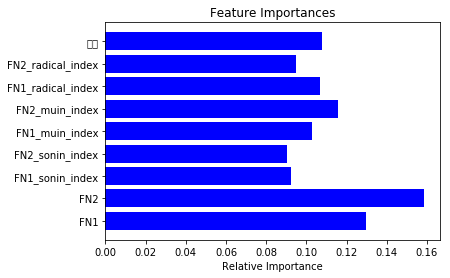

[(4, 38), (1, 33), (2, 32), (5, 29), (3, 28), (6, 24), (8, 12), (7, 9), (9, 8), (10, 6)] {1: 3, 2: 7, 3: 1, 4: 3, 5: 4, 6: 4, 7: 1}
[(1, 27), (4, 23), (10, 23), (6, 21), (3, 15), (5, 15), (2, 14), (8, 10), (9, 10), (7, 9)] {1: 1}
[(10, 37), (9, 34), (7, 26), (8, 25), (4, 15), (6, 11), (1, 9), (3, 9), (5, 9), (2, 8)] {8: 1, 9: 2, 10: 7, 7: 1}
[(4, 34), (5, 33), (2, 26), (3, 22), (1, 19), (8, 19), (7, 18), (6, 16), (10, 5), (9, 3)] {1: 2, 2: 4, 4: 3, 6: 2, 7: 3, 8: 1}
[(4, 32), (1, 29), (5, 27), (2, 25), (3, 25), (6, 18), (7, 11), (8, 10), (9, 5), (10, 2)] {2: 1, 3: 1, 6: 1, 7: 1}
[(2, 36), (4, 36), (1, 32), (5, 31), (3, 24), (6, 22), (8, 17), (7, 13), (9, 9), (10, 7)] {6: 1}
[(10, 32), (7, 31), (9, 31), (8, 29), (4, 18), (6, 14), (2, 12), (3, 12), (5, 11), (1, 7)] {8: 1, 10: 1, 7: 1}
[(5, 39), (4, 35), (3, 27), (1, 26), (2, 25), (6, 25), (8, 19), (7, 13), (9, 12), (10, 10)] {2: 1, 4: 2, 6: 2, 7: 4, 8: 1, 10: 1}
[(2, 32), (5, 31), (3, 27), (4, 27), (1, 26), (6, 26), (7, 9), (9, 9), (8, 7

[(3, 28), (5, 23), (8, 22), (9, 22), (2, 19), (4, 18), (6, 16), (7, 15), (1, 14), (10, 11)] {8: 1, 2: 2, 5: 1, 6: 1, 7: 2}
[(5, 27), (1, 26), (4, 25), (9, 25), (2, 22), (6, 18), (10, 17), (7, 16), (3, 15), (8, 14)] {3: 2}
[(5, 24), (3, 23), (4, 23), (6, 22), (2, 19), (1, 17), (9, 12), (10, 9), (8, 8), (7, 3)] {1: 1}
[(10, 38), (5, 35), (9, 32), (6, 26), (4, 25), (3, 24), (2, 20), (7, 19), (8, 18), (1, 16)] {3: 1}
[(2, 25), (3, 19), (4, 19), (5, 17), (1, 16), (6, 14), (8, 13), (7, 9), (10, 8), (9, 7)] {2: 1}
[(10, 41), (9, 32), (8, 22), (6, 20), (7, 20), (3, 10), (5, 10), (1, 7), (2, 7), (4, 6)] {8: 3, 9: 2, 10: 5}
[(10, 33), (9, 32), (7, 28), (8, 25), (4, 12), (6, 11), (5, 10), (3, 8), (1, 4), (2, 4)] {2: 2, 3: 2, 4: 2, 5: 3, 6: 7, 7: 11, 8: 12, 9: 8, 10: 1}
[(2, 33), (4, 31), (1, 23), (5, 23), (6, 17), (3, 16), (10, 11), (7, 9), (9, 9), (8, 7)] {1: 1}
[(5, 41), (4, 34), (2, 33), (1, 27), (3, 27), (6, 22), (8, 19), (7, 13), (9, 11), (10, 9)] {2: 1}
[(4, 40), (1, 35), (2, 31), (5, 28), 

[(2, 33), (3, 32), (4, 31), (1, 27), (5, 27), (6, 21), (8, 12), (9, 11), (7, 10), (10, 9)] {3: 1, 4: 1, 5: 1}
[(10, 36), (9, 34), (6, 26), (1, 24), (4, 21), (7, 17), (3, 14), (2, 13), (5, 13), (8, 12)] {7: 1}
[(10, 39), (9, 31), (8, 27), (7, 25), (6, 9), (3, 8), (4, 7), (5, 6), (1, 3), (2, 2)] {4: 1, 6: 2, 7: 2, 8: 1, 9: 3, 10: 3}
[(10, 32), (9, 31), (7, 26), (8, 20), (4, 15), (1, 12), (5, 11), (3, 9), (6, 8), (2, 5)] {10: 1, 6: 1, 7: 2}
[(4, 40), (2, 34), (5, 33), (1, 30), (6, 25), (9, 22), (10, 20), (3, 18), (7, 14), (8, 12)] {7: 1}
[(4, 41), (2, 36), (1, 33), (5, 29), (3, 25), (6, 21), (7, 13), (9, 11), (10, 11), (8, 8)] {1: 4, 2: 5, 4: 1, 5: 1, 6: 1, 7: 2, 8: 1, 9: 1}
[(4, 39), (1, 36), (2, 29), (6, 26), (5, 24), (3, 23), (7, 17), (8, 14), (10, 14), (9, 10)] {1: 3, 2: 3}
[(10, 42), (9, 36), (7, 22), (8, 19), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 3, 9: 9, 10: 9, 7: 3}
[(4, 39), (1, 35), (5, 34), (2, 31), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 1,

[(2, 36), (5, 36), (1, 35), (4, 33), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 8, 2: 10, 3: 6, 4: 9, 5: 8, 6: 6, 7: 4, 8: 1, 10: 1}
[(5, 31), (3, 24), (6, 24), (4, 22), (1, 21), (8, 20), (2, 19), (7, 14), (10, 12), (9, 6)] {8: 1, 1: 1, 5: 1, 6: 1}
[(7, 34), (9, 34), (4, 29), (10, 26), (8, 22), (1, 21), (2, 21), (5, 15), (6, 15), (3, 14)] {2: 2, 4: 1, 5: 2, 6: 5, 7: 3, 8: 1, 9: 2, 10: 1}
[(10, 39), (9, 28), (8, 24), (7, 23), (3, 7), (5, 7), (6, 7), (4, 4), (1, 2), (2, 1)] {6: 1}
[(1, 30), (4, 29), (2, 26), (6, 25), (5, 20), (3, 18), (7, 16), (10, 13), (8, 11), (9, 7)] {9: 1, 3: 1, 5: 1, 7: 1}
[(4, 42), (5, 36), (2, 31), (1, 25), (6, 23), (3, 16), (7, 14), (8, 13), (9, 12), (10, 4)] {3: 1}
[(6, 33), (4, 30), (2, 29), (5, 29), (1, 28), (9, 23), (3, 21), (10, 19), (7, 16), (8, 16)] {8: 1, 4: 2, 6: 2}
[(10, 41), (9, 34), (7, 24), (8, 20), (1, 12), (2, 9), (3, 9), (4, 9), (6, 8), (5, 7)] {9: 1, 10: 1}
[(1, 28), (4, 28), (6, 26), (10, 24), (9, 23), (5, 22), (2, 21), (3, 21), (7

[(10, 37), (9, 33), (7, 23), (8, 22), (4, 12), (6, 11), (1, 9), (2, 7), (3, 7), (5, 6)] {8: 6, 9: 6, 10: 7, 7: 1}
[(5, 37), (4, 36), (3, 34), (2, 32), (6, 29), (1, 26), (8, 21), (7, 14), (9, 10), (10, 10)] {3: 3, 4: 2, 5: 1}
[(4, 44), (1, 28), (5, 28), (6, 28), (2, 27), (7, 21), (3, 17), (9, 15), (8, 14), (10, 12)] {1: 1, 2: 2, 3: 3, 4: 1, 5: 3, 6: 2}
[(2, 36), (1, 30), (4, 28), (5, 28), (6, 26), (3, 19), (7, 9), (9, 9), (8, 7), (10, 7)] {8: 1, 2: 1}
[(2, 36), (5, 35), (4, 34), (1, 32), (3, 29), (6, 21), (7, 12), (8, 11), (9, 10), (10, 8)] {5: 1}
[(10, 33), (8, 31), (9, 30), (7, 27), (4, 20), (5, 19), (6, 17), (2, 12), (3, 11), (1, 8)] {10: 1}
[(10, 38), (9, 32), (7, 24), (8, 22), (6, 8), (3, 7), (4, 6), (5, 6), (2, 5), (1, 2)] {1: 1, 6: 1, 7: 2, 8: 3, 9: 2, 10: 2}
[(4, 37), (5, 37), (2, 34), (1, 23), (6, 23), (3, 19), (7, 18), (9, 17), (8, 12), (10, 7)] {4: 1}
[(4, 35), (1, 33), (2, 30), (5, 22), (3, 17), (6, 16), (7, 11), (8, 6), (9, 6), (10, 3)] {3: 1}
[(1, 35), (2, 35), (4, 35), (5

[(10, 31), (7, 30), (9, 29), (8, 28), (4, 16), (2, 8), (3, 8), (5, 7), (6, 7), (1, 6)] {8: 2, 9: 1, 4: 1}
[(4, 37), (2, 34), (5, 34), (1, 33), (3, 27), (6, 21), (7, 11), (8, 11), (9, 8), (10, 6)] {2: 2, 4: 1, 6: 1}
[(1, 34), (4, 34), (2, 32), (5, 29), (6, 21), (3, 20), (8, 15), (7, 14), (9, 12), (10, 10)] {5: 1}
[(10, 25), (7, 23), (4, 22), (3, 19), (5, 17), (1, 16), (2, 15), (9, 14), (6, 13), (8, 11)] {1: 1}
[(4, 37), (5, 36), (2, 30), (3, 29), (1, 27), (6, 22), (8, 20), (9, 20), (10, 13), (7, 11)] {3: 2}
[(5, 35), (4, 29), (3, 25), (2, 24), (8, 23), (7, 21), (1, 18), (6, 18), (9, 14), (10, 11)] {8: 1, 9: 1, 4: 1, 5: 1}
[(9, 27), (10, 25), (8, 20), (7, 18), (4, 15), (1, 14), (5, 12), (6, 12), (3, 11), (2, 8)] {3: 1}
[(10, 33), (9, 31), (2, 23), (7, 23), (5, 22), (3, 21), (8, 21), (4, 19), (1, 15), (6, 15)] {7: 1}
[(3, 32), (5, 31), (4, 28), (2, 24), (8, 23), (6, 22), (7, 18), (1, 17), (9, 14), (10, 10)] {3: 1, 4: 1}
[(7, 35), (5, 33), (8, 31), (10, 31), (4, 28), (9, 26), (6, 22), (2, 

[(8, 30), (7, 28), (4, 23), (10, 23), (5, 18), (2, 15), (9, 15), (3, 14), (6, 11), (1, 10)] {9: 1}
[(5, 40), (4, 39), (2, 32), (1, 30), (6, 26), (3, 21), (8, 19), (9, 12), (7, 11), (10, 9)] {2: 1, 3: 1, 5: 2, 6: 1}
[(2, 35), (1, 33), (4, 32), (5, 29), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 9, 2: 10, 3: 10, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1}
[(5, 34), (4, 28), (8, 24), (3, 22), (7, 22), (2, 20), (1, 15), (6, 15), (9, 13), (10, 10)] {1: 1}
[(4, 41), (5, 34), (2, 29), (1, 26), (6, 20), (3, 18), (7, 18), (9, 14), (10, 12), (8, 11)] {4: 1}
[(5, 39), (2, 30), (3, 29), (4, 28), (6, 25), (1, 22), (8, 17), (7, 15), (9, 8), (10, 7)] {6: 1}
[(10, 36), (7, 27), (9, 25), (8, 19), (1, 10), (2, 9), (3, 9), (6, 9), (4, 8), (5, 6)] {7: 1}
[(8, 30), (10, 28), (9, 27), (7, 22), (4, 12), (5, 10), (3, 9), (6, 8), (1, 4), (2, 3)] {8: 4, 9: 1, 7: 4}
[(7, 35), (4, 24), (8, 23), (10, 22), (1, 20), (2, 20), (5, 15), (9, 15), (3, 12), (6, 12)] {8: 1, 9: 1, 10: 1, 6: 1, 7: 1}
[(9, 37), (10, 36), (7, 2

[(2, 37), (5, 35), (4, 33), (1, 31), (3, 30), (6, 23), (9, 12), (7, 10), (8, 9), (10, 7)] {1: 1}
[(5, 37), (2, 35), (4, 35), (1, 34), (3, 28), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 2, 3: 1, 4: 1, 5: 6, 6: 1}
[(4, 39), (2, 31), (1, 30), (5, 23), (3, 21), (6, 20), (7, 11), (8, 8), (9, 8), (10, 1)] {1: 1}
[(10, 24), (7, 21), (4, 19), (8, 17), (3, 16), (9, 13), (1, 12), (2, 11), (5, 11), (6, 11)] {5: 1}
[(10, 31), (7, 29), (8, 29), (9, 28), (5, 15), (6, 14), (4, 13), (3, 7), (1, 5), (2, 4)] {1: 1, 3: 1, 5: 1, 6: 9, 7: 17, 8: 3, 9: 3, 10: 3}
[(10, 40), (9, 35), (7, 19), (8, 16), (6, 13), (2, 9), (4, 9), (5, 9), (3, 8), (1, 7)] {8: 1}
[(10, 34), (9, 33), (4, 30), (7, 24), (8, 23), (5, 19), (1, 15), (6, 15), (2, 12), (3, 11)] {9: 1, 2: 1, 4: 1, 7: 2}
[(2, 28), (4, 26), (5, 23), (3, 21), (1, 18), (6, 16), (7, 11), (8, 11), (9, 10), (10, 2)] {2: 1}
[(5, 39), (4, 35), (2, 27), (1, 24), (3, 20), (6, 20), (8, 14), (7, 12), (9, 9), (10, 7)] {4: 1}
[(7, 28), (10, 27), (6, 26), (5, 25), (8,

[(5, 37), (4, 34), (2, 33), (6, 24), (1, 23), (3, 20), (7, 12), (8, 12), (9, 12), (10, 5)] {1: 2, 2: 2, 3: 1, 4: 1, 6: 1}
[(5, 38), (2, 34), (4, 30), (3, 25), (1, 24), (6, 22), (7, 12), (8, 11), (9, 8), (10, 8)] {3: 1, 4: 1}
[(10, 35), (9, 31), (7, 30), (8, 28), (4, 16), (1, 13), (2, 12), (6, 10), (3, 9), (5, 7)] {8: 2}
[(6, 23), (7, 22), (5, 21), (4, 19), (10, 19), (1, 17), (2, 16), (8, 16), (9, 14), (3, 9)] {9: 1, 10: 1, 5: 1, 6: 4, 7: 1}
[(3, 31), (5, 30), (2, 27), (4, 25), (1, 24), (6, 24), (8, 18), (9, 14), (10, 14), (7, 10)] {6: 2}
[(10, 37), (9, 24), (7, 22), (8, 18), (6, 11), (1, 6), (3, 6), (5, 6), (2, 5), (4, 3)] {8: 1}
[(8, 26), (5, 25), (6, 25), (3, 24), (4, 21), (10, 21), (1, 20), (7, 20), (2, 18), (9, 18)] {3: 2, 4: 4, 5: 1, 6: 1}
[(4, 28), (7, 26), (8, 26), (5, 25), (6, 17), (1, 16), (3, 16), (10, 13), (2, 12), (9, 11)] {5: 1}
[(5, 41), (4, 37), (2, 33), (6, 32), (3, 29), (1, 26), (8, 17), (7, 13), (9, 13), (10, 9)] {1: 2, 2: 6, 3: 3, 4: 6, 5: 8, 6: 5, 7: 2}
[(4, 33), (2

[(4, 28), (1, 27), (10, 27), (6, 20), (5, 18), (3, 16), (2, 14), (8, 14), (7, 13), (9, 13)] {1: 3, 2: 5, 3: 3, 4: 1, 6: 2, 7: 1, 9: 2, 10: 1}
[(10, 40), (8, 30), (9, 28), (7, 24), (6, 14), (5, 11), (3, 8), (4, 8), (1, 3), (2, 3)] {10: 1, 7: 1}
[(10, 37), (9, 31), (7, 28), (8, 28), (6, 19), (5, 18), (3, 12), (4, 11), (1, 8), (2, 7)] {1: 3, 2: 3, 3: 8, 4: 7, 5: 10, 6: 14, 7: 12, 8: 11, 9: 5, 10: 5}
[(4, 34), (2, 33), (1, 26), (5, 26), (3, 20), (6, 14), (7, 14), (8, 7), (9, 7), (10, 2)] {8: 1, 1: 1, 2: 1, 6: 1, 7: 1}
[(10, 41), (9, 33), (8, 28), (7, 23), (6, 14), (5, 11), (4, 10), (3, 9), (2, 5), (1, 4)] {4: 2}
[(7, 30), (8, 30), (4, 24), (10, 21), (1, 17), (5, 15), (2, 12), (3, 11), (6, 10), (9, 10)] {1: 2}
[(4, 41), (1, 33), (2, 33), (5, 31), (3, 24), (6, 20), (9, 15), (7, 11), (8, 9), (10, 4)] {3: 1, 5: 2}
[(4, 40), (1, 31), (9, 27), (2, 25), (5, 24), (6, 23), (3, 20), (10, 19), (7, 18), (8, 10)] {2: 2}
[(4, 37), (1, 29), (2, 29), (5, 26), (3, 22), (6, 18), (7, 12), (8, 12), (9, 5), (1

[(1, 34), (4, 34), (2, 32), (3, 29), (5, 26), (6, 23), (9, 13), (7, 11), (8, 9), (10, 8)] {1: 1, 3: 1, 5: 1}
[(10, 38), (9, 27), (7, 23), (8, 21), (6, 13), (4, 11), (2, 10), (5, 9), (3, 8), (1, 5)] {9: 1, 10: 1, 4: 1, 7: 4}
[(10, 35), (8, 31), (9, 29), (7, 21), (6, 17), (4, 13), (5, 12), (3, 8), (1, 7), (2, 4)] {9: 1}
[(4, 35), (1, 31), (2, 27), (3, 26), (5, 24), (6, 24), (8, 16), (7, 12), (9, 8), (10, 4)] {8: 1, 3: 1, 4: 1, 6: 2}
[(4, 41), (1, 32), (2, 28), (5, 28), (3, 26), (6, 24), (7, 20), (8, 20), (10, 12), (9, 11)] {5: 1}
[(5, 37), (4, 32), (1, 31), (2, 28), (3, 24), (6, 23), (9, 11), (7, 10), (8, 8), (10, 5)] {3: 1}
[(1, 35), (4, 33), (6, 28), (2, 26), (5, 25), (3, 21), (7, 16), (10, 14), (8, 13), (9, 9)] {1: 1, 7: 1}
[(4, 36), (2, 27), (1, 26), (9, 26), (5, 25), (10, 23), (3, 22), (6, 19), (8, 17), (7, 14)] {3: 1}
[(4, 32), (2, 29), (5, 26), (1, 22), (7, 19), (3, 17), (6, 17), (10, 9), (8, 8), (9, 8)] {1: 1, 2: 3, 3: 2, 4: 2, 5: 1, 6: 1}
[(10, 37), (9, 35), (7, 23), (8, 17), (1

[(10, 35), (9, 28), (8, 25), (3, 17), (7, 17), (5, 15), (2, 13), (6, 12), (4, 7), (1, 6)] {8: 1, 10: 1, 3: 2, 4: 1}
[(4, 41), (5, 35), (1, 34), (2, 33), (6, 26), (3, 23), (7, 12), (8, 10), (9, 8), (10, 4)] {1: 7, 2: 13, 3: 4, 4: 8, 5: 10, 6: 11, 7: 2}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(4, 36), (2, 34), (1, 33), (3, 28), (5, 28), (6, 28), (8, 14), (7, 9), (9, 8), (10, 7)] {2: 6, 3: 1, 4: 2, 5: 3, 6: 3}
[(10, 39), (9, 27), (7, 23), (8, 22), (6, 13), (3, 8), (5, 8), (2, 6), (4, 5), (1, 2)] {8: 1, 9: 1, 10: 1, 6: 1}
[(4, 41), (2, 34), (5, 32), (1, 30), (3, 22), (6, 22), (9, 12), (7, 11), (8, 9), (10, 2)] {7: 1}
[(4, 39), (1, 34), (2, 32), (5, 30), (3, 24), (6, 24), (7, 11), (8, 8), (9, 8), (10, 5)] {2: 1}
[(10, 40), (9, 32), (8, 30), (7, 25), (5, 16), (6, 15), (3, 13), (4, 8), (1, 3), (2, 3)] {4: 1, 5: 2, 6: 4, 7: 2, 8: 4, 9: 1, 10: 3}
[(4, 35), (2, 34), (5, 28), (1, 22), (3, 19

[(2, 37), (4, 35), (5, 30), (1, 29), (3, 20), (6, 20), (7, 12), (9, 10), (8, 9), (10, 6)] {8: 1, 1: 1, 6: 1}
[(10, 36), (7, 27), (8, 26), (9, 23), (6, 9), (3, 7), (4, 7), (5, 6), (1, 4), (2, 1)] {8: 1, 9: 1, 10: 1}
[(5, 33), (2, 28), (4, 27), (1, 26), (7, 25), (8, 22), (3, 20), (6, 19), (10, 13), (9, 8)] {1: 1, 3: 4, 5: 1}
[(5, 28), (8, 23), (10, 20), (7, 19), (3, 13), (4, 13), (6, 13), (9, 12), (2, 8), (1, 6)] {8: 1, 9: 1, 2: 2, 4: 1, 5: 1}
[(4, 38), (2, 37), (5, 34), (1, 31), (6, 29), (3, 28), (9, 20), (7, 14), (8, 12), (10, 10)] {3: 2, 4: 1}
[(3, 28), (2, 24), (5, 23), (4, 18), (8, 18), (7, 17), (10, 16), (1, 15), (6, 12), (9, 10)] {2: 5, 3: 2, 4: 1, 7: 1}
[(10, 38), (9, 24), (7, 19), (8, 16), (3, 8), (4, 8), (6, 7), (5, 5), (2, 4), (1, 1)] {3: 1}
[(5, 33), (4, 26), (2, 24), (3, 24), (8, 24), (7, 20), (1, 15), (6, 15), (9, 12), (10, 7)] {1: 2, 2: 1, 7: 1}
[(4, 41), (1, 35), (5, 35), (2, 31), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 8, 2: 6, 3: 11, 4: 15, 5: 10, 6: 4}

[(4, 32), (5, 32), (3, 29), (2, 27), (6, 27), (1, 25), (8, 12), (7, 10), (9, 9), (10, 7)] {4: 2, 5: 1, 6: 3, 7: 2}
[(4, 32), (7, 31), (10, 29), (8, 26), (5, 24), (9, 24), (6, 21), (2, 17), (1, 15), (3, 14)] {9: 1, 6: 1, 7: 1}
[(10, 39), (9, 34), (7, 24), (8, 19), (1, 13), (5, 13), (2, 10), (4, 10), (3, 9), (6, 8)] {8: 1, 9: 2, 7: 1}
[(10, 39), (9, 35), (7, 19), (1, 14), (8, 12), (3, 11), (4, 10), (2, 9), (6, 9), (5, 6)] {9: 2, 10: 1}
[(4, 37), (5, 37), (6, 30), (3, 27), (1, 25), (2, 25), (8, 15), (7, 10), (9, 10), (10, 7)] {5: 1}
[(9, 34), (10, 32), (7, 27), (1, 26), (6, 26), (2, 25), (5, 25), (3, 24), (4, 24), (8, 24)] {9: 1, 6: 2}
[(7, 35), (5, 29), (8, 28), (10, 26), (4, 25), (2, 20), (3, 17), (6, 17), (9, 17), (1, 12)] {9: 1, 5: 1, 6: 1}
[(10, 41), (9, 37), (8, 23), (7, 22), (6, 17), (1, 15), (3, 14), (4, 13), (2, 10), (5, 9)] {5: 1, 6: 4, 7: 3, 8: 3, 9: 5, 10: 5}
[(10, 31), (7, 30), (8, 29), (9, 22), (4, 18), (2, 14), (6, 13), (5, 12), (1, 10), (3, 9)] {9: 2, 4: 1}
[(7, 35), (8, 3

[(5, 38), (4, 35), (2, 34), (1, 27), (3, 27), (6, 27), (8, 12), (7, 10), (9, 9), (10, 8)] {2: 1}
[(5, 41), (4, 35), (2, 31), (1, 23), (3, 22), (6, 20), (8, 19), (7, 13), (9, 9), (10, 9)] {1: 1, 2: 1, 4: 1}
[(2, 35), (4, 34), (5, 34), (1, 33), (3, 23), (6, 21), (7, 10), (9, 8), (8, 7), (10, 5)] {2: 1, 6: 1}
[(4, 41), (1, 34), (2, 27), (5, 26), (7, 22), (3, 21), (6, 17), (9, 16), (8, 15), (10, 15)] {3: 1}
[(4, 34), (1, 28), (3, 25), (5, 25), (2, 24), (7, 22), (6, 18), (8, 16), (10, 14), (9, 9)] {2: 1, 4: 1, 5: 2}
[(4, 36), (2, 33), (5, 32), (3, 27), (1, 26), (6, 21), (7, 12), (8, 11), (9, 9), (10, 4)] {2: 5, 3: 1, 5: 1}
[(4, 43), (5, 36), (2, 31), (1, 28), (3, 23), (6, 22), (8, 16), (9, 12), (7, 11), (10, 4)] {4: 1, 5: 1}
[(5, 38), (6, 32), (2, 30), (4, 30), (3, 29), (1, 26), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 10, 2: 3, 3: 11, 4: 6, 5: 13, 6: 9, 7: 2, 8: 1}
[(10, 36), (7, 27), (9, 26), (8, 20), (6, 9), (5, 7), (4, 6), (2, 4), (1, 3), (3, 3)] {10: 1}
[(4, 41), (5, 37), (2, 36), (1, 32

[(5, 40), (4, 33), (2, 32), (3, 29), (1, 28), (6, 28), (8, 14), (7, 13), (9, 9), (10, 8)] {1: 5, 2: 4, 3: 9, 4: 8, 5: 8, 6: 4, 7: 3}
[(10, 37), (9, 31), (7, 24), (8, 20), (6, 7), (3, 6), (4, 6), (5, 4), (1, 2), (2, 2)] {4: 1, 6: 2, 7: 1, 8: 5, 9: 6, 10: 4}
[(10, 30), (9, 29), (1, 18), (6, 18), (7, 15), (2, 14), (5, 14), (3, 12), (4, 11), (8, 10)] {9: 1}
[(4, 35), (1, 34), (5, 31), (2, 29), (3, 28), (6, 25), (9, 19), (7, 15), (10, 15), (8, 14)] {10: 1}
[(4, 42), (2, 34), (1, 28), (5, 28), (3, 21), (6, 17), (7, 15), (9, 14), (8, 10), (10, 4)] {1: 1, 2: 1}
[(4, 42), (5, 35), (2, 32), (1, 31), (3, 22), (6, 22), (7, 16), (9, 13), (8, 12), (10, 10)] {2: 1, 5: 1}
[(5, 36), (4, 34), (1, 33), (2, 33), (6, 25), (3, 23), (7, 10), (8, 7), (9, 7), (10, 5)] {2: 3, 4: 1, 6: 1}
[(10, 40), (9, 31), (7, 20), (8, 17), (6, 15), (3, 12), (1, 8), (2, 8), (5, 8), (4, 6)] {10: 1}
[(10, 39), (8, 28), (9, 28), (7, 24), (6, 9), (4, 8), (5, 8), (3, 7), (1, 2), (2, 1)] {8: 3, 9: 1, 10: 1, 4: 1, 6: 1}
[(10, 28), (1

[(4, 39), (2, 37), (1, 31), (5, 30), (6, 21), (3, 20), (7, 10), (9, 10), (8, 8), (10, 6)] {3: 1}
[(4, 31), (2, 30), (5, 30), (1, 27), (3, 25), (6, 19), (7, 13), (8, 11), (10, 6), (9, 5)] {1: 2, 3: 1, 6: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(4, 36), (2, 30), (1, 29), (5, 28), (3, 23), (6, 21), (8, 10), (7, 8), (9, 8), (10, 5)] {1: 1, 2: 1, 3: 1, 4: 1, 6: 1, 7: 1}
[(10, 41), (9, 32), (7, 24), (8, 18), (3, 8), (6, 8), (5, 7), (1, 6), (4, 6), (2, 5)] {4: 1}
[(5, 37), (4, 28), (2, 26), (7, 22), (8, 20), (3, 18), (1, 17), (6, 15), (9, 14), (10, 8)] {4: 1, 5: 1, 6: 1, 7: 2}
[(5, 33), (4, 32), (3, 28), (9, 27), (8, 21), (2, 20), (1, 19), (6, 18), (7, 15), (10, 15)] {8: 1, 4: 1, 5: 2}
[(4, 38), (5, 35), (3, 32), (2, 28), (1, 27), (6, 22), (8, 20), (7, 15), (9, 13), (10, 7)] {3: 1}
[(10, 42), (9, 35), (7, 20), (8, 20), (4, 16), (5, 16), (2, 15), (6, 13), (3, 12), (1, 7)] {10: 1, 

[(10, 37), (9, 32), (7, 27), (8, 20), (6, 8), (3, 7), (4, 7), (5, 6), (2, 4), (1, 3)] {8: 1, 9: 1}
[(10, 41), (9, 32), (7, 24), (8, 20), (3, 8), (6, 8), (5, 7), (1, 6), (4, 6), (2, 5)] {8: 1, 9: 3, 10: 1, 4: 1, 7: 4}
[(4, 44), (5, 31), (1, 28), (2, 27), (6, 24), (3, 21), (8, 16), (7, 15), (9, 13), (10, 5)] {2: 2}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {2: 1, 5: 1, 7: 4, 8: 8, 9: 4, 10: 2}
[(10, 41), (9, 30), (8, 21), (7, 18), (3, 16), (6, 12), (4, 10), (5, 10), (1, 8), (2, 8)] {10: 1, 7: 1}
[(2, 34), (4, 34), (1, 32), (5, 26), (3, 25), (6, 18), (7, 9), (9, 7), (8, 6), (10, 4)] {2: 2, 3: 3, 4: 1}
[(10, 38), (9, 34), (8, 23), (7, 22), (6, 14), (3, 11), (4, 10), (5, 7), (1, 5), (2, 4)] {8: 1}
[(4, 38), (1, 30), (5, 30), (6, 25), (2, 24), (3, 22), (8, 16), (7, 12), (9, 6), (10, 3)] {2: 3, 3: 1, 4: 3, 5: 1, 6: 2, 7: 1}
[(4, 25), (8, 23), (7, 21), (2, 20), (3, 20), (5, 20), (1, 15), (10, 13), (6, 12), (9, 9)] {4: 1}
[(2, 34), (4, 30), (1, 28), (

[(10, 37), (9, 32), (7, 24), (8, 22), (6, 8), (3, 7), (4, 6), (2, 4), (5, 4), (1, 2)] {8: 3, 9: 4, 10: 7, 4: 2}
[(4, 32), (5, 32), (2, 29), (3, 24), (6, 24), (1, 22), (7, 14), (8, 8), (9, 6), (10, 2)] {1: 3, 2: 4, 3: 6, 4: 6, 5: 5, 6: 2, 7: 5, 8: 1, 9: 3, 10: 1}
[(9, 29), (10, 29), (8, 27), (7, 15), (3, 12), (6, 12), (5, 11), (2, 10), (4, 5), (1, 2)] {9: 1, 4: 1}
[(4, 40), (2, 30), (1, 28), (5, 26), (6, 21), (7, 20), (3, 17), (10, 12), (8, 11), (9, 11)] {2: 1, 5: 1, 6: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(5, 41), (4, 33), (2, 27), (6, 27), (3, 24), (8, 23), (1, 20), (7, 14), (9, 10), (10, 7)] {1: 3, 2: 4, 3: 2, 4: 2, 5: 4, 6: 2, 7: 6, 8: 1, 9: 2, 10: 2}
[(10, 37), (9, 34), (7, 26), (8, 25), (4, 15), (6, 11), (1, 9), (3, 9), (5, 9), (2, 8)] {8: 1, 9: 2, 10: 7, 7: 1}
[(2, 35), (1, 32), (4, 28), (3, 25), (5, 25), (6, 25), (9, 10), (7, 9), (8, 9), (10, 6)] {7: 1, 1: 2, 3: 2, 6: 1, 9: 1}


[(10, 43), (8, 27), (7, 25), (9, 25), (5, 16), (6, 15), (3, 11), (4, 9), (1, 6), (2, 4)] {8: 1, 7: 1}
[(4, 29), (2, 28), (1, 26), (7, 18), (5, 16), (6, 14), (10, 10), (3, 9), (9, 9), (8, 8)] {1: 2, 2: 2, 3: 1, 6: 2, 9: 1, 10: 2}
[(10, 33), (8, 29), (7, 28), (9, 28), (5, 12), (4, 11), (6, 9), (3, 8), (1, 4), (2, 2)] {4: 1, 6: 1, 7: 1}
[(9, 27), (10, 21), (6, 18), (5, 17), (2, 16), (3, 14), (4, 13), (1, 11), (8, 11), (7, 9)] {10: 1}
[(4, 36), (5, 33), (2, 30), (1, 29), (6, 25), (3, 23), (8, 14), (7, 12), (9, 5), (10, 3)] {1: 4, 2: 3, 3: 2, 4: 3, 5: 1, 6: 2, 7: 1, 8: 1}
[(5, 29), (2, 24), (7, 24), (3, 22), (4, 22), (8, 21), (1, 12), (6, 12), (10, 12), (9, 10)] {1: 1, 3: 3, 6: 1}
[(4, 40), (2, 34), (5, 32), (1, 30), (3, 24), (6, 23), (7, 11), (8, 10), (9, 8), (10, 2)] {1: 1}
[(10, 30), (9, 24), (4, 17), (6, 17), (1, 16), (2, 12), (8, 12), (7, 11), (3, 9), (5, 5)] {6: 1}
[(5, 36), (4, 35), (1, 26), (2, 26), (3, 26), (6, 24), (8, 14), (7, 13), (9, 7), (10, 6)] {6: 1}
[(4, 39), (1, 35), (2, 3

[(5, 36), (4, 34), (3, 27), (6, 23), (2, 22), (1, 21), (8, 20), (7, 16), (9, 9), (10, 5)] {1: 2, 2: 4, 3: 8, 4: 12, 5: 10, 6: 15, 7: 5, 8: 1, 9: 1, 10: 1}
[(4, 38), (5, 36), (8, 31), (6, 28), (7, 28), (2, 25), (1, 21), (3, 19), (10, 15), (9, 14)] {1: 1, 2: 3, 3: 1}
[(2, 26), (5, 22), (3, 20), (1, 15), (4, 15), (6, 15), (10, 11), (7, 9), (8, 8), (9, 5)] {8: 1, 9: 1, 2: 1, 3: 4, 5: 3}
[(4, 42), (1, 36), (2, 32), (5, 29), (3, 24), (6, 24), (7, 17), (8, 14), (10, 14), (9, 10)] {2: 1, 4: 1}
[(5, 40), (4, 34), (2, 30), (1, 25), (3, 24), (7, 23), (8, 21), (6, 20), (9, 14), (10, 12)] {1: 1, 3: 1, 5: 1}
[(4, 37), (2, 34), (1, 32), (5, 31), (3, 24), (6, 24), (8, 9), (7, 8), (9, 8), (10, 5)] {3: 1}
[(4, 39), (2, 31), (5, 31), (1, 30), (3, 22), (7, 19), (8, 18), (6, 17), (9, 12), (10, 11)] {3: 1}
[(10, 39), (9, 34), (7, 20), (1, 13), (8, 12), (3, 11), (6, 9), (2, 8), (4, 7), (5, 6)] {9: 1}
[(3, 28), (8, 22), (4, 19), (5, 18), (2, 16), (7, 15), (6, 12), (1, 11), (9, 9), (10, 8)] {3: 1}
[(10, 36), (

[(10, 38), (7, 28), (9, 27), (8, 26), (5, 9), (6, 9), (3, 8), (4, 7), (1, 4), (2, 3)] {9: 1}
[(4, 39), (2, 32), (5, 31), (1, 28), (3, 23), (6, 19), (7, 11), (8, 8), (9, 8), (10, 2)] {5: 2}
[(10, 39), (9, 35), (2, 24), (1, 21), (4, 21), (3, 19), (6, 16), (5, 15), (7, 15), (8, 10)] {10: 1}
[(10, 37), (8, 27), (9, 25), (7, 24), (5, 22), (4, 21), (6, 17), (3, 12), (1, 11), (2, 7)] {6: 2, 7: 1}
[(10, 36), (9, 30), (8, 24), (7, 23), (6, 13), (3, 10), (4, 6), (1, 5), (5, 5), (2, 2)] {8: 3}
[(10, 31), (9, 30), (7, 25), (8, 25), (4, 12), (5, 11), (3, 7), (6, 7), (1, 3), (2, 3)] {9: 1, 5: 1, 7: 1}
[(10, 43), (9, 27), (7, 24), (8, 23), (3, 10), (6, 9), (5, 8), (1, 6), (2, 4), (4, 3)] {8: 1, 10: 1}
[(10, 40), (8, 28), (9, 27), (7, 26), (5, 11), (6, 10), (3, 8), (4, 8), (2, 4), (1, 3)] {8: 1, 9: 1}
[(10, 29), (4, 23), (9, 22), (5, 19), (1, 17), (6, 17), (7, 17), (2, 16), (3, 15), (8, 15)] {4: 2}
[(2, 26), (1, 24), (5, 20), (4, 19), (3, 13), (6, 11), (7, 11), (8, 11), (9, 11), (10, 9)] {1: 2, 2: 1}


[(5, 37), (4, 33), (2, 31), (1, 25), (6, 23), (3, 22), (8, 18), (7, 15), (9, 10), (10, 4)] {4: 2}
[(6, 32), (4, 31), (5, 31), (7, 23), (10, 23), (1, 22), (2, 22), (9, 20), (8, 19), (3, 17)] {1: 1, 6: 1}
[(8, 23), (7, 22), (10, 22), (5, 21), (9, 15), (4, 10), (3, 8), (6, 7), (2, 3), (1, 2)] {1: 1, 2: 1, 4: 3, 5: 4, 6: 4, 7: 2, 8: 3, 9: 2, 10: 2}
[(10, 36), (7, 30), (8, 27), (9, 24), (4, 19), (5, 17), (3, 16), (6, 15), (2, 14), (1, 13)] {10: 1}
[(5, 27), (4, 26), (7, 26), (2, 25), (8, 22), (3, 21), (1, 17), (6, 14), (9, 11), (10, 8)] {8: 1}
[(9, 27), (5, 26), (10, 24), (2, 20), (7, 20), (1, 19), (4, 18), (3, 15), (8, 15), (6, 14)] {3: 2}
[(10, 36), (7, 25), (8, 25), (9, 25), (2, 16), (3, 16), (6, 14), (4, 12), (1, 11), (5, 11)] {4: 1}
[(4, 40), (2, 33), (5, 32), (1, 28), (3, 26), (6, 21), (8, 15), (9, 11), (7, 10), (10, 4)] {5: 1, 6: 1}
[(10, 34), (9, 32), (8, 26), (7, 24), (4, 10), (6, 10), (3, 7), (5, 7), (2, 5), (1, 3)] {8: 1, 9: 3, 10: 2}
[(4, 41), (2, 36), (1, 34), (5, 34), (3, 31),

[(10, 35), (7, 28), (8, 28), (9, 26), (3, 8), (4, 7), (5, 7), (6, 7), (1, 4), (2, 2)] {8: 1, 9: 1}
[(5, 35), (1, 32), (4, 32), (2, 31), (6, 27), (3, 23), (8, 12), (7, 11), (9, 7), (10, 5)] {4: 1}
[(10, 36), (9, 25), (7, 24), (8, 18), (5, 8), (3, 6), (4, 5), (6, 4), (2, 3), (1, 2)] {8: 1}
[(7, 35), (10, 33), (8, 29), (4, 27), (9, 26), (5, 21), (2, 16), (3, 13), (1, 12), (6, 10)] {7: 1}
[(8, 32), (10, 26), (9, 24), (5, 23), (7, 21), (6, 19), (4, 14), (3, 13), (2, 11), (1, 8)] {5: 1, 6: 1}
[(5, 27), (7, 17), (8, 16), (4, 15), (9, 14), (10, 14), (2, 13), (3, 13), (1, 10), (6, 8)] {9: 2}
[(5, 34), (2, 32), (4, 32), (1, 31), (3, 23), (6, 20), (8, 19), (7, 16), (10, 9), (9, 6)] {3: 3, 4: 1, 5: 1, 7: 1}
[(6, 22), (8, 21), (10, 19), (7, 18), (1, 17), (4, 16), (2, 15), (9, 15), (5, 12), (3, 10)] {8: 2, 1: 2, 10: 1, 3: 1, 7: 1}
[(4, 40), (5, 40), (1, 34), (2, 31), (3, 28), (6, 28), (8, 19), (7, 18), (9, 16), (10, 8)] {1: 1}
[(5, 40), (4, 35), (2, 34), (1, 31), (6, 28), (3, 27), (8, 20), (7, 12), 

[(7, 34), (8, 32), (4, 29), (10, 24), (1, 17), (5, 17), (9, 17), (3, 14), (2, 12), (6, 10)] {8: 1, 10: 1}
[(10, 40), (9, 31), (8, 29), (7, 26), (6, 17), (5, 10), (3, 9), (4, 8), (1, 4), (2, 3)] {8: 2, 9: 3, 10: 1, 6: 1, 7: 2}
[(10, 37), (9, 26), (7, 23), (5, 22), (6, 22), (8, 20), (1, 18), (3, 13), (4, 13), (2, 10)] {8: 1, 2: 1, 4: 1, 5: 1, 6: 1}
[(2, 18), (9, 18), (10, 17), (1, 15), (3, 15), (7, 14), (4, 11), (5, 9), (8, 8), (6, 6)] {9: 1}
[(7, 34), (8, 29), (10, 27), (6, 14), (9, 14), (4, 13), (5, 12), (1, 9), (2, 9), (3, 8)] {8: 1, 7: 2}
[(2, 26), (4, 19), (1, 17), (5, 17), (3, 16), (7, 13), (8, 11), (6, 8), (9, 4), (10, 2)] {1: 1, 3: 1, 4: 1}
[(5, 37), (6, 34), (4, 30), (1, 28), (2, 28), (3, 28), (9, 27), (8, 24), (10, 22), (7, 20)] {5: 2, 6: 2}
[(10, 23), (7, 22), (5, 21), (9, 19), (8, 16), (2, 13), (3, 10), (4, 9), (1, 6), (6, 5)] {1: 1, 2: 2, 5: 1, 6: 1, 9: 2, 10: 1}
[(10, 41), (9, 31), (7, 23), (8, 21), (6, 9), (3, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {10: 1}
[(10, 33), (9, 32),

[(1, 30), (4, 30), (2, 29), (5, 27), (3, 22), (6, 19), (7, 14), (8, 14), (9, 5), (10, 2)] {4: 1}
[(9, 31), (10, 31), (7, 28), (8, 23), (4, 18), (5, 14), (3, 11), (1, 10), (2, 10), (6, 7)] {1: 1}
[(2, 35), (4, 35), (1, 33), (5, 30), (6, 25), (3, 24), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 7, 2: 10, 3: 5, 4: 1, 5: 3, 6: 3}
[(10, 35), (9, 30), (7, 25), (8, 25), (4, 12), (5, 8), (3, 7), (6, 7), (1, 3), (2, 3)] {3: 1, 4: 1, 6: 1, 8: 1, 9: 3, 10: 1}
[(4, 43), (5, 39), (2, 32), (1, 31), (6, 24), (3, 22), (8, 16), (7, 13), (9, 11), (10, 4)] {4: 2}
[(10, 38), (9, 34), (7, 20), (1, 14), (6, 12), (8, 12), (3, 11), (2, 7), (4, 7), (5, 4)] {10: 1}
[(5, 36), (4, 28), (8, 23), (7, 22), (3, 19), (2, 17), (6, 16), (1, 13), (9, 10), (10, 7)] {2: 3, 3: 1, 4: 4, 5: 5, 6: 2, 9: 1}
[(7, 21), (10, 20), (5, 18), (8, 18), (4, 14), (9, 13), (3, 6), (6, 6), (1, 3), (2, 2)] {9: 1, 10: 1, 7: 1}
[(4, 37), (2, 36), (5, 35), (1, 34), (6, 23), (3, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1, 2: 3}
[(5, 39), (4, 37), (

[(5, 36), (4, 34), (2, 26), (3, 23), (1, 20), (6, 17), (8, 15), (7, 12), (9, 7), (10, 3)] {1: 4, 2: 3, 3: 1, 4: 3, 5: 5, 6: 4, 8: 1}
[(2, 36), (4, 30), (1, 29), (5, 28), (3, 22), (6, 21), (7, 9), (10, 9), (8, 8), (9, 8)] {2: 1}
[(9, 27), (4, 22), (1, 21), (2, 21), (3, 21), (6, 19), (5, 15), (10, 15), (8, 14), (7, 12)] {2: 1, 6: 1}
[(1, 36), (4, 33), (2, 32), (5, 27), (6, 24), (3, 22), (7, 17), (10, 15), (8, 14), (9, 10)] {5: 1}
[(4, 39), (1, 33), (2, 33), (5, 31), (3, 24), (6, 23), (9, 14), (8, 13), (7, 10), (10, 8)] {3: 1}
[(4, 37), (1, 30), (2, 26), (5, 24), (6, 23), (3, 18), (7, 18), (10, 14), (8, 13), (9, 12)] {2: 1}
[(10, 27), (6, 26), (9, 22), (3, 20), (1, 17), (5, 17), (2, 15), (4, 15), (8, 9), (7, 8)] {6: 1}
[(4, 40), (5, 34), (1, 30), (2, 29), (3, 24), (6, 21), (7, 15), (8, 15), (9, 9), (10, 2)] {1: 6, 3: 10, 4: 9, 5: 5, 6: 10, 7: 9, 8: 4, 9: 1, 10: 2}
[(4, 38), (5, 37), (2, 35), (1, 34), (3, 28), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 1}
[(4, 28), (8, 25), (3, 23), (

[(5, 37), (4, 36), (2, 35), (1, 32), (3, 29), (6, 25), (8, 14), (7, 11), (9, 10), (10, 7)] {1: 7, 2: 6, 3: 8, 4: 6, 5: 7, 6: 2}
[(10, 35), (9, 31), (7, 25), (8, 25), (4, 17), (3, 11), (6, 11), (5, 9), (1, 7), (2, 3)] {10: 1}
[(9, 30), (8, 27), (10, 27), (7, 21), (4, 17), (5, 14), (6, 12), (1, 10), (2, 9), (3, 8)] {8: 1, 9: 1, 10: 1}
[(4, 26), (6, 24), (5, 23), (2, 22), (1, 21), (3, 16), (7, 15), (8, 15), (9, 7), (10, 1)] {1: 1}
[(4, 41), (5, 36), (2, 35), (1, 34), (3, 28), (6, 23), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 1}
[(10, 42), (9, 33), (7, 19), (8, 18), (5, 16), (6, 14), (3, 9), (1, 7), (4, 7), (2, 6)] {10: 1}
[(10, 29), (9, 27), (7, 25), (2, 23), (4, 22), (5, 20), (1, 19), (3, 18), (8, 17), (6, 13)] {4: 1}
[(5, 41), (4, 32), (2, 27), (6, 24), (3, 23), (1, 22), (7, 18), (8, 18), (9, 16), (10, 10)] {6: 1}
[(5, 31), (4, 30), (2, 23), (1, 22), (7, 22), (6, 21), (3, 19), (8, 18), (10, 15), (9, 13)] {9: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 1

[(2, 36), (4, 31), (1, 29), (5, 28), (3, 21), (6, 20), (9, 12), (7, 9), (10, 9), (8, 7)] {1: 1}
[(4, 43), (1, 36), (5, 34), (6, 33), (2, 32), (3, 23), (7, 18), (8, 18), (10, 15), (9, 10)] {4: 2}
[(5, 37), (4, 33), (2, 27), (3, 22), (1, 21), (6, 21), (8, 20), (7, 15), (9, 6), (10, 5)] {2: 2, 3: 3, 4: 3, 5: 1, 6: 1, 7: 2, 8: 1, 10: 1}
[(4, 39), (5, 29), (1, 24), (6, 21), (2, 20), (9, 19), (3, 18), (7, 14), (8, 14), (10, 14)] {1: 1, 5: 2}
[(5, 31), (6, 30), (2, 28), (4, 27), (1, 23), (3, 22), (10, 19), (9, 18), (8, 16), (7, 15)] {5: 1, 6: 1}
[(3, 28), (5, 19), (8, 18), (4, 16), (2, 15), (9, 15), (10, 15), (6, 14), (7, 14), (1, 10)] {3: 1}
[(3, 32), (4, 29), (2, 27), (5, 25), (6, 24), (1, 22), (8, 15), (7, 10), (9, 10), (10, 8)] {1: 1, 2: 1, 4: 3}
[(3, 28), (2, 24), (5, 23), (4, 18), (8, 18), (7, 17), (10, 16), (1, 15), (6, 12), (9, 10)] {2: 5, 3: 2, 4: 1, 7: 1}
[(5, 37), (2, 32), (4, 30), (3, 28), (1, 27), (6, 24), (8, 14), (7, 13), (9, 7), (10, 7)] {1: 1, 2: 1, 4: 5, 6: 3}
[(10, 40), (9,

[(5, 39), (4, 37), (2, 36), (3, 30), (1, 28), (6, 20), (8, 18), (9, 14), (7, 11), (10, 11)] {2: 1, 3: 2, 4: 1, 5: 1}
[(8, 33), (10, 32), (7, 31), (9, 26), (4, 22), (3, 10), (5, 10), (2, 8), (6, 8), (1, 7)] {8: 1}
[(4, 44), (5, 33), (1, 27), (2, 27), (6, 27), (9, 25), (3, 22), (8, 18), (7, 17), (10, 11)] {8: 1, 4: 1, 5: 1}
[(10, 34), (9, 32), (7, 26), (8, 23), (4, 12), (5, 9), (3, 8), (6, 7), (2, 4), (1, 3)] {9: 1, 10: 1, 6: 1, 7: 1}
[(4, 43), (5, 34), (1, 30), (2, 30), (6, 22), (3, 20), (7, 17), (9, 13), (8, 12), (10, 9)] {4: 1, 6: 1}
[(10, 24), (9, 23), (4, 18), (7, 16), (8, 14), (1, 10), (5, 8), (3, 7), (6, 7), (2, 4)] {6: 1}
[(10, 37), (9, 35), (7, 22), (8, 18), (1, 15), (4, 13), (3, 11), (6, 10), (2, 9), (5, 9)] {8: 1, 9: 1, 10: 2}
[(10, 35), (8, 31), (7, 27), (9, 27), (3, 18), (5, 17), (6, 16), (2, 15), (4, 15), (1, 11)] {8: 1}
[(4, 33), (2, 29), (5, 26), (3, 21), (1, 20), (6, 19), (7, 12), (8, 12), (9, 8), (10, 4)] {4: 1}
[(3, 29), (4, 28), (9, 28), (2, 26), (1, 24), (5, 24), (10

[(8, 28), (4, 27), (10, 27), (6, 24), (7, 23), (3, 22), (9, 21), (5, 17), (1, 16), (2, 15)] {1: 3, 2: 1, 3: 1, 4: 1, 5: 4, 6: 1, 7: 3, 8: 1, 9: 1}
[(10, 36), (9, 34), (8, 25), (7, 21), (4, 16), (2, 15), (5, 13), (3, 12), (6, 12), (1, 10)] {8: 1}
[(10, 33), (5, 26), (6, 20), (4, 16), (8, 16), (2, 15), (9, 15), (1, 14), (3, 14), (7, 14)] {3: 1}
[(10, 37), (9, 31), (7, 24), (8, 22), (3, 6), (4, 6), (5, 6), (6, 5), (2, 3), (1, 2)] {9: 1, 6: 1, 7: 1}
[(10, 43), (7, 25), (8, 25), (9, 25), (6, 13), (3, 11), (5, 9), (1, 6), (2, 4), (4, 4)] {9: 1, 7: 1}
[(4, 39), (5, 39), (1, 34), (2, 33), (6, 29), (3, 27), (8, 13), (7, 11), (9, 11), (10, 8)] {1: 2, 2: 1, 3: 2, 5: 1, 6: 2, 7: 2}
[(10, 27), (9, 26), (7, 24), (6, 20), (8, 18), (4, 10), (3, 8), (5, 8), (1, 7), (2, 3)] {10: 2, 4: 1, 6: 1}
[(5, 41), (4, 37), (6, 32), (2, 31), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 3, 3: 11, 4: 16, 5: 17, 6: 27, 7: 4, 9: 1, 10: 1}
[(8, 28), (10, 24), (9, 23), (7, 16), (3, 9), (5, 9), (2, 7), 

[(8, 29), (9, 24), (4, 22), (10, 22), (7, 21), (6, 20), (5, 18), (3, 14), (2, 11), (1, 9)] {7: 1}
[(1, 34), (4, 31), (2, 25), (6, 24), (3, 20), (5, 20), (7, 16), (10, 12), (8, 9), (9, 8)] {1: 7, 9: 1, 5: 4, 6: 1, 7: 3}
[(4, 41), (2, 35), (1, 34), (5, 28), (3, 25), (6, 22), (8, 13), (7, 10), (9, 9), (10, 6)] {1: 4, 2: 4, 4: 1, 5: 3, 6: 1}
[(10, 33), (9, 32), (7, 24), (8, 23), (4, 14), (1, 9), (3, 8), (2, 7), (5, 7), (6, 6)] {2: 1, 4: 1, 6: 2, 7: 2, 8: 1, 9: 6, 10: 4}
[(5, 36), (4, 34), (3, 27), (6, 23), (2, 22), (1, 21), (8, 20), (7, 16), (9, 9), (10, 5)] {1: 2, 2: 4, 3: 8, 4: 12, 5: 10, 6: 15, 7: 5, 8: 1, 9: 1, 10: 1}
[(9, 25), (10, 23), (6, 22), (4, 18), (5, 16), (7, 14), (1, 13), (3, 12), (8, 11), (2, 10)] {6: 1}
[(10, 42), (9, 31), (7, 22), (8, 20), (4, 17), (6, 15), (3, 13), (5, 10), (1, 9), (2, 7)] {9: 1}
[(5, 31), (2, 29), (4, 28), (3, 20), (7, 19), (1, 16), (6, 14), (8, 13), (9, 7), (10, 5)] {10: 1, 3: 2, 5: 1}
[(7, 29), (10, 28), (8, 27), (4, 16), (5, 16), (6, 16), (9, 14), (3,

[(4, 33), (2, 25), (7, 25), (1, 23), (5, 21), (3, 18), (8, 17), (6, 12), (10, 12), (9, 11)] {1: 3, 2: 2, 3: 4, 4: 4, 5: 4, 6: 3, 8: 2, 9: 1}
[(7, 27), (10, 23), (8, 22), (9, 20), (4, 13), (5, 11), (6, 7), (3, 4), (1, 3), (2, 2)] {1: 1, 3: 1, 4: 1, 5: 1, 7: 2, 8: 1, 9: 1, 10: 2}
[(4, 34), (5, 33), (2, 30), (3, 29), (6, 28), (1, 25), (8, 15), (7, 11), (9, 9), (10, 8)] {5: 1}
[(10, 33), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {4: 1, 6: 1, 7: 2, 8: 3, 9: 4, 10: 4}
[(10, 42), (9, 29), (7, 23), (8, 22), (6, 14), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {8: 1, 9: 1, 2: 1}
[(10, 39), (9, 31), (8, 29), (7, 26), (6, 10), (3, 8), (4, 8), (5, 7), (1, 3), (2, 2)] {9: 3, 10: 5, 5: 1, 6: 1, 7: 1}
[(10, 41), (9, 28), (7, 23), (8, 20), (3, 9), (6, 9), (2, 6), (5, 6), (1, 5), (4, 2)] {8: 1, 9: 1, 7: 1}
[(4, 42), (1, 35), (5, 35), (2, 34), (3, 24), (6, 23), (8, 15), (7, 13), (9, 8), (10, 7)] {3: 1}
[(1, 35), (4, 33), (2, 31), (5, 24), (3, 21), (6, 19), (7, 17), (10, 14),

[(10, 35), (9, 27), (1, 19), (4, 19), (8, 17), (2, 16), (5, 16), (6, 15), (7, 14), (3, 12)] {8: 1}
[(10, 35), (9, 28), (7, 25), (8, 23), (5, 9), (6, 9), (3, 7), (1, 4), (4, 4), (2, 3)] {9: 1}
[(10, 36), (9, 27), (7, 24), (8, 19), (6, 7), (3, 6), (4, 5), (5, 5), (2, 3), (1, 2)] {9: 1}
[(10, 38), (2, 25), (4, 23), (9, 23), (1, 22), (5, 21), (3, 19), (6, 17), (7, 16), (8, 11)] {5: 1}
[(4, 27), (1, 23), (10, 22), (9, 19), (7, 18), (6, 16), (8, 15), (2, 14), (5, 14), (3, 12)] {1: 2}
[(10, 38), (9, 35), (7, 23), (8, 21), (1, 16), (2, 14), (4, 13), (3, 12), (6, 11), (5, 8)] {8: 2, 9: 1, 10: 1}
[(10, 41), (9, 36), (8, 23), (7, 22), (6, 14), (1, 13), (4, 12), (2, 10), (3, 10), (5, 8)] {1: 1, 4: 1, 7: 2, 8: 1, 9: 2, 10: 4}
[(4, 24), (2, 23), (1, 20), (3, 19), (5, 16), (6, 11), (7, 11), (8, 10), (9, 6), (10, 5)] {5: 1}
[(4, 38), (5, 32), (2, 29), (1, 27), (6, 26), (3, 24), (8, 24), (7, 12), (9, 11), (10, 6)] {8: 1}
[(4, 39), (5, 38), (2, 35), (1, 33), (3, 28), (6, 27), (8, 14), (7, 10), (9, 8), (

[(10, 36), (8, 28), (9, 26), (7, 20), (6, 9), (3, 7), (5, 6), (4, 4), (1, 2)] {9: 1, 6: 1}
[(5, 35), (4, 32), (6, 32), (2, 30), (1, 28), (3, 28), (8, 16), (7, 13), (9, 8), (10, 8)] {2: 3, 3: 4, 4: 1, 5: 3, 7: 1}
[(4, 37), (2, 36), (1, 33), (5, 28), (3, 27), (6, 25), (9, 11), (7, 10), (8, 10), (10, 5)] {1: 3, 2: 1, 3: 2, 4: 1, 5: 6, 6: 1}
[(1, 21), (6, 21), (5, 20), (8, 19), (4, 17), (2, 16), (7, 16), (3, 15), (9, 14), (10, 12)] {9: 1}
[(4, 35), (5, 32), (2, 30), (1, 24), (3, 17), (6, 14), (7, 13), (8, 11), (9, 11), (10, 4)] {3: 1}
[(10, 37), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {3: 1, 4: 2, 5: 1, 6: 6, 7: 5, 8: 8, 9: 1, 10: 7}
[(4, 34), (5, 33), (7, 30), (1, 29), (2, 29), (10, 27), (3, 24), (6, 23), (8, 22), (9, 15)] {6: 1}
[(4, 44), (5, 31), (1, 30), (2, 30), (6, 25), (3, 22), (8, 16), (7, 15), (9, 13), (10, 6)] {2: 1}
[(5, 38), (4, 30), (6, 25), (2, 23), (3, 21), (8, 21), (1, 19), (7, 18), (9, 8), (10, 7)] {1: 5, 2: 4, 3: 8, 4: 3, 5: 8, 6: 11, 7:

[(10, 44), (9, 34), (8, 24), (7, 23), (6, 17), (5, 15), (3, 13), (4, 10), (1, 9), (2, 7)] {10: 1}
[(1, 24), (4, 20), (6, 18), (10, 17), (2, 12), (3, 9), (7, 8), (9, 8), (5, 7), (8, 4)] {8: 1, 10: 1}
[(4, 32), (5, 29), (6, 25), (3, 23), (8, 23), (9, 23), (7, 22), (2, 21), (1, 20), (10, 19)] {8: 1}
[(10, 34), (9, 29), (7, 24), (8, 24), (6, 10), (4, 7), (3, 5), (5, 5), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 3, 7: 11, 8: 8, 9: 6, 10: 1}
[(10, 36), (9, 33), (7, 21), (8, 16), (6, 13), (3, 11), (1, 7), (5, 6), (2, 5), (4, 5)] {7: 1}
[(7, 28), (10, 27), (5, 24), (9, 24), (4, 22), (2, 19), (8, 15), (1, 14), (3, 12), (6, 8)] {9: 1, 5: 3, 6: 4}
[(2, 29), (5, 29), (1, 28), (3, 28), (4, 26), (6, 26), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 1, 3: 1, 4: 2}
[(10, 43), (9, 27), (7, 22), (8, 20), (3, 10), (6, 9), (5, 8), (1, 6), (2, 4), (4, 3)] {9: 1, 10: 5}
[(4, 33), (1, 32), (2, 30), (5, 27), (3, 19), (6, 15), (7, 13), (8, 9), (9, 6), (10, 3)] {1: 1, 2: 7, 3: 3, 4: 1, 5: 4, 6: 1, 7: 1, 8: 1, 9: 1}
[(10, 39), 

[(9, 37), (10, 33), (7, 23), (1, 20), (4, 19), (3, 17), (2, 16), (6, 15), (8, 14), (5, 13)] {8: 1, 9: 1, 6: 3, 7: 1}
[(4, 34), (5, 34), (1, 27), (2, 27), (6, 22), (7, 17), (3, 16), (8, 12), (9, 6), (10, 3)] {1: 1, 10: 2, 3: 1, 6: 1}
[(10, 32), (8, 29), (7, 28), (9, 21), (5, 20), (3, 18), (6, 18), (4, 14), (2, 10), (1, 7)] {1: 1, 5: 2, 7: 5, 8: 1, 9: 2, 10: 1}
[(10, 37), (9, 32), (7, 22), (8, 20), (6, 13), (3, 10), (4, 10), (5, 5), (1, 4), (2, 4)] {8: 1}
[(10, 41), (9, 29), (8, 26), (7, 23), (6, 12), (3, 9), (1, 8), (5, 7), (4, 5), (2, 2)] {9: 3, 10: 1, 7: 1}
[(5, 40), (4, 32), (2, 27), (6, 27), (9, 22), (7, 20), (8, 20), (1, 19), (3, 19), (10, 12)] {10: 1}
[(1, 24), (6, 24), (5, 23), (2, 21), (3, 21), (4, 19), (9, 18), (10, 12), (8, 4), (7, 2)] {6: 1}
[(4, 41), (2, 35), (5, 35), (1, 29), (6, 20), (3, 17), (7, 17), (9, 15), (8, 11), (10, 8)] {8: 1}
[(4, 36), (5, 36), (2, 33), (1, 29), (3, 28), (6, 25), (8, 15), (7, 13), (9, 8), (10, 6)] {2: 1}
[(9, 24), (6, 23), (8, 23), (10, 23), (7, 2

[(4, 30), (6, 27), (5, 24), (3, 23), (1, 21), (2, 21), (8, 18), (7, 15), (9, 14), (10, 9)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 1}
[(2, 26), (4, 24), (5, 22), (1, 20), (7, 16), (3, 13), (8, 9), (6, 8), (9, 6), (10, 3)] {1: 1, 2: 2, 3: 3, 4: 3, 7: 2, 10: 2}
[(10, 29), (7, 28), (8, 27), (9, 20), (6, 19), (5, 14), (4, 13), (1, 8), (3, 7), (2, 3)] {1: 2, 2: 1, 5: 1, 6: 5, 7: 4, 8: 1, 9: 7, 10: 1}
[(5, 28), (2, 25), (4, 24), (3, 22), (6, 22), (1, 17), (9, 17), (10, 12), (8, 11), (7, 10)] {7: 1}
[(4, 31), (2, 28), (5, 26), (1, 23), (3, 14), (9, 14), (6, 11), (10, 9), (7, 8), (8, 7)] {4: 1}
[(4, 40), (5, 35), (2, 29), (1, 26), (6, 21), (3, 19), (8, 18), (7, 17), (9, 12), (10, 11)] {3: 1}
[(8, 29), (4, 28), (9, 25), (10, 21), (7, 20), (5, 18), (6, 18), (2, 17), (3, 14), (1, 11)] {8: 1}
[(4, 41), (5, 33), (1, 27), (2, 24), (3, 24), (6, 21), (7, 17), (8, 15), (9, 11), (10, 4)] {2: 2, 4: 2, 5: 2, 6: 1}
[(4, 39), (2, 33), (5, 33), (1, 31), (6, 31), (3, 24), (8, 18), (7, 10), (9, 10), (10, 7)] {2: 3, 3: 1, 

[(4, 38), (5, 37), (1, 34), (2, 31), (3, 28), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {3: 1, 4: 1}
[(4, 35), (1, 33), (2, 31), (3, 27), (5, 26), (6, 21), (9, 13), (8, 10), (7, 9), (10, 6)] {2: 1}
[(10, 37), (9, 31), (7, 28), (8, 28), (6, 19), (5, 18), (3, 12), (4, 11), (1, 8), (2, 7)] {1: 3, 2: 3, 3: 8, 4: 7, 5: 10, 6: 14, 7: 12, 8: 11, 9: 5, 10: 5}
[(2, 28), (4, 22), (1, 21), (3, 20), (5, 18), (6, 14), (7, 7), (8, 6), (9, 6), (10, 2)] {1: 1}
[(5, 40), (4, 34), (2, 33), (3, 27), (6, 25), (10, 23), (1, 21), (7, 20), (8, 18), (9, 12)] {3: 1, 5: 1}
[(4, 39), (2, 36), (1, 33), (5, 30), (3, 27), (6, 24), (9, 11), (7, 10), (8, 8), (10, 6)] {1: 1, 6: 1}
[(5, 36), (4, 29), (2, 27), (6, 26), (1, 23), (3, 21), (7, 15), (8, 15), (10, 10), (9, 5)] {1: 1, 6: 1, 7: 1}
[(10, 41), (9, 30), (8, 25), (7, 21), (6, 18), (5, 14), (1, 12), (4, 12), (2, 10), (3, 10)] {10: 1}
[(10, 26), (6, 23), (9, 23), (1, 18), (2, 17), (4, 17), (8, 16), (5, 15), (7, 15), (3, 13)] {3: 1}
[(4, 41), (5, 37), (2, 36), (1, 

[(10, 37), (9, 33), (8, 27), (7, 24), (4, 15), (6, 15), (3, 11), (5, 8), (1, 6), (2, 5)] {10: 1}
[(4, 40), (5, 40), (1, 34), (2, 29), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 7)] {1: 9, 2: 12, 3: 14, 4: 18, 5: 12, 6: 18, 7: 3, 8: 1}
[(4, 37), (5, 27), (6, 27), (1, 23), (3, 18), (7, 18), (2, 16), (9, 15), (8, 14), (10, 14)] {1: 1, 3: 1, 5: 2, 6: 1}
[(2, 36), (1, 32), (5, 30), (4, 29), (3, 27), (6, 21), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 1}
[(4, 40), (5, 32), (2, 30), (6, 28), (1, 26), (3, 26), (8, 19), (9, 12), (7, 11), (10, 5)] {1: 2, 2: 4, 3: 1, 4: 1, 5: 3, 6: 2, 8: 1, 10: 1}
[(5, 38), (2, 34), (4, 32), (3, 29), (6, 28), (1, 25), (8, 16), (7, 13), (9, 9), (10, 9)] {2: 1, 3: 1, 4: 3, 5: 4, 6: 4, 8: 1}
[(4, 37), (9, 32), (1, 27), (2, 27), (5, 24), (6, 22), (10, 21), (3, 18), (7, 13), (8, 8)] {5: 1}
[(5, 26), (7, 25), (4, 24), (8, 23), (2, 22), (1, 21), (10, 19), (9, 18), (6, 16), (3, 12)] {8: 1}
[(4, 32), (2, 31), (5, 31), (1, 29), (3, 23), (6, 21), (8, 17), (7, 14), (9, 7)

[(4, 33), (6, 30), (5, 28), (8, 24), (9, 20), (7, 18), (10, 18), (1, 16), (2, 16), (3, 12)] {2: 2, 4: 3, 6: 2, 7: 2, 9: 2, 10: 1}
[(4, 41), (5, 39), (2, 35), (1, 32), (6, 27), (3, 22), (8, 15), (7, 14), (9, 9), (10, 9)] {2: 1}
[(10, 42), (9, 30), (8, 28), (7, 24), (6, 22), (5, 14), (1, 9), (3, 8), (4, 8), (2, 5)] {4: 1}
[(10, 38), (9, 33), (7, 24), (8, 24), (6, 13), (4, 9), (3, 7), (5, 7), (2, 4), (1, 3)] {8: 4, 9: 4, 10: 9, 6: 1, 7: 2}
[(4, 39), (2, 31), (5, 28), (1, 23), (3, 20), (6, 20), (7, 13), (8, 12), (9, 12), (10, 3)] {9: 1}
[(10, 41), (9, 29), (7, 23), (8, 17), (1, 12), (3, 9), (2, 8), (6, 8), (5, 7), (4, 5)] {1: 1, 10: 1}
[(5, 37), (4, 30), (8, 26), (2, 22), (7, 22), (3, 21), (6, 17), (1, 16), (10, 16), (9, 13)] {8: 1, 7: 1}
[(10, 33), (8, 30), (9, 29), (7, 26), (4, 16), (6, 16), (3, 10), (5, 10), (1, 5), (2, 3)] {8: 1, 9: 4, 10: 2, 4: 1, 6: 1}
[(3, 27), (4, 27), (2, 26), (5, 24), (6, 20), (1, 18), (7, 17), (8, 15), (10, 14), (9, 10)] {1: 1}
[(7, 22), (10, 22), (4, 21), (8, 2

[(8, 30), (10, 26), (5, 23), (7, 23), (9, 21), (4, 19), (6, 18), (2, 12), (3, 12), (1, 10)] {2: 1, 3: 1, 6: 1, 8: 1, 9: 1, 10: 1}
[(9, 28), (10, 26), (1, 21), (8, 21), (4, 19), (7, 18), (2, 17), (5, 13), (6, 13), (3, 11)] {1: 1, 10: 1, 6: 3, 7: 1}
[(10, 38), (9, 33), (7, 24), (8, 22), (4, 9), (5, 9), (6, 9), (3, 7), (2, 5), (1, 3)] {9: 1}
[(10, 32), (9, 28), (8, 24), (7, 20), (4, 11), (5, 10), (6, 10), (3, 7), (2, 3), (1, 2)] {9: 1}
[(10, 37), (9, 33), (7, 24), (8, 20), (4, 9), (1, 8), (3, 7), (6, 7), (2, 6), (5, 4)] {8: 1, 9: 1, 10: 4, 6: 2, 7: 1}
[(10, 38), (9, 32), (8, 24), (7, 23), (6, 12), (4, 9), (5, 8), (3, 7), (2, 6), (1, 3)] {8: 4, 9: 5}
[(10, 39), (9, 35), (7, 24), (8, 22), (6, 13), (3, 12), (4, 10), (5, 9), (2, 7), (1, 5)] {8: 1}
[(4, 42), (5, 35), (1, 33), (2, 32), (6, 25), (3, 21), (7, 17), (9, 13), (10, 13), (8, 12)] {1: 1}
[(5, 31), (4, 29), (7, 27), (8, 27), (6, 21), (10, 17), (1, 16), (9, 15), (2, 14), (3, 13)] {1: 1, 3: 1, 4: 4, 5: 2, 6: 1, 7: 2, 8: 1, 9: 1, 10: 1}
[(

[(5, 31), (8, 28), (7, 23), (4, 22), (2, 16), (6, 15), (3, 14), (9, 13), (1, 11), (10, 8)] {4: 2}
[(5, 38), (4, 37), (6, 31), (2, 24), (3, 24), (1, 22), (8, 17), (7, 13), (9, 11), (10, 5)] {1: 4, 2: 7, 3: 10, 4: 8, 5: 22, 6: 39, 7: 12, 8: 1, 9: 2}
[(10, 32), (7, 25), (9, 25), (8, 21), (5, 12), (6, 9), (4, 8), (3, 5), (1, 4), (2, 1)] {9: 1}
[(4, 37), (1, 32), (6, 32), (2, 29), (5, 28), (3, 22), (9, 18), (8, 12), (10, 11), (7, 10)] {8: 1}
[(3, 26), (4, 18), (6, 18), (5, 17), (1, 13), (2, 13), (8, 10), (9, 9), (10, 8), (7, 3)] {3: 1}
[(4, 39), (1, 34), (6, 34), (5, 29), (2, 27), (3, 26), (7, 19), (8, 18), (10, 16), (9, 12)] {8: 2, 5: 1}
[(10, 38), (8, 29), (9, 29), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 5, 9: 1, 10: 1, 7: 3}
[(10, 44), (9, 34), (8, 24), (7, 20), (5, 16), (3, 14), (6, 14), (2, 10), (4, 9), (1, 7)] {2: 1, 3: 3, 4: 1, 6: 1, 8: 2, 9: 1, 10: 2}
[(4, 35), (5, 35), (1, 33), (2, 31), (3, 27), (6, 21), (7, 11), (8, 10), (9, 6), (10, 6)] {1: 8, 2: 5, 3: 11, 4:

[(10, 44), (9, 27), (8, 24), (7, 22), (6, 17), (3, 12), (5, 11), (1, 7), (2, 6), (4, 6)] {8: 1, 10: 1}
[(5, 40), (4, 37), (3, 30), (6, 28), (1, 26), (2, 26), (8, 19), (7, 14), (9, 12), (10, 9)] {1: 3, 2: 4, 3: 4, 4: 4, 5: 4, 6: 4, 7: 3}
[(5, 37), (4, 28), (2, 26), (6, 26), (3, 22), (1, 21), (7, 12), (8, 11), (9, 7), (10, 3)] {8: 1}
[(2, 35), (5, 34), (1, 31), (4, 31), (6, 23), (3, 22), (7, 13), (9, 9), (8, 8), (10, 5)] {8: 1, 1: 1, 5: 1, 6: 1}
[(2, 37), (4, 31), (1, 30), (5, 29), (3, 22), (6, 18), (7, 10), (9, 10), (8, 8), (10, 6)] {1: 3, 2: 1, 3: 1, 6: 1, 9: 1}
[(4, 37), (2, 35), (1, 33), (5, 33), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 1, 2: 4, 3: 4, 4: 4, 6: 2, 7: 1, 10: 1}
[(4, 40), (5, 31), (6, 27), (1, 26), (2, 24), (3, 21), (8, 16), (7, 14), (9, 8), (10, 6)] {2: 1, 4: 1, 10: 1, 6: 1}
[(10, 36), (7, 28), (8, 27), (9, 26), (6, 17), (5, 8), (4, 7), (3, 6), (1, 5), (2, 2)] {4: 1, 5: 1, 6: 2, 7: 5, 8: 3, 9: 6, 10: 1}
[(5, 37), (4, 36), (1, 34), (2, 28), (3, 27), (6, 2

[(10, 38), (9, 34), (7, 22), (8, 21), (6, 12), (4, 9), (3, 8), (5, 7), (2, 6), (1, 3)] {8: 2, 9: 1, 10: 3, 6: 1}
[(5, 34), (9, 27), (2, 22), (3, 18), (4, 18), (6, 18), (10, 18), (1, 17), (8, 17), (7, 14)] {8: 1}
[(2, 37), (4, 35), (1, 34), (5, 31), (6, 24), (3, 23), (7, 12), (9, 11), (8, 8), (10, 6)] {1: 1, 2: 1, 3: 3, 4: 2, 5: 1, 10: 1}
[(10, 37), (9, 22), (7, 20), (8, 19), (5, 8), (3, 7), (6, 7), (4, 4), (1, 1), (2, 1)] {9: 1, 7: 1}
[(10, 38), (9, 30), (7, 23), (8, 19), (6, 7), (3, 6), (5, 6), (4, 3), (2, 2), (1, 1)] {5: 1, 7: 3}
[(7, 27), (8, 26), (10, 26), (5, 20), (4, 19), (9, 17), (3, 11), (2, 6), (6, 6), (1, 4)] {9: 1}
[(4, 29), (7, 22), (1, 21), (2, 18), (6, 16), (10, 16), (5, 14), (8, 12), (9, 10), (3, 9)] {4: 1, 5: 1}
[(10, 35), (9, 31), (4, 26), (2, 21), (5, 21), (3, 19), (7, 17), (1, 16), (6, 14), (8, 13)] {9: 2}
[(5, 32), (2, 31), (4, 31), (1, 30), (3, 22), (6, 20), (9, 18), (8, 14), (10, 14), (7, 10)] {9: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), 

[(5, 35), (4, 32), (3, 27), (2, 22), (1, 18), (6, 18), (7, 18), (8, 18), (9, 7), (10, 5)] {1: 3, 2: 2, 3: 2, 4: 1, 5: 1, 6: 2, 7: 3, 8: 1, 9: 2, 10: 1}
[(4, 45), (5, 32), (2, 31), (1, 28), (3, 23), (6, 21), (7, 20), (8, 17), (9, 16), (10, 13)] {1: 2, 5: 2, 6: 2, 7: 1}
[(5, 39), (4, 33), (6, 32), (3, 30), (1, 26), (2, 26), (8, 20), (7, 14), (10, 10), (9, 8)] {2: 3, 3: 9, 4: 2, 5: 6, 6: 13, 7: 1, 9: 1, 10: 1}
[(4, 28), (7, 25), (5, 24), (2, 21), (8, 20), (1, 17), (3, 14), (6, 14), (9, 11), (10, 6)] {10: 1, 6: 1}
[(4, 40), (2, 36), (1, 30), (5, 29), (6, 19), (3, 17), (9, 17), (8, 11), (7, 10), (10, 10)] {1: 1, 10: 1, 2: 2, 5: 1}
[(10, 40), (9, 29), (7, 20), (8, 17), (3, 9), (6, 8), (1, 6), (2, 6), (4, 5), (5, 4)] {8: 1, 9: 4, 10: 5}
[(4, 39), (2, 37), (5, 34), (1, 30), (3, 22), (6, 21), (8, 13), (7, 11), (9, 10), (10, 8)] {1: 1, 2: 3, 4: 1, 9: 1}
[(4, 38), (5, 27), (1, 26), (2, 23), (9, 22), (6, 20), (3, 19), (7, 19), (10, 18), (8, 15)] {4: 1}
[(5, 41), (4, 37), (2, 33), (6, 32), (3, 29),

[(5, 31), (4, 29), (7, 27), (8, 27), (6, 21), (10, 17), (1, 16), (9, 15), (2, 14), (3, 13)] {1: 1, 3: 1, 4: 4, 5: 2, 6: 1, 7: 2, 8: 1, 9: 1, 10: 1}
[(5, 21), (1, 19), (2, 19), (4, 19), (3, 15), (6, 14), (8, 11), (7, 10), (9, 8), (10, 5)] {9: 1}
[(10, 37), (7, 32), (8, 27), (9, 19), (4, 13), (5, 12), (6, 12), (2, 10), (3, 9), (1, 7)] {1: 1, 2: 1, 4: 1, 6: 1, 7: 1, 8: 5, 10: 2}
[(3, 28), (5, 25), (6, 19), (4, 18), (1, 17), (2, 17), (8, 14), (10, 14), (9, 10), (7, 8)] {3: 1}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 8, 2: 8, 3: 3, 4: 2, 5: 1, 6: 4}
[(10, 37), (9, 33), (7, 23), (1, 18), (8, 16), (6, 14), (3, 12), (4, 12), (2, 11), (5, 7)] {3: 1}
[(5, 39), (4, 37), (6, 32), (3, 28), (1, 26), (2, 26), (8, 17), (7, 13), (9, 12), (10, 8)] {1: 1, 2: 5, 3: 4, 4: 13, 5: 17, 6: 12, 7: 6, 8: 5, 9: 2, 10: 3}
[(3, 29), (10, 23), (2, 20), (8, 20), (5, 19), (6, 18), (9, 15), (1, 14), (4, 12), (7, 9)] {3: 1}
[(4, 39), (5, 30), (1, 29), (2, 26), (6, 26),

[(5, 28), (8, 23), (10, 20), (7, 19), (3, 13), (4, 13), (6, 13), (9, 12), (2, 8), (1, 6)] {8: 1, 9: 1, 2: 2, 4: 1, 5: 1}
[(2, 33), (4, 25), (1, 24), (5, 23), (3, 19), (7, 15), (10, 15), (8, 13), (9, 12), (6, 11)] {2: 1}
[(7, 35), (10, 27), (8, 26), (5, 24), (4, 21), (2, 16), (3, 14), (9, 13), (6, 12), (1, 11)] {1: 2}
[(4, 42), (5, 36), (1, 30), (2, 29), (6, 23), (3, 20), (7, 12), (8, 11), (9, 11), (10, 2)] {1: 1, 4: 1}
[(9, 32), (10, 32), (7, 25), (8, 24), (3, 7), (4, 7), (6, 6), (5, 5), (2, 4), (1, 2)] {9: 2, 10: 1, 6: 1}
[(10, 37), (7, 33), (8, 27), (9, 26), (4, 13), (3, 12), (5, 12), (6, 10), (2, 9), (1, 7)] {7: 1}
[(7, 34), (8, 31), (10, 30), (4, 26), (5, 24), (9, 16), (2, 12), (1, 11), (3, 11), (6, 10)] {10: 1, 5: 1, 6: 1}
[(5, 38), (4, 36), (2, 31), (6, 28), (1, 27), (3, 23), (9, 19), (8, 13), (7, 11), (10, 10)] {5: 1}
[(10, 27), (6, 26), (7, 22), (4, 20), (5, 20), (8, 20), (2, 18), (9, 16), (1, 15), (3, 14)] {1: 1, 3: 5, 5: 1, 6: 6, 7: 3, 9: 1, 10: 2}
[(1, 34), (4, 31), (2, 25),

[(4, 40), (2, 36), (1, 33), (5, 33), (3, 26), (6, 20), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 3, 2: 5, 3: 5, 4: 10, 5: 4, 6: 4, 8: 1}
[(4, 40), (2, 37), (5, 36), (1, 33), (3, 27), (6, 21), (7, 12), (9, 11), (8, 8), (10, 6)] {1: 1, 2: 5, 3: 2, 4: 2, 5: 3, 6: 2}
[(8, 34), (7, 30), (10, 28), (9, 27), (5, 21), (4, 18), (3, 14), (6, 12), (2, 11), (1, 9)] {10: 1, 7: 2}
[(10, 36), (9, 32), (7, 19), (1, 15), (8, 12), (3, 11), (4, 10), (6, 10), (2, 8), (5, 7)] {1: 1, 3: 1, 4: 1, 6: 1, 8: 1, 10: 2}
[(10, 25), (7, 22), (8, 20), (3, 19), (5, 15), (9, 15), (4, 11), (2, 10), (6, 9), (1, 8)] {9: 1, 4: 1}
[(10, 37), (7, 31), (9, 31), (8, 28), (4, 13), (6, 11), (2, 9), (3, 9), (5, 8), (1, 6)] {10: 1}
[(10, 28), (9, 27), (8, 25), (7, 21), (4, 11), (6, 11), (5, 9), (3, 8), (1, 3), (2, 3)] {9: 3, 10: 1, 6: 1}
[(2, 35), (1, 34), (4, 32), (5, 32), (3, 28), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 1, 2: 7, 4: 3, 5: 4, 6: 2, 7: 1}
[(4, 33), (2, 31), (1, 28), (3, 24), (5, 24), (6, 24), (7, 8), (8, 7), (9

[(4, 39), (5, 38), (2, 37), (1, 30), (3, 22), (6, 22), (9, 14), (7, 12), (8, 9), (10, 6)] {1: 1, 3: 1}
[(5, 38), (4, 34), (2, 29), (3, 29), (6, 26), (1, 25), (7, 12), (8, 11), (9, 9), (10, 8)] {4: 1, 6: 2}
[(2, 34), (4, 34), (1, 26), (5, 25), (3, 22), (6, 18), (7, 10), (9, 10), (8, 8), (10, 5)] {5: 1}
[(10, 34), (9, 30), (7, 25), (8, 25), (4, 15), (5, 10), (3, 7), (6, 7), (2, 4), (1, 3)] {8: 1}
[(5, 35), (2, 34), (4, 32), (6, 27), (1, 24), (3, 21), (8, 14), (7, 12), (9, 8), (10, 6)] {3: 2, 6: 1}
[(4, 32), (5, 31), (6, 29), (1, 27), (2, 27), (10, 25), (3, 21), (8, 19), (9, 16), (7, 15)] {2: 1}
[(4, 35), (2, 32), (5, 32), (1, 29), (3, 23), (7, 23), (6, 20), (8, 16), (10, 16), (9, 13)] {4: 1}
[(10, 38), (9, 32), (7, 18), (1, 13), (8, 13), (4, 7), (2, 6), (3, 6), (5, 6), (6, 6)] {3: 1}
[(4, 39), (2, 34), (5, 34), (1, 28), (3, 23), (6, 19), (7, 11), (8, 8), (9, 8), (10, 2)] {1: 1, 3: 1}
[(4, 38), (1, 35), (2, 32), (5, 29), (3, 26), (6, 22), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 1, 4: 1}
[(

[(10, 39), (9, 25), (7, 23), (8, 22), (3, 14), (5, 9), (6, 7), (1, 6), (2, 6), (4, 4)] {7: 1}
[(4, 41), (5, 33), (2, 27), (1, 26), (3, 19), (7, 15), (6, 14), (8, 14), (9, 11), (10, 5)] {4: 2, 5: 1, 7: 1}
[(9, 30), (10, 29), (8, 24), (4, 20), (5, 19), (1, 18), (3, 16), (6, 15), (2, 14), (7, 14)] {9: 1, 3: 1}
[(10, 27), (6, 21), (9, 19), (5, 18), (1, 15), (2, 15), (3, 15), (4, 14), (7, 12), (8, 11)] {6: 1}
[(4, 38), (5, 33), (1, 26), (2, 26), (3, 25), (6, 16), (7, 16), (8, 15), (9, 11), (10, 5)] {7: 1}
[(4, 41), (5, 34), (1, 31), (2, 30), (7, 25), (3, 24), (6, 22), (8, 15), (10, 13), (9, 11)] {1: 3, 2: 2, 3: 3, 4: 4, 5: 3, 6: 4, 7: 3, 8: 2, 9: 1, 10: 1}
[(7, 33), (8, 27), (10, 27), (4, 17), (1, 10), (2, 10), (9, 10), (5, 9), (6, 8), (3, 7)] {8: 2, 9: 1, 2: 3, 5: 1, 6: 1}
[(1, 33), (4, 32), (2, 31), (3, 24), (5, 24), (6, 18), (7, 11), (8, 6), (9, 6), (10, 3)] {2: 1}
[(5, 30), (8, 27), (9, 27), (4, 23), (10, 23), (7, 20), (6, 19), (2, 13), (3, 12), (1, 10)] {5: 1}
[(4, 40), (5, 37), (1, 30

[(4, 40), (5, 39), (1, 33), (2, 33), (6, 27), (3, 25), (8, 15), (9, 11), (7, 10), (10, 7)] {1: 2, 2: 5, 3: 5, 4: 5, 5: 9, 6: 7, 7: 1}
[(7, 36), (8, 30), (5, 25), (10, 24), (4, 22), (2, 20), (3, 20), (6, 16), (9, 14), (1, 13)] {9: 1, 3: 1, 6: 2, 7: 5}
[(5, 39), (2, 33), (4, 27), (3, 25), (6, 22), (1, 20), (7, 13), (8, 13), (9, 8), (10, 8)] {5: 1, 6: 1}
[(4, 38), (5, 38), (1, 34), (2, 33), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 7)] {1: 5, 2: 3, 3: 2, 4: 4, 5: 4, 6: 3, 8: 1}
[(4, 38), (2, 31), (1, 28), (5, 26), (7, 22), (3, 20), (6, 20), (8, 19), (9, 17), (10, 6)] {6: 1}
[(10, 33), (8, 28), (9, 26), (7, 20), (6, 14), (3, 11), (2, 7), (4, 7), (5, 7), (1, 3)] {4: 1}
[(5, 35), (4, 30), (3, 27), (6, 26), (2, 24), (1, 21), (8, 21), (7, 16), (10, 6), (9, 5)] {1: 2, 2: 4, 3: 9, 4: 5, 5: 3, 6: 5, 7: 2, 8: 1, 9: 1}
[(9, 28), (10, 26), (8, 23), (7, 22), (1, 17), (4, 15), (3, 12), (6, 11), (2, 10), (5, 8)] {1: 1, 6: 1, 9: 1}
[(10, 39), (9, 36), (7, 21), (8, 15), (6, 14), (3, 12), (4, 10), 

[(4, 29), (1, 25), (6, 24), (5, 20), (2, 19), (8, 19), (9, 19), (10, 16), (7, 15), (3, 14)] {1: 1, 4: 3, 6: 1}
[(7, 34), (8, 29), (10, 26), (4, 18), (9, 14), (5, 13), (3, 12), (6, 11), (1, 10), (2, 10)] {7: 1}
[(5, 43), (4, 41), (1, 31), (2, 29), (3, 29), (6, 26), (7, 25), (8, 24), (9, 20), (10, 14)] {2: 1, 3: 1, 4: 1, 5: 1, 7: 1, 8: 1, 9: 1}
[(5, 35), (4, 31), (6, 31), (1, 26), (2, 25), (3, 25), (8, 16), (7, 12), (10, 7), (9, 6)] {8: 1, 2: 1, 3: 1}
[(3, 32), (5, 31), (4, 28), (2, 27), (6, 23), (1, 18), (9, 16), (8, 13), (7, 10), (10, 9)] {5: 1}
[(2, 36), (4, 34), (1, 33), (5, 30), (3, 28), (6, 18), (7, 11), (9, 10), (8, 9), (10, 6)] {1: 1}
[(10, 30), (1, 24), (6, 18), (9, 17), (2, 14), (4, 14), (3, 13), (7, 11), (8, 8), (5, 7)] {8: 1, 1: 2, 10: 3, 9: 2}
[(10, 35), (7, 27), (9, 25), (8, 21), (6, 8), (3, 6), (4, 6), (5, 5), (1, 3), (2, 2)] {10: 2, 5: 1}
[(4, 37), (2, 34), (1, 32), (5, 28), (3, 25), (6, 18), (7, 9), (9, 7), (8, 6), (10, 4)] {1: 5, 2: 10, 3: 7, 4: 4, 5: 4, 6: 8, 7: 2, 8: 

[(10, 29), (8, 28), (9, 24), (7, 22), (4, 19), (5, 16), (6, 15), (1, 9), (3, 9), (2, 6)] {8: 1}
[(4, 33), (5, 32), (6, 30), (1, 24), (3, 24), (2, 23), (7, 17), (8, 15), (10, 13), (9, 12)] {1: 5, 2: 2, 3: 2, 4: 2, 5: 4}
[(5, 40), (4, 37), (6, 31), (1, 26), (2, 26), (3, 25), (8, 17), (7, 12), (9, 10), (10, 8)] {1: 9, 2: 15, 3: 16, 4: 26, 5: 34, 6: 26, 7: 7, 8: 3, 9: 6, 10: 1}
[(1, 34), (4, 34), (2, 33), (5, 28), (6, 27), (3, 24), (8, 16), (9, 16), (7, 14), (10, 14)] {1: 2, 2: 1, 6: 2}
[(10, 33), (8, 31), (9, 28), (7, 21), (6, 14), (4, 13), (5, 13), (3, 8), (2, 6), (1, 4)] {8: 1}
[(10, 36), (9, 30), (7, 24), (8, 24), (6, 8), (4, 7), (5, 7), (3, 6), (2, 3), (1, 2)] {9: 1, 10: 1, 7: 2}
[(4, 39), (1, 34), (2, 34), (5, 24), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 2, 2: 2, 6: 1}
[(10, 40), (8, 34), (9, 30), (7, 25), (5, 24), (4, 22), (6, 19), (3, 15), (2, 13), (1, 12)] {1: 1}
[(10, 43), (9, 31), (7, 28), (8, 28), (6, 24), (5, 23), (4, 15), (1, 13), (2, 10), (3, 10)] {8: 2}
[(10

[(4, 32), (2, 26), (1, 25), (5, 23), (3, 22), (6, 22), (7, 12), (8, 11), (9, 8), (10, 8)] {2: 1, 4: 1, 5: 1, 7: 3}
[(10, 38), (9, 29), (7, 22), (3, 18), (8, 17), (1, 15), (4, 12), (5, 11), (6, 10), (2, 8)] {10: 1}
[(5, 36), (4, 34), (2, 30), (6, 29), (1, 28), (3, 27), (7, 15), (8, 15), (10, 14), (9, 8)] {3: 1}
[(10, 34), (9, 31), (8, 26), (7, 24), (4, 16), (6, 10), (1, 9), (2, 9), (3, 7), (5, 7)] {8: 2, 9: 3, 6: 1, 7: 2}
[(5, 28), (2, 27), (4, 26), (9, 26), (6, 24), (8, 22), (10, 21), (7, 20), (1, 18), (3, 18)] {4: 1, 5: 2}
[(4, 38), (5, 29), (1, 27), (6, 27), (2, 24), (3, 20), (8, 19), (7, 17), (10, 11), (9, 10)] {1: 4, 2: 3, 3: 1, 4: 1, 5: 1, 8: 1, 10: 1}
[(10, 29), (8, 27), (6, 23), (7, 23), (4, 22), (2, 21), (1, 20), (9, 20), (5, 19), (3, 17)] {4: 1, 6: 1}
[(4, 27), (2, 25), (1, 22), (5, 20), (3, 15), (6, 12), (7, 12), (8, 10), (9, 7)] {9: 1, 2: 1, 5: 2}
[(4, 36), (1, 34), (2, 34), (5, 31), (6, 25), (3, 24), (7, 15), (10, 12), (9, 10), (8, 8)] {3: 1}
[(3, 32), (5, 31), (2, 29), (1,

[(4, 24), (3, 23), (5, 22), (8, 22), (7, 14), (2, 11), (6, 11), (1, 8), (9, 7), (10, 5)] {3: 1}
[(2, 33), (4, 33), (1, 29), (5, 27), (6, 26), (3, 24), (7, 10), (8, 9), (9, 8), (10, 6)] {1: 2, 4: 1, 5: 1, 6: 6}
[(3, 32), (4, 30), (5, 27), (2, 24), (8, 21), (6, 19), (1, 15), (7, 11), (9, 9), (10, 7)] {1: 2, 2: 1, 3: 4, 4: 3, 5: 3, 6: 2, 7: 1, 8: 2, 9: 1, 10: 1}
[(2, 37), (4, 35), (5, 30), (1, 29), (3, 23), (6, 22), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 1}
[(7, 36), (4, 32), (8, 30), (10, 29), (9, 27), (5, 23), (6, 20), (2, 18), (3, 16), (1, 14)] {8: 1, 3: 1, 4: 1, 5: 3, 6: 3}
[(4, 34), (5, 34), (2, 33), (1, 24), (3, 22), (6, 15), (7, 13), (8, 11), (9, 11), (10, 4)] {8: 1}
[(4, 27), (2, 23), (3, 23), (5, 23), (1, 19), (6, 18), (9, 15), (7, 13), (8, 11), (10, 8)] {2: 1}
[(9, 38), (10, 36), (7, 22), (4, 20), (8, 20), (3, 18), (5, 18), (1, 16), (2, 15), (6, 14)] {4: 1}
[(10, 37), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (5, 6), (3, 5), (1, 2), (2, 2)] {10: 3}
[(2, 35), (4, 30), (1, 28), (

[(10, 36), (9, 27), (7, 22), (3, 19), (6, 16), (2, 14), (8, 13), (1, 12), (4, 12), (5, 12)] {8: 2, 9: 2, 10: 1, 5: 2, 7: 3}
[(4, 40), (1, 35), (5, 32), (2, 30), (3, 26), (6, 22), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 1}
[(10, 43), (9, 28), (8, 24), (7, 23), (6, 16), (5, 13), (3, 11), (2, 8), (1, 7), (4, 4)] {10: 1}
[(7, 34), (10, 29), (8, 25), (4, 18), (9, 12), (5, 11), (6, 10), (2, 9), (1, 8), (3, 8)] {6: 1, 7: 1}
[(1, 35), (2, 34), (4, 33), (5, 31), (6, 23), (3, 20), (7, 20), (10, 13), (8, 11), (9, 10)] {2: 1}
[(10, 40), (9, 34), (7, 21), (8, 21), (1, 13), (6, 13), (4, 12), (2, 9), (3, 9), (5, 7)] {8: 1, 9: 4}
[(1, 35), (4, 35), (2, 34), (5, 33), (6, 31), (3, 27), (8, 15), (7, 13), (9, 11), (10, 9)] {4: 1}
[(1, 22), (2, 19), (6, 18), (5, 16), (4, 15), (10, 13), (3, 12), (8, 12), (9, 7), (7, 6)] {10: 1}
[(1, 28), (8, 28), (10, 28), (4, 27), (7, 24), (5, 23), (2, 22), (6, 20), (3, 17), (9, 16)] {9: 1, 1: 1}
[(9, 36), (10, 33), (4, 25), (7, 23), (2, 20), (1, 19), (3, 16), (5, 13), (8, 

[(10, 41), (9, 32), (7, 23), (8, 21), (3, 9), (6, 9), (5, 7), (2, 6), (1, 5), (4, 3)] {8: 1, 9: 2, 7: 1}
[(10, 35), (9, 28), (7, 26), (8, 24), (4, 7), (3, 6), (5, 5), (6, 5), (1, 3), (2, 3)] {8: 1, 9: 1, 10: 1, 7: 1}
[(4, 37), (5, 33), (1, 28), (2, 28), (6, 25), (3, 23), (7, 11), (8, 8), (9, 7), (10, 4)] {8: 1, 3: 1}
[(10, 22), (3, 18), (6, 16), (9, 15), (1, 13), (5, 11), (4, 10), (8, 9), (7, 8), (2, 7)] {2: 1}
[(2, 28), (4, 26), (5, 26), (1, 19), (3, 18), (7, 15), (6, 12), (9, 6), (8, 5), (10, 4)] {8: 1}
[(4, 28), (1, 27), (10, 27), (6, 20), (5, 18), (3, 16), (2, 14), (8, 14), (7, 13), (9, 13)] {1: 3, 2: 5, 3: 3, 4: 1, 6: 2, 7: 1, 9: 2, 10: 1}
[(8, 34), (7, 32), (10, 30), (9, 27), (4, 22), (5, 16), (3, 12), (6, 12), (2, 10), (1, 8)] {4: 1, 5: 2, 6: 5, 7: 8, 8: 4, 9: 4}
[(9, 29), (7, 28), (4, 24), (5, 24), (10, 22), (2, 21), (8, 21), (3, 18), (1, 15), (6, 12)] {4: 1}
[(10, 33), (9, 30), (7, 24), (8, 23), (4, 11), (3, 7), (5, 7), (6, 6), (1, 3), (2, 3)] {8: 1, 9: 1}
[(4, 39), (2, 36), (

[(4, 38), (5, 31), (2, 23), (3, 21), (1, 20), (7, 19), (6, 18), (8, 18), (9, 10), (10, 10)] {3: 1}
[(5, 40), (2, 36), (4, 36), (1, 33), (3, 29), (6, 27), (8, 17), (9, 14), (7, 11), (10, 10)] {1: 1}
[(4, 37), (1, 35), (2, 35), (5, 28), (6, 25), (3, 21), (8, 16), (7, 15), (10, 15), (9, 11)] {5: 1}
[(10, 37), (9, 32), (8, 30), (7, 27), (4, 13), (6, 12), (5, 11), (3, 10), (1, 4), (2, 4)] {8: 3, 3: 1, 4: 1, 5: 2, 7: 1}
[(4, 39), (2, 36), (5, 34), (1, 32), (6, 20), (3, 19), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1, 4: 1}
[(4, 39), (5, 32), (2, 30), (1, 27), (3, 27), (6, 23), (7, 13), (8, 13), (9, 10), (10, 6)] {6: 1}
[(1, 32), (4, 30), (5, 27), (6, 27), (3, 25), (2, 23), (10, 23), (7, 21), (8, 19), (9, 10)] {9: 1, 7: 1}
[(10, 35), (8, 27), (9, 27), (7, 24), (6, 15), (4, 9), (5, 7), (1, 5), (3, 4)] {8: 3, 9: 1, 10: 2, 3: 1, 7: 1}
[(9, 30), (5, 25), (10, 25), (2, 24), (4, 22), (3, 17), (8, 17), (7, 15), (1, 14), (6, 12)] {7: 1}
[(10, 41), (9, 31), (7, 22), (8, 21), (6, 12), (3, 10), (5, 10), (1

[(10, 37), (9, 32), (8, 27), (7, 25), (4, 10), (1, 9), (6, 9), (3, 8), (5, 6), (2, 4)] {8: 1}
[(4, 37), (1, 33), (2, 33), (5, 30), (6, 25), (3, 19), (7, 17), (9, 13), (8, 12), (10, 12)] {1: 1, 3: 1}
[(2, 37), (1, 35), (5, 35), (4, 34), (3, 29), (6, 29), (7, 16), (10, 16), (8, 14), (9, 13)] {5: 1}
[(5, 30), (3, 26), (2, 23), (8, 22), (9, 22), (4, 21), (6, 18), (10, 17), (1, 15), (7, 13)] {3: 1, 6: 1}
[(5, 39), (4, 36), (2, 28), (7, 28), (8, 24), (1, 23), (3, 20), (6, 15), (9, 15), (10, 9)] {5: 1}
[(5, 34), (4, 31), (9, 30), (8, 26), (2, 24), (10, 24), (3, 23), (1, 22), (6, 22), (7, 16)] {7: 1}
[(4, 38), (1, 34), (2, 30), (5, 27), (6, 23), (3, 21), (7, 11), (9, 9), (8, 8), (10, 7)] {1: 1}
[(10, 32), (7, 23), (1, 19), (2, 18), (9, 17), (3, 13), (4, 12), (5, 11), (6, 11), (8, 10)] {7: 1}
[(10, 34), (9, 31), (8, 26), (7, 24), (4, 16), (6, 10), (1, 9), (2, 9), (3, 7), (5, 7)] {8: 2, 9: 3, 6: 1, 7: 2}
[(4, 38), (2, 36), (1, 34), (5, 29), (3, 26), (6, 23), (7, 11), (9, 9), (8, 8), (10, 5)] {3:

[(4, 33), (7, 25), (1, 24), (2, 24), (5, 24), (3, 23), (6, 19), (8, 18), (10, 13), (9, 11)] {1: 1}
[(4, 37), (2, 36), (1, 34), (5, 29), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 7)] {2: 2, 3: 2, 6: 1}
[(10, 37), (9, 29), (8, 26), (7, 24), (6, 13), (4, 10), (5, 7), (3, 6), (1, 3), (2, 3)] {3: 1, 4: 1, 5: 1, 6: 3, 7: 2, 8: 3, 9: 5, 10: 2}
[(4, 35), (2, 34), (5, 33), (1, 32), (6, 24), (3, 23), (7, 15), (8, 14), (10, 7), (9, 6)] {1: 1, 3: 1, 4: 1, 6: 1}
[(4, 33), (6, 28), (5, 24), (8, 24), (3, 23), (9, 20), (7, 18), (10, 18), (1, 17), (2, 15)] {8: 1, 6: 1, 7: 1}
[(2, 37), (4, 36), (5, 36), (1, 32), (3, 27), (6, 23), (7, 12), (9, 11), (8, 8), (10, 6)] {1: 1, 2: 1, 4: 1, 5: 1, 7: 2}
[(4, 31), (5, 29), (2, 25), (3, 23), (1, 17), (8, 15), (6, 13), (7, 13), (10, 6), (9, 5)] {7: 1}
[(10, 33), (9, 31), (7, 25), (8, 25), (3, 13), (4, 13), (5, 11), (6, 8), (1, 5), (2, 3)] {7: 1}
[(7, 30), (8, 29), (5, 27), (4, 21), (3, 18), (2, 17), (6, 17), (10, 16), (9, 15), (1, 12)] {1: 1, 2: 1, 3: 2, 4: 3

[(10, 32), (8, 28), (7, 26), (6, 23), (9, 22), (3, 21), (4, 19), (5, 18), (1, 14), (2, 14)] {8: 1}
[(5, 33), (4, 28), (6, 28), (2, 27), (8, 27), (3, 24), (1, 19), (9, 19), (7, 14), (10, 13)] {2: 1}
[(2, 37), (4, 37), (1, 30), (5, 29), (3, 21), (6, 20), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 1}
[(4, 36), (1, 34), (2, 32), (5, 31), (3, 22), (6, 20), (8, 12), (7, 11), (9, 7), (10, 7)] {5: 1}
[(10, 36), (9, 31), (7, 27), (8, 22), (4, 7), (3, 6), (5, 6), (6, 5), (1, 3), (2, 2)] {4: 2, 6: 1, 7: 3, 8: 5, 9: 2, 10: 2}
[(3, 27), (5, 27), (4, 23), (2, 21), (1, 20), (6, 16), (9, 11), (8, 6), (10, 6), (7, 3)] {3: 2, 4: 1}
[(4, 20), (2, 18), (5, 17), (3, 16), (10, 16), (9, 15), (7, 14), (1, 12), (8, 11), (6, 10)] {8: 1}
[(4, 34), (2, 30), (5, 27), (3, 24), (6, 22), (1, 21), (8, 15), (7, 9), (9, 6), (10, 5)] {4: 1}
[(10, 33), (9, 29), (7, 24), (6, 19), (8, 16), (1, 11), (3, 9), (4, 8), (2, 6), (5, 5)] {7: 2}
[(4, 32), (5, 31), (3, 27), (6, 27), (1, 24), (2, 23), (8, 14), (7, 11), (10, 7), (9, 6)] {1

[(4, 40), (1, 31), (2, 28), (5, 26), (6, 23), (7, 22), (3, 18), (8, 16), (10, 10), (9, 7)] {2: 5, 3: 1, 4: 5, 5: 3, 6: 3, 7: 1, 8: 2, 9: 1, 10: 1}
[(10, 37), (9, 34), (7, 25), (6, 19), (1, 16), (4, 16), (8, 16), (2, 10), (3, 10), (5, 10)] {7: 1}
[(10, 36), (8, 26), (9, 25), (7, 23), (2, 18), (6, 15), (1, 14), (4, 13), (3, 12), (5, 11)] {4: 1, 7: 1}
[(4, 42), (5, 34), (2, 31), (1, 26), (3, 22), (6, 20), (8, 11), (9, 11), (7, 10), (10, 2)] {8: 1, 10: 1, 4: 1, 6: 1, 7: 1}
[(5, 33), (8, 22), (4, 16), (7, 16), (9, 15), (3, 14), (10, 13), (6, 11), (2, 10), (1, 8)] {8: 2, 5: 1, 7: 1}
[(10, 33), (7, 25), (8, 20), (9, 17), (4, 8), (6, 7), (5, 6), (3, 5), (1, 3), (2, 2)] {10: 1}
[(4, 35), (5, 32), (2, 26), (1, 25), (3, 20), (6, 19), (7, 13), (8, 12), (9, 5), (10, 3)] {6: 1}
[(1, 34), (2, 32), (4, 31), (3, 28), (6, 25), (5, 24), (7, 11), (8, 11), (9, 10), (10, 8)] {1: 1, 3: 2, 4: 1, 5: 1}
[(5, 38), (4, 33), (8, 25), (2, 24), (3, 23), (6, 23), (7, 23), (1, 22), (9, 12), (10, 10)] {2: 1, 3: 1, 4: 1

[(10, 40), (9, 35), (7, 24), (8, 24), (6, 11), (3, 10), (4, 9), (2, 8), (5, 8), (1, 7)] {8: 1, 9: 3, 10: 1, 6: 1}
[(7, 35), (8, 31), (10, 30), (9, 24), (6, 21), (4, 18), (5, 15), (2, 11), (3, 11), (1, 10)] {2: 1, 4: 1, 5: 1, 6: 8, 7: 9, 8: 3, 9: 3, 10: 4}
[(5, 36), (2, 34), (4, 31), (1, 25), (6, 25), (3, 20), (7, 19), (10, 16), (8, 14), (9, 10)] {5: 1}
[(5, 35), (4, 32), (6, 31), (1, 25), (2, 24), (3, 24), (9, 20), (8, 17), (10, 13), (7, 12)] {2: 7, 3: 3, 4: 8, 5: 5, 6: 13, 7: 8, 8: 7, 9: 3}
[(5, 39), (4, 38), (2, 32), (3, 30), (1, 29), (6, 20), (8, 17), (7, 12), (9, 12), (10, 9)] {1: 1, 2: 1, 5: 2}
[(10, 36), (9, 27), (7, 23), (8, 15), (3, 11), (5, 7), (6, 7), (4, 5), (2, 4), (1, 2)] {9: 2}
[(5, 39), (4, 38), (2, 36), (1, 31), (6, 27), (3, 21), (9, 13), (7, 12), (8, 12), (10, 6)] {1: 1, 2: 5, 3: 3, 4: 4, 5: 3, 6: 1, 7: 1}
[(9, 37), (10, 33), (7, 23), (1, 20), (4, 19), (3, 17), (2, 16), (6, 15), (8, 14), (5, 13)] {8: 1, 9: 1, 6: 3, 7: 1}
[(4, 44), (5, 31), (1, 30), (2, 26), (6, 25), (3

[(5, 36), (2, 35), (4, 35), (1, 28), (6, 26), (3, 20), (7, 11), (8, 8), (9, 8), (10, 6)] {5: 1}
[(4, 41), (2, 33), (5, 30), (1, 28), (3, 24), (6, 19), (7, 18), (8, 15), (9, 14), (10, 6)] {2: 1, 3: 2, 4: 2, 5: 3, 6: 1, 7: 1, 8: 2, 9: 2}
[(4, 40), (5, 38), (2, 35), (1, 34), (3, 27), (6, 22), (8, 16), (7, 13), (9, 13), (10, 6)] {2: 1}
[(1, 31), (2, 31), (4, 31), (5, 27), (6, 26), (10, 17), (3, 16), (8, 16), (9, 15), (7, 11)] {1: 1, 3: 3}
[(4, 27), (2, 24), (7, 21), (8, 18), (5, 17), (9, 17), (1, 15), (3, 13), (10, 13), (6, 11)] {9: 1, 2: 1, 3: 1, 10: 1, 6: 1}
[(2, 34), (1, 33), (4, 32), (5, 29), (3, 26), (6, 23), (9, 13), (7, 9), (8, 9), (10, 4)] {2: 1}
[(10, 36), (9, 30), (7, 25), (8, 25), (4, 12), (6, 10), (5, 8), (3, 7), (1, 3), (2, 3)] {3: 1, 4: 1, 5: 5, 6: 15, 7: 32, 8: 31, 9: 23, 10: 21}
[(5, 25), (7, 25), (6, 24), (8, 22), (3, 20), (4, 20), (1, 19), (10, 18), (2, 14), (9, 9)] {8: 1, 9: 2, 7: 2}
[(10, 41), (9, 37), (7, 22), (8, 21), (1, 15), (3, 14), (6, 14), (4, 13), (2, 10), (5, 8

[(4, 39), (1, 35), (2, 35), (5, 28), (3, 26), (6, 24), (8, 13), (7, 12), (9, 9), (10, 6)] {5: 1}
[(1, 30), (2, 30), (4, 28), (3, 24), (5, 24), (6, 21), (7, 13), (8, 13), (9, 12), (10, 6)] {1: 1}
[(4, 32), (1, 28), (2, 26), (5, 22), (3, 20), (6, 20), (10, 16), (9, 11), (8, 10), (7, 9)] {8: 1}
[(2, 37), (1, 31), (4, 31), (5, 29), (3, 23), (6, 23), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 2}
[(4, 42), (5, 36), (1, 32), (2, 31), (3, 24), (6, 24), (7, 16), (9, 16), (8, 9), (10, 8)] {4: 2}
[(9, 37), (10, 35), (7, 22), (8, 20), (4, 18), (6, 13), (1, 12), (3, 12), (2, 10), (5, 10)] {8: 4, 9: 2, 7: 1}
[(2, 35), (1, 30), (4, 28), (5, 28), (6, 23), (3, 21), (8, 11), (7, 8), (9, 8), (10, 5)] {10: 1, 2: 2, 3: 1, 5: 1}
[(10, 33), (4, 29), (9, 27), (6, 25), (8, 23), (5, 18), (7, 18), (1, 13), (3, 12), (2, 8)] {7: 1}
[(10, 42), (9, 29), (7, 23), (8, 18), (6, 13), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {2: 1, 5: 1, 6: 2, 7: 3, 8: 4, 9: 13, 10: 10}
[(10, 39), (9, 30), (7, 28), (8, 28), (4, 16), (6, 15), 

[(5, 32), (4, 31), (6, 27), (7, 21), (8, 21), (3, 20), (9, 19), (1, 18), (10, 17), (2, 16)] {1: 2, 3: 2, 5: 3, 6: 2, 7: 2, 8: 1, 10: 1}
[(4, 37), (2, 36), (5, 33), (1, 32), (3, 27), (6, 27), (9, 10), (7, 9), (8, 9), (10, 6)] {1: 9, 2: 15, 3: 16, 4: 8, 5: 6, 6: 7, 7: 2, 8: 1}
[(4, 36), (5, 32), (7, 30), (8, 29), (1, 23), (10, 21), (6, 19), (2, 17), (3, 14), (9, 14)] {1: 1, 2: 1, 4: 1, 5: 1, 7: 2}
[(4, 40), (5, 39), (1, 33), (2, 33), (6, 27), (3, 25), (8, 15), (9, 11), (7, 10), (10, 7)] {1: 2, 2: 5, 3: 5, 4: 5, 5: 9, 6: 7, 7: 1}
[(10, 40), (7, 27), (8, 27), (9, 26), (6, 10), (5, 9), (3, 8), (4, 4), (1, 3), (2, 2)] {8: 1, 9: 1, 10: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(10, 40), (9, 27), (7, 21), (8, 17), (3, 13), (6, 10), (5, 8), (1, 5), (2, 3), (4, 2)] {10: 1}
[(2, 34), (5, 34), (4, 29), (1, 27), (6, 27), (3, 23), (7, 12), (8, 9), (9, 9), (10, 6)] {1: 1}
[(4, 36), (5, 36)

[(10, 40), (9, 32), (7, 23), (8, 21), (3, 9), (5, 7), (2, 6), (6, 6), (1, 5), (4, 3)] {7: 1}
[(6, 26), (7, 26), (4, 24), (10, 21), (8, 20), (5, 19), (1, 18), (2, 18), (9, 17), (3, 12)] {9: 1, 6: 1}
[(5, 37), (4, 36), (1, 34), (2, 28), (3, 27), (6, 27), (8, 14), (7, 12), (9, 7), (10, 6)] {1: 5, 2: 9, 3: 5, 4: 5, 5: 4, 6: 5, 7: 2, 8: 2, 9: 1}
[(7, 30), (8, 29), (9, 29), (10, 27), (6, 23), (4, 20), (5, 18), (1, 14), (3, 13), (2, 11)] {1: 1, 3: 1, 4: 2, 5: 1, 7: 1, 8: 1}
[(10, 41), (9, 27), (8, 21), (7, 20), (6, 15), (5, 9), (3, 8), (4, 8), (1, 6), (2, 5)] {10: 1}
[(7, 35), (10, 33), (8, 29), (4, 28), (6, 23), (9, 23), (5, 21), (3, 17), (2, 16), (1, 14)] {5: 1}
[(8, 32), (7, 30), (10, 28), (6, 23), (4, 20), (9, 20), (5, 16), (1, 15), (2, 12), (3, 10)] {1: 1, 3: 1, 4: 2, 5: 1, 6: 5, 7: 6, 8: 3, 9: 1}
[(7, 33), (10, 28), (8, 26), (5, 21), (4, 19), (6, 18), (3, 12), (1, 11), (2, 11), (9, 11)] {3: 1, 4: 2, 5: 2, 6: 2, 7: 2, 9: 2}
[(4, 34), (5, 33), (8, 25), (3, 23), (1, 21), (7, 21), (9, 21), 

[(1, 27), (2, 26), (4, 25), (5, 22), (6, 21), (3, 19), (9, 17), (10, 15), (8, 9), (7, 8)] {8: 1, 2: 1, 6: 2}
[(7, 33), (9, 32), (10, 29), (8, 26), (5, 19), (2, 18), (4, 18), (3, 16), (6, 15), (1, 11)] {5: 1}
[(10, 26), (7, 24), (5, 17), (8, 17), (9, 15), (2, 10), (4, 10), (3, 8), (1, 6), (6, 6)] {7: 3}
[(5, 36), (2, 34), (4, 32), (6, 30), (1, 24), (3, 21), (8, 11), (7, 10), (9, 8), (10, 7)] {1: 1, 3: 3, 4: 1, 5: 2}
[(4, 38), (5, 37), (2, 35), (1, 33), (3, 25), (6, 24), (7, 11), (8, 9), (9, 8), (10, 5)] {1: 10, 2: 3, 3: 7, 4: 4, 5: 4, 6: 4, 7: 2}
[(4, 34), (2, 32), (1, 31), (3, 29), (5, 27), (6, 20), (9, 9), (7, 8), (8, 8), (10, 5)] {2: 1, 4: 1, 5: 1}
[(4, 43), (1, 30), (2, 30), (5, 28), (6, 22), (3, 18), (8, 16), (7, 11), (9, 11), (10, 3)] {4: 1}
[(4, 37), (1, 29), (2, 29), (5, 29), (6, 29), (3, 19), (7, 13), (10, 11), (8, 8), (9, 8)] {4: 1}
[(8, 27), (10, 27), (7, 26), (9, 25), (4, 21), (3, 13), (6, 10), (1, 8), (2, 8), (5, 8)] {7: 1}
[(5, 34), (4, 33), (2, 26), (3, 24), (6, 20), (1, 

[(5, 39), (2, 34), (4, 30), (3, 25), (1, 22), (6, 21), (7, 12), (8, 12), (9, 12), (10, 8)] {1: 1, 2: 1, 3: 1}
[(4, 36), (1, 34), (2, 30), (5, 28), (3, 27), (6, 26), (9, 14), (8, 12), (7, 11), (10, 5)] {1: 1}
[(9, 34), (10, 34), (7, 25), (8, 20), (3, 14), (4, 11), (2, 10), (1, 8), (6, 8), (5, 7)] {8: 2, 10: 2, 2: 1, 7: 1}
[(10, 37), (8, 32), (7, 29), (9, 29), (5, 24), (6, 20), (3, 14), (4, 13), (1, 12), (2, 12)] {1: 1, 5: 1, 7: 2}
[(5, 39), (2, 32), (4, 29), (6, 27), (1, 25), (3, 23), (8, 18), (7, 13), (9, 12), (10, 8)] {3: 1}
[(4, 45), (5, 35), (1, 29), (2, 27), (7, 26), (6, 23), (3, 20), (8, 19), (9, 15), (10, 13)] {1: 1, 6: 1}
[(4, 38), (5, 38), (2, 35), (1, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 7)] {2: 4, 3: 1, 4: 3, 5: 1}
[(10, 37), (8, 31), (7, 30), (9, 29), (4, 26), (6, 17), (1, 16), (2, 16), (5, 16), (3, 13)] {8: 1}
[(4, 35), (2, 34), (1, 32), (3, 26), (5, 26), (6, 23), (7, 8), (9, 8), (8, 7), (10, 4)] {1: 2, 2: 6, 3: 1, 4: 3, 5: 1, 7: 1}
[(2, 36), (1, 32), (4, 3

[(10, 35), (7, 29), (9, 27), (6, 21), (8, 21), (1, 14), (2, 12), (3, 11), (4, 11), (5, 8)] {10: 2}
[(10, 42), (9, 30), (7, 23), (8, 23), (3, 13), (6, 12), (5, 10), (1, 9), (4, 8), (2, 5)] {4: 1, 5: 1}
[(4, 34), (2, 29), (5, 28), (3, 27), (8, 21), (1, 17), (6, 17), (7, 15), (9, 7), (10, 6)] {1: 1}
[(5, 39), (4, 37), (6, 32), (3, 28), (1, 26), (2, 26), (8, 17), (7, 13), (9, 12), (10, 8)] {1: 1, 2: 5, 3: 4, 4: 13, 5: 17, 6: 12, 7: 6, 8: 5, 9: 2, 10: 3}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {5: 1, 6: 1, 7: 11, 8: 13, 9: 17, 10: 20}
[(4, 36), (5, 35), (6, 32), (2, 31), (1, 28), (3, 26), (8, 16), (7, 13), (9, 8), (10, 8)] {1: 2, 2: 1, 3: 2, 4: 3, 5: 1, 6: 1}
[(4, 35), (1, 34), (2, 31), (5, 29), (3, 27), (6, 21), (7, 18), (10, 13), (8, 12), (9, 8)] {1: 3, 2: 4, 3: 3, 4: 2, 5: 2, 6: 1}
[(3, 29), (5, 26), (2, 18), (4, 18), (8, 18), (1, 17), (6, 14), (7, 11), (10, 9), (9, 5)] {3: 1}
[(5, 39), (4, 29), (3, 28), (2, 25), (1, 20), (8, 20), (6, 18), (7

[(5, 37), (4, 34), (2, 32), (6, 30), (1, 24), (3, 22), (8, 11), (7, 10), (9, 7), (10, 7)] {8: 2, 2: 1, 6: 1, 7: 1}
[(4, 39), (5, 37), (1, 34), (2, 32), (6, 28), (3, 27), (8, 16), (7, 12), (9, 7), (10, 6)] {1: 4, 2: 10, 3: 13, 4: 10, 5: 19, 6: 10, 7: 4, 8: 1}
[(10, 39), (8, 29), (9, 27), (7, 25), (4, 13), (5, 13), (6, 11), (3, 7), (1, 3), (2, 2)] {2: 1, 3: 1, 4: 1, 7: 1, 8: 1, 9: 1}
[(10, 41), (9, 33), (8, 28), (7, 24), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {8: 1, 10: 1, 3: 2}
[(10, 29), (9, 22), (2, 13), (6, 13), (7, 12), (4, 9), (5, 9), (1, 7), (8, 7), (3, 6)] {6: 1}
[(10, 23), (2, 22), (1, 20), (4, 18), (3, 17), (5, 16), (9, 16), (8, 12), (6, 11), (7, 10)] {8: 1}
[(4, 40), (2, 36), (1, 33), (5, 28), (3, 24), (6, 23), (7, 9), (9, 9), (8, 8), (10, 5)] {1: 5, 2: 2, 3: 2, 4: 3, 5: 3, 6: 1, 9: 2}
[(1, 26), (2, 26), (5, 25), (4, 24), (6, 18), (3, 16), (8, 9), (7, 6), (9, 6), (10, 6)] {10: 1}
[(10, 41), (9, 31), (7, 26), (8, 21), (5, 15), (3, 10), (6, 9), (1, 6), (2, 4), (4, 4)

[(2, 37), (1, 34), (4, 32), (5, 30), (3, 27), (6, 24), (7, 12), (9, 11), (8, 8), (10, 6)] {1: 1}
[(10, 41), (9, 28), (7, 22), (8, 20), (6, 12), (3, 9), (5, 8), (2, 7), (1, 6), (4, 5)] {10: 1}
[(3, 24), (5, 18), (2, 17), (6, 17), (4, 16), (1, 13), (10, 12), (9, 10), (8, 7), (7, 5)] {8: 1, 4: 2, 5: 1, 6: 1}
[(5, 39), (4, 38), (2, 33), (1, 32), (6, 25), (3, 23), (8, 13), (7, 11), (9, 10), (10, 7)] {1: 2, 2: 2, 3: 9, 4: 3, 5: 4, 6: 4, 7: 1}
[(5, 35), (2, 34), (3, 32), (4, 32), (1, 29), (6, 19), (7, 12), (8, 12), (9, 11), (10, 9)] {3: 1}
[(10, 34), (8, 30), (9, 30), (7, 28), (4, 13), (6, 13), (5, 12), (3, 9), (1, 5), (2, 3)] {2: 3, 3: 4, 4: 2, 5: 4, 6: 6, 7: 8, 8: 4, 9: 6, 10: 4}
[(7, 34), (8, 33), (10, 30), (9, 25), (4, 19), (5, 17), (6, 13), (2, 12), (3, 12), (1, 9)] {6: 2}
[(4, 32), (1, 29), (5, 29), (6, 27), (2, 26), (9, 23), (3, 21), (10, 21), (7, 14), (8, 12)] {4: 1, 5: 1}
[(4, 40), (5, 39), (1, 34), (2, 33), (6, 28), (3, 26), (8, 15), (7, 13), (9, 13), (10, 7)] {1: 2, 2: 3, 3: 4, 4: 

[(5, 39), (2, 35), (4, 34), (1, 32), (3, 25), (6, 23), (8, 16), (7, 12), (10, 9), (9, 7)] {1: 2, 2: 1, 3: 1, 5: 2, 6: 1, 7: 1}
[(7, 29), (4, 28), (8, 25), (2, 20), (10, 20), (1, 19), (5, 18), (9, 15), (3, 12), (6, 9)] {4: 1}
[(10, 38), (9, 28), (7, 21), (8, 18), (6, 15), (3, 12), (1, 10), (4, 9), (5, 8), (2, 6)] {9: 1}
[(5, 41), (4, 39), (2, 36), (1, 31), (3, 22), (6, 22), (8, 18), (7, 15), (9, 13), (10, 8)] {1: 4, 2: 3, 3: 4, 4: 5, 5: 1, 6: 3, 8: 1}
[(10, 38), (9, 27), (7, 26), (8, 25), (3, 13), (5, 11), (6, 11), (4, 6), (2, 5), (1, 3)] {7: 1}
[(2, 37), (4, 37), (1, 34), (5, 31), (3, 27), (6, 24), (7, 12), (9, 11), (8, 8), (10, 6)] {7: 1}
[(4, 28), (3, 25), (8, 20), (1, 19), (2, 19), (5, 19), (7, 16), (9, 13), (6, 11), (10, 9)] {10: 2, 3: 1, 5: 1}
[(4, 38), (5, 37), (2, 36), (1, 33), (3, 29), (6, 25), (8, 12), (7, 10), (9, 10), (10, 8)] {1: 3, 2: 3, 3: 3, 4: 2, 5: 4, 6: 1}
[(5, 37), (4, 34), (2, 31), (8, 24), (3, 21), (7, 19), (1, 17), (6, 17), (9, 12), (10, 5)] {1: 3, 5: 1}
[(10, 41)

[(4, 38), (2, 34), (1, 33), (5, 33), (3, 28), (6, 26), (8, 12), (7, 9), (9, 8), (10, 6)] {4: 1}
[(5, 41), (4, 32), (2, 27), (8, 25), (3, 24), (6, 21), (7, 17), (1, 16), (9, 15), (10, 11)] {2: 2, 3: 2, 4: 1, 5: 1, 6: 2, 7: 1, 8: 1}
[(9, 33), (10, 33), (7, 23), (1, 19), (3, 19), (4, 18), (2, 16), (8, 15), (6, 12), (5, 10)] {6: 1}
[(4, 39), (1, 34), (2, 34), (5, 32), (3, 26), (6, 17), (9, 13), (7, 12), (8, 12), (10, 6)] {2: 2, 5: 1, 7: 3}
[(10, 37), (9, 36), (7, 25), (8, 25), (4, 17), (6, 12), (5, 11), (1, 10), (2, 10), (3, 10)] {8: 7, 9: 11, 10: 4, 7: 1}
[(4, 37), (1, 26), (5, 25), (2, 23), (9, 21), (6, 20), (7, 19), (10, 18), (3, 15), (8, 15)] {2: 1}
[(4, 37), (2, 36), (5, 35), (3, 31), (1, 30), (6, 21), (8, 18), (7, 11), (9, 10), (10, 10)] {3: 1}
[(4, 35), (5, 35), (2, 33), (1, 31), (6, 28), (3, 25), (9, 13), (7, 11), (8, 10), (10, 6)] {3: 1}
[(5, 32), (4, 26), (2, 23), (7, 22), (8, 21), (1, 19), (3, 19), (9, 18), (6, 15), (10, 11)] {8: 1}
[(9, 33), (10, 26), (2, 23), (5, 22), (3, 20),

[(8, 35), (10, 32), (7, 27), (9, 27), (4, 16), (5, 15), (6, 13), (2, 12), (3, 11), (1, 8)] {10: 1}
[(2, 23), (7, 22), (9, 22), (1, 18), (10, 17), (5, 16), (4, 15), (8, 15), (6, 11), (3, 9)] {7: 1}
[(4, 42), (2, 36), (5, 36), (1, 33), (3, 21), (6, 20), (7, 15), (9, 15), (8, 9), (10, 7)] {3: 2, 4: 1, 5: 1, 6: 1}
[(4, 40), (1, 28), (5, 26), (6, 26), (2, 24), (10, 24), (8, 22), (9, 20), (3, 19), (7, 19)] {3: 1}
[(4, 36), (6, 34), (2, 32), (5, 30), (1, 28), (3, 27), (10, 23), (9, 22), (7, 20), (8, 16)] {1: 1}
[(10, 42), (9, 29), (7, 23), (8, 18), (6, 13), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {9: 2, 10: 1}
[(5, 41), (4, 40), (2, 36), (1, 34), (3, 29), (6, 28), (8, 15), (9, 14), (7, 13), (10, 8)] {1: 6, 2: 4, 3: 6, 4: 11, 5: 2, 6: 3, 7: 1, 10: 1}
[(10, 40), (9, 36), (7, 21), (8, 15), (1, 13), (6, 13), (4, 12), (2, 11), (5, 9), (3, 8)] {8: 1}
[(10, 39), (9, 34), (7, 24), (8, 22), (6, 12), (4, 9), (5, 9), (3, 8), (2, 7), (1, 3)] {5: 2, 6: 7, 7: 6, 8: 9, 9: 2, 10: 9}
[(4, 42), (5, 34), (2, 31

[(4, 41), (1, 36), (2, 33), (5, 29), (3, 26), (6, 24), (7, 21), (10, 16), (8, 14), (9, 12)] {1: 2}
[(4, 39), (2, 33), (5, 32), (1, 31), (9, 23), (3, 22), (6, 19), (8, 19), (10, 19), (7, 17)] {2: 1, 4: 1}
[(10, 37), (8, 29), (9, 29), (7, 27), (4, 11), (3, 7), (5, 7), (6, 6), (1, 4), (2, 1)] {8: 1, 9: 3, 3: 1, 7: 2}
[(10, 34), (8, 32), (7, 31), (9, 24), (4, 22), (5, 16), (6, 15), (3, 12), (2, 9), (1, 7)] {2: 1, 4: 1, 5: 1, 6: 2, 7: 4, 8: 1, 9: 1, 10: 1}
[(10, 41), (9, 34), (7, 21), (8, 18), (3, 15), (1, 13), (5, 10), (6, 9), (2, 8), (4, 7)] {8: 1}
[(2, 32), (3, 28), (4, 28), (1, 27), (5, 25), (6, 24), (9, 18), (8, 16), (10, 12), (7, 10)] {3: 1}
[(5, 37), (1, 35), (4, 34), (6, 33), (2, 32), (3, 27), (7, 17), (8, 17), (10, 15), (9, 9)] {1: 3, 2: 4, 3: 5, 4: 1, 5: 6, 6: 6, 7: 1, 9: 1}
[(4, 38), (2, 36), (1, 34), (5, 28), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {4: 1}
[(9, 29), (10, 28), (7, 19), (8, 19), (5, 15), (4, 13), (2, 12), (1, 11), (3, 9), (6, 8)] {10: 1}
[(4, 32), (5, 2

[(9, 33), (10, 32), (7, 26), (8, 26), (4, 25), (6, 20), (1, 19), (3, 15), (5, 12), (2, 11)] {1: 1, 6: 1, 7: 3, 8: 1, 9: 1, 10: 1}
[(10, 39), (8, 27), (9, 26), (7, 22), (5, 11), (6, 11), (3, 10), (4, 8), (2, 3), (1, 2)] {6: 1}
[(10, 24), (2, 20), (4, 20), (3, 18), (1, 17), (5, 17), (6, 17), (8, 17), (7, 16), (9, 14)] {7: 1}
[(4, 42), (5, 34), (6, 29), (1, 28), (2, 26), (3, 23), (7, 19), (8, 17), (10, 16), (9, 15)] {2: 1, 4: 2}
[(10, 39), (9, 29), (7, 25), (8, 24), (6, 16), (4, 14), (5, 12), (3, 10), (2, 9), (1, 6)] {7: 1}
[(3, 33), (5, 33), (4, 31), (1, 28), (2, 27), (6, 24), (8, 17), (7, 12), (10, 11), (9, 10)] {1: 1, 2: 2, 4: 2, 5: 1}
[(6, 26), (2, 22), (4, 22), (1, 21), (9, 21), (5, 20), (3, 19), (7, 19), (8, 15), (10, 15)] {4: 1, 6: 1, 7: 1}
[(10, 34), (9, 26), (8, 23), (7, 20), (6, 12), (5, 10), (4, 8), (3, 6), (1, 4), (2, 3)] {8: 1}
[(10, 35), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 1, 10: 1, 6: 1, 7: 1}
[(5, 40), (4, 35), (2, 30), (3, 30), (

[(10, 39), (9, 31), (7, 23), (8, 20), (3, 8), (6, 7), (1, 6), (4, 6), (2, 5), (5, 4)] {9: 5, 10: 3, 7: 3}
[(5, 21), (9, 20), (8, 19), (7, 16), (4, 15), (10, 15), (6, 10), (1, 5), (2, 4), (3, 4)] {9: 1, 5: 1, 7: 1}
[(2, 31), (1, 29), (4, 26), (3, 23), (5, 23), (7, 17), (6, 15), (8, 12), (9, 8), (10, 6)] {1: 1, 3: 1, 5: 1}
[(4, 42), (2, 37), (5, 35), (1, 32), (3, 27), (6, 24), (7, 15), (9, 13), (8, 10), (10, 8)] {4: 1}
[(4, 37), (2, 36), (1, 34), (5, 29), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {2: 1}
[(4, 30), (5, 27), (7, 23), (2, 21), (1, 19), (8, 19), (3, 18), (6, 18), (10, 14), (9, 13)] {8: 1, 9: 1, 2: 1}
[(2, 36), (1, 34), (4, 32), (5, 29), (6, 28), (3, 22), (7, 11), (9, 9), (8, 8), (10, 6)] {3: 1}
[(4, 38), (1, 30), (2, 29), (5, 26), (3, 20), (6, 16), (7, 12), (8, 11), (9, 6), (10, 3)] {2: 1}
[(10, 38), (9, 30), (8, 23), (7, 22), (6, 15), (3, 9), (5, 8), (4, 7), (1, 4), (2, 3)] {8: 1, 9: 3, 10: 2, 7: 2}
[(4, 36), (1, 33), (2, 33), (5, 33), (3, 26), (6, 25), (8, 14), (7

[(4, 39), (2, 31), (5, 29), (1, 26), (7, 23), (6, 18), (3, 16), (9, 16), (8, 14), (10, 12)] {9: 1}
[(10, 40), (9, 24), (7, 22), (8, 22), (5, 11), (6, 10), (3, 8), (4, 5), (1, 2), (2, 2)] {1: 2, 2: 1, 4: 1, 7: 1}
[(3, 26), (6, 25), (5, 22), (10, 22), (8, 21), (9, 19), (2, 18), (4, 17), (1, 16), (7, 12)] {5: 1}
[(10, 26), (2, 23), (3, 23), (5, 23), (6, 23), (4, 20), (1, 19), (9, 19), (7, 17), (8, 12)] {8: 1, 4: 1}
[(2, 34), (5, 32), (1, 30), (4, 25), (6, 24), (3, 21), (7, 10), (9, 10), (10, 10), (8, 7)] {1: 2, 2: 1, 3: 2, 4: 1}
[(5, 36), (1, 27), (2, 25), (4, 22), (6, 21), (3, 18), (8, 18), (9, 15), (10, 14), (7, 12)] {6: 1}
[(9, 29), (10, 28), (6, 24), (1, 20), (4, 20), (7, 20), (2, 16), (8, 14), (5, 13), (3, 8)] {6: 1}
[(4, 36), (10, 36), (9, 32), (1, 22), (8, 22), (6, 21), (7, 21), (5, 20), (2, 16), (3, 15)] {8: 1}
[(4, 41), (2, 32), (5, 30), (1, 29), (6, 22), (9, 22), (3, 20), (7, 17), (8, 16), (10, 15)] {3: 1}
[(5, 39), (2, 31), (4, 31), (3, 30), (6, 26), (1, 25), (8, 17), (7, 14), 

[(9, 27), (10, 23), (6, 22), (5, 19), (8, 17), (4, 16), (1, 15), (3, 14), (7, 14), (2, 12)] {8: 1, 1: 1, 6: 3}
[(10, 33), (9, 27), (7, 21), (8, 18), (3, 10), (4, 9), (6, 8), (1, 5), (2, 3), (5, 2)] {5: 1}
[(10, 36), (9, 33), (7, 23), (8, 22), (4, 12), (1, 9), (6, 8), (2, 7), (3, 7), (5, 6)] {8: 1}
[(4, 32), (3, 31), (5, 31), (6, 30), (2, 29), (1, 27), (9, 21), (8, 15), (10, 13), (7, 9)] {1: 1, 3: 1, 4: 1, 5: 2}
[(7, 33), (8, 30), (10, 29), (4, 21), (5, 19), (9, 19), (6, 18), (3, 12), (1, 10), (2, 9)] {8: 2, 9: 1, 5: 1, 6: 3, 7: 4}
[(10, 39), (8, 29), (9, 29), (7, 25), (6, 15), (4, 9), (5, 9), (3, 7), (1, 6), (2, 2)] {6: 1}
[(10, 42), (9, 29), (7, 21), (8, 19), (6, 13), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {10: 3, 4: 1, 7: 1}
[(4, 29), (3, 24), (5, 21), (2, 20), (1, 18), (9, 14), (6, 13), (8, 13), (7, 11), (10, 9)] {3: 1}
[(10, 37), (9, 27), (7, 23), (8, 22), (6, 7), (4, 6), (3, 5), (5, 5), (1, 2), (2, 2)] {10: 1}
[(10, 32), (8, 30), (9, 29), (7, 28), (4, 18), (6, 15), (5, 13), (2, 1

[(4, 30), (7, 27), (8, 23), (5, 19), (2, 16), (1, 14), (3, 12), (6, 12), (9, 8), (10, 8)] {2: 1, 5: 2, 7: 1}
[(2, 27), (4, 27), (5, 25), (1, 22), (7, 22), (8, 20), (3, 14), (6, 9), (9, 7), (10, 3)] {2: 1, 3: 3, 4: 1, 5: 1, 8: 1, 9: 1}
[(10, 35), (8, 30), (9, 30), (7, 26), (4, 16), (5, 10), (3, 9), (6, 8), (1, 4), (2, 3)] {3: 1}
[(5, 37), (4, 36), (2, 34), (1, 31), (3, 26), (6, 25), (7, 11), (9, 9), (8, 7), (10, 6)] {2: 1, 4: 1}
[(10, 24), (9, 17), (2, 14), (7, 13), (8, 13), (1, 12), (5, 11), (4, 10), (3, 9), (6, 9)] {2: 1, 6: 1}
[(4, 31), (2, 30), (1, 23), (5, 23), (6, 20), (9, 20), (7, 19), (10, 17), (3, 15), (8, 9)] {9: 1, 6: 1}
[(5, 38), (4, 35), (1, 34), (2, 33), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 3, 2: 1, 4: 1, 5: 1}
[(2, 31), (3, 31), (4, 29), (5, 27), (1, 21), (6, 20), (8, 12), (7, 9), (9, 8), (10, 8)] {2: 1}
[(10, 35), (8, 31), (7, 27), (9, 22), (6, 20), (3, 12), (4, 10), (5, 10), (1, 9), (2, 8)] {8: 1, 10: 1, 7: 1}
[(4, 36), (2, 35), (1, 32), (3, 29), (5,

[(10, 36), (9, 26), (8, 24), (7, 20), (6, 16), (5, 11), (3, 10), (4, 5), (2, 4), (1, 2)] {10: 1}
[(8, 35), (10, 29), (7, 27), (9, 26), (4, 24), (5, 15), (6, 14), (2, 11), (3, 11), (1, 10)] {8: 1, 9: 2, 10: 1, 3: 2, 6: 1}
[(4, 32), (5, 32), (2, 29), (3, 24), (6, 24), (1, 22), (7, 14), (8, 8), (9, 6), (10, 2)] {1: 3, 2: 4, 3: 6, 4: 6, 5: 5, 6: 2, 7: 5, 8: 1, 9: 3, 10: 1}
[(10, 34), (9, 31), (7, 26), (4, 19), (2, 18), (1, 15), (8, 15), (6, 13), (3, 11), (5, 10)] {8: 2, 4: 1, 6: 1}
[(10, 38), (8, 28), (9, 28), (7, 24), (6, 11), (3, 7), (5, 7), (4, 5), (1, 2)] {10: 1}
[(4, 40), (5, 38), (1, 32), (2, 31), (6, 28), (3, 25), (8, 17), (7, 12), (9, 11), (10, 6)] {2: 1, 3: 1}
[(5, 40), (6, 31), (2, 30), (4, 29), (1, 26), (3, 24), (8, 19), (7, 15), (10, 9), (9, 7)] {1: 1, 3: 1, 4: 1, 5: 2}
[(4, 37), (1, 35), (5, 32), (2, 31), (6, 23), (3, 22), (8, 17), (7, 13), (9, 8), (10, 6)] {5: 1}
[(2, 35), (1, 33), (5, 30), (4, 29), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 6, 2: 3, 3: 3, 4: 3, 

[(4, 41), (5, 36), (1, 34), (2, 34), (6, 25), (3, 23), (9, 12), (7, 11), (8, 9), (10, 5)] {1: 2, 2: 1, 4: 1, 5: 2, 7: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {1: 1}
[(10, 38), (9, 33), (7, 24), (8, 24), (6, 13), (4, 9), (3, 7), (5, 7), (2, 4), (1, 3)] {8: 4, 9: 4, 10: 9, 6: 1, 7: 2}
[(5, 33), (4, 25), (2, 24), (1, 21), (6, 21), (8, 21), (9, 21), (7, 20), (3, 18), (10, 12)] {2: 1, 3: 1}
[(6, 32), (5, 29), (2, 24), (4, 24), (1, 21), (9, 21), (10, 20), (3, 18), (7, 14), (8, 13)] {6: 2}
[(4, 41), (2, 36), (1, 34), (5, 33), (3, 29), (6, 25), (8, 13), (7, 11), (9, 11), (10, 7)] {6: 1}
[(4, 38), (2, 28), (5, 28), (6, 27), (1, 26), (3, 23), (7, 19), (9, 17), (8, 16), (10, 16)] {6: 1}
[(10, 34), (7, 27), (9, 26), (8, 23), (6, 9), (3, 6), (4, 6), (5, 5), (1, 3), (2, 2)] {8: 1}
[(5, 40), (2, 34), (4, 28), (3, 25), (6, 25), (1, 23), (8, 14), (7, 13), (9, 12), (10, 8)] {1: 2, 2: 2, 3: 6, 4: 7, 5: 6, 6: 5, 8: 2, 10: 1}
[(8, 27), (10, 27), (3, 25), (7,

[(10, 37), (9, 32), (7, 24), (8, 23), (3, 9), (6, 9), (4, 7), (2, 6), (5, 5), (1, 3)] {9: 1}
[(3, 25), (5, 25), (4, 21), (9, 21), (2, 18), (10, 16), (6, 15), (8, 13), (1, 11), (7, 8)] {1: 1}
[(10, 40), (9, 32), (8, 24), (7, 23), (6, 13), (4, 9), (3, 8), (1, 7), (5, 7), (2, 5)] {2: 2, 3: 2, 4: 1, 8: 5, 9: 2, 10: 3}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 8, 2: 7, 3: 16, 4: 19, 5: 28, 6: 24, 7: 3, 8: 4, 9: 1, 10: 1}
[(4, 38), (1, 34), (2, 32), (5, 28), (6, 23), (3, 22), (9, 12), (7, 11), (8, 9), (10, 4)] {5: 1}
[(5, 22), (8, 20), (4, 19), (10, 16), (9, 15), (3, 14), (6, 14), (7, 14), (2, 11), (1, 10)] {5: 1}
[(10, 25), (8, 17), (9, 16), (5, 14), (6, 13), (1, 11), (3, 9), (7, 9), (2, 7), (4, 6)] {4: 1}
[(4, 41), (2, 35), (1, 32), (5, 28), (3, 25), (6, 18), (9, 13), (7, 9), (8, 9), (10, 4)] {2: 1}
[(5, 38), (4, 34), (2, 31), (1, 23), (6, 22), (3, 20), (7, 11), (8, 10), (9, 9), (10, 5)] {5: 1}
[(10, 37), (9, 32), (8, 27), (7, 25), (4, 1

[(4, 39), (5, 39), (1, 34), (2, 33), (3, 27), (6, 27), (8, 14), (7, 12), (9, 7), (10, 7)] {1: 8, 2: 13, 3: 12, 4: 15, 5: 11, 6: 11, 7: 2, 8: 1, 9: 1}
[(10, 39), (9, 34), (7, 26), (8, 26), (1, 14), (4, 13), (2, 11), (3, 11), (6, 11), (5, 9)] {7: 1}
[(10, 36), (9, 30), (7, 25), (8, 20), (3, 6), (4, 6), (6, 6), (5, 4), (1, 3), (2, 3)] {8: 3, 9: 1, 10: 3}
[(8, 27), (10, 26), (9, 25), (5, 18), (7, 16), (3, 10), (4, 9), (6, 8), (2, 7), (1, 5)] {7: 1}
[(10, 40), (9, 31), (8, 23), (5, 21), (6, 19), (7, 16), (3, 11), (4, 10), (1, 9), (2, 8)] {10: 1, 7: 1}
[(4, 43), (2, 36), (5, 36), (1, 33), (3, 23), (6, 19), (7, 16), (9, 15), (8, 11), (10, 7)] {3: 1}
[(5, 37), (2, 32), (4, 30), (3, 28), (1, 27), (6, 24), (8, 14), (7, 13), (9, 7), (10, 7)] {1: 1, 2: 1, 4: 5, 6: 3}
[(2, 37), (4, 34), (1, 31), (5, 29), (3, 23), (6, 23), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 1}
[(4, 40), (1, 36), (5, 36), (2, 33), (6, 28), (3, 22), (7, 18), (8, 18), (10, 14), (9, 10)] {1: 3, 2: 1, 3: 2, 4: 5, 5: 4, 6: 3, 7: 3, 10

[(5, 38), (2, 37), (4, 36), (1, 30), (3, 25), (8, 23), (6, 20), (7, 19), (9, 13), (10, 11)] {9: 1}
[(10, 38), (9, 30), (7, 23), (8, 19), (6, 7), (3, 6), (5, 6), (4, 3), (2, 2), (1, 1)] {9: 1}
[(2, 35), (4, 34), (1, 32), (6, 28), (5, 27), (3, 25), (9, 12), (7, 11), (8, 10), (10, 6)] {8: 2, 9: 1, 2: 2, 3: 1, 4: 1}
[(10, 37), (9, 35), (7, 21), (8, 15), (1, 14), (3, 11), (4, 10), (2, 8), (6, 6), (5, 4)] {8: 3, 9: 4, 10: 1}
[(5, 38), (2, 34), (6, 30), (4, 28), (1, 25), (3, 21), (7, 14), (8, 12), (9, 8), (10, 7)] {1: 2, 2: 5, 3: 2, 4: 4, 5: 7, 6: 6, 7: 2, 8: 2, 9: 1}
[(5, 33), (2, 26), (3, 26), (4, 23), (6, 21), (1, 20), (8, 11), (9, 11), (7, 7), (10, 7)] {4: 1, 5: 2, 6: 1}
[(10, 31), (7, 28), (8, 19), (9, 18), (4, 10), (5, 10), (2, 9), (1, 7), (3, 6), (6, 6)] {7: 2}
[(2, 32), (1, 27), (4, 26), (5, 20), (9, 19), (3, 14), (6, 12), (7, 11), (8, 11), (10, 10)] {1: 1}
[(10, 40), (9, 32), (8, 24), (7, 23), (6, 13), (5, 10), (4, 9), (3, 8), (1, 7), (2, 5)] {8: 1, 9: 1}
[(10, 42), (9, 31), (8, 26),

[(5, 32), (2, 31), (1, 27), (6, 27), (3, 26), (4, 26), (8, 18), (7, 14), (9, 10), (10, 7)] {6: 1}
[(4, 24), (2, 19), (5, 18), (1, 15), (9, 12), (6, 10), (10, 10), (8, 8), (3, 7), (7, 3)] {2: 1}
[(4, 44), (5, 36), (1, 31), (2, 28), (6, 24), (3, 22), (7, 17), (8, 16), (9, 13), (10, 5)] {1: 1, 3: 1, 5: 1, 6: 1}
[(2, 37), (4, 36), (5, 36), (1, 30), (3, 23), (6, 22), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 1, 4: 1}
[(4, 38), (2, 34), (5, 32), (1, 29), (6, 24), (3, 22), (7, 9), (8, 9), (9, 8), (10, 6)] {6: 1}
[(2, 34), (4, 34), (1, 32), (3, 27), (6, 27), (5, 24), (9, 10), (7, 9), (8, 7), (10, 6)] {1: 5, 2: 1, 4: 1}
[(5, 22), (4, 21), (2, 20), (8, 20), (3, 18), (7, 15), (1, 12), (6, 11), (10, 11), (9, 10)] {9: 1}
[(4, 39), (2, 36), (1, 34), (3, 30), (5, 30), (6, 24), (7, 12), (9, 12), (8, 9), (10, 7)] {4: 1}
[(4, 39), (5, 34), (1, 26), (2, 26), (6, 18), (3, 17), (8, 17), (7, 15), (9, 8), (10, 2)] {2: 2, 5: 1, 6: 1, 7: 3, 9: 3, 10: 1}
[(10, 36), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5)

[(5, 29), (4, 24), (3, 22), (7, 21), (8, 18), (2, 15), (6, 14), (1, 11), (10, 7), (9, 6)] {3: 1, 4: 1}
[(10, 41), (7, 25), (8, 24), (9, 24), (6, 18), (5, 11), (1, 8), (3, 8), (2, 4), (4, 4)] {9: 1, 10: 1}
[(4, 38), (5, 38), (1, 34), (2, 33), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 7)] {1: 5, 2: 3, 3: 2, 4: 4, 5: 4, 6: 3, 8: 1}
[(9, 36), (10, 36), (4, 24), (7, 19), (5, 18), (3, 17), (1, 16), (8, 15), (2, 14), (6, 14)] {4: 2}
[(10, 39), (9, 37), (7, 21), (8, 17), (1, 15), (3, 14), (6, 14), (4, 13), (2, 10), (5, 8)] {8: 1}
[(1, 31), (4, 31), (2, 25), (6, 22), (10, 22), (3, 21), (7, 20), (5, 19), (8, 18), (9, 15)] {1: 3, 4: 2}
[(9, 37), (10, 34), (7, 22), (4, 19), (8, 17), (1, 15), (2, 15), (5, 14), (3, 13), (6, 12)] {9: 1, 7: 1}
[(7, 32), (8, 31), (10, 28), (4, 25), (6, 24), (9, 21), (5, 18), (2, 17), (1, 16), (3, 14)] {1: 1, 3: 1, 4: 1, 5: 4, 6: 9, 7: 5, 8: 1, 9: 2, 10: 1}
[(10, 25), (9, 22), (2, 19), (1, 18), (7, 17), (4, 13), (5, 13), (8, 13), (6, 10), (3, 8)] {10: 1, 7: 1}
[(

[(4, 38), (2, 35), (5, 34), (1, 33), (3, 27), (6, 22), (8, 12), (7, 9), (9, 8), (10, 7)] {5: 1}
[(4, 37), (2, 36), (5, 35), (1, 32), (3, 27), (6, 23), (7, 11), (9, 10), (8, 7), (10, 6)] {8: 1, 1: 1, 2: 2, 7: 1}
[(10, 40), (8, 32), (9, 32), (7, 26), (4, 22), (6, 18), (5, 16), (3, 10), (2, 6), (1, 5)] {10: 2}
[(2, 35), (4, 32), (1, 31), (5, 28), (3, 26), (6, 20), (7, 8), (9, 8), (8, 7), (10, 5)] {2: 8, 3: 5, 4: 2, 5: 2, 6: 1, 8: 1}
[(4, 38), (1, 34), (5, 29), (2, 28), (3, 19), (6, 18), (7, 18), (10, 11), (8, 8), (9, 8)] {1: 1}
[(5, 26), (9, 25), (4, 24), (1, 20), (8, 17), (10, 17), (3, 16), (6, 16), (7, 13), (2, 11)] {9: 1}
[(10, 41), (9, 32), (7, 21), (8, 20), (3, 9), (6, 9), (5, 7), (2, 6), (1, 5), (4, 3)] {8: 1}
[(5, 35), (4, 33), (3, 26), (6, 23), (8, 21), (1, 20), (2, 19), (7, 10), (9, 9), (10, 8)] {1: 1, 2: 1, 3: 2, 4: 3, 5: 3, 7: 1}
[(5, 38), (4, 30), (2, 29), (6, 29), (1, 28), (3, 26), (8, 16), (7, 13), (9, 8), (10, 7)] {1: 7, 3: 3, 4: 3, 5: 8, 6: 5, 7: 1, 8: 1}
[(6, 25), (8, 24)

[(5, 35), (4, 32), (3, 27), (2, 22), (1, 18), (6, 18), (7, 18), (8, 18), (9, 7), (10, 5)] {1: 3, 2: 2, 3: 2, 4: 1, 5: 1, 6: 2, 7: 3, 8: 1, 9: 2, 10: 1}
[(4, 33), (2, 32), (5, 32), (1, 31), (6, 27), (3, 22), (8, 15), (7, 12), (9, 9), (10, 9)] {2: 1}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(5, 41), (4, 33), (8, 30), (2, 26), (6, 24), (1, 23), (7, 23), (3, 20), (9, 12), (10, 7)] {1: 1, 2: 4, 5: 1, 6: 2, 7: 1, 8: 3, 9: 1}
[(5, 40), (4, 31), (2, 30), (3, 30), (1, 25), (6, 23), (8, 16), (7, 13), (10, 10), (9, 8)] {3: 1, 4: 1, 6: 1}
[(10, 39), (9, 23), (1, 15), (7, 15), (6, 14), (3, 13), (8, 11), (5, 9), (2, 8), (4, 6)] {10: 1}
[(10, 36), (8, 29), (9, 29), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {5: 2, 6: 2, 7: 2, 8: 2, 9: 5, 10: 1}
[(5, 38), (4, 33), (8, 26), (2, 22), (3, 20), (7, 20), (1, 18), (6, 18), (9, 9), (10, 6)] {9: 1, 4: 2, 5: 1}
[(9, 34), (10, 30), (4, 27), (7, 

[(4, 40), (2, 29), (1, 26), (5, 23), (9, 21), (6, 20), (3, 19), (7, 14), (8, 14), (10, 7)] {8: 1, 1: 2, 2: 2, 5: 2, 7: 2}
[(2, 36), (5, 36), (4, 34), (1, 32), (3, 27), (6, 21), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 4, 2: 2, 3: 2, 5: 1, 6: 3, 7: 1}
[(2, 35), (1, 34), (4, 32), (5, 32), (3, 28), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 1, 2: 7, 4: 3, 5: 4, 6: 2, 7: 1}
[(10, 39), (9, 34), (7, 24), (8, 22), (6, 12), (4, 9), (5, 9), (3, 8), (2, 7), (1, 3)] {5: 2, 6: 7, 7: 6, 8: 9, 9: 2, 10: 9}
[(4, 44), (2, 33), (5, 31), (1, 29), (6, 20), (9, 20), (3, 19), (7, 19), (8, 13), (10, 13)] {1: 1, 6: 2}
[(6, 26), (4, 25), (2, 23), (1, 22), (7, 22), (3, 18), (5, 18), (8, 17), (10, 12), (9, 7)] {1: 1, 2: 1, 7: 3}
[(5, 35), (4, 33), (2, 24), (8, 22), (6, 21), (3, 20), (1, 17), (7, 15), (9, 8), (10, 6)] {3: 1}
[(4, 37), (5, 34), (1, 29), (2, 29), (3, 23), (6, 19), (8, 13), (7, 12), (9, 8), (10, 3)] {1: 1, 2: 2, 3: 7, 4: 2, 5: 3, 6: 3}
[(5, 37), (1, 35), (4, 34), (6, 33), (2, 32), (3, 27), (7, 1

[(4, 35), (5, 32), (6, 30), (2, 29), (3, 29), (1, 25), (9, 18), (8, 17), (10, 12), (7, 11)] {4: 4, 5: 1, 6: 2, 7: 1}
[(7, 35), (8, 26), (4, 24), (10, 23), (2, 21), (9, 18), (6, 16), (5, 15), (1, 13), (3, 12)] {7: 1}
[(4, 37), (5, 36), (1, 34), (2, 34), (3, 26), (6, 26), (7, 11), (8, 10), (9, 9), (10, 5)] {2: 1, 3: 1, 4: 6, 5: 2, 6: 1}
[(4, 43), (5, 39), (1, 34), (2, 34), (6, 24), (3, 23), (7, 18), (8, 17), (10, 15), (9, 14)] {9: 1}
[(4, 38), (2, 35), (1, 34), (5, 26), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 5, 2: 3, 3: 6, 5: 2, 9: 1, 10: 1}
[(10, 36), (9, 30), (7, 25), (8, 25), (4, 12), (6, 10), (5, 8), (3, 7), (1, 3), (2, 3)] {3: 1, 4: 1, 5: 5, 6: 15, 7: 32, 8: 31, 9: 23, 10: 21}
[(4, 36), (5, 28), (1, 25), (2, 25), (3, 23), (6, 18), (7, 13), (9, 12), (8, 8)] {4: 1}
[(10, 28), (3, 22), (6, 18), (5, 17), (2, 16), (8, 15), (9, 12), (1, 11), (4, 7), (7, 6)] {1: 5, 2: 7, 3: 3, 5: 1, 7: 1, 8: 1, 9: 1, 10: 1}
[(4, 32), (6, 28), (5, 25), (7, 23), (1, 22), (2, 19), (3, 18), (1

[(2, 31), (1, 29), (3, 28), (6, 25), (5, 24), (4, 22), (10, 16), (9, 15), (7, 14), (8, 10)] {3: 1}
[(10, 40), (9, 30), (7, 18), (6, 16), (8, 14), (3, 11), (5, 9), (1, 8), (2, 6), (4, 6)] {8: 1, 10: 1}
[(4, 32), (2, 30), (1, 29), (5, 25), (7, 23), (6, 21), (8, 20), (3, 18), (10, 16), (9, 8)] {1: 1, 6: 1}
[(4, 39), (5, 39), (1, 32), (2, 32), (3, 30), (6, 29), (8, 14), (9, 12), (7, 11), (10, 9)] {3: 1}
[(8, 27), (9, 23), (10, 21), (5, 19), (7, 19), (6, 18), (4, 11), (3, 8), (1, 6), (2, 3)] {2: 1, 4: 2, 5: 3, 6: 2, 7: 3, 8: 2, 9: 1, 10: 1}
[(4, 41), (1, 36), (2, 29), (6, 29), (5, 27), (10, 22), (3, 21), (9, 20), (7, 17), (8, 17)] {1: 1}
[(10, 38), (9, 33), (8, 28), (7, 24), (5, 20), (6, 20), (4, 17), (3, 16), (1, 12), (2, 12)] {10: 1}
[(10, 35), (8, 29), (9, 28), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 1, 7: 1}
[(5, 32), (1, 24), (2, 24), (4, 24), (6, 22), (3, 21), (9, 21), (10, 13), (8, 7), (7, 4)] {3: 2, 4: 4, 5: 3, 6: 2, 7: 6, 8: 5, 9: 2}
[(4, 33), (5, 32), (6, 28),

[(4, 39), (5, 38), (2, 32), (1, 22), (6, 20), (8, 20), (3, 19), (7, 18), (9, 13), (10, 7)] {4: 1}
[(1, 34), (5, 33), (4, 32), (2, 31), (3, 27), (6, 27), (8, 13), (9, 13), (7, 11), (10, 7)] {5: 1}
[(10, 41), (9, 25), (7, 21), (6, 16), (8, 16), (3, 9), (5, 9), (2, 8), (4, 8), (1, 7)] {9: 1, 10: 1}
[(1, 35), (4, 35), (2, 30), (5, 26), (3, 23), (7, 22), (6, 20), (8, 16), (10, 13), (9, 8)] {1: 1, 3: 1, 4: 1, 5: 1, 7: 2}
[(4, 33), (1, 29), (7, 25), (2, 23), (6, 19), (5, 16), (10, 15), (3, 14), (8, 14), (9, 9)] {1: 2, 2: 2, 4: 1, 5: 2, 6: 1, 9: 1, 10: 2}
[(4, 31), (5, 26), (8, 25), (3, 24), (1, 21), (2, 21), (6, 21), (7, 18), (9, 9), (10, 7)] {3: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(10, 31), (7, 30), (8, 23), (5, 21), (6, 18), (4, 17), (9, 17), (1, 12), (3, 12), (2, 10)] {10: 1}
[(10, 35), (9, 33), (7, 23), (8, 18), (4, 9), (1, 8), (6, 8), (2, 6), (3, 5), (5, 3)] {9: 1}
[(9, 30), (1, 22), (

[(1, 34), (2, 31), (4, 29), (5, 28), (6, 23), (3, 20), (7, 17), (10, 12), (8, 9), (9, 9)] {8: 1, 1: 1}
[(1, 27), (10, 24), (4, 22), (6, 21), (5, 19), (2, 18), (3, 13), (9, 12), (8, 10), (7, 9)] {4: 1, 7: 1}
[(1, 35), (2, 35), (4, 35), (5, 26), (6, 25), (3, 23), (7, 16), (10, 13), (9, 11), (8, 9)] {2: 1}
[(4, 34), (1, 31), (2, 30), (5, 26), (6, 21), (7, 19), (3, 17), (10, 15), (8, 14), (9, 9)] {7: 1}
[(5, 29), (3, 27), (4, 27), (2, 22), (6, 22), (1, 19), (8, 17), (9, 13), (7, 11), (10, 10)] {4: 1}
[(10, 38), (9, 33), (8, 23), (7, 22), (6, 10), (4, 9), (5, 9), (3, 7), (2, 5), (1, 3)] {10: 1}
[(10, 38), (8, 28), (7, 27), (9, 23), (6, 9), (3, 7), (4, 7), (5, 6), (1, 4), (2, 1)] {3: 1, 5: 1, 7: 4}
[(4, 40), (6, 31), (1, 30), (2, 30), (5, 27), (3, 17), (7, 15), (8, 15), (9, 11), (10, 10)] {1: 1}
[(5, 39), (4, 33), (6, 32), (3, 30), (1, 26), (2, 26), (8, 20), (7, 14), (10, 10), (9, 8)] {2: 3, 3: 9, 4: 2, 5: 6, 6: 13, 7: 1, 9: 1, 10: 1}
[(4, 38), (5, 26), (2, 25), (6, 20), (1, 18), (8, 15), (3

[(5, 40), (4, 37), (3, 30), (6, 28), (1, 26), (2, 26), (8, 19), (7, 14), (9, 12), (10, 9)] {1: 3, 2: 4, 3: 4, 4: 4, 5: 4, 6: 4, 7: 3}
[(10, 26), (9, 22), (1, 18), (4, 18), (6, 16), (2, 11), (3, 11), (5, 11), (7, 10), (8, 7)] {9: 1, 4: 1}
[(9, 36), (10, 35), (7, 21), (8, 19), (6, 14), (4, 13), (1, 11), (3, 10), (5, 10), (2, 9)] {8: 1, 1: 1, 3: 1, 5: 1, 6: 1}
[(10, 31), (7, 29), (8, 24), (4, 21), (5, 21), (9, 16), (3, 13), (6, 13), (2, 11), (1, 8)] {4: 1}
[(4, 40), (2, 36), (1, 34), (5, 34), (3, 25), (6, 23), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 2, 2: 1, 3: 3, 4: 1, 5: 1, 6: 4, 8: 1}
[(10, 37), (9, 26), (6, 23), (7, 20), (8, 17), (5, 14), (3, 11), (4, 11), (1, 9), (2, 8)] {8: 1}
[(10, 38), (9, 26), (7, 21), (8, 17), (6, 8), (3, 6), (5, 5), (2, 2), (4, 2), (1, 1)] {10: 1}
[(10, 31), (9, 26), (1, 21), (4, 20), (7, 14), (6, 13), (2, 12), (3, 10), (8, 10), (5, 9)] {3: 1}
[(10, 28), (3, 22), (6, 18), (5, 17), (2, 16), (8, 15), (9, 12), (1, 11), (4, 7), (7, 6)] {1: 5, 2: 7, 3: 3, 5: 1, 7: 1, 

[(7, 28), (4, 25), (9, 25), (10, 22), (8, 18), (1, 16), (5, 16), (3, 13), (2, 12), (6, 11)] {3: 1, 4: 1}
[(4, 34), (1, 27), (5, 25), (7, 24), (2, 23), (8, 23), (3, 22), (6, 17), (9, 17), (10, 17)] {4: 1}
[(4, 39), (2, 36), (1, 31), (5, 28), (3, 21), (6, 20), (7, 12), (9, 10), (8, 8), (10, 7)] {2: 1}
[(10, 40), (9, 32), (8, 27), (7, 25), (5, 11), (3, 9), (6, 9), (4, 7), (2, 5), (1, 3)] {8: 3, 9: 3, 10: 1}
[(10, 34), (9, 30), (7, 17), (8, 13), (1, 7), (4, 6), (2, 5), (3, 4), (5, 4), (6, 3)] {9: 1, 10: 4}
[(5, 34), (2, 30), (4, 24), (3, 23), (1, 19), (6, 14), (8, 14), (7, 11), (9, 8), (10, 8)] {2: 2, 3: 3}
[(10, 39), (9, 31), (7, 21), (8, 19), (4, 15), (6, 14), (1, 13), (2, 13), (5, 11), (3, 10)] {9: 1, 7: 1}
[(10, 41), (9, 30), (8, 26), (7, 25), (6, 13), (4, 12), (1, 10), (5, 10), (2, 9), (3, 9)] {10: 1, 5: 1}
[(10, 39), (9, 30), (8, 28), (7, 27), (6, 12), (5, 9), (3, 8), (4, 5), (1, 3), (2, 1)] {8: 1, 9: 1, 10: 1, 5: 1}
[(10, 40), (9, 31), (7, 18), (6, 17), (3, 12), (8, 12), (1, 11), (2

[(10, 36), (9, 29), (7, 23), (8, 22), (6, 7), (4, 6), (3, 5), (5, 3), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 5, 7: 21, 8: 31, 9: 39, 10: 30}
[(5, 38), (4, 30), (6, 25), (2, 23), (3, 21), (8, 21), (1, 19), (7, 18), (9, 8), (10, 7)] {1: 5, 2: 4, 3: 8, 4: 3, 5: 8, 6: 11, 7: 8, 8: 1, 9: 1, 10: 1}
[(2, 23), (1, 20), (9, 20), (4, 18), (8, 14), (10, 14), (6, 13), (5, 12), (3, 11), (7, 9)] {1: 1}
[(9, 34), (10, 31), (4, 25), (7, 21), (8, 20), (6, 16), (1, 15), (5, 11), (3, 10), (2, 8)] {4: 1, 5: 1}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(10, 36), (9, 30), (7, 25), (8, 25), (4, 12), (6, 10), (5, 8), (3, 7), (1, 3), (2, 3)] {3: 1, 4: 1, 5: 5, 6: 15, 7: 32, 8: 31, 9: 23, 10: 21}
[(9, 23), (10, 23), (1, 20), (2, 17), (3, 14), (4, 14), (6, 13), (5, 11), (7, 11), (8, 9)] {9: 1, 7: 1}
[(6, 25), (5, 24), (3, 22), (4, 22), (1, 20), (2, 17), (9, 14), (7, 13), (8, 11), (10, 10)] {8: 1}
[(4, 37), (5, 34), (6

[(10, 39), (9, 33), (7, 18), (1, 11), (8, 11), (2, 8), (6, 8), (3, 7), (4, 6), (5, 6)] {9: 1}
[(4, 40), (5, 34), (1, 30), (2, 29), (3, 24), (6, 21), (7, 15), (8, 15), (9, 9), (10, 2)] {1: 6, 3: 10, 4: 9, 5: 5, 6: 10, 7: 9, 8: 4, 9: 1, 10: 2}
[(2, 34), (5, 32), (4, 30), (1, 24), (3, 23), (6, 20), (7, 18), (8, 17), (9, 12), (10, 8)] {6: 1}
[(4, 37), (2, 35), (1, 33), (5, 33), (3, 25), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 1}
[(4, 39), (5, 37), (1, 35), (2, 35), (3, 28), (6, 27), (8, 15), (7, 13), (9, 9), (10, 6)] {9: 1}
[(4, 41), (5, 37), (1, 35), (2, 31), (3, 25), (6, 23), (7, 13), (8, 13), (9, 10), (10, 8)] {6: 1}
[(10, 36), (9, 33), (7, 22), (8, 20), (6, 13), (4, 10), (3, 9), (5, 7), (2, 6), (1, 5)] {10: 1}
[(4, 34), (5, 34), (6, 26), (1, 25), (2, 22), (3, 22), (8, 15), (7, 12), (9, 8), (10, 6)] {2: 1, 3: 3, 4: 1, 5: 5, 6: 3}
[(4, 38), (1, 32), (2, 32), (5, 32), (6, 28), (3, 25), (8, 11), (7, 9), (9, 8), (10, 5)] {1: 1}
[(5, 23), (8, 19), (10, 18), (6, 16), (7, 15), (9, 14), 

[(10, 37), (9, 32), (7, 21), (8, 17), (3, 11), (6, 9), (4, 8), (5, 5), (1, 4), (2, 3)] {9: 1}
[(4, 32), (7, 29), (8, 28), (2, 27), (5, 24), (1, 19), (9, 18), (3, 17), (10, 16), (6, 12)] {2: 1, 10: 1, 6: 1}
[(4, 37), (5, 37), (6, 24), (2, 23), (3, 23), (1, 21), (8, 17), (7, 12), (9, 9), (10, 3)] {1: 4, 2: 4, 3: 4, 4: 5, 5: 6, 6: 3, 7: 2, 8: 2}
[(10, 37), (9, 32), (7, 20), (8, 18), (3, 7), (6, 7), (4, 6), (2, 4), (5, 4), (1, 2)] {9: 1}
[(4, 38), (5, 36), (6, 32), (2, 25), (3, 23), (1, 22), (8, 18), (7, 15), (10, 12), (9, 11)] {2: 5, 3: 1, 4: 6, 5: 6, 6: 7, 7: 3, 8: 2, 9: 1, 10: 1}
[(10, 36), (9, 31), (7, 23), (8, 20), (4, 9), (1, 8), (6, 7), (3, 6), (2, 5), (5, 3)] {8: 1, 4: 1}
[(9, 26), (10, 25), (3, 24), (6, 18), (1, 17), (5, 16), (2, 15), (8, 14), (4, 12), (7, 11)] {2: 1}
[(9, 39), (10, 34), (4, 28), (2, 21), (7, 21), (1, 20), (5, 19), (3, 17), (6, 17), (8, 15)] {10: 1}
[(4, 40), (6, 32), (1, 28), (5, 26), (2, 23), (3, 21), (8, 18), (7, 15), (9, 12), (10, 12)] {1: 3, 2: 1, 6: 1}
[(10,

[(4, 33), (5, 32), (2, 25), (1, 21), (8, 18), (6, 17), (7, 15), (9, 11), (3, 9), (10, 5)] {8: 1, 2: 1, 4: 1, 10: 2, 5: 2}
[(4, 36), (2, 34), (1, 30), (5, 29), (3, 16), (6, 12), (7, 11), (8, 6), (9, 6), (10, 4)] {1: 2, 2: 1, 5: 2}
[(2, 36), (4, 34), (1, 33), (5, 33), (3, 31), (6, 23), (8, 13), (7, 10), (9, 10), (10, 8)] {3: 1}
[(10, 37), (9, 27), (7, 26), (8, 19), (6, 8), (3, 6), (5, 6), (4, 5), (1, 4), (2, 3)] {8: 2, 1: 1}
[(10, 30), (6, 27), (9, 24), (5, 23), (4, 22), (7, 20), (8, 18), (1, 15), (2, 12), (3, 10)] {1: 2, 6: 4, 7: 2, 8: 1, 9: 1, 10: 1}
[(10, 39), (9, 23), (8, 21), (7, 19), (3, 10), (5, 10), (2, 8), (6, 7), (4, 3), (1, 2)] {8: 1}
[(10, 38), (9, 32), (7, 18), (8, 17), (6, 12), (3, 11), (5, 8), (2, 7), (1, 6), (4, 6)] {1: 1}
[(10, 41), (9, 27), (7, 23), (8, 18), (6, 9), (3, 8), (5, 6), (1, 5), (2, 4), (4, 2)] {8: 2, 9: 3, 10: 2, 7: 1}
[(4, 44), (5, 32), (2, 30), (1, 27), (6, 19), (3, 18), (8, 16), (7, 15), (9, 13), (10, 6)] {2: 2, 4: 2, 5: 2, 6: 1}
[(2, 36), (1, 35), (4, 35

[(10, 34), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {4: 1, 6: 3, 7: 5, 8: 4, 9: 3, 10: 3}
[(4, 37), (5, 34), (1, 29), (2, 28), (3, 26), (6, 22), (8, 21), (7, 13), (9, 12), (10, 5)] {6: 1}
[(7, 34), (8, 31), (10, 25), (4, 22), (5, 21), (9, 18), (3, 14), (2, 11), (1, 9), (6, 8)] {8: 2, 10: 1, 3: 1, 7: 4}
[(10, 37), (9, 31), (8, 27), (7, 25), (4, 11), (1, 9), (3, 8), (5, 6), (2, 5), (6, 5)] {9: 1, 10: 1}
[(5, 36), (2, 35), (1, 34), (4, 31), (3, 30), (6, 26), (7, 16), (10, 16), (8, 15), (9, 11)] {2: 2}
[(10, 37), (9, 25), (7, 23), (8, 21), (6, 7), (3, 5), (4, 5), (5, 4), (1, 2), (2, 2)] {6: 2}
[(4, 38), (1, 30), (2, 29), (6, 25), (5, 22), (3, 18), (7, 14), (8, 11), (9, 9), (10, 9)] {2: 2, 3: 1, 4: 1, 6: 1}
[(4, 43), (5, 33), (1, 28), (2, 26), (6, 23), (3, 22), (7, 16), (9, 15), (8, 11), (10, 3)] {4: 1}
[(4, 36), (1, 35), (5, 35), (2, 30), (6, 28), (3, 25), (7, 16), (10, 14), (8, 13), (9, 9)] {5: 1}
[(1, 34), (2, 32), (4, 31), (5, 28), (3, 26), (6, 26), (9,

[(3, 32), (4, 30), (5, 27), (2, 24), (8, 21), (6, 19), (1, 15), (7, 11), (9, 9), (10, 7)] {1: 2, 2: 1, 3: 4, 4: 3, 5: 3, 6: 2, 7: 1, 8: 2, 9: 1, 10: 1}
[(5, 38), (4, 35), (2, 33), (1, 31), (3, 25), (6, 18), (8, 13), (9, 12), (7, 11), (10, 7)] {1: 3, 3: 1, 4: 1, 5: 5, 6: 1}
[(5, 33), (4, 30), (6, 29), (8, 21), (3, 20), (1, 19), (2, 19), (7, 14), (9, 14), (10, 10)] {7: 1}
[(7, 23), (2, 21), (8, 21), (5, 20), (3, 17), (4, 15), (1, 12), (10, 12), (9, 10), (6, 7)] {5: 2}
[(4, 38), (1, 24), (5, 24), (6, 23), (8, 23), (7, 22), (9, 21), (10, 19), (2, 17), (3, 17)] {9: 1, 3: 1, 5: 2}
[(4, 37), (5, 34), (2, 27), (3, 23), (6, 21), (1, 17), (8, 14), (9, 12), (7, 11), (10, 4)] {4: 1}
[(4, 35), (5, 33), (2, 29), (1, 27), (3, 25), (6, 18), (8, 15), (7, 14), (9, 12), (10, 3)] {6: 1}
[(6, 32), (4, 31), (5, 31), (7, 23), (10, 23), (1, 22), (2, 22), (9, 20), (8, 19), (3, 17)] {1: 1, 6: 1}
[(10, 35), (9, 29), (7, 17), (4, 14), (8, 11), (6, 8), (1, 7), (5, 6), (2, 5), (3, 3)] {8: 1, 9: 1}
[(10, 32), (7, 28

[(10, 39), (7, 28), (8, 28), (9, 27), (6, 10), (3, 8), (4, 7), (5, 7), (1, 4), (2, 2)] {8: 5, 9: 1, 10: 4, 6: 3, 7: 8}
[(7, 32), (4, 30), (2, 25), (10, 24), (5, 22), (8, 21), (1, 19), (3, 19), (6, 17), (9, 14)] {1: 1}
[(4, 42), (5, 29), (1, 27), (6, 27), (2, 24), (7, 21), (8, 19), (3, 18), (10, 17), (9, 15)] {3: 1}
[(2, 34), (1, 32), (4, 29), (5, 29), (3, 26), (6, 25), (7, 8), (9, 8), (8, 7), (10, 4)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 1}
[(10, 31), (8, 29), (7, 24), (6, 23), (9, 22), (5, 18), (4, 13), (3, 12), (2, 11), (1, 10)] {8: 1, 9: 1, 6: 1}
[(10, 36), (7, 27), (9, 25), (8, 24), (6, 15), (5, 7), (3, 6), (1, 4), (4, 4), (2, 1)] {8: 4, 6: 2, 7: 2}
[(10, 39), (9, 35), (7, 21), (8, 15), (1, 14), (3, 11), (4, 10), (2, 9), (6, 9), (5, 6)] {9: 1, 10: 2}
[(9, 38), (10, 36), (7, 22), (4, 21), (8, 18), (1, 16), (3, 14), (6, 14), (2, 12), (5, 11)] {9: 1}
[(5, 39), (4, 33), (6, 32), (3, 30), (1, 26), (2, 26), (8, 20), (7, 14), (10, 10), (9, 8)] {2: 3, 3: 9, 4: 2, 5: 6, 6: 13, 7: 1, 9: 1, 10: 1}
[(8

[(5, 40), (4, 28), (8, 27), (2, 26), (6, 25), (3, 23), (1, 21), (7, 19), (9, 14), (10, 12)] {4: 1}
[(10, 35), (9, 30), (7, 24), (8, 24), (4, 7), (3, 6), (2, 5), (6, 5), (5, 4), (1, 2)] {8: 3, 9: 1, 10: 1, 7: 1}
[(2, 29), (4, 28), (3, 25), (1, 23), (5, 22), (9, 18), (6, 17), (8, 16), (7, 13), (10, 12)] {3: 1}
[(10, 40), (9, 29), (8, 28), (7, 25), (6, 14), (3, 9), (4, 9), (5, 8), (1, 4), (2, 4)] {10: 1}
[(5, 31), (10, 22), (4, 20), (9, 18), (6, 16), (1, 14), (3, 14), (8, 14), (2, 11), (7, 8)] {8: 1, 2: 1, 4: 1}
[(7, 26), (4, 25), (2, 24), (10, 23), (1, 22), (9, 22), (8, 21), (3, 16), (5, 16), (6, 10)] {9: 1}
[(1, 33), (2, 33), (4, 32), (5, 31), (3, 23), (6, 23), (7, 9), (8, 8), (9, 8), (10, 4)] {1: 2, 2: 1, 5: 1}
[(10, 36), (9, 30), (8, 25), (6, 21), (7, 18), (4, 15), (1, 14), (5, 14), (3, 9), (2, 8)] {9: 1}
[(10, 37), (9, 31), (7, 23), (8, 22), (6, 11), (4, 9), (3, 6), (5, 6), (1, 3), (2, 3)] {5: 1}
[(4, 41), (2, 30), (1, 29), (5, 29), (7, 24), (6, 18), (8, 16), (3, 15), (10, 13), (9, 1

[(4, 43), (5, 34), (1, 31), (2, 28), (6, 24), (3, 23), (8, 16), (7, 13), (9, 12), (10, 3)] {6: 1}
[(4, 39), (2, 35), (5, 28), (1, 27), (6, 20), (3, 16), (7, 10), (9, 9), (8, 8), (10, 5)] {3: 1, 4: 1, 6: 2}
[(10, 36), (9, 28), (7, 20), (8, 19), (1, 16), (6, 14), (4, 11), (3, 10), (2, 9), (5, 6)] {10: 1, 7: 1}
[(1, 34), (4, 31), (2, 25), (6, 24), (3, 20), (5, 20), (7, 16), (10, 12), (8, 9), (9, 8)] {1: 7, 9: 1, 5: 4, 6: 1, 7: 3}
[(4, 41), (1, 35), (2, 33), (5, 30), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 3, 2: 3, 3: 5, 4: 7, 5: 9, 6: 1}
[(10, 38), (9, 28), (7, 23), (8, 20), (6, 11), (4, 8), (5, 8), (3, 7), (2, 6), (1, 4)] {8: 1}
[(10, 37), (9, 26), (7, 21), (8, 17), (6, 7), (3, 6), (5, 3), (4, 2), (1, 1), (2, 1)] {10: 1}
[(4, 42), (2, 31), (3, 31), (5, 30), (1, 29), (8, 22), (6, 21), (7, 18), (9, 15), (10, 8)] {1: 2, 2: 2, 6: 1}
[(9, 25), (4, 24), (1, 23), (10, 22), (6, 20), (2, 18), (7, 15), (5, 14), (8, 14), (3, 12)] {5: 1}
[(10, 39), (9, 27), (7, 24), (8, 23), (3, 9),

[(3, 34), (5, 33), (2, 31), (4, 29), (1, 22), (6, 21), (8, 17), (7, 13), (9, 10), (10, 10)] {2: 1, 4: 2, 5: 1}
[(8, 33), (7, 29), (10, 28), (9, 26), (4, 16), (5, 13), (3, 12), (1, 8), (2, 8), (6, 8)] {7: 1}
[(5, 34), (4, 33), (8, 28), (7, 24), (2, 23), (6, 21), (1, 20), (3, 19), (9, 12), (10, 8)] {2: 2, 3: 1, 4: 2, 5: 2, 6: 1}
[(10, 38), (9, 35), (7, 21), (8, 17), (1, 14), (4, 12), (3, 11), (6, 10), (2, 8), (5, 5)] {8: 1}
[(5, 38), (4, 30), (6, 25), (2, 23), (1, 19), (3, 19), (8, 19), (7, 18), (9, 11), (10, 6)] {1: 1, 2: 2, 3: 3, 4: 1, 5: 5, 6: 3, 8: 1}
[(10, 28), (8, 26), (5, 23), (7, 23), (9, 22), (6, 19), (4, 11), (3, 10), (1, 9), (2, 5)] {6: 1, 7: 1}
[(2, 37), (4, 37), (1, 33), (5, 31), (6, 28), (3, 24), (8, 12), (9, 11), (7, 10), (10, 7)] {1: 1, 2: 1, 5: 1}
[(1, 34), (5, 34), (2, 33), (4, 33), (6, 32), (3, 25), (7, 16), (10, 14), (8, 12), (9, 9)] {1: 1, 5: 2, 6: 1}
[(5, 35), (2, 31), (4, 27), (3, 21), (1, 18), (6, 16), (8, 12), (7, 9), (9, 5), (10, 4)] {1: 2}
[(4, 39), (2, 37), (5

[(10, 31), (9, 28), (7, 24), (8, 20), (6, 8), (4, 7), (5, 5), (3, 4), (1, 2), (2, 2)] {7: 1}
[(4, 37), (6, 33), (5, 30), (1, 27), (2, 27), (9, 24), (3, 20), (10, 19), (7, 17), (8, 15)] {9: 1, 6: 1}
[(10, 37), (9, 31), (7, 28), (8, 28), (5, 15), (6, 14), (3, 11), (4, 11), (1, 7), (2, 7)] {9: 1}
[(4, 24), (9, 23), (10, 22), (8, 21), (7, 19), (2, 13), (5, 13), (6, 13), (1, 12), (3, 9)] {3: 1}
[(10, 36), (9, 29), (7, 24), (8, 22), (4, 7), (6, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {8: 1, 9: 1}
[(4, 41), (5, 38), (2, 37), (1, 34), (3, 28), (6, 25), (8, 13), (7, 11), (9, 11), (10, 8)] {5: 1}
[(1, 33), (2, 32), (4, 26), (5, 20), (3, 19), (6, 19), (7, 10), (9, 9), (10, 8), (8, 7)] {1: 6, 2: 2, 3: 3, 4: 2, 5: 1, 6: 1, 8: 1, 10: 3}
[(10, 35), (7, 28), (8, 27), (9, 27), (1, 22), (2, 22), (6, 21), (4, 18), (3, 16), (5, 16)] {1: 1}
[(4, 34), (6, 33), (5, 28), (2, 24), (1, 22), (3, 21), (8, 18), (10, 17), (9, 16), (7, 15)] {4: 1, 5: 2, 6: 3, 7: 1, 8: 1, 10: 1}
[(5, 34), (2, 33), (4, 33), (3, 31), (1, 3

[(4, 36), (2, 34), (5, 31), (1, 30), (3, 16), (6, 12), (7, 11), (8, 6), (9, 6), (10, 4)] {1: 2, 3: 1}
[(2, 31), (4, 31), (1, 23), (5, 20), (3, 13), (6, 13), (7, 10), (8, 10), (9, 6), (10, 1)] {8: 2, 1: 2, 4: 1}
[(10, 39), (9, 33), (7, 27), (8, 24), (5, 13), (6, 13), (4, 10), (3, 7), (2, 5), (1, 4)] {8: 3, 9: 1, 5: 2, 7: 2}
[(10, 33), (9, 32), (5, 20), (3, 19), (7, 17), (8, 16), (6, 14), (4, 13), (2, 9), (1, 8)] {2: 1, 10: 1, 7: 1}
[(10, 38), (9, 35), (7, 23), (1, 15), (8, 13), (3, 11), (4, 10), (6, 9), (2, 8), (5, 5)] {9: 4, 6: 2, 7: 1}
[(10, 22), (3, 18), (4, 18), (9, 17), (2, 16), (6, 15), (8, 14), (1, 13), (5, 13), (7, 8)] {9: 1}
[(2, 35), (1, 33), (5, 30), (4, 29), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 6, 2: 3, 3: 3, 4: 3, 5: 1, 6: 6, 7: 1, 9: 1}
[(10, 44), (9, 29), (8, 21), (7, 20), (6, 14), (3, 13), (5, 13), (4, 8), (1, 7), (2, 6)] {9: 1, 10: 1}
[(4, 32), (10, 32), (8, 27), (2, 26), (5, 26), (1, 25), (9, 25), (7, 21), (3, 19), (6, 19)] {8: 1}
[(4, 37), (5, 31), 

[(10, 40), (9, 28), (8, 25), (7, 24), (6, 13), (3, 9), (5, 8), (4, 6), (1, 3), (2, 3)] {8: 1, 1: 1, 9: 1}
[(10, 29), (9, 23), (3, 19), (2, 15), (4, 15), (5, 15), (1, 14), (6, 13), (8, 11), (7, 9)] {5: 1}
[(5, 33), (6, 33), (2, 28), (4, 27), (1, 26), (3, 24), (9, 19), (8, 18), (7, 15), (10, 13)] {6: 1}
[(4, 33), (5, 33), (6, 30), (10, 27), (2, 25), (1, 24), (9, 23), (3, 22), (8, 18), (7, 15)] {9: 1, 10: 1, 3: 1, 2: 1, 1: 1}
[(7, 35), (5, 33), (8, 31), (10, 31), (4, 28), (9, 26), (6, 22), (2, 20), (3, 16), (1, 15)] {3: 4, 4: 7, 6: 4, 7: 5, 8: 4, 9: 3}
[(5, 35), (1, 34), (4, 33), (2, 32), (3, 31), (6, 26), (8, 13), (7, 11), (9, 9), (10, 7)] {8: 1, 2: 1}
[(1, 33), (2, 33), (4, 30), (5, 27), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 4)] {4: 1}
[(2, 27), (1, 23), (6, 21), (4, 20), (5, 19), (3, 12), (7, 12), (8, 10), (10, 6), (9, 5)] {3: 1}
[(10, 27), (6, 24), (4, 23), (5, 22), (9, 22), (1, 20), (7, 20), (2, 19), (3, 18), (8, 17)] {1: 1, 10: 1, 5: 1, 6: 1}
[(10, 40), (9, 38), (3, 23), (

[(4, 39), (2, 32), (5, 31), (1, 28), (3, 23), (6, 19), (7, 11), (8, 8), (9, 8), (10, 2)] {5: 2}
[(4, 36), (10, 30), (8, 27), (2, 26), (1, 25), (5, 25), (7, 25), (6, 23), (9, 20), (3, 16)] {6: 1}
[(5, 32), (2, 28), (4, 28), (1, 23), (3, 22), (6, 22), (7, 9), (9, 8), (8, 7), (10, 6)] {8: 1}
[(5, 29), (9, 27), (10, 25), (8, 21), (7, 20), (6, 19), (4, 16), (3, 11), (2, 10), (1, 6)] {9: 1}
[(9, 31), (10, 31), (7, 30), (4, 25), (8, 25), (1, 15), (6, 15), (2, 14), (5, 13), (3, 9)] {8: 2, 9: 1, 6: 1}
[(4, 32), (7, 28), (5, 24), (8, 24), (3, 21), (6, 19), (1, 18), (2, 17), (10, 15), (9, 10)] {5: 1, 6: 2, 7: 1}
[(5, 34), (4, 32), (3, 28), (2, 27), (1, 25), (6, 23), (8, 17), (7, 16), (9, 10), (10, 7)] {4: 1}
[(8, 26), (5, 25), (7, 24), (10, 15), (2, 13), (9, 13), (3, 12), (4, 12), (6, 7), (1, 6)] {1: 2, 4: 2, 5: 3, 6: 2, 7: 2, 8: 1, 9: 4, 10: 1}
[(10, 31), (8, 23), (9, 23), (7, 19), (6, 12), (3, 6), (5, 5), (4, 3), (1, 1)] {10: 1, 3: 1, 6: 1}
[(5, 39), (6, 33), (3, 30), (4, 30), (1, 26), (2, 26),

[(9, 29), (10, 29), (8, 27), (7, 15), (3, 12), (6, 12), (5, 11), (2, 10), (4, 5), (1, 2)] {9: 1, 4: 1}
[(4, 36), (1, 34), (6, 29), (2, 27), (5, 26), (7, 21), (3, 20), (10, 20), (8, 18), (9, 16)] {2: 1, 3: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(10, 38), (9, 35), (7, 24), (2, 19), (1, 18), (8, 16), (4, 13), (3, 10), (6, 10), (5, 7)] {9: 1}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(3, 32), (9, 29), (5, 27), (10, 26), (2, 25), (4, 23), (8, 23), (7, 21), (6, 20), (1, 18)] {8: 1, 4: 1, 6: 2}
[(10, 30), (7, 27), (8, 22), (9, 21), (4, 10), (3, 7), (5, 6), (1, 5), (2, 5), (6, 5)] {6: 1}
[(1, 31), (2, 30), (4, 30), (3, 25), (5, 25), (10, 25), (6, 23), (7, 19), (9, 15), (8, 14)] {2: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1:

[(1, 35), (2, 34), (4, 32), (6, 28), (5, 27), (3, 26), (8, 15), (7, 12), (9, 9), (10, 7)] {6: 1}
[(1, 35), (4, 35), (5, 29), (2, 26), (6, 25), (3, 20), (7, 18), (8, 16), (10, 13), (9, 8)] {1: 2, 2: 2, 3: 1, 4: 4, 5: 3, 6: 8, 7: 3}
[(2, 36), (5, 34), (4, 33), (1, 32), (6, 28), (3, 22), (7, 13), (8, 11), (9, 8), (10, 6)] {1: 1, 3: 1}
[(4, 40), (2, 32), (1, 30), (5, 26), (7, 20), (3, 18), (6, 17), (9, 14), (10, 11), (8, 8)] {8: 1, 6: 1}
[(4, 37), (5, 36), (2, 35), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 9, 2: 9, 3: 4, 4: 4, 5: 3, 6: 6, 7: 1}
[(4, 41), (5, 35), (1, 34), (2, 33), (6, 23), (3, 22), (9, 14), (7, 11), (8, 9), (10, 4)] {1: 1, 2: 1, 5: 2}
[(4, 39), (5, 36), (1, 33), (2, 30), (3, 27), (6, 27), (8, 14), (7, 10), (9, 7), (10, 6)] {1: 2, 2: 1, 3: 5, 5: 11, 6: 8, 7: 1}
[(4, 28), (2, 26), (1, 25), (5, 22), (8, 18), (6, 17), (3, 16), (7, 16), (9, 12), (10, 10)] {3: 1}
[(4, 39), (2, 36), (1, 32), (5, 32), (3, 27), (6, 21), (9, 11), (7, 10), (8, 8), (10, 6)] {1: 

[(10, 31), (9, 26), (8, 24), (7, 20), (4, 9), (1, 8), (3, 5), (6, 5), (5, 4), (2, 3)] {9: 2, 10: 2, 6: 2, 7: 1}
[(10, 36), (9, 34), (7, 29), (8, 25), (5, 21), (4, 18), (6, 18), (3, 14), (1, 12), (2, 12)] {5: 1, 6: 1, 7: 1, 8: 2, 9: 4, 10: 1}
[(6, 31), (4, 27), (5, 26), (2, 24), (1, 23), (9, 21), (3, 20), (10, 18), (8, 13), (7, 9)] {9: 1, 5: 1}
[(7, 34), (8, 29), (10, 26), (4, 22), (9, 16), (2, 14), (5, 14), (6, 12), (1, 10), (3, 9)] {4: 1}
[(10, 44), (9, 31), (8, 27), (7, 26), (3, 22), (6, 20), (1, 15), (2, 15), (4, 14), (5, 14)] {7: 1}
[(10, 25), (8, 22), (3, 19), (2, 18), (5, 18), (7, 18), (6, 14), (1, 12), (4, 11), (9, 11)] {10: 1}
[(4, 42), (2, 33), (1, 29), (5, 28), (3, 19), (6, 19), (7, 14), (9, 14), (8, 10), (10, 10)] {3: 1, 5: 1}
[(10, 40), (9, 36), (7, 20), (1, 18), (2, 18), (6, 18), (5, 16), (4, 15), (8, 15), (3, 12)] {10: 1}
[(2, 27), (5, 27), (1, 20), (6, 18), (4, 17), (3, 16), (7, 12), (10, 12), (8, 11), (9, 5)] {2: 1, 5: 1}
[(10, 27), (7, 19), (9, 18), (3, 14), (4, 14), (

[(10, 25), (1, 22), (5, 22), (2, 21), (4, 20), (3, 17), (6, 17), (9, 17), (7, 14), (8, 8)] {6: 1}
[(4, 28), (9, 27), (1, 20), (6, 18), (10, 18), (5, 17), (8, 14), (2, 12), (3, 11), (7, 11)] {8: 1, 4: 1}
[(10, 33), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {4: 1, 6: 1, 7: 2, 8: 3, 9: 4, 10: 4}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 1, 2: 4, 3: 6, 4: 16, 5: 17, 6: 8, 7: 2, 10: 1}
[(9, 37), (10, 36), (7, 23), (8, 19), (1, 18), (4, 13), (3, 12), (6, 12), (2, 11), (5, 8)] {9: 1, 10: 1}
[(10, 39), (9, 33), (7, 23), (8, 23), (6, 13), (5, 9), (3, 8), (2, 6), (4, 6), (1, 2)] {10: 4}
[(4, 38), (2, 35), (1, 33), (3, 26), (5, 26), (6, 23), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 11, 2: 5, 3: 3, 5: 1, 6: 6}
[(1, 34), (5, 34), (4, 32), (2, 28), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 4, 2: 1, 3: 1, 5: 3}
[(4, 32), (7, 31), (5, 29), (8, 28), (2, 19), (10, 19), (3, 18), (9, 18), (6, 15), (1, 14)] {8:

[(4, 34), (7, 26), (9, 23), (10, 22), (8, 20), (1, 18), (2, 16), (3, 16), (5, 14), (6, 14)] {10: 1}
[(10, 44), (9, 29), (8, 21), (7, 20), (6, 14), (3, 13), (5, 12), (2, 11), (1, 9), (4, 6)] {2: 1, 3: 1, 4: 1}
[(10, 42), (9, 34), (7, 23), (8, 23), (6, 14), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {8: 1, 9: 1, 10: 1, 7: 1}
[(5, 37), (2, 36), (1, 35), (4, 34), (6, 30), (3, 29), (7, 17), (10, 17), (8, 13), (9, 12)] {2: 2, 3: 1}
[(5, 29), (3, 27), (4, 25), (2, 24), (1, 20), (6, 16), (7, 13), (8, 13), (9, 13), (10, 6)] {3: 1, 5: 1}
[(10, 37), (9, 35), (7, 21), (1, 15), (8, 13), (3, 11), (4, 10), (6, 9), (2, 8), (5, 4)] {4: 1, 5: 1, 6: 1, 7: 2, 8: 2, 9: 1, 10: 3}
[(8, 34), (7, 31), (10, 30), (9, 27), (4, 21), (5, 18), (6, 16), (3, 15), (2, 11), (1, 9)] {10: 1}
[(9, 34), (10, 29), (4, 28), (7, 22), (5, 21), (1, 20), (2, 16), (8, 16), (3, 13), (6, 13)] {9: 1}
[(5, 32), (4, 29), (3, 25), (2, 21), (1, 20), (6, 20), (8, 20), (7, 14), (9, 5), (10, 5)] {1: 2, 2: 1, 3: 5, 4: 3, 5: 3, 6: 6, 7: 4, 8: 

[(4, 36), (1, 32), (2, 26), (5, 25), (6, 22), (3, 19), (7, 16), (8, 14), (10, 14), (9, 9)] {1: 1}
[(4, 25), (2, 23), (7, 20), (1, 19), (3, 18), (8, 18), (5, 16), (9, 14), (10, 12), (6, 10)] {1: 1}
[(2, 25), (1, 22), (4, 16), (6, 16), (5, 15), (3, 14), (10, 12), (9, 9), (8, 4), (7, 2)] {6: 1}
[(7, 28), (10, 27), (6, 26), (5, 25), (8, 23), (4, 21), (9, 21), (2, 19), (1, 18), (3, 18)] {1: 2, 2: 2, 3: 6, 5: 6, 6: 6, 7: 7, 8: 1, 9: 3, 10: 1}
[(10, 41), (9, 30), (8, 28), (7, 25), (6, 14), (3, 10), (5, 10), (4, 9), (2, 7), (1, 4)] {8: 1, 9: 1, 6: 1}
[(5, 30), (2, 27), (4, 26), (3, 25), (6, 21), (1, 20), (8, 18), (7, 10), (10, 9), (9, 6)] {5: 1}
[(4, 38), (5, 26), (6, 24), (2, 23), (7, 23), (10, 23), (1, 22), (8, 22), (9, 20), (3, 12)] {9: 1, 10: 1, 6: 1}
[(4, 25), (5, 18), (6, 18), (8, 15), (10, 15), (1, 14), (9, 11), (7, 10), (2, 7), (3, 7)] {7: 1}
[(5, 40), (4, 36), (2, 27), (3, 27), (6, 22), (1, 21), (8, 18), (7, 14), (9, 7), (10, 7)] {1: 2, 2: 1, 3: 3, 4: 1, 5: 2, 6: 2, 7: 2, 8: 1, 10: 2}

[(4, 45), (1, 30), (5, 30), (6, 29), (2, 27), (7, 22), (3, 18), (8, 17), (9, 15), (10, 14)] {3: 1, 4: 1, 5: 1}
[(10, 38), (8, 29), (7, 27), (9, 27), (6, 9), (4, 8), (3, 7), (5, 7), (1, 4), (2, 1)] {8: 2, 9: 6, 10: 3, 5: 2, 7: 2}
[(4, 40), (5, 39), (1, 34), (2, 31), (3, 27), (6, 27), (7, 15), (8, 15), (9, 13), (10, 9)] {2: 1, 4: 1, 5: 1}
[(4, 37), (10, 31), (1, 30), (5, 29), (9, 29), (6, 27), (2, 24), (7, 22), (3, 20), (8, 14)] {2: 1, 3: 2}
[(9, 36), (10, 36), (7, 24), (8, 24), (4, 13), (3, 12), (1, 11), (6, 11), (2, 9), (5, 9)] {9: 1, 10: 1, 7: 2}
[(5, 38), (4, 27), (2, 25), (3, 24), (8, 23), (6, 21), (7, 18), (1, 17), (9, 13), (10, 11)] {3: 1, 4: 1}
[(4, 45), (5, 35), (1, 32), (6, 29), (2, 28), (7, 22), (3, 18), (8, 17), (9, 15), (10, 14)] {1: 1, 4: 1}
[(3, 32), (2, 31), (4, 31), (5, 28), (1, 27), (6, 24), (7, 12), (8, 12), (9, 10), (10, 9)] {1: 1, 6: 1}
[(5, 40), (4, 34), (3, 32), (2, 27), (1, 26), (6, 25), (8, 22), (7, 11), (9, 11), (10, 10)] {3: 1, 5: 2}
[(7, 31), (5, 29), (10, 29)

[(4, 34), (1, 30), (5, 30), (9, 25), (6, 24), (2, 23), (10, 19), (3, 17), (7, 12), (8, 7)] {1: 1, 2: 1, 5: 1}
[(10, 36), (9, 31), (6, 19), (7, 19), (8, 19), (3, 16), (1, 15), (4, 15), (2, 13), (5, 11)] {8: 1}
[(4, 34), (2, 29), (5, 25), (1, 23), (9, 22), (3, 20), (7, 20), (8, 18), (6, 16), (10, 10)] {4: 1}
[(9, 31), (5, 27), (10, 23), (2, 21), (6, 21), (3, 20), (8, 19), (7, 17), (4, 15), (1, 13)] {8: 1, 10: 1, 5: 1}
[(8, 35), (9, 31), (7, 30), (5, 26), (10, 24), (4, 23), (6, 18), (3, 17), (2, 13), (1, 9)] {8: 2, 10: 2, 5: 3, 6: 3, 7: 2}
[(10, 36), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {1: 1, 4: 2, 5: 2, 6: 4, 7: 6, 8: 5, 9: 3, 10: 7}
[(5, 33), (2, 28), (1, 26), (4, 23), (3, 17), (6, 17), (8, 16), (7, 11), (9, 11), (10, 10)] {2: 1, 4: 1, 5: 1}
[(4, 37), (2, 34), (1, 31), (5, 30), (3, 26), (6, 20), (7, 8), (9, 8), (8, 7), (10, 4)] {1: 1, 2: 4, 3: 1, 4: 4, 5: 1}
[(4, 36), (5, 35), (1, 32), (2, 31), (6, 29), (3, 25), (8, 13), (7, 11), (9, 11), (10, 7)] 

[(10, 41), (9, 35), (7, 22), (8, 21), (6, 13), (3, 10), (4, 9), (2, 8), (5, 8), (1, 7)] {8: 6, 9: 1, 10: 9, 7: 1}
[(4, 37), (5, 36), (2, 34), (1, 30), (3, 30), (6, 22), (9, 15), (7, 13), (8, 10), (10, 7)] {1: 1, 3: 2, 6: 1}
[(5, 42), (4, 36), (8, 26), (2, 25), (6, 22), (3, 21), (7, 21), (1, 19), (9, 13), (10, 8)] {2: 1, 3: 1, 4: 3, 5: 6, 6: 5, 7: 2, 8: 2, 10: 1}
[(5, 40), (4, 37), (6, 31), (1, 26), (2, 26), (3, 25), (8, 17), (7, 12), (9, 10), (10, 8)] {1: 9, 2: 15, 3: 16, 4: 26, 5: 34, 6: 26, 7: 7, 8: 3, 9: 6, 10: 1}
[(10, 35), (9, 31), (7, 18), (8, 13), (6, 9), (3, 8), (4, 4), (1, 3), (5, 3), (2, 1)] {8: 1, 9: 3, 10: 1}
[(9, 36), (10, 36), (7, 23), (8, 23), (4, 20), (5, 16), (1, 13), (6, 13), (3, 12), (2, 11)] {4: 1, 5: 2, 6: 1, 7: 2, 8: 1, 9: 1}
[(4, 36), (5, 29), (6, 24), (1, 21), (2, 20), (3, 20), (7, 19), (8, 16), (10, 12), (9, 11)] {3: 1, 6: 1, 7: 1}
[(7, 30), (8, 29), (5, 27), (2, 21), (4, 21), (3, 19), (10, 16), (6, 15), (9, 15), (1, 12)] {1: 1, 6: 1, 7: 1}
[(4, 37), (1, 34), (

[(2, 35), (4, 33), (1, 32), (5, 31), (3, 24), (6, 19), (7, 18), (9, 17), (8, 12), (10, 7)] {1: 1, 4: 1, 6: 2, 7: 2, 8: 1, 9: 2}
[(9, 37), (10, 36), (7, 21), (1, 15), (8, 15), (4, 13), (2, 12), (3, 12), (6, 11), (5, 7)] {8: 2}
[(10, 30), (1, 24), (8, 24), (5, 22), (7, 20), (3, 19), (4, 18), (6, 18), (9, 18), (2, 12)] {1: 1, 2: 1}
[(2, 36), (5, 35), (1, 30), (3, 30), (4, 30), (6, 23), (9, 11), (7, 9), (8, 8), (10, 7)] {1: 1}
[(5, 38), (2, 30), (4, 26), (1, 25), (6, 24), (3, 22), (8, 18), (7, 14), (10, 10), (9, 5)] {1: 4, 2: 5, 3: 3, 4: 4, 5: 7, 6: 9, 7: 2, 8: 2}
[(7, 31), (8, 28), (5, 23), (2, 22), (10, 22), (4, 21), (9, 21), (6, 19), (3, 18), (1, 15)] {2: 2, 3: 2, 4: 1, 5: 1, 6: 1, 7: 1, 8: 2}
[(5, 38), (4, 37), (2, 28), (1, 24), (7, 24), (3, 22), (8, 22), (6, 17), (9, 12), (10, 8)] {8: 2, 1: 1, 3: 1, 4: 1, 7: 1}
[(5, 18), (10, 18), (2, 16), (3, 15), (8, 14), (9, 14), (4, 13), (7, 12), (1, 11), (6, 11)] {7: 1}
[(6, 32), (4, 22), (5, 22), (10, 20), (1, 18), (9, 18), (3, 17), (8, 17), (2,

[(10, 41), (8, 28), (9, 26), (7, 23), (6, 17), (5, 16), (3, 9), (4, 9), (2, 6), (1, 3)] {8: 2, 7: 2}
[(3, 26), (8, 22), (2, 19), (1, 18), (4, 18), (6, 18), (5, 17), (7, 12), (10, 9), (9, 7)] {8: 1, 3: 1, 4: 2, 6: 1, 7: 1}
[(4, 35), (5, 35), (1, 33), (2, 31), (3, 27), (6, 21), (7, 11), (8, 10), (9, 6), (10, 6)] {1: 8, 2: 5, 3: 11, 4: 6, 5: 5, 6: 1, 7: 2}
[(10, 44), (9, 33), (8, 28), (7, 24), (6, 15), (5, 12), (3, 11), (4, 10), (1, 7), (2, 6)] {9: 1}
[(5, 38), (4, 36), (2, 31), (3, 28), (1, 27), (6, 27), (8, 14), (7, 10), (9, 7), (10, 7)] {6: 1}
[(10, 43), (9, 27), (8, 24), (7, 22), (3, 10), (6, 10), (5, 8), (1, 6), (2, 4), (4, 3)] {8: 1, 9: 1, 10: 6, 6: 1}
[(2, 36), (5, 35), (4, 32), (1, 29), (3, 27), (6, 23), (8, 14), (7, 12), (9, 10), (10, 9)] {3: 1, 6: 1}
[(2, 37), (4, 37), (5, 31), (1, 30), (3, 22), (6, 18), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 1}
[(5, 41), (2, 33), (4, 32), (3, 27), (1, 21), (6, 21), (8, 20), (7, 16), (9, 12), (10, 10)] {1: 3, 2: 3, 4: 2, 5: 3, 6: 1}
[(3, 29), (4

[(2, 35), (4, 33), (5, 33), (3, 26), (1, 24), (6, 21), (8, 13), (7, 10), (9, 10), (10, 7)] {3: 1, 5: 1}
[(4, 41), (1, 33), (2, 33), (5, 30), (6, 21), (3, 20), (9, 12), (7, 9), (8, 9), (10, 4)] {4: 1}
[(10, 37), (9, 31), (8, 26), (7, 24), (6, 13), (4, 10), (5, 7), (3, 6), (1, 3), (2, 3)] {8: 1, 7: 1}
[(4, 31), (5, 23), (6, 20), (1, 18), (9, 18), (10, 18), (3, 14), (8, 12), (2, 11), (7, 11)] {4: 1}
[(4, 38), (5, 29), (1, 26), (6, 24), (2, 21), (3, 20), (7, 19), (8, 16), (10, 13), (9, 12)] {2: 1, 3: 1, 4: 2, 5: 1, 6: 1, 7: 1}
[(4, 36), (3, 25), (5, 25), (2, 23), (1, 22), (8, 19), (7, 15), (6, 14), (9, 11), (10, 6)] {1: 2}
[(4, 41), (1, 35), (5, 35), (2, 31), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 8, 2: 6, 3: 11, 4: 15, 5: 10, 6: 4}
[(10, 24), (7, 19), (2, 18), (4, 18), (5, 17), (9, 14), (1, 13), (8, 12), (3, 8), (6, 4)] {10: 1}
[(4, 44), (5, 34), (1, 27), (2, 27), (6, 24), (3, 19), (8, 18), (7, 15), (9, 13), (10, 5)] {4: 1}
[(4, 40), (5, 38), (2, 29), (1, 27), (3, 20), (

[(10, 38), (9, 26), (7, 23), (8, 16), (6, 7), (3, 6), (5, 5), (2, 2), (4, 2), (1, 1)] {10: 1, 6: 2, 7: 1}
[(10, 40), (9, 27), (7, 23), (8, 19), (1, 12), (4, 8), (6, 8), (3, 7), (2, 6), (5, 5)] {9: 1}
[(2, 31), (5, 30), (1, 29), (4, 27), (3, 25), (6, 25), (8, 14), (7, 13), (10, 12), (9, 10)] {7: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 9, 9: 8, 10: 5, 6: 2, 7: 7}
[(2, 37), (4, 31), (1, 30), (5, 29), (3, 22), (6, 18), (7, 10), (9, 10), (8, 8), (10, 6)] {1: 3, 2: 1, 3: 1, 6: 1, 9: 1}
[(5, 17), (1, 16), (4, 15), (2, 14), (8, 10), (7, 8), (9, 8), (3, 7), (6, 7), (10, 7)] {1: 1}
[(10, 38), (9, 31), (7, 27), (8, 22), (5, 11), (6, 8), (4, 7), (3, 6), (1, 3), (2, 3)] {5: 2, 6: 2, 7: 5, 8: 1, 9: 3, 10: 3}
[(7, 34), (8, 31), (10, 30), (9, 25), (4, 13), (5, 13), (2, 9), (6, 9), (1, 8), (3, 8)] {8: 5, 9: 1, 10: 2, 5: 2, 7: 6}
[(7, 36), (10, 34), (5, 33), (4, 30), (8, 30), (2, 27), (6, 25), (1, 23), (9, 20), (3, 19)] {6: 1}
[(9, 35), (10, 32), (7, 

[(10, 44), (9, 30), (8, 25), (7, 24), (6, 14), (1, 13), (3, 11), (5, 11), (4, 9), (2, 8)] {8: 1, 2: 1}
[(10, 41), (9, 27), (7, 21), (8, 19), (6, 9), (3, 8), (5, 6), (1, 5), (2, 4), (4, 2)] {8: 1, 9: 1, 7: 2}
[(3, 34), (5, 34), (4, 27), (2, 26), (1, 21), (6, 20), (8, 20), (10, 13), (9, 12), (7, 11)] {1: 1, 7: 1}
[(10, 38), (9, 26), (7, 25), (8, 18), (6, 7), (3, 6), (5, 6), (1, 2), (2, 2), (4, 2)] {9: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(3, 32), (6, 26), (10, 26), (5, 25), (2, 24), (1, 20), (8, 20), (4, 19), (7, 19), (9, 15)] {6: 1}
[(8, 30), (5, 27), (4, 26), (7, 23), (3, 20), (2, 19), (1, 14), (9, 14), (6, 12), (10, 7)] {1: 1, 10: 1, 4: 2, 7: 1}
[(4, 42), (5, 34), (1, 31), (2, 31), (6, 22), (3, 18), (7, 16), (9, 13), (8, 10), (10, 10)] {1: 1, 2: 1}
[(8, 34), (7, 28), (10, 28), (9, 27), (5, 23), (4, 19), (3, 14), (2, 12), (6, 12), (1, 8)] {9: 1}
[(5, 33), (2, 31), (4, 

[(10, 38), (9, 32), (8, 29), (7, 26), (4, 11), (3, 9), (5, 7), (6, 7), (2, 4), (1, 3)] {5: 1, 6: 3, 7: 4, 8: 5, 9: 8, 10: 4}
[(10, 38), (8, 33), (7, 31), (9, 27), (4, 22), (5, 15), (6, 11), (3, 10), (2, 8), (1, 7)] {6: 1}
[(10, 35), (9, 33), (5, 27), (8, 23), (7, 22), (4, 21), (3, 16), (6, 15), (1, 11), (2, 11)] {8: 1}
[(10, 37), (9, 29), (7, 26), (8, 24), (6, 8), (4, 7), (5, 7), (3, 5), (1, 3), (2, 2)] {4: 1}
[(4, 36), (5, 28), (1, 24), (7, 21), (6, 20), (8, 17), (9, 17), (10, 17), (2, 16), (3, 14)] {8: 1, 10: 1, 4: 1, 5: 1, 7: 1}
[(7, 33), (10, 32), (9, 26), (8, 24), (4, 19), (1, 17), (2, 16), (5, 11), (6, 10), (3, 8)] {8: 1, 9: 1, 3: 1}
[(2, 37), (4, 33), (1, 30), (5, 30), (3, 23), (6, 22), (7, 12), (9, 10), (8, 8), (10, 6)] {1: 3}
[(10, 44), (9, 33), (8, 29), (7, 25), (5, 22), (6, 18), (3, 13), (4, 10), (1, 8), (2, 6)] {8: 3, 2: 1, 5: 1, 6: 3, 7: 4}
[(10, 41), (9, 25), (7, 19), (8, 16), (5, 9), (6, 9), (3, 8), (2, 6), (1, 5), (4, 2)] {8: 1}
[(10, 36), (9, 18), (7, 16), (8, 14), (3,

[(10, 39), (8, 24), (9, 24), (7, 21), (6, 8), (3, 7), (5, 6), (4, 3), (1, 2), (2, 1)] {6: 1}
[(5, 38), (4, 37), (6, 31), (2, 24), (3, 24), (1, 22), (8, 17), (7, 13), (9, 11), (10, 5)] {1: 4, 2: 7, 3: 10, 4: 8, 5: 22, 6: 39, 7: 12, 8: 1, 9: 2}
[(5, 36), (2, 33), (3, 32), (4, 28), (1, 27), (6, 26), (7, 12), (8, 12), (9, 10), (10, 8)] {9: 1, 3: 1, 4: 1}
[(4, 42), (5, 36), (2, 34), (1, 30), (3, 26), (6, 23), (8, 14), (9, 12), (7, 10), (10, 4)] {6: 1}
[(7, 36), (8, 30), (4, 28), (10, 24), (5, 22), (2, 17), (6, 17), (3, 15), (1, 14), (9, 14)] {8: 1, 9: 1, 2: 1, 6: 2, 7: 6}
[(10, 41), (9, 27), (8, 24), (7, 22), (6, 13), (3, 10), (5, 8), (1, 7), (2, 4), (4, 3)] {8: 1}
[(4, 37), (5, 33), (2, 28), (1, 23), (6, 20), (9, 17), (7, 14), (3, 13), (10, 13), (8, 8)] {4: 2, 5: 1, 6: 1}
[(9, 27), (7, 25), (10, 25), (8, 22), (5, 18), (6, 17), (2, 15), (3, 15), (4, 15), (1, 7)] {9: 1, 6: 1}
[(4, 32), (5, 28), (6, 27), (2, 22), (1, 20), (3, 17), (7, 17), (8, 12), (9, 11), (10, 11)] {8: 1, 3: 1, 4: 4, 5: 2}


[(2, 35), (1, 33), (5, 30), (4, 29), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 6, 2: 3, 3: 3, 4: 3, 5: 1, 6: 6, 7: 1, 9: 1}
[(10, 36), (9, 32), (8, 27), (7, 22), (6, 18), (5, 17), (4, 16), (3, 12), (2, 7), (1, 4)] {9: 2, 10: 1}
[(4, 36), (2, 35), (1, 32), (5, 29), (3, 25), (6, 22), (7, 11), (8, 10), (9, 9), (10, 4)] {1: 1, 2: 2, 4: 1, 6: 3, 7: 1}
[(4, 40), (5, 36), (1, 34), (2, 34), (3, 24), (6, 23), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1, 5: 1, 6: 1}
[(5, 35), (3, 32), (4, 30), (1, 24), (2, 24), (6, 24), (8, 19), (7, 12), (10, 11), (9, 9)] {10: 1, 5: 1}
[(10, 38), (9, 31), (7, 24), (8, 22), (6, 8), (3, 6), (4, 6), (5, 6), (2, 3), (1, 2)] {8: 3, 9: 9, 10: 11, 6: 1, 7: 1}
[(4, 38), (2, 35), (1, 34), (5, 27), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {9: 1}
[(5, 42), (2, 30), (4, 29), (3, 24), (1, 23), (6, 23), (8, 19), (7, 14), (9, 11), (10, 10)] {1: 3, 2: 3, 3: 1, 4: 3, 5: 1, 6: 2, 8: 5}
[(10, 35), (9, 30), (8, 26), (7, 24), (6, 13), (4, 10), (3, 7), (5, 7), (2

[(4, 40), (5, 40), (6, 32), (1, 31), (2, 31), (3, 28), (8, 17), (9, 13), (7, 11), (10, 9)] {1: 1, 2: 11, 3: 10, 4: 11, 5: 9, 6: 7, 7: 1, 8: 1}
[(2, 35), (4, 33), (1, 30), (3, 29), (5, 29), (6, 22), (9, 9), (7, 8), (8, 8), (10, 6)] {3: 2, 4: 1, 7: 1}
[(10, 30), (8, 29), (7, 28), (9, 21), (4, 15), (5, 15), (3, 12), (6, 10), (1, 7), (2, 7)] {9: 1, 3: 1}
[(5, 40), (4, 36), (2, 27), (3, 27), (6, 22), (1, 21), (8, 18), (7, 14), (9, 7), (10, 7)] {1: 2, 2: 1, 3: 3, 4: 1, 5: 2, 6: 2, 7: 2, 8: 1, 10: 2}
[(4, 34), (3, 31), (5, 31), (2, 28), (1, 19), (6, 19), (8, 17), (7, 16), (9, 9), (10, 8)] {2: 3, 3: 4, 4: 4, 5: 3, 6: 3, 7: 4, 8: 3, 9: 1}
[(4, 27), (5, 26), (7, 24), (8, 24), (2, 18), (3, 17), (6, 17), (10, 14), (1, 13), (9, 13)] {10: 1}
[(10, 37), (9, 33), (7, 19), (8, 19), (6, 16), (2, 15), (3, 15), (5, 14), (1, 11), (4, 10)] {8: 1}
[(10, 29), (8, 28), (9, 25), (7, 20), (4, 16), (5, 14), (3, 10), (6, 6), (1, 4), (2, 3)] {7: 1}
[(9, 33), (10, 31), (8, 19), (3, 18), (7, 16), (2, 13), (5, 12), (6

[(4, 39), (1, 34), (2, 34), (5, 27), (6, 23), (3, 20), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1, 5: 1}
[(4, 39), (1, 33), (2, 33), (3, 27), (5, 25), (6, 25), (9, 13), (7, 10), (8, 10), (10, 5)] {1: 1, 2: 1}
[(5, 33), (8, 24), (4, 20), (3, 18), (6, 18), (2, 17), (7, 17), (1, 15), (10, 13), (9, 10)] {8: 1, 6: 1, 7: 2}
[(4, 43), (5, 30), (1, 27), (2, 27), (6, 20), (3, 19), (7, 16), (9, 13), (8, 11), (10, 3)] {4: 2}
[(5, 37), (4, 36), (2, 30), (3, 28), (6, 28), (1, 25), (8, 14), (7, 11), (9, 8), (10, 7)] {4: 2, 6: 1}
[(4, 25), (8, 23), (5, 22), (7, 22), (3, 17), (10, 14), (6, 13), (1, 12), (2, 10), (9, 9)] {1: 4, 2: 3, 3: 1, 4: 2, 5: 1, 6: 1, 7: 4, 8: 2}
[(5, 36), (4, 32), (7, 32), (8, 29), (10, 28), (9, 26), (3, 23), (6, 23), (2, 22), (1, 18)] {5: 1}
[(2, 32), (4, 30), (5, 30), (1, 26), (3, 26), (6, 23), (7, 20), (8, 14), (9, 12), (10, 9)] {8: 1, 2: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9

[(4, 37), (2, 32), (5, 27), (1, 25), (3, 17), (6, 15), (7, 13), (8, 9), (9, 9), (10, 1)] {2: 1, 4: 1, 5: 1}
[(4, 39), (5, 34), (2, 31), (6, 29), (1, 28), (3, 21), (8, 12), (9, 10), (7, 9), (10, 3)] {1: 2, 3: 2, 4: 2, 5: 1}
[(2, 35), (1, 33), (5, 32), (4, 29), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 7)] {2: 1}
[(1, 35), (4, 34), (2, 30), (5, 28), (3, 24), (6, 21), (7, 18), (8, 14), (10, 14), (9, 10)] {1: 1}
[(10, 41), (9, 33), (8, 31), (7, 26), (6, 18), (5, 12), (4, 11), (3, 9), (1, 5), (2, 5)] {5: 1}
[(2, 33), (4, 33), (5, 31), (1, 23), (3, 19), (7, 14), (6, 11), (9, 9), (8, 6), (10, 4)] {5: 1}
[(4, 31), (5, 27), (3, 23), (6, 21), (2, 19), (7, 19), (8, 19), (1, 17), (9, 11), (10, 11)] {1: 1, 5: 1}
[(9, 35), (10, 34), (7, 25), (4, 20), (8, 19), (3, 13), (1, 11), (2, 10), (5, 9), (6, 7)] {8: 1, 4: 1}
[(4, 39), (2, 33), (1, 29), (5, 25), (3, 22), (6, 22), (9, 12), (7, 9), (8, 9), (10, 1)] {8: 2}
[(4, 39), (8, 27), (1, 25), (10, 24), (6, 23), (5, 22), (7, 22), (9, 20), (2, 18), (3,

[(10, 42), (9, 37), (7, 20), (8, 18), (1, 15), (3, 14), (6, 14), (4, 13), (2, 11), (5, 10)] {8: 4, 9: 3, 10: 4}
[(2, 18), (3, 18), (5, 17), (8, 16), (4, 15), (7, 14), (9, 14), (10, 7), (1, 6), (6, 5)] {1: 1, 2: 2, 3: 2, 5: 1}
[(3, 33), (5, 29), (2, 25), (4, 22), (1, 20), (6, 20), (8, 18), (7, 13), (10, 11), (9, 8)] {3: 1, 6: 1, 7: 1}
[(5, 39), (2, 36), (4, 36), (1, 29), (3, 25), (6, 24), (9, 13), (7, 12), (8, 12), (10, 8)] {5: 2, 7: 2}
[(10, 39), (9, 37), (7, 21), (8, 19), (1, 15), (6, 15), (4, 13), (3, 12), (2, 10), (5, 7)] {9: 2, 10: 2}
[(3, 29), (5, 27), (2, 25), (4, 22), (8, 19), (1, 18), (6, 15), (7, 14), (10, 12), (9, 9)] {5: 1}
[(2, 35), (4, 31), (1, 30), (5, 28), (6, 21), (3, 17), (7, 12), (8, 12), (9, 8), (10, 5)] {2: 1}
[(9, 35), (10, 33), (4, 23), (6, 23), (8, 23), (7, 20), (1, 18), (5, 18), (3, 15), (2, 12)] {5: 1}
[(10, 42), (9, 30), (7, 21), (8, 20), (6, 15), (3, 10), (5, 10), (2, 8), (1, 7), (4, 6)] {8: 1, 10: 3}
[(4, 39), (2, 36), (5, 36), (1, 32), (6, 22), (3, 19), (7,

[(10, 38), (9, 27), (7, 22), (8, 18), (6, 7), (3, 6), (4, 5), (5, 5), (2, 3), (1, 2)] {7: 1}
[(4, 36), (2, 34), (1, 33), (3, 28), (5, 28), (6, 27), (8, 12), (7, 9), (9, 8), (10, 7)] {1: 1, 2: 2, 3: 1, 6: 1}
[(5, 38), (4, 33), (6, 31), (2, 29), (3, 28), (1, 27), (8, 16), (7, 10), (10, 8), (9, 7)] {8: 1, 1: 1, 4: 2, 5: 2, 6: 2}
[(4, 36), (5, 30), (2, 27), (7, 26), (1, 23), (3, 20), (8, 19), (6, 18), (10, 13), (9, 11)] {7: 1}
[(2, 28), (1, 23), (5, 22), (3, 21), (4, 19), (6, 18), (10, 15), (9, 11), (8, 4), (7, 3)] {9: 1, 10: 3, 3: 3, 5: 3, 7: 1}
[(10, 39), (7, 24), (9, 23), (1, 17), (8, 15), (6, 11), (2, 10), (4, 6), (5, 6), (3, 4)] {3: 1}
[(10, 39), (9, 28), (7, 20), (6, 17), (8, 17), (5, 15), (2, 12), (4, 12), (1, 11), (3, 9)] {5: 1}
[(4, 39), (5, 30), (1, 27), (6, 26), (2, 25), (3, 25), (8, 14), (7, 10), (9, 6), (10, 3)] {2: 1, 5: 1, 6: 1}
[(10, 25), (1, 17), (7, 15), (9, 11), (2, 10), (6, 10), (8, 10), (3, 9), (4, 9), (5, 5)] {3: 1}
[(10, 36), (6, 25), (9, 25), (5, 20), (8, 15), (1, 1

[(4, 41), (2, 36), (1, 35), (5, 34), (3, 28), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 8, 2: 12, 3: 6, 4: 11, 5: 11, 6: 6, 8: 2, 10: 1}
[(10, 37), (9, 22), (6, 19), (1, 16), (7, 16), (8, 14), (4, 10), (3, 9), (5, 7), (2, 6)] {7: 1}
[(5, 35), (8, 24), (4, 23), (1, 22), (2, 20), (3, 17), (6, 17), (7, 16), (9, 11), (10, 10)] {5: 1}
[(10, 39), (1, 23), (4, 23), (9, 23), (7, 19), (3, 18), (8, 17), (2, 16), (6, 15), (5, 14)] {10: 1}
[(4, 42), (2, 32), (5, 31), (1, 30), (6, 30), (3, 22), (8, 18), (7, 13), (9, 8), (10, 5)] {3: 1, 4: 1}
[(9, 34), (10, 29), (7, 28), (4, 22), (5, 16), (8, 16), (1, 14), (2, 14), (6, 13), (3, 8)] {2: 1, 4: 1, 5: 1, 6: 1}
[(4, 40), (1, 26), (6, 26), (2, 24), (5, 23), (9, 23), (7, 18), (8, 17), (10, 17), (3, 13)] {9: 1}
[(3, 25), (10, 18), (5, 17), (6, 17), (2, 16), (9, 14), (1, 13), (4, 11), (8, 10), (7, 7)] {1: 1, 2: 1}
[(4, 37), (1, 35), (2, 33), (5, 31), (3, 29), (6, 28), (7, 13), (8, 13), (9, 11), (10, 8)] {10: 1, 3: 2, 5: 1, 6: 1}
[(8, 32), (9, 29), (7, 

[(4, 40), (1, 34), (2, 33), (5, 30), (6, 25), (3, 21), (7, 11), (8, 8), (9, 8), (10, 4)] {1: 24, 2: 10, 3: 11, 4: 7, 5: 16, 6: 6, 7: 5, 8: 1}
[(10, 41), (9, 36), (8, 23), (7, 22), (6, 14), (1, 13), (4, 12), (2, 10), (3, 10), (5, 8)] {1: 1, 4: 1, 7: 2, 8: 1, 9: 2, 10: 4}
[(4, 38), (2, 30), (3, 30), (5, 27), (1, 24), (8, 18), (6, 14), (7, 13), (9, 11), (10, 5)] {8: 1, 1: 1, 4: 1, 6: 1, 7: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 13, 9: 11, 10: 9, 6: 2, 7: 6}
[(10, 41), (9, 31), (8, 28), (7, 25), (5, 13), (3, 10), (6, 8), (1, 6), (4, 5), (2, 3)] {6: 3}
[(5, 38), (2, 36), (1, 30), (4, 28), (6, 26), (3, 24), (7, 14), (8, 13), (9, 9), (10, 9)] {1: 1}
[(5, 35), (4, 34), (6, 33), (1, 27), (2, 26), (3, 26), (8, 17), (9, 17), (10, 13), (7, 11)] {5: 2}
[(10, 35), (7, 32), (8, 28), (5, 19), (6, 16), (1, 13), (3, 12), (4, 11), (9, 11), (2, 10)] {2: 1, 3: 1, 6: 1, 7: 2, 8: 1, 9: 2, 10: 1}
[(5, 35), (4, 33), (1, 27), (6, 27), (2, 25), (3, 25), (8, 1

[(1, 29), (6, 29), (4, 27), (5, 26), (2, 23), (9, 20), (3, 17), (10, 12), (8, 6), (7, 5)] {3: 1, 5: 1}
[(9, 33), (4, 24), (1, 18), (2, 18), (10, 18), (5, 17), (7, 16), (6, 15), (3, 13), (8, 13)] {5: 1}
[(5, 35), (4, 32), (3, 27), (2, 22), (1, 18), (6, 18), (7, 18), (8, 18), (9, 7), (10, 5)] {1: 3, 2: 2, 3: 2, 4: 1, 5: 1, 6: 2, 7: 3, 8: 1, 9: 2, 10: 1}
[(2, 32), (4, 32), (5, 27), (1, 25), (3, 24), (6, 19), (9, 11), (7, 9), (8, 6), (10, 2)] {6: 1}
[(4, 39), (5, 34), (1, 26), (2, 26), (6, 18), (3, 17), (8, 17), (7, 15), (9, 8), (10, 2)] {2: 2, 5: 1, 6: 1, 7: 3, 9: 3, 10: 1}
[(7, 35), (5, 33), (8, 31), (10, 31), (4, 28), (9, 26), (6, 22), (2, 20), (3, 16), (1, 15)] {3: 4, 4: 7, 6: 4, 7: 5, 8: 4, 9: 3}
[(10, 35), (9, 30), (7, 21), (8, 21), (4, 9), (1, 8), (3, 5), (6, 4), (2, 3), (5, 3)] {8: 2, 9: 3, 10: 4, 6: 2}
[(7, 29), (10, 28), (8, 25), (4, 23), (9, 20), (5, 16), (1, 10), (3, 10), (6, 10), (2, 9)] {8: 2, 4: 1}
[(2, 34), (4, 34), (1, 32), (5, 31), (3, 28), (6, 19), (7, 9), (8, 9), (9, 8)

[(4, 38), (5, 38), (2, 35), (1, 32), (3, 28), (6, 24), (8, 17), (7, 12), (9, 8), (10, 7)] {1: 2, 2: 6, 3: 1, 5: 4, 6: 3}
[(10, 37), (9, 28), (1, 23), (6, 19), (7, 16), (4, 15), (8, 15), (3, 13), (5, 13), (2, 11)] {9: 1}
[(10, 34), (8, 32), (9, 30), (7, 22), (5, 16), (4, 15), (6, 13), (3, 12), (2, 9), (1, 7)] {3: 1}
[(1, 31), (6, 30), (5, 26), (2, 25), (4, 25), (3, 23), (8, 16), (9, 15), (10, 12), (7, 11)] {6: 1}
[(10, 39), (9, 31), (7, 29), (8, 25), (3, 17), (4, 17), (5, 16), (1, 15), (2, 14), (6, 14)] {3: 1}
[(10, 36), (9, 30), (8, 24), (7, 20), (5, 16), (6, 11), (3, 9), (2, 6), (4, 6), (1, 3)] {5: 1}
[(10, 38), (9, 36), (7, 23), (8, 18), (1, 13), (4, 12), (2, 10), (6, 10), (3, 8), (5, 7)] {9: 1}
[(10, 36), (7, 28), (8, 28), (9, 27), (5, 9), (3, 8), (4, 7), (6, 7), (1, 4), (2, 2)] {8: 2}
[(10, 37), (9, 28), (7, 22), (8, 19), (4, 6), (6, 6), (3, 5), (5, 5), (1, 1), (2, 1)] {2: 1}
[(10, 35), (9, 32), (8, 30), (7, 27), (4, 16), (5, 14), (6, 14), (3, 10), (1, 4), (2, 4)] {4: 3, 5: 8, 6: 9

[(4, 35), (1, 32), (2, 32), (5, 31), (3, 22), (6, 20), (7, 11), (8, 6), (9, 6), (10, 5)] {1: 1}
[(4, 38), (5, 35), (1, 33), (2, 32), (3, 27), (6, 26), (8, 12), (7, 9), (9, 7), (10, 6)] {3: 2}
[(5, 41), (4, 32), (2, 27), (6, 25), (1, 22), (8, 22), (3, 21), (7, 18), (9, 14), (10, 10)] {4: 1, 5: 1, 6: 2}
[(6, 26), (9, 26), (5, 25), (10, 25), (1, 20), (8, 18), (4, 17), (7, 17), (3, 15), (2, 14)] {3: 1, 5: 1, 6: 1}
[(10, 38), (8, 28), (9, 28), (7, 24), (3, 9), (5, 9), (6, 9), (4, 8), (1, 2)] {4: 1, 5: 4, 6: 5, 7: 5, 8: 3, 9: 6, 10: 4}
[(10, 43), (9, 25), (7, 22), (8, 22), (3, 12), (5, 12), (6, 9), (1, 6), (2, 5), (4, 5)] {8: 1}
[(4, 32), (2, 27), (10, 25), (5, 24), (9, 23), (1, 22), (6, 20), (3, 19), (7, 19), (8, 16)] {4: 2}
[(4, 29), (3, 24), (5, 24), (7, 24), (9, 24), (8, 23), (6, 21), (1, 20), (2, 17), (10, 16)] {9: 2}
[(10, 40), (9, 28), (7, 23), (8, 23), (6, 9), (3, 8), (5, 7), (1, 5), (2, 5), (4, 4)] {9: 1}
[(4, 41), (2, 33), (1, 30), (5, 29), (3, 24), (6, 24), (7, 14), (9, 10), (8, 9

[(10, 39), (8, 32), (9, 29), (7, 27), (5, 18), (3, 15), (6, 13), (2, 11), (1, 10), (4, 10)] {8: 1}
[(5, 38), (4, 37), (6, 31), (2, 24), (3, 24), (1, 22), (8, 17), (7, 13), (9, 11), (10, 5)] {1: 4, 2: 7, 3: 10, 4: 8, 5: 22, 6: 39, 7: 12, 8: 1, 9: 2}
[(8, 34), (4, 28), (5, 24), (7, 23), (2, 17), (9, 17), (3, 16), (10, 16), (6, 14), (1, 8)] {1: 1, 2: 1, 3: 1, 4: 5, 6: 3, 7: 3, 8: 3, 10: 1}
[(5, 37), (2, 34), (4, 33), (3, 32), (6, 26), (1, 24), (8, 14), (7, 10), (9, 10), (10, 9)] {1: 1, 2: 1, 6: 1}
[(4, 37), (5, 34), (6, 32), (2, 29), (1, 27), (3, 26), (8, 17), (9, 17), (7, 11), (10, 11)] {3: 1, 5: 1}
[(10, 39), (9, 31), (7, 23), (8, 22), (6, 10), (3, 8), (1, 6), (4, 6), (2, 5), (5, 5)] {9: 1}
[(10, 35), (7, 34), (8, 32), (9, 26), (4, 22), (6, 18), (2, 17), (5, 17), (3, 16), (1, 12)] {1: 2, 10: 1}
[(9, 33), (10, 32), (7, 29), (8, 25), (4, 16), (5, 13), (3, 12), (6, 12), (2, 10), (1, 8)] {3: 1, 4: 5, 6: 3, 7: 5, 8: 4, 9: 5}
[(5, 37), (2, 34), (1, 33), (4, 33), (6, 27), (3, 26), (9, 13), (7,

[(4, 31), (2, 25), (1, 24), (6, 24), (5, 23), (3, 21), (9, 7), (8, 5), (7, 2), (10, 2)] {2: 1, 3: 2, 5: 2}
[(10, 39), (9, 33), (8, 32), (7, 29), (4, 16), (6, 16), (5, 15), (3, 14), (2, 12), (1, 8)] {3: 1}
[(10, 41), (9, 32), (7, 24), (8, 22), (6, 9), (3, 8), (5, 7), (1, 6), (4, 6), (2, 5)] {4: 1}
[(4, 38), (5, 33), (6, 26), (2, 25), (8, 24), (1, 22), (3, 22), (7, 18), (9, 14), (10, 5)] {1: 1, 2: 1, 4: 1, 9: 1}
[(1, 28), (7, 24), (4, 23), (2, 21), (10, 19), (3, 17), (5, 17), (6, 17), (8, 15), (9, 8)] {1: 1, 2: 1}
[(4, 44), (5, 36), (2, 30), (6, 29), (1, 28), (3, 24), (8, 19), (7, 16), (9, 14), (10, 12)] {1: 1, 4: 1, 6: 2, 7: 1}
[(10, 35), (8, 23), (3, 21), (9, 20), (7, 18), (5, 17), (6, 16), (1, 12), (2, 10), (4, 9)] {8: 1}
[(4, 39), (2, 36), (5, 36), (1, 33), (3, 29), (6, 28), (8, 14), (7, 11), (9, 10), (10, 8)] {1: 8, 2: 2, 3: 3, 4: 4, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1}
[(10, 36), (9, 29), (7, 22), (8, 21), (1, 7), (4, 6), (3, 5), (5, 5), (6, 4), (2, 3)] {9: 2, 10: 1}
[(4, 38), (5, 38), (2

[(4, 42), (1, 36), (5, 31), (2, 30), (6, 30), (3, 22), (7, 17), (8, 16), (10, 15), (9, 10)] {3: 1}
[(4, 37), (1, 35), (3, 28), (5, 27), (2, 26), (6, 26), (9, 25), (8, 22), (10, 21), (7, 18)] {1: 4, 2: 3, 3: 6, 4: 3, 5: 2, 6: 3, 7: 2, 8: 4, 9: 5, 10: 4}
[(10, 36), (9, 32), (8, 21), (3, 17), (7, 15), (6, 13), (5, 12), (1, 8), (4, 7), (2, 6)] {10: 1, 2: 2, 5: 1}
[(4, 41), (2, 36), (1, 35), (5, 35), (3, 31), (6, 24), (8, 14), (7, 12), (9, 10), (10, 8)] {3: 1}
[(10, 38), (9, 32), (8, 21), (7, 18), (5, 16), (3, 14), (4, 14), (6, 12), (2, 9), (1, 8)] {9: 2}
[(10, 35), (9, 32), (7, 28), (8, 25), (5, 16), (6, 15), (4, 12), (3, 9), (1, 4), (2, 4)] {10: 1, 6: 1, 7: 1}
[(8, 27), (5, 26), (9, 23), (10, 23), (7, 19), (4, 16), (6, 14), (3, 11), (2, 7), (1, 6)] {5: 2, 6: 1}
[(5, 34), (2, 33), (4, 33), (1, 31), (6, 20), (3, 19), (7, 14), (8, 7), (9, 7), (10, 5)] {2: 1, 4: 1}
[(10, 40), (7, 29), (9, 26), (8, 22), (3, 18), (6, 13), (1, 11), (2, 10), (4, 9), (5, 7)] {8: 1, 9: 3}
[(10, 39), (9, 32), (8, 22

[(4, 33), (9, 27), (1, 25), (10, 23), (7, 21), (5, 20), (2, 19), (8, 19), (6, 17), (3, 14)] {1: 1, 4: 1}
[(4, 37), (3, 28), (1, 27), (5, 26), (6, 25), (2, 23), (8, 17), (9, 15), (10, 11), (7, 10)] {3: 1}
[(5, 43), (4, 32), (2, 29), (3, 25), (8, 25), (6, 24), (1, 21), (7, 19), (9, 15), (10, 13)] {1: 2, 2: 2, 3: 1}
[(4, 38), (1, 33), (2, 32), (5, 29), (3, 28), (6, 24), (8, 12), (7, 9), (9, 8), (10, 6)] {1: 3, 2: 7, 3: 1, 4: 3, 5: 4, 6: 4, 7: 1}
[(10, 37), (9, 30), (7, 23), (8, 22), (6, 7), (3, 6), (4, 6), (5, 5), (2, 4), (1, 2)] {10: 3, 7: 1}
[(4, 36), (5, 36), (2, 34), (3, 31), (1, 30), (6, 25), (8, 18), (7, 11), (9, 10), (10, 9)] {2: 1, 6: 1}
[(5, 36), (2, 35), (1, 34), (4, 32), (6, 27), (3, 25), (8, 12), (7, 11), (9, 8), (10, 8)] {3: 3, 4: 1}
[(4, 35), (1, 31), (2, 29), (6, 24), (5, 21), (3, 20), (7, 16), (9, 10), (8, 9), (10, 9)] {1: 2}
[(4, 34), (1, 32), (2, 31), (7, 20), (5, 19), (6, 17), (3, 14), (10, 11), (8, 9), (9, 8)] {1: 1}
[(4, 20), (2, 18), (9, 18), (3, 17), (1, 16), (7, 15

[(10, 41), (9, 32), (7, 21), (8, 18), (5, 13), (3, 11), (6, 8), (2, 6), (1, 5), (4, 3)] {8: 1, 9: 1}
[(8, 30), (9, 28), (10, 28), (7, 16), (5, 12), (3, 11), (4, 9), (6, 9), (2, 5), (1, 3)] {10: 1}
[(2, 35), (1, 33), (4, 33), (3, 29), (5, 29), (6, 25), (8, 12), (7, 10), (9, 10), (10, 7)] {10: 1, 2: 1}
[(10, 41), (9, 30), (8, 27), (7, 23), (6, 18), (5, 16), (3, 12), (4, 11), (2, 4), (1, 3)] {8: 2, 10: 1, 5: 3, 7: 1}
[(10, 42), (9, 31), (7, 19), (8, 18), (2, 14), (6, 14), (1, 12), (3, 10), (5, 9), (4, 8)] {9: 1}
[(1, 34), (5, 33), (4, 32), (2, 26), (3, 23), (6, 23), (8, 23), (7, 22), (10, 18), (9, 7)] {4: 2, 7: 1}
[(1, 33), (2, 33), (4, 29), (5, 26), (6, 21), (3, 20), (7, 20), (10, 13), (8, 11), (9, 11)] {1: 1}
[(10, 23), (8, 22), (7, 21), (4, 13), (9, 13), (6, 9), (5, 8), (1, 5), (3, 4)] {5: 1, 7: 1}
[(2, 31), (3, 29), (4, 25), (1, 24), (5, 24), (6, 19), (7, 12), (8, 12), (9, 8), (10, 8)] {1: 1, 2: 1, 6: 1}
[(5, 35), (1, 33), (4, 31), (2, 29), (3, 25), (6, 23), (7, 10), (8, 7), (9, 7), (

[(5, 37), (4, 32), (2, 31), (3, 30), (6, 28), (1, 26), (8, 23), (7, 19), (9, 15), (10, 11)] {8: 1}
[(6, 28), (5, 26), (4, 25), (1, 24), (2, 23), (7, 22), (3, 21), (8, 17), (10, 12), (9, 7)] {1: 1}
[(10, 36), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {8: 17, 9: 21, 10: 6, 6: 4, 7: 17}
[(4, 32), (5, 29), (2, 26), (6, 23), (1, 22), (3, 18), (7, 17), (8, 12), (9, 10), (10, 9)] {3: 1}
[(2, 32), (5, 26), (1, 24), (3, 24), (4, 22), (7, 16), (6, 12), (8, 11), (9, 7), (10, 7)] {8: 2, 1: 2, 2: 1, 3: 3, 5: 2}
[(4, 42), (1, 32), (2, 30), (5, 27), (6, 23), (3, 18), (7, 17), (8, 14), (10, 11), (9, 9)] {1: 3, 2: 3, 4: 1, 5: 3, 6: 2}
[(5, 36), (2, 35), (1, 31), (4, 30), (3, 26), (6, 24), (7, 10), (9, 10), (8, 7), (10, 5)] {1: 1, 2: 1, 3: 4, 4: 4, 5: 3, 6: 2, 7: 3, 8: 2}
[(10, 36), (8, 29), (9, 27), (7, 21), (6, 9), (3, 7), (4, 7), (5, 6), (1, 3), (2, 1)] {7: 1}
[(5, 38), (4, 37), (2, 29), (6, 28), (3, 27), (1, 25), (8, 15), (7, 13), (9, 13), (10, 9)] {3: 1, 6: 1}
[(10,

[(7, 22), (10, 19), (8, 17), (5, 12), (9, 12), (4, 8), (2, 7), (3, 5), (1, 2), (6, 2)] {8: 2, 9: 1, 3: 2, 4: 1, 5: 3}
[(4, 37), (1, 34), (2, 34), (5, 30), (3, 24), (6, 23), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 1}
[(10, 34), (9, 25), (7, 21), (8, 12), (3, 7), (6, 7), (1, 3), (4, 3), (5, 1)] {1: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(10, 38), (9, 34), (7, 23), (8, 14), (1, 12), (4, 9), (2, 8), (6, 8), (3, 7), (5, 4)] {8: 2, 9: 7, 10: 1}
[(10, 42), (9, 36), (7, 20), (8, 20), (4, 15), (1, 13), (6, 13), (2, 11), (3, 10), (5, 10)] {8: 1, 9: 4, 10: 1, 6: 1, 7: 1}
[(10, 25), (2, 21), (5, 21), (9, 21), (4, 18), (3, 17), (8, 17), (7, 16), (1, 14), (6, 14)] {3: 2}
[(4, 36), (1, 33), (2, 33), (5, 23), (3, 21), (6, 21), (7, 16), (10, 12), (8, 9), (9, 9)] {8: 1}
[(4, 39), (5, 38), (2, 36), (1, 31), (3, 27), (6, 24), (9, 14), (7, 10), (8, 10), (10, 6)] {1: 4, 2: 5, 3: 3, 4: 4, 5: 6, 6: 6}
[(5, 35), 

[(4, 42), (1, 29), (2, 29), (5, 29), (6, 29), (7, 21), (3, 19), (8, 19), (9, 14), (10, 14)] {3: 1, 7: 1}
[(8, 31), (7, 28), (10, 28), (9, 22), (6, 19), (4, 13), (5, 12), (1, 10), (3, 8), (2, 7)] {4: 2, 6: 1, 7: 5, 8: 2, 9: 1, 10: 2}
[(10, 41), (9, 31), (7, 21), (8, 18), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 3, 9: 1, 10: 6, 3: 1}
[(4, 36), (2, 34), (1, 33), (3, 28), (5, 28), (6, 28), (8, 14), (7, 9), (9, 8), (10, 7)] {2: 6, 3: 1, 4: 2, 5: 3, 6: 3}
[(4, 39), (2, 31), (1, 30), (5, 30), (7, 24), (9, 21), (3, 20), (6, 16), (8, 14), (10, 10)] {1: 1, 7: 1}
[(10, 38), (8, 29), (7, 27), (9, 27), (6, 9), (4, 8), (3, 7), (5, 7), (1, 4), (2, 1)] {8: 2, 9: 6, 10: 3, 5: 2, 7: 2}
[(4, 38), (5, 37), (2, 35), (1, 33), (3, 28), (6, 26), (8, 12), (7, 9), (9, 8), (10, 7)] {1: 6, 2: 3, 3: 5, 4: 3, 5: 3, 6: 3}
[(4, 40), (5, 37), (2, 33), (1, 29), (6, 28), (3, 27), (8, 17), (9, 13), (7, 11), (10, 4)] {1: 10, 2: 18, 3: 9, 4: 20, 5: 20, 6: 21, 7: 8, 8: 4}
[(4, 40), (2, 36), (1, 34), (5, 32), (3, 

[(10, 42), (9, 34), (7, 19), (8, 19), (6, 13), (1, 12), (5, 10), (3, 9), (4, 9), (2, 8)] {8: 1, 9: 3, 10: 4, 6: 2}
[(9, 36), (10, 34), (7, 25), (4, 19), (1, 17), (8, 16), (3, 15), (6, 15), (2, 14), (5, 13)] {9: 1, 10: 1, 7: 2}
[(5, 36), (2, 35), (1, 34), (4, 32), (6, 26), (3, 23), (7, 15), (10, 13), (8, 10), (9, 10)] {1: 2, 4: 2}
[(5, 35), (4, 31), (6, 30), (3, 29), (2, 28), (1, 22), (8, 20), (7, 14), (9, 8), (10, 7)] {3: 1}
[(9, 31), (10, 25), (7, 19), (4, 17), (8, 17), (1, 12), (6, 11), (3, 10), (5, 9), (2, 7)] {8: 1}
[(5, 42), (4, 36), (8, 26), (2, 25), (6, 22), (3, 21), (7, 21), (1, 19), (9, 13), (10, 8)] {2: 1, 3: 1, 4: 3, 5: 6, 6: 5, 7: 2, 8: 2, 10: 1}
[(5, 37), (4, 30), (3, 25), (2, 24), (1, 23), (6, 23), (8, 19), (7, 14), (9, 9), (10, 8)] {5: 1}
[(4, 33), (5, 29), (2, 24), (3, 24), (7, 19), (1, 18), (6, 13), (8, 13), (9, 12), (10, 12)] {3: 1}
[(10, 37), (7, 35), (8, 27), (9, 23), (4, 18), (5, 14), (6, 13), (2, 12), (3, 12), (1, 11)] {7: 1}
[(4, 32), (5, 28), (9, 26), (1, 25), (

[(4, 33), (1, 32), (2, 31), (6, 23), (5, 22), (3, 20), (7, 11), (9, 10), (8, 8), (10, 5)] {7: 1}
[(4, 38), (2, 31), (1, 30), (3, 26), (5, 25), (6, 25), (7, 14), (8, 13), (10, 11), (9, 9)] {1: 1, 2: 1, 3: 1, 4: 2}
[(2, 33), (5, 32), (1, 30), (4, 27), (6, 23), (3, 22), (7, 11), (9, 7), (8, 5), (10, 5)] {8: 1, 2: 2, 10: 1, 6: 1}
[(9, 37), (10, 33), (4, 26), (7, 22), (1, 20), (5, 20), (2, 18), (3, 18), (6, 16), (8, 16)] {7: 1}
[(4, 37), (1, 34), (5, 29), (2, 28), (3, 26), (6, 22), (7, 12), (8, 11), (9, 6), (10, 6)] {2: 1, 5: 1}
[(7, 36), (8, 26), (10, 25), (4, 22), (2, 19), (5, 17), (9, 15), (3, 14), (6, 14), (1, 13)] {6: 2}
[(5, 38), (6, 32), (2, 30), (4, 30), (3, 29), (1, 26), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 10, 2: 3, 3: 11, 4: 6, 5: 13, 6: 9, 7: 2, 8: 1}
[(4, 38), (1, 35), (2, 32), (5, 29), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 6)] {3: 1}
[(4, 43), (5, 39), (2, 32), (1, 31), (6, 24), (3, 22), (8, 16), (7, 13), (9, 11), (10, 4)] {1: 4, 2: 1, 3: 3, 4: 2, 5: 3, 6: 2, 7: 1

[(7, 34), (10, 31), (9, 29), (8, 28), (4, 22), (5, 17), (2, 12), (3, 10), (6, 10), (1, 8)] {8: 3, 9: 1, 2: 1, 5: 2, 6: 1}
[(10, 38), (9, 30), (8, 29), (7, 20), (6, 13), (5, 10), (3, 9), (4, 9), (2, 6), (1, 4)] {9: 1}
[(10, 34), (9, 32), (7, 27), (8, 22), (4, 9), (3, 7), (5, 7), (6, 5), (2, 4), (1, 3)] {2: 2, 3: 1, 6: 1, 7: 1, 8: 1, 9: 1}
[(7, 36), (8, 30), (5, 25), (10, 24), (4, 22), (2, 20), (3, 20), (6, 16), (9, 14), (1, 13)] {9: 1, 3: 1, 6: 2, 7: 5}
[(4, 40), (1, 35), (2, 29), (5, 28), (3, 27), (6, 27), (8, 16), (7, 15), (10, 14), (9, 10)] {1: 1, 2: 1, 5: 1, 6: 1}
[(4, 42), (2, 33), (1, 31), (5, 27), (3, 25), (6, 24), (9, 20), (7, 14), (10, 14), (8, 12)] {1: 1, 2: 2, 3: 4, 5: 2, 6: 2, 7: 3, 8: 1, 9: 1}
[(1, 31), (4, 26), (5, 25), (2, 23), (3, 22), (6, 19), (7, 13), (8, 11), (10, 6), (9, 5)] {1: 1}
[(8, 29), (10, 28), (7, 27), (4, 26), (9, 25), (5, 18), (6, 17), (2, 13), (3, 13), (1, 12)] {4: 1}
[(4, 35), (2, 34), (1, 31), (5, 31), (3, 26), (6, 20), (7, 8), (9, 8), (8, 7), (10, 4)] {

[(5, 31), (3, 30), (8, 22), (10, 22), (4, 20), (9, 20), (6, 18), (2, 17), (1, 16), (7, 16)] {2: 1, 5: 1, 7: 1}
[(4, 31), (5, 28), (6, 28), (3, 27), (10, 26), (8, 25), (9, 23), (7, 22), (1, 21), (2, 20)] {4: 1, 5: 1, 6: 2}
[(8, 25), (10, 24), (7, 22), (9, 18), (5, 17), (3, 9), (4, 6), (6, 6), (1, 2), (2, 2)] {9: 1, 7: 2}
[(2, 33), (5, 33), (3, 29), (6, 29), (4, 26), (1, 24), (8, 11), (7, 10), (9, 9), (10, 9)] {2: 1}
[(2, 32), (5, 30), (1, 27), (3, 27), (4, 25), (6, 23), (7, 11), (8, 11), (10, 10), (9, 8)] {7: 1}
[(4, 42), (5, 28), (1, 27), (2, 27), (7, 24), (8, 19), (3, 17), (6, 17), (9, 13), (10, 12)] {10: 1, 3: 2}
[(5, 34), (3, 33), (6, 32), (4, 28), (2, 26), (1, 25), (8, 21), (7, 12), (10, 11), (9, 9)] {1: 1, 3: 1}
[(5, 40), (4, 39), (2, 36), (1, 33), (3, 31), (6, 27), (8, 17), (9, 14), (7, 11), (10, 10)] {3: 1, 5: 1}
[(4, 41), (1, 29), (5, 27), (2, 24), (3, 21), (7, 17), (6, 14), (8, 14), (9, 11), (10, 4)] {1: 1, 2: 1, 3: 1, 4: 1, 10: 1}
[(4, 44), (5, 35), (1, 31), (2, 31), (6, 21),

[(10, 40), (9, 31), (8, 29), (7, 26), (5, 18), (4, 14), (6, 10), (3, 8), (2, 4), (1, 3)] {8: 1, 9: 1, 10: 2, 6: 1, 7: 1}
[(4, 37), (2, 35), (1, 34), (3, 29), (5, 28), (6, 23), (7, 11), (9, 10), (8, 9), (10, 5)] {1: 1, 2: 2, 3: 3, 4: 1, 6: 1, 7: 1, 9: 2}
[(8, 34), (10, 34), (7, 33), (9, 31), (4, 19), (3, 14), (5, 14), (2, 13), (6, 11), (1, 8)] {9: 1}
[(10, 37), (9, 27), (7, 24), (8, 17), (3, 6), (4, 5), (5, 5), (6, 4), (2, 3), (1, 2)] {10: 1}
[(4, 41), (1, 35), (5, 35), (2, 34), (6, 27), (3, 24), (8, 15), (7, 12), (9, 9), (10, 6)] {7: 1}
[(4, 34), (8, 30), (5, 27), (2, 23), (6, 21), (9, 21), (7, 19), (3, 17), (1, 15), (10, 12)] {5: 1}
[(9, 35), (10, 34), (7, 25), (6, 24), (8, 23), (4, 16), (5, 15), (3, 12), (1, 7), (2, 6)] {1: 2, 2: 2, 4: 2, 5: 1, 6: 1, 7: 2, 8: 7, 9: 4, 10: 2}
[(7, 33), (9, 33), (10, 33), (8, 28), (4, 19), (6, 17), (1, 16), (2, 13), (5, 11), (3, 10)] {2: 1, 5: 1, 6: 1, 7: 4, 8: 5, 9: 2}
[(8, 33), (4, 32), (6, 31), (5, 26), (9, 25), (10, 25), (7, 24), (2, 21), (1, 20), 

[(8, 32), (7, 30), (10, 29), (9, 22), (4, 21), (5, 20), (6, 20), (1, 10), (2, 10), (3, 10)] {1: 2, 2: 3, 4: 2, 5: 3, 6: 4, 7: 1, 8: 6, 9: 2, 10: 4}
[(5, 43), (4, 39), (2, 32), (1, 31), (3, 25), (8, 23), (6, 22), (7, 19), (9, 15), (10, 11)] {4: 1}
[(4, 38), (5, 38), (1, 34), (2, 33), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 7)] {1: 5, 2: 3, 3: 2, 4: 4, 5: 4, 6: 3, 8: 1}
[(7, 28), (8, 28), (6, 20), (2, 19), (4, 19), (3, 18), (5, 18), (1, 17), (10, 15), (9, 12)] {9: 2}
[(2, 30), (4, 30), (3, 25), (5, 24), (7, 24), (1, 21), (8, 21), (9, 17), (6, 12), (10, 8)] {1: 1}
[(1, 21), (2, 20), (9, 20), (5, 19), (10, 19), (3, 18), (6, 18), (4, 14), (8, 12), (7, 4)] {2: 1}
[(1, 34), (2, 33), (4, 31), (5, 23), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 1}
[(4, 32), (2, 30), (5, 29), (1, 24), (3, 19), (6, 16), (8, 16), (7, 13), (9, 11), (10, 5)] {1: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {9: 1}
[(4, 35), (2, 34), (5, 34), (1, 31), (

[(10, 37), (9, 30), (7, 24), (8, 23), (6, 9), (3, 6), (5, 5), (4, 4), (1, 1), (2, 1)] {8: 5, 9: 3, 10: 8, 6: 2, 7: 3}
[(2, 36), (5, 33), (4, 29), (1, 27), (3, 23), (6, 19), (7, 9), (9, 9), (8, 7), (10, 6)] {1: 2}
[(4, 35), (3, 31), (5, 30), (6, 30), (1, 26), (2, 25), (10, 17), (8, 16), (7, 15), (9, 11)] {7: 1}
[(4, 36), (5, 28), (1, 27), (3, 25), (2, 23), (6, 23), (7, 19), (8, 13), (9, 8), (10, 6)] {1: 2}
[(5, 42), (6, 32), (4, 31), (3, 30), (1, 28), (2, 28), (8, 21), (7, 14), (9, 12), (10, 11)] {1: 3, 2: 5, 3: 22, 4: 9, 5: 16, 6: 10, 7: 6, 8: 4, 10: 1}
[(4, 29), (1, 25), (6, 24), (5, 20), (2, 19), (8, 19), (9, 19), (10, 16), (7, 15), (3, 14)] {1: 1, 4: 3, 6: 1}
[(8, 32), (7, 31), (10, 25), (4, 24), (5, 20), (9, 19), (2, 14), (3, 12), (1, 11), (6, 10)] {8: 1, 4: 1, 5: 1}
[(4, 35), (1, 34), (5, 30), (2, 29), (3, 27), (6, 19), (7, 14), (8, 12), (9, 9), (10, 5)] {2: 2, 4: 1, 5: 5, 7: 1}
[(5, 40), (4, 36), (6, 32), (2, 30), (1, 28), (3, 28), (8, 16), (7, 13), (10, 9), (9, 8)] {8: 1, 3: 1, 

[(2, 37), (4, 35), (5, 31), (1, 29), (6, 22), (3, 21), (7, 10), (9, 10), (8, 8), (10, 6)] {1: 1, 2: 3, 3: 3}
[(6, 35), (4, 33), (5, 33), (3, 30), (1, 29), (2, 27), (10, 24), (8, 22), (7, 19), (9, 19)] {3: 1}
[(5, 41), (4, 40), (1, 34), (2, 34), (3, 28), (6, 28), (8, 15), (7, 13), (9, 13), (10, 8)] {1: 5, 2: 8, 3: 4, 4: 5, 5: 10, 6: 6}
[(10, 40), (8, 24), (6, 20), (9, 20), (3, 19), (5, 19), (7, 16), (4, 12), (1, 9), (2, 8)] {8: 1, 7: 3}
[(10, 41), (9, 28), (8, 26), (7, 22), (6, 14), (5, 10), (3, 9), (4, 6), (2, 4), (1, 3)] {9: 1}
[(5, 39), (4, 37), (6, 32), (2, 28), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 8)] {4: 3, 5: 1}
[(8, 33), (10, 32), (7, 27), (9, 26), (4, 13), (5, 12), (6, 12), (3, 11), (2, 8), (1, 7)] {8: 1, 10: 1}
[(10, 40), (8, 28), (9, 27), (7, 26), (6, 10), (3, 8), (5, 8), (4, 7), (1, 3), (2, 3)] {9: 2, 10: 1, 7: 3}
[(10, 38), (9, 27), (7, 23), (8, 18), (3, 7), (6, 7), (5, 5), (2, 4), (4, 2), (1, 1)] {10: 1}
[(5, 35), (4, 31), (1, 30), (2, 28), (6, 26), (3, 25), (

[(9, 35), (10, 33), (7, 23), (8, 18), (4, 12), (6, 10), (1, 9), (2, 8), (3, 6), (5, 6)] {8: 1, 9: 1}
[(2, 36), (4, 35), (1, 34), (5, 29), (3, 24), (6, 23), (7, 13), (8, 9), (9, 9), (10, 5)] {3: 1, 5: 1}
[(4, 33), (3, 27), (2, 26), (5, 23), (1, 20), (6, 16), (9, 10), (7, 8), (8, 8), (10, 2)] {3: 1}
[(5, 42), (4, 38), (2, 32), (1, 25), (3, 23), (6, 23), (8, 23), (7, 19), (9, 14), (10, 9)] {1: 1, 2: 1, 5: 2}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {5: 1}
[(5, 38), (2, 31), (4, 25), (3, 24), (6, 20), (7, 20), (1, 19), (8, 17), (9, 13), (10, 9)] {1: 2, 2: 1, 5: 1, 6: 1, 9: 1}
[(4, 41), (5, 37), (2, 36), (1, 35), (3, 28), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 1, 2: 6, 3: 6, 4: 3, 5: 3, 6: 4, 7: 1}
[(4, 42), (1, 35), (2, 31), (6, 28), (5, 25), (8, 22), (3, 21), (7, 20), (10, 14), (9, 10)] {4: 3, 6: 1}
[(7, 31), (10, 29), (8, 27), (9, 15), (4, 13), (5, 11), (6, 11), (2, 10), (3, 9), (1, 8)] {1: 2, 4: 1}
[(4, 38), (1, 32), (2, 31), (5, 

[(10, 27), (6, 26), (7, 22), (4, 20), (5, 20), (8, 20), (2, 18), (9, 16), (1, 15), (3, 14)] {1: 1, 3: 5, 5: 1, 6: 6, 7: 3, 9: 1, 10: 2}
[(2, 35), (1, 33), (4, 32), (5, 29), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 9, 2: 10, 3: 10, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1}
[(4, 38), (2, 34), (5, 34), (1, 32), (3, 32), (6, 24), (9, 15), (8, 14), (7, 12), (10, 9)] {1: 2, 3: 1, 5: 1, 7: 1}
[(9, 35), (10, 35), (4, 27), (7, 19), (6, 18), (1, 15), (8, 15), (3, 13), (2, 11), (5, 10)] {2: 1, 3: 1, 6: 1, 7: 1}
[(10, 37), (9, 25), (7, 24), (8, 23), (4, 14), (5, 9), (6, 6), (1, 4), (3, 4), (2, 3)] {8: 1, 10: 1, 3: 1, 2: 1}
[(2, 36), (4, 36), (5, 33), (1, 30), (3, 27), (6, 23), (9, 10), (7, 9), (8, 7), (10, 6)] {1: 1, 2: 1, 3: 2, 4: 1, 6: 1}
[(5, 33), (3, 25), (2, 24), (4, 24), (6, 19), (8, 18), (1, 17), (7, 13), (9, 11), (10, 10)] {1: 1, 2: 1, 4: 1}
[(4, 44), (1, 28), (5, 28), (6, 28), (2, 27), (7, 21), (3, 17), (9, 15), (8, 14), (10, 12)] {1: 1, 2: 2, 3: 3, 4: 1, 5: 3, 6: 2}
[(4, 40), (2, 36),

[(10, 35), (9, 31), (8, 29), (7, 26), (6, 17), (3, 13), (5, 12), (4, 10), (1, 4), (2, 3)] {3: 1, 5: 1, 6: 2, 7: 8, 8: 2, 9: 1, 10: 3}
[(2, 36), (1, 35), (4, 35), (5, 32), (3, 26), (6, 26), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 5, 2: 7, 3: 1, 4: 4, 5: 3, 6: 1, 7: 2}
[(4, 45), (5, 35), (1, 30), (2, 29), (6, 24), (7, 22), (3, 20), (8, 17), (9, 15), (10, 13)] {9: 1}
[(2, 35), (1, 33), (5, 30), (4, 29), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 6, 2: 3, 3: 3, 4: 3, 5: 1, 6: 6, 7: 1, 9: 1}
[(4, 38), (5, 32), (1, 23), (2, 21), (3, 19), (6, 17), (9, 16), (8, 12), (10, 10), (7, 9)] {4: 2}
[(9, 38), (10, 31), (4, 26), (1, 21), (7, 21), (6, 20), (2, 19), (3, 16), (8, 15), (5, 13)] {2: 1}
[(9, 38), (10, 37), (7, 24), (8, 21), (4, 18), (6, 17), (1, 16), (3, 14), (2, 12), (5, 11)] {9: 2}
[(10, 31), (9, 23), (1, 21), (4, 21), (2, 19), (7, 19), (6, 18), (3, 14), (8, 13), (5, 7)] {9: 1}
[(3, 31), (4, 31), (5, 29), (2, 26), (6, 23), (8, 19), (1, 16), (7, 12), (9, 7), (10, 7)] {8: 1, 2: 1,

[(4, 43), (5, 40), (2, 37), (1, 33), (3, 28), (6, 23), (8, 16), (9, 15), (7, 12), (10, 8)] {1: 2, 2: 2, 3: 1, 4: 1, 5: 3, 6: 3, 7: 1, 8: 1}
[(9, 33), (10, 31), (3, 21), (8, 19), (5, 17), (7, 16), (6, 11), (2, 9), (4, 9), (1, 7)] {3: 2, 4: 4, 6: 1, 7: 1, 8: 2, 9: 2, 10: 3}
[(4, 38), (5, 37), (1, 33), (2, 33), (6, 27), (3, 23), (7, 11), (8, 9), (9, 8), (10, 6)] {1: 1, 4: 1, 5: 1, 6: 2, 7: 2}
[(4, 40), (5, 38), (2, 37), (1, 32), (6, 23), (3, 20), (9, 14), (7, 12), (8, 9), (10, 6)] {1: 1, 10: 1, 3: 1, 2: 1}
[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8, 9: 5}
[(2, 36), (5, 36), (1, 34), (4, 34), (3, 23), (6, 23), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 3, 3: 2, 4: 1, 5: 1}
[(4, 42), (1, 35), (2, 33), (5, 31), (6, 23), (3, 21), (9, 17), (7, 16), (10, 13), (8, 10)] {1: 2}
[(4, 43), (5, 36), (1, 35), (2, 31), (3, 27), (6, 27), (8, 16), (7, 13), (9, 12), (10, 6)] {3: 1, 4: 1, 5: 2, 6: 1, 7: 1}
[(10,

[(10, 37), (9, 32), (8, 24), (7, 23), (6, 12), (4, 9), (3, 7), (5, 6), (2, 5), (1, 3)] {9: 2}
[(8, 27), (9, 23), (10, 21), (5, 19), (7, 19), (6, 18), (4, 11), (3, 8), (1, 6), (2, 3)] {2: 1, 4: 2, 5: 3, 6: 2, 7: 3, 8: 2, 9: 1, 10: 1}
[(10, 37), (9, 34), (7, 26), (8, 24), (6, 10), (4, 9), (3, 8), (5, 8), (2, 6), (1, 4)] {9: 1}
[(4, 37), (1, 32), (5, 31), (2, 30), (6, 29), (3, 24), (7, 16), (10, 13), (8, 12), (9, 11)] {8: 1}
[(5, 43), (4, 30), (2, 27), (6, 25), (8, 25), (3, 24), (1, 23), (7, 19), (9, 14), (10, 11)] {2: 1, 5: 1, 6: 2}
[(4, 40), (1, 34), (2, 31), (5, 28), (6, 26), (3, 20), (9, 13), (7, 11), (8, 11), (10, 4)] {4: 1}
[(4, 38), (5, 37), (2, 35), (1, 33), (3, 25), (6, 24), (7, 11), (8, 9), (9, 8), (10, 5)] {1: 10, 2: 3, 3: 7, 4: 4, 5: 4, 6: 4, 7: 2}
[(10, 38), (9, 32), (7, 23), (8, 21), (6, 8), (1, 7), (3, 7), (2, 6), (4, 6), (5, 6)] {9: 1, 10: 1}
[(8, 30), (10, 30), (7, 29), (6, 24), (4, 22), (9, 20), (3, 18), (5, 18), (2, 16), (1, 14)] {2: 2, 3: 1, 5: 4, 6: 1, 7: 3, 8: 2, 9: 

[(4, 23), (6, 23), (5, 22), (1, 20), (10, 20), (9, 19), (3, 18), (2, 15), (7, 11), (8, 10)] {10: 1}
[(4, 42), (2, 34), (5, 34), (1, 32), (3, 23), (6, 22), (7, 16), (9, 15), (10, 15), (8, 10)] {1: 1}
[(10, 39), (9, 31), (8, 29), (7, 26), (6, 13), (5, 10), (3, 8), (4, 8), (1, 4), (2, 2)] {4: 1, 5: 1, 6: 3, 8: 4, 9: 1, 10: 3}
[(10, 38), (9, 33), (7, 24), (8, 22), (3, 9), (2, 7), (5, 7), (1, 6), (4, 6), (6, 6)] {8: 2, 9: 2, 5: 2, 7: 1}
[(10, 38), (9, 34), (8, 30), (7, 25), (4, 16), (3, 15), (6, 13), (5, 12), (1, 7), (2, 7)] {8: 6, 9: 2, 10: 1, 6: 1, 7: 6}
[(2, 37), (4, 34), (1, 32), (5, 30), (3, 23), (6, 23), (7, 12), (9, 10), (8, 8), (10, 6)] {1: 1}
[(4, 33), (2, 31), (1, 25), (5, 20), (3, 15), (6, 14), (7, 9), (8, 8), (9, 5), (10, 1)] {1: 1}
[(10, 38), (9, 28), (7, 22), (8, 18), (3, 7), (6, 7), (2, 5), (4, 5), (5, 5), (1, 2)] {9: 2, 10: 5}
[(10, 38), (9, 32), (7, 25), (8, 24), (4, 10), (6, 9), (1, 8), (5, 7), (3, 6), (2, 5)] {10: 1}
[(2, 34), (1, 32), (4, 32), (5, 29), (3, 26), (6, 25), 

[(4, 37), (5, 35), (6, 30), (3, 23), (2, 22), (1, 21), (8, 17), (7, 10), (9, 9), (10, 4)] {1: 3, 2: 1, 4: 2, 5: 1, 6: 2, 7: 1}
[(4, 30), (10, 22), (9, 21), (1, 20), (6, 18), (2, 16), (7, 15), (8, 15), (5, 14), (3, 11)] {9: 1, 4: 1}
[(10, 40), (9, 31), (6, 19), (7, 18), (3, 15), (8, 14), (1, 10), (5, 9), (2, 8), (4, 7)] {8: 1, 9: 1, 10: 1}
[(4, 35), (2, 34), (5, 32), (3, 29), (1, 27), (6, 25), (8, 12), (7, 10), (9, 9), (10, 8)] {1: 2, 2: 1, 3: 5, 4: 4, 5: 4, 6: 1}
[(4, 34), (1, 33), (2, 32), (5, 28), (6, 28), (3, 23), (7, 10), (8, 7), (9, 7), (10, 6)] {3: 4}
[(7, 36), (4, 32), (8, 30), (10, 29), (9, 27), (5, 23), (6, 20), (2, 18), (3, 16), (1, 14)] {8: 1, 3: 1, 4: 1, 5: 3, 6: 3}
[(9, 34), (10, 33), (7, 26), (4, 21), (8, 20), (5, 15), (6, 15), (1, 14), (2, 12), (3, 12)] {8: 1}
[(4, 36), (5, 36), (1, 33), (2, 31), (3, 26), (6, 22), (7, 12), (8, 12), (10, 6), (9, 5)] {1: 7, 2: 7, 3: 7, 4: 12, 5: 9, 6: 4, 7: 2, 8: 1, 9: 1}
[(10, 35), (9, 33), (7, 24), (8, 18), (5, 11), (4, 9), (1, 8), (2, 7

[(10, 42), (9, 35), (7, 24), (8, 24), (6, 17), (3, 15), (5, 14), (4, 12), (1, 9), (2, 8)] {8: 1}
[(5, 35), (2, 33), (4, 33), (1, 30), (6, 24), (3, 19), (7, 8), (8, 7), (9, 6), (10, 5)] {2: 1, 4: 1, 6: 1}
[(10, 28), (9, 26), (8, 23), (5, 20), (7, 20), (4, 19), (6, 19), (3, 12), (1, 9), (2, 6)] {7: 1}
[(5, 35), (2, 30), (3, 30), (4, 30), (1, 23), (6, 22), (8, 19), (7, 16), (10, 8), (9, 7)] {3: 1, 4: 2, 6: 5}
[(4, 39), (1, 34), (2, 33), (5, 30), (3, 26), (6, 22), (8, 13), (7, 10), (9, 8), (10, 6)] {2: 1}
[(10, 39), (9, 37), (7, 19), (8, 16), (1, 15), (4, 13), (3, 12), (2, 11), (6, 11), (5, 9)] {10: 1}
[(5, 27), (4, 22), (6, 22), (2, 21), (3, 20), (1, 17), (9, 10), (10, 7), (8, 5), (7, 4)] {4: 1}
[(4, 35), (2, 33), (1, 32), (5, 32), (3, 29), (6, 23), (9, 11), (7, 10), (8, 10), (10, 7)] {3: 1}
[(10, 37), (9, 35), (7, 19), (5, 17), (2, 14), (6, 14), (3, 13), (8, 13), (1, 10), (4, 10)] {8: 1}
[(10, 38), (8, 25), (7, 24), (9, 24), (6, 8), (3, 7), (5, 5), (4, 4), (1, 2)] {7: 1}
[(10, 41), (9, 3

[(10, 28), (9, 26), (1, 19), (3, 17), (6, 17), (2, 14), (4, 14), (5, 12), (7, 10), (8, 10)] {9: 1}
[(1, 35), (6, 31), (2, 30), (4, 30), (5, 30), (3, 23), (7, 16), (10, 15), (8, 13), (9, 9)] {1: 3, 4: 3, 6: 1, 9: 1}
[(3, 28), (5, 23), (8, 22), (9, 22), (2, 19), (4, 18), (6, 16), (7, 15), (1, 14), (10, 11)] {8: 1, 2: 2, 5: 1, 6: 1, 7: 2}
[(4, 26), (10, 22), (7, 21), (8, 21), (1, 18), (2, 16), (5, 16), (3, 15), (6, 12), (9, 12)] {4: 1}
[(5, 36), (4, 34), (3, 27), (6, 23), (2, 22), (1, 21), (8, 20), (7, 16), (9, 9), (10, 5)] {1: 2, 2: 4, 3: 8, 4: 12, 5: 10, 6: 15, 7: 5, 8: 1, 9: 1, 10: 1}
[(9, 27), (8, 25), (10, 21), (7, 15), (5, 12), (2, 11), (4, 11), (3, 10), (6, 10), (1, 2)] {8: 4, 9: 1, 3: 1, 6: 1}
[(10, 39), (9, 33), (7, 29), (8, 27), (4, 15), (1, 14), (3, 11), (5, 11), (6, 11), (2, 10)] {4: 2}
[(10, 40), (9, 29), (8, 23), (7, 20), (6, 13), (3, 12), (5, 9), (4, 6), (2, 5), (1, 3)] {7: 1}
[(5, 40), (4, 33), (2, 32), (3, 29), (1, 28), (6, 28), (8, 14), (7, 13), (9, 9), (10, 8)] {1: 5, 2

[(7, 30), (10, 24), (8, 22), (4, 21), (5, 18), (9, 16), (3, 13), (2, 12), (6, 11), (1, 9)] {9: 1, 4: 1}
[(10, 37), (9, 25), (7, 23), (8, 21), (6, 7), (3, 5), (4, 5), (5, 4), (1, 2), (2, 2)] {8: 1, 9: 2, 10: 1}
[(5, 38), (6, 30), (4, 29), (10, 29), (2, 27), (8, 26), (1, 25), (3, 25), (9, 25), (7, 24)] {9: 1, 7: 1}
[(10, 38), (8, 29), (9, 29), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 4, 9: 2, 10: 3, 6: 3, 7: 3}
[(4, 41), (5, 38), (1, 29), (6, 28), (2, 27), (3, 21), (7, 17), (8, 16), (9, 12), (10, 12)] {2: 1}
[(8, 26), (3, 24), (4, 24), (6, 24), (5, 22), (1, 21), (2, 21), (7, 20), (10, 11), (9, 8)] {2: 1}
[(4, 35), (2, 30), (1, 29), (5, 22), (10, 21), (3, 18), (7, 17), (9, 17), (6, 13), (8, 7)] {8: 2, 2: 2, 5: 1, 6: 2}
[(4, 36), (2, 35), (5, 32), (1, 25), (6, 19), (7, 19), (3, 18), (8, 15), (9, 11), (10, 11)] {8: 1, 9: 1, 7: 1}
[(10, 39), (9, 32), (7, 23), (8, 18), (6, 9), (1, 6), (3, 6), (4, 6), (5, 6), (2, 5)] {3: 2}
[(2, 32), (5, 32), (4, 31), (6, 28), (1, 24), (3, 

[(10, 39), (8, 28), (9, 28), (7, 25), (6, 15), (4, 13), (3, 11), (5, 10), (2, 9), (1, 8)] {10: 1, 7: 1}
[(10, 38), (9, 28), (7, 19), (8, 14), (1, 7), (3, 7), (6, 7), (2, 6), (4, 5), (5, 5)] {8: 2, 9: 1, 7: 1}
[(5, 41), (4, 32), (2, 31), (3, 25), (6, 25), (1, 24), (8, 19), (7, 13), (9, 9), (10, 9)] {3: 1}
[(5, 25), (2, 23), (4, 22), (3, 19), (1, 18), (9, 16), (7, 10), (8, 10), (10, 9), (6, 7)] {1: 1, 2: 5, 3: 1, 4: 2, 5: 1, 7: 1, 9: 1, 10: 3}
[(4, 27), (5, 25), (8, 23), (3, 22), (7, 20), (2, 19), (6, 18), (1, 14), (10, 13), (9, 8)] {7: 1}
[(10, 40), (9, 35), (7, 22), (8, 19), (1, 14), (3, 13), (2, 10), (4, 10), (6, 9), (5, 5)] {7: 1}
[(10, 34), (6, 25), (7, 25), (9, 25), (1, 21), (2, 18), (4, 17), (8, 15), (3, 14), (5, 12)] {8: 4, 10: 1, 6: 1, 7: 1}
[(4, 36), (1, 33), (5, 30), (2, 29), (6, 27), (3, 25), (8, 16), (7, 13), (9, 11), (10, 7)] {5: 1}
[(7, 28), (8, 27), (10, 25), (5, 24), (9, 23), (4, 13), (2, 10), (3, 10), (6, 8), (1, 6)] {9: 1, 10: 1, 4: 1}
[(4, 40), (5, 36), (1, 30), (2, 2

[(2, 36), (5, 35), (1, 34), (4, 32), (3, 26), (6, 25), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 2, 4: 2}
[(7, 27), (10, 24), (2, 15), (4, 14), (8, 13), (9, 12), (5, 11), (1, 10), (6, 10), (3, 5)] {10: 1}
[(10, 43), (9, 31), (7, 24), (8, 22), (5, 13), (6, 11), (3, 10), (1, 6), (2, 4), (4, 4)] {8: 2, 9: 3, 7: 5}
[(4, 39), (2, 34), (5, 32), (1, 28), (3, 21), (6, 17), (7, 16), (8, 14), (9, 13), (10, 6)] {1: 2}
[(4, 36), (1, 35), (2, 34), (5, 31), (6, 26), (3, 24), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 1}
[(7, 34), (8, 34), (10, 33), (9, 29), (4, 22), (5, 19), (3, 18), (1, 13), (2, 11), (6, 11)] {9: 1, 4: 1, 5: 1, 6: 1, 7: 1}
[(10, 37), (9, 32), (8, 30), (7, 27), (4, 13), (6, 12), (5, 11), (3, 10), (1, 4), (2, 4)] {8: 3, 3: 1, 4: 1, 5: 2, 7: 1}
[(4, 33), (1, 29), (5, 26), (2, 25), (10, 21), (6, 19), (7, 18), (3, 16), (9, 13), (8, 11)] {3: 1, 4: 1}
[(10, 37), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {3: 1, 4: 2, 5: 1, 6: 6, 7: 5, 8: 8, 9: 1, 10: 7}
[(10, 44), 

[(10, 39), (9, 29), (7, 27), (8, 26), (1, 10), (3, 9), (4, 9), (5, 8), (2, 7), (6, 6)] {7: 1}
[(4, 33), (5, 33), (2, 25), (6, 25), (7, 21), (1, 20), (8, 16), (3, 14), (10, 10), (9, 9)] {3: 1, 4: 1, 5: 3, 6: 1, 7: 1, 8: 4, 10: 1}
[(4, 37), (1, 32), (5, 32), (2, 31), (6, 20), (3, 18), (7, 11), (9, 11), (8, 9), (10, 5)] {4: 1}
[(5, 40), (4, 33), (3, 30), (2, 29), (6, 22), (1, 21), (8, 17), (7, 13), (10, 11), (9, 9)] {1: 1, 3: 1, 4: 2}
[(2, 35), (4, 33), (1, 31), (5, 31), (3, 26), (6, 24), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 7, 2: 4, 3: 1, 4: 1, 5: 3, 6: 3, 7: 1, 8: 1}
[(7, 35), (10, 28), (8, 24), (9, 23), (6, 22), (4, 21), (5, 18), (2, 17), (1, 13), (3, 12)] {8: 1, 9: 1, 7: 1}
[(1, 31), (4, 29), (6, 25), (2, 24), (3, 21), (5, 21), (7, 18), (8, 15), (10, 14), (9, 7)] {3: 1, 4: 1, 7: 1}
[(10, 34), (9, 25), (8, 24), (7, 20), (6, 8), (4, 6), (3, 5), (5, 4), (1, 2), (2, 1)] {8: 1}
[(4, 37), (5, 35), (6, 35), (2, 31), (1, 28), (3, 26), (10, 22), (9, 19), (8, 18), (7, 16)] {6: 1}
[(10, 36), (9,

[(1, 28), (2, 28), (4, 26), (5, 23), (7, 18), (6, 17), (3, 15), (8, 12), (10, 11), (9, 5)] {1: 5, 2: 4, 3: 2, 4: 1, 6: 1, 7: 2}
[(10, 38), (7, 27), (9, 27), (8, 23), (6, 9), (5, 7), (3, 6), (4, 6), (1, 3), (2, 3)] {8: 1, 10: 2}
[(10, 38), (9, 31), (8, 26), (7, 24), (6, 13), (4, 10), (5, 9), (3, 6), (2, 4), (1, 3)] {8: 1}
[(10, 36), (9, 31), (6, 28), (7, 22), (8, 20), (4, 19), (1, 18), (3, 17), (5, 15), (2, 14)] {9: 1, 4: 1, 7: 1}
[(2, 37), (4, 35), (1, 33), (5, 30), (3, 24), (6, 19), (7, 12), (9, 11), (8, 8), (10, 6)] {1: 1, 2: 1}
[(10, 33), (8, 29), (9, 25), (5, 23), (4, 22), (7, 19), (6, 14), (1, 9), (2, 9), (3, 7)] {8: 1, 7: 1}
[(8, 32), (7, 30), (3, 24), (10, 24), (2, 22), (4, 21), (5, 19), (6, 16), (9, 16), (1, 12)] {9: 1, 2: 1, 1: 1, 7: 1}
[(2, 35), (1, 33), (5, 32), (4, 31), (6, 31), (3, 25), (9, 23), (8, 15), (10, 15), (7, 12)] {8: 1}
[(10, 37), (9, 32), (7, 22), (8, 15), (5, 8), (6, 8), (3, 7), (4, 7), (1, 6), (2, 4)] {9: 1, 10: 1}
[(10, 37), (9, 35), (7, 21), (8, 15), (1, 14)

[(10, 42), (9, 34), (8, 22), (7, 21), (6, 14), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {10: 1, 7: 1}
[(5, 36), (4, 34), (3, 27), (6, 23), (2, 22), (1, 21), (8, 20), (7, 16), (9, 9), (10, 5)] {1: 2, 2: 4, 3: 8, 4: 12, 5: 10, 6: 15, 7: 5, 8: 1, 9: 1, 10: 1}
[(4, 38), (1, 35), (2, 31), (5, 29), (3, 28), (6, 25), (8, 16), (7, 12), (9, 9), (10, 7)] {1: 1, 10: 1}
[(5, 38), (4, 37), (2, 36), (1, 32), (3, 28), (6, 21), (7, 12), (8, 11), (9, 10), (10, 8)] {2: 1}
[(4, 38), (5, 38), (2, 36), (1, 35), (3, 27), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 1}
[(2, 35), (4, 34), (1, 30), (5, 30), (6, 26), (3, 21), (7, 9), (8, 9), (9, 9), (10, 5)] {8: 1, 3: 1}
[(9, 34), (10, 30), (4, 27), (7, 25), (1, 18), (6, 18), (8, 17), (3, 15), (2, 13), (5, 11)] {2: 1, 3: 3, 5: 1, 6: 3, 7: 4, 8: 4, 9: 4}
[(5, 34), (4, 29), (6, 25), (3, 23), (9, 22), (1, 20), (2, 20), (8, 13), (10, 11), (7, 7)] {8: 1, 5: 2}
[(4, 40), (5, 40), (1, 34), (2, 33), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 7)] {1: 2, 2: 4,

[(3, 30), (4, 29), (5, 29), (2, 28), (1, 21), (6, 20), (8, 19), (10, 16), (7, 14), (9, 10)] {6: 1, 7: 1}
[(10, 34), (9, 33), (7, 32), (8, 31), (3, 18), (4, 15), (5, 13), (2, 11), (6, 11), (1, 9)] {4: 1, 6: 2, 7: 2, 8: 5, 9: 2, 10: 1}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(10, 35), (9, 30), (8, 26), (7, 20), (6, 13), (4, 9), (3, 7), (5, 7), (2, 5), (1, 3)] {8: 1, 9: 1}
[(4, 44), (1, 28), (5, 28), (6, 28), (2, 27), (7, 21), (3, 17), (9, 15), (8, 14), (10, 12)] {1: 1, 2: 2, 3: 3, 4: 1, 5: 3, 6: 2}
[(10, 36), (9, 26), (7, 24), (8, 23), (5, 22), (6, 18), (3, 17), (1, 13), (2, 12), (4, 12)] {4: 2, 7: 1}
[(2, 35), (1, 34), (4, 34), (5, 32), (3, 29), (6, 29), (8, 16), (7, 13), (9, 10), (10, 7)] {1: 3, 2: 6, 3: 5, 4: 4, 5: 1, 7: 1}
[(4, 37), (5, 31), (1, 29), (2, 26), (3, 22), (6, 18), (8, 17), (7, 15), (9, 9), (10, 2)] {3: 1, 4: 2}
[(4, 39), (6, 32), (2, 31), (5, 30), (1, 29), (3, 27), 

[(4, 42), (5, 28), (1, 27), (2, 27), (7, 24), (6, 22), (8, 19), (3, 17), (9, 13), (10, 13)] {3: 2}
[(4, 37), (2, 33), (3, 31), (5, 31), (1, 30), (6, 25), (8, 12), (7, 9), (9, 9), (10, 7)] {9: 1}
[(9, 32), (10, 29), (7, 24), (8, 21), (4, 19), (2, 12), (5, 10), (1, 9), (6, 7), (3, 6)] {1: 3, 2: 2, 3: 2, 4: 1, 5: 2, 7: 3, 8: 7, 9: 3, 10: 3}
[(4, 40), (5, 38), (1, 32), (2, 31), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 6)] {1: 5, 2: 4, 3: 6, 4: 11, 5: 6, 6: 5, 8: 1}
[(10, 39), (9, 37), (7, 21), (1, 15), (8, 15), (6, 14), (4, 13), (3, 12), (2, 10), (5, 7)] {8: 1, 10: 1}
[(2, 36), (1, 31), (4, 31), (5, 28), (3, 21), (6, 17), (7, 11), (9, 9), (8, 8), (10, 7)] {2: 1}
[(9, 30), (10, 29), (7, 15), (3, 14), (8, 13), (5, 7), (6, 7), (2, 6), (1, 4), (4, 2)] {10: 1}
[(2, 37), (4, 35), (5, 34), (1, 29), (3, 20), (6, 17), (7, 12), (8, 10), (9, 10), (10, 6)] {1: 2}
[(10, 41), (9, 38), (7, 23), (4, 22), (8, 21), (5, 20), (1, 19), (3, 19), (2, 17), (6, 13)] {8: 1, 1: 1, 10: 1, 4: 2}
[(10, 42), (9

[(7, 28), (8, 25), (10, 20), (5, 17), (3, 12), (4, 12), (9, 9), (2, 8), (6, 8), (1, 6)] {2: 4, 3: 5, 4: 6, 5: 2, 6: 1, 7: 2, 8: 4, 9: 2}
[(4, 36), (2, 35), (5, 32), (1, 30), (3, 28), (6, 22), (8, 11), (7, 9), (9, 8), (10, 7)] {3: 1, 6: 1}
[(5, 38), (2, 29), (4, 26), (6, 26), (3, 25), (1, 23), (8, 18), (7, 14), (10, 10), (9, 5)] {1: 6, 2: 6, 3: 8, 4: 10, 5: 12, 6: 17, 7: 6, 8: 5, 9: 3, 10: 1}
[(4, 40), (5, 31), (1, 30), (2, 28), (6, 23), (3, 18), (7, 16), (9, 15), (8, 11), (10, 3)] {5: 1}
[(2, 37), (4, 33), (1, 28), (5, 28), (3, 21), (6, 19), (7, 10), (8, 10), (9, 10), (10, 6)] {6: 1, 7: 1}
[(10, 34), (7, 27), (8, 24), (9, 17), (5, 10), (3, 8), (6, 8), (4, 5), (1, 3), (2, 2)] {4: 1}
[(4, 42), (1, 36), (2, 33), (5, 32), (6, 28), (3, 25), (7, 17), (8, 14), (10, 14), (9, 10)] {3: 1}
[(10, 36), (9, 26), (7, 24), (8, 24), (3, 14), (4, 10), (6, 10), (1, 5), (5, 4), (2, 3)] {10: 1, 6: 1}
[(8, 28), (9, 27), (5, 26), (4, 25), (3, 23), (10, 23), (6, 22), (2, 20), (7, 19), (1, 18)] {9: 1}
[(9, 29)

[(4, 40), (5, 34), (2, 33), (1, 26), (3, 24), (6, 19), (9, 14), (7, 10), (8, 9), (10, 3)] {4: 1, 6: 1}
[(4, 37), (2, 35), (1, 34), (3, 29), (5, 28), (6, 23), (7, 11), (9, 10), (8, 9), (10, 5)] {1: 1, 2: 2, 3: 3, 4: 1, 6: 1, 7: 1, 9: 2}
[(4, 42), (2, 32), (1, 31), (5, 26), (6, 24), (3, 19), (7, 17), (8, 13), (9, 10), (10, 9)] {4: 1}
[(10, 42), (9, 36), (7, 21), (8, 18), (1, 14), (3, 14), (6, 14), (2, 10), (4, 10), (5, 10)] {9: 1}
[(9, 36), (10, 31), (7, 26), (8, 21), (4, 20), (1, 15), (2, 14), (3, 14), (6, 14), (5, 11)] {8: 4, 9: 3, 10: 2, 6: 1, 7: 2}
[(4, 39), (1, 35), (5, 29), (2, 28), (3, 21), (6, 21), (7, 19), (8, 13), (10, 13), (9, 8)] {1: 1, 2: 1}
[(10, 34), (9, 30), (7, 26), (8, 24), (6, 8), (4, 7), (3, 6), (5, 5), (1, 3), (2, 3)] {8: 2, 9: 1, 10: 2, 7: 1}
[(10, 38), (9, 29), (7, 23), (8, 22), (6, 15), (3, 12), (4, 7), (5, 6), (1, 5), (2, 5)] {9: 1}
[(10, 40), (7, 27), (8, 27), (9, 26), (6, 12), (4, 10), (5, 10), (3, 8), (1, 3), (2, 2)] {8: 4, 9: 6, 10: 3, 5: 2, 7: 2}
[(5, 40), (

[(7, 34), (10, 31), (8, 29), (9, 23), (4, 17), (6, 17), (5, 15), (2, 12), (3, 10), (1, 9)] {9: 1, 1: 1, 7: 2}
[(5, 23), (9, 23), (4, 21), (2, 18), (1, 17), (10, 15), (6, 14), (8, 13), (7, 12), (3, 9)] {9: 1}
[(4, 40), (5, 36), (1, 33), (2, 32), (3, 27), (6, 25), (10, 16), (7, 14), (8, 14), (9, 13)] {1: 1, 2: 2, 3: 1, 6: 3, 7: 2, 9: 1, 10: 1}
[(4, 39), (7, 31), (5, 27), (1, 25), (2, 25), (9, 25), (10, 24), (3, 22), (8, 22), (6, 18)] {3: 1, 4: 1, 6: 1, 7: 2}
[(4, 37), (5, 36), (3, 25), (2, 23), (6, 23), (1, 20), (8, 15), (7, 10), (9, 9), (10, 3)] {3: 2, 5: 1, 6: 1}
[(10, 38), (8, 30), (9, 30), (7, 26), (4, 18), (5, 11), (6, 11), (3, 9), (1, 4), (2, 3)] {10: 1, 4: 1}
[(4, 35), (2, 34), (5, 32), (3, 29), (1, 27), (6, 25), (8, 12), (7, 10), (9, 9), (10, 8)] {1: 2, 2: 1, 3: 5, 4: 4, 5: 4, 6: 1}
[(4, 38), (5, 36), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 11), (9, 8), (10, 7)] {1: 3, 2: 5, 3: 4, 4: 6, 5: 2, 6: 2, 8: 1}
[(10, 33), (9, 22), (4, 21), (2, 18), (7, 17), (1, 16), (6, 16), (8

[(4, 35), (5, 33), (3, 27), (8, 27), (10, 27), (1, 24), (9, 23), (2, 22), (7, 21), (6, 20)] {3: 1}
[(9, 28), (10, 22), (1, 18), (3, 15), (6, 15), (8, 14), (2, 11), (7, 11), (4, 10), (5, 9)] {8: 1, 7: 1}
[(10, 41), (9, 29), (8, 24), (7, 22), (6, 13), (3, 10), (5, 10), (2, 6), (4, 6), (1, 3)] {10: 3, 7: 1}
[(10, 34), (8, 30), (9, 30), (7, 28), (4, 13), (6, 13), (5, 12), (3, 9), (1, 5), (2, 3)] {2: 3, 3: 4, 4: 2, 5: 4, 6: 6, 7: 8, 8: 4, 9: 6, 10: 4}
[(2, 37), (1, 31), (4, 31), (5, 29), (3, 18), (6, 18), (7, 12), (8, 10), (9, 10), (10, 6)] {9: 1, 2: 1}
[(9, 31), (10, 26), (7, 24), (8, 24), (4, 15), (5, 15), (3, 13), (2, 10), (6, 10), (1, 7)] {8: 2, 5: 1, 6: 1}
[(4, 26), (10, 25), (9, 23), (5, 22), (1, 17), (6, 17), (3, 13), (2, 12), (7, 10), (8, 8)] {9: 1, 2: 1, 3: 2, 7: 1}
[(4, 39), (5, 35), (1, 34), (2, 34), (3, 28), (6, 28), (8, 16), (7, 12), (9, 8), (10, 6)] {1: 5, 2: 6, 3: 7, 4: 5, 5: 7, 6: 6, 7: 4, 8: 3, 9: 1}
[(10, 40), (7, 26), (9, 26), (8, 25), (6, 9), (3, 8), (5, 8), (1, 3), (4, 

[(10, 35), (9, 30), (7, 27), (8, 21), (4, 7), (5, 6), (6, 5), (1, 3), (3, 3), (2, 2)] {8: 1, 6: 1, 7: 1}
[(7, 33), (10, 32), (9, 30), (8, 29), (4, 18), (6, 17), (5, 13), (2, 10), (3, 10), (1, 9)] {8: 4, 9: 2, 5: 1, 6: 1, 7: 4}
[(10, 41), (9, 31), (7, 27), (8, 24), (1, 21), (2, 18), (4, 18), (3, 16), (6, 16), (5, 11)] {7: 1}
[(10, 42), (9, 36), (7, 22), (8, 19), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 3, 9: 9, 10: 9, 7: 3}
[(4, 40), (1, 36), (2, 34), (5, 28), (3, 26), (6, 26), (7, 17), (8, 15), (9, 15), (10, 14)] {1: 1}
[(2, 35), (4, 34), (1, 32), (5, 28), (3, 25), (6, 19), (7, 10), (9, 9), (8, 6), (10, 5)] {10: 1}
[(10, 29), (8, 28), (7, 27), (4, 17), (2, 14), (3, 13), (9, 13), (5, 12), (6, 9), (1, 7)] {10: 2}
[(5, 43), (4, 32), (2, 31), (6, 30), (8, 25), (3, 24), (1, 22), (7, 19), (9, 14), (10, 12)] {3: 2, 4: 3, 5: 2}
[(4, 27), (1, 20), (2, 20), (5, 19), (6, 18), (9, 18), (10, 18), (3, 14), (7, 12), (8, 5)] {9: 1}
[(10, 42), (9, 30), (7, 26), (8, 21), (6, 13), (5, 10

[(5, 25), (9, 22), (2, 21), (10, 21), (3, 19), (4, 15), (6, 14), (8, 13), (7, 12), (1, 11)] {1: 1, 3: 2, 4: 1}
[(6, 32), (4, 30), (9, 27), (5, 23), (1, 21), (10, 21), (2, 20), (3, 18), (7, 18), (8, 14)] {3: 1}
[(4, 35), (2, 26), (1, 24), (5, 23), (3, 18), (7, 18), (8, 17), (6, 14), (9, 7), (10, 7)] {8: 1, 1: 1, 5: 1, 6: 2, 9: 1}
[(10, 35), (8, 31), (9, 26), (7, 25), (6, 17), (4, 13), (3, 12), (5, 12), (1, 8), (2, 8)] {6: 1}
[(8, 32), (7, 24), (10, 24), (9, 23), (4, 20), (2, 16), (5, 16), (3, 13), (6, 9), (1, 7)] {10: 1}
[(5, 39), (4, 37), (1, 34), (2, 28), (6, 28), (3, 25), (8, 19), (7, 12), (9, 11), (10, 7)] {1: 1, 10: 1, 3: 2, 9: 2}
[(7, 36), (8, 30), (5, 25), (10, 24), (4, 22), (2, 20), (3, 20), (6, 16), (9, 14), (1, 13)] {9: 1, 3: 1, 6: 2, 7: 5}
[(7, 32), (8, 29), (9, 29), (10, 29), (4, 18), (5, 17), (2, 11), (3, 11), (6, 10), (1, 7)] {2: 1, 5: 1}
[(10, 34), (7, 31), (8, 29), (4, 20), (9, 20), (5, 19), (3, 16), (6, 16), (2, 14), (1, 8)] {4: 1}
[(10, 39), (9, 30), (5, 26), (6, 24), 

[(5, 34), (2, 32), (4, 32), (3, 28), (1, 27), (6, 22), (7, 12), (8, 10), (9, 7), (10, 7)] {6: 1}
[(5, 39), (4, 32), (6, 31), (1, 30), (2, 29), (8, 27), (3, 23), (9, 22), (7, 20), (10, 16)] {10: 1}
[(10, 35), (8, 29), (9, 29), (7, 28), (6, 19), (5, 15), (3, 11), (4, 10), (1, 5), (2, 3)] {1: 1, 6: 5, 7: 1, 8: 7, 9: 3, 10: 5}
[(10, 38), (9, 31), (8, 24), (7, 23), (6, 12), (4, 9), (5, 8), (3, 6), (2, 4), (1, 3)] {3: 2, 5: 1, 7: 6, 8: 10, 9: 10, 10: 7}
[(8, 23), (2, 22), (6, 22), (5, 21), (3, 19), (4, 18), (1, 17), (7, 17), (10, 15), (9, 14)] {10: 1}
[(4, 37), (5, 33), (6, 32), (1, 31), (2, 27), (3, 27), (8, 22), (7, 20), (10, 14), (9, 8)] {1: 2, 2: 2, 3: 5, 4: 10, 5: 5, 6: 3, 7: 2, 8: 5, 10: 2}
[(8, 33), (10, 30), (7, 27), (9, 24), (5, 21), (4, 16), (2, 15), (3, 12), (6, 11), (1, 7)] {4: 3, 5: 1, 6: 1, 7: 2, 8: 3, 9: 1, 10: 1}
[(10, 38), (9, 32), (7, 24), (8, 20), (4, 9), (1, 8), (6, 7), (3, 6), (5, 6), (2, 5)] {7: 1}
[(4, 34), (2, 33), (1, 28), (5, 26), (6, 21), (3, 20), (7, 12), (8, 12),

[(9, 29), (4, 28), (2, 26), (1, 23), (5, 23), (8, 23), (10, 23), (3, 18), (6, 18), (7, 18)] {9: 1}
[(4, 42), (2, 31), (1, 29), (5, 26), (6, 21), (3, 18), (7, 14), (8, 10), (9, 9), (10, 3)] {1: 4, 2: 3, 3: 1, 5: 1, 6: 3, 9: 1}
[(5, 24), (8, 23), (4, 18), (3, 16), (7, 13), (9, 13), (10, 12), (6, 9), (2, 5), (1, 2)] {8: 2, 9: 1, 4: 3, 6: 1}
[(4, 37), (5, 35), (1, 32), (2, 32), (3, 31), (6, 22), (8, 12), (7, 11), (9, 9), (10, 7)] {3: 1}
[(10, 38), (8, 31), (9, 31), (7, 25), (4, 11), (6, 11), (5, 9), (3, 8), (1, 4), (2, 3)] {10: 1, 6: 1}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 1, 2: 2, 4: 3, 5: 4, 6: 4, 7: 1, 8: 5}
[(10, 35), (9, 30), (7, 24), (8, 24), (4, 12), (1, 8), (3, 5), (5, 5), (6, 5), (2, 3)] {4: 1}
[(5, 41), (4, 33), (2, 27), (6, 27), (3, 24), (8, 23), (1, 20), (7, 14), (9, 10), (10, 7)] {1: 3, 2: 4, 3: 2, 4: 2, 5: 4, 6: 2, 7: 6, 8: 1, 9: 2, 10: 2}
[(4, 36), (5, 35), (1, 34), (2, 33), (6, 32), (3, 28), (8, 16), (7, 13), (9, 9),

[(4, 39), (5, 37), (2, 33), (1, 29), (3, 26), (6, 20), (8, 13), (7, 11), (9, 11), (10, 4)] {1: 1, 2: 2, 3: 5, 4: 1, 5: 2}
[(3, 25), (7, 23), (8, 23), (10, 23), (9, 19), (6, 18), (5, 16), (4, 14), (2, 11), (1, 10)] {1: 1, 2: 1}
[(5, 40), (4, 26), (2, 25), (8, 25), (3, 23), (7, 23), (6, 21), (1, 20), (9, 12), (10, 11)] {1: 1, 5: 4, 6: 1, 7: 1, 8: 1, 9: 1}
[(4, 42), (1, 29), (5, 29), (2, 28), (7, 22), (3, 20), (6, 16), (8, 16), (9, 14), (10, 12)] {4: 2}
[(7, 34), (10, 32), (9, 29), (8, 25), (4, 24), (3, 20), (6, 20), (2, 19), (1, 15), (5, 14)] {9: 1}
[(10, 34), (9, 28), (8, 27), (7, 24), (3, 23), (5, 19), (4, 16), (1, 13), (6, 13), (2, 12)] {5: 1}
[(4, 39), (1, 36), (2, 32), (5, 32), (6, 27), (3, 23), (7, 17), (8, 16), (10, 14), (9, 10)] {2: 1}
[(5, 20), (6, 20), (8, 17), (10, 16), (4, 15), (7, 13), (9, 13), (2, 12), (3, 11), (1, 10)] {6: 1}
[(5, 39), (4, 37), (7, 28), (2, 26), (8, 26), (3, 20), (1, 19), (6, 17), (9, 14), (10, 9)] {1: 2, 2: 2, 3: 1, 5: 7, 6: 3, 8: 1, 10: 1}
[(10, 41), (8,

[(4, 40), (5, 34), (2, 28), (1, 25), (7, 19), (3, 17), (8, 17), (6, 15), (9, 10), (10, 4)] {1: 1, 5: 3, 6: 1, 7: 2}
[(2, 34), (1, 29), (4, 28), (5, 24), (6, 17), (3, 15), (7, 10), (10, 10), (9, 9), (8, 8)] {1: 1}
[(8, 26), (2, 22), (7, 21), (4, 17), (3, 16), (5, 16), (10, 16), (1, 14), (9, 13), (6, 9)] {1: 1, 2: 2, 3: 1}
[(8, 36), (10, 35), (7, 34), (9, 32), (4, 30), (3, 20), (5, 20), (6, 18), (2, 13), (1, 12)] {1: 1, 5: 1}
[(5, 35), (4, 32), (6, 31), (1, 25), (2, 24), (3, 24), (9, 20), (8, 17), (10, 13), (7, 12)] {2: 7, 3: 3, 4: 8, 5: 5, 6: 13, 7: 8, 8: 7, 9: 3}
[(10, 34), (9, 32), (8, 24), (7, 23), (5, 12), (4, 11), (6, 11), (3, 9), (2, 6), (1, 3)] {10: 1}
[(2, 33), (5, 33), (1, 31), (4, 29), (3, 26), (6, 23), (7, 11), (9, 9), (8, 7), (10, 6)] {1: 1, 5: 1}
[(7, 36), (8, 31), (10, 30), (6, 24), (4, 23), (9, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {4: 6, 5: 1, 6: 5, 7: 2, 8: 1, 9: 1, 10: 1}
[(5, 42), (4, 33), (2, 29), (1, 25), (3, 24), (8, 23), (6, 21), (7, 18), (9, 12), (10, 10)] {5:

[(4, 41), (1, 34), (2, 33), (5, 28), (6, 27), (3, 21), (7, 14), (10, 13), (9, 10), (8, 9)] {1: 2}
[(4, 39), (1, 29), (2, 27), (5, 26), (3, 21), (6, 19), (7, 18), (8, 15), (9, 11), (10, 10)] {2: 2}
[(10, 33), (9, 32), (4, 24), (6, 24), (7, 24), (5, 23), (8, 19), (1, 15), (2, 9), (3, 9)] {2: 1, 4: 2, 10: 1, 5: 1}
[(10, 36), (9, 29), (7, 23), (8, 22), (6, 7), (4, 6), (3, 5), (5, 3), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 5, 7: 21, 8: 31, 9: 39, 10: 30}
[(4, 39), (5, 36), (6, 30), (1, 29), (2, 29), (3, 27), (8, 14), (7, 11), (9, 11), (10, 5)] {1: 3, 2: 4, 3: 3, 4: 8, 5: 3, 6: 6, 7: 4, 8: 1, 9: 1, 10: 2}
[(4, 41), (2, 34), (1, 32), (5, 31), (3, 20), (6, 20), (7, 13), (9, 10), (8, 8), (10, 7)] {1: 1, 3: 1, 4: 2, 6: 1}
[(10, 37), (9, 30), (8, 25), (7, 23), (6, 13), (4, 7), (5, 7), (3, 6), (1, 2), (2, 2)] {8: 1, 7: 1}
[(10, 39), (8, 26), (9, 26), (7, 23), (6, 12), (3, 8), (4, 7), (5, 7), (1, 2), (2, 1)] {5: 1, 7: 2}
[(10, 41), (9, 32), (8, 24), (7, 23), (6, 15), (5, 13), (4, 11), (3, 10), (1, 7), (2,

[(4, 38), (5, 33), (1, 32), (2, 27), (3, 26), (6, 24), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 1}
[(4, 32), (10, 32), (6, 30), (5, 29), (1, 27), (7, 27), (3, 25), (2, 23), (9, 21), (8, 20)] {10: 1}
[(7, 36), (10, 34), (8, 30), (9, 30), (4, 26), (5, 25), (2, 18), (6, 15), (1, 13), (3, 13)] {3: 1, 5: 1, 6: 2, 7: 3, 8: 2, 9: 1, 10: 2}
[(10, 38), (9, 32), (7, 24), (8, 19), (5, 12), (2, 10), (3, 10), (6, 9), (4, 7), (1, 5)] {8: 1}
[(10, 27), (9, 20), (7, 17), (8, 15), (3, 10), (6, 6), (5, 5), (4, 4), (2, 3)] {9: 1}
[(4, 41), (5, 36), (2, 34), (1, 30), (3, 24), (6, 24), (9, 12), (7, 11), (8, 9), (10, 2)] {8: 1}
[(10, 40), (9, 37), (7, 19), (1, 18), (6, 17), (8, 17), (2, 16), (3, 15), (4, 14), (5, 14)] {9: 2, 10: 1}
[(10, 36), (9, 35), (7, 19), (8, 14), (6, 13), (3, 10), (4, 10), (2, 6), (5, 6), (1, 5)] {8: 1}
[(5, 38), (2, 30), (4, 26), (1, 25), (6, 24), (3, 22), (8, 18), (7, 14), (10, 10), (9, 5)] {1: 4, 2: 5, 3: 3, 4: 4, 5: 7, 6: 9, 7: 2, 8: 2}
[(4, 40), (1, 36), (5, 32), (2, 29), (6, 28), 

[(10, 31), (7, 29), (8, 27), (5, 22), (3, 19), (9, 19), (6, 17), (2, 16), (4, 16), (1, 9)] {5: 1}
[(5, 40), (4, 29), (2, 27), (3, 25), (8, 23), (6, 22), (1, 20), (7, 19), (9, 12), (10, 11)] {10: 1, 5: 1}
[(5, 40), (4, 37), (2, 31), (3, 29), (6, 28), (1, 25), (8, 15), (9, 13), (7, 11), (10, 8)] {3: 3, 4: 2, 5: 5, 6: 4}
[(2, 37), (4, 31), (5, 30), (1, 28), (3, 20), (6, 17), (7, 16), (9, 12), (10, 12), (8, 9)] {2: 1}
[(4, 42), (5, 37), (1, 35), (2, 33), (6, 27), (3, 25), (8, 15), (7, 13), (9, 8), (10, 6)] {2: 1, 5: 1}
[(9, 34), (10, 29), (2, 23), (1, 22), (3, 19), (7, 19), (4, 17), (5, 14), (6, 13), (8, 12)] {8: 1}
[(4, 38), (2, 37), (5, 35), (1, 28), (3, 23), (6, 19), (7, 10), (9, 10), (8, 8), (10, 6)] {2: 2, 3: 3, 4: 1, 5: 1}
[(4, 37), (2, 30), (5, 29), (1, 27), (3, 17), (6, 14), (7, 11), (9, 9), (8, 7), (10, 1)] {2: 1}
[(5, 37), (4, 34), (2, 32), (6, 30), (1, 24), (3, 22), (8, 11), (7, 10), (9, 7), (10, 7)] {8: 2, 2: 1, 6: 1, 7: 1}
[(4, 32), (1, 18), (9, 18), (5, 17), (8, 17), (6, 15),

[(10, 34), (8, 27), (7, 20), (9, 19), (3, 11), (6, 9), (5, 8), (2, 4), (4, 3), (1, 2)] {8: 1, 2: 1, 4: 1, 10: 1, 7: 2}
[(5, 35), (4, 34), (1, 27), (2, 24), (3, 24), (6, 22), (7, 14), (8, 14), (9, 8), (10, 5)] {1: 3, 2: 1, 3: 1, 4: 3, 5: 4, 6: 3, 8: 2}
[(1, 35), (2, 34), (4, 32), (3, 25), (5, 25), (6, 25), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 2, 2: 1}
[(10, 37), (9, 32), (8, 27), (7, 25), (4, 15), (5, 13), (6, 12), (3, 8), (2, 6), (1, 4)] {8: 1}
[(5, 24), (10, 24), (1, 22), (2, 21), (7, 20), (4, 19), (8, 19), (9, 17), (3, 12), (6, 12)] {2: 1}
[(4, 40), (2, 36), (1, 34), (5, 30), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {3: 2}
[(4, 32), (3, 31), (5, 31), (2, 28), (6, 24), (1, 22), (8, 18), (9, 17), (10, 17), (7, 13)] {5: 1}
[(5, 39), (2, 32), (4, 29), (3, 26), (1, 23), (6, 22), (8, 19), (7, 14), (9, 10), (10, 9)] {1: 4, 2: 3, 3: 1, 4: 3, 7: 2}
[(9, 38), (10, 36), (7, 22), (4, 21), (3, 19), (8, 18), (1, 16), (5, 15), (6, 15), (2, 12)] {8: 1, 9: 1, 7: 1}
[(4, 34), (5, 25), (7,

[(4, 38), (2, 31), (5, 30), (1, 29), (3, 24), (6, 22), (7, 9), (8, 8), (9, 8), (10, 1)] {1: 1, 2: 2, 3: 2}
[(4, 40), (2, 36), (1, 33), (5, 32), (6, 26), (3, 23), (7, 9), (9, 9), (8, 8), (10, 6)] {1: 3, 2: 2, 3: 2, 4: 2, 5: 2}
[(5, 35), (3, 33), (2, 31), (1, 26), (4, 26), (6, 25), (8, 17), (7, 12), (10, 10), (9, 8)] {1: 2}
[(5, 32), (3, 27), (6, 27), (4, 26), (1, 21), (2, 21), (8, 20), (7, 16), (9, 14), (10, 11)] {1: 2, 2: 3, 3: 3, 4: 5, 5: 7, 6: 5, 7: 8, 8: 1, 9: 3}
[(10, 43), (9, 27), (7, 22), (8, 20), (3, 10), (6, 9), (5, 8), (1, 6), (2, 4), (4, 3)] {8: 2, 9: 2, 10: 5}
[(4, 39), (5, 37), (1, 34), (2, 30), (3, 26), (6, 24), (8, 13), (7, 11), (9, 11), (10, 6)] {1: 12, 2: 9, 3: 10, 4: 15, 5: 13, 6: 11, 7: 1, 8: 1}
[(10, 36), (7, 34), (8, 33), (9, 30), (4, 14), (5, 14), (6, 14), (3, 11), (2, 9), (1, 8)] {7: 1}
[(9, 26), (10, 25), (1, 15), (2, 14), (6, 13), (8, 13), (7, 11), (4, 10), (3, 9), (5, 8)] {7: 2}
[(4, 30), (5, 30), (3, 26), (2, 21), (1, 19), (6, 18), (8, 18), (7, 11), (10, 4), (

[(2, 27), (3, 27), (4, 27), (1, 25), (5, 25), (6, 24), (7, 17), (8, 14), (10, 9), (9, 6)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1}
[(1, 34), (4, 33), (2, 27), (5, 25), (3, 22), (6, 20), (7, 18), (8, 15), (9, 11), (10, 8)] {8: 1, 2: 1, 5: 1}
[(4, 38), (1, 30), (5, 30), (6, 25), (2, 24), (3, 22), (8, 16), (7, 12), (9, 6), (10, 3)] {2: 3, 3: 1, 4: 3, 5: 1, 6: 2, 7: 1}
[(5, 31), (6, 27), (4, 26), (2, 22), (3, 21), (1, 20), (8, 15), (9, 14), (7, 11), (10, 10)] {6: 1}
[(10, 36), (9, 34), (7, 25), (8, 21), (6, 15), (3, 13), (4, 13), (1, 9), (5, 9), (2, 6)] {8: 1, 6: 1}
[(8, 33), (7, 25), (9, 25), (5, 22), (10, 21), (4, 19), (3, 14), (6, 13), (2, 11), (1, 9)] {3: 2, 4: 1, 6: 1, 7: 5, 8: 4, 9: 2, 10: 2}
[(4, 39), (5, 37), (1, 34), (2, 32), (6, 28), (3, 27), (8, 16), (7, 12), (9, 7), (10, 6)] {1: 4, 2: 10, 3: 13, 4: 10, 5: 19, 6: 10, 7: 4, 8: 1}
[(4, 38), (5, 36), (1, 34), (2, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 2, 2: 3, 3: 2, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1}
[(4, 38), (

[(10, 37), (9, 29), (8, 28), (7, 26), (6, 18), (3, 14), (4, 8), (5, 7), (1, 6), (2, 4)] {8: 1}
[(4, 38), (1, 36), (5, 32), (2, 31), (3, 26), (6, 25), (7, 18), (8, 16), (10, 14), (9, 10)] {1: 1, 3: 1}
[(5, 38), (4, 30), (8, 27), (2, 24), (6, 22), (7, 22), (3, 21), (1, 19), (9, 9), (10, 7)] {9: 1, 2: 4, 4: 2, 6: 2, 7: 4}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(4, 42), (1, 35), (5, 33), (2, 30), (6, 27), (3, 25), (8, 15), (7, 13), (9, 8), (10, 6)] {1: 6, 2: 4, 3: 1, 4: 1, 5: 3, 6: 4}
[(5, 37), (1, 33), (4, 30), (2, 28), (3, 27), (6, 27), (8, 14), (7, 13), (10, 8), (9, 7)] {1: 1, 2: 2, 3: 1, 4: 2, 5: 2, 6: 3}
[(3, 27), (5, 23), (2, 21), (4, 21), (6, 14), (8, 14), (1, 13), (10, 9), (7, 8), (9, 8)] {8: 2, 10: 1}
[(10, 41), (9, 33), (8, 31), (7, 26), (6, 15), (5, 12), (4, 11), (3, 9), (2, 5), (1, 4)] {9: 3, 10: 2, 7: 2}
[(4, 30), (2, 28), (1, 27), (5, 26), (6, 22), (9, 18), (3, 17), (10, 

[(5, 35), (4, 32), (1, 27), (3, 25), (2, 21), (6, 19), (8, 19), (7, 12), (9, 10), (10, 10)] {2: 2, 3: 5, 4: 1, 5: 1, 6: 1}
[(10, 33), (9, 31), (7, 22), (8, 18), (3, 8), (4, 7), (6, 5), (1, 4), (2, 3), (5, 2)] {8: 1, 10: 1, 5: 1, 7: 1}
[(5, 37), (4, 34), (2, 26), (8, 24), (7, 22), (3, 21), (6, 18), (1, 17), (9, 17), (10, 5)] {2: 1, 3: 3, 4: 1, 5: 2, 6: 2, 7: 1, 9: 1}
[(10, 37), (9, 33), (7, 23), (8, 22), (4, 13), (6, 12), (1, 11), (3, 10), (5, 6), (2, 5)] {8: 1}
[(5, 30), (4, 24), (2, 20), (1, 18), (7, 18), (6, 17), (9, 15), (10, 15), (3, 12), (8, 10)] {1: 1}
[(10, 42), (9, 36), (7, 22), (8, 19), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 3, 9: 9, 10: 9, 7: 3}
[(5, 28), (4, 26), (6, 25), (2, 20), (9, 18), (3, 17), (8, 17), (1, 16), (10, 14), (7, 12)] {4: 1}
[(4, 38), (5, 38), (2, 36), (1, 35), (3, 27), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {4: 1}
[(7, 29), (8, 29), (10, 28), (6, 22), (4, 21), (9, 20), (5, 16), (1, 11), (2, 11), (3, 11)] {5: 1, 6: 1, 7: 1}
[(4, 34), 

[(4, 39), (5, 39), (2, 34), (3, 29), (1, 28), (6, 23), (8, 17), (9, 13), (7, 11), (10, 7)] {8: 1, 1: 2, 2: 2, 3: 1, 4: 1}
[(4, 41), (2, 36), (1, 35), (5, 34), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 1}
[(10, 34), (7, 23), (8, 19), (9, 16), (6, 11), (3, 10), (5, 6), (1, 5), (2, 4), (4, 3)] {4: 1}
[(5, 39), (3, 29), (4, 28), (2, 27), (1, 25), (6, 24), (8, 20), (7, 16), (9, 10), (10, 9)] {9: 1, 6: 1}
[(4, 41), (5, 27), (1, 26), (2, 24), (6, 23), (7, 23), (3, 20), (8, 14), (9, 13), (10, 11)] {9: 1, 3: 1, 7: 1}
[(4, 37), (5, 36), (2, 35), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 13, 2: 10, 3: 12, 4: 9, 5: 10, 6: 8, 7: 1, 8: 2}
[(5, 35), (4, 32), (7, 30), (3, 29), (6, 28), (1, 26), (8, 26), (10, 26), (2, 23), (9, 20)] {10: 1, 7: 3}
[(5, 35), (3, 28), (4, 28), (6, 28), (1, 22), (2, 22), (7, 21), (8, 21), (10, 15), (9, 8)] {3: 1, 7: 1}
[(9, 32), (1, 26), (2, 26), (7, 25), (4, 24), (5, 22), (10, 22), (3, 20), (8, 17), (6, 14)] {8: 1, 2: 1}
[(4, 36), (5, 

[(4, 37), (5, 30), (1, 27), (2, 27), (6, 21), (7, 21), (8, 18), (9, 17), (3, 14), (10, 12)] {6: 1}
[(10, 40), (9, 37), (7, 24), (8, 24), (1, 15), (3, 14), (4, 13), (6, 12), (2, 10), (5, 8)] {8: 4, 9: 3, 10: 3, 7: 1}
[(4, 40), (6, 32), (1, 28), (5, 26), (2, 23), (3, 21), (8, 18), (7, 15), (9, 12), (10, 12)] {1: 3, 2: 1, 6: 1}
[(4, 39), (5, 39), (1, 34), (2, 33), (6, 26), (3, 24), (8, 16), (7, 12), (9, 7), (10, 7)] {2: 4, 3: 2, 4: 1, 6: 1, 7: 1}
[(4, 36), (5, 34), (2, 27), (3, 27), (6, 27), (1, 24), (7, 19), (8, 19), (9, 8), (10, 8)] {6: 1}
[(4, 39), (2, 37), (5, 36), (1, 30), (3, 27), (6, 22), (9, 13), (7, 10), (8, 8), (10, 6)] {9: 1, 2: 2, 3: 2, 4: 1}
[(4, 41), (1, 30), (5, 28), (2, 27), (7, 26), (3, 20), (6, 18), (8, 16), (10, 12), (9, 9)] {1: 1, 2: 2, 4: 3, 6: 1}
[(10, 33), (9, 30), (7, 23), (8, 20), (4, 7), (6, 5), (3, 4), (2, 3), (5, 3), (1, 2)] {8: 2, 9: 1, 10: 4}
[(10, 39), (9, 33), (8, 27), (7, 25), (4, 10), (1, 9), (3, 9), (6, 9), (2, 6), (5, 6)] {10: 1, 7: 1}
[(4, 38), (5, 38)

[(10, 40), (7, 28), (8, 28), (9, 25), (5, 10), (6, 10), (4, 9), (3, 8), (1, 4), (2, 3)] {8: 3, 9: 2, 10: 1, 5: 1, 6: 1}
[(2, 36), (4, 30), (1, 29), (5, 27), (6, 19), (3, 17), (7, 9), (8, 8), (9, 8), (10, 5)] {2: 1}
[(4, 39), (5, 38), (2, 36), (1, 31), (3, 27), (6, 24), (9, 14), (7, 10), (8, 10), (10, 6)] {1: 4, 2: 5, 3: 3, 4: 4, 5: 6, 6: 6}
[(10, 38), (8, 31), (9, 31), (7, 22), (6, 15), (4, 10), (5, 10), (3, 9), (1, 4), (2, 4)] {6: 3, 7: 1}
[(4, 35), (1, 34), (2, 31), (5, 29), (6, 28), (3, 20), (7, 12), (8, 12), (9, 8), (10, 5)] {1: 1}
[(10, 37), (7, 29), (8, 26), (9, 26), (4, 22), (5, 19), (2, 12), (1, 11), (3, 9), (6, 9)] {9: 2, 10: 1}
[(4, 37), (5, 37), (3, 28), (2, 27), (6, 23), (8, 21), (1, 20), (7, 11), (9, 10), (10, 5)] {2: 2, 3: 4, 4: 2, 5: 3, 6: 3, 7: 1, 8: 2}
[(10, 38), (9, 36), (8, 31), (7, 26), (6, 19), (4, 15), (3, 14), (1, 13), (5, 10), (2, 8)] {9: 1}
[(1, 27), (4, 24), (8, 23), (2, 22), (3, 21), (5, 21), (6, 18), (7, 16), (9, 13), (10, 13)] {5: 1}
[(7, 35), (8, 32), (4, 

[(4, 39), (5, 37), (1, 35), (2, 33), (6, 31), (3, 27), (8, 17), (7, 13), (9, 8), (10, 7)] {1: 1, 2: 1, 3: 2, 4: 4, 5: 5, 6: 4, 7: 3}
[(4, 36), (5, 33), (2, 30), (1, 27), (3, 23), (7, 21), (6, 19), (8, 14), (9, 12), (10, 3)] {4: 1, 5: 1}
[(10, 42), (9, 29), (7, 21), (8, 19), (6, 13), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {10: 1}
[(1, 35), (4, 31), (2, 27), (7, 25), (5, 21), (3, 19), (6, 19), (10, 15), (8, 14), (9, 12)] {1: 1}
[(7, 19), (2, 18), (4, 18), (8, 17), (9, 17), (3, 16), (5, 16), (6, 16), (1, 14), (10, 8)] {9: 1}
[(10, 40), (9, 31), (8, 23), (7, 22), (6, 13), (3, 8), (5, 7), (1, 6), (4, 6), (2, 4)] {8: 2, 7: 1}
[(4, 33), (5, 33), (2, 28), (6, 26), (1, 24), (3, 23), (8, 18), (7, 17), (9, 7), (10, 4)] {5: 1, 7: 2}
[(2, 37), (4, 37), (5, 29), (1, 28), (6, 22), (3, 21), (9, 14), (7, 10), (8, 9), (10, 7)] {6: 1}
[(10, 38), (9, 24), (4, 23), (6, 23), (8, 21), (5, 20), (1, 17), (3, 16), (7, 16), (2, 15)] {3: 1}
[(10, 36), (9, 30), (7, 25), (8, 25), (4, 12), (6, 10), (5, 8), (3, 7), 

[(10, 40), (9, 36), (7, 19), (4, 15), (8, 14), (1, 13), (6, 13), (2, 11), (5, 9), (3, 8)] {10: 1}
[(2, 32), (3, 31), (1, 28), (4, 26), (5, 26), (6, 20), (8, 12), (7, 11), (9, 9), (10, 7)] {2: 1, 5: 1}
[(2, 25), (4, 25), (5, 20), (1, 19), (3, 14), (9, 12), (7, 11), (6, 8), (8, 8), (10, 5)] {2: 1}
[(5, 41), (2, 29), (4, 28), (3, 24), (1, 20), (6, 20), (8, 20), (7, 18), (9, 17), (10, 9)] {1: 1, 3: 3, 5: 1, 6: 3, 7: 1, 8: 2, 9: 2}
[(4, 38), (5, 31), (2, 27), (3, 25), (1, 23), (6, 20), (8, 19), (7, 13), (9, 7), (10, 5)] {3: 1}
[(5, 39), (4, 37), (2, 30), (1, 26), (6, 25), (3, 20), (8, 14), (7, 13), (9, 7), (10, 5)] {4: 1, 5: 2, 6: 1}
[(10, 29), (4, 27), (5, 27), (8, 24), (6, 23), (7, 23), (9, 22), (1, 18), (3, 17), (2, 14)] {1: 1, 6: 2}
[(10, 40), (9, 34), (7, 23), (8, 22), (1, 13), (4, 12), (2, 10), (3, 9), (5, 9), (6, 9)] {8: 1, 9: 1, 10: 3}
[(10, 41), (9, 34), (7, 24), (8, 20), (1, 12), (2, 9), (3, 9), (4, 9), (6, 9), (5, 7)] {7: 2}
[(10, 41), (9, 32), (7, 24), (8, 20), (3, 8), (6, 8), (

[(10, 41), (9, 27), (7, 21), (8, 15), (3, 8), (6, 8), (5, 6), (1, 5), (2, 4), (4, 2)] {9: 1}
[(10, 33), (8, 30), (9, 30), (7, 28), (4, 13), (5, 12), (6, 12), (3, 10), (1, 5), (2, 3)] {8: 1, 9: 2, 6: 3, 7: 4}
[(10, 29), (7, 26), (4, 21), (2, 20), (3, 20), (8, 19), (5, 18), (1, 15), (9, 15), (6, 14)] {1: 1}
[(5, 33), (6, 33), (3, 31), (4, 30), (1, 27), (2, 26), (8, 21), (9, 18), (10, 14), (7, 13)] {1: 1}
[(9, 34), (10, 32), (4, 22), (2, 21), (1, 17), (3, 17), (7, 17), (8, 15), (5, 14), (6, 11)] {8: 1, 9: 1, 7: 1}
[(9, 27), (10, 27), (7, 15), (1, 14), (8, 11), (3, 10), (6, 9), (5, 8), (4, 6), (2, 5)] {10: 1}
[(1, 34), (4, 34), (3, 31), (2, 29), (5, 28), (6, 26), (8, 13), (7, 11), (9, 9), (10, 7)] {3: 1, 4: 2, 5: 1}
[(4, 37), (2, 36), (1, 32), (5, 31), (3, 27), (6, 26), (9, 10), (7, 9), (8, 7), (10, 6)] {1: 6, 2: 7, 3: 8, 4: 8, 5: 2, 6: 7, 7: 2}
[(4, 41), (5, 37), (1, 35), (2, 31), (6, 30), (3, 23), (7, 19), (8, 19), (10, 19), (9, 13)] {8: 1, 3: 1, 5: 1, 6: 2, 7: 3}
[(4, 26), (10, 23), (5,

[(2, 35), (1, 33), (4, 30), (5, 28), (3, 26), (6, 25), (10, 17), (7, 13), (9, 10), (8, 8)] {2: 1}
[(2, 33), (1, 28), (4, 28), (5, 27), (3, 26), (6, 19), (7, 9), (9, 8), (8, 7), (10, 5)] {2: 3}
[(10, 40), (9, 27), (7, 21), (8, 17), (3, 8), (6, 8), (1, 5), (5, 4), (2, 3), (4, 2)] {9: 1, 10: 1}
[(6, 27), (5, 24), (4, 19), (9, 18), (10, 18), (1, 17), (3, 16), (8, 16), (2, 13), (7, 12)] {9: 1, 5: 1, 6: 1}
[(4, 37), (6, 33), (2, 31), (5, 30), (3, 25), (1, 24), (8, 17), (7, 16), (10, 13), (9, 10)] {1: 1, 6: 2}
[(5, 39), (2, 34), (4, 27), (6, 27), (3, 25), (1, 22), (8, 17), (9, 12), (7, 11), (10, 9)] {1: 2, 2: 2, 5: 6, 6: 5, 8: 1, 9: 1}
[(10, 36), (9, 35), (5, 23), (7, 23), (6, 22), (3, 21), (8, 20), (4, 17), (2, 15), (1, 13)] {8: 1}
[(10, 35), (9, 31), (8, 27), (5, 22), (7, 22), (4, 21), (3, 19), (6, 16), (1, 13), (2, 12)] {3: 1}
[(10, 35), (7, 20), (8, 18), (4, 16), (9, 14), (1, 13), (3, 13), (6, 9), (5, 6), (2, 4)] {1: 1, 3: 2, 4: 1, 5: 2, 7: 1, 8: 1}
[(10, 41), (9, 28), (7, 21), (8, 15), (

[(2, 35), (4, 33), (5, 33), (1, 31), (3, 29), (6, 26), (8, 12), (7, 10), (9, 10), (10, 8)] {8: 2, 1: 1, 2: 1, 3: 1}
[(3, 32), (4, 30), (5, 27), (2, 24), (8, 21), (6, 19), (1, 15), (7, 11), (9, 9), (10, 7)] {1: 2, 2: 1, 3: 4, 4: 3, 5: 3, 6: 2, 7: 1, 8: 2, 9: 1, 10: 1}
[(5, 39), (10, 31), (7, 30), (8, 29), (4, 27), (6, 27), (2, 26), (9, 25), (1, 22), (3, 22)] {8: 1}
[(1, 30), (3, 28), (4, 28), (2, 27), (5, 24), (6, 21), (9, 12), (8, 9), (10, 7), (7, 6)] {8: 1}
[(4, 37), (5, 35), (2, 28), (3, 28), (1, 27), (6, 27), (8, 15), (9, 11), (7, 10), (10, 6)] {1: 1, 2: 1, 3: 1, 5: 1}
[(10, 27), (9, 25), (3, 24), (6, 19), (5, 15), (1, 14), (2, 14), (4, 10), (7, 10), (8, 10)] {7: 1}
[(2, 27), (1, 23), (4, 23), (5, 22), (6, 19), (3, 18), (7, 13), (10, 12), (9, 9), (8, 7)] {5: 1}
[(6, 34), (2, 30), (4, 30), (5, 29), (1, 26), (3, 24), (10, 21), (8, 18), (9, 18), (7, 15)] {4: 1}
[(5, 35), (2, 32), (4, 25), (1, 23), (3, 22), (6, 21), (7, 12), (8, 7), (9, 6), (10, 6)] {1: 1, 2: 2, 3: 7, 4: 5, 5: 5, 6: 8, 

[(4, 41), (2, 35), (1, 34), (5, 34), (3, 28), (6, 24), (8, 13), (7, 10), (9, 9), (10, 6)] {5: 1}
[(4, 34), (5, 29), (8, 29), (3, 24), (6, 23), (7, 20), (10, 20), (9, 16), (2, 15), (1, 13)] {4: 1}
[(5, 36), (4, 32), (2, 31), (6, 31), (1, 27), (3, 27), (7, 12), (8, 11), (9, 9), (10, 6)] {1: 2, 2: 3, 3: 4, 4: 3, 5: 5, 6: 2, 8: 1}
[(4, 41), (2, 31), (5, 29), (1, 28), (3, 24), (6, 20), (7, 10), (8, 10), (9, 8), (10, 1)] {1: 1, 3: 1, 4: 2, 5: 5, 6: 3, 7: 1, 8: 1}
[(3, 28), (5, 28), (2, 20), (1, 19), (4, 18), (6, 18), (10, 15), (8, 12), (9, 11), (7, 6)] {2: 1, 3: 1}
[(10, 37), (9, 27), (8, 22), (7, 21), (5, 12), (6, 11), (3, 9), (4, 5), (1, 3), (2, 1)] {9: 2, 7: 1}
[(10, 35), (9, 29), (7, 25), (8, 24), (4, 12), (5, 11), (3, 8), (6, 8), (2, 5), (1, 4)] {3: 1}
[(5, 33), (2, 29), (3, 25), (1, 23), (4, 21), (6, 19), (9, 10), (8, 9), (10, 9), (7, 6)] {2: 2, 6: 1}
[(4, 34), (5, 28), (6, 26), (2, 24), (3, 23), (1, 20), (8, 19), (7, 15), (9, 9), (10, 4)] {1: 1, 3: 1, 4: 1, 5: 3, 6: 4, 7: 2, 8: 6, 9: 

[(2, 36), (4, 36), (5, 34), (1, 32), (6, 31), (3, 25), (8, 11), (7, 10), (9, 10), (10, 7)] {1: 4, 2: 2, 3: 1, 4: 2, 5: 3}
[(8, 28), (9, 27), (10, 27), (7, 26), (5, 25), (4, 17), (6, 13), (2, 12), (3, 12), (1, 9)] {1: 1, 3: 2, 4: 4, 5: 2, 6: 2, 7: 4}
[(10, 34), (7, 29), (8, 29), (9, 28), (6, 14), (3, 12), (4, 12), (5, 11), (2, 8), (1, 5)] {3: 1, 4: 1, 6: 1, 7: 6, 8: 4, 9: 3, 10: 1}
[(7, 33), (8, 33), (10, 33), (9, 26), (4, 14), (5, 12), (6, 11), (3, 10), (1, 8), (2, 8)] {8: 1, 9: 1, 5: 2, 6: 6, 7: 1}
[(4, 36), (5, 33), (2, 32), (1, 30), (3, 30), (6, 20), (8, 16), (7, 14), (9, 8), (10, 8)] {5: 2, 6: 1}
[(9, 37), (10, 33), (7, 24), (8, 21), (4, 18), (6, 15), (1, 12), (3, 12), (5, 11), (2, 10)] {8: 1, 7: 1}
[(10, 41), (9, 32), (7, 24), (8, 19), (6, 13), (5, 10), (3, 9), (4, 9), (1, 7), (2, 7)] {10: 1}
[(10, 36), (9, 31), (7, 26), (8, 22), (3, 6), (4, 6), (5, 5), (6, 5), (1, 3), (2, 2)] {9: 2, 10: 2}
[(3, 30), (2, 28), (4, 26), (1, 25), (5, 21), (7, 17), (10, 17), (6, 14), (8, 13), (9, 10)]

[(4, 39), (5, 39), (2, 34), (1, 33), (6, 32), (3, 26), (8, 16), (7, 11), (9, 9), (10, 9)] {1: 1, 2: 2, 3: 1, 4: 1, 6: 1, 7: 1}
[(4, 40), (2, 36), (1, 34), (5, 29), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1, 3: 3, 4: 2, 5: 3, 6: 1}
[(10, 34), (9, 33), (7, 22), (8, 16), (1, 14), (3, 12), (4, 12), (5, 9), (2, 8), (6, 7)] {3: 1}
[(4, 38), (2, 36), (5, 33), (1, 32), (3, 26), (6, 19), (7, 15), (9, 13), (10, 11), (8, 7)] {1: 2, 2: 4, 4: 1, 5: 4, 8: 1, 9: 1}
[(4, 39), (1, 26), (7, 25), (9, 25), (10, 24), (6, 23), (8, 21), (5, 20), (2, 19), (3, 13)] {4: 1, 5: 1, 6: 2, 7: 1}
[(10, 38), (8, 31), (9, 31), (7, 25), (4, 11), (6, 11), (5, 9), (3, 8), (1, 4), (2, 3)] {9: 1}
[(4, 41), (1, 35), (5, 35), (2, 31), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 8, 2: 6, 3: 11, 4: 15, 5: 10, 6: 4}
[(5, 38), (4, 36), (2, 26), (1, 24), (6, 21), (3, 18), (9, 18), (8, 16), (7, 13), (10, 8)] {5: 1}
[(5, 34), (2, 33), (4, 33), (1, 32), (6, 24), (3, 19), (7, 11), (8, 8), (9, 7), (10, 4)] 

[(4, 38), (2, 31), (1, 28), (5, 26), (3, 22), (7, 22), (6, 19), (8, 16), (10, 11), (9, 8)] {9: 1}
[(10, 44), (9, 29), (8, 21), (7, 20), (6, 14), (3, 13), (5, 12), (2, 11), (1, 9), (4, 6)] {2: 1, 3: 1, 4: 1}
[(4, 30), (10, 22), (9, 21), (1, 20), (6, 18), (2, 16), (7, 15), (8, 15), (5, 14), (3, 11)] {9: 1, 4: 1}
[(5, 35), (4, 32), (6, 31), (1, 25), (2, 24), (3, 24), (9, 20), (8, 17), (10, 13), (7, 12)] {2: 7, 3: 3, 4: 8, 5: 5, 6: 13, 7: 8, 8: 7, 9: 3}
[(10, 37), (9, 27), (7, 24), (8, 19), (6, 14), (3, 9), (4, 7), (5, 7), (1, 3), (2, 3)] {9: 1}
[(10, 39), (9, 32), (7, 23), (8, 23), (6, 13), (5, 9), (3, 7), (4, 6), (2, 4), (1, 2)] {3: 1, 6: 1, 7: 4, 8: 6, 9: 10, 10: 10}
[(4, 35), (3, 26), (5, 26), (1, 24), (2, 22), (6, 21), (8, 19), (7, 18), (9, 4), (10, 4)] {1: 1, 2: 1, 3: 1, 4: 1, 6: 4, 7: 7}
[(10, 42), (9, 37), (7, 22), (8, 19), (1, 15), (3, 14), (6, 14), (4, 13), (2, 11), (5, 10)] {8: 1, 9: 1, 5: 1, 7: 1}
[(10, 39), (8, 28), (9, 28), (7, 25), (6, 10), (3, 8), (5, 7), (4, 5), (1, 2), (2

[(4, 33), (2, 25), (7, 25), (1, 23), (5, 21), (3, 18), (8, 17), (6, 12), (10, 12), (9, 11)] {1: 3, 2: 2, 3: 4, 4: 4, 5: 4, 6: 3, 8: 2, 9: 1}
[(10, 39), (9, 37), (7, 21), (1, 17), (8, 15), (2, 14), (4, 13), (3, 12), (6, 11), (5, 9)] {3: 1}
[(10, 35), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {2: 1, 6: 1, 7: 6, 8: 4, 9: 1, 10: 4}
[(10, 33), (9, 32), (7, 22), (8, 18), (1, 10), (4, 10), (3, 8), (2, 5), (6, 5), (5, 2)] {8: 4, 9: 1, 10: 2, 6: 2, 7: 1}
[(5, 38), (2, 34), (3, 29), (4, 29), (6, 28), (1, 27), (8, 16), (7, 10), (9, 9), (10, 8)] {8: 1, 2: 2, 5: 1}
[(10, 37), (7, 26), (9, 24), (8, 22), (5, 14), (6, 8), (3, 6), (4, 5), (1, 2), (2, 2)] {10: 1}
[(10, 37), (9, 26), (7, 22), (8, 17), (6, 8), (3, 6), (4, 6), (5, 4), (1, 1), (2, 1)] {8: 1, 9: 1, 10: 1, 5: 1}
[(10, 43), (9, 28), (8, 26), (7, 25), (3, 10), (6, 10), (5, 8), (1, 7), (4, 6), (2, 5)] {9: 2, 10: 1}
[(10, 37), (9, 35), (7, 24), (8, 24), (4, 12), (6, 10), (1, 9), (2, 8), (3, 8), (5, 7)] {8: 16, 9: 

[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(10, 38), (9, 35), (7, 23), (8, 16), (1, 14), (3, 11), (4, 10), (6, 9), (2, 8), (5, 4)] {8: 2, 9: 6, 10: 5, 7: 1}
[(10, 32), (9, 25), (8, 24), (7, 23), (5, 12), (3, 9), (6, 7), (2, 5), (4, 5), (1, 4)] {10: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 13, 9: 11, 10: 9, 6: 2, 7: 6}
[(4, 36), (1, 33), (5, 29), (2, 28), (3, 25), (7, 22), (6, 19), (10, 18), (8, 17), (9, 10)] {2: 1}
[(10, 37), (9, 31), (7, 24), (8, 22), (6, 8), (3, 6), (4, 6), (5, 4), (1, 2), (2, 2)] {9: 1}
[(4, 36), (2, 34), (3, 33), (5, 31), (1, 30), (6, 20), (8, 17), (7, 14), (9, 11), (10, 11)] {3: 2}
[(4, 33), (5, 33), (3, 30), (2, 27), (1, 26), (6, 23), (8, 15), (7, 12), (9, 11), (10, 7)] {3: 1, 5: 1}
[(10, 35), (7, 25), (9, 24), (8, 20), (4, 16), (5, 13), (3, 12), (6, 11), (2, 10), (1, 6)] {4: 1}
[(7, 32), (8, 22), (10, 2

[(4, 42), (5, 39), (1, 35), (2, 34), (3, 27), (6, 27), (8, 15), (7, 13), (9, 8), (10, 7)] {1: 6, 2: 5, 3: 3, 4: 4, 5: 7, 6: 4, 7: 1}
[(2, 34), (1, 33), (4, 29), (5, 28), (6, 25), (3, 24), (7, 10), (9, 8), (8, 7), (10, 4)] {1: 1, 2: 1, 4: 1, 5: 1, 6: 1}
[(5, 41), (4, 39), (1, 34), (2, 32), (3, 30), (6, 27), (8, 17), (7, 13), (9, 13), (10, 10)] {4: 1}
[(10, 31), (9, 28), (8, 27), (5, 21), (7, 18), (6, 14), (3, 11), (4, 8), (2, 4), (1, 3)] {10: 2, 6: 1, 7: 1}
[(10, 38), (8, 27), (7, 26), (9, 25), (6, 12), (4, 10), (5, 7), (3, 6), (2, 4), (1, 3)] {6: 1}
[(10, 36), (8, 31), (9, 31), (7, 22), (5, 17), (4, 12), (6, 12), (3, 11), (2, 5), (1, 4)] {8: 2, 9: 1}
[(5, 39), (4, 34), (2, 31), (3, 27), (6, 26), (1, 24), (8, 18), (7, 14), (10, 9), (9, 8)] {1: 1}
[(4, 32), (6, 28), (5, 25), (7, 23), (1, 22), (2, 19), (3, 18), (10, 18), (8, 17), (9, 16)] {5: 1, 6: 6, 7: 2}
[(4, 27), (2, 24), (5, 23), (1, 21), (6, 21), (7, 19), (8, 18), (3, 17), (10, 17), (9, 13)] {9: 1}
[(4, 35), (1, 31), (2, 31), (9, 27

[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 13, 9: 11, 10: 9, 6: 2, 7: 6}
[(5, 42), (6, 32), (4, 31), (3, 30), (1, 28), (2, 28), (8, 21), (7, 14), (9, 12), (10, 11)] {1: 3, 2: 5, 3: 22, 4: 9, 5: 16, 6: 10, 7: 6, 8: 4, 10: 1}
[(10, 33), (9, 30), (7, 23), (8, 20), (4, 7), (6, 5), (3, 4), (2, 3), (5, 3), (1, 2)] {8: 2, 9: 1, 10: 4}
[(4, 36), (1, 26), (10, 24), (2, 23), (6, 21), (7, 21), (5, 20), (9, 20), (3, 16), (8, 15)] {2: 1}
[(1, 36), (4, 33), (2, 31), (6, 26), (5, 24), (3, 21), (7, 17), (8, 14), (10, 14), (9, 10)] {1: 1, 4: 1}
[(10, 37), (9, 32), (7, 20), (8, 14), (6, 12), (5, 8), (4, 6), (3, 5), (2, 4), (1, 2)] {7: 1}
[(5, 37), (2, 36), (4, 33), (1, 27), (3, 23), (6, 22), (7, 10), (8, 9), (9, 9), (10, 6)] {1: 3, 2: 1, 3: 2, 4: 6, 5: 5, 6: 3, 8: 2}
[(4, 37), (2, 34), (1, 33), (5, 32), (3, 24), (6, 16), (7, 11), (9, 7), (8, 6), (10, 4)] {1: 8, 2: 2, 3: 4, 4: 5, 5: 4, 6: 2}
[(5, 35), (2, 33), (6, 32), (3, 29), (1, 28), (4, 28), (8, 16), (7,

[(4, 27), (6, 26), (7, 26), (1, 20), (5, 20), (8, 19), (2, 18), (3, 18), (10, 18), (9, 17)] {3: 1}
[(4, 42), (2, 29), (1, 27), (5, 27), (3, 25), (6, 20), (8, 18), (9, 13), (7, 12), (10, 4)] {4: 2, 5: 1}
[(4, 42), (2, 35), (1, 34), (5, 31), (3, 28), (6, 27), (8, 15), (7, 11), (9, 9), (10, 6)] {1: 4, 3: 3, 4: 2, 5: 2, 6: 1, 8: 1}
[(5, 35), (3, 34), (2, 28), (4, 28), (6, 28), (1, 26), (8, 21), (9, 16), (7, 15), (10, 10)] {1: 1, 2: 1, 3: 2, 4: 2, 5: 1}
[(4, 42), (1, 35), (2, 32), (5, 30), (3, 25), (6, 22), (8, 14), (9, 13), (7, 12), (10, 6)] {1: 2}
[(3, 32), (4, 29), (2, 27), (5, 26), (1, 25), (6, 25), (8, 13), (7, 10), (9, 10), (10, 8)] {1: 3}
[(5, 37), (4, 35), (1, 33), (2, 33), (6, 26), (3, 23), (7, 11), (8, 9), (9, 7), (10, 5)] {1: 1, 2: 5, 3: 5, 4: 7, 5: 3, 6: 4, 7: 1}
[(2, 29), (5, 29), (4, 27), (1, 24), (3, 20), (6, 16), (9, 16), (10, 14), (8, 11), (7, 10)] {6: 1}
[(9, 30), (5, 27), (8, 24), (4, 23), (1, 21), (10, 21), (7, 20), (3, 19), (2, 18), (6, 18)] {3: 1}
[(7, 28), (9, 25), (1

[(4, 41), (1, 35), (2, 33), (5, 31), (3, 25), (6, 22), (8, 13), (7, 12), (9, 9), (10, 6)] {10: 1}
[(5, 37), (4, 31), (6, 29), (1, 28), (2, 28), (3, 26), (7, 18), (10, 16), (8, 15), (9, 9)] {1: 2, 3: 1, 4: 1, 5: 1, 6: 2, 8: 1}
[(5, 37), (2, 34), (4, 32), (6, 32), (3, 27), (1, 26), (9, 18), (8, 12), (10, 12), (7, 10)] {7: 1}
[(10, 38), (9, 37), (4, 26), (1, 24), (2, 21), (7, 20), (6, 16), (5, 14), (8, 13), (3, 12)] {9: 1, 7: 1}
[(10, 38), (9, 26), (7, 23), (8, 18), (6, 7), (3, 6), (5, 5), (2, 2), (4, 2), (1, 1)] {10: 1}
[(4, 41), (2, 36), (1, 34), (5, 33), (3, 26), (6, 24), (8, 13), (7, 10), (9, 9), (10, 7)] {2: 1}
[(4, 36), (5, 36), (2, 33), (3, 33), (1, 32), (6, 21), (8, 17), (7, 10), (10, 10), (9, 9)] {2: 1, 3: 1}
[(10, 37), (9, 31), (7, 23), (8, 20), (6, 17), (3, 13), (1, 11), (2, 9), (4, 9), (5, 7)] {10: 1}
[(2, 37), (4, 35), (5, 32), (1, 28), (3, 23), (6, 19), (7, 10), (9, 10), (8, 8), (10, 6)] {6: 1, 7: 1}
[(2, 34), (1, 32), (4, 30), (6, 28), (5, 26), (9, 22), (10, 19), (3, 18), (

[(10, 42), (9, 35), (7, 21), (8, 20), (6, 13), (1, 12), (2, 10), (3, 10), (5, 10), (4, 9)] {8: 1, 9: 1}
[(8, 32), (7, 30), (10, 29), (9, 22), (4, 21), (5, 20), (6, 20), (1, 10), (2, 10), (3, 10)] {1: 2, 2: 3, 4: 2, 5: 3, 6: 4, 7: 1, 8: 6, 9: 2, 10: 4}
[(10, 31), (7, 23), (8, 22), (4, 17), (9, 17), (3, 15), (6, 14), (1, 11), (5, 11), (2, 7)] {3: 1}
[(9, 30), (8, 22), (10, 20), (3, 14), (7, 13), (1, 12), (4, 11), (2, 10), (5, 9), (6, 9)] {8: 1}
[(4, 44), (5, 36), (1, 30), (2, 27), (3, 25), (6, 22), (8, 20), (7, 17), (9, 15), (10, 5)] {1: 1}
[(4, 35), (10, 31), (5, 30), (6, 28), (8, 28), (7, 26), (9, 23), (1, 18), (3, 18), (2, 16)] {8: 2, 9: 1, 5: 1}
[(4, 44), (5, 29), (1, 28), (2, 27), (6, 23), (7, 19), (3, 18), (9, 15), (8, 12), (10, 11)] {3: 1}
[(4, 37), (2, 32), (1, 28), (5, 28), (3, 23), (6, 19), (7, 9), (8, 6), (9, 6), (10, 1)] {8: 1, 1: 2, 2: 3, 3: 1, 4: 2}
[(4, 37), (5, 37), (6, 24), (2, 23), (1, 22), (3, 22), (8, 15), (7, 12), (9, 9), (10, 3)] {2: 2, 3: 1, 4: 3, 5: 4, 6: 1, 7: 1}

[(9, 37), (10, 37), (7, 23), (8, 20), (6, 17), (1, 15), (4, 15), (3, 14), (2, 11), (5, 11)] {6: 1}
[(10, 38), (9, 30), (7, 21), (8, 18), (6, 7), (3, 6), (5, 6), (4, 3), (2, 2), (1, 1)] {8: 1, 1: 1, 7: 1}
[(4, 35), (5, 35), (1, 34), (2, 27), (6, 27), (3, 25), (8, 14), (7, 11), (9, 7), (10, 6)] {1: 10, 2: 2, 3: 1, 4: 4, 5: 1, 6: 4, 7: 1, 8: 2}
[(10, 36), (9, 30), (7, 19), (1, 17), (6, 16), (8, 15), (3, 13), (4, 8), (2, 7), (5, 6)] {9: 1, 10: 1, 6: 1, 7: 3}
[(8, 31), (10, 30), (9, 28), (7, 23), (4, 18), (6, 18), (5, 16), (1, 10), (2, 9), (3, 8)] {8: 1}
[(9, 35), (4, 33), (10, 31), (7, 26), (8, 25), (5, 20), (6, 19), (1, 18), (2, 17), (3, 16)] {3: 1, 4: 2, 5: 2}
[(10, 28), (3, 22), (6, 18), (5, 17), (2, 16), (8, 15), (9, 12), (1, 11), (4, 7), (7, 6)] {1: 5, 2: 7, 3: 3, 5: 1, 7: 1, 8: 1, 9: 1, 10: 1}
[(1, 20), (9, 19), (10, 17), (3, 15), (2, 13), (6, 13), (4, 12), (5, 11), (8, 8), (7, 5)] {1: 3, 2: 4, 3: 2, 4: 1, 5: 1, 6: 3, 7: 2, 8: 1, 9: 4, 10: 3}
[(10, 29), (5, 20), (6, 19), (8, 19), (9,

[(10, 36), (9, 31), (8, 26), (7, 20), (5, 17), (6, 15), (3, 11), (1, 7), (4, 7), (2, 6)] {1: 1}
[(5, 34), (3, 32), (2, 31), (4, 27), (6, 22), (1, 19), (8, 13), (7, 10), (9, 10), (10, 10)] {2: 1, 7: 1}
[(5, 33), (3, 30), (4, 28), (2, 27), (6, 26), (1, 23), (8, 18), (7, 14), (10, 9), (9, 7)] {5: 1}
[(4, 21), (5, 18), (9, 16), (2, 14), (1, 13), (6, 11), (3, 9), (8, 8), (10, 7), (7, 2)] {10: 1, 6: 1}
[(10, 28), (8, 26), (9, 24), (7, 20), (5, 18), (4, 11), (6, 11), (3, 10), (2, 9), (1, 4)] {9: 1, 10: 1, 6: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(10, 35), (9, 30), (7, 28), (8, 25), (5, 18), (4, 16), (2, 10), (3, 8), (6, 8), (1, 4)] {4: 2}
[(10, 38), (9, 29), (8, 27), (7, 24), (3, 7), (4, 7), (5, 7), (6, 5), (1, 3), (2, 2)] {7: 1}
[(5, 41), (4, 33), (2, 27), (6, 27), (3, 24), (8, 23), (1, 20), (7, 14), (9, 10), (10, 7)] {1: 3, 2: 4, 3: 2, 4: 2, 5: 4, 6: 2, 7: 6, 8: 1, 9: 2, 10: 

[(9, 30), (10, 30), (2, 24), (7, 24), (1, 23), (3, 21), (4, 20), (8, 18), (5, 13), (6, 11)] {9: 1}
[(10, 37), (9, 31), (7, 21), (8, 18), (3, 7), (5, 6), (2, 4), (6, 4), (4, 3), (1, 1)] {9: 2}
[(4, 30), (8, 26), (3, 25), (5, 25), (7, 22), (2, 19), (1, 16), (6, 15), (9, 15), (10, 14)] {1: 1, 3: 5, 4: 1, 5: 3, 6: 4, 8: 2, 9: 1, 10: 1}
[(10, 36), (9, 31), (8, 30), (7, 28), (6, 15), (4, 14), (5, 11), (3, 10), (1, 8), (2, 5)] {8: 1, 7: 1}
[(2, 35), (1, 33), (4, 32), (5, 29), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 9, 2: 10, 3: 10, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1}
[(9, 34), (10, 34), (7, 25), (8, 23), (4, 14), (1, 9), (3, 9), (2, 8), (5, 8), (6, 7)] {8: 9, 9: 11, 10: 5, 6: 2, 7: 8}
[(4, 38), (1, 34), (2, 34), (5, 31), (3, 22), (6, 21), (7, 11), (8, 8), (9, 8), (10, 5)] {3: 1, 4: 1}
[(4, 39), (5, 38), (2, 31), (1, 30), (6, 27), (3, 23), (8, 16), (7, 12), (9, 6), (10, 4)] {2: 1, 4: 2, 5: 1, 6: 1}
[(5, 41), (4, 40), (1, 34), (2, 34), (3, 28), (6, 28), (8, 15), (7, 13), (9, 13), (10,

[(5, 39), (2, 34), (3, 31), (4, 28), (1, 27), (6, 22), (8, 17), (7, 13), (9, 13), (10, 10)] {5: 1}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 8, 2: 7, 3: 16, 4: 19, 5: 28, 6: 24, 7: 3, 8: 4, 9: 1, 10: 1}
[(4, 39), (5, 37), (1, 34), (2, 32), (6, 28), (3, 27), (8, 16), (7, 12), (9, 7), (10, 6)] {1: 4, 2: 10, 3: 13, 4: 10, 5: 19, 6: 10, 7: 4, 8: 1}
[(10, 34), (9, 29), (7, 24), (8, 24), (6, 10), (4, 7), (3, 5), (5, 5), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 3, 7: 11, 8: 8, 9: 6, 10: 1}
[(10, 32), (8, 30), (9, 30), (7, 26), (4, 16), (6, 11), (3, 10), (5, 10), (1, 5), (2, 5)] {8: 2, 6: 1}
[(4, 37), (5, 31), (1, 21), (3, 21), (2, 19), (6, 19), (10, 17), (9, 16), (7, 14), (8, 14)] {9: 1}
[(5, 37), (4, 36), (1, 34), (2, 28), (3, 27), (6, 27), (8, 14), (7, 12), (9, 7), (10, 6)] {1: 5, 2: 9, 3: 5, 4: 5, 5: 4, 6: 5, 7: 2, 8: 2, 9: 1}
[(4, 36), (5, 32), (2, 28), (1, 26), (3, 26), (6, 21), (8, 15), (7, 13), (9, 7), (10, 3)] {1: 1, 2: 1, 3: 3, 4: 1, 5: 1, 

[(4, 38), (1, 34), (5, 33), (2, 30), (6, 26), (3, 25), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 8, 2: 3, 3: 3, 4: 6, 5: 2, 6: 8, 8: 1, 9: 1}
[(9, 32), (10, 29), (8, 22), (7, 19), (6, 17), (4, 16), (1, 12), (2, 9), (3, 9), (5, 6)] {8: 1, 9: 2, 10: 1, 3: 1}
[(4, 37), (1, 30), (2, 29), (5, 29), (3, 25), (6, 21), (7, 15), (8, 13), (9, 13), (10, 5)] {2: 1}
[(10, 32), (9, 25), (7, 18), (8, 16), (3, 14), (5, 13), (2, 11), (4, 10), (6, 9), (1, 8)] {6: 1}
[(1, 29), (4, 29), (5, 26), (2, 24), (6, 20), (9, 13), (10, 13), (3, 11), (7, 10), (8, 6)] {3: 1}
[(4, 42), (5, 33), (2, 28), (1, 27), (7, 22), (6, 20), (3, 18), (8, 16), (9, 13), (10, 13)] {4: 1}
[(10, 33), (8, 32), (7, 25), (9, 25), (5, 16), (3, 15), (4, 14), (2, 13), (6, 12), (1, 10)] {3: 1}
[(10, 33), (8, 29), (9, 29), (7, 25), (5, 9), (4, 8), (3, 7), (6, 6), (1, 3), (2, 1)] {4: 1, 5: 1, 6: 1, 7: 2, 8: 1, 9: 1, 10: 1}
[(10, 37), (9, 30), (8, 28), (7, 26), (6, 19), (4, 15), (5, 15), (3, 11), (1, 10), (2, 9)] {1: 3}
[(4, 37), (5, 34), (1, 33),

[(10, 32), (9, 29), (7, 26), (4, 20), (8, 20), (6, 16), (2, 13), (5, 13), (3, 10), (1, 9)] {9: 1}
[(10, 35), (9, 30), (7, 24), (8, 18), (6, 9), (4, 7), (3, 5), (2, 4), (5, 4), (1, 2)] {6: 1}
[(10, 37), (9, 27), (7, 25), (8, 23), (6, 11), (3, 7), (4, 6), (5, 4), (1, 2), (2, 2)] {4: 1, 6: 1, 7: 3, 8: 4, 9: 2, 10: 3}
[(5, 41), (4, 37), (6, 32), (1, 28), (2, 28), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 1, 2: 2, 4: 1, 5: 1, 6: 1, 8: 1}
[(4, 40), (5, 36), (1, 34), (6, 31), (2, 30), (3, 25), (8, 17), (7, 12), (9, 11), (10, 7)] {5: 1}
[(10, 38), (9, 33), (8, 23), (7, 21), (4, 12), (6, 12), (1, 9), (2, 8), (5, 8), (3, 7)] {8: 3, 9: 1, 10: 2}
[(4, 35), (1, 32), (2, 31), (5, 31), (3, 23), (6, 23), (7, 17), (8, 14), (10, 12), (9, 10)] {1: 1}
[(10, 37), (9, 31), (7, 27), (8, 24), (6, 9), (4, 7), (3, 6), (5, 6), (1, 3), (2, 2)] {1: 1, 4: 1, 5: 1, 6: 2, 7: 13, 8: 7, 9: 8, 10: 4}
[(4, 38), (6, 32), (5, 29), (2, 25), (3, 24), (1, 23), (8, 22), (7, 18), (9, 13), (10, 12)] {1: 1}
[(4, 35), (5, 3

[(10, 35), (8, 29), (9, 28), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 1, 7: 1}
[(9, 31), (3, 30), (4, 30), (5, 29), (10, 29), (7, 26), (2, 25), (1, 20), (6, 19), (8, 19)] {7: 1}
[(10, 40), (9, 36), (7, 20), (1, 14), (6, 14), (8, 14), (3, 12), (2, 10), (4, 10), (5, 9)] {8: 2, 9: 1, 10: 1, 7: 1}
[(5, 38), (4, 33), (8, 31), (7, 26), (6, 25), (10, 22), (9, 21), (2, 18), (1, 17), (3, 17)] {3: 1, 4: 1, 5: 2, 7: 1}
[(2, 33), (1, 32), (5, 29), (4, 27), (3, 26), (6, 21), (7, 10), (8, 10), (9, 7), (10, 7)] {1: 2}
[(4, 38), (5, 27), (1, 26), (7, 26), (2, 25), (8, 21), (10, 19), (3, 16), (6, 16), (9, 16)] {4: 1}
[(7, 35), (8, 28), (10, 26), (4, 25), (3, 24), (2, 18), (5, 18), (6, 17), (9, 16), (1, 14)] {3: 1}
[(9, 35), (10, 34), (7, 25), (6, 24), (8, 23), (4, 16), (5, 15), (3, 12), (1, 7), (2, 6)] {1: 2, 2: 2, 4: 2, 5: 1, 6: 1, 7: 2, 8: 7, 9: 4, 10: 2}
[(8, 35), (10, 33), (4, 29), (7, 29), (9, 28), (1, 19), (5, 16), (3, 15), (6, 15), (2, 12)] {8: 1, 9: 1}
[(4, 43), (1, 30), (5,

[(8, 32), (7, 30), (10, 28), (6, 23), (4, 20), (9, 20), (5, 16), (1, 15), (2, 12), (3, 10)] {1: 1, 3: 1, 4: 2, 5: 1, 6: 5, 7: 6, 8: 3, 9: 1}
[(9, 28), (10, 25), (7, 18), (2, 16), (8, 16), (1, 15), (4, 14), (5, 12), (6, 10), (3, 8)] {3: 1}
[(10, 38), (9, 28), (7, 21), (8, 14), (2, 8), (4, 8), (6, 8), (1, 6), (3, 6), (5, 3)] {8: 1}
[(5, 40), (4, 35), (2, 33), (1, 32), (3, 30), (6, 25), (8, 17), (7, 12), (9, 12), (10, 9)] {1: 4, 2: 4, 3: 4, 4: 3, 5: 3, 6: 3}
[(1, 33), (4, 31), (2, 30), (3, 21), (5, 20), (6, 18), (7, 11), (8, 8), (9, 7), (10, 3)] {5: 1, 6: 1}
[(4, 43), (2, 34), (5, 34), (1, 29), (3, 21), (6, 21), (7, 14), (9, 14), (8, 11), (10, 4)] {4: 1}
[(5, 40), (4, 35), (2, 27), (8, 24), (3, 23), (1, 21), (6, 21), (7, 21), (9, 14), (10, 13)] {5: 1}
[(4, 37), (5, 37), (3, 31), (2, 25), (6, 24), (8, 22), (1, 20), (7, 11), (9, 11), (10, 6)] {5: 1}
[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8

[(10, 40), (9, 31), (7, 18), (1, 14), (2, 13), (6, 13), (8, 12), (5, 10), (3, 8), (4, 8)] {10: 1}
[(10, 39), (9, 35), (7, 19), (8, 16), (1, 14), (3, 11), (4, 10), (6, 10), (2, 9), (5, 6)] {9: 1, 10: 2, 7: 1}
[(2, 32), (5, 30), (3, 27), (4, 24), (1, 20), (6, 14), (7, 10), (8, 10), (9, 9), (10, 8)] {9: 1, 2: 3, 10: 1, 5: 1}
[(5, 38), (4, 35), (8, 27), (2, 26), (7, 24), (3, 21), (6, 21), (1, 20), (9, 12), (10, 7)] {2: 1, 3: 4, 4: 1, 6: 3, 7: 2, 8: 2}
[(10, 37), (9, 36), (7, 25), (8, 25), (4, 17), (6, 12), (5, 11), (1, 10), (2, 10), (3, 10)] {8: 7, 9: 11, 10: 4, 7: 1}
[(10, 40), (7, 25), (8, 24), (9, 24), (5, 17), (6, 14), (1, 10), (3, 9), (4, 5), (2, 4)] {8: 4, 9: 1, 10: 3, 5: 2, 7: 1}
[(2, 35), (1, 33), (4, 32), (5, 29), (3, 26), (6, 23), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 9, 2: 10, 3: 10, 4: 6, 5: 7, 6: 6, 7: 2, 8: 1}
[(4, 40), (5, 40), (1, 31), (2, 30), (6, 27), (3, 25), (7, 24), (10, 23), (8, 22), (9, 12)] {6: 1}
[(4, 36), (2, 34), (5, 30), (1, 26), (3, 21), (8, 19), (6, 16), (7, 1

[(9, 28), (10, 25), (7, 17), (8, 16), (2, 15), (4, 15), (5, 12), (1, 10), (3, 7), (6, 5)] {2: 1}
[(10, 40), (8, 28), (9, 27), (7, 26), (6, 10), (3, 8), (5, 8), (4, 7), (1, 3), (2, 3)] {9: 2, 10: 1, 7: 3}
[(5, 32), (3, 28), (2, 24), (4, 23), (1, 15), (6, 15), (8, 14), (7, 13), (9, 6), (10, 5)] {3: 3, 4: 1, 5: 2, 7: 3, 9: 1, 10: 1}
[(8, 31), (10, 26), (7, 25), (9, 25), (4, 22), (1, 20), (5, 20), (6, 17), (3, 16), (2, 15)] {1: 1}
[(5, 39), (4, 26), (8, 25), (2, 23), (3, 22), (7, 19), (1, 16), (6, 16), (9, 11), (10, 7)] {3: 1, 6: 1}
[(2, 36), (5, 36), (1, 35), (4, 33), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 8, 2: 10, 3: 6, 4: 9, 5: 8, 6: 6, 7: 4, 8: 1, 10: 1}
[(10, 43), (9, 26), (7, 22), (8, 20), (5, 17), (3, 13), (6, 9), (2, 8), (1, 6), (4, 4)] {9: 1}
[(4, 33), (5, 31), (3, 30), (2, 28), (6, 27), (1, 23), (7, 19), (10, 15), (8, 14), (9, 14)] {4: 1, 5: 1, 6: 1, 7: 1}
[(5, 37), (4, 34), (2, 32), (1, 30), (3, 26), (6, 18), (8, 14), (7, 13), (10, 9), (9, 7)] {6: 1}
[(6, 29),

[(4, 42), (1, 33), (5, 31), (2, 30), (3, 24), (6, 19), (8, 16), (7, 14), (9, 12), (10, 11)] {3: 1}
[(4, 40), (1, 34), (2, 33), (5, 30), (6, 25), (3, 21), (7, 11), (8, 8), (9, 8), (10, 4)] {1: 24, 2: 10, 3: 11, 4: 7, 5: 16, 6: 6, 7: 5, 8: 1}
[(10, 41), (9, 34), (8, 23), (7, 22), (6, 14), (3, 9), (4, 9), (5, 8), (1, 7), (2, 6)] {5: 1, 6: 2, 7: 9, 8: 10, 9: 16, 10: 10}
[(1, 28), (4, 27), (2, 25), (5, 24), (3, 17), (6, 13), (7, 10), (9, 6), (8, 5)] {9: 1}
[(1, 36), (4, 36), (5, 32), (2, 29), (3, 24), (6, 24), (7, 17), (8, 15), (10, 15), (9, 14)] {1: 1}
[(10, 27), (8, 23), (9, 23), (7, 21), (5, 15), (6, 10), (3, 9), (1, 3), (4, 3), (2, 2)] {1: 2, 6: 1}
[(4, 34), (5, 29), (6, 27), (1, 25), (7, 22), (2, 21), (3, 20), (8, 19), (10, 11), (9, 10)] {1: 3, 2: 1, 3: 2, 4: 1, 5: 5, 6: 5, 7: 3, 8: 4, 9: 1, 10: 3}
[(6, 28), (1, 24), (10, 24), (9, 21), (2, 18), (4, 16), (5, 14), (3, 12), (7, 8), (8, 8)] {2: 1}
[(4, 34), (1, 27), (2, 25), (5, 24), (7, 22), (6, 16), (8, 16), (10, 11), (3, 10), (9, 6)] {1

[(4, 18), (2, 17), (5, 17), (1, 15), (3, 13), (7, 10), (9, 10), (10, 8), (6, 6), (8, 6)] {10: 1}
[(4, 39), (1, 35), (2, 35), (5, 30), (6, 23), (3, 21), (7, 16), (10, 13), (9, 11), (8, 9)] {8: 1}
[(10, 20), (7, 18), (3, 17), (4, 17), (6, 13), (8, 13), (2, 12), (9, 12), (5, 10), (1, 9)] {2: 1, 10: 1}
[(5, 41), (6, 32), (4, 30), (3, 28), (2, 27), (1, 26), (8, 21), (7, 16), (10, 11), (9, 8)] {3: 1, 4: 1, 6: 1, 7: 3}
[(10, 42), (9, 34), (7, 19), (8, 17), (6, 13), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {8: 2, 9: 2, 7: 1}
[(10, 32), (9, 28), (7, 20), (8, 18), (6, 14), (3, 9), (4, 8), (1, 4), (5, 3), (2, 2)] {3: 2, 5: 1, 6: 2, 7: 1}
[(10, 42), (9, 29), (7, 25), (8, 22), (1, 13), (5, 11), (3, 10), (4, 9), (6, 9), (2, 6)] {9: 1, 10: 1}
[(9, 27), (10, 27), (8, 24), (5, 22), (3, 17), (7, 15), (6, 13), (4, 7), (2, 6), (1, 5)] {8: 1, 3: 1, 4: 2, 5: 1}
[(5, 30), (4, 29), (2, 27), (7, 23), (3, 21), (1, 18), (8, 18), (6, 16), (9, 10), (10, 5)] {1: 1}
[(10, 38), (8, 29), (9, 29), (7, 27), (5, 12), (6

[(10, 35), (9, 34), (7, 30), (8, 28), (4, 24), (5, 21), (1, 17), (6, 17), (3, 13), (2, 12)] {9: 1, 6: 1}
[(4, 27), (2, 26), (1, 25), (7, 20), (3, 16), (5, 16), (8, 13), (10, 12), (6, 10), (9, 10)] {1: 2}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 8, 2: 8, 3: 3, 4: 2, 5: 1, 6: 4}
[(5, 38), (4, 37), (6, 26), (2, 24), (3, 23), (1, 21), (8, 15), (7, 10), (9, 9), (10, 4)] {1: 1, 2: 3, 3: 2, 4: 3, 6: 1}
[(4, 37), (5, 33), (2, 24), (3, 24), (1, 22), (6, 19), (8, 18), (7, 15), (9, 7), (10, 7)] {6: 1}
[(8, 32), (10, 24), (7, 22), (9, 22), (6, 16), (3, 15), (5, 14), (4, 12), (2, 10), (1, 7)] {4: 2, 6: 3, 7: 4, 8: 2, 9: 2, 10: 1}
[(3, 24), (9, 19), (1, 18), (4, 17), (5, 17), (2, 16), (6, 15), (10, 15), (8, 13), (7, 9)] {3: 2, 6: 2}
[(4, 42), (1, 35), (5, 34), (2, 29), (6, 25), (3, 24), (8, 15), (7, 13), (9, 8), (10, 6)] {1: 1, 2: 1, 3: 2, 4: 2, 6: 4, 8: 1, 9: 1, 10: 1}
[(5, 34), (6, 32), (4, 30), (1, 27), (3, 27), (2, 25), (7, 17), (10, 16), (8, 1

[(8, 29), (4, 24), (5, 24), (7, 22), (9, 20), (6, 15), (1, 12), (2, 12), (3, 11), (10, 10)] {1: 1, 2: 1, 3: 1}
[(3, 32), (4, 26), (2, 25), (5, 23), (1, 20), (8, 15), (6, 13), (7, 10), (10, 8), (9, 6)] {2: 2, 6: 1}
[(10, 36), (9, 32), (7, 20), (8, 16), (6, 14), (3, 9), (5, 6), (1, 4), (2, 4), (4, 4)] {8: 1, 10: 1}
[(4, 36), (5, 36), (1, 30), (2, 27), (3, 23), (6, 23), (8, 22), (7, 20), (9, 15), (10, 12)] {8: 1, 9: 1, 3: 1}
[(10, 43), (9, 27), (8, 24), (7, 22), (3, 10), (6, 10), (5, 8), (1, 6), (2, 4), (4, 3)] {8: 2, 10: 1}
[(4, 38), (2, 35), (1, 33), (3, 26), (5, 26), (6, 23), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 11, 2: 5, 3: 3, 5: 1, 6: 6}
[(10, 41), (9, 31), (7, 19), (8, 17), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {9: 3, 10: 9}
[(9, 25), (2, 23), (4, 21), (10, 21), (1, 19), (3, 17), (5, 15), (6, 15), (8, 10), (7, 6)] {1: 1, 3: 1}
[(4, 39), (2, 30), (5, 29), (1, 27), (7, 22), (3, 15), (6, 15), (10, 12), (9, 11), (8, 9)] {2: 1, 4: 1, 10: 2}
[(9, 24), (1, 21), (10, 20), (4, 12),

[(4, 39), (2, 36), (1, 32), (5, 30), (3, 22), (6, 22), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1}
[(10, 40), (9, 37), (7, 23), (8, 20), (6, 17), (1, 15), (4, 13), (3, 12), (2, 11), (5, 10)] {10: 2}
[(4, 35), (1, 34), (2, 33), (5, 32), (3, 26), (6, 22), (8, 12), (7, 11), (9, 7), (10, 7)] {3: 1}
[(10, 40), (9, 30), (8, 29), (7, 22), (6, 14), (4, 11), (5, 11), (3, 8), (1, 3), (2, 3)] {9: 1, 5: 1}
[(10, 36), (9, 29), (7, 23), (8, 22), (6, 7), (4, 6), (3, 5), (5, 3), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 5, 7: 21, 8: 31, 9: 39, 10: 30}
[(10, 39), (8, 28), (9, 28), (7, 24), (6, 9), (4, 8), (5, 8), (3, 7), (1, 2), (2, 1)] {8: 3, 9: 1, 10: 1, 4: 1, 6: 1}
[(4, 40), (2, 32), (1, 31), (5, 29), (3, 24), (6, 21), (7, 9), (8, 8), (9, 8), (10, 4)] {4: 1}
[(10, 32), (8, 30), (9, 30), (7, 27), (4, 20), (6, 20), (1, 17), (3, 17), (5, 14), (2, 12)] {9: 1, 2: 1, 6: 1, 7: 1}
[(1, 35), (2, 32), (4, 32), (5, 28), (6, 24), (3, 23), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 4, 2: 6, 4: 3, 5: 1}
[(4, 36), (5, 36), (1, 33)

[(9, 37), (10, 36), (7, 23), (1, 19), (4, 19), (3, 18), (2, 16), (8, 16), (6, 13), (5, 11)] {8: 1, 9: 1}
[(4, 40), (5, 39), (2, 37), (1, 31), (3, 31), (6, 23), (8, 17), (7, 12), (9, 11), (10, 10)] {2: 1}
[(4, 38), (2, 36), (1, 33), (5, 27), (3, 24), (6, 23), (7, 9), (9, 9), (8, 8), (10, 5)] {1: 1, 2: 2, 4: 1}
[(10, 30), (8, 29), (9, 24), (7, 23), (5, 20), (4, 12), (6, 11), (3, 9), (1, 5), (2, 3)] {7: 1}
[(10, 41), (9, 37), (7, 22), (8, 21), (1, 15), (3, 14), (6, 14), (4, 13), (2, 10), (5, 8)] {8: 4, 9: 7, 10: 5, 7: 2}
[(4, 40), (5, 40), (1, 34), (2, 31), (6, 28), (3, 27), (8, 17), (7, 12), (9, 11), (10, 7)] {1: 1, 3: 1, 4: 1, 5: 1, 6: 3}
[(4, 40), (2, 36), (1, 33), (5, 31), (6, 24), (3, 23), (7, 9), (9, 9), (8, 8), (10, 6)] {1: 3, 2: 2, 3: 2, 4: 2, 5: 2}
[(10, 32), (1, 24), (9, 24), (4, 23), (6, 19), (3, 14), (2, 13), (7, 10), (8, 9), (5, 8)] {1: 1, 2: 1, 3: 1}
[(4, 38), (1, 25), (7, 25), (5, 23), (2, 22), (3, 20), (6, 19), (10, 19), (9, 17), (8, 12)] {5: 1, 6: 2}
[(4, 30), (6, 28), (5

[(9, 33), (10, 31), (7, 28), (8, 22), (4, 16), (5, 15), (1, 12), (3, 9), (6, 8), (2, 6)] {10: 1}
[(5, 41), (4, 40), (1, 34), (2, 34), (3, 28), (6, 28), (8, 15), (7, 13), (9, 13), (10, 8)] {1: 5, 2: 8, 3: 4, 4: 5, 5: 10, 6: 6}
[(10, 33), (9, 24), (8, 20), (4, 19), (1, 18), (6, 18), (7, 15), (5, 14), (3, 9), (2, 5)] {8: 1, 10: 1, 6: 1}
[(4, 40), (5, 37), (2, 33), (1, 29), (6, 28), (3, 27), (8, 17), (9, 13), (7, 11), (10, 4)] {1: 10, 2: 18, 3: 9, 4: 20, 5: 20, 6: 21, 7: 8, 8: 4}
[(3, 33), (4, 29), (2, 28), (1, 26), (5, 26), (8, 16), (6, 14), (7, 14), (10, 12), (9, 11)] {3: 1}
[(2, 32), (3, 32), (4, 32), (6, 31), (1, 27), (5, 27), (8, 15), (7, 10), (9, 10), (10, 9)] {2: 1, 3: 3, 5: 1, 6: 1}
[(4, 30), (6, 29), (3, 28), (1, 27), (5, 27), (2, 26), (8, 17), (7, 16), (10, 14), (9, 9)] {3: 1, 5: 3, 6: 4}
[(10, 41), (9, 32), (7, 19), (8, 15), (3, 11), (5, 11), (6, 10), (2, 6), (1, 5), (4, 3)] {8: 3, 9: 1}
[(4, 26), (10, 26), (5, 23), (2, 21), (9, 18), (3, 17), (1, 16), (6, 16), (8, 16), (7, 14)] 

[(5, 32), (7, 29), (4, 24), (10, 21), (2, 20), (8, 20), (3, 17), (6, 16), (1, 13), (9, 9)] {1: 2, 10: 1, 7: 2}
[(10, 36), (9, 29), (7, 23), (8, 22), (6, 7), (4, 6), (3, 5), (5, 3), (1, 2), (2, 1)] {4: 1, 5: 1, 6: 5, 7: 21, 8: 31, 9: 39, 10: 30}
[(4, 35), (5, 31), (1, 25), (2, 24), (7, 24), (10, 23), (9, 20), (8, 19), (3, 17), (6, 16)] {8: 1, 3: 1, 6: 1}
[(4, 36), (1, 28), (2, 24), (5, 23), (6, 21), (7, 18), (8, 17), (3, 15), (10, 11), (9, 8)] {1: 2, 2: 1, 3: 1, 4: 1, 7: 1}
[(5, 31), (7, 27), (4, 25), (3, 23), (8, 23), (6, 21), (2, 19), (1, 14), (9, 13), (10, 9)] {6: 1}
[(10, 40), (8, 30), (9, 30), (7, 27), (5, 21), (6, 14), (3, 11), (4, 10), (1, 4), (2, 4)] {9: 3, 10: 1, 5: 1}
[(2, 32), (4, 32), (5, 32), (1, 28), (3, 24), (6, 15), (7, 12), (8, 11), (9, 6), (10, 3)] {2: 1}
[(4, 40), (2, 36), (1, 34), (5, 32), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 2, 3: 3, 5: 1, 6: 2, 7: 1, 8: 1, 9: 2}
[(4, 40), (5, 37), (2, 29), (1, 28), (3, 24), (6, 21), (8, 18), (7, 13), (9, 11), (10

[(1, 33), (4, 23), (6, 23), (2, 22), (5, 20), (3, 19), (7, 16), (10, 14), (8, 12), (9, 6)] {1: 3, 3: 1, 4: 1, 5: 3}
[(2, 34), (4, 33), (5, 31), (1, 27), (6, 21), (3, 15), (7, 9), (8, 8), (9, 7), (10, 2)] {4: 1, 5: 1}
[(5, 40), (4, 34), (2, 31), (1, 22), (3, 21), (6, 19), (8, 18), (7, 17), (9, 15), (10, 8)] {10: 1}
[(10, 27), (2, 25), (3, 23), (5, 21), (1, 19), (4, 19), (7, 17), (6, 16), (8, 14), (9, 13)] {4: 1}
[(10, 38), (9, 34), (4, 24), (7, 19), (6, 18), (8, 18), (1, 17), (3, 11), (5, 11), (2, 8)] {8: 1, 4: 2, 5: 1, 7: 1}
[(10, 25), (3, 22), (5, 20), (6, 20), (8, 20), (4, 17), (9, 17), (7, 16), (1, 12), (2, 12)] {1: 2}
[(4, 39), (5, 34), (7, 27), (8, 23), (1, 22), (3, 22), (2, 21), (6, 21), (10, 14), (9, 12)] {1: 4, 3: 1, 4: 2, 5: 1, 6: 6, 7: 1, 8: 1}
[(10, 36), (9, 24), (7, 22), (8, 18), (6, 6), (3, 5), (4, 2), (5, 2), (1, 1)] {8: 1, 9: 2, 10: 3}
[(4, 36), (5, 31), (2, 27), (3, 23), (6, 23), (1, 21), (8, 13), (9, 12), (7, 10), (10, 3)] {10: 1}
[(10, 34), (9, 33), (7, 23), (8, 19), 

[(5, 29), (4, 21), (2, 20), (7, 18), (9, 18), (3, 17), (6, 17), (8, 16), (1, 15), (10, 11)] {2: 1, 5: 1}
[(10, 39), (8, 28), (9, 27), (7, 26), (6, 10), (3, 8), (4, 7), (5, 6), (1, 3), (2, 2)] {9: 1, 10: 3}
[(4, 41), (5, 38), (2, 36), (1, 34), (3, 27), (6, 21), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 7, 2: 5, 3: 9, 4: 10, 5: 8, 6: 4, 7: 1, 8: 1, 10: 1}
[(4, 41), (5, 34), (6, 33), (1, 28), (2, 24), (8, 22), (9, 21), (3, 19), (7, 17), (10, 17)] {9: 1, 2: 1, 6: 1, 1: 1}
[(10, 38), (7, 28), (8, 27), (9, 21), (6, 14), (3, 11), (4, 10), (5, 10), (2, 8), (1, 7)] {6: 1}
[(2, 35), (4, 33), (1, 32), (5, 28), (3, 27), (6, 26), (9, 10), (7, 9), (8, 7), (10, 6)] {1: 1}
[(4, 38), (5, 30), (2, 23), (7, 20), (6, 19), (1, 18), (8, 17), (3, 16), (10, 13), (9, 9)] {6: 1}
[(2, 32), (5, 32), (6, 31), (3, 27), (1, 26), (4, 26), (9, 17), (8, 16), (10, 16), (7, 10)] {1: 1, 2: 1, 3: 2, 4: 2, 5: 2, 6: 1, 7: 1}
[(3, 32), (4, 31), (5, 31), (2, 22), (1, 21), (8, 20), (6, 17), (7, 17), (9, 10), (10, 8)] {1: 1, 4: 2, 

[(3, 20), (10, 20), (8, 15), (5, 13), (6, 12), (9, 10), (2, 8), (7, 7), (1, 6), (4, 5)] {2: 1}
[(4, 28), (5, 28), (2, 27), (3, 25), (1, 16), (6, 13), (8, 12), (7, 10), (9, 4), (10, 3)] {7: 2}
[(4, 37), (2, 35), (1, 33), (5, 30), (3, 26), (6, 23), (7, 11), (8, 10), (9, 9), (10, 5)] {5: 1, 6: 1}
[(4, 45), (5, 31), (1, 29), (6, 27), (2, 25), (3, 23), (8, 21), (7, 20), (9, 15), (10, 13)] {8: 1, 1: 1, 10: 1, 3: 1, 4: 3}
[(10, 33), (9, 26), (7, 25), (8, 20), (3, 9), (1, 7), (5, 7), (6, 7), (2, 6), (4, 5)] {7: 1}
[(4, 39), (5, 36), (2, 33), (3, 31), (1, 26), (6, 20), (8, 20), (9, 12), (7, 11), (10, 7)] {1: 1, 4: 2, 5: 1, 6: 3}
[(4, 23), (10, 22), (7, 21), (8, 21), (3, 15), (1, 14), (2, 14), (5, 14), (9, 13), (6, 7)] {9: 2, 10: 1, 7: 1}
[(10, 35), (9, 31), (7, 23), (8, 15), (6, 13), (3, 9), (4, 5), (5, 5), (1, 3), (2, 1)] {8: 1}
[(5, 42), (4, 35), (6, 26), (2, 25), (8, 25), (3, 22), (7, 19), (1, 17), (9, 13), (10, 9)] {4: 1}
[(5, 36), (2, 32), (4, 31), (1, 30), (3, 29), (6, 14), (8, 14), (7, 1

[(5, 35), (2, 33), (6, 32), (3, 29), (1, 28), (4, 28), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 2, 2: 5, 3: 7, 4: 7, 5: 7, 6: 4, 7: 2, 9: 1}
[(10, 33), (9, 32), (7, 24), (8, 23), (4, 14), (1, 9), (3, 8), (2, 7), (5, 7), (6, 6)] {2: 1, 4: 1, 6: 2, 7: 2, 8: 1, 9: 6, 10: 4}
[(2, 36), (5, 36), (4, 31), (1, 27), (3, 22), (6, 19), (9, 15), (7, 14), (8, 12), (10, 12)] {3: 1}
[(4, 37), (2, 36), (5, 33), (1, 32), (3, 27), (6, 27), (9, 10), (7, 9), (8, 9), (10, 6)] {1: 9, 2: 15, 3: 16, 4: 8, 5: 6, 6: 7, 7: 2, 8: 1}
[(3, 25), (2, 19), (5, 18), (1, 16), (6, 16), (10, 13), (8, 11), (4, 9), (7, 8), (9, 6)] {8: 2, 9: 1, 3: 1, 7: 1}
[(10, 38), (9, 30), (8, 29), (7, 25), (4, 14), (6, 10), (3, 8), (5, 7), (1, 5), (2, 3)] {8: 2}
[(4, 38), (7, 28), (1, 25), (2, 23), (8, 21), (9, 21), (3, 20), (5, 19), (6, 18), (10, 16)] {4: 1, 7: 1}
[(5, 36), (2, 31), (3, 28), (6, 26), (1, 25), (4, 25), (7, 13), (8, 12), (10, 8), (9, 7)] {3: 2, 4: 2, 5: 2, 6: 1, 7: 2}
[(10, 37), (8, 28), (9, 28), (7, 26), (6, 10), (3, 9), (

[(4, 43), (2, 29), (5, 29), (7, 27), (1, 26), (3, 24), (8, 24), (10, 23), (9, 21), (6, 19)] {4: 2}
[(5, 40), (2, 31), (4, 31), (3, 21), (6, 21), (8, 20), (1, 19), (7, 16), (9, 14), (10, 9)] {1: 1, 4: 2, 6: 1}
[(4, 31), (2, 26), (3, 26), (1, 24), (5, 24), (7, 17), (6, 13), (8, 13), (9, 9), (10, 4)] {1: 1, 10: 1, 3: 1}
[(10, 34), (8, 30), (9, 30), (7, 28), (4, 13), (6, 13), (5, 12), (3, 9), (1, 5), (2, 3)] {2: 3, 3: 4, 4: 2, 5: 4, 6: 6, 7: 8, 8: 4, 9: 6, 10: 4}
[(4, 41), (5, 34), (1, 29), (2, 25), (3, 22), (6, 22), (7, 19), (8, 17), (9, 11), (10, 5)] {1: 3, 2: 4, 3: 5, 4: 2, 5: 7, 6: 3, 7: 3, 8: 2, 9: 3}
[(4, 37), (5, 31), (2, 30), (1, 28), (3, 25), (6, 18), (8, 14), (9, 14), (10, 13), (7, 9)] {6: 1}
[(4, 38), (2, 37), (1, 33), (5, 28), (6, 24), (3, 23), (9, 11), (7, 10), (8, 8), (10, 6)] {1: 1}
[(2, 35), (5, 33), (4, 32), (3, 25), (1, 24), (6, 22), (7, 14), (9, 12), (10, 10), (8, 8)] {8: 1, 10: 1}
[(10, 41), (9, 27), (8, 23), (7, 20), (4, 13), (5, 13), (6, 13), (1, 9), (3, 9), (2, 7)] {

[(8, 34), (7, 32), (10, 31), (4, 27), (9, 27), (6, 18), (5, 15), (2, 12), (3, 12), (1, 9)] {2: 3, 3: 1, 4: 1, 5: 4, 6: 2, 7: 1, 8: 4, 9: 4, 10: 2}
[(10, 26), (8, 24), (5, 21), (9, 20), (7, 19), (6, 15), (4, 13), (3, 12), (2, 9), (1, 5)] {10: 1}
[(4, 37), (1, 34), (2, 31), (5, 31), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 3, 2: 3, 3: 2, 4: 1, 6: 1}
[(4, 36), (2, 34), (5, 29), (3, 27), (1, 26), (6, 24), (7, 14), (9, 11), (8, 10), (10, 7)] {10: 1}
[(2, 37), (4, 34), (5, 31), (1, 29), (3, 23), (6, 20), (7, 13), (8, 10), (9, 10), (10, 6)] {2: 1}
[(7, 35), (8, 26), (10, 26), (4, 23), (9, 21), (2, 19), (3, 17), (6, 17), (1, 16), (5, 16)] {4: 1, 5: 1}
[(10, 36), (9, 31), (8, 24), (7, 23), (4, 10), (6, 10), (3, 6), (5, 6), (1, 5), (2, 3)] {9: 1}
[(10, 31), (9, 30), (7, 27), (8, 25), (4, 12), (5, 9), (6, 9), (3, 8), (1, 4), (2, 3)] {1: 1, 4: 1, 5: 1, 6: 1, 7: 8, 8: 4, 9: 2}
[(5, 42), (4, 33), (2, 28), (6, 26), (3, 25), (1, 24), (8, 23), (7, 18), (9, 12), (10, 10)] {10: 1, 3: 3, 2

[(4, 36), (7, 31), (8, 28), (9, 27), (10, 27), (5, 25), (1, 23), (6, 20), (2, 16), (3, 10)] {8: 1}
[(1, 32), (2, 32), (4, 30), (6, 28), (3, 26), (5, 23), (7, 15), (10, 13), (9, 12), (8, 10)] {1: 1, 4: 1, 5: 1, 8: 1, 9: 1, 10: 1}
[(10, 39), (9, 33), (7, 24), (8, 24), (6, 13), (4, 9), (5, 9), (3, 7), (2, 5), (1, 3)] {9: 1, 10: 1, 7: 1}
[(10, 40), (9, 37), (7, 19), (1, 15), (6, 14), (8, 14), (4, 13), (3, 12), (2, 11), (5, 9)] {9: 1, 10: 1, 7: 1}
[(4, 44), (5, 33), (1, 30), (2, 26), (6, 24), (3, 21), (8, 16), (7, 15), (9, 13), (10, 5)] {2: 1}
[(4, 38), (5, 37), (2, 36), (1, 31), (3, 27), (6, 23), (9, 14), (7, 9), (8, 8), (10, 8)] {1: 1, 3: 1, 4: 2, 5: 2, 6: 2, 8: 2, 10: 1}
[(10, 38), (9, 32), (7, 22), (8, 21), (4, 9), (1, 8), (6, 8), (3, 6), (5, 6), (2, 5)] {9: 1, 10: 2}
[(10, 39), (9, 32), (7, 23), (8, 23), (3, 12), (6, 10), (1, 9), (4, 8), (2, 5), (5, 5)] {8: 2, 9: 1, 10: 2, 7: 1}
[(5, 29), (2, 26), (4, 26), (3, 24), (1, 23), (7, 23), (8, 23), (6, 21), (10, 18), (9, 12)] {6: 1}
[(4, 38),

[(10, 40), (9, 26), (7, 23), (8, 19), (6, 16), (3, 10), (5, 8), (2, 7), (1, 6), (4, 5)] {6: 1, 7: 1}
[(2, 34), (1, 32), (4, 30), (5, 25), (6, 22), (3, 20), (7, 13), (8, 9), (9, 8), (10, 5)] {3: 1, 6: 1, 7: 1}
[(2, 29), (5, 28), (1, 27), (4, 27), (3, 17), (6, 17), (9, 8), (7, 5), (10, 5), (8, 4)] {1: 1, 2: 1}
[(4, 39), (2, 35), (1, 33), (5, 29), (3, 21), (6, 21), (9, 13), (7, 9), (8, 9), (10, 4)] {6: 1}
[(5, 37), (4, 33), (2, 30), (1, 22), (3, 21), (6, 21), (8, 13), (7, 12), (9, 8), (10, 7)] {3: 1, 4: 1, 7: 2}
[(3, 27), (9, 26), (2, 23), (4, 23), (10, 23), (1, 21), (5, 19), (7, 19), (8, 16), (6, 10)] {7: 1}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(1, 33), (4, 33), (6, 33), (2, 28), (5, 25), (3, 22), (9, 19), (10, 18), (8, 15), (7, 14)] {1: 2, 3: 2, 4: 1, 6: 2, 7: 1, 8: 1, 10: 1}
[(10, 35), (9, 31), (7, 25), (8, 24), (6, 12), (4, 7), (3, 6), (5, 5), (1, 3), (2, 2)] {4: 2, 5: 1, 6: 2

[(10, 33), (9, 32), (7, 28), (8, 25), (4, 12), (6, 11), (5, 10), (3, 8), (1, 4), (2, 4)] {2: 2, 3: 2, 4: 2, 5: 3, 6: 7, 7: 11, 8: 12, 9: 8, 10: 1}
[(4, 37), (1, 30), (2, 30), (3, 22), (5, 22), (6, 16), (7, 11), (8, 8), (9, 8), (10, 6)] {10: 1}
[(4, 36), (6, 29), (5, 27), (1, 25), (2, 22), (3, 22), (7, 21), (9, 21), (10, 21), (8, 18)] {4: 1}
[(4, 41), (1, 35), (2, 33), (5, 30), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 3, 2: 3, 3: 5, 4: 7, 5: 9, 6: 1}
[(5, 34), (2, 33), (4, 32), (1, 31), (3, 29), (6, 23), (7, 12), (8, 11), (9, 10), (10, 8)] {9: 1}
[(10, 41), (9, 35), (7, 24), (8, 22), (1, 13), (6, 13), (4, 12), (3, 9), (2, 8), (5, 8)] {8: 1}
[(9, 27), (10, 14), (5, 13), (8, 13), (2, 11), (4, 11), (6, 10), (7, 9), (1, 8), (3, 8)] {8: 1, 5: 1}
[(2, 37), (5, 32), (4, 30), (1, 29), (3, 20), (6, 20), (7, 14), (8, 10), (9, 10), (10, 6)] {4: 1, 7: 1}
[(4, 35), (2, 34), (5, 34), (1, 32), (3, 30), (6, 23), (8, 16), (7, 10), (9, 8), (10, 8)] {2: 1}
[(10, 36), (9, 31), (7, 23), (8, 

[(4, 37), (5, 33), (2, 29), (1, 24), (7, 19), (3, 17), (8, 15), (6, 12), (9, 7), (10, 2)] {3: 1}
[(10, 39), (9, 34), (7, 24), (8, 22), (6, 12), (4, 9), (5, 9), (3, 8), (2, 7), (1, 3)] {9: 1, 10: 4}
[(10, 34), (9, 29), (8, 26), (7, 20), (4, 12), (6, 10), (3, 8), (5, 8), (1, 3), (2, 3)] {9: 1}
[(4, 39), (5, 37), (1, 35), (2, 33), (6, 31), (3, 27), (8, 17), (7, 13), (9, 8), (10, 7)] {1: 1, 2: 1, 3: 2, 4: 4, 5: 5, 6: 4, 7: 3}
[(4, 28), (5, 26), (2, 25), (6, 25), (1, 22), (3, 20), (8, 18), (7, 9), (9, 9), (10, 6)] {10: 1}
[(10, 21), (9, 19), (2, 15), (1, 11), (7, 11), (4, 9), (5, 9), (3, 6), (8, 6), (6, 2)] {8: 1, 9: 1, 6: 1}
[(4, 41), (2, 36), (5, 35), (1, 32), (3, 29), (6, 19), (9, 19), (7, 15), (8, 14), (10, 7)] {2: 1}
[(4, 40), (2, 35), (1, 34), (5, 29), (3, 26), (6, 25), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 2, 2: 3, 3: 4, 4: 6, 5: 2}
[(4, 41), (5, 37), (2, 36), (1, 35), (3, 28), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 1, 2: 6, 3: 6, 4: 3, 5: 3, 6: 4, 7: 1}
[(10, 35), (9, 26), 

[(10, 35), (9, 32), (7, 26), (8, 20), (3, 7), (5, 7), (4, 6), (2, 5), (6, 4), (1, 3)] {8: 1, 9: 3}
[(5, 43), (4, 32), (2, 27), (8, 27), (3, 26), (6, 24), (7, 23), (1, 21), (9, 14), (10, 11)] {3: 1}
[(4, 44), (5, 32), (2, 31), (1, 29), (3, 20), (6, 20), (7, 19), (9, 15), (8, 12), (10, 11)] {2: 1, 5: 2}
[(5, 40), (4, 37), (6, 31), (1, 26), (2, 26), (3, 25), (8, 17), (7, 12), (9, 10), (10, 8)] {1: 9, 2: 15, 3: 16, 4: 26, 5: 34, 6: 26, 7: 7, 8: 3, 9: 6, 10: 1}
[(5, 36), (2, 30), (4, 26), (3, 23), (1, 22), (6, 19), (7, 16), (8, 14), (9, 7), (10, 7)] {5: 1, 7: 2}
[(1, 32), (2, 32), (4, 29), (5, 27), (3, 23), (6, 22), (7, 11), (8, 9), (9, 6), (10, 3)] {10: 1}
[(4, 44), (5, 36), (2, 28), (1, 27), (3, 24), (6, 21), (8, 16), (7, 15), (9, 13), (10, 5)] {4: 1, 6: 1}
[(2, 34), (5, 33), (1, 27), (4, 26), (3, 21), (6, 18), (8, 14), (7, 13), (9, 12), (10, 8)] {2: 1}
[(10, 32), (9, 24), (3, 16), (6, 15), (7, 11), (1, 10), (8, 9), (2, 8), (5, 8), (4, 7)] {4: 1}
[(10, 39), (9, 27), (7, 23), (3, 18), (8, 

[(8, 32), (10, 24), (7, 22), (9, 22), (6, 16), (3, 15), (5, 14), (4, 12), (2, 10), (1, 7)] {4: 2, 6: 3, 7: 4, 8: 2, 9: 2, 10: 1}
[(2, 36), (4, 31), (1, 30), (3, 30), (5, 30), (6, 25), (9, 11), (7, 9), (8, 8), (10, 7)] {1: 1, 2: 2, 3: 1}
[(10, 33), (9, 28), (7, 25), (8, 23), (6, 9), (3, 6), (5, 6), (4, 4), (1, 2)] {8: 2, 9: 2, 6: 1, 7: 2}
[(10, 41), (9, 28), (7, 23), (8, 18), (3, 9), (6, 8), (2, 6), (5, 6), (1, 5), (4, 2)] {8: 1, 7: 1}
[(4, 36), (2, 30), (1, 29), (5, 28), (3, 23), (6, 21), (8, 10), (7, 8), (9, 8), (10, 5)] {1: 1, 2: 1, 3: 1, 4: 1, 6: 1, 7: 1}
[(10, 40), (9, 33), (7, 19), (8, 15), (1, 11), (2, 10), (3, 9), (5, 7), (4, 6), (6, 5)] {8: 2, 9: 1}
[(4, 41), (5, 32), (2, 30), (1, 28), (6, 25), (3, 21), (8, 21), (7, 16), (9, 14), (10, 14)] {1: 1, 5: 2, 6: 1, 7: 1}
[(10, 36), (9, 33), (7, 26), (8, 23), (3, 14), (4, 13), (5, 13), (1, 9), (6, 9), (2, 6)] {8: 1, 10: 1, 6: 1}
[(4, 37), (5, 37), (6, 24), (2, 23), (1, 22), (3, 22), (8, 15), (7, 12), (9, 9), (10, 3)] {2: 2, 3: 1, 4: 3,

[(10, 43), (9, 27), (8, 25), (7, 24), (5, 14), (3, 10), (6, 10), (1, 6), (2, 5), (4, 4)] {8: 2, 9: 1, 10: 1, 6: 1}
[(9, 36), (10, 33), (4, 25), (7, 23), (2, 20), (1, 19), (3, 16), (5, 13), (8, 13), (6, 12)] {1: 2, 2: 1, 9: 1, 4: 1, 7: 1}
[(10, 40), (9, 28), (7, 27), (8, 19), (6, 9), (3, 8), (1, 7), (4, 6), (5, 6), (2, 4)] {8: 2, 10: 2}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 8, 2: 11, 3: 6, 4: 8, 5: 5, 6: 1, 7: 1, 8: 1}
[(4, 32), (6, 28), (2, 26), (5, 26), (3, 22), (1, 21), (7, 19), (9, 17), (10, 15), (8, 12)] {3: 2}
[(10, 34), (8, 30), (9, 30), (7, 28), (4, 13), (6, 13), (5, 12), (3, 9), (1, 5), (2, 3)] {2: 3, 3: 4, 4: 2, 5: 4, 6: 6, 7: 8, 8: 4, 9: 6, 10: 4}
[(4, 39), (1, 36), (2, 30), (3, 29), (5, 28), (6, 24), (7, 17), (8, 17), (10, 15), (9, 11)] {2: 1}
[(10, 36), (7, 27), (8, 26), (9, 23), (6, 9), (3, 7), (4, 7), (5, 6), (1, 4), (2, 1)] {8: 1, 9: 1, 10: 1}
[(10, 36), (8, 29), (9, 28), (7, 26), (5, 10), (6, 9), (3, 8), (4, 8), (1,

[(10, 43), (8, 27), (9, 27), (7, 23), (6, 14), (3, 10), (5, 10), (1, 7), (4, 6), (2, 5)] {8: 3, 9: 4, 10: 1, 7: 3}
[(10, 34), (9, 25), (3, 18), (5, 17), (6, 16), (7, 16), (8, 15), (2, 12), (1, 11), (4, 7)] {1: 1, 2: 1}
[(4, 36), (5, 36), (1, 35), (2, 35), (6, 25), (3, 23), (8, 16), (9, 13), (7, 12), (10, 6)] {2: 1, 3: 1}
[(5, 39), (2, 31), (4, 31), (1, 26), (3, 23), (6, 23), (8, 18), (7, 16), (10, 9), (9, 6)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 2, 6: 2, 7: 1, 8: 1}
[(3, 32), (5, 31), (2, 29), (1, 22), (4, 22), (6, 21), (7, 12), (8, 12), (9, 10), (10, 9)] {1: 2, 2: 1, 3: 2, 4: 1, 5: 4, 6: 1, 7: 1}
[(10, 37), (9, 31), (7, 24), (8, 20), (6, 8), (3, 6), (4, 6), (5, 4), (1, 2), (2, 2)] {8: 3, 9: 2, 10: 3, 7: 2}
[(4, 38), (5, 36), (1, 30), (2, 30), (6, 28), (3, 20), (8, 16), (7, 11), (9, 8), (10, 8)] {6: 2}
[(7, 30), (10, 29), (8, 22), (5, 17), (4, 16), (9, 16), (3, 12), (2, 11), (1, 9), (6, 9)] {10: 1, 6: 1}
[(4, 41), (5, 34), (1, 31), (2, 28), (7, 25), (3, 24), (6, 22), (8, 15), (10, 13), (9, 11)]

[(4, 36), (2, 28), (1, 27), (5, 22), (3, 17), (6, 16), (7, 13), (8, 9), (9, 7), (10, 1)] {1: 1}
[(10, 32), (6, 24), (9, 22), (1, 15), (5, 15), (7, 15), (4, 13), (8, 13), (2, 12), (3, 12)] {3: 1}
[(4, 37), (2, 34), (1, 33), (5, 32), (3, 24), (6, 16), (7, 11), (9, 7), (8, 6), (10, 4)] {1: 8, 2: 2, 3: 4, 4: 5, 5: 4, 6: 2}
[(4, 40), (5, 39), (2, 28), (1, 27), (3, 22), (6, 21), (8, 15), (7, 12), (9, 10), (10, 4)] {9: 1, 3: 2, 4: 1, 5: 3, 6: 1}
[(4, 35), (1, 33), (5, 27), (6, 26), (2, 25), (7, 21), (3, 20), (8, 16), (10, 15), (9, 14)] {9: 1}
[(10, 38), (9, 32), (7, 24), (8, 22), (6, 8), (3, 7), (4, 6), (5, 6), (2, 5), (1, 2)] {8: 1, 9: 2, 10: 4, 7: 1}
[(4, 35), (1, 28), (6, 28), (2, 27), (5, 19), (9, 19), (3, 15), (10, 15), (7, 14), (8, 10)] {5: 1}
[(4, 35), (5, 30), (2, 28), (1, 26), (3, 25), (7, 22), (8, 22), (6, 19), (9, 12), (10, 6)] {5: 1}
[(7, 28), (10, 28), (8, 24), (9, 24), (2, 19), (1, 16), (4, 16), (3, 15), (6, 14), (5, 13)] {2: 1, 4: 2}
[(3, 28), (4, 23), (5, 23), (2, 22), (10, 15

[(2, 33), (4, 32), (5, 27), (1, 25), (3, 15), (6, 12), (9, 11), (7, 10), (8, 7), (10, 2)] {2: 1}
[(10, 30), (8, 29), (7, 28), (9, 28), (4, 15), (5, 13), (6, 13), (3, 6), (1, 5), (2, 3)] {3: 1, 4: 1, 5: 2, 6: 9, 7: 8, 8: 12, 9: 9, 10: 7}
[(3, 18), (5, 15), (8, 15), (10, 14), (6, 10), (9, 10), (1, 7), (4, 7), (2, 5), (7, 4)] {4: 1}
[(4, 36), (2, 33), (5, 32), (3, 27), (1, 26), (6, 21), (7, 12), (8, 11), (9, 9), (10, 4)] {2: 5, 3: 1, 5: 1}
[(4, 33), (3, 31), (5, 27), (2, 24), (6, 22), (8, 22), (1, 20), (9, 14), (7, 13), (10, 12)] {3: 1}
[(7, 35), (8, 32), (10, 30), (9, 28), (5, 24), (4, 20), (6, 18), (2, 16), (1, 13), (3, 13)] {2: 1, 3: 6, 4: 2, 5: 7, 6: 12, 7: 17, 8: 20, 9: 2, 10: 5}
[(10, 37), (9, 31), (7, 24), (8, 22), (6, 8), (3, 6), (4, 6), (5, 4), (1, 2), (2, 2)] {8: 1, 9: 1}
[(2, 33), (5, 33), (4, 32), (3, 31), (1, 29), (6, 19), (8, 18), (9, 16), (7, 14), (10, 9)] {3: 1}
[(2, 30), (5, 30), (4, 29), (1, 21), (3, 21), (6, 20), (7, 9), (8, 7), (9, 5), (10, 5)] {7: 1}
[(10, 34), (7, 26

[(10, 36), (9, 35), (7, 19), (1, 14), (8, 14), (3, 11), (4, 10), (6, 10), (2, 8), (5, 4)] {8: 1, 10: 1, 7: 1}
[(5, 38), (4, 36), (2, 26), (6, 23), (3, 22), (8, 22), (1, 19), (7, 16), (9, 10), (10, 6)] {9: 1}
[(4, 41), (5, 35), (1, 34), (2, 33), (6, 26), (3, 23), (7, 12), (8, 10), (9, 8), (10, 4)] {1: 7, 2: 13, 3: 4, 4: 8, 5: 10, 6: 11, 7: 2}
[(10, 30), (5, 24), (7, 23), (9, 23), (8, 21), (6, 18), (2, 12), (3, 12), (4, 11), (1, 10)] {4: 1, 7: 1}
[(4, 42), (1, 32), (5, 32), (2, 29), (6, 29), (3, 23), (9, 18), (7, 17), (8, 17), (10, 16)] {2: 1}
[(10, 32), (7, 30), (9, 26), (8, 24), (4, 16), (5, 14), (3, 12), (6, 12), (2, 11), (1, 5)] {8: 1, 5: 1}
[(10, 36), (9, 24), (7, 22), (8, 20), (3, 7), (6, 7), (4, 2), (5, 2), (1, 1)] {9: 1}
[(9, 34), (10, 31), (7, 24), (8, 20), (4, 11), (1, 10), (6, 10), (3, 9), (2, 6), (5, 4)] {8: 1}
[(1, 24), (3, 23), (2, 18), (4, 17), (6, 17), (5, 15), (8, 10), (10, 9), (9, 6), (7, 2)] {2: 1, 3: 1, 4: 1, 6: 1, 7: 1, 10: 2}
[(10, 38), (9, 34), (7, 24), (8, 24), (6

[(7, 34), (8, 33), (10, 30), (9, 26), (5, 21), (4, 20), (3, 18), (6, 18), (2, 14), (1, 11)] {4: 1}
[(10, 31), (7, 29), (8, 29), (9, 26), (4, 12), (3, 11), (5, 11), (2, 10), (6, 9), (1, 5)] {9: 1, 2: 1, 4: 1, 5: 1, 7: 2}
[(10, 38), (9, 33), (7, 21), (8, 21), (4, 12), (6, 11), (1, 9), (3, 9), (2, 8), (5, 8)] {8: 1}
[(5, 31), (8, 26), (4, 25), (6, 22), (2, 21), (3, 19), (7, 19), (10, 17), (9, 14), (1, 13)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 2, 6: 1, 9: 1, 10: 2}
[(5, 28), (6, 25), (3, 23), (4, 23), (7, 19), (2, 18), (1, 17), (8, 15), (10, 13), (9, 7)] {10: 1, 3: 1, 5: 1}
[(8, 33), (7, 30), (10, 29), (9, 28), (5, 23), (4, 17), (3, 16), (6, 15), (2, 10), (1, 8)] {1: 2, 2: 3, 4: 4, 5: 7, 6: 7, 7: 15, 8: 10, 9: 7, 10: 5}
[(10, 36), (8, 29), (9, 29), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {5: 2, 6: 2, 7: 2, 8: 2, 9: 5, 10: 1}
[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8, 9: 5}
[(8, 29)

[(2, 36), (5, 34), (1, 28), (4, 27), (3, 25), (6, 24), (8, 11), (7, 10), (9, 9), (10, 8)] {2: 1}
[(10, 42), (9, 35), (7, 19), (8, 17), (6, 13), (1, 12), (2, 10), (3, 10), (5, 10), (4, 9)] {8: 3, 9: 6, 10: 8}
[(7, 35), (5, 33), (8, 31), (10, 31), (4, 28), (9, 26), (6, 22), (2, 20), (3, 16), (1, 15)] {3: 4, 4: 7, 6: 4, 7: 5, 8: 4, 9: 3}
[(4, 32), (2, 24), (3, 22), (5, 22), (1, 21), (7, 19), (8, 17), (6, 14), (9, 11), (10, 7)] {1: 1, 2: 2, 4: 1, 6: 1, 7: 1}
[(8, 33), (9, 26), (7, 25), (10, 24), (5, 23), (4, 19), (3, 14), (2, 12), (1, 8), (6, 8)] {8: 1, 4: 1, 6: 1, 7: 2}
[(4, 35), (2, 34), (5, 33), (1, 32), (3, 27), (6, 21), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 1}
[(4, 35), (5, 35), (2, 34), (1, 28), (3, 28), (6, 23), (8, 13), (7, 12), (9, 12), (10, 7)] {1: 2, 2: 2}
[(4, 40), (5, 39), (1, 35), (2, 34), (3, 28), (6, 26), (8, 18), (7, 13), (9, 13), (10, 7)] {8: 1, 5: 1}
[(4, 42), (5, 32), (1, 31), (2, 31), (6, 26), (3, 24), (7, 17), (8, 17), (9, 16), (10, 6)] {1: 1}
[(10, 32), (9, 27), (8,

[(10, 37), (9, 32), (7, 23), (8, 22), (4, 13), (6, 13), (3, 10), (5, 6), (1, 5), (2, 3)] {1: 1, 6: 1, 7: 1, 8: 2, 9: 1, 10: 1}
[(10, 35), (9, 29), (8, 24), (7, 19), (6, 14), (3, 9), (5, 9), (4, 8), (2, 5), (1, 3)] {10: 1}
[(5, 34), (2, 30), (4, 22), (7, 22), (1, 19), (6, 18), (3, 17), (10, 15), (8, 14), (9, 13)] {1: 1, 2: 3, 4: 2, 5: 3, 6: 2, 7: 1, 8: 2}
[(5, 41), (4, 40), (1, 34), (2, 34), (3, 28), (6, 28), (8, 15), (7, 13), (9, 13), (10, 8)] {1: 5, 2: 8, 3: 4, 4: 5, 5: 10, 6: 6}
[(5, 39), (4, 37), (2, 35), (1, 23), (3, 20), (6, 20), (8, 15), (7, 14), (9, 13), (10, 10)] {7: 1}
[(10, 42), (9, 35), (7, 19), (8, 17), (6, 13), (1, 12), (2, 10), (3, 10), (5, 10), (4, 9)] {9: 2, 10: 3, 6: 1, 7: 1}
[(4, 36), (2, 33), (1, 29), (5, 27), (6, 20), (3, 19), (7, 13), (9, 10), (8, 8), (10, 3)] {1: 2}
[(10, 42), (9, 33), (7, 21), (8, 18), (6, 13), (3, 11), (5, 10), (1, 6), (2, 6), (4, 6)] {10: 1}
[(5, 38), (2, 35), (1, 34), (4, 34), (3, 28), (6, 27), (8, 15), (7, 14), (9, 8), (10, 7)] {1: 1, 2: 2, 3

[(10, 42), (9, 36), (7, 24), (8, 22), (6, 14), (1, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {9: 3, 10: 1}
[(5, 38), (2, 29), (4, 26), (6, 26), (3, 25), (1, 23), (8, 18), (7, 14), (10, 10), (9, 5)] {1: 6, 2: 6, 3: 8, 4: 10, 5: 12, 6: 17, 7: 6, 8: 5, 9: 3, 10: 1}
[(4, 43), (5, 33), (2, 29), (1, 26), (3, 21), (6, 20), (7, 14), (9, 14), (8, 11), (10, 3)] {9: 1, 3: 3}
[(4, 38), (1, 31), (5, 30), (2, 28), (6, 23), (3, 20), (7, 20), (8, 15), (10, 10), (9, 7)] {1: 1, 2: 1, 5: 1}
[(5, 35), (4, 31), (8, 24), (3, 23), (2, 21), (9, 21), (1, 20), (6, 20), (7, 16), (10, 10)] {1: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 13, 9: 11, 10: 9, 6: 2, 7: 6}
[(3, 25), (1, 23), (5, 21), (4, 19), (2, 18), (6, 13), (9, 8), (10, 7), (7, 4), (8, 2)] {1: 1, 3: 1}
[(10, 34), (5, 26), (6, 23), (7, 23), (8, 21), (9, 20), (4, 18), (1, 15), (3, 13), (2, 10)] {8: 1}
[(10, 35), (7, 28), (8, 26), (9, 24), (6, 15), (4, 8), (5, 8), (1, 6), (3, 6), (2, 2)] {8: 1, 9: 1, 10: 1

[(10, 42), (9, 34), (7, 24), (8, 23), (5, 17), (6, 14), (3, 12), (2, 8), (4, 7), (1, 6)] {8: 1, 9: 1}
[(4, 39), (5, 36), (1, 33), (2, 33), (6, 28), (3, 27), (8, 16), (7, 10), (9, 7), (10, 7)] {1: 5, 2: 4, 3: 5, 4: 4, 5: 5, 6: 4, 7: 2, 8: 2, 9: 1, 10: 1}
[(4, 41), (2, 34), (5, 31), (1, 30), (3, 26), (6, 21), (7, 17), (8, 15), (9, 10), (10, 6)] {4: 1}
[(4, 43), (1, 34), (2, 34), (5, 34), (6, 28), (3, 24), (7, 15), (9, 15), (8, 12), (10, 12)] {4: 2}
[(10, 30), (6, 26), (9, 23), (2, 17), (3, 17), (1, 16), (4, 15), (5, 14), (7, 12), (8, 11)] {1: 1}
[(4, 29), (5, 29), (3, 28), (1, 22), (2, 20), (6, 20), (8, 16), (7, 12), (10, 7), (9, 4)] {8: 1, 5: 1}
[(5, 31), (4, 24), (2, 22), (6, 21), (3, 20), (8, 20), (1, 18), (7, 18), (10, 7), (9, 5)] {8: 1}
[(4, 37), (2, 28), (1, 27), (5, 27), (3, 21), (6, 21), (10, 20), (7, 19), (8, 15), (9, 15)] {2: 1}
[(10, 38), (9, 34), (7, 19), (1, 12), (8, 12), (4, 9), (2, 8), (6, 8), (3, 7), (5, 4)] {9: 2, 10: 1, 7: 2}
[(9, 36), (10, 30), (7, 25), (4, 19), (8, 19

[(4, 44), (5, 31), (1, 29), (2, 26), (6, 24), (7, 24), (8, 21), (3, 14), (9, 14), (10, 13)] {8: 2, 9: 1, 7: 2}
[(4, 34), (5, 32), (1, 31), (2, 31), (3, 26), (6, 18), (7, 13), (8, 11), (10, 6), (9, 5)] {1: 4, 2: 1, 3: 2, 4: 2, 5: 2, 6: 3}
[(5, 37), (1, 35), (4, 35), (2, 32), (6, 26), (3, 25), (8, 13), (7, 12), (9, 8), (10, 7)] {1: 3, 4: 1}
[(5, 35), (4, 33), (6, 27), (1, 24), (2, 23), (3, 21), (8, 18), (7, 16), (9, 5), (10, 3)] {1: 4, 2: 2, 3: 3, 4: 4, 5: 7, 6: 4, 7: 1, 8: 3, 9: 2, 10: 2}
[(4, 32), (6, 29), (5, 28), (1, 26), (2, 24), (3, 21), (9, 20), (10, 14), (8, 8), (7, 7)] {8: 1, 2: 2, 7: 1}
[(10, 42), (9, 37), (7, 20), (8, 20), (1, 15), (3, 14), (6, 14), (4, 13), (2, 11), (5, 10)] {3: 1}
[(5, 35), (4, 32), (2, 31), (1, 27), (3, 20), (6, 18), (8, 13), (7, 11), (9, 8), (10, 3)] {8: 1}
[(4, 42), (1, 35), (5, 34), (2, 29), (6, 25), (3, 24), (8, 15), (7, 13), (9, 8), (10, 6)] {1: 1, 2: 1, 3: 2, 4: 2, 6: 4, 8: 1, 9: 1, 10: 1}
[(4, 39), (5, 38), (2, 35), (1, 33), (3, 28), (6, 27), (8, 14)

[(2, 35), (4, 35), (5, 30), (1, 28), (3, 26), (6, 19), (8, 12), (7, 9), (9, 8), (10, 8)] {1: 1}
[(5, 41), (4, 37), (6, 32), (2, 31), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 3, 3: 11, 4: 16, 5: 17, 6: 27, 7: 4, 9: 1, 10: 1}
[(2, 33), (1, 32), (4, 31), (5, 24), (3, 23), (6, 21), (10, 18), (7, 16), (8, 16), (9, 11)] {1: 1}
[(5, 28), (3, 21), (4, 20), (8, 19), (2, 17), (7, 17), (10, 13), (9, 11), (6, 8), (1, 7)] {1: 1, 2: 2, 3: 2, 4: 4, 5: 3, 6: 3, 7: 4, 8: 2}
[(4, 29), (1, 28), (7, 28), (2, 21), (5, 20), (8, 19), (3, 18), (10, 16), (9, 15), (6, 14)] {1: 1}
[(7, 36), (4, 31), (8, 28), (5, 25), (10, 24), (2, 21), (3, 16), (9, 14), (1, 13), (6, 13)] {8: 3, 1: 1, 10: 1, 5: 1, 6: 3}
[(10, 41), (9, 31), (7, 22), (8, 20), (1, 16), (3, 13), (6, 11), (4, 10), (2, 9), (5, 6)] {9: 1}
[(10, 43), (9, 31), (8, 28), (7, 25), (6, 13), (5, 11), (3, 10), (1, 6), (4, 5), (2, 4)] {9: 1}
[(10, 40), (9, 38), (7, 22), (1, 21), (2, 18), (4, 17), (8, 17), (6, 16), (3, 15), (5, 12)] {8: 2, 

[(10, 42), (9, 33), (7, 23), (8, 21), (6, 13), (5, 10), (3, 9), (4, 9), (1, 6), (2, 6)] {10: 1}
[(10, 37), (9, 32), (7, 24), (8, 18), (3, 9), (5, 7), (4, 6), (2, 5), (6, 4), (1, 2)] {8: 7, 9: 6, 10: 2, 6: 2, 7: 1}
[(10, 38), (9, 31), (7, 27), (8, 24), (5, 13), (6, 9), (4, 7), (3, 6), (1, 3), (2, 3)] {8: 2, 10: 3, 4: 1, 6: 1, 7: 3}
[(4, 43), (5, 33), (2, 30), (1, 24), (7, 24), (6, 19), (8, 19), (3, 16), (9, 14), (10, 14)] {2: 2, 5: 1, 6: 1, 7: 1}
[(4, 41), (2, 33), (1, 31), (5, 27), (3, 24), (6, 24), (7, 16), (9, 10), (8, 9), (10, 9)] {1: 2, 2: 2, 4: 1, 6: 1, 9: 1}
[(1, 33), (10, 30), (2, 29), (6, 29), (4, 27), (5, 22), (7, 21), (9, 21), (3, 20), (8, 20)] {1: 1}
[(5, 37), (3, 33), (4, 32), (2, 26), (6, 25), (1, 21), (8, 20), (9, 15), (7, 14), (10, 10)] {7: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(10, 44), (9, 29), (8, 23), (7, 20), (6, 14), (3, 11), (5, 11), (1, 7), (2, 6)

[(4, 40), (1, 30), (2, 29), (5, 28), (7, 26), (3, 20), (8, 17), (6, 16), (9, 14), (10, 12)] {7: 1}
[(4, 32), (5, 32), (7, 27), (2, 26), (6, 23), (3, 22), (8, 21), (1, 20), (10, 19), (9, 9)] {6: 1}
[(5, 38), (4, 35), (2, 31), (6, 28), (1, 24), (3, 24), (7, 12), (8, 11), (9, 8), (10, 7)] {2: 1}
[(4, 40), (5, 38), (2, 33), (6, 30), (1, 29), (3, 24), (8, 17), (9, 11), (7, 10), (10, 5)] {1: 5, 2: 5, 3: 5, 4: 2, 5: 2, 6: 2, 9: 1}
[(5, 36), (4, 35), (1, 33), (3, 33), (2, 32), (6, 26), (8, 19), (7, 10), (9, 9), (10, 9)] {3: 1}
[(4, 40), (1, 36), (2, 33), (5, 30), (6, 29), (3, 26), (7, 19), (8, 18), (10, 15), (9, 13)] {3: 1, 4: 2, 5: 1, 6: 1}
[(4, 28), (9, 28), (5, 23), (3, 21), (6, 20), (1, 19), (2, 16), (10, 15), (8, 14), (7, 7)] {9: 1, 1: 1}
[(5, 41), (4, 40), (1, 34), (2, 34), (3, 28), (6, 28), (8, 15), (7, 13), (9, 13), (10, 8)] {1: 5, 2: 8, 3: 4, 4: 5, 5: 10, 6: 6}
[(7, 34), (5, 27), (8, 27), (4, 26), (2, 25), (10, 25), (1, 21), (3, 21), (9, 16), (6, 14)] {3: 1, 4: 1}
[(4, 26), (5, 26), (

[(5, 36), (7, 35), (8, 28), (4, 27), (10, 26), (6, 24), (2, 21), (3, 21), (9, 17), (1, 15)] {5: 1}
[(2, 35), (1, 34), (4, 34), (5, 28), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {8: 3, 1: 1, 2: 1, 3: 1, 6: 1}
[(10, 38), (7, 27), (9, 27), (8, 23), (6, 9), (5, 7), (3, 6), (4, 6), (1, 3), (2, 3)] {8: 2, 9: 4, 10: 2, 6: 2, 7: 2}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 25), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 8, 2: 8, 3: 3, 4: 2, 5: 1, 6: 4}
[(8, 31), (9, 31), (10, 31), (7, 26), (4, 24), (6, 24), (1, 23), (2, 16), (3, 15), (5, 15)] {9: 2, 2: 1, 4: 1, 10: 1, 7: 1}
[(4, 39), (5, 36), (1, 33), (2, 30), (3, 27), (6, 27), (8, 14), (7, 10), (9, 7), (10, 6)] {1: 2, 2: 1, 3: 5, 5: 11, 6: 8, 7: 1}
[(10, 39), (8, 33), (7, 32), (9, 30), (3, 15), (4, 15), (6, 13), (5, 10), (1, 9), (2, 9)] {10: 1}
[(4, 37), (2, 32), (1, 25), (5, 24), (7, 15), (3, 14), (6, 11), (8, 7), (9, 7), (10, 3)] {9: 1, 4: 1}
[(10, 41), (9, 27), (7, 23), (8, 15), (3, 8), (6, 8), (5, 7), (1, 6), (2, 4), (4, 2)]

[(3, 22), (2, 21), (1, 20), (4, 19), (9, 15), (5, 13), (6, 12), (10, 10), (7, 7), (8, 4)] {8: 1, 1: 3, 10: 2, 3: 2, 2: 1}
[(4, 38), (2, 34), (1, 33), (5, 31), (3, 29), (6, 23), (9, 13), (8, 11), (7, 10), (10, 5)] {1: 1, 5: 1}
[(4, 38), (5, 38), (2, 29), (3, 26), (7, 24), (1, 21), (6, 21), (10, 19), (8, 16), (9, 16)] {1: 1, 2: 1, 3: 1, 4: 1}
[(10, 29), (3, 21), (7, 21), (8, 21), (9, 18), (5, 17), (2, 11), (6, 11), (4, 10), (1, 9)] {6: 1}
[(8, 30), (7, 27), (10, 20), (4, 16), (2, 14), (3, 14), (5, 14), (9, 14), (6, 12), (1, 10)] {10: 1}
[(4, 41), (2, 37), (1, 32), (5, 32), (6, 24), (3, 18), (7, 17), (9, 12), (8, 10), (10, 8)] {2: 1}
[(10, 38), (9, 32), (7, 22), (8, 22), (6, 11), (5, 10), (3, 7), (4, 7), (2, 6), (1, 2)] {9: 1}
[(9, 35), (10, 30), (7, 27), (4, 18), (8, 16), (1, 15), (2, 12), (3, 12), (5, 8), (6, 8)] {9: 1, 7: 3}
[(3, 28), (2, 24), (5, 23), (4, 18), (8, 18), (7, 17), (10, 16), (1, 15), (6, 12), (9, 10)] {2: 5, 3: 2, 4: 1, 7: 1}
[(2, 33), (4, 32), (5, 26), (9, 25), (1, 23), 

[(10, 43), (8, 27), (9, 27), (7, 23), (6, 14), (3, 10), (5, 10), (1, 7), (4, 6), (2, 5)] {8: 1, 9: 1}
[(7, 35), (8, 32), (10, 30), (9, 28), (5, 24), (4, 20), (6, 18), (2, 16), (1, 13), (3, 13)] {2: 1, 3: 6, 4: 2, 5: 7, 6: 12, 7: 17, 8: 20, 9: 2, 10: 5}
[(5, 33), (8, 22), (4, 21), (6, 21), (7, 19), (10, 19), (1, 18), (3, 18), (2, 17), (9, 15)] {9: 2, 10: 1}
[(10, 38), (9, 30), (8, 29), (7, 25), (6, 9), (3, 8), (4, 8), (5, 6), (2, 5), (1, 3)] {8: 1, 9: 1, 6: 1, 7: 2}
[(10, 39), (9, 31), (8, 29), (7, 26), (6, 10), (3, 8), (4, 8), (5, 7), (1, 3), (2, 2)] {2: 1, 5: 1, 6: 7, 7: 15, 8: 29, 9: 17, 10: 9}
[(5, 37), (4, 32), (7, 32), (2, 24), (8, 24), (6, 23), (3, 21), (1, 19), (10, 17), (9, 15)] {1: 1, 2: 2, 3: 1, 4: 2, 5: 1, 7: 1, 8: 1, 9: 1}
[(1, 34), (2, 34), (4, 34), (5, 26), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {2: 1}
[(1, 34), (2, 34), (4, 32), (5, 27), (6, 23), (3, 19), (7, 19), (10, 16), (8, 15), (9, 10)] {4: 1}
[(10, 39), (9, 30), (7, 21), (8, 18), (3, 14), (6, 14), (5, 

[(8, 30), (5, 29), (9, 26), (4, 25), (10, 24), (7, 23), (1, 16), (2, 16), (6, 14), (3, 12)] {9: 1, 6: 1}
[(9, 37), (10, 34), (4, 27), (1, 24), (6, 24), (2, 23), (7, 20), (5, 17), (3, 15), (8, 15)] {4: 1, 6: 1}
[(10, 30), (6, 23), (5, 22), (9, 22), (2, 20), (4, 20), (8, 19), (7, 15), (1, 14), (3, 14)] {2: 1, 4: 1}
[(7, 36), (4, 29), (8, 27), (5, 25), (10, 24), (2, 20), (9, 19), (6, 16), (1, 14), (3, 14)] {7: 1}
[(9, 31), (10, 30), (3, 27), (5, 22), (2, 17), (6, 16), (1, 15), (4, 14), (8, 13), (7, 12)] {1: 1}
[(3, 32), (5, 29), (2, 27), (4, 25), (6, 23), (1, 19), (8, 14), (7, 10), (9, 10), (10, 8)] {2: 1, 3: 1}
[(10, 33), (9, 29), (7, 25), (8, 22), (1, 9), (4, 9), (6, 7), (3, 5), (5, 4), (2, 3)] {8: 1}
[(10, 41), (9, 28), (7, 25), (8, 16), (3, 13), (5, 8), (6, 8), (1, 6), (2, 6), (4, 2)] {8: 1}
[(10, 41), (9, 33), (8, 27), (7, 22), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {9: 1, 10: 2}
[(1, 34), (2, 34), (4, 31), (5, 26), (3, 24), (6, 22), (8, 12), (7, 11), (9, 10), (10, 9)] {1

[(1, 27), (4, 26), (5, 24), (6, 22), (10, 18), (2, 16), (3, 14), (9, 14), (7, 9), (8, 6)] {4: 1, 6: 1}
[(4, 33), (5, 32), (2, 31), (6, 23), (3, 21), (1, 19), (8, 16), (7, 15), (9, 12), (10, 2)] {3: 1, 4: 3, 5: 5, 6: 4, 7: 1, 8: 2}
[(10, 40), (8, 32), (9, 30), (7, 26), (6, 18), (4, 16), (5, 15), (3, 11), (2, 6), (1, 5)] {8: 1, 5: 1, 7: 1}
[(10, 42), (9, 34), (8, 22), (7, 21), (6, 14), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {4: 1, 5: 1, 7: 2, 8: 3, 9: 4, 10: 3}
[(4, 37), (2, 34), (1, 31), (3, 29), (5, 29), (6, 18), (7, 10), (9, 10), (8, 7), (10, 5)] {10: 1}
[(10, 40), (9, 30), (8, 28), (7, 25), (6, 10), (5, 9), (3, 8), (4, 5), (1, 2), (2, 2)] {8: 3, 9: 3, 10: 7, 4: 1, 5: 1}
[(10, 36), (8, 33), (7, 29), (5, 28), (9, 26), (6, 23), (3, 21), (4, 18), (2, 16), (1, 10)] {8: 2, 10: 1, 2: 1, 5: 1, 7: 1}
[(5, 39), (2, 36), (4, 35), (1, 32), (3, 31), (6, 24), (8, 16), (7, 11), (9, 10), (10, 10)] {1: 1, 2: 3, 3: 10, 4: 5, 5: 4, 6: 4}
[(4, 41), (2, 33), (5, 31), (1, 29), (6, 25), (3, 19), (8, 14)

[(5, 36), (4, 34), (3, 27), (6, 23), (2, 22), (1, 21), (8, 20), (7, 16), (9, 9), (10, 5)] {1: 2, 2: 4, 3: 8, 4: 12, 5: 10, 6: 15, 7: 5, 8: 1, 9: 1, 10: 1}
[(4, 37), (2, 32), (1, 28), (5, 28), (3, 23), (6, 20), (9, 11), (7, 8), (8, 8), (10, 2)] {2: 1}
[(9, 24), (1, 21), (10, 20), (4, 12), (6, 12), (8, 11), (5, 10), (7, 10), (2, 9), (3, 9)] {1: 1, 4: 1}
[(5, 39), (2, 36), (4, 32), (1, 31), (6, 27), (3, 20), (9, 13), (7, 12), (8, 10), (10, 7)] {1: 5, 2: 5, 3: 2, 4: 1, 5: 2}
[(4, 26), (10, 25), (9, 23), (5, 22), (1, 17), (6, 17), (3, 13), (2, 12), (7, 10), (8, 8)] {9: 1, 2: 1, 3: 2, 7: 1}
[(3, 31), (2, 29), (4, 24), (5, 23), (1, 20), (6, 17), (10, 14), (8, 13), (7, 11), (9, 9)] {1: 1, 10: 1}
[(2, 37), (4, 36), (1, 32), (5, 32), (9, 28), (6, 27), (10, 24), (3, 19), (7, 17), (8, 14)] {6: 1}
[(5, 35), (2, 32), (3, 26), (4, 22), (1, 21), (6, 19), (9, 13), (8, 12), (10, 12), (7, 11)] {1: 2}
[(5, 34), (4, 33), (1, 26), (2, 24), (6, 23), (3, 19), (8, 18), (7, 13), (9, 9), (10, 5)] {1: 2, 2: 1, 3:

[(4, 41), (5, 38), (2, 30), (1, 28), (3, 23), (6, 22), (7, 16), (8, 15), (9, 13), (10, 6)] {1: 3, 6: 3}
[(5, 26), (4, 25), (2, 22), (7, 22), (1, 20), (6, 19), (10, 16), (3, 14), (8, 13), (9, 10)] {6: 2, 7: 2}
[(2, 28), (1, 24), (5, 23), (4, 21), (3, 14), (6, 10), (7, 8), (9, 8), (10, 7), (8, 3)] {1: 1, 4: 1, 5: 1, 7: 1}
[(10, 36), (9, 34), (7, 24), (8, 18), (3, 11), (1, 10), (4, 10), (2, 6), (6, 5), (5, 4)] {8: 3, 9: 1}
[(10, 39), (9, 33), (7, 23), (8, 23), (6, 13), (5, 9), (3, 8), (2, 6), (4, 6), (1, 2)] {7: 1}
[(10, 41), (9, 31), (8, 21), (7, 18), (6, 13), (4, 9), (5, 9), (3, 8), (1, 6), (2, 5)] {8: 1}
[(4, 44), (5, 32), (1, 31), (2, 30), (6, 26), (7, 21), (3, 18), (9, 17), (8, 14), (10, 12)] {3: 1, 4: 1, 5: 1}
[(2, 31), (3, 30), (4, 30), (6, 29), (5, 28), (1, 25), (8, 17), (9, 16), (10, 14), (7, 10)] {7: 1}
[(10, 39), (9, 31), (8, 29), (7, 26), (6, 13), (5, 10), (3, 8), (4, 8), (1, 4), (2, 2)] {4: 1, 5: 1, 6: 3, 8: 4, 9: 1, 10: 3}
[(5, 40), (4, 30), (2, 29), (3, 26), (1, 22), (8, 21

[(4, 41), (2, 36), (1, 35), (5, 32), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {3: 1}
[(8, 34), (10, 32), (9, 27), (7, 26), (6, 16), (4, 13), (5, 12), (3, 11), (2, 9), (1, 7)] {8: 1, 7: 1}
[(4, 32), (2, 30), (5, 29), (3, 26), (6, 26), (1, 23), (7, 10), (8, 9), (9, 7), (10, 5)] {1: 3, 2: 3, 3: 1, 4: 6, 5: 5, 6: 3, 7: 2, 8: 1}
[(10, 37), (9, 31), (7, 27), (8, 24), (6, 9), (4, 7), (3, 6), (5, 6), (1, 3), (2, 2)] {1: 1, 4: 1, 5: 1, 6: 2, 7: 13, 8: 7, 9: 8, 10: 4}
[(10, 39), (9, 36), (4, 23), (5, 19), (7, 19), (1, 16), (3, 15), (6, 15), (8, 15), (2, 12)] {6: 1}
[(1, 35), (2, 35), (4, 33), (5, 29), (6, 22), (3, 21), (8, 16), (7, 14), (9, 11), (10, 7)] {1: 1, 2: 1}
[(2, 35), (4, 35), (1, 34), (5, 31), (3, 24), (6, 23), (7, 11), (9, 9), (8, 8), (10, 4)] {9: 1}
[(10, 27), (2, 24), (6, 22), (7, 22), (8, 22), (1, 20), (4, 20), (5, 17), (9, 17), (3, 14)] {2: 2, 5: 1, 7: 3}
[(4, 40), (5, 37), (1, 32), (6, 32), (2, 26), (3, 23), (8, 22), (9, 20), (7, 16), (10, 12)] {4: 1, 6: 1}
[(5, 38), 

[(5, 37), (2, 36), (1, 34), (4, 32), (3, 31), (6, 27), (8, 16), (7, 13), (9, 10), (10, 10)] {3: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(5, 37), (2, 29), (4, 25), (1, 21), (3, 19), (6, 17), (7, 17), (8, 16), (9, 12), (10, 8)] {5: 1}
[(4, 37), (5, 32), (2, 26), (1, 25), (3, 21), (6, 17), (7, 15), (9, 13), (8, 8), (10, 3)] {1: 3, 2: 1, 3: 1, 4: 3, 6: 1, 7: 1}
[(5, 37), (4, 36), (3, 33), (2, 29), (1, 26), (6, 25), (8, 19), (7, 13), (10, 9), (9, 8)] {5: 1}
[(5, 43), (2, 32), (4, 32), (8, 25), (3, 24), (1, 23), (6, 22), (7, 19), (9, 15), (10, 11)] {3: 1}
[(10, 29), (8, 27), (7, 22), (9, 20), (5, 14), (6, 14), (3, 13), (4, 11), (2, 6), (1, 3)] {7: 1}
[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8, 9: 5}
[(5, 37), (4, 36), (2, 35), (1, 32), (3, 29), (6, 25), (8, 14), (7, 11), (9, 10)

[(5, 36), (6, 31), (4, 29), (2, 27), (3, 24), (1, 21), (8, 17), (9, 16), (10, 14), (7, 11)] {10: 1}
[(4, 39), (2, 36), (1, 32), (5, 30), (3, 21), (6, 20), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1}
[(5, 37), (4, 36), (1, 32), (6, 30), (2, 29), (3, 25), (8, 14), (7, 12), (9, 7), (10, 7)] {2: 1, 3: 1, 4: 1, 5: 1, 6: 1}
[(4, 30), (1, 22), (7, 21), (10, 18), (5, 17), (2, 16), (9, 15), (3, 13), (6, 12), (8, 11)] {9: 1, 4: 4}
[(10, 41), (9, 33), (8, 28), (7, 23), (6, 14), (5, 11), (4, 10), (3, 9), (2, 5), (1, 4)] {10: 2}
[(10, 37), (8, 29), (7, 27), (9, 27), (3, 11), (4, 8), (5, 8), (6, 6), (1, 4), (2, 1)] {8: 2, 5: 2, 7: 3}
[(10, 38), (9, 30), (7, 23), (8, 23), (6, 14), (5, 9), (3, 7), (4, 7), (2, 3), (1, 2)] {8: 1, 5: 1}
[(4, 34), (2, 30), (5, 27), (3, 24), (1, 23), (6, 23), (7, 10), (8, 9), (9, 6), (10, 1)] {5: 1}
[(5, 38), (2, 35), (4, 34), (1, 32), (6, 25), (3, 24), (8, 17), (7, 12), (9, 11), (10, 7)] {5: 1}
[(6, 32), (1, 31), (2, 28), (4, 27), (5, 24), (9, 22), (10, 22), (3, 17), (7, 17)

[(4, 32), (1, 29), (5, 28), (2, 21), (6, 20), (3, 18), (9, 11), (10, 10), (8, 9), (7, 6)] {7: 1}
[(5, 39), (4, 37), (6, 31), (2, 29), (3, 24), (1, 21), (8, 17), (7, 11), (9, 11), (10, 6)] {2: 2, 3: 5, 4: 3, 5: 3, 6: 1, 7: 1, 10: 1}
[(4, 33), (2, 30), (5, 27), (1, 26), (7, 17), (3, 16), (9, 11), (6, 10), (8, 10), (10, 8)] {5: 1}
[(10, 31), (7, 22), (9, 19), (1, 16), (4, 15), (3, 14), (5, 14), (8, 14), (2, 11), (6, 7)] {7: 1}
[(10, 34), (9, 27), (7, 22), (6, 18), (1, 14), (8, 14), (4, 11), (2, 9), (5, 7), (3, 5)] {9: 1}
[(4, 37), (2, 32), (1, 31), (5, 30), (3, 29), (6, 23), (8, 17), (7, 14), (9, 13), (10, 12)] {5: 1}
[(5, 33), (4, 31), (6, 29), (3, 26), (1, 25), (2, 23), (10, 19), (7, 17), (8, 17), (9, 15)] {8: 1, 5: 1, 6: 1}
[(5, 39), (4, 37), (1, 35), (2, 31), (6, 29), (3, 26), (7, 17), (8, 15), (10, 15), (9, 10)] {2: 1, 3: 1, 5: 2}
[(3, 31), (10, 23), (2, 21), (8, 19), (5, 18), (1, 17), (4, 15), (6, 15), (7, 15), (9, 10)] {4: 2, 6: 1, 7: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26)

[(5, 35), (2, 25), (4, 25), (1, 24), (3, 20), (6, 17), (9, 11), (10, 11), (8, 8), (7, 5)] {1: 3}
[(9, 33), (8, 32), (10, 29), (7, 24), (4, 23), (2, 21), (3, 21), (5, 19), (1, 18), (6, 15)] {8: 1, 3: 2}
[(5, 42), (4, 38), (2, 34), (1, 27), (3, 24), (8, 23), (6, 22), (7, 18), (9, 14), (10, 10)] {4: 1, 5: 1}
[(4, 45), (5, 37), (2, 33), (1, 31), (6, 26), (3, 23), (7, 20), (8, 17), (9, 16), (10, 14)] {6: 1}
[(5, 41), (4, 32), (2, 29), (3, 29), (6, 29), (1, 24), (8, 24), (10, 16), (9, 14), (7, 13)] {1: 2, 2: 2, 3: 1, 4: 3, 10: 1}
[(4, 37), (1, 29), (6, 28), (5, 27), (2, 26), (3, 21), (7, 11), (8, 9), (9, 6), (10, 2)] {1: 1, 6: 1}
[(1, 29), (2, 28), (5, 28), (4, 27), (6, 23), (3, 18), (9, 16), (8, 11), (7, 8), (10, 7)] {6: 1}
[(4, 33), (2, 30), (5, 30), (3, 28), (1, 23), (6, 19), (8, 11), (7, 9), (9, 7), (10, 6)] {3: 1}
[(4, 29), (5, 29), (1, 26), (6, 26), (2, 25), (3, 24), (7, 21), (8, 19), (10, 14), (9, 10)] {1: 1}
[(4, 36), (1, 30), (2, 30), (5, 21), (3, 18), (6, 17), (7, 16), (8, 9), (9, 

[(10, 41), (9, 28), (7, 25), (8, 23), (6, 10), (5, 9), (3, 8), (2, 7), (1, 6), (4, 6)] {10: 1}
[(5, 31), (2, 29), (4, 27), (6, 26), (1, 24), (3, 17), (9, 14), (7, 12), (10, 11), (8, 10)] {2: 2, 3: 1, 4: 1, 5: 2, 6: 1, 8: 1}
[(2, 36), (5, 34), (1, 33), (4, 29), (3, 27), (6, 26), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 1, 2: 4, 3: 6, 4: 1, 5: 2, 6: 1}
[(7, 35), (4, 32), (5, 27), (10, 25), (8, 22), (2, 19), (9, 19), (3, 18), (1, 14), (6, 13)] {3: 2, 5: 1, 6: 2, 7: 1, 8: 2, 10: 1}
[(5, 39), (4, 38), (6, 27), (2, 26), (3, 25), (1, 22), (8, 17), (7, 16), (9, 11), (10, 6)] {8: 2, 1: 2, 4: 4, 6: 5, 7: 3}
[(5, 38), (4, 37), (6, 31), (2, 24), (3, 24), (1, 22), (8, 17), (7, 13), (9, 11), (10, 5)] {1: 4, 2: 7, 3: 10, 4: 8, 5: 22, 6: 39, 7: 12, 8: 1, 9: 2}
[(5, 32), (4, 21), (3, 14), (8, 14), (9, 13), (2, 12), (10, 12), (1, 11), (6, 11), (7, 11)] {8: 1, 3: 1, 6: 1}
[(10, 37), (9, 31), (8, 26), (7, 24), (6, 13), (4, 10), (5, 7), (3, 6), (1, 3), (2, 3)] {8: 7, 9: 8, 10: 3, 6: 1}
[(2, 35), (1, 34), (4,

[(4, 33), (8, 29), (5, 27), (6, 23), (3, 22), (7, 22), (9, 21), (1, 20), (2, 19), (10, 12)] {1: 2, 2: 1, 3: 3, 4: 2, 5: 1, 6: 2, 7: 2, 8: 1, 10: 2}
[(10, 41), (9, 32), (8, 26), (7, 24), (5, 20), (6, 13), (3, 12), (4, 11), (1, 7), (2, 7)] {8: 1, 9: 1, 6: 1}
[(2, 27), (3, 27), (4, 27), (1, 25), (5, 23), (6, 15), (10, 14), (7, 12), (8, 12), (9, 11)] {2: 1}
[(10, 41), (9, 33), (8, 28), (7, 24), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {8: 4, 9: 1, 6: 1, 7: 1}
[(10, 41), (9, 28), (8, 25), (7, 24), (6, 13), (5, 10), (3, 9), (4, 6), (2, 4), (1, 3)] {8: 3, 9: 1}
[(10, 40), (9, 38), (4, 21), (7, 20), (6, 19), (1, 17), (2, 16), (3, 16), (8, 15), (5, 14)] {3: 1, 4: 1, 5: 1, 7: 1}
[(4, 40), (2, 36), (1, 33), (5, 31), (6, 23), (3, 22), (7, 9), (9, 9), (8, 8), (10, 5)] {1: 2, 3: 1, 5: 3, 6: 1}
[(1, 35), (4, 35), (5, 34), (2, 33), (3, 26), (6, 26), (7, 16), (8, 15), (9, 9), (10, 7)] {8: 1, 4: 1}
[(7, 33), (8, 26), (10, 24), (5, 21), (4, 19), (3, 18), (2, 17), (6, 17), (1, 13), (9, 13)] {8: 

[(2, 37), (5, 36), (4, 33), (1, 28), (3, 23), (6, 19), (9, 14), (7, 10), (8, 9), (10, 6)] {8: 1, 2: 1}
[(5, 35), (2, 32), (4, 32), (3, 26), (1, 22), (7, 20), (6, 19), (8, 19), (10, 11), (9, 8)] {6: 2}
[(10, 34), (9, 28), (7, 27), (8, 21), (3, 7), (4, 6), (5, 5), (6, 5), (2, 4), (1, 3)] {8: 3, 9: 3, 10: 1}
[(4, 45), (5, 34), (1, 30), (2, 27), (3, 23), (6, 23), (7, 20), (8, 17), (9, 15), (10, 13)] {1: 1}
[(4, 36), (1, 29), (5, 26), (2, 22), (6, 21), (7, 20), (10, 16), (9, 15), (3, 13), (8, 9)] {10: 1, 4: 1, 2: 1}
[(4, 37), (5, 31), (6, 30), (1, 27), (7, 26), (2, 23), (3, 23), (8, 21), (10, 17), (9, 13)] {7: 1}
[(8, 30), (10, 30), (9, 29), (7, 26), (4, 15), (5, 11), (3, 9), (6, 8), (1, 4), (2, 3)] {1: 2, 3: 1, 4: 1, 6: 1, 7: 1, 8: 3, 9: 1, 10: 2}
[(4, 36), (2, 27), (1, 26), (5, 25), (3, 24), (6, 20), (7, 16), (8, 15), (9, 10), (10, 5)] {5: 1}
[(4, 39), (5, 39), (2, 32), (1, 29), (3, 27), (6, 24), (8, 14), (7, 13), (9, 9), (10, 5)] {1: 7, 2: 4, 4: 2, 5: 2, 6: 2, 8: 1}
[(3, 24), (2, 23), (4

[(4, 43), (5, 35), (1, 31), (2, 29), (6, 25), (3, 24), (8, 19), (7, 15), (9, 11), (10, 3)] {2: 1, 3: 1, 4: 2, 5: 1, 6: 2, 7: 1}
[(10, 38), (1, 27), (6, 26), (9, 25), (4, 23), (3, 20), (8, 19), (2, 18), (5, 18), (7, 13)] {9: 1}
[(10, 36), (9, 34), (7, 23), (8, 16), (1, 14), (2, 11), (4, 10), (5, 9), (3, 7), (6, 5)] {8: 1, 9: 4, 10: 2, 7: 5}
[(8, 34), (7, 32), (10, 30), (9, 27), (4, 22), (5, 16), (3, 12), (6, 12), (2, 10), (1, 8)] {4: 1, 5: 2, 6: 5, 7: 8, 8: 4, 9: 4}
[(10, 36), (9, 31), (7, 24), (8, 22), (3, 6), (4, 6), (6, 5), (5, 4), (1, 2), (2, 2)] {8: 5, 9: 1, 10: 1, 4: 1, 7: 2}
[(5, 30), (8, 25), (4, 24), (6, 22), (2, 21), (3, 19), (7, 19), (10, 17), (1, 13), (9, 10)] {1: 1, 2: 2, 3: 1, 4: 1, 5: 2, 6: 1, 9: 1, 10: 2}
[(4, 43), (5, 35), (2, 31), (1, 29), (7, 26), (6, 20), (3, 18), (8, 18), (10, 14), (9, 11)] {2: 2, 4: 1}
[(10, 41), (9, 31), (8, 28), (7, 23), (6, 14), (5, 13), (4, 10), (3, 9), (2, 7), (1, 4)] {6: 1}
[(10, 38), (9, 32), (8, 30), (7, 29), (4, 18), (5, 16), (3, 10), (6, 

[(10, 28), (8, 27), (7, 23), (9, 22), (3, 17), (6, 15), (5, 13), (2, 12), (1, 10), (4, 8)] {10: 1}
[(7, 29), (10, 25), (8, 24), (4, 19), (9, 16), (3, 14), (5, 14), (6, 11), (1, 10), (2, 10)] {8: 1}
[(10, 37), (7, 35), (9, 31), (8, 30), (5, 29), (6, 24), (4, 22), (2, 19), (3, 18), (1, 17)] {8: 4, 9: 1, 10: 1, 5: 1, 7: 3}
[(4, 38), (5, 36), (1, 34), (2, 32), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 7, 2: 5, 3: 6, 4: 2, 5: 5, 6: 5, 10: 1}
[(4, 25), (5, 25), (6, 23), (2, 21), (1, 20), (7, 20), (8, 18), (3, 16), (9, 8), (10, 8)] {8: 1, 3: 1, 5: 1, 6: 1}
[(3, 34), (5, 33), (2, 28), (4, 27), (1, 19), (6, 19), (8, 17), (9, 12), (7, 11), (10, 10)] {9: 1, 5: 1}
[(5, 33), (2, 29), (3, 26), (4, 26), (6, 25), (9, 24), (1, 20), (8, 15), (7, 13), (10, 11)] {7: 1}
[(4, 42), (5, 39), (2, 32), (1, 29), (6, 26), (3, 18), (8, 16), (7, 13), (9, 10), (10, 5)] {1: 2, 2: 3, 3: 7, 4: 1, 5: 2, 6: 4}
[(9, 36), (10, 24), (2, 21), (4, 21), (3, 17), (7, 16), (1, 15), (5, 15), (8, 14), (6, 12)] {10: 

[(4, 34), (5, 33), (1, 28), (2, 27), (3, 27), (6, 26), (8, 12), (7, 11), (9, 6), (10, 6)] {3: 1}
[(4, 36), (3, 31), (5, 28), (1, 26), (2, 26), (6, 26), (8, 17), (7, 16), (9, 10), (10, 9)] {2: 1, 5: 1, 6: 3}
[(4, 42), (1, 35), (2, 33), (5, 27), (3, 25), (6, 21), (7, 17), (8, 15), (9, 15), (10, 14)] {1: 1}
[(10, 32), (9, 29), (7, 25), (8, 25), (4, 12), (5, 10), (3, 7), (6, 7), (1, 3), (2, 3)] {10: 1}
[(10, 31), (8, 28), (7, 27), (9, 19), (5, 9), (3, 8), (4, 8), (6, 8), (1, 6), (2, 4)] {9: 1, 4: 1, 5: 1}
[(4, 41), (1, 35), (2, 32), (5, 29), (6, 24), (3, 23), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 6, 2: 7, 3: 2, 4: 4, 5: 7, 6: 1, 7: 1}
[(5, 36), (1, 30), (4, 29), (2, 28), (3, 21), (8, 21), (7, 18), (6, 16), (9, 11), (10, 9)] {1: 1, 2: 1, 3: 1, 4: 1, 5: 1}
[(4, 35), (1, 30), (2, 30), (5, 29), (3, 24), (6, 19), (7, 12), (9, 10), (8, 8), (10, 4)] {6: 2}
[(4, 34), (5, 31), (2, 26), (3, 25), (1, 18), (6, 13), (7, 12), (8, 11), (9, 9), (10, 2)] {10: 1}
[(5, 38), (4, 34), (2, 33), (1, 30), (3, 23

[(7, 31), (10, 31), (8, 27), (9, 15), (3, 14), (4, 13), (1, 12), (6, 11), (2, 10), (5, 10)] {5: 1}
[(5, 27), (2, 25), (7, 25), (4, 20), (8, 20), (3, 18), (9, 16), (10, 13), (1, 10), (6, 10)] {1: 1, 2: 5, 3: 1, 4: 1, 5: 3, 6: 2, 10: 2}
[(2, 37), (5, 33), (1, 31), (4, 31), (6, 27), (3, 23), (9, 19), (8, 14), (10, 14), (7, 13)] {4: 1}
[(10, 37), (8, 25), (9, 25), (7, 18), (3, 13), (1, 9), (5, 7), (6, 7), (2, 6), (4, 6)] {6: 1}
[(10, 41), (9, 28), (7, 21), (8, 17), (3, 9), (6, 8), (2, 6), (5, 6), (1, 5), (4, 2)] {8: 1}
[(3, 32), (9, 29), (5, 27), (10, 26), (2, 25), (4, 23), (8, 23), (7, 21), (6, 20), (1, 18)] {8: 1, 4: 1, 6: 2}
[(8, 32), (7, 28), (5, 27), (6, 27), (10, 27), (3, 25), (4, 24), (2, 19), (1, 17), (9, 14)] {9: 1}
[(9, 36), (10, 34), (7, 20), (1, 18), (2, 17), (3, 16), (4, 16), (8, 16), (6, 14), (5, 13)] {9: 1}
[(10, 39), (9, 31), (8, 28), (7, 24), (6, 10), (3, 8), (4, 8), (5, 7), (1, 3), (2, 2)] {8: 1, 9: 3, 10: 3, 7: 1}
[(1, 35), (4, 34), (2, 29), (5, 29), (3, 24), (6, 24), (8

[(5, 29), (2, 28), (4, 28), (1, 25), (3, 22), (6, 19), (9, 14), (8, 12), (7, 10), (10, 4)] {1: 1, 2: 1, 3: 5, 4: 2, 5: 1, 6: 2, 7: 2, 8: 2, 10: 1}
[(4, 35), (8, 24), (5, 23), (7, 23), (1, 22), (2, 22), (3, 20), (6, 13), (9, 13), (10, 10)] {2: 1}
[(5, 41), (4, 40), (2, 36), (1, 34), (3, 29), (6, 28), (8, 15), (9, 14), (7, 13), (10, 8)] {1: 6, 2: 4, 3: 6, 4: 11, 5: 2, 6: 3, 7: 1, 10: 1}
[(7, 27), (8, 23), (2, 22), (4, 22), (3, 18), (10, 17), (9, 16), (5, 14), (1, 10), (6, 10)] {8: 4, 9: 1, 4: 1, 6: 1, 1: 2}
[(4, 36), (2, 35), (1, 33), (5, 29), (3, 26), (6, 23), (7, 9), (9, 9), (8, 8), (10, 5)] {3: 1}
[(1, 19), (4, 19), (2, 18), (9, 17), (5, 15), (3, 11), (10, 9), (7, 8), (8, 8), (6, 7)] {1: 1, 3: 1}
[(5, 35), (2, 33), (6, 32), (3, 29), (1, 28), (4, 28), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 2, 2: 5, 3: 7, 4: 7, 5: 7, 6: 4, 7: 2, 9: 1}
[(10, 40), (9, 26), (8, 25), (7, 24), (6, 11), (3, 8), (5, 8), (4, 3), (1, 2), (2, 2)] {4: 1}
[(7, 26), (10, 26), (1, 22), (8, 17), (4, 15), (2, 14), (3, 

[(9, 34), (10, 34), (7, 20), (8, 19), (4, 13), (1, 11), (6, 10), (3, 9), (2, 7), (5, 5)] {8: 1, 10: 2}
[(1, 28), (2, 28), (4, 26), (5, 23), (7, 18), (6, 17), (3, 15), (8, 12), (10, 11), (9, 5)] {1: 5, 2: 4, 3: 2, 4: 1, 6: 1, 7: 2}
[(4, 41), (5, 37), (2, 36), (1, 35), (3, 26), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 6, 2: 3, 3: 6, 4: 2, 5: 3, 6: 3, 7: 1}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 8, 2: 7, 3: 16, 4: 19, 5: 28, 6: 24, 7: 3, 8: 4, 9: 1, 10: 1}
[(10, 38), (9, 32), (8, 25), (7, 24), (6, 14), (5, 8), (3, 7), (4, 7), (2, 3), (1, 2)] {1: 1, 6: 2, 7: 2, 8: 7, 9: 8, 10: 4}
[(5, 37), (4, 36), (1, 28), (2, 28), (6, 28), (3, 27), (8, 16), (7, 12), (9, 6), (10, 6)] {1: 3, 2: 5, 3: 11, 4: 9, 5: 2, 6: 11, 7: 1, 8: 2, 9: 1, 10: 3}
[(5, 41), (4, 40), (2, 34), (1, 32), (3, 30), (6, 27), (8, 19), (7, 13), (9, 12), (10, 9)] {1: 1}
[(4, 40), (2, 36), (1, 33), (5, 32), (3, 25), (6, 18), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1}
[(7, 3

[(8, 31), (5, 25), (7, 25), (4, 21), (10, 14), (3, 13), (9, 13), (2, 12), (6, 9), (1, 8)] {8: 1, 9: 2, 10: 2, 2: 2, 5: 2}
[(2, 36), (4, 31), (5, 31), (6, 31), (1, 30), (3, 19), (9, 18), (8, 12), (10, 12), (7, 10)] {8: 1, 2: 2, 3: 1}
[(3, 30), (5, 26), (4, 24), (8, 23), (6, 21), (2, 20), (1, 17), (7, 15), (9, 14), (10, 11)] {5: 1}
[(9, 37), (10, 37), (7, 21), (8, 19), (4, 16), (1, 15), (6, 15), (3, 12), (2, 10), (5, 7)] {9: 1}
[(4, 33), (1, 29), (7, 25), (2, 23), (6, 19), (5, 16), (10, 15), (3, 14), (8, 14), (9, 9)] {1: 2, 2: 2, 4: 1, 5: 2, 6: 1, 9: 1, 10: 2}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 8, 2: 7, 3: 16, 4: 19, 5: 28, 6: 24, 7: 3, 8: 4, 9: 1, 10: 1}
[(5, 28), (4, 27), (2, 26), (3, 23), (6, 21), (1, 18), (7, 14), (9, 14), (10, 14), (8, 12)] {1: 1}
[(7, 35), (8, 32), (4, 29), (10, 29), (9, 27), (6, 20), (5, 18), (2, 16), (1, 14), (3, 12)] {1: 1, 4: 1, 5: 2, 6: 4, 7: 3, 8: 5, 9: 4, 10: 2}
[(5, 40), (4, 26), (2, 24), (3, 21), 

[(4, 41), (5, 34), (2, 33), (1, 30), (3, 27), (6, 20), (8, 15), (7, 14), (9, 14), (10, 8)] {2: 1, 3: 2}
[(9, 32), (10, 29), (4, 27), (1, 25), (6, 20), (7, 17), (2, 16), (5, 15), (8, 15), (3, 13)] {8: 1, 9: 1, 10: 2, 6: 1, 1: 1}
[(2, 35), (4, 31), (5, 30), (1, 27), (7, 18), (3, 17), (6, 12), (9, 12), (8, 8), (10, 7)] {7: 1}
[(4, 37), (1, 32), (5, 30), (6, 28), (2, 23), (3, 20), (7, 19), (8, 17), (10, 14), (9, 11)] {1: 2, 2: 1, 6: 1, 7: 1}
[(9, 34), (10, 30), (3, 22), (5, 20), (8, 20), (7, 17), (6, 16), (2, 11), (4, 11), (1, 8)] {10: 1, 3: 1, 5: 1, 6: 1}
[(2, 30), (4, 30), (5, 30), (1, 27), (3, 27), (6, 22), (7, 20), (8, 18), (9, 14), (10, 13)] {1: 1}
[(4, 37), (2, 34), (1, 32), (5, 28), (3, 25), (6, 18), (7, 9), (9, 7), (8, 6), (10, 4)] {1: 5, 2: 10, 3: 7, 4: 4, 5: 4, 6: 8, 7: 2, 8: 1, 9: 1}
[(10, 43), (9, 31), (8, 28), (7, 23), (6, 14), (5, 11), (3, 10), (1, 7), (4, 7), (2, 5)] {8: 1, 10: 2}
[(5, 40), (4, 38), (1, 34), (2, 30), (3, 29), (6, 28), (8, 16), (7, 13), (10, 13), (9, 9)] {3: 

[(2, 35), (5, 29), (1, 27), (4, 27), (3, 22), (6, 12), (7, 10), (9, 9), (8, 7), (10, 6)] {3: 1}
[(8, 26), (5, 25), (7, 25), (4, 24), (9, 23), (10, 21), (1, 16), (3, 16), (6, 16), (2, 12)] {8: 2, 1: 1, 4: 1, 5: 1, 7: 2}
[(5, 39), (2, 31), (4, 31), (3, 24), (6, 23), (1, 20), (7, 18), (8, 18), (9, 15), (10, 12)] {5: 1}
[(4, 26), (9, 24), (10, 23), (7, 21), (2, 16), (5, 16), (1, 15), (8, 13), (3, 12), (6, 8)] {2: 3, 3: 1, 4: 2, 5: 1, 6: 1, 7: 1, 9: 1, 10: 1}
[(2, 31), (4, 31), (1, 25), (3, 24), (5, 24), (6, 21), (8, 13), (7, 12), (9, 7), (10, 4)] {8: 1, 2: 1, 5: 1}
[(10, 36), (9, 34), (7, 24), (8, 20), (3, 11), (1, 10), (4, 10), (2, 6), (5, 6), (6, 5)] {10: 1}
[(4, 37), (2, 35), (1, 31), (5, 29), (3, 26), (6, 20), (7, 8), (9, 8), (8, 7), (10, 5)] {3: 1}
[(4, 34), (7, 28), (5, 23), (8, 22), (3, 21), (6, 20), (2, 19), (1, 17), (10, 16), (9, 9)] {8: 1, 9: 1}
[(10, 34), (9, 29), (7, 21), (8, 19), (6, 17), (4, 10), (3, 9), (5, 7), (1, 4), (2, 3)] {9: 1}
[(3, 29), (5, 23), (4, 22), (8, 20), (6, 

[(10, 36), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {8: 17, 9: 21, 10: 6, 6: 4, 7: 17}
[(4, 25), (9, 19), (10, 19), (1, 15), (6, 14), (8, 13), (3, 12), (5, 12), (2, 8), (7, 8)] {3: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 2, 9: 1}
[(10, 36), (8, 28), (9, 24), (7, 20), (5, 17), (6, 17), (4, 10), (3, 8), (1, 6), (2, 3)] {8: 1}
[(2, 36), (4, 36), (5, 33), (1, 32), (6, 22), (3, 21), (7, 15), (9, 14), (8, 9), (10, 9)] {8: 1}
[(4, 36), (1, 31), (5, 30), (2, 29), (3, 23), (6, 23), (10, 20), (7, 19), (8, 15), (9, 11)] {3: 1}
[(10, 43), (9, 30), (7, 27), (8, 26), (5, 15), (6, 14), (3, 11), (1, 9), (4, 9), (2, 8)] {10: 1}
[(10, 37), (9, 26), (7, 23), (8, 23), (6, 8), (5, 6), (3, 5), (4, 4), (1, 1), (2, 1)] {10: 2}
[(10, 41), (9, 33), (8, 28), (7, 24), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {8: 1, 10: 1, 3: 2}
[(4, 42), (5, 37), (2, 33), (6, 27), (1, 26), (3, 22), (8, 22), (7, 20), (9, 13), (10, 12)]

[(5, 37), (2, 32), (4, 30), (3, 28), (1, 27), (6, 24), (8, 14), (7, 13), (9, 7), (10, 7)] {1: 1, 2: 1, 4: 5, 6: 3}
[(4, 41), (5, 32), (2, 30), (1, 28), (6, 25), (3, 21), (8, 21), (7, 16), (9, 14), (10, 14)] {1: 1, 5: 2, 6: 1, 7: 1}
[(10, 30), (9, 27), (8, 16), (7, 15), (2, 11), (3, 11), (5, 8), (1, 7), (6, 6), (4, 4)] {4: 1}
[(10, 37), (9, 26), (7, 23), (8, 18), (6, 7), (3, 6), (5, 3), (4, 2), (1, 1), (2, 1)] {8: 3, 9: 4, 3: 1, 6: 1}
[(10, 32), (9, 31), (7, 23), (8, 20), (4, 14), (1, 10), (6, 9), (3, 7), (2, 3), (5, 3)] {9: 1, 10: 1}
[(4, 34), (2, 31), (5, 29), (1, 28), (3, 20), (6, 15), (7, 10), (8, 5), (9, 5), (10, 1)] {1: 1, 2: 2, 3: 1, 5: 1, 6: 1, 7: 1}
[(10, 35), (9, 32), (7, 23), (4, 17), (8, 16), (1, 10), (6, 10), (3, 9), (5, 9), (2, 7)] {8: 1, 10: 1, 4: 1}
[(4, 44), (5, 35), (1, 30), (2, 30), (6, 24), (3, 22), (8, 16), (7, 15), (9, 13), (10, 5)] {6: 1}
[(1, 34), (2, 34), (4, 29), (5, 29), (3, 27), (6, 24), (8, 12), (7, 11), (9, 8), (10, 7)] {3: 1}
[(10, 36), (9, 31), (7, 26), (

[(10, 38), (9, 35), (7, 24), (8, 24), (6, 13), (4, 12), (1, 9), (2, 8), (3, 8), (5, 7)] {10: 2, 5: 1, 7: 3}
[(5, 36), (4, 31), (2, 27), (3, 27), (1, 26), (6, 19), (8, 17), (7, 15), (9, 9), (10, 8)] {2: 1}
[(1, 35), (4, 35), (5, 29), (2, 25), (3, 21), (6, 21), (7, 19), (8, 13), (10, 13), (9, 8)] {8: 1, 1: 5, 2: 1, 9: 1}
[(10, 36), (9, 31), (7, 19), (8, 18), (6, 15), (1, 9), (2, 9), (4, 9), (5, 7), (3, 4)] {10: 1}
[(4, 40), (5, 40), (1, 34), (2, 31), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 7)] {1: 9, 2: 12, 3: 14, 4: 18, 5: 12, 6: 18, 7: 3, 8: 1}
[(10, 35), (8, 34), (7, 33), (9, 33), (4, 25), (5, 18), (2, 16), (1, 14), (3, 13), (6, 11)] {8: 1, 10: 1}
[(10, 35), (8, 33), (7, 31), (9, 29), (4, 14), (3, 10), (5, 9), (2, 8), (6, 8), (1, 7)] {3: 1, 4: 1, 5: 1, 6: 3, 7: 5, 8: 6, 9: 3, 10: 1}
[(10, 40), (9, 31), (7, 20), (1, 16), (6, 16), (2, 13), (8, 12), (3, 10), (5, 9), (4, 8)] {1: 4, 2: 2, 3: 2}
[(4, 43), (5, 34), (2, 30), (1, 26), (3, 21), (7, 21), (6, 19), (8, 19), (9, 16), (10,

[(1, 34), (2, 32), (4, 30), (5, 22), (3, 21), (6, 20), (7, 20), (10, 18), (9, 12), (8, 9)] {9: 1, 2: 2, 4: 1, 1: 1}
[(4, 39), (2, 36), (5, 36), (1, 34), (3, 26), (6, 24), (7, 16), (9, 11), (8, 10), (10, 7)] {1: 1}
[(10, 41), (9, 31), (7, 22), (8, 21), (6, 13), (5, 9), (3, 8), (1, 6), (4, 6), (2, 5)] {2: 1}
[(7, 24), (4, 23), (8, 23), (9, 18), (10, 16), (2, 14), (3, 14), (5, 14), (1, 13), (6, 10)] {9: 1}
[(5, 33), (3, 27), (8, 25), (2, 23), (4, 22), (7, 20), (6, 19), (9, 15), (1, 14), (10, 11)] {4: 1, 5: 2, 7: 1}
[(10, 34), (9, 25), (7, 24), (8, 22), (6, 13), (4, 12), (5, 7), (3, 5), (1, 4)] {10: 1}
[(10, 40), (9, 27), (7, 22), (8, 22), (3, 9), (6, 8), (5, 7), (2, 4), (4, 3), (1, 2)] {9: 1}
[(2, 30), (4, 28), (5, 27), (1, 23), (3, 19), (6, 17), (7, 12), (8, 8), (9, 6), (10, 2)] {1: 1, 2: 2, 3: 1, 6: 1, 7: 1, 8: 1}
[(10, 38), (9, 35), (7, 23), (8, 19), (1, 14), (3, 14), (4, 14), (2, 13), (6, 10), (5, 9)] {8: 1, 9: 1}
[(8, 31), (10, 30), (9, 27), (7, 26), (2, 21), (3, 17), (5, 17), (6, 17

[(10, 42), (9, 33), (7, 24), (8, 23), (6, 14), (5, 11), (3, 9), (4, 7), (1, 6), (2, 6)] {10: 1}
[(5, 43), (2, 30), (4, 29), (3, 25), (8, 25), (1, 23), (7, 23), (6, 21), (9, 14), (10, 11)] {5: 1}
[(4, 33), (6, 30), (1, 27), (5, 26), (10, 24), (9, 22), (2, 19), (3, 18), (8, 18), (7, 17)] {2: 1, 4: 1, 5: 2, 7: 1}
[(9, 36), (10, 36), (7, 20), (1, 18), (3, 17), (4, 17), (5, 16), (2, 15), (8, 14), (6, 13)] {2: 1, 4: 1}
[(4, 38), (2, 33), (5, 31), (1, 29), (3, 21), (6, 18), (8, 13), (7, 11), (9, 11), (10, 6)] {4: 1}
[(5, 36), (4, 34), (1, 33), (2, 29), (3, 25), (6, 23), (8, 14), (7, 12), (10, 10), (9, 9)] {1: 1}
[(10, 43), (9, 28), (7, 26), (8, 21), (3, 11), (5, 9), (6, 9), (1, 7), (2, 6), (4, 3)] {10: 2, 6: 2}
[(10, 39), (8, 31), (9, 31), (7, 25), (6, 14), (4, 11), (5, 9), (3, 8), (1, 4), (2, 3)] {1: 1, 6: 1, 7: 3, 8: 1, 9: 6, 10: 2}
[(5, 33), (4, 31), (6, 28), (2, 26), (1, 25), (3, 23), (8, 15), (9, 15), (7, 13), (10, 12)] {5: 1, 6: 1, 7: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4,

[(4, 37), (2, 36), (5, 33), (1, 32), (3, 24), (6, 24), (9, 10), (7, 9), (8, 7), (10, 6)] {1: 3, 2: 1, 4: 1, 5: 1, 7: 1}
[(10, 40), (9, 34), (7, 22), (8, 19), (1, 12), (3, 9), (4, 9), (2, 8), (6, 8), (5, 7)] {10: 1}
[(10, 31), (7, 27), (8, 25), (9, 22), (2, 12), (4, 12), (5, 12), (3, 11), (6, 11), (1, 7)] {9: 1}
[(10, 34), (9, 32), (8, 26), (7, 24), (4, 10), (6, 10), (3, 7), (5, 7), (2, 5), (1, 3)] {8: 1, 9: 3, 10: 2}
[(7, 34), (8, 34), (10, 33), (9, 27), (4, 19), (5, 14), (6, 13), (3, 12), (2, 10), (1, 9)] {2: 1, 7: 1}
[(10, 42), (9, 36), (7, 22), (8, 19), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 3, 9: 9, 10: 9, 7: 3}
[(1, 32), (2, 30), (5, 30), (6, 28), (4, 26), (3, 21), (7, 10), (8, 10), (10, 8), (9, 6)] {1: 2}
[(2, 22), (7, 22), (5, 19), (9, 18), (4, 17), (1, 15), (10, 14), (8, 11), (3, 9), (6, 5)] {2: 3, 7: 1}
[(4, 42), (5, 36), (1, 35), (2, 33), (3, 24), (6, 24), (8, 14), (7, 12), (9, 12), (10, 6)] {1: 1, 3: 1}
[(10, 44), (9, 29), (7, 24), (8, 24), (6, 18), (3, 13

[(4, 28), (5, 28), (6, 28), (7, 26), (9, 25), (1, 21), (2, 20), (8, 20), (3, 17), (10, 16)] {8: 1, 1: 1, 2: 2, 7: 1, 9: 1}
[(10, 42), (9, 29), (7, 23), (8, 20), (6, 13), (3, 9), (5, 9), (1, 6), (2, 6), (4, 5)] {8: 1, 9: 2, 10: 5}
[(4, 41), (5, 37), (1, 27), (2, 27), (6, 24), (3, 23), (7, 18), (8, 18), (9, 12), (10, 5)] {1: 1, 2: 1, 3: 1, 6: 1}
[(10, 43), (9, 32), (8, 26), (7, 23), (5, 17), (3, 12), (6, 12), (4, 9), (1, 7), (2, 5)] {8: 1}
[(10, 37), (7, 26), (8, 23), (9, 21), (5, 15), (6, 14), (1, 13), (3, 9), (4, 8), (2, 6)] {9: 1}
[(4, 41), (7, 27), (10, 27), (1, 26), (5, 25), (2, 24), (6, 24), (9, 18), (3, 17), (8, 16)] {8: 1, 1: 1, 10: 2, 3: 1, 7: 1}
[(4, 41), (1, 28), (2, 27), (5, 27), (3, 22), (8, 19), (6, 15), (7, 15), (9, 12), (10, 6)] {3: 1, 4: 1, 6: 1}
[(7, 31), (8, 31), (4, 25), (5, 25), (1, 21), (6, 21), (10, 21), (2, 19), (9, 14), (3, 13)] {1: 1, 4: 1, 7: 2}
[(2, 36), (5, 36), (3, 28), (1, 27), (4, 27), (6, 24), (8, 12), (7, 10), (9, 10), (10, 10)] {1: 1, 2: 3, 3: 3, 5: 1, 

[(4, 40), (2, 31), (1, 28), (5, 26), (3, 19), (6, 18), (7, 18), (10, 11), (8, 10), (9, 10)] {8: 1, 1: 3, 10: 1, 4: 1, 7: 1}
[(5, 40), (4, 37), (3, 30), (6, 28), (1, 26), (2, 26), (8, 19), (7, 14), (9, 12), (10, 9)] {1: 3, 2: 4, 3: 4, 4: 4, 5: 4, 6: 4, 7: 3}
[(4, 33), (5, 31), (6, 26), (10, 23), (7, 22), (9, 22), (8, 20), (1, 18), (3, 18), (2, 16)] {8: 1, 7: 1}
[(4, 27), (7, 25), (10, 23), (1, 20), (8, 19), (2, 18), (3, 18), (5, 17), (9, 16), (6, 13)] {3: 1, 4: 1}
[(10, 39), (9, 37), (7, 23), (8, 18), (1, 15), (6, 14), (4, 13), (3, 12), (2, 10), (5, 7)] {6: 1}
[(9, 32), (10, 29), (7, 18), (8, 16), (1, 14), (3, 10), (4, 9), (6, 8), (2, 7), (5, 7)] {10: 1}
[(5, 40), (4, 34), (2, 31), (1, 22), (3, 22), (6, 19), (7, 19), (8, 19), (9, 12), (10, 8)] {5: 1}
[(4, 38), (1, 35), (2, 32), (5, 32), (6, 32), (3, 25), (7, 17), (10, 16), (8, 15), (9, 9)] {8: 1, 2: 1}
[(4, 40), (2, 36), (1, 34), (5, 32), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 2, 3: 3, 5: 1, 6: 2, 7: 1, 8: 1, 9: 2}
[(1,

[(10, 40), (9, 31), (8, 24), (7, 23), (6, 13), (4, 10), (5, 10), (3, 9), (2, 8), (1, 7)] {8: 1}
[(5, 42), (4, 37), (6, 32), (3, 30), (2, 27), (1, 26), (8, 21), (7, 14), (9, 12), (10, 11)] {1: 1, 2: 3, 3: 1, 4: 6, 5: 3, 6: 6, 7: 4}
[(5, 35), (4, 32), (6, 31), (1, 25), (2, 24), (3, 24), (9, 20), (8, 17), (10, 13), (7, 12)] {2: 7, 3: 3, 4: 8, 5: 5, 6: 13, 7: 8, 8: 7, 9: 3}
[(5, 28), (8, 28), (10, 27), (9, 23), (7, 18), (6, 17), (3, 15), (4, 13), (1, 11), (2, 9)] {8: 2, 9: 1, 10: 1, 3: 1, 7: 2}
[(4, 32), (2, 27), (10, 25), (5, 24), (9, 23), (1, 22), (6, 20), (3, 19), (7, 19), (8, 16)] {4: 2}
[(4, 43), (1, 31), (2, 31), (5, 30), (6, 25), (3, 22), (7, 17), (9, 13), (8, 12), (10, 9)] {1: 1, 2: 3, 3: 5, 4: 2, 5: 3, 6: 4, 7: 1, 8: 1}
[(5, 41), (4, 33), (2, 31), (3, 31), (6, 28), (1, 26), (8, 18), (7, 14), (10, 10), (9, 9)] {1: 1, 5: 2}
[(10, 35), (9, 31), (7, 25), (8, 24), (5, 10), (6, 9), (4, 7), (3, 6), (1, 2), (2, 2)] {5: 2, 6: 1, 7: 2, 8: 5, 9: 6, 10: 5}
[(4, 37), (1, 34), (2, 29), (5, 29),

[(2, 29), (1, 28), (4, 26), (3, 25), (5, 23), (6, 18), (7, 12), (9, 11), (8, 10), (10, 10)] {3: 1}
[(4, 36), (5, 34), (2, 30), (3, 28), (1, 26), (6, 26), (8, 14), (9, 11), (7, 10), (10, 6)] {2: 1, 7: 1}
[(10, 35), (9, 29), (7, 18), (1, 17), (8, 17), (4, 16), (6, 15), (3, 10), (2, 9), (5, 5)] {2: 1}
[(4, 39), (1, 35), (2, 33), (5, 32), (6, 30), (3, 20), (9, 19), (10, 18), (7, 16), (8, 12)] {1: 2, 2: 1, 3: 2, 4: 1, 5: 1, 6: 1}
[(5, 36), (4, 32), (2, 31), (6, 31), (1, 27), (3, 27), (7, 12), (8, 11), (9, 9), (10, 6)] {1: 2, 2: 3, 3: 4, 4: 3, 5: 5, 6: 2, 8: 1}
[(10, 37), (9, 30), (7, 23), (8, 22), (6, 7), (3, 6), (4, 6), (5, 5), (2, 4), (1, 2)] {10: 1}
[(5, 34), (6, 32), (4, 30), (3, 26), (1, 25), (2, 25), (8, 16), (7, 11), (9, 8), (10, 8)] {4: 1}
[(10, 41), (9, 31), (7, 23), (8, 19), (3, 8), (6, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {8: 13, 9: 11, 10: 9, 6: 2, 7: 6}
[(4, 39), (5, 39), (1, 34), (2, 33), (3, 27), (6, 27), (8, 14), (7, 12), (9, 7), (10, 7)] {1: 8, 2: 13, 3: 12, 4: 15, 5: 11, 6:

[(4, 35), (5, 35), (2, 32), (1, 30), (6, 22), (3, 17), (7, 14), (8, 13), (9, 10), (10, 7)] {2: 1, 3: 2, 4: 1, 5: 5, 6: 1}
[(5, 34), (2, 27), (4, 27), (1, 19), (7, 18), (3, 17), (6, 17), (8, 16), (10, 14), (9, 12)] {2: 1, 5: 1}
[(4, 32), (5, 29), (1, 21), (2, 21), (7, 17), (6, 14), (3, 12), (10, 11), (8, 8), (9, 6)] {8: 1, 7: 1}
[(5, 43), (4, 35), (2, 29), (8, 25), (3, 24), (6, 24), (1, 21), (7, 19), (9, 14), (10, 11)] {2: 1}
[(10, 42), (9, 29), (8, 20), (7, 19), (5, 14), (6, 14), (3, 9), (1, 6), (2, 6), (4, 5)] {8: 1}
[(9, 29), (10, 24), (3, 23), (1, 20), (4, 20), (2, 19), (5, 16), (6, 13), (8, 10), (7, 7)] {2: 2}
[(10, 34), (7, 28), (9, 25), (8, 22), (5, 13), (4, 11), (6, 10), (3, 7), (1, 4), (2, 4)] {7: 1}
[(4, 40), (1, 35), (5, 35), (2, 33), (6, 29), (9, 24), (3, 22), (7, 17), (10, 17), (8, 15)] {3: 1}
[(5, 41), (2, 33), (4, 32), (3, 27), (1, 21), (6, 21), (8, 20), (7, 16), (9, 12), (10, 10)] {1: 3, 2: 3, 4: 2, 5: 3, 6: 1}
[(10, 36), (7, 27), (9, 27), (8, 23), (3, 6), (4, 6), (6, 6)

[(5, 32), (9, 29), (1, 28), (4, 28), (3, 23), (6, 23), (2, 22), (7, 21), (10, 18), (8, 13)] {1: 1, 4: 1, 5: 2, 7: 3}
[(5, 43), (4, 35), (2, 30), (6, 28), (8, 25), (1, 24), (3, 23), (7, 19), (9, 14), (10, 14)] {4: 1, 5: 1, 6: 2}
[(4, 29), (7, 29), (8, 29), (9, 27), (10, 26), (5, 24), (3, 18), (6, 15), (2, 14), (1, 10)] {10: 1}
[(2, 36), (4, 34), (1, 30), (5, 29), (3, 19), (6, 19), (9, 12), (7, 11), (8, 9), (10, 5)] {7: 1}
[(10, 41), (8, 26), (9, 26), (7, 23), (6, 14), (5, 13), (3, 11), (2, 8), (1, 7), (4, 6)] {9: 1}
[(4, 41), (5, 39), (2, 37), (1, 31), (6, 23), (3, 21), (9, 14), (7, 13), (8, 11), (10, 6)] {7: 1}
[(9, 27), (4, 26), (1, 25), (5, 22), (6, 20), (2, 18), (3, 16), (10, 16), (7, 14), (8, 11)] {1: 1}
[(3, 33), (10, 31), (6, 27), (8, 24), (2, 23), (5, 23), (1, 22), (4, 22), (7, 21), (9, 21)] {8: 1, 9: 1, 5: 1, 6: 2}
[(10, 41), (9, 33), (7, 23), (8, 23), (1, 12), (4, 10), (6, 10), (3, 8), (5, 8), (2, 7)] {8: 1}
[(10, 36), (9, 33), (7, 26), (8, 25), (4, 12), (3, 9), (5, 9), (6, 8)

[(5, 41), (4, 38), (3, 29), (8, 28), (1, 26), (2, 26), (6, 26), (7, 24), (9, 19), (10, 18)] {8: 1, 3: 2, 6: 2}
[(4, 29), (5, 29), (2, 26), (7, 21), (6, 20), (9, 20), (8, 19), (1, 17), (3, 15), (10, 15)] {4: 1, 7: 1}
[(10, 41), (9, 27), (7, 21), (8, 17), (6, 9), (3, 8), (5, 6), (1, 5), (2, 4), (4, 2)] {10: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(4, 43), (2, 33), (5, 30), (1, 26), (3, 24), (6, 20), (7, 14), (9, 14), (8, 11), (10, 4)] {1: 1, 2: 1, 3: 2, 4: 1}
[(4, 37), (2, 35), (1, 33), (5, 27), (3, 26), (6, 23), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 4, 2: 4, 3: 2, 5: 1, 6: 1}
[(5, 37), (4, 34), (2, 22), (3, 21), (1, 19), (6, 19), (8, 19), (7, 17), (9, 8), (10, 7)] {1: 1, 2: 4, 3: 4, 4: 7, 5: 3, 6: 3, 7: 3, 8: 3, 9: 2}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {5: 1, 6: 1, 7: 11, 8: 13, 9: 17, 10: 20}
[(10, 24), (7, 22), (9, 21), (

[(7, 34), (9, 34), (10, 33), (8, 31), (4, 21), (5, 16), (6, 15), (2, 13), (3, 12), (1, 9)] {8: 4, 9: 1, 7: 1}
[(10, 42), (9, 30), (8, 29), (7, 27), (5, 13), (6, 13), (1, 10), (3, 9), (4, 9), (2, 4)] {8: 1, 10: 1}
[(10, 33), (7, 32), (9, 29), (8, 25), (6, 21), (4, 17), (5, 13), (1, 12), (3, 12), (2, 9)] {9: 1}
[(10, 36), (4, 25), (1, 24), (7, 22), (9, 22), (2, 21), (3, 21), (5, 21), (8, 20), (6, 18)] {7: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(10, 41), (9, 33), (8, 24), (7, 23), (6, 13), (3, 9), (4, 9), (5, 9), (2, 8), (1, 7)] {8: 1, 9: 1, 10: 3}
[(4, 30), (5, 30), (3, 28), (6, 28), (2, 26), (1, 25), (8, 15), (7, 11), (10, 11), (9, 7)] {5: 1}
[(4, 34), (5, 30), (9, 26), (6, 25), (2, 23), (1, 21), (3, 20), (10, 10), (8, 9), (7, 8)] {9: 1, 10: 2, 2: 1, 5: 3, 6: 2}
[(4, 39), (2, 34), (1, 33), (3, 26), (5, 26), (6, 22), (7, 11), (9, 9), (8, 8), (10, 4)] {10: 1, 3: 1, 7: 1}
[(1

[(10, 41), (9, 34), (7, 21), (8, 21), (1, 13), (4, 12), (6, 12), (2, 10), (3, 9), (5, 9)] {8: 3, 9: 7, 10: 9, 4: 1}
[(10, 34), (7, 27), (9, 26), (8, 21), (6, 8), (3, 6), (4, 6), (5, 5), (1, 3), (2, 2)] {10: 1}
[(5, 39), (4, 30), (6, 25), (2, 23), (8, 23), (3, 21), (1, 19), (7, 19), (9, 11), (10, 8)] {1: 1, 2: 2, 3: 3, 4: 1, 5: 5, 6: 3, 8: 1}
[(4, 43), (5, 39), (2, 35), (1, 32), (6, 28), (3, 27), (8, 17), (9, 15), (7, 14), (10, 8)] {1: 1}
[(5, 37), (2, 36), (4, 34), (1, 33), (3, 27), (6, 26), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 8, 2: 10, 3: 13, 4: 14, 5: 9, 6: 9, 8: 1}
[(4, 33), (8, 29), (5, 27), (6, 23), (3, 22), (7, 22), (9, 21), (1, 20), (2, 19), (10, 12)] {1: 2, 2: 1, 3: 3, 4: 2, 5: 1, 6: 2, 7: 2, 8: 1, 10: 2}
[(7, 27), (10, 25), (8, 23), (1, 22), (2, 19), (9, 16), (4, 15), (3, 11), (6, 10), (5, 8)] {7: 1}
[(4, 37), (7, 33), (5, 31), (1, 27), (2, 22), (8, 22), (10, 21), (3, 19), (9, 19), (6, 16)] {8: 1, 9: 1, 2: 3, 6: 1, 1: 1}
[(1, 22), (4, 19), (10, 19), (3, 18), (9, 18), (6, 15

[(4, 37), (2, 33), (5, 33), (1, 28), (3, 26), (6, 24), (8, 11), (7, 9), (9, 7), (10, 4)] {4: 1}
[(4, 44), (2, 29), (1, 27), (5, 27), (6, 24), (7, 21), (3, 18), (9, 18), (8, 13), (10, 13)] {8: 1, 3: 1, 5: 1, 7: 1}
[(7, 33), (8, 32), (10, 29), (9, 27), (4, 21), (5, 21), (3, 17), (2, 11), (6, 10), (1, 8)] {1: 1, 2: 1, 3: 1, 4: 2, 5: 3, 6: 1, 7: 2, 8: 9, 9: 5, 10: 3}
[(5, 39), (6, 33), (3, 30), (4, 30), (1, 26), (2, 26), (8, 22), (9, 17), (7, 16), (10, 15)] {1: 1, 2: 1, 3: 1, 4: 3, 5: 10, 6: 8, 7: 3, 8: 1, 9: 1}
[(4, 42), (1, 36), (6, 33), (5, 29), (2, 27), (3, 23), (7, 18), (8, 18), (10, 15), (9, 10)] {2: 1, 10: 1, 3: 1, 4: 2, 5: 1}
[(4, 31), (5, 29), (8, 29), (7, 26), (2, 25), (6, 18), (1, 16), (3, 15), (10, 15), (9, 10)] {3: 1}
[(7, 31), (8, 31), (10, 31), (6, 25), (4, 21), (5, 21), (9, 21), (1, 19), (2, 16), (3, 13)] {8: 1, 9: 1, 5: 1, 6: 1, 7: 3}
[(2, 26), (1, 22), (4, 22), (5, 22), (9, 22), (6, 19), (3, 12), (8, 12), (10, 11), (7, 6)] {2: 1}
[(10, 41), (9, 28), (8, 24), (7, 22), (6, 

[(10, 38), (9, 30), (7, 24), (8, 23), (6, 9), (5, 7), (3, 6), (4, 4), (2, 2), (1, 1)] {10: 1, 6: 1}
[(3, 34), (2, 30), (5, 28), (6, 28), (4, 26), (10, 21), (1, 20), (9, 19), (8, 18), (7, 11)] {3: 2}
[(10, 38), (9, 34), (8, 30), (7, 25), (4, 16), (3, 15), (6, 13), (5, 12), (1, 7), (2, 7)] {8: 6, 9: 2, 10: 1, 6: 1, 7: 6}
[(1, 35), (4, 35), (5, 33), (2, 30), (6, 25), (3, 22), (7, 16), (10, 12), (9, 10), (8, 9)] {5: 1, 7: 1}
[(5, 35), (4, 34), (6, 26), (3, 23), (2, 22), (1, 21), (8, 15), (7, 13), (9, 9), (10, 4)] {1: 2, 2: 4, 3: 6, 4: 6, 5: 9, 6: 13, 7: 3, 10: 2}
[(10, 37), (8, 29), (9, 29), (7, 25), (4, 8), (3, 7), (5, 6), (6, 6), (1, 3), (2, 1)] {9: 1, 10: 1, 7: 1}
[(4, 28), (5, 24), (1, 21), (9, 21), (6, 20), (7, 19), (8, 19), (10, 18), (3, 16), (2, 15)] {3: 1, 4: 1}
[(1, 35), (4, 34), (2, 31), (5, 25), (6, 23), (3, 18), (7, 16), (10, 12), (9, 10), (8, 9)] {5: 1}
[(2, 25), (3, 23), (1, 22), (4, 22), (5, 21), (6, 17), (10, 13), (9, 11), (7, 7), (8, 7)] {1: 1, 5: 1}
[(10, 41), (9, 31), (7

[(4, 37), (5, 34), (2, 30), (1, 29), (3, 22), (6, 22), (8, 20), (7, 17), (9, 14), (10, 11)] {1: 1, 2: 1}
[(4, 31), (5, 29), (2, 28), (1, 25), (3, 21), (6, 21), (7, 10), (9, 8), (8, 7), (10, 3)] {3: 1}
[(9, 30), (10, 25), (7, 19), (4, 17), (8, 15), (3, 12), (5, 11), (2, 9), (6, 9), (1, 5)] {5: 1}
[(2, 34), (4, 34), (1, 33), (5, 32), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 4)] {2: 3, 3: 1, 5: 3}
[(4, 38), (1, 35), (5, 34), (2, 33), (3, 28), (6, 25), (8, 16), (7, 13), (9, 13), (10, 6)] {8: 1, 3: 1}
[(7, 28), (2, 24), (8, 24), (4, 23), (5, 21), (3, 16), (6, 16), (10, 15), (1, 13), (9, 13)] {6: 1, 7: 1}
[(10, 29), (9, 24), (8, 22), (7, 19), (5, 8), (3, 7), (6, 7), (1, 5), (4, 5), (2, 3)] {10: 1}
[(5, 39), (4, 34), (3, 29), (1, 25), (2, 25), (6, 24), (8, 19), (7, 14), (9, 10), (10, 9)] {1: 3, 2: 1, 3: 2, 4: 11, 5: 15, 6: 3, 7: 7, 8: 2, 9: 5, 10: 1}
[(9, 34), (10, 28), (4, 25), (5, 23), (6, 20), (1, 19), (7, 18), (2, 17), (3, 17), (8, 17)] {9: 1, 4: 1}
[(8, 27), (9, 23), (10, 21), (5,

[(8, 36), (7, 32), (10, 31), (9, 29), (4, 27), (5, 22), (6, 15), (3, 13), (2, 12), (1, 9)] {4: 1}
[(4, 37), (5, 37), (6, 24), (2, 23), (3, 23), (1, 21), (8, 17), (7, 12), (9, 9), (10, 3)] {1: 4, 2: 4, 3: 4, 4: 5, 5: 6, 6: 3, 7: 2, 8: 2}
[(2, 30), (3, 28), (1, 27), (5, 25), (6, 25), (4, 23), (7, 12), (8, 10), (9, 7), (10, 7)] {9: 1, 3: 2, 4: 1, 5: 1, 7: 4}
[(4, 37), (5, 34), (6, 30), (2, 27), (3, 26), (1, 21), (8, 17), (7, 10), (9, 10), (10, 4)] {5: 1}
[(9, 23), (1, 20), (2, 20), (3, 19), (10, 14), (4, 11), (6, 11), (8, 8), (7, 7), (5, 6)] {1: 2, 2: 2, 3: 1, 4: 1, 7: 1, 8: 1}
[(10, 36), (7, 32), (8, 29), (9, 26), (4, 20), (5, 17), (6, 13), (2, 12), (3, 11), (1, 10)] {6: 1}
[(5, 32), (3, 31), (2, 29), (4, 22), (1, 17), (6, 15), (7, 10), (8, 10), (9, 8), (10, 8)] {3: 3, 5: 1, 6: 2, 7: 4, 8: 2, 9: 2}
[(10, 40), (9, 35), (8, 30), (7, 24), (4, 18), (6, 16), (3, 13), (1, 12), (5, 10), (2, 6)] {9: 1}
[(4, 42), (5, 31), (1, 29), (2, 26), (3, 23), (7, 22), (6, 21), (8, 15), (9, 13), (10, 12)] {4

[(5, 38), (4, 37), (1, 33), (2, 32), (3, 28), (6, 24), (8, 15), (7, 13), (9, 12), (10, 7)] {1: 2, 2: 2, 3: 1, 4: 3, 5: 5, 6: 3}
[(10, 38), (8, 29), (9, 29), (7, 27), (5, 9), (6, 9), (4, 8), (3, 7), (1, 4), (2, 1)] {10: 1}
[(4, 40), (5, 35), (1, 31), (2, 30), (6, 27), (3, 20), (7, 17), (8, 17), (10, 12), (9, 8)] {6: 1}
[(7, 32), (8, 28), (10, 26), (5, 25), (4, 22), (6, 18), (9, 16), (2, 15), (3, 14), (1, 12)] {6: 1}
[(4, 41), (2, 36), (1, 33), (5, 33), (3, 25), (6, 23), (9, 13), (7, 9), (8, 9), (10, 5)] {1: 2, 2: 6, 3: 4, 4: 1, 5: 3, 6: 3, 7: 1, 9: 1}
[(10, 34), (6, 26), (8, 22), (9, 22), (5, 17), (4, 15), (7, 15), (3, 14), (1, 13), (2, 7)] {1: 1, 10: 1, 4: 1, 6: 1, 7: 1}
[(5, 38), (8, 27), (4, 26), (7, 25), (6, 19), (2, 18), (3, 18), (1, 13), (9, 12), (10, 9)] {5: 1}
[(4, 34), (5, 28), (2, 26), (6, 26), (3, 23), (1, 20), (8, 19), (7, 15), (9, 9), (10, 4)] {1: 1, 3: 1, 4: 1, 5: 3, 6: 4, 7: 2, 8: 6, 9: 1, 10: 3}
[(10, 39), (9, 33), (7, 21), (8, 20), (6, 12), (5, 9), (3, 8), (2, 6), (4, 6

[(4, 40), (1, 34), (2, 33), (5, 30), (6, 25), (3, 21), (7, 11), (8, 8), (9, 8), (10, 4)] {1: 24, 2: 10, 3: 11, 4: 7, 5: 16, 6: 6, 7: 5, 8: 1}
[(4, 28), (1, 27), (2, 27), (5, 27), (3, 26), (9, 20), (6, 18), (7, 15), (10, 15), (8, 14)] {2: 1}
[(4, 40), (2, 36), (1, 33), (5, 31), (3, 24), (6, 23), (7, 9), (9, 9), (8, 8), (10, 5)] {1: 3, 2: 5, 3: 1, 4: 1, 5: 4, 6: 2, 7: 1}
[(5, 41), (4, 37), (1, 34), (2, 32), (3, 29), (6, 28), (8, 15), (9, 14), (7, 13), (10, 8)] {1: 1, 2: 3, 3: 8, 4: 7, 5: 6, 6: 2, 7: 2, 8: 1}
[(4, 37), (5, 37), (3, 28), (2, 27), (6, 23), (8, 21), (1, 20), (7, 11), (9, 10), (10, 5)] {2: 2, 3: 4, 4: 2, 5: 3, 6: 3, 7: 1, 8: 2}
[(4, 38), (5, 36), (1, 34), (2, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 10, 2: 20, 3: 18, 4: 12, 5: 20, 6: 11, 7: 2}
[(10, 35), (9, 34), (7, 21), (8, 17), (1, 10), (4, 10), (3, 9), (6, 9), (2, 6), (5, 3)] {8: 1}
[(9, 30), (10, 26), (1, 23), (4, 21), (2, 20), (6, 17), (3, 16), (8, 13), (5, 12), (7, 12)] {8: 1, 9: 2, 3: 2, 1: 1}
[(1

[(8, 33), (10, 28), (7, 27), (9, 25), (5, 20), (3, 18), (4, 18), (2, 13), (6, 12), (1, 9)] {8: 1, 9: 1, 4: 1, 6: 2}
[(8, 34), (7, 32), (10, 32), (9, 27), (4, 23), (5, 16), (3, 14), (2, 11), (6, 10), (1, 8)] {4: 2}
[(10, 35), (7, 34), (9, 32), (4, 31), (8, 28), (6, 27), (5, 21), (2, 18), (1, 17), (3, 17)] {4: 1, 6: 2, 7: 1}
[(7, 36), (4, 31), (8, 28), (5, 25), (10, 24), (2, 21), (3, 16), (9, 14), (1, 13), (6, 13)] {8: 3, 1: 1, 10: 1, 5: 1, 6: 3}
[(9, 37), (10, 34), (7, 23), (4, 22), (1, 19), (6, 18), (8, 18), (3, 17), (2, 16), (5, 15)] {8: 1}
[(2, 35), (5, 33), (4, 31), (3, 30), (6, 27), (1, 26), (8, 18), (7, 12), (10, 12), (9, 10)] {3: 1}
[(5, 37), (4, 31), (2, 30), (6, 27), (3, 25), (1, 23), (8, 13), (7, 12), (9, 6), (10, 5)] {5: 1}
[(10, 33), (6, 29), (9, 22), (1, 20), (5, 20), (2, 17), (3, 17), (4, 16), (8, 13), (7, 10)] {4: 1, 6: 1}
[(5, 35), (4, 30), (3, 27), (6, 26), (2, 24), (1, 21), (8, 21), (7, 16), (10, 6), (9, 5)] {1: 2, 2: 4, 3: 9, 4: 5, 5: 3, 6: 5, 7: 2, 8: 1, 9: 1}
[(10, 

[(5, 29), (10, 24), (4, 20), (6, 19), (9, 15), (1, 14), (2, 14), (3, 13), (7, 13), (8, 12)] {2: 1, 5: 1}
[(4, 34), (7, 25), (9, 25), (1, 24), (2, 23), (6, 18), (5, 16), (10, 16), (8, 14), (3, 13)] {2: 1}
[(4, 38), (2, 36), (1, 32), (5, 28), (3, 26), (6, 20), (7, 9), (9, 9), (8, 8), (10, 5)] {2: 1}
[(5, 36), (2, 29), (4, 24), (9, 24), (1, 19), (3, 19), (7, 18), (6, 16), (8, 16), (10, 11)] {8: 1, 3: 1, 5: 1, 6: 1}
[(5, 38), (2, 29), (4, 26), (6, 26), (3, 25), (1, 23), (8, 18), (7, 14), (10, 10), (9, 5)] {1: 6, 2: 6, 3: 8, 4: 10, 5: 12, 6: 17, 7: 6, 8: 5, 9: 3, 10: 1}
[(4, 30), (10, 26), (9, 25), (7, 21), (2, 19), (1, 16), (5, 16), (6, 14), (8, 13), (3, 12)] {8: 1}
[(4, 35), (10, 31), (5, 30), (6, 28), (8, 28), (7, 26), (9, 23), (1, 18), (3, 18), (2, 16)] {8: 2, 9: 1, 5: 1}
[(5, 36), (1, 34), (4, 32), (2, 28), (3, 27), (6, 26), (8, 12), (7, 11), (9, 7), (10, 6)] {1: 1, 3: 3}
[(4, 33), (2, 32), (5, 31), (1, 29), (3, 28), (6, 20), (8, 12), (7, 11), (9, 8), (10, 6)] {8: 1, 2: 4, 3: 1, 5: 2, 

[(4, 41), (5, 36), (2, 30), (1, 28), (6, 20), (3, 18), (8, 15), (7, 13), (9, 6), (10, 4)] {4: 1}
[(7, 34), (10, 25), (8, 23), (4, 22), (3, 21), (5, 21), (2, 20), (9, 19), (1, 18), (6, 15)] {3: 1}
[(2, 36), (4, 36), (1, 32), (5, 32), (6, 20), (3, 19), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1, 7: 1}
[(10, 34), (7, 27), (8, 24), (9, 20), (5, 11), (6, 11), (3, 5), (4, 5), (1, 3), (2, 2)] {9: 1}
[(4, 41), (5, 33), (1, 27), (2, 24), (3, 24), (6, 21), (7, 17), (8, 15), (9, 11), (10, 4)] {2: 2, 4: 2, 5: 2, 6: 1}
[(10, 35), (8, 29), (9, 27), (5, 26), (6, 22), (7, 22), (4, 14), (1, 9), (2, 9), (3, 9)] {10: 3, 3: 2}
[(8, 28), (10, 26), (9, 24), (3, 18), (5, 16), (7, 16), (6, 15), (4, 9), (1, 8), (2, 4)] {8: 1, 7: 1}
[(2, 35), (4, 34), (1, 31), (5, 28), (3, 21), (6, 21), (7, 10), (8, 10), (9, 8), (10, 4)] {6: 1}
[(7, 36), (4, 32), (8, 30), (10, 29), (5, 28), (2, 23), (9, 22), (6, 17), (1, 15), (3, 15)] {8: 1, 1: 1, 10: 1, 3: 1}
[(10, 44), (9, 29), (8, 24), (7, 22), (6, 18), (3, 11), (5, 11), (1, 8)

[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8, 9: 5}
[(4, 41), (1, 32), (2, 27), (5, 25), (6, 23), (3, 22), (7, 17), (8, 14), (10, 11), (9, 9)] {1: 1, 2: 1}
[(9, 37), (10, 33), (7, 26), (4, 23), (1, 20), (8, 20), (2, 16), (3, 16), (5, 13), (6, 12)] {8: 1, 9: 2, 10: 2}
[(10, 29), (7, 28), (8, 27), (5, 24), (9, 20), (4, 14), (6, 13), (3, 9), (2, 5), (1, 4)] {6: 1}
[(4, 38), (5, 36), (1, 34), (2, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 10, 2: 20, 3: 18, 4: 12, 5: 20, 6: 11, 7: 2}
[(5, 31), (4, 28), (6, 28), (1, 27), (2, 26), (3, 24), (7, 19), (8, 17), (10, 16), (9, 6)] {8: 1, 2: 1, 3: 1, 6: 1, 7: 1}
[(5, 38), (2, 35), (1, 34), (4, 32), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 4, 2: 6, 3: 6, 4: 4, 5: 7, 6: 2}
[(4, 43), (2, 34), (5, 34), (1, 29), (3, 26), (6, 21), (8, 16), (9, 12), (7, 11), (10, 4)] {3: 2, 4: 1, 6: 2, 7: 1}
[(4, 37), (2, 32), (5, 30), (1, 2

[(8, 28), (4, 27), (10, 27), (6, 24), (7, 23), (3, 22), (9, 21), (5, 17), (1, 16), (2, 15)] {1: 3, 2: 1, 3: 1, 4: 1, 5: 4, 6: 1, 7: 3, 8: 1, 9: 1}
[(5, 37), (2, 36), (1, 32), (4, 31), (3, 24), (6, 21), (7, 11), (9, 10), (8, 7), (10, 6)] {3: 2}
[(4, 39), (1, 34), (2, 34), (3, 28), (5, 26), (6, 23), (7, 12), (8, 12), (9, 9), (10, 6)] {10: 1}
[(10, 40), (9, 32), (8, 26), (7, 25), (1, 15), (4, 15), (3, 11), (6, 11), (5, 10), (2, 9)] {1: 1, 10: 1}
[(4, 39), (5, 39), (1, 26), (2, 26), (6, 24), (3, 18), (8, 17), (7, 12), (9, 9), (10, 4)] {2: 1, 3: 1, 5: 1, 6: 1}
[(7, 33), (4, 29), (8, 29), (9, 29), (10, 28), (6, 22), (5, 15), (1, 14), (3, 12), (2, 10)] {3: 1, 4: 4, 5: 2, 6: 3, 7: 5, 8: 3, 9: 2, 10: 1}
[(4, 36), (2, 35), (5, 32), (1, 25), (6, 19), (7, 19), (3, 18), (8, 15), (9, 11), (10, 11)] {8: 1, 9: 1, 7: 1}
[(10, 39), (9, 34), (7, 24), (8, 22), (5, 13), (6, 12), (3, 10), (4, 9), (2, 8), (1, 3)] {10: 2, 4: 1}
[(10, 37), (9, 36), (7, 23), (8, 18), (6, 17), (3, 12), (1, 10), (4, 10), (2, 8), 

[(4, 40), (5, 40), (6, 32), (1, 31), (2, 31), (3, 28), (8, 17), (9, 13), (7, 11), (10, 9)] {1: 1, 2: 11, 3: 10, 4: 11, 5: 9, 6: 7, 7: 1, 8: 1}
[(10, 42), (9, 34), (7, 19), (8, 19), (6, 13), (1, 12), (5, 10), (3, 9), (4, 9), (2, 8)] {8: 1, 9: 3, 10: 4, 6: 2}
[(4, 44), (5, 36), (2, 30), (1, 28), (6, 23), (7, 23), (3, 21), (8, 19), (9, 18), (10, 14)] {5: 1}
[(1, 31), (2, 31), (3, 30), (4, 29), (5, 23), (6, 18), (8, 11), (7, 9), (10, 8), (9, 7)] {6: 1}
[(4, 35), (5, 31), (6, 30), (2, 26), (1, 23), (3, 23), (9, 23), (10, 19), (7, 13), (8, 11)] {6: 1}
[(3, 23), (9, 23), (10, 22), (5, 15), (7, 15), (2, 14), (8, 13), (1, 10), (4, 7), (6, 7)] {3: 1, 6: 2, 7: 1, 8: 2, 9: 1, 10: 1}
[(4, 29), (1, 25), (5, 20), (2, 18), (6, 18), (9, 17), (3, 13), (10, 13), (7, 10), (8, 9)] {1: 1, 3: 1, 4: 1, 5: 2, 6: 1, 7: 2, 10: 1}
[(10, 43), (9, 28), (7, 27), (8, 26), (5, 12), (3, 10), (6, 10), (1, 8), (4, 6), (2, 5)] {8: 1, 7: 1}
[(1, 33), (4, 33), (2, 32), (3, 28), (5, 28), (6, 24), (8, 12), (7, 9), (9, 8), (10

[(4, 29), (1, 27), (6, 23), (5, 22), (2, 19), (3, 18), (7, 15), (10, 14), (8, 13), (9, 7)] {1: 1}
[(7, 31), (10, 31), (9, 30), (8, 29), (4, 25), (5, 14), (2, 11), (3, 10), (6, 9), (1, 7)] {2: 1, 3: 3, 5: 2, 7: 4, 8: 3, 9: 2, 10: 1}
[(2, 36), (1, 32), (4, 31), (5, 28), (6, 22), (3, 20), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 2, 4: 1}
[(4, 34), (2, 31), (5, 31), (6, 27), (3, 25), (1, 24), (7, 9), (8, 9), (9, 9), (10, 5)] {3: 1}
[(10, 39), (9, 30), (8, 25), (7, 22), (6, 9), (3, 8), (5, 6), (4, 4), (1, 2), (2, 1)] {8: 1}
[(10, 36), (9, 30), (7, 24), (8, 24), (6, 8), (4, 7), (3, 6), (5, 4), (2, 3), (1, 2)] {8: 2, 9: 1, 7: 1}
[(10, 37), (9, 34), (7, 23), (4, 20), (8, 19), (1, 17), (2, 17), (3, 13), (5, 13), (6, 10)] {1: 1, 4: 1}
[(3, 30), (2, 25), (5, 25), (6, 25), (1, 22), (4, 22), (8, 20), (7, 18), (10, 9), (9, 7)] {10: 1, 6: 1}
[(10, 31), (8, 25), (5, 21), (3, 20), (7, 19), (4, 18), (9, 18), (6, 17), (1, 16), (2, 10)] {5: 1}
[(2, 36), (4, 35), (1, 34), (5, 28), (6, 24), (3, 21), (7, 11), (

[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(10, 39), (9, 31), (8, 26), (7, 25), (3, 9), (6, 9), (5, 7), (4, 5), (2, 3), (1, 2)] {7: 1}
[(10, 33), (9, 31), (8, 26), (7, 24), (4, 15), (6, 12), (3, 11), (5, 11), (2, 8), (1, 5)] {7: 1}
[(5, 35), (4, 32), (2, 27), (1, 20), (6, 19), (3, 18), (7, 14), (8, 13), (9, 6), (10, 3)] {3: 1, 4: 1, 6: 2}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(2, 35), (4, 33), (1, 31), (5, 27), (3, 26), (6, 22), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 1, 3: 1, 4: 2}
[(2, 34), (4, 34), (1, 33), (5, 26), (3, 21), (6, 18), (7, 15), (8, 10), (9, 7), (10, 4)] {8: 1, 2: 3, 3: 2, 4: 2}
[(8, 29), (7, 27), (4, 23), (10, 21), (1, 17), (9, 14), (2, 13), (5, 12), (6, 11), (3, 9)] {8: 1}
[(2, 27), (1, 24), (4, 23), (5, 20), (6, 17), (3, 16), (10, 13), (8, 10), (9, 8), (

[(9, 30), (10, 23), (1, 21), (4, 20), (2, 15), (3, 15), (6, 15), (7, 15), (5, 13), (8, 11)] {5: 2}
[(4, 32), (2, 26), (1, 24), (9, 23), (3, 22), (10, 21), (5, 17), (7, 17), (6, 13), (8, 10)] {9: 1, 10: 1}
[(10, 44), (9, 35), (7, 27), (8, 25), (6, 14), (5, 13), (3, 12), (2, 11), (4, 10), (1, 9)] {8: 1, 9: 1, 3: 1, 4: 1}
[(10, 33), (9, 32), (7, 24), (8, 23), (4, 14), (1, 9), (3, 8), (2, 7), (5, 7), (6, 6)] {2: 1, 4: 1, 6: 2, 7: 2, 8: 1, 9: 6, 10: 4}
[(4, 38), (5, 36), (1, 29), (2, 27), (3, 21), (6, 19), (7, 16), (8, 13), (9, 10), (10, 5)] {1: 1, 2: 1, 6: 1}
[(10, 41), (9, 30), (3, 21), (7, 21), (8, 21), (6, 20), (2, 16), (1, 15), (5, 14), (4, 12)] {9: 1}
[(4, 35), (1, 30), (10, 27), (6, 26), (7, 24), (2, 23), (9, 23), (8, 21), (5, 20), (3, 18)] {4: 1}
[(4, 36), (1, 35), (2, 33), (5, 32), (6, 27), (3, 25), (8, 15), (7, 12), (9, 8), (10, 6)] {1: 2, 2: 3, 3: 1, 4: 2, 6: 1}
[(5, 32), (9, 25), (1, 20), (2, 20), (4, 20), (3, 19), (8, 19), (7, 15), (10, 15), (6, 13)] {1: 1}
[(4, 35), (5, 35), (

[(3, 28), (5, 25), (2, 22), (4, 20), (6, 18), (1, 16), (8, 8), (9, 8), (10, 7), (7, 5)] {4: 1}
[(10, 38), (9, 37), (7, 21), (1, 19), (4, 19), (3, 18), (2, 16), (6, 13), (8, 13), (5, 11)] {1: 1, 10: 1, 9: 1, 7: 4}
[(1, 35), (4, 33), (2, 28), (5, 23), (3, 21), (6, 19), (7, 17), (10, 14), (8, 12), (9, 8)] {4: 1}
[(10, 37), (9, 32), (7, 26), (8, 19), (3, 13), (4, 13), (1, 12), (2, 12), (6, 10), (5, 6)] {9: 1}
[(4, 35), (2, 34), (1, 31), (5, 31), (3, 26), (6, 20), (7, 8), (9, 8), (8, 7), (10, 4)] {1: 1, 2: 2, 3: 1, 4: 1}
[(10, 33), (7, 28), (8, 28), (9, 24), (4, 12), (5, 12), (3, 10), (6, 9), (1, 4), (2, 2)] {7: 1}
[(4, 40), (5, 37), (1, 28), (2, 27), (6, 26), (3, 23), (8, 15), (7, 12), (9, 10), (10, 3)] {2: 2, 3: 1, 5: 1, 6: 3}
[(4, 37), (5, 36), (6, 33), (2, 32), (3, 29), (1, 26), (8, 19), (10, 18), (7, 17), (9, 11)] {4: 1}
[(10, 22), (9, 19), (8, 18), (3, 15), (7, 12), (4, 9), (6, 9), (5, 6), (1, 3), (2, 3)] {5: 2}
[(6, 29), (5, 25), (10, 23), (4, 22), (1, 19), (2, 16), (9, 16), (3, 15),

[(7, 35), (8, 31), (10, 29), (4, 22), (9, 22), (6, 17), (5, 14), (1, 12), (2, 11), (3, 11)] {1: 1, 2: 1, 4: 1, 6: 1, 7: 3, 8: 4, 9: 2}
[(4, 34), (2, 33), (1, 31), (5, 25), (6, 18), (3, 15), (7, 10), (8, 9), (9, 8), (10, 7)] {1: 1, 4: 2, 7: 2}
[(4, 32), (6, 30), (5, 29), (9, 25), (2, 23), (1, 20), (3, 20), (10, 19), (7, 18), (8, 13)] {7: 1}
[(10, 38), (9, 31), (7, 23), (8, 21), (6, 8), (3, 7), (5, 6), (2, 4), (4, 3), (1, 1)] {8: 4, 9: 4, 10: 5, 4: 1}
[(10, 38), (9, 25), (7, 17), (8, 16), (2, 11), (3, 11), (1, 8), (5, 8), (6, 8), (4, 7)] {8: 1}
[(7, 36), (10, 34), (8, 30), (9, 30), (4, 26), (5, 25), (2, 18), (6, 15), (1, 13), (3, 13)] {3: 1, 5: 1, 6: 2, 7: 3, 8: 2, 9: 1, 10: 2}
[(4, 41), (5, 32), (6, 30), (1, 27), (2, 24), (3, 23), (8, 17), (7, 14), (9, 12), (10, 6)] {4: 1}
[(4, 41), (2, 34), (5, 29), (1, 28), (3, 22), (6, 19), (8, 15), (7, 14), (9, 14), (10, 2)] {7: 1}
[(9, 33), (10, 32), (4, 24), (2, 23), (1, 18), (6, 18), (7, 17), (8, 16), (5, 15), (3, 14)] {1: 1}
[(4, 32), (5, 29), (

[(4, 37), (1, 31), (2, 30), (5, 28), (3, 27), (6, 24), (8, 20), (7, 16), (10, 16), (9, 10)] {9: 1}
[(10, 34), (9, 28), (7, 27), (8, 20), (6, 16), (3, 15), (1, 10), (2, 10), (4, 10), (5, 7)] {8: 1, 1: 1, 10: 3, 4: 2, 7: 1}
[(2, 31), (3, 29), (4, 26), (5, 26), (1, 21), (6, 21), (8, 11), (7, 10), (9, 9), (10, 7)] {3: 1, 4: 1}
[(4, 38), (5, 34), (2, 33), (1, 28), (3, 23), (6, 21), (7, 9), (8, 9), (9, 7), (10, 2)] {1: 1}
[(10, 37), (8, 28), (7, 27), (9, 23), (3, 7), (4, 7), (5, 6), (6, 6), (1, 4), (2, 1)] {8: 1, 9: 2, 5: 1, 7: 3}
[(2, 36), (5, 35), (4, 31), (1, 30), (6, 28), (3, 27), (9, 10), (7, 9), (8, 7), (10, 7)] {3: 2, 4: 1}
[(10, 40), (9, 29), (7, 24), (8, 19), (3, 9), (5, 9), (2, 7), (1, 6), (4, 5), (6, 5)] {7: 1}
[(4, 40), (1, 36), (6, 32), (5, 29), (2, 28), (3, 23), (7, 17), (8, 16), (10, 15), (9, 10)] {1: 1, 2: 1, 3: 1}
[(4, 41), (2, 33), (1, 31), (5, 27), (3, 24), (6, 24), (7, 16), (9, 10), (8, 9), (10, 9)] {1: 2, 2: 2, 4: 1, 6: 1, 9: 1}
[(5, 38), (2, 35), (4, 33), (1, 28), (3, 2

[(2, 33), (4, 33), (5, 33), (1, 32), (7, 22), (3, 19), (6, 18), (8, 16), (10, 15), (9, 9)] {5: 1}
[(4, 38), (2, 34), (1, 29), (5, 29), (3, 23), (6, 20), (7, 9), (8, 8), (9, 8), (10, 4)] {1: 1}
[(5, 33), (2, 27), (3, 26), (8, 22), (4, 20), (1, 19), (7, 19), (6, 17), (10, 12), (9, 9)] {8: 1, 4: 1, 6: 1}
[(10, 33), (4, 30), (7, 29), (5, 27), (8, 24), (6, 23), (9, 18), (1, 15), (2, 15), (3, 14)] {3: 1, 4: 3, 5: 2, 6: 1, 7: 3, 8: 1, 9: 1, 10: 3}
[(10, 28), (9, 26), (7, 19), (8, 19), (5, 18), (6, 15), (3, 10), (1, 6), (2, 5), (4, 5)] {8: 1}
[(10, 44), (9, 28), (8, 26), (7, 22), (6, 18), (1, 16), (3, 11), (5, 11), (2, 9), (4, 9)] {10: 2, 6: 1}
[(10, 41), (9, 33), (8, 28), (7, 24), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {8: 4, 9: 1, 6: 1, 7: 1}
[(4, 40), (5, 40), (1, 34), (2, 33), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 7)] {1: 2, 2: 4, 3: 8, 4: 10, 5: 4, 6: 6, 7: 2}
[(7, 30), (4, 29), (9, 29), (10, 27), (6, 26), (8, 26), (5, 14), (1, 13), (2, 12), (3, 11)] {10: 1, 3: 1}


[(10, 32), (9, 29), (8, 24), (7, 22), (5, 12), (4, 9), (3, 8), (6, 7), (1, 3), (2, 3)] {6: 1}
[(10, 38), (9, 36), (7, 22), (4, 19), (8, 19), (1, 13), (2, 12), (3, 12), (6, 10), (5, 9)] {1: 1, 2: 2, 4: 2, 6: 1, 7: 2, 10: 3}
[(10, 36), (7, 28), (9, 26), (8, 24), (4, 11), (5, 9), (3, 8), (6, 8), (1, 4), (2, 4)] {9: 1, 10: 1}
[(10, 36), (9, 34), (7, 29), (8, 25), (5, 21), (4, 18), (6, 18), (3, 14), (1, 12), (2, 12)] {5: 1, 6: 1, 7: 1, 8: 2, 9: 4, 10: 1}
[(10, 33), (9, 32), (7, 28), (8, 25), (4, 12), (6, 11), (5, 10), (3, 8), (1, 4), (2, 4)] {2: 2, 3: 2, 4: 2, 5: 3, 6: 7, 7: 11, 8: 12, 9: 8, 10: 1}
[(10, 38), (9, 31), (8, 29), (7, 26), (3, 8), (4, 8), (5, 7), (6, 7), (1, 3), (2, 2)] {9: 4, 10: 3, 7: 2}
[(10, 41), (9, 28), (7, 23), (8, 16), (3, 9), (6, 8), (2, 6), (5, 6), (1, 5), (4, 2)] {8: 1}
[(4, 36), (5, 33), (2, 29), (6, 29), (3, 26), (1, 21), (8, 14), (7, 10), (9, 6), (10, 4)] {5: 1}
[(10, 42), (9, 36), (7, 21), (8, 20), (1, 14), (3, 14), (6, 14), (2, 10), (4, 10), (5, 10)] {9: 1}
[(5,

[(10, 32), (7, 28), (9, 24), (8, 22), (4, 12), (5, 10), (3, 9), (6, 9), (2, 6), (1, 4)] {4: 2, 7: 1}
[(10, 41), (9, 29), (8, 26), (7, 21), (6, 16), (3, 10), (5, 10), (4, 9), (2, 5), (1, 4)] {6: 1, 7: 1}
[(5, 37), (4, 34), (2, 32), (1, 25), (6, 25), (3, 23), (7, 17), (8, 16), (9, 15), (10, 9)] {3: 1}
[(4, 35), (5, 30), (2, 26), (3, 22), (7, 21), (8, 21), (1, 19), (6, 15), (10, 12), (9, 5)] {1: 1, 2: 1, 3: 1, 6: 1, 7: 1, 8: 1, 10: 1}
[(4, 41), (1, 35), (2, 35), (5, 31), (6, 31), (3, 24), (7, 16), (10, 13), (8, 11), (9, 11)] {1: 1, 10: 1, 2: 2, 7: 1}
[(2, 36), (5, 36), (4, 32), (1, 28), (3, 20), (6, 19), (7, 11), (9, 9), (8, 7), (10, 6)] {3: 1, 4: 1, 5: 1, 6: 1}
[(10, 34), (9, 23), (7, 22), (4, 18), (5, 16), (6, 16), (8, 16), (3, 15), (1, 12), (2, 9)] {7: 1}
[(10, 44), (9, 29), (8, 27), (7, 24), (6, 15), (3, 11), (5, 11), (1, 7), (2, 6), (4, 6)] {8: 2, 9: 6, 10: 12, 5: 1}
[(10, 36), (9, 34), (7, 23), (8, 16), (1, 10), (4, 10), (3, 9), (6, 8), (2, 7), (5, 5)] {8: 1, 9: 1}
[(9, 31), (10, 28

[(2, 33), (3, 31), (5, 31), (4, 26), (1, 24), (6, 23), (8, 16), (7, 11), (10, 11), (9, 9)] {3: 1}
[(10, 26), (4, 24), (7, 24), (9, 23), (5, 19), (8, 19), (1, 17), (6, 17), (3, 14), (2, 12)] {8: 1}
[(10, 40), (9, 32), (8, 27), (7, 26), (5, 18), (6, 15), (3, 12), (4, 10), (1, 7), (2, 5)] {2: 1}
[(4, 38), (2, 36), (1, 34), (5, 31), (6, 26), (3, 22), (7, 16), (10, 14), (9, 12), (8, 8)] {5: 1}
[(8, 32), (5, 27), (7, 25), (4, 23), (9, 22), (10, 20), (2, 15), (3, 13), (6, 11), (1, 9)] {6: 1}
[(6, 34), (5, 32), (4, 28), (2, 27), (1, 22), (3, 20), (7, 20), (8, 20), (10, 19), (9, 18)] {8: 1, 5: 1}
[(4, 38), (5, 36), (1, 34), (2, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 2, 2: 3, 3: 2, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1}
[(10, 34), (9, 31), (8, 24), (7, 23), (4, 9), (6, 9), (3, 6), (5, 6), (1, 3), (2, 3)] {10: 1}
[(10, 35), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {2: 1, 6: 1, 7: 6, 8: 4, 9: 1, 10: 4}
[(5, 38), (4, 34), (3, 27), (2, 23), (7, 22), (6

[(10, 36), (9, 31), (7, 24), (8, 24), (6, 11), (3, 10), (4, 8), (5, 5), (1, 4), (2, 3)] {7: 1}
[(5, 38), (6, 31), (8, 29), (4, 28), (2, 27), (3, 24), (9, 23), (1, 21), (7, 19), (10, 17)] {5: 2}
[(4, 43), (1, 35), (2, 32), (5, 30), (6, 29), (3, 25), (7, 16), (8, 16), (10, 14), (9, 10)] {2: 2}
[(10, 42), (8, 28), (9, 28), (7, 26), (6, 11), (3, 10), (1, 7), (4, 7), (5, 7), (2, 4)] {10: 1}
[(5, 35), (2, 33), (4, 32), (3, 26), (1, 25), (6, 25), (8, 16), (7, 12), (9, 10), (10, 8)] {5: 1}
[(10, 41), (9, 28), (7, 23), (8, 16), (1, 11), (3, 8), (6, 8), (2, 6), (5, 6), (4, 5)] {9: 1}
[(10, 41), (9, 32), (7, 21), (8, 16), (3, 9), (6, 8), (5, 7), (2, 6), (1, 5), (4, 3)] {8: 4, 9: 7, 10: 10, 6: 1, 7: 1}
[(5, 38), (3, 27), (4, 27), (2, 26), (6, 26), (1, 25), (8, 25), (7, 21), (10, 11), (9, 9)] {3: 2, 6: 1}
[(5, 41), (4, 37), (6, 32), (2, 27), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 12, 3: 12, 4: 28, 5: 31, 6: 41, 7: 19, 8: 6, 9: 3}
[(10, 36), (8, 29), (9, 27), (7, 21), (6, 17

[(10, 37), (9, 28), (7, 22), (8, 19), (6, 6), (3, 5), (5, 5), (4, 3), (1, 1), (2, 1)] {8: 1}
[(4, 38), (5, 37), (2, 35), (1, 33), (3, 25), (6, 24), (7, 11), (8, 9), (9, 8), (10, 5)] {1: 10, 2: 3, 3: 7, 4: 4, 5: 4, 6: 4, 7: 2}
[(10, 31), (7, 27), (8, 23), (5, 20), (9, 16), (4, 12), (6, 12), (3, 11), (1, 9), (2, 6)] {1: 1, 7: 1}
[(10, 40), (9, 30), (8, 26), (7, 23), (5, 16), (6, 15), (3, 8), (4, 7), (1, 3), (2, 3)] {9: 3, 10: 1}
[(1, 26), (4, 22), (5, 22), (2, 17), (6, 16), (3, 15), (10, 14), (7, 9), (8, 9), (9, 8)] {1: 1, 3: 2}
[(5, 33), (2, 32), (1, 27), (4, 27), (3, 24), (6, 16), (7, 13), (8, 13), (9, 7), (10, 7)] {5: 1, 6: 2}
[(10, 37), (7, 35), (9, 31), (8, 30), (5, 29), (6, 24), (4, 22), (2, 19), (3, 18), (1, 17)] {8: 4, 9: 1, 10: 1, 5: 1, 7: 3}
[(8, 31), (9, 30), (4, 27), (7, 27), (10, 27), (2, 19), (5, 19), (6, 18), (3, 16), (1, 11)] {8: 1}
[(4, 40), (1, 31), (2, 28), (5, 26), (6, 23), (7, 22), (3, 18), (8, 16), (10, 10), (9, 7)] {2: 5, 3: 1, 4: 5, 5: 3, 6: 3, 7: 1, 8: 2, 9: 1, 1

[(4, 39), (1, 35), (2, 33), (5, 32), (6, 30), (3, 25), (8, 15), (7, 13), (9, 8), (10, 7)] {1: 1, 5: 1}
[(5, 31), (8, 31), (4, 24), (3, 23), (6, 21), (7, 20), (2, 19), (9, 14), (1, 12), (10, 8)] {10: 1, 4: 1, 7: 1}
[(2, 35), (4, 35), (1, 32), (5, 31), (3, 26), (6, 24), (10, 17), (7, 15), (8, 13), (9, 12)] {2: 1}
[(10, 29), (7, 28), (8, 27), (9, 20), (6, 19), (5, 14), (4, 13), (1, 8), (3, 7), (2, 3)] {1: 2, 2: 1, 5: 1, 6: 5, 7: 4, 8: 1, 9: 7, 10: 1}
[(8, 32), (7, 30), (10, 28), (6, 23), (4, 20), (9, 20), (5, 16), (1, 15), (2, 12), (3, 10)] {1: 1, 3: 1, 4: 2, 5: 1, 6: 5, 7: 6, 8: 3, 9: 1}
[(10, 39), (9, 28), (8, 23), (1, 21), (4, 21), (6, 20), (2, 19), (7, 19), (3, 17), (5, 17)] {3: 1}
[(7, 28), (8, 26), (10, 26), (9, 22), (6, 14), (4, 13), (5, 12), (2, 11), (3, 8), (1, 7)] {8: 1}
[(10, 37), (9, 32), (8, 26), (7, 24), (6, 16), (4, 10), (3, 7), (5, 7), (2, 5), (1, 4)] {3: 1, 4: 1, 6: 1, 7: 2, 8: 1, 10: 3}
[(9, 36), (10, 33), (4, 25), (7, 23), (2, 20), (1, 19), (3, 16), (5, 13), (8, 13), (6

[(10, 38), (9, 26), (7, 23), (8, 18), (6, 7), (3, 6), (5, 5), (2, 2), (4, 2), (1, 1)] {8: 1, 9: 1, 10: 1}
[(5, 41), (4, 37), (6, 32), (1, 28), (2, 28), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 1, 2: 2, 4: 1, 5: 1, 6: 1, 8: 1}
[(6, 30), (5, 29), (2, 25), (4, 25), (1, 24), (9, 23), (3, 22), (8, 17), (10, 15), (7, 13)] {6: 1}
[(5, 31), (6, 28), (7, 28), (8, 28), (4, 27), (3, 25), (2, 21), (9, 21), (1, 20), (10, 20)] {8: 1, 4: 1}
[(5, 37), (4, 36), (6, 33), (2, 32), (1, 25), (3, 25), (8, 19), (9, 18), (10, 14), (7, 11)] {10: 1}
[(10, 37), (9, 31), (7, 20), (3, 18), (8, 18), (4, 9), (6, 8), (1, 7), (5, 7), (2, 5)] {9: 1}
[(10, 32), (9, 30), (7, 21), (8, 17), (3, 8), (6, 8), (4, 7), (5, 5), (1, 3), (2, 2)] {10: 1}
[(4, 33), (5, 32), (2, 29), (1, 25), (6, 24), (3, 17), (7, 17), (9, 16), (8, 15), (10, 11)] {1: 1, 3: 1, 4: 2, 5: 1, 7: 1, 8: 1}
[(4, 31), (1, 29), (2, 27), (5, 26), (3, 21), (6, 14), (9, 9), (7, 5), (10, 4), (8, 2)] {9: 1, 2: 1, 5: 1}
[(5, 40), (2, 32), (4, 30), (1, 22), (

[(10, 40), (9, 34), (7, 24), (8, 20), (1, 12), (3, 10), (6, 10), (4, 9), (2, 8), (5, 5)] {1: 2, 5: 4, 6: 1, 7: 1, 8: 2, 9: 4, 10: 6}
[(7, 28), (8, 25), (10, 20), (5, 17), (3, 12), (4, 12), (9, 9), (2, 8), (6, 8), (1, 6)] {2: 4, 3: 5, 4: 6, 5: 2, 6: 1, 7: 2, 8: 4, 9: 2}
[(9, 32), (10, 29), (8, 22), (7, 19), (6, 17), (4, 16), (1, 12), (2, 9), (3, 9), (5, 6)] {8: 1, 9: 2, 10: 1, 3: 1}
[(7, 33), (8, 29), (5, 27), (10, 25), (6, 20), (4, 19), (9, 17), (1, 13), (2, 13), (3, 13)] {6: 2}
[(10, 40), (7, 28), (9, 27), (8, 26), (5, 9), (6, 9), (3, 8), (4, 7), (1, 4), (2, 3)] {8: 2, 9: 1}
[(9, 25), (8, 24), (10, 23), (7, 16), (4, 10), (2, 9), (3, 8), (5, 8), (6, 5), (1, 2)] {3: 1, 4: 2, 7: 1}
[(5, 37), (4, 36), (1, 34), (2, 28), (3, 27), (6, 27), (8, 14), (7, 12), (9, 7), (10, 6)] {1: 5, 2: 9, 3: 5, 4: 5, 5: 4, 6: 5, 7: 2, 8: 2, 9: 1}
[(10, 32), (9, 26), (8, 15), (7, 14), (3, 13), (5, 8), (2, 7), (1, 4), (6, 3), (4, 1)] {8: 1, 9: 1, 10: 2}
[(10, 38), (8, 27), (9, 27), (7, 25), (4, 8), (6, 8), (3, 7

[(10, 28), (4, 24), (9, 24), (7, 20), (1, 19), (5, 18), (6, 18), (8, 16), (2, 14), (3, 11)] {6: 1}
[(10, 25), (6, 23), (8, 23), (4, 22), (7, 21), (9, 16), (5, 14), (1, 13), (2, 11), (3, 8)] {7: 1}
[(8, 27), (7, 26), (3, 23), (5, 20), (4, 17), (6, 16), (2, 15), (10, 14), (1, 12), (9, 11)] {1: 2, 7: 1}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 8, 2: 11, 3: 6, 4: 8, 5: 5, 6: 1, 7: 1, 8: 1}
[(4, 35), (2, 26), (1, 24), (5, 23), (3, 18), (7, 18), (8, 17), (6, 14), (9, 7), (10, 7)] {8: 1, 1: 1, 5: 1, 6: 2, 9: 1}
[(10, 38), (7, 28), (9, 27), (8, 26), (3, 8), (4, 7), (5, 7), (6, 6), (1, 4), (2, 2)] {2: 1, 4: 1, 5: 1, 6: 2, 7: 4, 8: 8, 9: 1}
[(4, 32), (7, 32), (1, 31), (10, 30), (2, 27), (8, 22), (5, 21), (6, 18), (9, 18), (3, 16)] {10: 1}
[(10, 36), (8, 28), (9, 27), (7, 25), (6, 12), (4, 10), (5, 9), (3, 6), (1, 3), (2, 3)] {6: 1}
[(2, 21), (6, 21), (1, 20), (10, 19), (9, 17), (3, 15), (4, 15), (7, 14), (5, 13), (8, 12)] {6: 1}
[(2, 37), (5, 3

[(10, 41), (9, 28), (8, 26), (7, 22), (6, 14), (5, 10), (3, 9), (4, 6), (2, 4), (1, 3)] {8: 1, 9: 2, 6: 1}
[(10, 37), (9, 31), (7, 24), (8, 23), (3, 12), (2, 9), (5, 9), (6, 9), (1, 5), (4, 4)] {7: 1}
[(5, 36), (2, 34), (4, 31), (3, 27), (1, 25), (6, 23), (7, 9), (9, 9), (8, 7), (10, 6)] {2: 3, 3: 1, 4: 1}
[(7, 35), (8, 32), (10, 30), (9, 28), (5, 24), (4, 20), (6, 18), (2, 16), (1, 13), (3, 13)] {2: 1, 3: 6, 4: 2, 5: 7, 6: 12, 7: 17, 8: 20, 9: 2, 10: 5}
[(5, 23), (2, 20), (3, 17), (8, 16), (4, 14), (1, 13), (7, 13), (6, 10), (10, 4), (9, 1)] {1: 1, 10: 1, 3: 1}
[(5, 35), (4, 25), (1, 24), (2, 24), (6, 19), (8, 19), (10, 18), (3, 17), (7, 17), (9, 15)] {8: 1}
[(4, 40), (5, 36), (1, 34), (2, 34), (3, 25), (6, 25), (7, 11), (8, 8), (9, 8), (10, 5)] {2: 1}
[(10, 30), (8, 29), (7, 28), (9, 28), (4, 15), (5, 13), (6, 13), (3, 6), (1, 5), (2, 3)] {3: 1, 4: 1, 5: 2, 6: 9, 7: 8, 8: 12, 9: 9, 10: 7}
[(10, 32), (9, 29), (7, 24), (8, 24), (6, 8), (4, 7), (3, 5), (5, 4), (1, 2), (2, 1)] {5: 1, 6: 

[(4, 37), (5, 33), (2, 28), (1, 23), (6, 20), (9, 17), (7, 14), (3, 13), (10, 13), (8, 8)] {4: 2, 5: 1, 6: 1}
[(10, 37), (9, 36), (7, 23), (8, 18), (6, 17), (3, 12), (1, 10), (4, 10), (2, 8), (5, 7)] {8: 3, 9: 2, 10: 1, 6: 2, 7: 1}
[(10, 30), (1, 24), (6, 18), (9, 17), (2, 14), (4, 14), (3, 13), (7, 11), (8, 8), (5, 7)] {8: 1, 1: 2, 10: 3, 9: 2}
[(1, 32), (2, 31), (4, 28), (3, 23), (5, 23), (6, 18), (8, 13), (7, 12), (10, 9), (9, 7)] {1: 1, 4: 2}
[(7, 33), (9, 29), (10, 29), (8, 26), (4, 23), (6, 22), (2, 20), (3, 18), (5, 17), (1, 15)] {3: 1, 4: 1, 6: 1}
[(7, 29), (10, 29), (4, 28), (8, 25), (9, 23), (1, 22), (2, 20), (5, 20), (3, 18), (6, 12)] {1: 1, 2: 1}
[(10, 31), (9, 30), (7, 26), (8, 24), (3, 8), (4, 8), (5, 6), (6, 6), (1, 5), (2, 5)] {8: 1, 10: 1}
[(4, 32), (1, 26), (6, 24), (9, 23), (2, 22), (5, 21), (10, 19), (3, 18), (7, 17), (8, 17)] {4: 1}
[(10, 38), (9, 29), (7, 24), (8, 21), (4, 11), (6, 10), (1, 8), (3, 8), (2, 7), (5, 5)] {9: 1}
[(10, 35), (9, 31), (7, 24), (8, 22), (

[(4, 39), (2, 34), (5, 33), (1, 30), (3, 27), (6, 15), (9, 13), (8, 12), (7, 11), (10, 7)] {1: 1, 3: 1, 4: 1, 6: 1}
[(4, 41), (1, 34), (2, 33), (5, 32), (6, 26), (3, 25), (7, 12), (8, 10), (9, 8), (10, 4)] {2: 1, 3: 1, 4: 1, 5: 1, 6: 2, 8: 1}
[(4, 36), (1, 35), (2, 33), (5, 32), (6, 27), (3, 25), (8, 15), (7, 12), (9, 8), (10, 6)] {1: 2, 2: 3, 3: 1, 4: 2, 6: 1}
[(1, 33), (2, 32), (5, 30), (4, 29), (3, 27), (6, 21), (7, 13), (8, 11), (9, 6), (10, 5)] {3: 1}
[(4, 34), (1, 23), (5, 22), (2, 18), (9, 18), (6, 17), (3, 16), (10, 16), (7, 13), (8, 12)] {8: 2, 1: 1, 5: 1}
[(4, 35), (1, 29), (2, 29), (10, 22), (6, 21), (9, 21), (7, 19), (5, 16), (3, 14), (8, 12)] {4: 1}
[(4, 38), (2, 36), (1, 34), (5, 28), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1, 2: 3, 3: 2, 4: 1, 6: 1}
[(5, 33), (4, 30), (6, 29), (1, 26), (3, 24), (7, 24), (2, 22), (8, 21), (10, 21), (9, 18)] {4: 1}
[(4, 25), (8, 23), (5, 22), (7, 22), (3, 17), (10, 14), (6, 13), (1, 12), (2, 10), (9, 9)] {1: 4, 2: 3, 3: 1, 

[(4, 45), (5, 31), (1, 29), (6, 27), (2, 25), (3, 23), (8, 21), (7, 20), (9, 15), (10, 13)] {8: 1, 1: 1, 10: 1, 3: 1, 4: 3}
[(4, 37), (6, 32), (1, 30), (2, 27), (5, 25), (3, 23), (8, 18), (7, 17), (10, 12), (9, 8)] {9: 1, 3: 1, 6: 1}
[(4, 39), (1, 34), (5, 33), (2, 29), (3, 24), (6, 22), (7, 15), (8, 14), (9, 6), (10, 5)] {1: 3, 2: 6, 4: 3, 6: 7, 7: 1, 9: 1}
[(8, 27), (5, 26), (9, 23), (10, 23), (7, 19), (4, 16), (6, 14), (3, 11), (2, 7), (1, 6)] {5: 2, 6: 1}
[(7, 33), (4, 30), (5, 30), (10, 29), (8, 28), (9, 26), (6, 22), (3, 21), (2, 20), (1, 14)] {3: 1, 5: 4, 6: 5, 7: 5, 8: 2, 9: 1, 10: 4}
[(10, 38), (9, 33), (7, 20), (8, 16), (6, 13), (3, 11), (1, 8), (2, 5), (4, 4), (5, 4)] {8: 2, 9: 1, 10: 1, 6: 1}
[(10, 42), (9, 33), (7, 23), (8, 21), (6, 13), (5, 10), (3, 9), (1, 6), (2, 6), (4, 6)] {9: 3, 10: 2}
[(4, 33), (7, 31), (8, 30), (10, 25), (5, 24), (9, 20), (6, 19), (2, 18), (1, 16), (3, 14)] {5: 1}
[(4, 32), (5, 31), (1, 29), (2, 27), (6, 23), (7, 16), (3, 13), (10, 13), (8, 12), (9

[(4, 30), (6, 26), (3, 25), (2, 24), (5, 23), (1, 21), (8, 15), (9, 15), (10, 12), (7, 11)] {2: 1, 4: 2, 5: 2, 6: 1, 8: 1, 10: 1}
[(5, 24), (10, 24), (8, 20), (7, 19), (3, 18), (4, 18), (2, 16), (6, 16), (9, 13), (1, 12)] {9: 1}
[(2, 32), (5, 31), (4, 27), (3, 24), (1, 21), (6, 19), (7, 10), (8, 9), (10, 7), (9, 6)] {1: 2, 4: 1}
[(3, 30), (5, 29), (6, 22), (4, 18), (1, 17), (2, 17), (8, 16), (10, 11), (9, 10), (7, 8)] {2: 1, 4: 1}
[(10, 26), (5, 20), (6, 19), (3, 18), (8, 17), (9, 16), (4, 15), (7, 14), (1, 12), (2, 9)] {6: 1}
[(4, 34), (5, 33), (1, 29), (2, 24), (6, 20), (7, 18), (8, 17), (3, 15), (9, 12), (10, 10)] {1: 2, 2: 2, 3: 1, 4: 1, 5: 3, 6: 2, 7: 1, 8: 1}
[(4, 32), (5, 32), (1, 27), (2, 24), (3, 22), (6, 22), (9, 20), (8, 18), (7, 14), (10, 8)] {8: 1, 9: 1}
[(5, 38), (4, 29), (2, 28), (3, 23), (8, 20), (1, 18), (6, 18), (7, 16), (9, 8), (10, 6)] {2: 1, 7: 2}
[(2, 35), (5, 35), (1, 33), (4, 30), (6, 30), (3, 29), (8, 12), (7, 10), (9, 10), (10, 8)] {2: 1, 3: 2, 5: 2, 6: 1, 7: 

[(1, 35), (4, 32), (2, 31), (6, 25), (5, 22), (3, 19), (7, 16), (10, 12), (9, 10), (8, 9)] {3: 1, 4: 2}
[(4, 39), (2, 33), (1, 31), (5, 30), (3, 29), (6, 22), (9, 10), (7, 9), (8, 9), (10, 5)] {1: 1, 3: 1, 7: 1}
[(10, 39), (9, 31), (7, 24), (8, 20), (1, 15), (3, 13), (4, 13), (2, 8), (6, 7), (5, 5)] {9: 1}
[(5, 37), (4, 33), (2, 27), (3, 22), (1, 21), (6, 21), (8, 20), (7, 15), (9, 6), (10, 5)] {2: 2, 3: 3, 4: 3, 5: 1, 6: 1, 7: 2, 8: 1, 10: 1}
[(10, 37), (9, 29), (7, 27), (8, 21), (6, 10), (4, 9), (5, 8), (3, 7), (1, 4), (2, 4)] {7: 1}
[(4, 35), (5, 34), (7, 29), (8, 27), (2, 22), (1, 21), (10, 21), (6, 20), (3, 17), (9, 10)] {7: 1}
[(10, 39), (9, 32), (8, 30), (7, 23), (4, 15), (5, 14), (3, 13), (6, 10), (1, 8), (2, 8)] {3: 2}
[(2, 32), (4, 32), (1, 31), (5, 31), (8, 30), (7, 29), (10, 27), (6, 23), (9, 22), (3, 21)] {4: 1}
[(4, 41), (1, 35), (2, 33), (5, 32), (6, 27), (3, 25), (8, 17), (7, 12), (9, 8), (10, 6)] {1: 3, 4: 4, 5: 3, 6: 2, 7: 1}
[(4, 42), (5, 36), (2, 32), (1, 30), (3, 2

[(4, 41), (5, 37), (1, 35), (2, 34), (3, 26), (6, 22), (8, 13), (7, 12), (9, 8), (10, 7)] {3: 1, 7: 1}
[(8, 28), (10, 28), (7, 23), (6, 21), (2, 19), (3, 18), (4, 18), (9, 18), (5, 15), (1, 14)] {3: 2}
[(10, 36), (9, 29), (8, 27), (7, 25), (4, 8), (6, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {10: 1, 4: 1, 7: 1}
[(4, 28), (5, 28), (7, 26), (2, 23), (3, 23), (8, 23), (1, 17), (10, 16), (6, 15), (9, 10)] {4: 1}
[(5, 30), (1, 27), (2, 26), (4, 26), (3, 20), (6, 18), (9, 11), (10, 9), (7, 6), (8, 4)] {2: 1}
[(10, 44), (9, 33), (8, 25), (7, 24), (6, 14), (5, 13), (3, 11), (1, 8), (4, 7), (2, 6)] {8: 1, 10: 1}
[(9, 30), (10, 25), (8, 23), (2, 19), (4, 18), (5, 18), (1, 16), (7, 16), (3, 15), (6, 11)] {7: 1}
[(4, 36), (1, 24), (6, 24), (9, 24), (5, 23), (10, 22), (2, 16), (8, 16), (3, 14), (7, 14)] {8: 1, 10: 1, 6: 1}
[(4, 37), (5, 37), (2, 35), (1, 32), (6, 23), (3, 22), (8, 12), (7, 11), (9, 7), (10, 7)] {2: 1}
[(5, 36), (2, 32), (4, 32), (6, 31), (1, 26), (3, 22), (8, 11), (7, 10), (9, 8), (10, 

[(4, 41), (5, 37), (2, 36), (1, 34), (3, 26), (6, 25), (9, 13), (7, 11), (8, 9), (10, 5)] {1: 5, 2: 8, 3: 7, 4: 7, 5: 4, 6: 6}
[(10, 37), (9, 30), (7, 24), (8, 23), (6, 9), (3, 6), (5, 5), (4, 4), (1, 1), (2, 1)] {8: 5, 9: 3, 10: 8, 6: 2, 7: 3}
[(10, 33), (9, 31), (7, 23), (8, 22), (4, 10), (3, 9), (5, 9), (1, 8), (2, 7), (6, 6)] {10: 1}
[(5, 34), (3, 32), (4, 32), (6, 31), (1, 25), (2, 24), (8, 22), (7, 13), (10, 10), (9, 7)] {1: 1, 2: 3, 3: 1, 4: 3, 5: 3, 6: 2, 8: 4}
[(4, 36), (5, 35), (6, 29), (3, 28), (1, 26), (2, 26), (8, 16), (7, 13), (9, 8), (10, 7)] {2: 1, 3: 2, 4: 3, 5: 3, 6: 2}
[(5, 35), (4, 31), (1, 30), (2, 28), (6, 26), (3, 25), (8, 14), (7, 12), (9, 6), (10, 3)] {1: 5, 2: 3, 4: 1, 5: 1, 6: 1, 7: 2, 8: 1, 10: 2}
[(4, 39), (5, 38), (2, 34), (1, 33), (3, 26), (6, 25), (9, 13), (7, 12), (8, 10), (10, 6)] {5: 1}
[(4, 33), (9, 27), (1, 25), (10, 23), (7, 21), (5, 20), (2, 19), (8, 19), (6, 17), (3, 14)] {1: 1, 4: 1}
[(2, 33), (1, 31), (4, 31), (5, 25), (3, 22), (6, 20), (7, 11)

[(8, 32), (10, 31), (7, 29), (9, 26), (4, 22), (6, 21), (5, 18), (3, 16), (2, 15), (1, 13)] {10: 1}
[(2, 36), (5, 35), (4, 34), (1, 32), (6, 24), (3, 20), (7, 13), (9, 10), (8, 9), (10, 5)] {8: 1, 3: 1}
[(5, 37), (2, 36), (4, 34), (1, 33), (3, 27), (6, 26), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 8, 2: 10, 3: 13, 4: 14, 5: 9, 6: 9, 8: 1}
[(10, 37), (9, 30), (7, 23), (8, 18), (5, 9), (6, 9), (1, 8), (3, 8), (4, 8), (2, 7)] {8: 1, 10: 1}
[(10, 36), (9, 24), (7, 20), (8, 15), (6, 6), (3, 5), (5, 4), (4, 2), (1, 1)] {5: 1}
[(6, 30), (3, 23), (10, 23), (2, 22), (4, 22), (9, 22), (1, 20), (5, 17), (7, 17), (8, 17)] {9: 1, 5: 3}
[(5, 34), (2, 33), (4, 30), (6, 30), (3, 29), (1, 26), (7, 21), (10, 17), (8, 16), (9, 13)] {5: 1}
[(10, 41), (9, 31), (7, 23), (8, 21), (6, 9), (3, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {9: 1}
[(10, 33), (9, 30), (7, 23), (8, 20), (3, 6), (4, 6), (2, 3), (5, 3), (6, 3), (1, 2)] {8: 1, 10: 1}
[(5, 41), (4, 37), (1, 34), (2, 32), (3, 29), (6, 28), (8, 15), (9, 14), (7, 13

[(4, 38), (2, 37), (1, 32), (5, 29), (3, 27), (6, 21), (9, 11), (7, 10), (8, 8), (10, 6)] {2: 1}
[(10, 41), (9, 29), (8, 20), (6, 19), (7, 19), (3, 11), (5, 8), (1, 7), (2, 5), (4, 5)] {2: 1, 3: 1, 5: 1, 7: 1, 8: 1, 9: 3}
[(10, 30), (6, 29), (9, 29), (8, 25), (5, 22), (7, 21), (1, 16), (4, 16), (3, 15), (2, 9)] {8: 1, 9: 1, 5: 1, 6: 2}
[(5, 41), (4, 30), (8, 28), (2, 24), (6, 24), (3, 20), (7, 20), (1, 19), (9, 11), (10, 8)] {4: 1}
[(5, 39), (4, 34), (3, 29), (1, 25), (2, 25), (6, 24), (8, 19), (7, 14), (9, 10), (10, 9)] {1: 3, 2: 1, 3: 2, 4: 11, 5: 15, 6: 3, 7: 7, 8: 2, 9: 5, 10: 1}
[(5, 29), (1, 23), (2, 23), (4, 21), (6, 21), (3, 20), (9, 11), (10, 8), (7, 6), (8, 5)] {1: 1}
[(4, 37), (5, 35), (1, 25), (2, 25), (3, 20), (7, 17), (6, 15), (8, 14), (9, 10), (10, 5)] {1: 1, 2: 2, 4: 2, 5: 2}
[(10, 37), (9, 32), (7, 24), (8, 20), (3, 7), (6, 7), (4, 6), (2, 4), (5, 4), (1, 2)] {8: 2, 9: 1, 6: 1}
[(4, 38), (5, 31), (3, 28), (2, 27), (1, 25), (6, 22), (9, 17), (7, 14), (8, 14), (10, 14)] 

[(10, 31), (4, 28), (1, 24), (9, 24), (8, 23), (7, 21), (6, 20), (2, 18), (5, 17), (3, 12)] {1: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 9, 9: 8, 10: 5, 6: 2, 7: 7}
[(10, 30), (8, 24), (5, 22), (9, 21), (4, 16), (7, 15), (1, 12), (3, 12), (6, 11), (2, 8)] {10: 1, 5: 1}
[(10, 43), (9, 31), (8, 25), (7, 22), (5, 11), (3, 10), (6, 10), (4, 7), (1, 6), (2, 4)] {10: 1}
[(4, 42), (5, 36), (1, 35), (2, 31), (6, 26), (3, 25), (8, 17), (7, 14), (9, 12), (10, 6)] {1: 1}
[(4, 41), (5, 37), (2, 36), (1, 35), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 2, 2: 3, 3: 4, 4: 5, 5: 5, 6: 3, 7: 2, 8: 1, 9: 1, 10: 2}
[(5, 37), (4, 30), (1, 26), (2, 25), (6, 24), (3, 21), (7, 18), (8, 18), (10, 17), (9, 11)] {1: 2}
[(4, 41), (1, 35), (5, 35), (2, 30), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 7)] {3: 1, 5: 1}
[(5, 37), (3, 32), (4, 28), (2, 27), (1, 23), (6, 21), (8, 15), (7, 13), (10, 10), (9, 7)] {4: 1}
[(4, 43), (2, 33), (5, 33), (1,

[(4, 37), (2, 30), (5, 29), (1, 26), (3, 16), (6, 13), (7, 11), (9, 8), (8, 7), (10, 1)] {3: 1, 6: 1}
[(4, 35), (5, 26), (1, 23), (2, 21), (7, 21), (6, 19), (3, 16), (8, 16), (10, 16), (9, 12)] {4: 1}
[(5, 27), (2, 26), (1, 22), (3, 21), (7, 19), (8, 19), (4, 18), (9, 17), (10, 12), (6, 11)] {2: 1, 5: 1, 7: 1}
[(9, 33), (10, 32), (7, 28), (8, 23), (4, 17), (5, 14), (1, 10), (3, 10), (6, 7), (2, 6)] {8: 1, 9: 1, 6: 2}
[(2, 37), (4, 33), (5, 33), (1, 31), (3, 22), (6, 22), (9, 12), (7, 10), (8, 10), (10, 6)] {2: 1}
[(10, 27), (8, 23), (9, 23), (4, 21), (7, 19), (5, 12), (3, 11), (2, 10), (6, 10), (1, 8)] {9: 1}
[(2, 32), (4, 28), (1, 23), (5, 23), (6, 18), (3, 13), (9, 12), (7, 9), (8, 8), (10, 6)] {1: 2, 5: 1, 7: 1}
[(10, 36), (9, 30), (7, 25), (8, 25), (4, 12), (6, 10), (5, 8), (3, 7), (1, 3), (2, 3)] {3: 1, 4: 1, 5: 5, 6: 15, 7: 32, 8: 31, 9: 23, 10: 21}
[(4, 38), (2, 36), (1, 32), (5, 31), (6, 21), (3, 18), (7, 18), (10, 13), (8, 10), (9, 10)] {2: 1}
[(10, 38), (8, 28), (7, 27), (9, 

[(4, 42), (2, 33), (1, 30), (5, 30), (3, 24), (6, 23), (8, 14), (9, 12), (7, 10), (10, 3)] {2: 1, 4: 2, 5: 1, 6: 1}
[(2, 32), (5, 32), (6, 31), (3, 29), (1, 27), (4, 26), (8, 14), (7, 10), (9, 9), (10, 8)] {4: 1, 5: 1, 6: 1}
[(2, 36), (1, 33), (4, 32), (5, 27), (3, 21), (6, 21), (7, 9), (9, 9), (8, 8), (10, 7)] {5: 1}
[(10, 40), (9, 36), (8, 24), (7, 23), (6, 17), (3, 15), (4, 15), (5, 14), (1, 10), (2, 9)] {9: 1}
[(10, 42), (9, 35), (8, 22), (7, 21), (6, 14), (1, 12), (4, 12), (2, 10), (3, 10), (5, 10)] {9: 2, 7: 1}
[(9, 20), (10, 20), (6, 12), (3, 11), (8, 11), (5, 10), (2, 7), (1, 5), (4, 4), (7, 2)] {1: 1}
[(4, 24), (1, 23), (6, 22), (7, 17), (9, 16), (10, 16), (8, 15), (2, 14), (5, 12), (3, 11)] {1: 1}
[(10, 37), (9, 29), (6, 15), (8, 15), (7, 13), (3, 11), (1, 8), (5, 8), (2, 6), (4, 6)] {7: 1}
[(10, 31), (1, 23), (3, 18), (6, 18), (4, 16), (9, 16), (8, 13), (2, 12), (5, 11), (7, 10)] {9: 1}
[(10, 37), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {3:

[(4, 39), (5, 35), (2, 28), (3, 23), (1, 20), (6, 19), (7, 16), (8, 14), (9, 13), (10, 6)] {5: 1}
[(5, 40), (4, 37), (6, 31), (1, 26), (2, 26), (3, 25), (8, 17), (7, 12), (9, 10), (10, 8)] {1: 9, 2: 15, 3: 16, 4: 26, 5: 34, 6: 26, 7: 7, 8: 3, 9: 6, 10: 1}
[(10, 36), (8, 31), (9, 29), (7, 21), (6, 11), (4, 10), (5, 9), (3, 8), (1, 4), (2, 3)] {10: 1}
[(10, 39), (9, 28), (7, 21), (8, 19), (6, 12), (5, 8), (3, 7), (4, 5), (2, 4), (1, 2)] {8: 1, 9: 3, 10: 1}
[(4, 41), (1, 35), (2, 33), (5, 31), (3, 28), (6, 26), (8, 13), (7, 12), (9, 9), (10, 6)] {5: 1}
[(10, 32), (9, 27), (8, 22), (7, 19), (3, 8), (6, 8), (5, 6), (1, 4), (2, 3), (4, 3)] {7: 2}
[(4, 37), (5, 36), (2, 33), (1, 25), (6, 21), (3, 19), (7, 19), (8, 17), (9, 10), (10, 5)] {6: 2}
[(9, 28), (10, 27), (4, 19), (7, 18), (2, 17), (5, 16), (8, 14), (1, 12), (3, 9), (6, 6)] {8: 4, 7: 2}
[(4, 41), (5, 37), (2, 36), (1, 35), (3, 27), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 2, 2: 3, 3: 4, 4: 5, 5: 5, 6: 3, 7: 2, 8: 1, 9: 1, 10: 2

[(4, 40), (5, 40), (1, 34), (2, 33), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 7)] {1: 2, 2: 4, 3: 8, 4: 10, 5: 4, 6: 6, 7: 2}
[(10, 37), (9, 35), (7, 29), (2, 25), (4, 24), (8, 24), (3, 20), (5, 20), (6, 20), (1, 19)] {10: 1}
[(9, 32), (10, 31), (4, 28), (5, 25), (1, 21), (7, 20), (6, 16), (8, 15), (2, 12), (3, 12)] {4: 1, 5: 1}
[(9, 39), (10, 35), (6, 25), (1, 23), (4, 23), (7, 23), (8, 20), (3, 19), (2, 18), (5, 18)] {8: 2, 9: 1}
[(5, 36), (1, 35), (4, 34), (2, 33), (6, 31), (3, 26), (7, 18), (8, 17), (10, 15), (9, 11)] {1: 1, 3: 2, 4: 1, 5: 2, 6: 2}
[(1, 33), (2, 33), (4, 28), (5, 26), (3, 25), (6, 21), (7, 12), (8, 10), (9, 10), (10, 4)] {1: 1}
[(5, 37), (6, 30), (4, 28), (2, 25), (1, 23), (3, 22), (9, 19), (8, 17), (10, 14), (7, 12)] {1: 1, 5: 1}
[(10, 34), (9, 31), (7, 25), (8, 24), (6, 15), (4, 13), (3, 10), (5, 10), (2, 8), (1, 4)] {9: 1, 7: 1}
[(4, 38), (2, 35), (5, 32), (1, 30), (3, 30), (6, 21), (9, 12), (7, 10), (8, 9), (10, 6)] {2: 1}
[(7, 35), (8, 34), (9, 31), (

[(5, 42), (4, 32), (2, 29), (8, 25), (6, 23), (3, 22), (7, 19), (1, 17), (9, 13), (10, 8)] {1: 1, 2: 2, 5: 1}
[(4, 32), (2, 29), (5, 26), (1, 22), (7, 19), (3, 17), (6, 17), (10, 9), (8, 8), (9, 8)] {1: 1, 2: 3, 3: 2, 4: 2, 5: 1, 6: 1}
[(2, 31), (1, 29), (4, 26), (5, 23), (3, 22), (6, 21), (7, 21), (8, 15), (10, 15), (9, 9)] {8: 1}
[(7, 34), (8, 34), (10, 30), (9, 27), (4, 21), (5, 16), (3, 12), (6, 12), (2, 10), (1, 9)] {2: 4, 3: 3, 4: 4, 5: 4, 6: 3, 7: 7, 8: 3, 9: 4, 10: 1}
[(4, 36), (1, 30), (2, 30), (5, 21), (3, 18), (6, 17), (7, 16), (8, 9), (9, 8), (10, 8)] {1: 3, 2: 4, 3: 3, 4: 1, 7: 1, 8: 3, 9: 2}
[(8, 26), (10, 21), (5, 18), (7, 18), (9, 16), (3, 12), (6, 6), (2, 3), (4, 3), (1, 2)] {9: 1}
[(5, 38), (6, 32), (2, 30), (4, 30), (3, 29), (1, 26), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 10, 2: 3, 3: 11, 4: 6, 5: 13, 6: 9, 7: 2, 8: 1}
[(1, 33), (2, 28), (4, 28), (5, 27), (3, 26), (6, 23), (8, 13), (7, 10), (9, 7), (10, 6)] {1: 2, 2: 1, 4: 1, 5: 1, 6: 1}
[(5, 37), (4, 29), (8, 29), (

[(5, 34), (2, 31), (4, 27), (3, 24), (1, 19), (6, 18), (7, 11), (8, 11), (10, 7), (9, 6)] {5: 1}
[(10, 38), (9, 32), (7, 24), (8, 23), (6, 14), (5, 10), (3, 7), (4, 7), (2, 3), (1, 2)] {9: 1}
[(4, 38), (2, 33), (1, 30), (5, 30), (3, 24), (6, 22), (9, 12), (7, 11), (8, 9), (10, 1)] {2: 1, 3: 1}
[(10, 38), (9, 32), (7, 24), (8, 20), (3, 7), (6, 7), (4, 6), (5, 6), (2, 5), (1, 2)] {8: 3, 9: 5, 10: 4, 6: 1, 7: 7}
[(2, 29), (5, 22), (4, 21), (1, 20), (6, 15), (3, 11), (7, 11), (8, 8), (9, 8), (10, 3)] {6: 1}
[(4, 37), (5, 33), (1, 29), (2, 28), (6, 26), (3, 23), (8, 15), (7, 13), (9, 7), (10, 4)] {1: 1, 7: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(10, 37), (9, 30), (7, 27), (8, 25), (5, 9), (3, 8), (6, 8), (4, 7), (1, 4), (2, 3)] {3: 1}
[(7, 34), (10, 22), (4, 21), (2, 20), (8, 20), (5, 19), (6, 17), (9, 13), (1, 12), (3, 12)] {10: 1}
[(10, 33), (9, 30), (7, 25), (8, 24), (4, 21), (5, 15), (3,

[(10, 38), (9, 30), (7, 22), (8, 21), (6, 11), (5, 8), (3, 6), (4, 6), (2, 3), (1, 2)] {8: 1, 10: 2}
[(4, 33), (5, 33), (6, 27), (1, 25), (3, 24), (2, 22), (8, 15), (9, 13), (7, 12), (10, 11)] {9: 1, 3: 1, 5: 1, 6: 2}
[(4, 39), (1, 30), (2, 30), (5, 30), (6, 26), (9, 22), (3, 19), (8, 19), (7, 15), (10, 10)] {4: 1}
[(10, 42), (9, 36), (7, 22), (8, 21), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 1}
[(2, 27), (5, 25), (3, 21), (1, 20), (4, 20), (6, 15), (7, 15), (10, 12), (8, 10), (9, 8)] {4: 1}
[(10, 37), (9, 34), (7, 24), (8, 23), (1, 11), (3, 11), (4, 11), (6, 10), (2, 6), (5, 5)] {8: 1, 9: 1, 10: 1}
[(5, 41), (4, 32), (2, 27), (6, 27), (1, 23), (8, 23), (3, 22), (7, 20), (9, 14), (10, 9)] {8: 1}
[(9, 34), (10, 34), (7, 21), (8, 17), (4, 12), (6, 12), (1, 9), (2, 6), (5, 6), (3, 5)] {9: 1, 10: 1}
[(2, 34), (5, 33), (1, 29), (4, 29), (3, 19), (6, 19), (7, 11), (8, 8), (9, 6), (10, 4)] {4: 1}
[(5, 39), (4, 34), (2, 27), (3, 26), (1, 25), (6, 21), (8, 17), (7, 14), (9, 10)

[(4, 39), (5, 37), (1, 34), (2, 28), (6, 28), (3, 25), (8, 16), (7, 12), (9, 7), (10, 6)] {1: 3, 2: 2, 3: 2, 4: 1, 6: 1}
[(8, 33), (4, 32), (7, 31), (5, 27), (10, 27), (9, 25), (2, 17), (1, 15), (3, 15), (6, 15)] {4: 2, 5: 1, 6: 4, 7: 2, 8: 3, 9: 1}
[(5, 41), (4, 38), (2, 31), (1, 30), (3, 25), (6, 25), (8, 19), (7, 13), (9, 10), (10, 9)] {6: 1}
[(10, 33), (9, 32), (7, 22), (8, 18), (1, 10), (4, 10), (3, 8), (2, 5), (6, 5), (5, 2)] {8: 4, 9: 1, 10: 2, 6: 2, 7: 1}
[(5, 33), (4, 27), (2, 23), (3, 23), (8, 20), (6, 19), (1, 17), (7, 11), (10, 8), (9, 5)] {10: 1}
[(7, 34), (9, 34), (10, 33), (8, 31), (4, 21), (5, 16), (6, 15), (2, 13), (3, 12), (1, 9)] {8: 4, 9: 1, 7: 1}
[(4, 41), (5, 37), (2, 34), (1, 33), (6, 23), (3, 20), (8, 14), (7, 12), (9, 11), (10, 7)] {1: 3, 2: 2, 3: 2, 4: 5, 6: 2}
[(5, 37), (4, 28), (6, 26), (8, 23), (10, 23), (1, 20), (3, 20), (7, 20), (2, 18), (9, 16)] {3: 1}
[(10, 36), (9, 34), (7, 25), (8, 23), (4, 14), (1, 9), (3, 9), (2, 8), (5, 8), (6, 7)] {8: 3, 9: 3, 4: 

[(1, 35), (2, 32), (4, 32), (3, 25), (5, 24), (6, 23), (7, 16), (10, 14), (9, 13), (8, 9)] {1: 2, 3: 1, 6: 1, 7: 1}
[(4, 39), (1, 32), (2, 31), (5, 26), (3, 21), (6, 14), (7, 14), (8, 11), (9, 8), (10, 8)] {3: 1, 5: 1}
[(10, 42), (9, 31), (7, 20), (8, 19), (6, 17), (2, 12), (1, 10), (3, 10), (5, 9), (4, 8)] {9: 1}
[(10, 42), (9, 34), (7, 23), (8, 23), (6, 14), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {8: 1, 9: 1, 10: 1, 7: 1}
[(5, 40), (4, 26), (2, 24), (3, 21), (6, 21), (8, 19), (1, 17), (9, 14), (7, 13), (10, 11)] {5: 1, 7: 1}
[(10, 39), (8, 31), (9, 31), (7, 25), (4, 11), (5, 11), (6, 11), (3, 8), (1, 4), (2, 4)] {10: 2}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(2, 35), (4, 34), (5, 33), (1, 29), (3, 27), (6, 25), (9, 13), (7, 10), (8, 8), (10, 5)] {2: 1, 4: 1, 5: 1}
[(10, 37), (9, 29), (7, 23), (8, 20), (4, 6), (6, 6), (3, 5), (5, 5), (1, 2), (2, 2)] {10: 1}
[(10, 34), (9, 27)

[(3, 31), (5, 29), (6, 24), (2, 23), (4, 23), (8, 21), (1, 19), (7, 14), (9, 11), (10, 11)] {9: 1, 5: 2}
[(2, 36), (5, 33), (4, 32), (1, 27), (3, 21), (6, 21), (7, 9), (9, 9), (8, 7), (10, 6)] {3: 1, 7: 1}
[(10, 35), (7, 24), (9, 23), (8, 20), (6, 9), (3, 6), (4, 6), (5, 6), (2, 2), (1, 1)] {1: 1}
[(10, 39), (9, 31), (8, 29), (7, 28), (6, 12), (5, 11), (3, 8), (4, 8), (1, 4), (2, 2)] {10: 2}
[(7, 29), (10, 28), (8, 25), (4, 23), (9, 20), (5, 16), (1, 10), (3, 10), (6, 10), (2, 9)] {8: 2, 4: 1}
[(5, 28), (3, 25), (6, 21), (4, 20), (1, 19), (2, 17), (10, 11), (7, 10), (8, 9), (9, 9)] {8: 1}
[(10, 37), (9, 32), (7, 24), (8, 24), (6, 17), (5, 13), (4, 10), (3, 7), (1, 5), (2, 4)] {6: 1}
[(5, 39), (8, 29), (4, 28), (2, 22), (3, 21), (6, 21), (7, 21), (1, 17), (9, 12), (10, 10)] {8: 1, 2: 2}
[(10, 35), (9, 25), (8, 20), (7, 19), (3, 12), (5, 12), (6, 9), (1, 5), (2, 4), (4, 2)] {1: 1}
[(10, 42), (9, 34), (7, 23), (8, 21), (6, 13), (3, 10), (5, 10), (2, 8), (1, 6), (4, 6)] {9: 1}
[(5, 37), (2

[(10, 38), (9, 35), (7, 23), (1, 15), (8, 13), (3, 11), (4, 10), (6, 9), (2, 8), (5, 5)] {9: 4, 6: 2, 7: 1}
[(10, 33), (7, 27), (1, 24), (2, 20), (4, 20), (8, 20), (9, 19), (3, 18), (6, 15), (5, 10)] {3: 1}
[(10, 40), (9, 26), (7, 24), (8, 24), (5, 11), (6, 9), (3, 8), (4, 5), (1, 3), (2, 2)] {8: 2, 9: 1, 5: 1, 7: 3}
[(10, 35), (9, 28), (7, 26), (8, 17), (4, 13), (2, 10), (6, 10), (1, 8), (5, 8), (3, 7)] {8: 1, 10: 1, 7: 1}
[(10, 28), (4, 20), (7, 19), (8, 17), (9, 17), (1, 14), (3, 14), (2, 11), (5, 10), (6, 9)] {10: 1}
[(10, 30), (7, 26), (8, 20), (9, 20), (6, 10), (4, 7), (5, 5), (1, 4), (3, 3), (2, 1)] {9: 1}
[(2, 33), (4, 28), (1, 27), (5, 26), (3, 20), (6, 17), (7, 17), (8, 12), (9, 7), (10, 6)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 1, 7: 1, 8: 1, 10: 1}
[(5, 35), (4, 32), (3, 27), (2, 24), (8, 20), (1, 18), (6, 18), (7, 18), (9, 7), (10, 5)] {5: 1}
[(10, 40), (9, 28), (8, 26), (7, 25), (6, 14), (5, 13), (3, 9), (4, 7), (1, 4), (2, 4)] {9: 1}
[(5, 40), (4, 39), (2, 30), (3, 25), (6, 21), (

[(10, 35), (9, 30), (7, 25), (8, 25), (4, 12), (5, 8), (3, 7), (6, 7), (1, 3), (2, 3)] {8: 1, 10: 1, 6: 1}
[(10, 32), (9, 25), (8, 22), (7, 21), (3, 19), (4, 15), (1, 13), (5, 13), (2, 10), (6, 5)] {9: 1}
[(4, 45), (5, 35), (1, 32), (2, 27), (6, 24), (7, 24), (3, 22), (8, 18), (9, 15), (10, 14)] {4: 1}
[(10, 30), (7, 26), (8, 26), (4, 21), (9, 14), (6, 11), (5, 10), (3, 9), (1, 8), (2, 6)] {8: 1, 10: 1}
[(4, 38), (5, 38), (2, 35), (1, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 7)] {1: 4, 2: 3, 3: 8, 4: 5, 5: 3, 6: 1}
[(10, 36), (4, 34), (9, 32), (1, 29), (2, 27), (6, 26), (7, 25), (5, 24), (8, 19), (3, 18)] {10: 1}
[(10, 36), (9, 34), (7, 20), (8, 18), (3, 11), (6, 11), (1, 8), (4, 8), (5, 8), (2, 6)] {7: 1}
[(2, 35), (5, 34), (1, 31), (4, 30), (6, 28), (3, 27), (8, 13), (7, 10), (9, 10), (10, 6)] {5: 1}
[(4, 38), (1, 30), (5, 30), (6, 25), (2, 24), (3, 22), (8, 16), (7, 12), (9, 6), (10, 3)] {2: 3, 3: 1, 4: 3, 5: 1, 6: 2, 7: 1}
[(9, 34), (10, 28), (1, 16), (6, 16), (7, 14),

[(5, 39), (4, 38), (2, 35), (1, 30), (3, 24), (6, 22), (8, 14), (7, 12), (9, 11), (10, 7)] {2: 1, 3: 2, 6: 1}
[(10, 27), (1, 21), (8, 18), (5, 17), (6, 17), (7, 17), (4, 16), (2, 13), (9, 13), (3, 8)] {1: 1}
[(1, 34), (2, 32), (4, 32), (5, 25), (6, 24), (9, 21), (3, 20), (7, 13), (8, 11), (10, 9)] {1: 1, 5: 1}
[(10, 40), (9, 30), (8, 28), (7, 25), (6, 10), (5, 9), (3, 8), (4, 5), (1, 2), (2, 2)] {8: 3, 9: 3, 10: 7, 4: 1, 5: 1}
[(5, 34), (6, 32), (4, 31), (1, 26), (2, 26), (3, 26), (7, 23), (8, 21), (10, 17), (9, 13)] {8: 1}
[(10, 38), (9, 36), (7, 25), (1, 20), (4, 18), (2, 17), (8, 16), (3, 14), (5, 12), (6, 12)] {7: 1}
[(10, 39), (8, 29), (9, 29), (7, 25), (6, 11), (5, 9), (4, 8), (3, 7), (1, 3), (2, 2)] {6: 1}
[(5, 33), (4, 29), (2, 22), (1, 20), (7, 18), (3, 16), (6, 16), (8, 14), (10, 13), (9, 12)] {4: 1, 5: 1}
[(4, 40), (2, 30), (1, 28), (3, 24), (5, 24), (6, 18), (7, 16), (8, 13), (9, 13), (10, 3)] {7: 1}
[(5, 38), (4, 27), (2, 25), (3, 21), (8, 21), (1, 20), (6, 20), (7, 16), (

[(4, 42), (5, 34), (2, 33), (1, 32), (6, 31), (3, 24), (7, 17), (8, 16), (10, 13), (9, 10)] {8: 1}
[(10, 38), (9, 34), (7, 24), (8, 21), (5, 15), (1, 13), (4, 11), (2, 9), (3, 9), (6, 8)] {8: 2, 10: 4}
[(4, 35), (1, 30), (3, 30), (2, 28), (5, 25), (6, 23), (8, 18), (7, 11), (9, 8), (10, 6)] {4: 1}
[(5, 35), (2, 32), (4, 32), (6, 29), (3, 28), (1, 26), (8, 12), (7, 11), (10, 8), (9, 7)] {2: 1, 3: 1, 4: 2, 5: 1, 6: 3}
[(9, 39), (10, 38), (4, 27), (1, 22), (2, 22), (3, 21), (7, 21), (5, 16), (6, 15), (8, 15)] {1: 1, 10: 1, 3: 1, 2: 2}
[(10, 40), (7, 27), (8, 27), (9, 26), (5, 12), (6, 10), (3, 8), (4, 4), (1, 3), (2, 2)] {9: 1, 5: 1}
[(5, 37), (4, 36), (2, 35), (1, 32), (3, 29), (6, 25), (8, 14), (7, 11), (9, 10), (10, 7)] {1: 7, 2: 6, 3: 8, 4: 6, 5: 7, 6: 2}
[(2, 31), (4, 31), (1, 26), (5, 25), (6, 21), (7, 21), (3, 18), (10, 16), (9, 14), (8, 13)] {7: 1}
[(10, 36), (8, 28), (9, 27), (7, 26), (3, 8), (4, 7), (6, 7), (5, 6), (1, 3), (2, 2)] {6: 1}
[(8, 33), (10, 29), (7, 28), (9, 21), (6,

[(4, 21), (9, 15), (7, 14), (8, 12), (10, 12), (1, 11), (3, 11), (5, 9), (2, 6), (6, 4)] {3: 1}
[(4, 36), (1, 32), (6, 32), (5, 30), (2, 29), (3, 26), (7, 15), (8, 15), (10, 15), (9, 10)] {4: 2}
[(2, 35), (4, 33), (5, 33), (1, 31), (3, 29), (6, 26), (8, 12), (7, 10), (9, 10), (10, 8)] {8: 2, 1: 1, 2: 1, 3: 1}
[(5, 34), (4, 30), (2, 29), (1, 25), (3, 18), (6, 16), (9, 15), (10, 9), (8, 6), (7, 5)] {1: 1, 5: 1, 6: 1, 7: 1}
[(4, 36), (1, 35), (2, 33), (5, 29), (6, 25), (3, 23), (7, 16), (10, 12), (8, 11), (9, 10)] {1: 1}
[(9, 32), (10, 32), (7, 31), (8, 31), (4, 27), (6, 18), (5, 15), (2, 12), (3, 12), (1, 8)] {8: 1, 9: 1, 2: 1, 7: 1}
[(10, 38), (9, 35), (7, 21), (6, 17), (8, 17), (1, 15), (3, 14), (4, 12), (2, 11), (5, 8)] {8: 1, 9: 1, 10: 2, 7: 3}
[(4, 37), (2, 36), (5, 35), (1, 34), (3, 26), (6, 23), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1, 4: 1}
[(4, 27), (2, 22), (5, 21), (1, 19), (6, 19), (3, 18), (8, 13), (9, 13), (7, 12), (10, 9)] {2: 1}
[(10, 42), (9, 35), (7, 19), (8, 17), (6, 1

[(5, 42), (4, 35), (2, 32), (3, 27), (6, 26), (1, 24), (8, 19), (7, 14), (9, 12), (10, 10)] {1: 1, 2: 1, 3: 1}
[(10, 36), (9, 34), (7, 25), (8, 23), (4, 14), (1, 9), (3, 9), (2, 8), (5, 8), (6, 7)] {8: 3, 9: 3, 4: 1, 5: 1, 7: 1}
[(10, 43), (8, 28), (9, 28), (7, 24), (6, 14), (3, 10), (5, 10), (4, 9), (1, 8), (2, 6)] {9: 4, 10: 1, 2: 1}
[(4, 36), (5, 36), (2, 31), (6, 26), (1, 25), (3, 22), (8, 17), (7, 10), (9, 10), (10, 3)] {1: 1, 3: 3, 4: 2, 5: 5, 6: 3, 9: 2}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 7, 9: 8, 10: 5, 6: 4, 7: 6}
[(10, 37), (9, 36), (7, 20), (3, 16), (1, 15), (4, 15), (6, 13), (8, 13), (2, 12), (5, 11)] {4: 1}
[(5, 39), (4, 35), (8, 28), (2, 27), (6, 27), (3, 25), (7, 24), (1, 22), (9, 14), (10, 8)] {1: 1, 3: 1}
[(10, 36), (9, 34), (7, 23), (8, 16), (1, 10), (4, 10), (3, 9), (6, 8), (2, 7), (5, 5)] {8: 2, 9: 1, 10: 1, 7: 1}
[(4, 24), (7, 24), (8, 23), (5, 16), (2, 12), (9, 11), (10, 11), (1, 7), (3, 7), (6, 5)] {1: 1, 2: 

[(6, 35), (5, 31), (4, 30), (1, 26), (2, 24), (3, 24), (10, 21), (9, 19), (8, 18), (7, 16)] {2: 2, 10: 1, 5: 1, 6: 1}
[(4, 43), (1, 31), (5, 31), (2, 29), (6, 28), (3, 21), (7, 16), (8, 16), (10, 11), (9, 9)] {1: 1, 4: 3}
[(4, 33), (5, 32), (6, 30), (1, 24), (3, 24), (2, 23), (7, 17), (8, 15), (10, 13), (9, 12)] {1: 5, 2: 2, 3: 2, 4: 2, 5: 4}
[(10, 29), (7, 26), (9, 24), (8, 23), (5, 19), (4, 17), (6, 16), (2, 12), (1, 10), (3, 6)] {8: 1, 9: 1}
[(10, 40), (7, 26), (9, 26), (8, 21), (3, 8), (5, 8), (6, 8), (1, 3), (4, 3), (2, 2)] {9: 2, 10: 3}
[(4, 44), (5, 29), (1, 28), (2, 28), (6, 25), (3, 23), (8, 18), (7, 15), (9, 13), (10, 7)] {2: 1}
[(10, 38), (9, 32), (8, 29), (7, 26), (4, 11), (3, 9), (5, 7), (6, 7), (2, 4), (1, 3)] {5: 1, 6: 3, 7: 4, 8: 5, 9: 8, 10: 4}
[(5, 38), (7, 29), (4, 26), (2, 25), (8, 22), (3, 21), (6, 21), (1, 20), (9, 18), (10, 18)] {8: 1, 5: 1, 7: 1}
[(4, 36), (2, 35), (5, 34), (1, 32), (6, 24), (3, 20), (7, 11), (8, 8), (9, 8), (10, 4)] {5: 1}
[(4, 44), (5, 33), (1

[(6, 27), (1, 25), (2, 24), (4, 24), (3, 23), (5, 23), (9, 23), (8, 15), (10, 13), (7, 12)] {3: 1}
[(4, 34), (5, 32), (6, 25), (2, 23), (1, 22), (3, 20), (8, 15), (7, 10), (9, 7), (10, 3)] {8: 1, 2: 1, 4: 1, 5: 3}
[(9, 34), (10, 31), (7, 23), (8, 17), (4, 10), (6, 10), (5, 9), (1, 8), (3, 8), (2, 7)] {10: 1}
[(5, 36), (1, 34), (4, 32), (2, 29), (3, 27), (6, 27), (8, 14), (7, 11), (9, 7), (10, 7)] {1: 1, 2: 3, 3: 2, 4: 2, 5: 2, 8: 1}
[(5, 40), (4, 35), (2, 26), (1, 22), (3, 20), (6, 20), (8, 18), (7, 17), (9, 15), (10, 11)] {3: 1, 4: 1, 6: 1}
[(2, 27), (4, 27), (5, 25), (1, 22), (7, 22), (8, 20), (3, 14), (6, 9), (9, 7), (10, 3)] {2: 1, 3: 3, 4: 1, 5: 1, 8: 1, 9: 1}
[(5, 40), (4, 33), (2, 32), (3, 30), (1, 28), (6, 28), (8, 20), (7, 19), (10, 17), (9, 10)] {2: 1}
[(4, 41), (1, 33), (2, 33), (5, 32), (3, 30), (6, 24), (8, 19), (7, 15), (9, 11), (10, 10)] {5: 1}
[(10, 39), (7, 27), (8, 27), (9, 26), (6, 10), (3, 8), (5, 7), (4, 4), (1, 3), (2, 1)] {10: 1}
[(4, 40), (2, 36), (1, 33), (5, 3

[(4, 41), (5, 32), (2, 31), (1, 29), (3, 26), (6, 22), (8, 13), (7, 10), (9, 8), (10, 3)] {1: 1, 2: 2, 3: 2, 4: 1, 5: 1, 6: 3}
[(10, 26), (4, 17), (9, 17), (2, 16), (7, 16), (6, 14), (3, 13), (1, 12), (5, 12), (8, 12)] {4: 1}
[(4, 35), (3, 33), (2, 30), (5, 28), (1, 20), (6, 18), (8, 18), (7, 11), (9, 9), (10, 9)] {5: 1}
[(4, 42), (1, 28), (2, 25), (5, 25), (6, 24), (7, 22), (3, 18), (8, 18), (9, 15), (10, 13)] {5: 1}
[(9, 30), (10, 30), (7, 27), (8, 22), (3, 12), (5, 12), (6, 10), (4, 7), (2, 5), (1, 3)] {3: 1, 5: 1, 6: 5, 7: 1, 9: 1, 10: 1}
[(9, 37), (10, 36), (7, 27), (8, 26), (1, 22), (2, 21), (4, 21), (5, 20), (3, 18), (6, 18)] {3: 1}
[(4, 39), (5, 32), (6, 30), (3, 25), (2, 23), (1, 22), (8, 20), (7, 19), (10, 14), (9, 13)] {6: 1, 7: 1}
[(7, 24), (9, 21), (8, 19), (10, 19), (5, 18), (4, 14), (2, 12), (3, 11), (6, 10), (1, 7)] {3: 1, 4: 1, 5: 2, 7: 3, 8: 2, 9: 2}
[(10, 38), (8, 29), (9, 29), (7, 25), (4, 11), (6, 9), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 4, 9: 2, 10: 1, 7: 2}
[(10, 

[(7, 35), (8, 30), (4, 23), (10, 23), (6, 19), (5, 18), (3, 17), (1, 16), (2, 16), (9, 12)] {3: 1, 4: 1, 5: 2, 6: 1, 7: 7, 8: 1}
[(8, 34), (7, 32), (10, 30), (9, 27), (4, 22), (5, 16), (3, 12), (6, 12), (2, 10), (1, 8)] {4: 1, 5: 2, 6: 5, 7: 8, 8: 4, 9: 4}
[(9, 32), (4, 26), (6, 26), (1, 22), (10, 22), (3, 20), (8, 20), (2, 19), (5, 19), (7, 15)] {4: 1}
[(5, 29), (1, 26), (4, 26), (2, 25), (3, 23), (6, 19), (10, 12), (9, 9), (7, 8), (8, 7)] {8: 2, 1: 4, 2: 2, 4: 4, 7: 2}
[(8, 27), (9, 26), (10, 24), (7, 21), (5, 16), (6, 16), (4, 14), (2, 10), (3, 10), (1, 6)] {7: 1}
[(1, 34), (4, 32), (2, 31), (5, 27), (3, 25), (6, 23), (7, 11), (8, 8), (9, 8), (10, 4)] {1: 3, 4: 1}
[(10, 36), (9, 25), (7, 24), (8, 23), (6, 8), (4, 6), (3, 5), (5, 3), (1, 2), (2, 1)] {8: 1}
[(10, 37), (9, 31), (8, 24), (7, 23), (6, 12), (4, 9), (3, 6), (5, 6), (1, 3), (2, 3)] {9: 3, 10: 2}
[(4, 39), (1, 34), (2, 34), (5, 32), (3, 26), (6, 17), (9, 13), (7, 12), (8, 12), (10, 6)] {2: 2, 5: 1, 7: 3}
[(8, 30), (10, 26), 

[(4, 44), (1, 31), (2, 29), (5, 29), (6, 24), (3, 22), (8, 19), (7, 16), (9, 13), (10, 11)] {1: 2}
[(10, 36), (9, 32), (7, 20), (8, 16), (6, 14), (3, 9), (5, 6), (1, 4), (2, 4), (4, 4)] {8: 1, 10: 1}
[(2, 36), (4, 35), (5, 35), (1, 32), (6, 28), (3, 27), (8, 11), (7, 10), (9, 10), (10, 6)] {1: 3, 10: 1, 3: 1, 6: 1}
[(5, 27), (4, 26), (1, 20), (9, 19), (3, 18), (7, 16), (2, 15), (6, 12), (8, 10), (10, 8)] {8: 1, 9: 1, 6: 1}
[(4, 30), (7, 21), (8, 20), (1, 19), (5, 19), (2, 18), (6, 16), (10, 12), (3, 9), (9, 9)] {1: 5, 5: 1, 6: 4, 7: 4, 8: 5, 9: 1, 10: 1}
[(4, 33), (5, 32), (6, 28), (9, 24), (10, 20), (3, 18), (1, 17), (8, 16), (2, 15), (7, 13)] {9: 1, 3: 3, 4: 2, 6: 2, 7: 1}
[(7, 33), (8, 29), (9, 28), (10, 28), (4, 18), (3, 17), (5, 17), (2, 15), (6, 9), (1, 8)] {9: 1, 2: 1}
[(4, 37), (1, 35), (2, 27), (5, 26), (6, 21), (3, 20), (7, 17), (10, 14), (8, 12), (9, 8)] {2: 1}
[(9, 31), (4, 30), (7, 27), (8, 25), (10, 22), (5, 21), (2, 19), (3, 18), (1, 15), (6, 14)] {3: 1, 5: 1, 6: 1, 7: 1

[(8, 26), (9, 24), (7, 21), (10, 21), (2, 20), (5, 18), (4, 16), (3, 15), (1, 8), (6, 6)] {10: 1}
[(9, 36), (10, 36), (7, 19), (8, 16), (6, 14), (4, 13), (1, 11), (3, 10), (2, 8), (5, 6)] {10: 2, 5: 1}
[(7, 35), (8, 27), (10, 26), (4, 25), (5, 24), (1, 20), (2, 20), (6, 20), (3, 16), (9, 14)] {8: 1, 10: 1, 7: 1}
[(8, 33), (10, 29), (7, 27), (9, 26), (4, 13), (6, 11), (3, 10), (5, 9), (2, 8), (1, 7)] {8: 3, 9: 1, 10: 1, 7: 1}
[(4, 38), (1, 33), (2, 32), (5, 29), (3, 28), (6, 24), (8, 12), (7, 9), (9, 8), (10, 6)] {1: 3, 2: 7, 3: 1, 4: 3, 5: 4, 6: 4, 7: 1}
[(4, 39), (1, 31), (6, 30), (5, 24), (8, 24), (9, 22), (2, 21), (10, 20), (3, 19), (7, 19)] {5: 1}
[(4, 35), (1, 33), (2, 31), (6, 29), (3, 28), (5, 26), (8, 12), (7, 9), (9, 8), (10, 7)] {1: 1, 3: 2, 4: 1}
[(4, 44), (5, 30), (1, 29), (6, 29), (2, 26), (3, 26), (9, 23), (8, 19), (10, 19), (7, 16)] {5: 1, 6: 1}
[(1, 34), (2, 32), (4, 32), (5, 28), (3, 22), (6, 17), (7, 12), (8, 11), (9, 7), (10, 6)] {1: 1, 3: 1}
[(2, 35), (5, 35), (4, 3

[(10, 37), (9, 30), (7, 23), (8, 19), (6, 7), (3, 6), (5, 4), (4, 3), (1, 1), (2, 1)] {4: 2, 6: 1, 7: 4, 8: 3, 9: 9, 10: 9}
[(2, 35), (4, 34), (1, 32), (5, 32), (6, 26), (3, 22), (8, 9), (7, 8), (9, 8), (10, 5)] {1: 2, 2: 1, 3: 1}
[(4, 40), (5, 34), (1, 30), (2, 29), (3, 29), (6, 22), (8, 19), (7, 11), (9, 11), (10, 8)] {4: 2}
[(5, 33), (4, 32), (1, 31), (2, 31), (3, 30), (6, 21), (7, 17), (8, 17), (10, 17), (9, 10)] {5: 1}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(4, 29), (7, 27), (8, 27), (5, 25), (10, 19), (3, 17), (2, 15), (6, 13), (9, 13), (1, 10)] {4: 2}
[(10, 35), (9, 29), (7, 24), (8, 24), (4, 7), (3, 5), (6, 5), (5, 4), (1, 2), (2, 1)] {9: 1}
[(9, 37), (10, 37), (7, 22), (1, 18), (2, 18), (4, 17), (6, 17), (5, 15), (8, 15), (3, 10)] {9: 1}
[(7, 32), (8, 31), (10, 28), (4, 22), (6, 22), (9, 21), (5, 18), (2, 17), (1, 16), (3, 13)] {9: 3, 6: 1, 7: 1}
[(1, 34), (2, 34), (4, 31)

[(6, 32), (2, 30), (4, 29), (5, 28), (3, 26), (1, 24), (9, 17), (8, 12), (10, 12), (7, 10)] {8: 1, 2: 1, 7: 1}
[(3, 33), (5, 32), (4, 30), (9, 28), (2, 27), (6, 24), (1, 23), (10, 23), (8, 22), (7, 21)] {9: 1, 6: 1}
[(2, 36), (5, 34), (4, 33), (1, 32), (6, 28), (3, 22), (7, 13), (8, 11), (9, 8), (10, 6)] {1: 1, 3: 1}
[(1, 34), (2, 33), (4, 33), (6, 29), (3, 28), (5, 28), (8, 17), (7, 14), (10, 14), (9, 10)] {2: 1}
[(9, 36), (10, 36), (7, 21), (8, 17), (4, 16), (1, 11), (3, 10), (6, 10), (2, 9), (5, 8)] {7: 1}
[(10, 41), (9, 28), (7, 19), (8, 18), (3, 14), (6, 11), (2, 7), (5, 7), (1, 5), (4, 2)] {8: 1}
[(4, 39), (2, 32), (5, 30), (1, 29), (6, 26), (3, 24), (8, 14), (7, 10), (9, 7), (10, 3)] {1: 2, 2: 3, 3: 7, 4: 3, 5: 4, 6: 4, 7: 1, 8: 2, 9: 1}
[(5, 37), (4, 35), (1, 33), (2, 33), (6, 26), (3, 23), (7, 11), (8, 9), (9, 7), (10, 5)] {1: 1, 2: 5, 3: 5, 4: 7, 5: 3, 6: 4, 7: 1}
[(10, 34), (7, 28), (8, 27), (9, 16), (5, 9), (3, 8), (4, 7), (6, 6), (1, 4), (2, 3)] {8: 1, 9: 5}
[(10, 44), (9,

[(10, 40), (9, 31), (8, 29), (7, 26), (5, 18), (4, 14), (6, 10), (3, 8), (2, 4), (1, 3)] {8: 1, 9: 1, 10: 2, 6: 1, 7: 1}
[(3, 29), (6, 29), (10, 29), (8, 26), (9, 24), (5, 22), (4, 21), (1, 19), (2, 19), (7, 19)] {8: 2, 9: 1, 4: 1, 6: 1, 7: 1}
[(4, 41), (1, 35), (5, 35), (2, 31), (3, 27), (6, 24), (8, 13), (7, 12), (9, 8), (10, 6)] {1: 8, 2: 6, 3: 11, 4: 15, 5: 10, 6: 4}
[(4, 39), (5, 37), (2, 30), (1, 24), (3, 24), (6, 19), (8, 15), (7, 13), (9, 6), (10, 4)] {2: 1}
[(2, 37), (4, 35), (1, 34), (5, 32), (3, 29), (6, 26), (7, 13), (8, 12), (9, 11), (10, 8)] {5: 1}
[(7, 28), (3, 23), (8, 20), (9, 18), (2, 16), (4, 16), (10, 16), (5, 15), (1, 9), (6, 8)] {1: 2, 4: 2, 5: 1, 6: 1}
[(5, 37), (4, 32), (7, 32), (2, 24), (8, 24), (6, 23), (3, 21), (1, 19), (10, 17), (9, 15)] {1: 1, 2: 2, 3: 1, 4: 2, 5: 1, 7: 1, 8: 1, 9: 1}
[(5, 33), (4, 29), (6, 26), (2, 23), (9, 17), (1, 16), (10, 16), (3, 15), (7, 15), (8, 12)] {7: 1}
[(3, 31), (8, 30), (7, 28), (4, 26), (5, 24), (2, 21), (9, 18), (10, 17), (6

[(5, 35), (4, 27), (7, 21), (8, 21), (2, 16), (3, 16), (1, 14), (6, 13), (10, 13), (9, 11)] {3: 1, 5: 1, 7: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(6, 30), (4, 29), (1, 28), (2, 24), (5, 24), (10, 24), (8, 23), (9, 22), (7, 19), (3, 14)] {8: 1}
[(8, 26), (10, 26), (9, 20), (3, 19), (7, 19), (6, 12), (2, 11), (5, 9), (4, 8), (1, 7)] {8: 1}
[(10, 40), (8, 32), (7, 31), (9, 28), (5, 21), (3, 16), (6, 16), (4, 12), (2, 11), (1, 6)] {4: 1, 6: 1}
[(4, 35), (7, 32), (5, 29), (8, 27), (2, 20), (3, 19), (10, 16), (1, 15), (9, 14), (6, 12)] {2: 2, 4: 1, 5: 3, 6: 1, 7: 1}
[(5, 42), (6, 32), (4, 31), (3, 30), (1, 28), (2, 28), (8, 21), (7, 14), (9, 12), (10, 11)] {1: 3, 2: 5, 3: 22, 4: 9, 5: 16, 6: 10, 7: 6, 8: 4, 10: 1}
[(10, 38), (9, 30), (7, 21), (8, 18), (6, 8), (3, 6), (5, 6), (4, 3), (2, 2), (1, 1)] {9: 2}
[(2, 36), (1, 31), (4, 31), (5, 28), (3, 22), (6, 22), (7, 9), (8, 8), (

[(4, 36), (2, 33), (1, 28), (5, 28), (3, 23), (6, 16), (8, 13), (7, 10), (9, 8), (10, 6)] {2: 1}
[(4, 40), (5, 32), (2, 30), (6, 28), (1, 26), (3, 26), (8, 19), (9, 12), (7, 11), (10, 5)] {1: 2, 2: 4, 3: 1, 4: 1, 5: 3, 6: 2, 8: 1, 10: 1}
[(2, 27), (1, 26), (3, 25), (9, 25), (4, 23), (5, 20), (10, 20), (6, 18), (8, 11), (7, 4)] {7: 1}
[(2, 19), (5, 17), (1, 16), (6, 14), (10, 14), (9, 13), (4, 10), (3, 9), (7, 5), (8, 3)] {1: 1, 5: 1}
[(10, 44), (9, 29), (8, 24), (7, 22), (6, 14), (3, 11), (5, 11), (1, 7), (2, 6), (4, 6)] {9: 2, 10: 2, 7: 1}
[(4, 37), (5, 36), (2, 35), (1, 27), (6, 24), (3, 21), (7, 18), (9, 11), (8, 9), (10, 6)] {1: 1}
[(10, 38), (9, 30), (8, 28), (7, 26), (6, 12), (4, 8), (5, 8), (3, 5), (1, 3), (2, 2)] {8: 1}
[(5, 37), (2, 36), (4, 34), (1, 33), (3, 27), (6, 26), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 8, 2: 10, 3: 13, 4: 14, 5: 9, 6: 9, 8: 1}
[(2, 32), (4, 29), (1, 28), (5, 28), (3, 26), (6, 23), (9, 12), (7, 11), (8, 9), (10, 4)] {3: 1}
[(10, 35), (9, 27), (8, 25), 

[(4, 41), (1, 31), (2, 31), (5, 30), (6, 27), (3, 20), (7, 10), (8, 10), (9, 8), (10, 5)] {8: 1}
[(4, 38), (2, 36), (1, 34), (5, 33), (6, 27), (3, 26), (8, 13), (7, 10), (9, 9), (10, 8)] {1: 1}
[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(4, 38), (5, 37), (2, 32), (1, 31), (3, 27), (6, 20), (8, 16), (7, 13), (9, 12), (10, 6)] {1: 2, 2: 1, 3: 2, 4: 4, 5: 1, 6: 4, 7: 2, 8: 1}
[(4, 31), (9, 30), (5, 29), (2, 25), (10, 22), (1, 20), (7, 20), (6, 17), (8, 17), (3, 15)] {5: 1}
[(5, 38), (4, 36), (2, 35), (1, 33), (3, 28), (6, 21), (8, 13), (9, 12), (7, 11), (10, 7)] {1: 2, 2: 3, 3: 3, 4: 2, 5: 2}
[(2, 35), (4, 35), (1, 33), (5, 30), (6, 25), (3, 24), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 7, 2: 10, 3: 5, 4: 1, 5: 3, 6: 3}
[(10, 38), (8, 29), (7, 27), (9, 27), (6, 9), (4, 8), (3, 7), (5, 7), (1, 4), (2, 1)] {8: 2, 9: 6, 10: 3, 5: 2, 7: 2}
[(10, 35), (7, 27), (9, 26), (8, 22), (4, 11), (5, 8), (3, 7), (

[(10, 44), (9, 34), (8, 26), (5, 25), (7, 25), (3, 19), (6, 18), (4, 15), (1, 9), (2, 9)] {10: 2, 3: 2, 5: 1}
[(10, 31), (7, 25), (9, 19), (8, 18), (5, 14), (2, 10), (4, 10), (3, 9), (6, 9), (1, 6)] {9: 1}
[(4, 39), (2, 35), (1, 33), (5, 32), (6, 24), (3, 23), (9, 13), (8, 11), (7, 10), (10, 4)] {6: 1}
[(2, 36), (5, 35), (1, 34), (4, 34), (3, 26), (6, 25), (8, 15), (7, 11), (9, 9), (10, 7)] {2: 1}
[(4, 34), (2, 27), (6, 27), (1, 23), (5, 22), (3, 18), (9, 17), (10, 17), (7, 14), (8, 13)] {6: 1}
[(1, 32), (2, 31), (3, 29), (4, 27), (5, 23), (6, 23), (10, 20), (7, 14), (8, 14), (9, 11)] {10: 1}
[(10, 35), (9, 32), (7, 24), (8, 22), (6, 8), (3, 7), (4, 6), (2, 4), (5, 4), (1, 2)] {8: 2, 5: 1, 7: 2}
[(10, 33), (9, 27), (7, 25), (8, 24), (4, 20), (3, 13), (5, 8), (6, 8), (1, 5), (2, 5)] {6: 1}
[(8, 33), (4, 28), (5, 28), (7, 24), (9, 24), (6, 21), (10, 21), (3, 18), (2, 15), (1, 13)] {8: 1}
[(2, 35), (4, 35), (1, 31), (5, 27), (3, 24), (6, 23), (7, 8), (9, 8), (8, 7), (10, 6)] {4: 1}
[(2, 3

[(4, 36), (2, 35), (1, 34), (5, 28), (6, 24), (3, 22), (7, 12), (8, 10), (9, 9), (10, 5)] {7: 1}
[(10, 37), (9, 28), (7, 23), (8, 23), (6, 8), (5, 6), (3, 5), (4, 4), (1, 1), (2, 1)] {9: 1, 10: 1}
[(10, 38), (9, 34), (7, 24), (8, 24), (6, 13), (4, 9), (3, 8), (5, 7), (2, 6), (1, 3)] {8: 2, 9: 2, 10: 4, 6: 1, 7: 3}
[(9, 36), (4, 33), (10, 30), (7, 28), (2, 27), (8, 24), (1, 22), (5, 22), (3, 21), (6, 16)] {8: 1}
[(4, 41), (5, 38), (2, 36), (1, 34), (3, 27), (6, 21), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 7, 2: 5, 3: 9, 4: 10, 5: 8, 6: 4, 7: 1, 8: 1, 10: 1}
[(8, 31), (10, 31), (9, 28), (7, 21), (6, 11), (4, 10), (5, 9), (3, 8), (1, 4), (2, 3)] {8: 1, 7: 1}
[(10, 33), (8, 28), (7, 27), (9, 26), (1, 19), (2, 15), (4, 15), (6, 15), (5, 14), (3, 13)] {3: 1}
[(5, 35), (7, 32), (4, 31), (6, 27), (8, 25), (3, 23), (2, 21), (1, 20), (10, 17), (9, 12)] {9: 1, 3: 1, 4: 2, 5: 2, 6: 4}
[(4, 38), (2, 35), (1, 34), (5, 26), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 5, 2: 3, 3: 6, 5: 2, 9

[(5, 36), (2, 35), (4, 34), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 20, 2: 18, 3: 10, 4: 12, 5: 7, 6: 7, 7: 1}
[(10, 38), (9, 35), (7, 21), (1, 14), (8, 13), (3, 11), (4, 10), (6, 9), (2, 8), (5, 4)] {1: 1, 10: 2}
[(4, 45), (5, 34), (1, 30), (2, 29), (6, 21), (3, 20), (7, 20), (8, 19), (9, 17), (10, 13)] {1: 1}
[(4, 40), (1, 34), (2, 33), (5, 30), (6, 25), (3, 21), (7, 11), (8, 8), (9, 8), (10, 4)] {1: 24, 2: 10, 3: 11, 4: 7, 5: 16, 6: 6, 7: 5, 8: 1}
[(4, 30), (9, 27), (2, 24), (3, 24), (1, 19), (5, 16), (7, 16), (6, 14), (10, 12), (8, 10)] {1: 1, 6: 1}
[(9, 31), (10, 25), (5, 19), (8, 19), (1, 15), (7, 13), (3, 12), (2, 11), (4, 11), (6, 10)] {8: 1}
[(5, 39), (4, 36), (6, 29), (3, 28), (2, 26), (1, 20), (8, 19), (7, 14), (9, 11), (10, 7)] {9: 1, 2: 1, 4: 1, 5: 2, 7: 1}
[(4, 36), (6, 32), (1, 28), (5, 28), (2, 27), (3, 26), (10, 20), (9, 19), (8, 18), (7, 16)] {1: 2, 2: 2, 3: 3, 5: 1, 8: 1, 9: 1}
[(3, 23), (9, 21), (8, 19), (6, 15), (2, 13), (4, 13), (5, 13), (

[(10, 38), (9, 37), (7, 21), (1, 19), (4, 19), (3, 18), (2, 16), (6, 13), (8, 13), (5, 11)] {1: 1, 10: 1, 9: 1, 7: 4}
[(4, 33), (5, 31), (2, 23), (3, 23), (1, 20), (7, 17), (8, 17), (6, 16), (9, 9), (10, 6)] {1: 1}
[(4, 40), (2, 31), (5, 29), (1, 26), (3, 20), (6, 19), (7, 16), (9, 12), (8, 10), (10, 6)] {10: 1, 4: 1}
[(10, 36), (9, 29), (7, 25), (8, 24), (4, 12), (3, 6), (5, 6), (6, 6), (1, 2), (2, 2)] {9: 1, 10: 2, 3: 1, 4: 1, 6: 1}
[(10, 33), (9, 32), (7, 28), (8, 25), (4, 12), (6, 11), (5, 10), (3, 8), (1, 4), (2, 4)] {2: 2, 3: 2, 4: 2, 5: 3, 6: 7, 7: 11, 8: 12, 9: 8, 10: 1}
[(10, 42), (9, 29), (7, 19), (6, 18), (8, 18), (3, 10), (5, 9), (1, 7), (2, 6), (4, 5)] {9: 1, 10: 1, 6: 1, 7: 1}
[(1, 34), (4, 31), (2, 25), (6, 24), (3, 20), (5, 20), (7, 16), (10, 12), (8, 9), (9, 8)] {1: 7, 9: 1, 5: 4, 6: 1, 7: 3}
[(7, 27), (10, 25), (4, 24), (5, 21), (9, 15), (2, 14), (1, 12), (6, 12), (8, 12), (3, 7)] {8: 1, 9: 2, 10: 2, 4: 1, 7: 1}
[(10, 34), (9, 31), (7, 21), (8, 19), (4, 17), (1, 10), 

[(9, 32), (10, 29), (7, 28), (8, 23), (2, 18), (4, 16), (1, 14), (3, 8), (6, 8), (5, 7)] {8: 1}
[(10, 38), (9, 31), (7, 24), (8, 22), (6, 8), (3, 6), (4, 6), (5, 6), (2, 3), (1, 2)] {8: 3, 9: 7, 10: 15, 7: 3}
[(4, 36), (5, 27), (1, 26), (2, 25), (3, 25), (10, 20), (9, 18), (7, 17), (6, 14), (8, 14)] {3: 1}
[(4, 40), (5, 34), (7, 30), (1, 28), (2, 24), (8, 22), (6, 21), (9, 19), (10, 17), (3, 16)] {8: 1, 4: 1}
[(5, 38), (4, 30), (8, 27), (2, 24), (6, 22), (7, 22), (3, 21), (1, 19), (9, 9), (10, 7)] {9: 1, 2: 4, 4: 2, 6: 2, 7: 4}
[(10, 37), (9, 31), (7, 27), (8, 24), (6, 9), (4, 7), (3, 6), (5, 6), (1, 3), (2, 2)] {8: 2, 9: 1, 10: 2, 7: 1}
[(4, 39), (5, 33), (2, 32), (1, 29), (3, 24), (6, 24), (8, 19), (9, 12), (7, 11), (10, 3)] {2: 1, 4: 1}
[(4, 32), (7, 32), (5, 29), (8, 28), (1, 25), (2, 25), (10, 23), (3, 19), (6, 17), (9, 13)] {1: 2, 2: 1, 6: 1, 7: 1}
[(4, 38), (2, 36), (1, 29), (5, 29), (6, 21), (3, 17), (7, 9), (8, 8), (9, 8), (10, 5)] {5: 1}
[(10, 36), (7, 35), (8, 28), (9, 25), 

[(4, 37), (5, 34), (6, 30), (2, 23), (3, 23), (1, 22), (8, 20), (7, 17), (9, 8), (10, 6)] {1: 1, 2: 1, 3: 2, 5: 2, 6: 1}
[(9, 29), (10, 29), (8, 24), (7, 19), (3, 13), (4, 11), (6, 9), (5, 8), (2, 6), (1, 3)] {3: 2}
[(5, 37), (1, 35), (4, 34), (6, 33), (2, 32), (3, 27), (7, 17), (8, 17), (10, 15), (9, 9)] {1: 3, 2: 4, 3: 5, 4: 1, 5: 6, 6: 6, 7: 1, 9: 1}
[(10, 40), (9, 27), (8, 25), (7, 24), (6, 14), (3, 12), (1, 7), (5, 7), (4, 5), (2, 4)] {5: 2}
[(10, 31), (9, 24), (8, 17), (3, 16), (6, 12), (2, 10), (5, 10), (4, 9), (7, 8), (1, 6)] {10: 1}
[(4, 35), (1, 33), (2, 31), (5, 31), (6, 24), (3, 23), (7, 14), (8, 11), (9, 7), (10, 4)] {5: 1, 7: 1}
[(10, 35), (9, 32), (8, 24), (7, 23), (4, 9), (6, 9), (5, 8), (3, 7), (2, 6), (1, 3)] {10: 1}
[(10, 34), (7, 25), (9, 24), (8, 18), (3, 12), (5, 7), (6, 7), (2, 6), (1, 2), (4, 2)] {8: 2}
[(4, 37), (5, 36), (2, 35), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 11, 2: 9, 3: 7, 4: 13, 5: 14, 6: 10, 7: 1}
[(2, 24), (4, 22), (3, 21

[(8, 31), (4, 29), (7, 28), (5, 26), (1, 24), (2, 23), (6, 17), (10, 16), (3, 15), (9, 15)] {1: 1, 2: 4, 3: 1, 4: 1, 5: 3, 6: 3, 7: 3, 8: 4, 9: 5}
[(10, 42), (9, 29), (7, 22), (8, 22), (1, 14), (3, 14), (5, 11), (4, 10), (6, 10), (2, 7)] {10: 1}
[(5, 32), (3, 29), (1, 23), (2, 23), (4, 23), (6, 23), (8, 18), (7, 14), (10, 8), (9, 6)] {8: 1, 4: 6, 6: 1, 7: 2}
[(5, 35), (4, 33), (2, 28), (1, 23), (3, 22), (6, 21), (7, 15), (8, 12), (9, 8), (10, 5)] {2: 1}
[(1, 35), (6, 33), (4, 32), (2, 31), (5, 30), (3, 25), (9, 25), (10, 21), (8, 19), (7, 18)] {1: 1, 6: 1}
[(4, 37), (5, 33), (6, 32), (1, 31), (2, 27), (3, 27), (8, 22), (7, 20), (10, 14), (9, 8)] {1: 2, 2: 2, 3: 5, 4: 10, 5: 5, 6: 3, 7: 2, 8: 5, 10: 2}
[(9, 32), (10, 31), (7, 26), (8, 25), (4, 16), (5, 15), (2, 11), (3, 11), (6, 11), (1, 7)] {7: 3}
[(5, 35), (2, 31), (3, 31), (4, 29), (1, 21), (8, 20), (6, 18), (7, 16), (9, 12), (10, 7)] {2: 1}
[(4, 41), (5, 35), (1, 34), (2, 33), (6, 26), (3, 23), (7, 12), (8, 10), (9, 8), (10, 4)] {1:

[(5, 35), (7, 32), (4, 31), (6, 27), (8, 25), (3, 23), (2, 21), (1, 20), (10, 17), (9, 12)] {9: 1, 3: 1, 4: 2, 5: 2, 6: 4}
[(10, 41), (9, 28), (8, 27), (7, 24), (6, 16), (3, 12), (5, 11), (4, 6), (2, 4), (1, 3)] {10: 1}
[(2, 36), (5, 36), (1, 33), (4, 32), (3, 30), (6, 26), (9, 13), (7, 11), (8, 8), (10, 7)] {2: 1, 6: 1}
[(4, 39), (2, 29), (1, 26), (6, 26), (5, 25), (3, 23), (7, 21), (9, 18), (10, 16), (8, 10)] {9: 1}
[(5, 40), (2, 34), (4, 34), (3, 26), (1, 23), (6, 18), (8, 17), (7, 13), (9, 12), (10, 10)] {4: 1}
[(7, 29), (10, 26), (9, 23), (8, 20), (4, 19), (1, 18), (2, 18), (5, 18), (6, 15), (3, 13)] {2: 1}
[(10, 42), (9, 27), (7, 24), (8, 22), (5, 11), (3, 10), (4, 9), (1, 7), (6, 7), (2, 6)] {10: 1}
[(4, 40), (1, 31), (2, 29), (5, 26), (6, 26), (3, 22), (7, 15), (8, 14), (10, 12), (9, 9)] {1: 2, 3: 1, 5: 2}
[(10, 42), (9, 29), (8, 24), (7, 23), (3, 9), (5, 8), (6, 8), (1, 6), (4, 4), (2, 3)] {9: 1, 10: 1}
[(10, 36), (8, 30), (9, 29), (7, 26), (4, 13), (6, 11), (3, 10), (5, 10), 

[(8, 35), (10, 31), (7, 28), (9, 28), (4, 22), (6, 22), (5, 20), (3, 14), (2, 12), (1, 10)] {10: 1, 7: 1}
[(4, 32), (10, 29), (7, 23), (9, 23), (1, 22), (8, 22), (6, 19), (3, 15), (5, 15), (2, 14)] {9: 1, 10: 2}
[(5, 30), (4, 29), (3, 20), (6, 20), (2, 18), (1, 16), (7, 16), (9, 16), (8, 13), (10, 8)] {2: 1, 5: 1}
[(10, 38), (9, 35), (7, 22), (8, 21), (4, 12), (6, 12), (1, 9), (2, 8), (3, 8), (5, 7)] {8: 1, 9: 2, 10: 3, 4: 1, 7: 1}
[(8, 31), (9, 30), (10, 30), (7, 27), (4, 26), (5, 22), (6, 16), (3, 15), (2, 13), (1, 8)] {4: 1}
[(5, 35), (1, 33), (4, 33), (2, 31), (3, 27), (6, 26), (7, 13), (8, 12), (9, 7), (10, 7)] {1: 4, 2: 5, 3: 4, 4: 3, 5: 4, 6: 4, 7: 2, 8: 2, 9: 2, 10: 1}
[(4, 40), (2, 36), (5, 34), (1, 31), (6, 28), (3, 22), (7, 10), (8, 10), (9, 8), (10, 6)] {1: 1}
[(4, 39), (5, 38), (1, 34), (2, 34), (6, 31), (3, 24), (7, 16), (8, 14), (9, 11), (10, 11)] {6: 1}
[(10, 41), (9, 28), (8, 25), (7, 24), (6, 13), (5, 10), (3, 9), (4, 6), (2, 4), (1, 3)] {10: 1}
[(9, 38), (10, 36), (7

[(4, 37), (5, 32), (6, 26), (8, 25), (2, 23), (7, 21), (1, 20), (3, 18), (10, 13), (9, 9)] {1: 2, 4: 3, 5: 2, 6: 2, 7: 2, 9: 1}
[(4, 45), (1, 30), (5, 29), (2, 27), (3, 22), (6, 21), (7, 20), (8, 17), (10, 17), (9, 15)] {1: 2, 3: 2, 6: 1}
[(10, 40), (9, 31), (8, 26), (7, 24), (3, 9), (6, 9), (5, 8), (2, 4), (4, 4), (1, 2)] {9: 1, 10: 1, 7: 1}
[(1, 20), (9, 18), (2, 17), (10, 17), (4, 16), (3, 14), (8, 14), (5, 13), (6, 12), (7, 12)] {10: 1}
[(7, 35), (8, 30), (4, 27), (10, 24), (5, 18), (9, 13), (1, 11), (2, 11), (6, 11), (3, 10)] {9: 2, 2: 2, 4: 1, 6: 2, 7: 5}
[(9, 29), (5, 25), (10, 24), (3, 23), (2, 21), (4, 21), (1, 16), (6, 16), (7, 14), (8, 10)] {10: 1}
[(5, 39), (8, 30), (6, 27), (4, 26), (7, 22), (9, 21), (2, 19), (3, 18), (1, 16), (10, 14)] {8: 2, 3: 1, 5: 1, 6: 1, 7: 2}
[(4, 40), (5, 34), (1, 30), (2, 29), (3, 24), (6, 21), (7, 15), (8, 15), (9, 9), (10, 2)] {1: 6, 3: 10, 4: 9, 5: 5, 6: 10, 7: 9, 8: 4, 9: 1, 10: 2}
[(4, 33), (5, 28), (1, 24), (2, 21), (6, 21), (3, 20), (7, 15

[(1, 18), (4, 18), (2, 16), (6, 16), (5, 15), (9, 15), (10, 15), (7, 10), (8, 10), (3, 9)] {6: 1}
[(10, 42), (9, 33), (7, 19), (8, 19), (6, 13), (5, 10), (3, 9), (1, 6), (2, 6), (4, 6)] {8: 1, 10: 7}
[(10, 36), (9, 33), (8, 25), (7, 24), (4, 15), (6, 15), (5, 12), (3, 9), (2, 8), (1, 6)] {8: 1}
[(10, 33), (9, 23), (6, 19), (7, 16), (8, 11), (1, 10), (3, 9), (4, 8), (2, 5), (5, 4)] {4: 1, 5: 1, 6: 1, 7: 3, 8: 6, 9: 2, 10: 1}
[(7, 29), (8, 27), (2, 19), (4, 16), (10, 16), (1, 13), (5, 12), (9, 11), (3, 10), (6, 6)] {3: 1, 6: 2}
[(5, 34), (4, 33), (3, 27), (6, 27), (2, 23), (1, 20), (8, 20), (7, 11), (10, 6), (9, 5)] {1: 2, 3: 7, 5: 3}
[(5, 34), (7, 26), (8, 23), (4, 21), (3, 20), (2, 19), (9, 15), (6, 11), (10, 11), (1, 9)] {5: 1, 6: 1}
[(4, 38), (5, 29), (1, 28), (2, 28), (9, 21), (7, 19), (3, 18), (6, 17), (8, 17), (10, 11)] {5: 1}
[(7, 34), (8, 33), (10, 29), (9, 26), (4, 19), (5, 14), (2, 10), (6, 10), (1, 9), (3, 9)] {9: 3, 1: 1, 7: 1}
[(4, 40), (2, 34), (5, 30), (1, 28), (3, 19), (

[(4, 29), (2, 24), (1, 17), (7, 17), (5, 16), (9, 10), (8, 9), (3, 7), (6, 7), (10, 7)] {2: 1, 3: 1, 6: 1}
[(2, 32), (4, 32), (5, 30), (1, 22), (3, 21), (7, 18), (6, 17), (8, 11), (9, 11), (10, 4)] {4: 1}
[(1, 32), (4, 31), (2, 26), (5, 20), (6, 19), (3, 18), (7, 17), (10, 14), (8, 11), (9, 11)] {8: 1, 5: 1, 6: 1}
[(8, 34), (5, 27), (7, 24), (9, 24), (10, 22), (4, 19), (3, 15), (6, 15), (2, 12), (1, 8)] {8: 1, 9: 1, 6: 1}
[(10, 39), (8, 28), (9, 27), (7, 26), (6, 17), (3, 9), (5, 9), (4, 7), (1, 4), (2, 2)] {3: 1, 4: 3, 5: 1, 6: 3, 7: 3, 8: 6, 9: 2, 10: 1}
[(5, 37), (4, 36), (2, 35), (1, 32), (3, 29), (6, 25), (8, 14), (7, 11), (9, 10), (10, 7)] {1: 7, 2: 6, 3: 8, 4: 6, 5: 7, 6: 2}
[(4, 43), (2, 36), (1, 34), (5, 31), (3, 30), (10, 26), (6, 21), (7, 19), (9, 19), (8, 16)] {2: 1}
[(10, 37), (9, 31), (8, 29), (7, 28), (6, 12), (5, 9), (3, 8), (4, 8), (1, 4), (2, 2)] {4: 1, 5: 3, 6: 5, 7: 9, 8: 16, 9: 4, 10: 1}
[(1, 35), (4, 34), (2, 31), (5, 25), (3, 24), (6, 24), (8, 13), (7, 12), (9, 9

[(9, 36), (10, 31), (7, 26), (8, 21), (4, 20), (1, 15), (2, 14), (3, 14), (6, 14), (5, 11)] {8: 4, 9: 3, 10: 2, 6: 1, 7: 2}
[(2, 37), (4, 37), (1, 31), (5, 29), (3, 23), (6, 23), (9, 12), (7, 10), (8, 8), (10, 6)] {1: 1}
[(2, 35), (5, 32), (4, 31), (1, 30), (3, 27), (6, 23), (9, 10), (7, 9), (8, 7), (10, 5)] {2: 1}
[(10, 39), (9, 24), (7, 21), (8, 21), (4, 17), (3, 14), (5, 14), (1, 13), (6, 13), (2, 8)] {5: 1}
[(10, 30), (9, 22), (6, 13), (1, 10), (8, 9), (2, 8), (7, 8), (4, 7), (3, 6), (5, 6)] {9: 1}
[(4, 37), (2, 34), (5, 30), (1, 29), (3, 19), (6, 18), (7, 10), (8, 10), (9, 6), (10, 4)] {3: 3, 4: 1, 5: 1, 6: 3, 7: 1}
[(10, 39), (8, 32), (7, 31), (9, 30), (5, 14), (3, 13), (4, 13), (2, 9), (6, 9), (1, 6)] {9: 1, 2: 1, 3: 1, 5: 2}
[(10, 37), (9, 31), (7, 23), (8, 20), (4, 9), (1, 8), (6, 7), (2, 6), (3, 6), (5, 5)] {9: 1, 10: 1}
[(10, 33), (8, 29), (9, 26), (7, 25), (4, 13), (6, 11), (5, 10), (3, 9), (1, 3), (2, 2)] {10: 2}
[(5, 28), (6, 26), (4, 25), (2, 20), (8, 20), (1, 19), (3, 1

[(5, 35), (4, 31), (1, 30), (2, 28), (6, 26), (3, 25), (8, 14), (7, 12), (9, 6), (10, 3)] {1: 5, 2: 3, 4: 1, 5: 1, 6: 1, 7: 2, 8: 1, 10: 2}
[(4, 40), (5, 38), (1, 32), (2, 31), (6, 31), (3, 25), (8, 17), (7, 12), (9, 11), (10, 7)] {1: 1, 3: 4, 4: 3, 5: 10, 6: 4, 7: 4}
[(4, 33), (5, 31), (2, 25), (3, 23), (6, 23), (1, 20), (8, 16), (7, 13), (9, 10), (10, 7)] {9: 1, 2: 1, 5: 2}
[(3, 32), (4, 30), (2, 29), (6, 29), (5, 28), (1, 22), (8, 15), (7, 10), (9, 10), (10, 9)] {2: 1}
[(10, 33), (9, 25), (8, 23), (7, 16), (1, 15), (3, 12), (6, 11), (2, 9), (4, 9), (5, 8)] {8: 1, 10: 1}
[(10, 34), (9, 28), (8, 18), (7, 16), (6, 15), (2, 13), (3, 13), (5, 11), (1, 5), (4, 4)] {8: 1}
[(5, 31), (3, 21), (2, 20), (4, 20), (6, 18), (9, 18), (1, 15), (10, 13), (8, 11), (7, 4)] {10: 1}
[(4, 40), (2, 36), (1, 33), (5, 29), (3, 24), (6, 23), (7, 9), (9, 9), (8, 8), (10, 5)] {1: 1}
[(10, 34), (9, 32), (7, 26), (8, 22), (6, 13), (3, 10), (4, 9), (5, 8), (2, 6), (1, 4)] {9: 1}
[(10, 36), (9, 33), (7, 27), (8, 2

[(4, 42), (1, 36), (2, 30), (5, 28), (6, 24), (3, 20), (7, 17), (8, 14), (10, 14), (9, 10)] {2: 1}
[(2, 34), (6, 32), (5, 31), (3, 30), (4, 30), (1, 26), (9, 19), (8, 13), (10, 13), (7, 10)] {10: 1, 6: 1}
[(4, 39), (1, 36), (2, 35), (3, 30), (5, 30), (6, 24), (7, 17), (8, 15), (10, 15), (9, 12)] {4: 1}
[(7, 36), (10, 35), (9, 33), (8, 32), (4, 23), (5, 22), (6, 20), (2, 17), (3, 17), (1, 13)] {8: 1, 5: 1}
[(4, 32), (10, 32), (9, 28), (7, 25), (1, 24), (2, 23), (8, 22), (6, 18), (5, 16), (3, 14)] {6: 1}
[(10, 38), (9, 27), (8, 26), (5, 20), (6, 20), (7, 20), (3, 15), (1, 10), (4, 10), (2, 6)] {6: 2}
[(5, 31), (4, 30), (2, 26), (1, 24), (3, 19), (6, 15), (7, 12), (9, 12), (10, 7), (8, 5)] {1: 2, 7: 1}
[(5, 33), (4, 31), (2, 25), (3, 20), (1, 19), (7, 15), (6, 13), (8, 13), (9, 9), (10, 7)] {4: 2}
[(2, 36), (4, 35), (1, 34), (5, 28), (3, 23), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1}
[(10, 40), (7, 25), (8, 24), (9, 24), (5, 17), (6, 14), (1, 10), (3, 9), (4, 5), (2, 4)] {8: 4, 9:

[(4, 42), (1, 32), (2, 30), (5, 27), (6, 23), (7, 19), (3, 18), (8, 15), (10, 11), (9, 9)] {1: 3, 2: 3, 4: 1, 5: 3, 6: 2}
[(4, 41), (5, 37), (2, 36), (1, 34), (3, 26), (6, 25), (9, 13), (7, 11), (8, 9), (10, 5)] {1: 5, 2: 8, 3: 7, 4: 7, 5: 4, 6: 6}
[(4, 38), (2, 35), (1, 33), (5, 31), (3, 28), (6, 24), (8, 12), (7, 9), (9, 8), (10, 7)] {1: 3, 2: 1, 3: 1, 4: 2, 5: 3, 6: 1}
[(9, 33), (10, 33), (7, 23), (8, 18), (4, 16), (1, 14), (2, 11), (3, 11), (5, 10), (6, 9)] {9: 1, 10: 1}
[(2, 36), (4, 34), (1, 30), (5, 27), (3, 17), (6, 17), (7, 9), (8, 8), (9, 8), (10, 5)] {8: 1, 2: 1, 4: 2, 6: 1}
[(10, 41), (9, 33), (8, 28), (7, 24), (6, 14), (5, 11), (3, 10), (4, 7), (2, 6), (1, 3)] {8: 4, 9: 1, 6: 1, 7: 1}
[(4, 39), (5, 36), (1, 33), (2, 30), (6, 28), (3, 27), (8, 16), (7, 10), (9, 7), (10, 6)] {2: 1}
[(7, 35), (8, 32), (10, 30), (9, 28), (5, 24), (4, 20), (6, 18), (2, 16), (1, 13), (3, 13)] {2: 1, 3: 6, 4: 2, 5: 7, 6: 12, 7: 17, 8: 20, 9: 2, 10: 5}
[(5, 42), (4, 40), (2, 36), (1, 33), (3, 31),

[(4, 44), (5, 33), (1, 31), (2, 28), (3, 22), (6, 22), (7, 17), (8, 16), (9, 13), (10, 5)] {8: 1, 2: 1}
[(4, 32), (5, 32), (3, 31), (2, 24), (8, 20), (1, 17), (6, 17), (7, 14), (9, 11), (10, 8)] {2: 1, 6: 1, 7: 1}
[(10, 37), (9, 32), (7, 26), (8, 18), (3, 7), (6, 7), (4, 6), (5, 5), (2, 4), (1, 3)] {9: 1}
[(1, 34), (4, 32), (2, 27), (6, 23), (5, 20), (3, 18), (7, 18), (10, 11), (8, 10), (9, 8)] {2: 1, 3: 1, 5: 1}
[(2, 34), (1, 32), (4, 29), (5, 29), (3, 26), (6, 25), (7, 8), (9, 8), (8, 7), (10, 4)] {1: 1, 2: 1, 3: 1, 5: 1, 6: 1}
[(10, 31), (9, 23), (6, 21), (8, 15), (3, 13), (5, 13), (1, 12), (7, 12), (4, 10), (2, 8)] {3: 1}
[(5, 39), (4, 37), (6, 32), (1, 26), (2, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 8)] {1: 4, 2: 2, 3: 5, 4: 7, 5: 10, 6: 5, 7: 8, 8: 1}
[(4, 30), (5, 26), (1, 22), (7, 19), (6, 18), (10, 18), (3, 16), (2, 15), (8, 14), (9, 12)] {8: 1, 9: 3, 10: 1}
[(5, 37), (2, 35), (4, 35), (1, 33), (3, 26), (6, 26), (7, 11), (8, 9), (9, 8), (10, 5)] {1: 7, 2: 1, 3: 3, 4: 3,

[(4, 38), (5, 36), (1, 30), (2, 30), (6, 28), (3, 20), (8, 16), (7, 11), (9, 8), (10, 8)] {6: 2}
[(4, 29), (2, 25), (5, 24), (8, 23), (1, 19), (10, 18), (3, 17), (6, 16), (7, 16), (9, 14)] {2: 1, 4: 1, 6: 1}
[(9, 34), (10, 27), (3, 19), (1, 18), (7, 17), (8, 16), (2, 14), (4, 13), (6, 12), (5, 8)] {7: 1}
[(5, 40), (4, 39), (2, 36), (1, 34), (3, 29), (6, 28), (8, 14), (7, 13), (9, 10), (10, 8)] {1: 16, 2: 22, 3: 19, 4: 18, 5: 23, 6: 22, 7: 9, 8: 6}
[(4, 29), (5, 23), (6, 21), (2, 19), (1, 18), (8, 17), (3, 14), (7, 13), (9, 3), (10, 3)] {3: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {8: 7, 9: 8, 10: 5, 6: 4, 7: 6}
[(5, 41), (4, 37), (2, 32), (3, 29), (6, 24), (1, 23), (8, 22), (7, 16), (9, 12), (10, 7)] {1: 3, 2: 3, 3: 2, 4: 1, 5: 3, 7: 2, 8: 3}
[(1, 33), (4, 33), (6, 33), (2, 28), (5, 25), (3, 22), (9, 19), (10, 18), (8, 15), (7, 14)] {1: 2, 3: 2, 4: 1, 6: 2, 7: 1, 8: 1, 10: 1}
[(10, 34), (9, 29), (8, 20), (5, 18), (4, 14), (7, 14), (6, 13)

[(2, 37), (5, 36), (4, 35), (1, 29), (3, 23), (6, 19), (7, 16), (8, 10), (9, 10), (10, 6)] {4: 1}
[(5, 38), (6, 32), (2, 30), (4, 30), (3, 29), (1, 26), (8, 16), (7, 13), (9, 9), (10, 8)] {1: 10, 2: 3, 3: 11, 4: 6, 5: 13, 6: 9, 7: 2, 8: 1}
[(5, 34), (2, 30), (3, 27), (4, 27), (6, 27), (1, 24), (7, 10), (8, 9), (9, 9), (10, 5)] {1: 1}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(5, 34), (7, 29), (10, 29), (8, 26), (6, 25), (4, 23), (9, 21), (2, 16), (1, 15), (3, 15)] {1: 1, 4: 1, 6: 2}
[(4, 38), (5, 37), (2, 35), (1, 32), (3, 26), (6, 24), (8, 13), (7, 11), (9, 8), (10, 5)] {1: 2, 2: 6, 3: 1, 5: 4, 6: 3}
[(10, 34), (7, 28), (8, 27), (9, 24), (6, 10), (5, 9), (3, 8), (4, 7), (1, 4), (2, 3)] {8: 1, 10: 1}
[(4, 41), (5, 40), (2, 35), (1, 27), (6, 25), (3, 23), (8, 16), (7, 14), (9, 13), (10, 5)] {2: 1, 10: 1, 4: 3, 5: 3, 6: 3}
[(5, 34), (4, 33), (3, 27), (6, 27), (2, 23), (1, 20), (8, 20), 

[(4, 36), (2, 30), (5, 30), (6, 28), (1, 27), (3, 25), (8, 16), (7, 10), (9, 6), (10, 6)] {1: 1, 2: 1, 4: 1, 5: 2, 6: 2}
[(10, 42), (9, 33), (8, 27), (7, 25), (4, 24), (1, 19), (5, 19), (6, 18), (3, 15), (2, 11)] {10: 1}
[(2, 34), (4, 34), (1, 32), (5, 30), (6, 22), (3, 20), (7, 11), (8, 8), (9, 7), (10, 7)] {1: 2, 2: 1, 3: 1, 5: 1}
[(2, 35), (1, 34), (4, 32), (5, 27), (3, 21), (6, 21), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 2, 3: 3, 5: 1}
[(9, 33), (10, 28), (1, 16), (2, 15), (3, 14), (7, 14), (4, 13), (8, 12), (6, 9), (5, 7)] {8: 1}
[(10, 41), (9, 35), (7, 24), (8, 24), (6, 14), (3, 10), (4, 9), (2, 8), (5, 8), (1, 7)] {10: 1}
[(10, 36), (9, 33), (7, 25), (8, 20), (4, 16), (3, 13), (5, 13), (2, 12), (1, 11), (6, 10)] {10: 2}
[(1, 25), (10, 24), (9, 21), (6, 17), (4, 15), (8, 12), (7, 11), (2, 10), (3, 9), (5, 9)] {1: 1}
[(5, 39), (4, 37), (6, 31), (2, 29), (3, 24), (1, 21), (8, 17), (7, 11), (9, 11), (10, 6)] {2: 2, 3: 5, 4: 3, 5: 3, 6: 1, 7: 1, 10: 1}
[(2, 32), (4, 29), (1, 26), (5, 

[(10, 42), (9, 36), (7, 24), (8, 22), (1, 13), (6, 13), (4, 12), (2, 11), (3, 10), (5, 10)] {8: 5, 9: 1, 10: 3, 5: 1, 7: 1}
[(2, 34), (4, 30), (5, 27), (1, 25), (6, 18), (3, 17), (7, 11), (8, 8), (9, 7), (10, 3)] {1: 2, 3: 2, 5: 1}
[(1, 35), (2, 34), (4, 33), (5, 33), (3, 22), (6, 22), (8, 13), (7, 12), (9, 8), (10, 7)] {1: 2, 2: 7, 3: 2, 4: 3, 5: 2, 7: 1, 8: 1}
[(10, 32), (4, 22), (1, 21), (7, 20), (2, 19), (9, 19), (5, 17), (8, 17), (6, 16), (3, 13)] {1: 1}
[(4, 37), (1, 33), (2, 28), (5, 25), (3, 22), (6, 18), (8, 14), (7, 12), (9, 7), (10, 5)] {2: 2}
[(10, 39), (9, 33), (7, 19), (8, 19), (6, 12), (5, 9), (3, 8), (2, 6), (4, 6), (1, 2)] {8: 1, 9: 1}
[(1, 32), (2, 32), (4, 27), (5, 25), (3, 23), (6, 22), (7, 13), (10, 11), (9, 8), (8, 6)] {3: 1, 4: 1}
[(4, 39), (2, 32), (5, 32), (1, 27), (6, 22), (3, 17), (8, 16), (7, 11), (9, 10), (10, 4)] {1: 1, 2: 2, 4: 1}
[(4, 40), (5, 31), (1, 30), (2, 24), (6, 24), (7, 21), (3, 20), (8, 15), (9, 7), (10, 5)] {1: 4, 3: 3, 4: 6, 5: 1, 6: 2, 7: 1,

[(2, 29), (5, 28), (3, 23), (4, 21), (1, 19), (7, 16), (6, 13), (8, 12), (10, 6), (9, 5)] {4: 1, 5: 1}
[(4, 32), (2, 29), (5, 26), (1, 22), (7, 19), (3, 17), (6, 17), (10, 9), (8, 8), (9, 8)] {1: 1, 2: 3, 3: 2, 4: 2, 5: 1, 6: 1}
[(10, 40), (8, 27), (9, 26), (7, 25), (6, 10), (3, 8), (5, 8), (4, 4), (1, 2), (2, 2)] {3: 1}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(5, 38), (4, 36), (2, 31), (1, 30), (6, 24), (3, 22), (8, 14), (7, 12), (9, 6), (10, 4)] {1: 1, 2: 1, 3: 1, 4: 1, 6: 1}
[(5, 33), (7, 29), (6, 28), (8, 28), (9, 25), (10, 24), (4, 22), (3, 18), (2, 17), (1, 13)] {8: 1, 3: 1}
[(7, 28), (3, 23), (8, 20), (9, 18), (2, 16), (4, 16), (10, 16), (5, 15), (1, 9), (6, 8)] {1: 2, 4: 2, 5: 1, 6: 1}
[(2, 34), (4, 28), (1, 26), (5, 26), (3, 22), (6, 15), (7, 13), (8, 12), (9, 10), (10, 7)] {8: 1}
[(4, 43), (5, 36), (2, 31), (1, 29), (6, 26), (3, 21), (8, 16), (7, 11), (9, 11), (10, 

[(4, 34), (10, 26), (1, 21), (5, 20), (9, 19), (6, 16), (7, 15), (2, 13), (8, 12), (3, 10)] {4: 1}
[(4, 39), (1, 35), (2, 35), (5, 35), (3, 28), (6, 26), (8, 13), (7, 12), (9, 9), (10, 6)] {3: 1}
[(2, 35), (4, 35), (5, 28), (1, 27), (3, 25), (6, 18), (8, 12), (7, 11), (9, 10), (10, 8)] {7: 1}
[(5, 35), (3, 32), (2, 26), (4, 25), (1, 23), (6, 18), (8, 16), (7, 14), (10, 11), (9, 6)] {8: 1}
[(8, 33), (10, 28), (7, 27), (9, 25), (5, 20), (3, 18), (4, 18), (2, 13), (6, 12), (1, 9)] {8: 1, 9: 1, 4: 1, 6: 2}
[(10, 30), (8, 29), (9, 29), (7, 25), (5, 10), (4, 9), (6, 9), (3, 8), (2, 7), (1, 5)] {4: 1, 6: 1}
[(10, 33), (9, 30), (7, 24), (8, 23), (3, 11), (4, 11), (6, 11), (5, 7), (2, 5), (1, 3)] {8: 1, 2: 1, 7: 2}
[(1, 31), (4, 31), (5, 31), (2, 30), (3, 25), (6, 25), (7, 10), (8, 9), (9, 7), (10, 4)] {2: 1}
[(4, 31), (1, 28), (5, 28), (2, 26), (3, 25), (6, 23), (7, 15), (8, 14), (9, 7), (10, 6)] {3: 1}
[(4, 38), (2, 32), (5, 30), (1, 29), (6, 23), (3, 22), (7, 11), (8, 9), (9, 7), (10, 1)] {4

[(10, 44), (9, 29), (8, 25), (7, 24), (6, 14), (3, 11), (5, 11), (1, 7), (2, 6), (4, 6)] {7: 1}
[(7, 29), (10, 28), (8, 24), (3, 20), (4, 17), (9, 16), (1, 15), (2, 14), (6, 14), (5, 12)] {3: 1, 6: 2, 7: 4}
[(4, 40), (5, 31), (2, 30), (1, 28), (3, 17), (6, 16), (7, 14), (9, 11), (8, 9), (10, 3)] {1: 1}
[(5, 41), (2, 29), (4, 28), (3, 24), (1, 20), (6, 20), (8, 20), (7, 18), (9, 17), (10, 9)] {1: 1, 3: 3, 5: 1, 6: 3, 7: 1, 8: 2, 9: 2}
[(4, 29), (2, 28), (1, 26), (7, 18), (5, 16), (6, 14), (10, 10), (3, 9), (9, 9), (8, 8)] {1: 2, 2: 2, 3: 1, 6: 2, 9: 1, 10: 2}
[(1, 24), (3, 23), (2, 18), (4, 17), (6, 17), (5, 15), (8, 10), (10, 9), (9, 6), (7, 2)] {2: 1, 3: 1, 4: 1, 6: 1, 7: 1, 10: 2}
[(10, 37), (9, 27), (7, 25), (8, 21), (4, 9), (6, 8), (3, 6), (5, 4), (1, 2), (2, 2)] {6: 1}
[(10, 42), (7, 26), (9, 25), (8, 21), (3, 10), (6, 9), (1, 7), (5, 7), (2, 3), (4, 3)] {8: 1, 9: 3, 10: 3, 7: 2}
[(2, 30), (5, 30), (3, 26), (4, 25), (6, 25), (1, 24), (7, 11), (8, 9), (9, 7), (10, 5)] {1: 1}
[(4, 3

[(9, 33), (4, 32), (7, 29), (1, 24), (3, 24), (10, 24), (2, 22), (8, 22), (5, 20), (6, 18)] {1: 1}
[(10, 41), (9, 26), (7, 21), (8, 15), (3, 11), (5, 10), (6, 10), (4, 8), (2, 6), (1, 5)] {6: 1}
[(10, 40), (9, 28), (8, 25), (7, 22), (6, 9), (3, 8), (5, 8), (4, 4), (1, 2), (2, 2)] {8: 1, 9: 2, 10: 3, 6: 2, 7: 2}
[(1, 32), (4, 31), (2, 28), (5, 28), (6, 20), (3, 19), (7, 14), (8, 12), (9, 6), (10, 5)] {1: 1}
[(4, 37), (2, 33), (3, 28), (1, 27), (5, 27), (6, 20), (9, 10), (7, 9), (8, 8), (10, 3)] {1: 1, 4: 2, 6: 1}
[(4, 38), (5, 36), (1, 34), (2, 34), (3, 28), (6, 26), (8, 12), (7, 11), (9, 8), (10, 6)] {1: 10, 2: 20, 3: 18, 4: 12, 5: 20, 6: 11, 7: 2}
[(1, 31), (2, 31), (4, 31), (5, 27), (6, 26), (10, 17), (3, 16), (8, 16), (9, 15), (7, 11)] {1: 1, 3: 3}
[(4, 39), (5, 39), (2, 35), (1, 34), (3, 28), (6, 27), (8, 14), (7, 12), (9, 8), (10, 7)] {1: 22, 2: 8, 3: 15, 4: 19, 5: 16, 6: 13, 7: 1, 8: 2}
[(9, 37), (10, 36), (4, 22), (7, 22), (8, 21), (1, 19), (3, 19), (2, 17), (5, 14), (6, 14)] {4

[(10, 41), (9, 35), (7, 22), (8, 19), (1, 14), (3, 13), (4, 10), (2, 9), (6, 9), (5, 7)] {10: 2}
[(4, 36), (1, 30), (2, 28), (5, 26), (3, 24), (6, 19), (10, 14), (9, 11), (8, 10), (7, 9)] {2: 2}
[(4, 37), (2, 36), (5, 35), (1, 34), (6, 25), (3, 24), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 1}
[(10, 28), (2, 27), (5, 27), (1, 26), (3, 26), (6, 24), (9, 24), (4, 23), (8, 13), (7, 9)] {5: 1}
[(4, 33), (1, 32), (2, 32), (3, 26), (5, 26), (6, 22), (7, 14), (8, 14), (9, 9), (10, 6)] {1: 2, 2: 2}
[(2, 31), (4, 26), (5, 26), (1, 25), (3, 19), (6, 18), (10, 13), (9, 10), (7, 9), (8, 8)] {9: 1, 2: 1}
[(4, 41), (2, 33), (1, 32), (6, 29), (3, 27), (5, 27), (9, 25), (10, 18), (7, 14), (8, 14)] {3: 1, 5: 1}
[(4, 40), (2, 36), (1, 33), (5, 33), (3, 26), (6, 20), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 3, 2: 5, 3: 5, 4: 10, 5: 4, 6: 4, 8: 1}
[(4, 41), (1, 33), (2, 33), (5, 31), (3, 25), (6, 25), (7, 13), (9, 10), (8, 8), (10, 6)] {3: 1}
[(4, 38), (2, 36), (1, 33), (5, 28), (3, 23), (6, 21), (7, 9), (9, 9),

[(1, 35), (4, 32), (2, 30), (3, 28), (5, 26), (6, 24), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 10, 2: 1, 3: 5, 4: 3, 5: 3, 6: 1, 7: 2}
[(4, 37), (1, 35), (2, 33), (5, 28), (6, 22), (3, 21), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 3, 3: 1, 6: 1}
[(3, 34), (4, 29), (2, 27), (5, 25), (1, 19), (6, 19), (8, 17), (7, 11), (9, 10), (10, 10)] {5: 1}
[(4, 37), (1, 34), (2, 34), (5, 33), (3, 28), (6, 25), (8, 14), (7, 12), (9, 8), (10, 6)] {2: 1}
[(9, 36), (10, 31), (7, 24), (4, 23), (8, 18), (6, 17), (1, 16), (2, 14), (3, 14), (5, 13)] {10: 1, 3: 1, 6: 2}
[(10, 41), (9, 33), (7, 24), (8, 24), (6, 13), (5, 11), (3, 10), (2, 8), (4, 7), (1, 3)] {10: 1}
[(10, 34), (9, 31), (7, 27), (8, 27), (4, 20), (5, 19), (2, 18), (6, 16), (3, 14), (1, 12)] {9: 2}
[(10, 38), (9, 28), (7, 19), (3, 17), (8, 17), (6, 15), (5, 14), (2, 9), (1, 7), (4, 4)] {9: 1}
[(9, 33), (10, 33), (7, 22), (4, 17), (8, 17), (1, 12), (2, 12), (3, 12), (6, 12), (5, 9)] {2: 1, 3: 1}
[(2, 34), (4, 32), (5, 29), (1, 27), (6, 26), (3, 24)

[(2, 36), (5, 35), (4, 32), (1, 29), (3, 27), (6, 23), (8, 14), (7, 12), (9, 10), (10, 9)] {3: 1, 6: 1}
[(5, 40), (3, 31), (4, 31), (2, 28), (1, 25), (6, 25), (8, 19), (9, 15), (7, 14), (10, 9)] {2: 3, 3: 2, 4: 3, 5: 2, 6: 2, 7: 2}
[(9, 33), (10, 32), (5, 24), (2, 20), (7, 20), (4, 19), (8, 19), (6, 18), (1, 17), (3, 13)] {3: 1}
[(10, 44), (9, 29), (8, 24), (7, 22), (6, 14), (3, 11), (5, 11), (1, 7), (2, 6), (4, 6)] {8: 1, 10: 2}
[(4, 42), (5, 40), (2, 34), (1, 32), (6, 21), (3, 20), (8, 16), (7, 13), (9, 11), (10, 7)] {8: 1, 1: 2, 2: 2, 4: 1}
[(4, 29), (2, 23), (3, 20), (5, 20), (10, 19), (1, 18), (9, 18), (6, 15), (7, 13), (8, 7)] {6: 1}
[(5, 38), (4, 36), (2, 34), (1, 29), (6, 23), (3, 20), (9, 13), (7, 11), (8, 10), (10, 6)] {2: 1, 5: 1}
[(5, 35), (4, 31), (1, 30), (2, 28), (6, 26), (3, 25), (8, 14), (7, 12), (9, 6), (10, 3)] {1: 5, 2: 3, 4: 1, 5: 1, 6: 1, 7: 2, 8: 1, 10: 2}
[(4, 40), (5, 37), (2, 33), (1, 29), (6, 28), (3, 27), (8, 17), (9, 13), (7, 11), (10, 4)] {1: 10, 2: 18, 3:

[(4, 34), (1, 33), (2, 33), (5, 30), (3, 23), (6, 23), (7, 10), (8, 7), (9, 7), (10, 5)] {1: 7, 2: 5, 3: 3, 4: 2, 5: 3, 6: 2, 7: 1, 8: 1, 9: 1}
[(10, 43), (9, 27), (8, 25), (7, 21), (6, 16), (5, 14), (3, 11), (1, 7), (2, 4), (4, 4)] {8: 3, 4: 1, 6: 1}
[(5, 36), (4, 26), (3, 24), (2, 22), (1, 20), (6, 19), (8, 18), (9, 14), (10, 13), (7, 12)] {8: 1, 6: 1}
[(7, 26), (2, 24), (4, 22), (8, 18), (9, 18), (1, 16), (3, 15), (10, 15), (5, 14), (6, 10)] {10: 1}
[(5, 33), (6, 33), (4, 32), (2, 29), (1, 28), (3, 24), (8, 17), (9, 17), (7, 13), (10, 13)] {8: 1, 1: 1}
[(10, 41), (9, 32), (7, 23), (8, 19), (3, 9), (6, 8), (5, 7), (2, 6), (1, 5), (4, 3)] {10: 1}
[(10, 37), (9, 35), (7, 18), (8, 16), (1, 15), (4, 13), (3, 11), (6, 10), (2, 9), (5, 6)] {4: 1}
[(10, 38), (9, 27), (7, 23), (8, 20), (6, 8), (3, 7), (5, 5), (2, 4), (4, 2), (1, 1)] {8: 1, 10: 1}
[(4, 35), (10, 31), (5, 30), (6, 28), (8, 28), (7, 26), (9, 23), (1, 18), (3, 18), (2, 16)] {8: 2, 9: 1, 5: 1}
[(10, 40), (7, 28), (9, 27), (8, 26)

[(5, 37), (4, 36), (1, 28), (2, 28), (6, 28), (3, 27), (8, 16), (7, 12), (9, 6), (10, 6)] {1: 8, 2: 9, 3: 9, 4: 9, 5: 2, 6: 5, 7: 8, 9: 1, 10: 1}
[(4, 32), (5, 31), (2, 27), (7, 25), (8, 24), (6, 22), (1, 20), (3, 19), (10, 18), (9, 16)] {2: 1, 4: 1}
[(5, 41), (4, 39), (2, 34), (1, 31), (6, 25), (3, 21), (8, 15), (7, 13), (9, 12), (10, 9)] {1: 3, 2: 1, 3: 3, 4: 3, 6: 3, 7: 1, 8: 1}
[(4, 23), (7, 23), (8, 23), (2, 15), (5, 14), (10, 13), (6, 11), (9, 11), (1, 10), (3, 8)] {7: 1}
[(10, 38), (9, 35), (7, 25), (1, 15), (8, 14), (3, 11), (4, 10), (6, 9), (2, 8), (5, 5)] {8: 1, 9: 3}
[(10, 43), (9, 33), (5, 26), (3, 23), (8, 23), (7, 21), (4, 18), (1, 17), (6, 16), (2, 13)] {8: 1, 10: 1, 5: 1}
[(4, 40), (2, 35), (1, 34), (5, 29), (3, 26), (6, 25), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 2, 2: 3, 3: 4, 4: 6, 5: 2}
[(4, 36), (5, 35), (1, 33), (2, 33), (3, 28), (6, 24), (8, 14), (7, 13), (9, 8), (10, 6)] {1: 7, 2: 2, 3: 2, 4: 2, 5: 5, 6: 5, 7: 3, 8: 1, 9: 1, 10: 1}
[(4, 39), (5, 37), (2, 35), (1,

[(5, 37), (4, 34), (2, 30), (3, 28), (1, 26), (6, 24), (8, 15), (7, 11), (9, 11), (10, 7)] {3: 2, 6: 2}
[(2, 36), (1, 32), (5, 32), (4, 31), (6, 22), (3, 20), (7, 11), (8, 8), (9, 8), (10, 5)] {1: 1, 2: 1, 5: 1}
[(5, 41), (4, 37), (6, 32), (3, 28), (2, 27), (1, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 6, 2: 8, 3: 18, 4: 19, 5: 37, 6: 30, 7: 19, 8: 8, 9: 5}
[(3, 31), (5, 30), (2, 27), (4, 25), (1, 24), (6, 24), (8, 18), (9, 14), (10, 14), (7, 10)] {6: 2}
[(10, 41), (9, 36), (7, 25), (8, 21), (1, 15), (3, 15), (4, 15), (2, 11), (5, 11), (6, 11)] {9: 1}
[(6, 17), (9, 16), (3, 11), (8, 11), (5, 9), (10, 8), (4, 7), (7, 7), (1, 4), (2, 3)] {8: 1}
[(4, 42), (5, 37), (1, 35), (2, 33), (3, 26), (6, 26), (8, 17), (7, 13), (9, 8), (10, 6)] {3: 1}
[(5, 39), (4, 33), (6, 32), (3, 30), (1, 26), (2, 26), (8, 20), (7, 14), (10, 10), (9, 8)] {2: 3, 3: 9, 4: 2, 5: 6, 6: 13, 7: 1, 9: 1, 10: 1}
[(4, 41), (1, 30), (2, 29), (5, 27), (6, 25), (3, 18), (7, 18), (8, 16), (10, 11), (9, 8)] {6: 1}
[(2, 35),

[(4, 38), (2, 36), (5, 31), (1, 28), (3, 20), (6, 18), (7, 9), (8, 8), (9, 8), (10, 5)] {1: 1}
[(2, 35), (4, 35), (1, 32), (5, 29), (3, 26), (6, 25), (7, 8), (9, 8), (8, 7), (10, 5)] {1: 1, 2: 3, 3: 4, 5: 1, 6: 2}
[(3, 31), (5, 29), (6, 25), (4, 21), (2, 19), (1, 17), (8, 15), (7, 11), (10, 11), (9, 10)] {5: 1, 6: 1}
[(10, 36), (9, 28), (6, 23), (1, 20), (4, 16), (3, 15), (5, 14), (2, 13), (7, 12), (8, 12)] {9: 1, 2: 1, 7: 2}
[(4, 43), (5, 36), (2, 35), (1, 32), (3, 31), (6, 23), (7, 16), (9, 16), (8, 15), (10, 10)] {5: 2, 7: 1}
[(10, 38), (8, 29), (9, 29), (7, 25), (6, 9), (4, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {8: 2, 9: 6, 10: 1, 3: 1, 7: 6}
[(4, 38), (3, 33), (5, 33), (2, 29), (1, 25), (8, 20), (6, 19), (9, 16), (7, 15), (10, 14)] {3: 1, 5: 1}
[(2, 34), (1, 33), (4, 33), (5, 24), (3, 21), (6, 19), (7, 10), (10, 9), (9, 8), (8, 7)] {2: 1, 3: 2, 4: 1, 5: 1}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 1, 5: 1, 6: 1}
[(9, 34), (10, 29)

[(4, 42), (2, 36), (1, 35), (5, 30), (6, 24), (3, 23), (7, 17), (10, 13), (8, 11), (9, 11)] {2: 1}
[(4, 37), (5, 34), (1, 33), (2, 33), (3, 25), (6, 25), (7, 10), (8, 7), (9, 7), (10, 5)] {5: 1}
[(10, 41), (9, 27), (7, 23), (8, 18), (3, 8), (6, 8), (5, 6), (1, 5), (2, 4), (4, 2)] {9: 2, 10: 3, 6: 1, 7: 1}
[(8, 31), (4, 29), (7, 28), (5, 26), (1, 24), (2, 23), (6, 17), (10, 16), (3, 15), (9, 15)] {1: 1, 2: 4, 3: 1, 4: 1, 5: 3, 6: 3, 7: 3, 8: 4, 9: 5}
[(4, 28), (2, 23), (3, 23), (10, 23), (1, 22), (7, 21), (5, 20), (6, 18), (8, 17), (9, 16)] {1: 1}
[(3, 30), (2, 24), (1, 19), (5, 19), (4, 17), (6, 16), (8, 12), (10, 12), (7, 11), (9, 11)] {10: 1}
[(4, 34), (5, 34), (1, 31), (3, 30), (2, 28), (6, 23), (8, 17), (7, 12), (10, 9), (9, 8)] {1: 1}
[(4, 34), (5, 28), (7, 26), (8, 26), (2, 23), (6, 21), (3, 20), (1, 19), (10, 19), (9, 15)] {5: 1}
[(10, 32), (9, 30), (1, 18), (4, 15), (7, 15), (2, 12), (3, 10), (8, 9), (5, 7), (6, 6)] {9: 1}
[(10, 35), (9, 34), (7, 22), (8, 17), (1, 13), (3, 11),

[(6, 28), (4, 24), (5, 24), (1, 21), (10, 21), (9, 19), (3, 18), (2, 15), (8, 15), (7, 10)] {4: 1, 6: 1}
[(10, 33), (1, 21), (9, 20), (6, 19), (4, 17), (5, 14), (7, 13), (8, 9), (2, 8), (3, 7)] {2: 1, 5: 1}
[(4, 32), (5, 31), (6, 30), (2, 27), (1, 26), (3, 25), (10, 22), (7, 18), (9, 17), (8, 16)] {6: 1}
[(5, 39), (4, 38), (2, 33), (1, 32), (6, 25), (3, 23), (8, 13), (7, 11), (9, 10), (10, 7)] {1: 2, 2: 2, 3: 9, 4: 3, 5: 4, 6: 4, 7: 1}
[(10, 32), (6, 28), (9, 28), (8, 23), (4, 19), (1, 17), (5, 17), (3, 15), (7, 14), (2, 9)] {6: 1, 7: 1}
[(4, 41), (2, 31), (1, 29), (5, 28), (6, 23), (7, 21), (3, 17), (9, 14), (10, 12), (8, 11)] {8: 2}
[(10, 39), (9, 33), (7, 24), (8, 24), (6, 13), (4, 9), (5, 9), (3, 7), (2, 5), (1, 3)] {9: 1}
[(5, 39), (4, 38), (1, 30), (2, 30), (6, 21), (3, 19), (7, 12), (9, 12), (8, 10), (10, 6)] {2: 1, 3: 2, 4: 1}
[(10, 42), (9, 33), (7, 23), (8, 23), (6, 14), (5, 10), (3, 9), (1, 6), (2, 6), (4, 6)] {8: 1, 9: 3, 10: 4}
[(1, 35), (4, 35), (5, 35), (2, 33), (3, 27),

[(4, 32), (5, 31), (6, 30), (2, 27), (1, 25), (10, 25), (8, 24), (3, 20), (7, 17), (9, 16)] {1: 1, 3: 1, 4: 1, 5: 1, 6: 2, 7: 2, 8: 2}
[(4, 36), (1, 34), (2, 33), (3, 27), (5, 26), (6, 19), (7, 12), (8, 11), (9, 7), (10, 5)] {1: 1, 2: 2, 3: 1}
[(4, 33), (5, 29), (2, 27), (3, 25), (6, 22), (1, 20), (7, 16), (9, 11), (8, 9), (10, 8)] {8: 1}
[(4, 34), (10, 29), (1, 23), (5, 21), (9, 19), (6, 18), (7, 18), (8, 18), (2, 16), (3, 13)] {4: 1}
[(4, 40), (2, 36), (1, 33), (5, 30), (3, 26), (6, 25), (8, 10), (7, 9), (9, 9), (10, 5)] {1: 4, 2: 2, 3: 3, 4: 3, 5: 3, 10: 1}
[(10, 35), (7, 33), (8, 31), (9, 25), (6, 14), (3, 12), (5, 12), (4, 10), (2, 9), (1, 7)] {8: 4, 10: 1, 5: 1, 7: 2}
[(10, 41), (9, 34), (8, 23), (7, 22), (6, 14), (3, 9), (4, 9), (5, 8), (1, 7), (2, 6)] {5: 1, 6: 2, 7: 9, 8: 10, 9: 16, 10: 10}
[(4, 35), (5, 35), (2, 34), (1, 33), (6, 24), (3, 23), (7, 11), (8, 9), (9, 8), (10, 4)] {2: 1, 3: 2, 4: 3, 7: 1}
[(4, 25), (5, 24), (2, 21), (3, 18), (6, 18), (1, 14), (8, 14), (10, 12), (

[(10, 36), (9, 29), (8, 27), (7, 25), (4, 8), (6, 8), (3, 7), (5, 6), (1, 3), (2, 1)] {10: 1, 4: 1, 7: 1}
[(4, 41), (2, 36), (1, 35), (5, 34), (3, 28), (6, 24), (8, 13), (7, 12), (9, 9), (10, 7)] {1: 8, 2: 12, 3: 6, 4: 11, 5: 11, 6: 6, 8: 2, 10: 1}
[(4, 40), (5, 37), (1, 28), (2, 27), (6, 26), (3, 23), (8, 15), (7, 12), (9, 10), (10, 3)] {2: 2, 3: 1, 5: 1, 6: 3}
[(9, 35), (10, 33), (7, 23), (8, 21), (6, 20), (4, 19), (1, 14), (3, 12), (5, 10), (2, 9)] {8: 2, 9: 1, 10: 1, 4: 1, 2: 1}
[(2, 36), (4, 33), (5, 32), (1, 31), (3, 26), (6, 22), (7, 9), (9, 9), (8, 8), (10, 5)] {3: 1}
[(5, 29), (2, 23), (3, 23), (4, 23), (1, 20), (6, 19), (10, 12), (7, 8), (9, 8), (8, 7)] {8: 2, 1: 4, 2: 2, 4: 4, 7: 2}
[(4, 30), (3, 29), (5, 27), (2, 26), (6, 24), (1, 21), (8, 11), (9, 11), (7, 10), (10, 7)] {3: 1}
[(10, 40), (9, 24), (7, 22), (8, 22), (5, 11), (6, 10), (3, 8), (4, 5), (1, 2), (2, 2)] {1: 2, 2: 1, 4: 1, 7: 1}
[(4, 35), (5, 30), (2, 29), (1, 25), (3, 25), (7, 17), (8, 16), (6, 12), (9, 10), (10,

[(9, 20), (10, 19), (3, 17), (8, 9), (1, 8), (2, 7), (6, 7), (5, 6), (4, 5), (7, 5)] {8: 1, 10: 1}
[(4, 37), (2, 35), (1, 34), (3, 29), (5, 28), (6, 23), (7, 11), (9, 10), (8, 9), (10, 5)] {1: 1, 2: 2, 3: 3, 4: 1, 6: 1, 7: 1, 9: 2}
[(4, 31), (5, 30), (2, 23), (7, 23), (8, 20), (1, 19), (3, 18), (6, 14), (9, 12), (10, 9)] {1: 1, 2: 1, 4: 1, 5: 3, 7: 2, 8: 2, 9: 1, 10: 1}
[(10, 40), (7, 27), (8, 27), (9, 24), (6, 10), (5, 9), (3, 8), (4, 4), (1, 3), (2, 2)] {8: 1}
[(10, 33), (8, 28), (9, 27), (7, 26), (6, 18), (4, 17), (5, 9), (1, 6), (3, 6), (2, 2)] {8: 4, 9: 2, 4: 2, 5: 1, 6: 2}
[(5, 38), (4, 35), (3, 34), (2, 29), (1, 24), (6, 22), (8, 17), (7, 11), (10, 11), (9, 10)] {1: 1, 2: 1, 10: 1, 5: 1}
[(9, 34), (10, 34), (7, 24), (4, 17), (8, 17), (2, 16), (6, 13), (1, 12), (5, 12), (3, 9)] {8: 1, 9: 1, 3: 1, 4: 1, 6: 1}
[(6, 28), (4, 24), (2, 22), (5, 22), (1, 20), (3, 17), (7, 17), (9, 16), (10, 15), (8, 12)] {9: 1, 2: 2, 5: 1, 6: 3, 7: 2}
[(10, 32), (7, 26), (9, 22), (8, 19), (3, 7), (4, 7

[(4, 43), (5, 36), (2, 31), (1, 29), (3, 25), (6, 24), (8, 18), (7, 17), (9, 11), (10, 4)] {8: 1, 3: 2, 5: 3}
[(5, 33), (9, 31), (4, 30), (10, 24), (8, 23), (2, 22), (7, 21), (6, 18), (3, 16), (1, 14)] {9: 1, 10: 1, 5: 1}
[(4, 40), (5, 31), (6, 29), (1, 26), (2, 25), (3, 21), (7, 15), (8, 15), (9, 12), (10, 4)] {4: 1, 6: 2}
[(5, 37), (2, 36), (4, 34), (1, 33), (3, 27), (6, 26), (7, 11), (9, 10), (8, 7), (10, 6)] {1: 1, 2: 2, 3: 2, 4: 1, 5: 4, 6: 1, 7: 2, 9: 1}
[(8, 33), (4, 32), (5, 26), (7, 25), (9, 25), (10, 21), (6, 20), (3, 19), (2, 17), (1, 16)] {8: 2}
[(10, 41), (9, 32), (7, 23), (8, 19), (3, 9), (6, 9), (5, 7), (2, 6), (1, 5), (4, 3)] {8: 1}
[(3, 32), (4, 32), (5, 32), (2, 28), (6, 23), (1, 22), (8, 18), (7, 13), (9, 10), (10, 7)] {9: 1, 3: 1, 4: 1}
[(4, 39), (5, 36), (1, 33), (2, 33), (6, 31), (3, 27), (8, 16), (7, 10), (10, 8), (9, 7)] {2: 1, 3: 3, 4: 4, 5: 9, 6: 3, 8: 1}
[(4, 32), (5, 30), (2, 29), (6, 27), (1, 25), (3, 23), (9, 17), (8, 16), (10, 13), (7, 10)] {2: 1, 3: 3, 4

[(4, 40), (5, 37), (1, 34), (2, 29), (6, 27), (3, 25), (8, 15), (7, 12), (9, 11), (10, 6)] {1: 1, 6: 2}
[(4, 43), (1, 36), (5, 33), (2, 28), (6, 28), (3, 20), (7, 20), (8, 19), (10, 16), (9, 12)] {8: 1, 1: 2, 10: 1, 5: 1, 7: 2}
[(9, 35), (10, 35), (7, 22), (8, 18), (3, 15), (4, 12), (1, 9), (5, 9), (6, 9), (2, 8)] {8: 1}
[(1, 33), (2, 31), (4, 31), (5, 30), (6, 27), (3, 24), (7, 11), (8, 9), (9, 9), (10, 6)] {1: 1, 6: 1}
[(7, 35), (8, 31), (10, 29), (4, 22), (9, 22), (6, 17), (5, 14), (1, 12), (2, 11), (3, 11)] {1: 1, 2: 1, 4: 1, 6: 1, 7: 3, 8: 4, 9: 2}
[(10, 42), (9, 33), (8, 22), (7, 21), (6, 19), (3, 14), (5, 11), (1, 7), (2, 6), (4, 6)] {9: 2, 10: 1, 7: 1}
[(4, 39), (5, 36), (6, 30), (1, 29), (2, 29), (3, 27), (8, 14), (7, 11), (9, 11), (10, 5)] {1: 3, 2: 4, 3: 3, 4: 8, 5: 3, 6: 6, 7: 4, 8: 1, 9: 1, 10: 2}
[(10, 33), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {4: 3, 6: 2, 7: 2, 8: 4, 9: 5, 10: 4}
[(8, 33), (4, 32), (7, 31), (5, 27), (10, 27), (9, 25)

[(10, 37), (9, 32), (7, 25), (8, 24), (6, 9), (3, 7), (4, 7), (5, 5), (2, 4), (1, 2)] {10: 1, 6: 1}
[(5, 24), (6, 22), (1, 20), (2, 20), (9, 19), (4, 18), (3, 17), (8, 12), (10, 12), (7, 8)] {7: 1}
[(10, 31), (9, 28), (5, 25), (8, 25), (7, 18), (6, 16), (3, 13), (4, 11), (2, 8), (1, 6)] {9: 1, 4: 1}
[(4, 33), (8, 30), (7, 25), (5, 24), (9, 20), (10, 18), (2, 17), (1, 15), (6, 15), (3, 12)] {9: 2, 3: 2, 7: 1}
[(4, 36), (5, 36), (2, 34), (1, 26), (3, 25), (6, 21), (7, 11), (9, 9), (8, 7), (10, 3)] {8: 1, 1: 2, 2: 3, 3: 2}
[(4, 40), (2, 36), (5, 35), (1, 34), (3, 26), (6, 23), (7, 11), (9, 9), (8, 8), (10, 5)] {1: 3, 2: 7, 3: 7, 4: 3, 5: 3, 6: 1}
[(7, 28), (8, 28), (10, 27), (9, 23), (2, 16), (4, 16), (5, 12), (6, 12), (3, 11), (1, 9)] {8: 2, 9: 1, 3: 2}
[(4, 40), (9, 31), (10, 31), (5, 28), (2, 25), (1, 23), (7, 23), (6, 22), (8, 17), (3, 14)] {3: 1, 4: 2, 5: 2}
[(10, 31), (8, 28), (9, 25), (7, 20), (5, 12), (6, 12), (3, 7), (4, 5), (1, 4)] {8: 1}
[(4, 42), (5, 39), (2, 32), (1, 29), (6,

[(8, 33), (7, 30), (10, 29), (9, 28), (5, 23), (4, 17), (3, 16), (6, 15), (2, 10), (1, 8)] {1: 2, 2: 3, 4: 4, 5: 7, 6: 7, 7: 15, 8: 10, 9: 7, 10: 5}
[(1, 35), (4, 35), (2, 34), (5, 31), (3, 28), (6, 24), (8, 13), (7, 12), (9, 9), (10, 6)] {1: 1}
[(3, 32), (4, 29), (2, 28), (1, 27), (5, 24), (6, 22), (8, 18), (10, 14), (9, 13), (7, 11)] {10: 1}
[(2, 36), (5, 34), (4, 30), (1, 27), (3, 23), (6, 19), (7, 9), (9, 9), (8, 7), (10, 6)] {2: 1, 3: 1, 6: 1}
[(9, 30), (10, 27), (1, 19), (2, 17), (3, 16), (4, 16), (6, 15), (5, 14), (7, 12), (8, 8)] {8: 1}
[(10, 41), (9, 32), (8, 22), (6, 20), (7, 20), (3, 10), (5, 10), (1, 7), (2, 7), (4, 6)] {8: 3, 9: 2, 10: 5}
[(5, 40), (4, 36), (2, 32), (6, 31), (3, 26), (1, 25), (8, 17), (9, 12), (7, 11), (10, 9)] {1: 1, 2: 1, 3: 1, 4: 2, 5: 3, 6: 4, 7: 1, 10: 2}
[(4, 35), (2, 34), (5, 34), (1, 33), (6, 21), (3, 18), (8, 15), (7, 14), (9, 11), (10, 7)] {1: 3, 5: 1}
[(4, 38), (2, 35), (1, 34), (5, 27), (3, 26), (6, 23), (7, 11), (9, 9), (8, 8), (10, 4)] {1: 2,

[(4, 38), (5, 36), (2, 31), (1, 27), (3, 22), (6, 20), (8, 14), (7, 11), (9, 9), (10, 6)] {7: 1}
[(5, 41), (4, 37), (6, 32), (2, 31), (1, 26), (3, 26), (8, 17), (7, 13), (9, 12), (10, 9)] {1: 5, 2: 3, 3: 11, 4: 16, 5: 17, 6: 27, 7: 4, 9: 1, 10: 1}
[(1, 35), (2, 33), (4, 32), (6, 29), (5, 28), (3, 21), (9, 18), (8, 17), (7, 14), (10, 12)] {2: 1}
[(2, 32), (4, 28), (5, 27), (6, 26), (10, 26), (1, 25), (3, 20), (9, 20), (7, 18), (8, 13)] {3: 1}
[(5, 40), (8, 32), (4, 31), (2, 27), (7, 26), (6, 23), (1, 20), (3, 20), (10, 20), (9, 16)] {2: 2}
[(10, 37), (9, 31), (7, 24), (8, 22), (6, 8), (3, 6), (4, 6), (5, 4), (1, 2), (2, 2)] {8: 4, 9: 3, 10: 4, 6: 4, 7: 2}
[(5, 38), (4, 37), (6, 31), (1, 26), (2, 25), (3, 25), (8, 17), (7, 12), (9, 10), (10, 7)] {1: 8, 2: 7, 3: 16, 4: 19, 5: 28, 6: 24, 7: 3, 8: 4, 9: 1, 10: 1}
[(10, 37), (9, 27), (7, 24), (6, 16), (3, 14), (8, 13), (1, 11), (5, 10), (2, 9), (4, 8)] {3: 1, 6: 1}
[(7, 35), (10, 34), (8, 30), (5, 26), (9, 25), (6, 23), (4, 19), (2, 17), (3,

[(4, 45), (5, 33), (1, 30), (2, 26), (6, 21), (3, 20), (7, 20), (8, 19), (9, 15), (10, 13)] {3: 1}
[(7, 33), (10, 33), (8, 29), (6, 23), (9, 23), (4, 20), (1, 17), (2, 14), (5, 14), (3, 9)] {9: 1}
[(10, 40), (9, 34), (7, 18), (8, 15), (6, 13), (5, 9), (2, 8), (3, 8), (1, 6), (4, 6)] {10: 1, 4: 1}
[(2, 30), (4, 25), (1, 23), (3, 19), (5, 17), (8, 16), (10, 15), (6, 14), (7, 14), (9, 12)] {8: 1, 2: 1}
[(1, 33), (4, 27), (2, 25), (6, 20), (5, 19), (7, 19), (3, 18), (8, 17), (10, 13), (9, 8)] {10: 1, 3: 1, 5: 4, 7: 1}
[(7, 29), (4, 26), (8, 25), (2, 24), (5, 23), (3, 20), (10, 20), (1, 13), (9, 12), (6, 8)] {4: 1}
[(7, 28), (3, 23), (8, 20), (9, 18), (2, 16), (4, 16), (10, 16), (5, 15), (1, 9), (6, 8)] {1: 2, 4: 2, 5: 1, 6: 1}
[(1, 36), (4, 33), (2, 27), (5, 26), (6, 26), (3, 21), (7, 17), (8, 14), (10, 14), (9, 10)] {8: 1, 1: 2, 3: 1, 4: 1}
[(5, 37), (1, 35), (4, 34), (6, 33), (2, 32), (3, 27), (7, 17), (8, 17), (10, 15), (9, 9)] {1: 3, 2: 4, 3: 5, 4: 1, 5: 6, 6: 6, 7: 1, 9: 1}
[(9, 36), 

[(10, 35), (9, 30), (7, 20), (8, 16), (6, 8), (1, 7), (4, 6), (2, 5), (3, 5), (5, 3)] {10: 1}
[(10, 37), (9, 29), (8, 25), (7, 23), (6, 19), (5, 15), (3, 13), (4, 7), (2, 6), (1, 4)] {8: 1, 9: 1}
[(10, 33), (9, 32), (7, 17), (8, 17), (6, 15), (3, 14), (4, 14), (5, 13), (2, 11), (1, 9)] {8: 1}
[(9, 27), (10, 27), (8, 24), (7, 23), (5, 11), (4, 7), (6, 7), (3, 6), (2, 4), (1, 3)] {9: 2, 7: 1}
[(5, 32), (4, 30), (6, 26), (3, 25), (2, 22), (1, 21), (8, 19), (7, 17), (9, 9), (10, 5)] {6: 1}
[(3, 29), (5, 25), (2, 24), (4, 23), (1, 16), (6, 16), (9, 10), (8, 8), (10, 8), (7, 4)] {8: 1, 1: 1, 5: 2, 7: 1}
[(5, 37), (4, 34), (6, 31), (2, 30), (1, 27), (3, 27), (8, 17), (7, 10), (9, 10), (10, 7)] {1: 1, 2: 2, 3: 3, 4: 3, 5: 2, 6: 2}
[(9, 32), (10, 29), (7, 19), (8, 17), (1, 13), (2, 13), (4, 11), (5, 11), (6, 9), (3, 7)] {4: 1}
[(10, 37), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (3, 6), (5, 5), (1, 2), (2, 2)] {5: 1, 6: 1, 7: 11, 8: 13, 9: 17, 10: 20}
[(10, 42), (9, 34), (7, 23), (8, 23), (6, 

[(4, 44), (1, 36), (5, 35), (2, 30), (6, 24), (3, 22), (7, 21), (9, 16), (10, 16), (8, 15)] {1: 1, 5: 2, 6: 1}
[(10, 41), (9, 32), (7, 22), (8, 22), (5, 19), (1, 16), (2, 12), (3, 11), (4, 11), (6, 11)] {1: 1}
[(5, 27), (4, 25), (2, 24), (8, 23), (9, 23), (10, 22), (3, 21), (6, 21), (7, 20), (1, 12)] {10: 1}
[(10, 29), (9, 27), (7, 18), (8, 15), (1, 14), (2, 11), (3, 9), (4, 7), (6, 7), (5, 6)] {10: 1}
[(5, 28), (3, 21), (4, 20), (8, 19), (2, 17), (7, 17), (10, 13), (9, 11), (6, 8), (1, 7)] {1: 1, 2: 2, 3: 2, 4: 4, 5: 3, 6: 3, 7: 4, 8: 2}
[(10, 39), (9, 28), (7, 21), (8, 19), (6, 12), (5, 8), (3, 7), (4, 5), (2, 4), (1, 2)] {8: 2, 9: 2, 10: 1, 7: 1}
[(3, 34), (2, 30), (4, 27), (5, 26), (6, 25), (1, 24), (8, 20), (7, 13), (9, 10), (10, 10)] {8: 1, 3: 1, 5: 1, 6: 3}
[(1, 35), (2, 35), (4, 35), (5, 27), (3, 25), (6, 22), (8, 13), (7, 12), (9, 9), (10, 7)] {3: 1}
[(10, 35), (9, 30), (7, 23), (8, 17), (2, 13), (1, 12), (4, 10), (5, 10), (3, 9), (6, 6)] {8: 1}
[(10, 25), (3, 18), (7, 18), (8

[(3, 28), (6, 28), (5, 27), (4, 19), (1, 18), (2, 18), (8, 17), (9, 11), (10, 10), (7, 8)] {9: 1, 3: 1, 4: 1, 6: 3, 7: 2}
[(10, 41), (9, 31), (7, 21), (8, 18), (6, 9), (3, 8), (5, 7), (1, 5), (2, 4), (4, 3)] {6: 1}
[(5, 40), (4, 37), (6, 31), (1, 26), (2, 26), (3, 25), (8, 17), (7, 12), (9, 10), (10, 8)] {1: 9, 2: 15, 3: 16, 4: 26, 5: 34, 6: 26, 7: 7, 8: 3, 9: 6, 10: 1}
[(10, 38), (9, 28), (8, 25), (7, 23), (6, 13), (5, 9), (4, 7), (3, 6), (2, 3), (1, 2)] {8: 3, 9: 2, 6: 1, 7: 1}
[(4, 34), (1, 23), (5, 21), (10, 21), (6, 20), (9, 17), (2, 16), (7, 15), (3, 13), (8, 13)] {4: 1}
[(10, 27), (7, 26), (9, 23), (8, 20), (5, 18), (4, 13), (3, 9), (6, 9), (1, 6), (2, 5)] {8: 1}
[(2, 36), (1, 34), (4, 32), (5, 32), (3, 25), (6, 22), (7, 11), (8, 10), (9, 9), (10, 5)] {8: 1}
[(1, 26), (10, 26), (2, 21), (6, 21), (9, 20), (4, 16), (5, 14), (7, 14), (3, 9), (8, 9)] {8: 1, 1: 1}
[(8, 32), (7, 31), (10, 31), (9, 28), (4, 23), (5, 17), (1, 13), (2, 11), (6, 10), (3, 7)] {2: 2, 4: 2, 5: 1, 6: 2, 7: 2,

[(7, 34), (4, 22), (8, 22), (10, 21), (2, 19), (5, 19), (9, 18), (3, 13), (6, 13), (1, 12)] {4: 1, 5: 1, 7: 1}
[(4, 28), (8, 26), (6, 25), (3, 24), (7, 24), (10, 23), (5, 22), (2, 18), (1, 16), (9, 9)] {4: 1}
[(10, 39), (8, 30), (9, 30), (7, 24), (6, 14), (5, 9), (3, 8), (4, 8), (1, 3), (2, 2)] {8: 1, 1: 1}
[(10, 43), (9, 31), (8, 25), (7, 22), (6, 12), (3, 11), (5, 9), (1, 6), (2, 4), (4, 4)] {8: 3, 9: 3, 10: 2, 7: 1}
[(10, 39), (9, 33), (7, 24), (8, 24), (6, 13), (4, 9), (5, 9), (3, 7), (2, 5), (1, 3)] {8: 1, 10: 1}
[(4, 38), (2, 35), (1, 33), (3, 26), (5, 26), (6, 23), (7, 9), (9, 9), (8, 8), (10, 4)] {1: 11, 2: 5, 3: 3, 5: 1, 6: 6}
[(5, 26), (4, 22), (1, 21), (6, 21), (2, 19), (3, 19), (9, 16), (10, 16), (8, 13), (7, 10)] {8: 1}
[(4, 40), (5, 39), (2, 33), (1, 29), (3, 26), (6, 23), (8, 15), (7, 12), (9, 11), (10, 4)] {1: 1, 2: 9, 3: 14, 4: 14, 5: 14, 6: 5, 8: 1}
[(10, 37), (9, 32), (8, 23), (7, 21), (6, 14), (4, 11), (3, 10), (1, 7), (5, 6), (2, 3)] {8: 1}
[(10, 38), (9, 27), (7, 

[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(5, 41), (4, 40), (1, 35), (2, 32), (3, 29), (6, 27), (8, 20), (7, 14), (9, 12), (10, 9)] {8: 1}
[(10, 26), (9, 24), (7, 21), (6, 19), (8, 19), (5, 17), (4, 12), (3, 11), (1, 10), (2, 5)] {8: 1, 7: 1}
[(9, 24), (2, 22), (1, 21), (6, 21), (4, 20), (10, 20), (3, 19), (5, 15), (7, 9), (8, 8)] {1: 1, 4: 1}
[(4, 41), (2, 31), (5, 29), (1, 28), (3, 24), (6, 20), (7, 10), (8, 10), (9, 8), (10, 1)] {1: 1, 3: 1, 4: 2, 5: 5, 6: 3, 7: 1, 8: 1}
[(4, 42), (1, 29), (2, 26), (5, 25), (9, 23), (3, 22), (7, 22), (8, 22), (6, 18), (10, 18)] {8: 1}
[(10, 24), (7, 22), (8, 22), (9, 21), (5, 13), (3, 12), (4, 11), (1, 6), (6, 6), (2, 5)] {8: 1}
[(10, 38), (9, 30), (7, 21), (8, 18), (6, 8), (3, 6), (4, 6), (5, 6), (2, 2), (1, 1)] {2: 1, 6: 2, 7: 2, 8: 4, 9: 4, 10: 8}
[(2, 35), (4, 33), (5, 27), (1, 25), (6, 19), (3, 16), (7, 15), (8, 11), (9, 11), (10, 11)] 

[(10, 38), (9, 31), (7, 25), (8, 24), (6, 9), (4, 7), (5, 7), (3, 6), (2, 3), (1, 2)] {10: 1}
[(4, 38), (5, 36), (6, 32), (2, 25), (3, 23), (1, 22), (8, 18), (7, 15), (10, 12), (9, 11)] {2: 5, 3: 1, 4: 6, 5: 6, 6: 7, 7: 3, 8: 2, 9: 1, 10: 1}
[(10, 38), (9, 31), (7, 28), (8, 28), (6, 16), (4, 12), (3, 9), (5, 9), (1, 7), (2, 2)] {8: 1, 7: 1}
[(4, 36), (5, 32), (2, 28), (1, 26), (3, 26), (6, 21), (8, 15), (7, 13), (9, 7), (10, 3)] {1: 1, 2: 1, 3: 3, 4: 1, 5: 1, 6: 1, 7: 2, 9: 1, 10: 1}
[(10, 31), (9, 25), (8, 17), (7, 13), (3, 12), (6, 8), (2, 7), (4, 6), (5, 6), (1, 5)] {4: 1}
[(3, 34), (5, 28), (2, 27), (4, 27), (6, 26), (1, 22), (8, 17), (7, 11), (10, 11), (9, 10)] {5: 1}
[(4, 37), (5, 36), (2, 35), (1, 33), (3, 26), (6, 25), (7, 10), (9, 8), (8, 7), (10, 5)] {1: 13, 2: 10, 3: 12, 4: 9, 5: 10, 6: 8, 7: 1, 8: 2}
[(3, 29), (2, 27), (5, 24), (1, 21), (4, 21), (7, 18), (6, 16), (8, 13), (9, 12), (10, 11)] {4: 1}
[(5, 31), (3, 27), (2, 25), (6, 25), (4, 24), (1, 22), (7, 15), (9, 15), (8, 

[(2, 35), (4, 35), (1, 32), (5, 29), (3, 26), (6, 25), (7, 8), (9, 8), (8, 7), (10, 5)] {1: 1, 2: 3, 3: 4, 5: 1, 6: 2}
[(5, 33), (2, 30), (4, 28), (1, 27), (3, 24), (6, 24), (8, 13), (7, 12), (9, 8), (10, 8)] {1: 1}
[(2, 35), (5, 35), (1, 32), (4, 30), (3, 28), (6, 25), (8, 13), (9, 13), (7, 11), (10, 10)] {4: 1}
[(10, 35), (9, 32), (7, 27), (8, 25), (4, 15), (1, 10), (5, 9), (3, 8), (2, 7), (6, 7)] {8: 2, 10: 1, 7: 2}
[(7, 32), (8, 27), (5, 26), (10, 24), (4, 19), (3, 13), (9, 13), (2, 12), (6, 11), (1, 10)] {6: 1, 7: 2}
[(10, 37), (9, 31), (8, 24), (7, 23), (6, 12), (4, 9), (3, 6), (5, 6), (1, 3), (2, 3)] {8: 1, 10: 1, 3: 1}
[(4, 38), (2, 32), (1, 31), (5, 30), (3, 25), (6, 22), (8, 15), (7, 12), (9, 8), (10, 3)] {2: 1}
[(5, 40), (4, 36), (2, 30), (3, 28), (6, 25), (1, 20), (8, 19), (7, 13), (9, 10), (10, 6)] {3: 1}
[(4, 35), (5, 31), (1, 27), (3, 26), (9, 26), (2, 25), (6, 21), (7, 18), (8, 16), (10, 15)] {3: 1}
[(5, 41), (4, 36), (3, 31), (2, 30), (6, 27), (8, 27), (1, 26), (9, 21)

[(4, 38), (5, 38), (2, 32), (1, 25), (6, 21), (3, 20), (8, 15), (7, 12), (9, 10), (10, 5)] {2: 3, 4: 3, 5: 2}
[(10, 29), (8, 17), (3, 16), (5, 16), (7, 16), (4, 14), (9, 14), (1, 12), (2, 12), (6, 12)] {5: 1}
[(5, 43), (4, 32), (2, 27), (3, 25), (8, 24), (1, 21), (6, 21), (7, 21), (9, 14), (10, 11)] {3: 1, 5: 1, 6: 1}
[(7, 35), (8, 30), (10, 24), (4, 23), (9, 21), (2, 18), (5, 17), (1, 14), (3, 13), (6, 13)] {2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 6, 9: 2, 10: 2}
[(7, 36), (8, 31), (10, 30), (9, 25), (6, 24), (4, 23), (5, 18), (2, 17), (1, 16), (3, 14)] {2: 3, 3: 2, 4: 2, 5: 9, 6: 17, 7: 31, 8: 13, 9: 4, 10: 6}
[(6, 24), (2, 23), (1, 22), (3, 21), (4, 21), (5, 19), (8, 14), (7, 10), (9, 4), (10, 4)] {5: 2}
[(4, 30), (6, 29), (3, 28), (1, 27), (5, 27), (2, 26), (8, 17), (7, 16), (10, 14), (9, 9)] {3: 1, 5: 3, 6: 4}
[(10, 32), (7, 29), (9, 29), (8, 21), (4, 15), (6, 13), (2, 12), (5, 12), (3, 9), (1, 8)] {2: 1, 4: 1, 7: 2, 8: 1, 9: 1, 10: 1}
[(5, 28), (4, 27), (1, 24), (6, 22), (2, 18), (3, 18

[(5, 32), (6, 30), (7, 27), (4, 26), (10, 25), (2, 24), (1, 23), (8, 23), (9, 23), (3, 17)] {1: 1}
[(5, 40), (4, 39), (2, 30), (3, 25), (6, 21), (8, 21), (1, 20), (7, 17), (9, 12), (10, 7)] {1: 5, 2: 2, 3: 6, 4: 6, 5: 5, 6: 2, 7: 2, 8: 2, 9: 1}
[(4, 32), (10, 31), (7, 29), (9, 29), (8, 27), (1, 21), (2, 20), (3, 20), (6, 18), (5, 15)] {3: 1}
[(10, 25), (3, 22), (5, 21), (8, 19), (7, 17), (2, 16), (6, 15), (1, 13), (4, 13), (9, 12)] {8: 1}
[(10, 35), (9, 33), (5, 27), (7, 27), (8, 25), (4, 20), (6, 18), (2, 17), (3, 16), (1, 12)] {1: 1}
[(2, 35), (4, 35), (1, 34), (5, 29), (3, 24), (6, 23), (7, 11), (9, 9), (8, 8), (10, 4)] {2: 1}
[(4, 37), (5, 36), (3, 30), (2, 28), (1, 27), (6, 27), (8, 19), (7, 11), (9, 11), (10, 8)] {1: 1, 2: 1, 3: 1, 5: 1}
[(4, 38), (5, 33), (2, 29), (1, 26), (3, 22), (7, 20), (8, 19), (9, 18), (6, 15), (10, 12)] {3: 2, 4: 1, 5: 4, 6: 4, 7: 4}
[(10, 38), (9, 30), (8, 23), (7, 22), (6, 12), (3, 8), (5, 8), (4, 6), (2, 3), (1, 2)] {9: 1, 10: 1}
[(5, 40), (4, 32), (2,

[(5, 40), (4, 35), (8, 29), (2, 27), (7, 23), (10, 22), (1, 21), (6, 21), (3, 20), (9, 17)] {1: 1, 2: 1, 4: 1, 5: 1, 6: 1, 7: 2}
[(10, 38), (9, 35), (7, 21), (8, 15), (1, 14), (3, 11), (4, 10), (6, 9), (2, 8), (5, 4)] {10: 3, 7: 1}
[(10, 36), (9, 32), (7, 28), (8, 25), (4, 12), (5, 11), (6, 10), (3, 8), (1, 4), (2, 4)] {9: 1, 10: 4, 5: 1, 6: 1, 7: 2}
[(7, 34), (4, 24), (10, 22), (2, 21), (1, 20), (8, 19), (9, 18), (5, 15), (3, 14), (6, 10)] {2: 1, 7: 1}
[(5, 39), (8, 27), (4, 26), (2, 24), (6, 23), (7, 23), (1, 21), (3, 20), (9, 14), (10, 11)] {8: 1, 5: 1}
[(4, 38), (2, 36), (1, 33), (3, 29), (5, 28), (6, 23), (9, 10), (7, 9), (8, 9), (10, 6)] {2: 2, 3: 1, 5: 1}
[(5, 40), (4, 35), (2, 33), (1, 32), (3, 30), (6, 25), (8, 17), (7, 12), (9, 12), (10, 9)] {1: 4, 2: 4, 3: 4, 4: 3, 5: 3, 6: 3}
[(4, 25), (7, 24), (10, 21), (9, 19), (8, 18), (1, 11), (5, 11), (6, 9), (3, 7), (2, 6)] {9: 2, 7: 1}
[(4, 41), (5, 28), (1, 25), (7, 21), (2, 20), (6, 20), (8, 20), (10, 19), (9, 16), (3, 15)] {4: 1}


[(4, 29), (5, 29), (7, 25), (2, 24), (6, 22), (8, 22), (3, 20), (10, 18), (1, 17), (9, 12)] {8: 1}
[(4, 40), (2, 31), (5, 27), (1, 26), (3, 25), (6, 21), (7, 17), (9, 16), (10, 12), (8, 10)] {3: 1}
[(10, 34), (9, 33), (3, 19), (8, 16), (5, 15), (6, 14), (7, 14), (2, 9), (1, 7), (4, 6)] {8: 1, 9: 1, 10: 1, 3: 1, 7: 1}
[(4, 34), (7, 30), (2, 23), (8, 21), (10, 21), (1, 19), (5, 19), (6, 17), (9, 16), (3, 8)] {6: 1}
[(4, 29), (1, 24), (6, 22), (10, 20), (5, 19), (2, 15), (3, 12), (7, 12), (8, 11), (9, 11)] {8: 1, 3: 1}
[(10, 36), (9, 21), (1, 20), (7, 19), (3, 18), (6, 18), (4, 17), (8, 16), (2, 13), (5, 12)] {3: 1}
[(10, 42), (8, 30), (9, 28), (7, 22), (6, 16), (5, 14), (3, 11), (4, 9), (1, 8), (2, 7)] {9: 1}
[(10, 38), (9, 31), (7, 23), (8, 21), (6, 10), (1, 7), (5, 7), (3, 6), (4, 6), (2, 4)] {8: 2, 7: 1}
[(10, 42), (7, 27), (9, 26), (8, 22), (5, 10), (6, 10), (1, 7), (3, 7), (2, 4), (4, 4)] {9: 1, 10: 2}
[(10, 41), (9, 33), (8, 27), (7, 22), (6, 15), (3, 13), (5, 11), (4, 8), (1, 5), 

[(5, 39), (2, 36), (4, 32), (1, 29), (6, 27), (3, 23), (8, 22), (7, 18), (10, 17), (9, 15)] {2: 1, 6: 1, 7: 2}
[(9, 36), (10, 35), (7, 22), (1, 18), (3, 16), (8, 15), (2, 14), (4, 14), (5, 10), (6, 8)] {5: 1}
[(10, 38), (9, 36), (7, 20), (1, 18), (2, 14), (3, 14), (4, 14), (8, 14), (6, 12), (5, 7)] {8: 2, 9: 2}
[(10, 35), (9, 34), (7, 24), (8, 18), (1, 14), (4, 14), (2, 11), (3, 11), (5, 8), (6, 8)] {5: 1}
[(10, 40), (7, 29), (9, 26), (8, 22), (3, 18), (6, 13), (1, 11), (2, 10), (4, 9), (5, 7)] {8: 1, 9: 3}
[(5, 41), (4, 33), (2, 27), (6, 27), (3, 24), (8, 23), (1, 20), (7, 14), (9, 10), (10, 7)] {1: 3, 2: 4, 3: 2, 4: 2, 5: 4, 6: 2, 7: 6, 8: 1, 9: 2, 10: 2}
[(4, 35), (7, 25), (1, 22), (8, 21), (5, 18), (2, 15), (10, 14), (6, 13), (9, 12), (3, 11)] {8: 1}
[(4, 42), (2, 30), (1, 29), (6, 28), (5, 26), (3, 19), (7, 14), (8, 10), (9, 9), (10, 4)] {1: 1, 2: 1, 3: 1}
[(10, 39), (7, 28), (8, 27), (9, 27), (6, 12), (3, 11), (5, 10), (4, 8), (1, 7), (2, 7)] {9: 1, 10: 2}
[(1, 33), (2, 30), (4, 

[(10, 35), (9, 32), (8, 30), (7, 27), (4, 16), (5, 14), (6, 14), (3, 10), (1, 4), (2, 4)] {4: 3, 5: 8, 6: 9, 7: 12, 8: 13, 9: 5, 10: 2}
[(5, 40), (6, 32), (2, 31), (4, 29), (1, 24), (3, 22), (8, 21), (7, 17), (9, 16), (10, 16)] {4: 2, 5: 1, 6: 1, 7: 1, 9: 1, 10: 1}
[(1, 29), (10, 28), (4, 24), (6, 23), (9, 21), (5, 20), (2, 19), (7, 19), (3, 15), (8, 9)] {1: 1}
[(10, 44), (9, 30), (7, 22), (8, 22), (6, 14), (3, 12), (5, 11), (2, 8), (1, 7), (4, 6)] {8: 1, 9: 5, 10: 3, 4: 1, 6: 1}
[(4, 40), (5, 37), (2, 33), (1, 29), (6, 28), (3, 27), (8, 17), (9, 13), (7, 11), (10, 4)] {1: 10, 2: 18, 3: 9, 4: 20, 5: 20, 6: 21, 7: 8, 8: 4}
[(4, 34), (5, 34), (6, 26), (3, 23), (2, 22), (1, 20), (8, 16), (7, 13), (9, 9), (10, 4)] {1: 1, 2: 3, 3: 8, 4: 7, 5: 9, 6: 8, 7: 5, 8: 4, 9: 1, 10: 1}
[(4, 29), (5, 29), (2, 27), (10, 25), (1, 24), (9, 22), (3, 20), (6, 15), (7, 11), (8, 9)] {8: 1}
[(8, 31), (9, 28), (10, 28), (7, 26), (6, 21), (4, 19), (5, 19), (2, 11), (3, 11), (1, 10)] {1: 1}
[(4, 31), (5, 30), (1

[(5, 38), (2, 34), (6, 30), (4, 28), (1, 25), (3, 21), (7, 14), (8, 12), (9, 8), (10, 7)] {1: 2, 2: 5, 3: 2, 4: 4, 5: 7, 6: 6, 7: 2, 8: 2, 9: 1}
[(10, 34), (9, 27), (8, 24), (7, 20), (6, 8), (4, 6), (3, 5), (5, 4), (1, 2), (2, 1)] {10: 1}
[(10, 31), (9, 25), (4, 19), (7, 15), (8, 14), (3, 11), (1, 10), (5, 10), (6, 8), (2, 7)] {1: 2}
[(4, 34), (2, 31), (1, 28), (5, 26), (6, 21), (8, 21), (3, 20), (7, 17), (10, 14), (9, 13)] {4: 1}
[(9, 28), (4, 25), (10, 23), (5, 21), (1, 16), (6, 14), (2, 13), (7, 13), (8, 12), (3, 9)] {10: 1}
[(6, 26), (9, 26), (10, 26), (5, 22), (1, 17), (3, 17), (4, 17), (2, 15), (8, 14), (7, 13)] {8: 1}
[(5, 36), (2, 27), (4, 26), (1, 25), (3, 23), (6, 22), (7, 18), (8, 18), (10, 8), (9, 5)] {1: 1, 2: 1, 3: 1, 4: 2, 5: 2, 6: 1, 7: 1, 8: 2, 9: 1, 10: 2}
[(5, 32), (4, 31), (3, 28), (6, 27), (2, 26), (1, 25), (8, 22), (7, 21), (9, 9), (10, 8)] {3: 1}
[(4, 41), (2, 36), (1, 35), (5, 35), (3, 28), (6, 26), (8, 13), (7, 12), (9, 9), (10, 7)] {4: 1}
[(4, 37), (1, 35), (2

[(10, 38), (9, 29), (8, 27), (7, 24), (6, 8), (3, 7), (4, 7), (5, 5), (1, 3), (2, 1)] {9: 1, 10: 1, 7: 2}
[(5, 37), (4, 34), (2, 32), (6, 30), (1, 24), (3, 22), (8, 11), (7, 10), (9, 7), (10, 7)] {8: 2, 2: 1, 6: 1, 7: 1}
[(4, 39), (2, 36), (5, 36), (1, 30), (6, 22), (3, 19), (9, 12), (7, 11), (8, 11), (10, 5)] {3: 1, 4: 1}
[(4, 37), (5, 35), (1, 34), (2, 34), (6, 22), (3, 20), (7, 16), (9, 14), (10, 13), (8, 10)] {1: 2, 2: 4, 3: 1, 4: 1}
[(5, 28), (2, 25), (4, 23), (3, 22), (6, 16), (1, 15), (7, 15), (8, 12), (9, 5), (10, 3)] {4: 3}
[(10, 37), (9, 27), (8, 26), (7, 21), (5, 12), (6, 12), (3, 7), (4, 4), (1, 3), (2, 3)] {10: 1}
[(5, 31), (2, 29), (3, 24), (4, 22), (1, 18), (7, 17), (6, 13), (8, 13), (9, 6), (10, 6)] {2: 3, 3: 2, 4: 1, 5: 1, 9: 1, 10: 1}
[(6, 29), (5, 28), (4, 25), (1, 24), (2, 21), (7, 20), (3, 19), (8, 17), (10, 17), (9, 16)] {4: 1, 5: 1, 7: 1}
[(10, 37), (9, 34), (7, 18), (6, 13), (8, 13), (1, 10), (4, 10), (3, 9), (5, 8), (2, 6)] {8: 1}
[(4, 36), (1, 33), (2, 31), (5

[(4, 40), (2, 34), (5, 31), (1, 29), (6, 22), (3, 19), (7, 9), (8, 8), (9, 8), (10, 2)] {3: 2}
[(2, 33), (4, 32), (1, 26), (3, 26), (5, 26), (6, 17), (8, 14), (9, 14), (7, 10), (10, 10)] {3: 1}
[(5, 33), (4, 32), (2, 26), (8, 25), (7, 21), (1, 17), (3, 16), (6, 13), (9, 10), (10, 6)] {10: 1, 2: 1, 4: 2, 5: 2, 7: 1}
[(7, 34), (8, 34), (10, 30), (9, 27), (4, 21), (5, 16), (3, 12), (6, 12), (2, 10), (1, 9)] {2: 4, 3: 3, 4: 4, 5: 4, 6: 3, 7: 7, 8: 3, 9: 4, 10: 1}
[(4, 33), (2, 26), (5, 23), (1, 22), (6, 18), (9, 14), (3, 13), (10, 12), (8, 11), (7, 8)] {2: 1}
[(4, 42), (2, 33), (1, 30), (5, 30), (3, 24), (6, 23), (8, 14), (9, 12), (7, 10), (10, 3)] {2: 1, 4: 2, 5: 1, 6: 1}
[(10, 37), (9, 28), (7, 26), (8, 17), (3, 7), (6, 7), (5, 6), (4, 5), (2, 4), (1, 3)] {8: 2, 9: 1, 10: 1, 6: 1, 7: 2}
[(4, 42), (1, 35), (2, 32), (5, 31), (6, 25), (3, 21), (7, 16), (9, 15), (10, 15), (8, 10)] {1: 1, 4: 1, 5: 2, 6: 1}
[(4, 40), (5, 40), (1, 34), (2, 33), (3, 27), (6, 27), (8, 15), (7, 12), (9, 11), (10, 

In [33]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', #'GuessedGender', 
        '地格',
       #'BFN12P'
            ]

y_feature = ['BirthYear']

# target_name_list = []
# classifier_size=100
# FB_name_list = []
# for FN in FB_name_dict:
#     FB_name_list.append(FN)
# # for i in range(classifier_size):
# #     random_index = random.randint(0,len(FB_name_list))
# #     target_name_list.append(FB_name_list[random_index] )
    

target_name_dict = {}
target_name_list = []
sample_times=5
for year in range(1,11):
    #每年取10*n個代表性的名字出來
    #target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( Real_unique_name[year] ) )
        target_name = Real_unique_name[year][sample]
        target_name_list.append(target_name)

    target_name_dict[year] = target_name_list
#print(target_name_dict)
print(target_name_list)

trend_classifier(resampled_Real_data_df,x_feature,target_name_list,Real_name_dict)

In [51]:
name_list=[]
def make_name_list(N,name_list):
    if N not in name_list:
        name_list.append(N)
#resampled_Real_data_df.FirstName.apply(lambda x:make_name_list(x,name_list))

In [52]:
print(len(name_list))

0


2017-10-10 19:37:59.563185
x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', '地格']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
[ 0.12212366  0.14259995  0.08194589  0.09355681  0.1012612   0.1160562
  0.10092253  0.11189745  0.12963629]


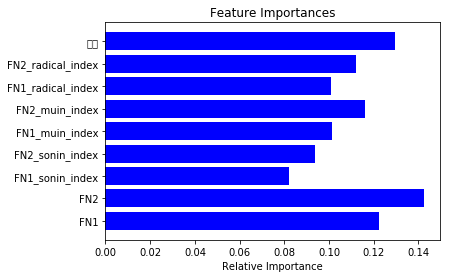

NameError: name 'get' is not defined

In [41]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', '地格','N' ]

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

In [39]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', '地格' ,'BFN12P']

y_feature = ['BirthYear']
Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

2017-10-10 18:17:52.927656
x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', '地格', 'BFN12P']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
test dataset 有 96234 個名字, 48552 種名字
Train Accuracy ::  0.536691813704
Test Accuracy  ::  0.5158363987779787
平均絕對值誤差： 1.1599
RMSE: 2.1077
Name: 志向
answer: {3: 1} Classifier result: 5
Name: 吉賢
answer: {10: 1} Classifier result: 4
Name: 偲睿
answer: {10: 1} Classifier result: 10
Name: 蘇辰
answer: {1: 1} Classifier result: 10
Name: 怡芳
answer: {8: 4, 9: 1, 10: 2, 5: 1, 7: 8} Classifier result: 7
Name: 維楨
answer: {7: 1} Classifier result: 7
Name: 駿志
answer: {10: 3} Classifier result: 10
Name: 明娟
answer: {1: 1, 2: 2, 3: 1, 5: 2, 6: 4, 7: 4, 8: 3} Classifier result: 5
Name: 淑娟
answer: {1: 4, 2: 8, 3: 7, 4: 16, 5: 27, 6: 27, 7: 10, 8: 9, 9: 5} Classifier result: 6
Name: 中天
answer: {2: 2, 3: 1, 5: 1} Classifier result: 3
CPU times: user 2min 8s, sys: 132 ms, total: 2min 8s
Wall time: 1min 46s


In [48]:
%%time
resampled_Real_data_df['N'] = resampled_Real_data_df.FirstName.apply(lambda x: name_list.index(x))

CPU times: user 7min 1s, sys: 144 ms, total: 7min 1s
Wall time: 7min 1s


In [66]:
resampled_Real_data_df

,FirstName,LastName,gender,message,name,FN1,FN2,FN1_sonin,FN1_muin,FN2_sonin,...,FN12PY3,FN12PY4,FN12PY5,FN12PY6,FN12PY7,FN12PY8,FN12PY9,FN12PY10,BFN12P,N
0,秀珠,吳,NaN,1947,吳秀珠,70,596,x,iù,zh,...,4.5412895132593216e-05,4.44248697174235e-05,2.6472367108666637e-05,6.210836692534809e-05,5.203210e-06,1.471218e-06,4.373961e-07,1.777982e-07,1,0
1,豐博,林,NaN,1945,林豐博,277,72,f,ēng,b,...,9.261570082071255e-07,5.776950146837055e-07,6.723142749576027e-07,2.323744254756398e-06,1.994415e-06,1.856148e-06,1.630811e-06,1.844540e-06,6,1
2,義勝,康,1.0,1945,康義勝,650,156,y,ì,sh,...,5.4894869210515945e-06,3.55919299640746e-06,4.074653873344772e-06,9.928475992778838e-06,3.392891e-06,2.636946e-06,1.398486e-06,9.426678e-07,1,2
3,麗,吳,0.0,1946,吳麗,-1,203,l,ì,None,...,1.307602035592752e-06,1.1108992980696503e-06,8.179978666691598e-07,6.5610780451926784e-06,6.301545e-07,5.702879e-07,3.260080e-07,2.072494e-07,6,3
4,淡浪,張,NaN,1948,張淡浪,1008,104,d,àn,l,...,1.0861241401702445e-08,3.976302537967307e-09,6.871960994560418e-10,2.2503096845533253e-08,1.300891e-11,1.218327e-11,7.897016e-10,6.691779e-10,6,4
5,世慶,林,1.0,1947,林世慶,537,269,sh,ì,q,...,1.718730054644879e-05,1.2489537823081198e-05,1.1001333739566897e-05,1.7579373292137834e-05,1.217653e-05,8.265918e-06,4.256565e-06,3.283069e-06,6,5
6,秀藝,林,NaN,1946,林秀藝,70,867,x,iù,y,...,1.5947950044649678e-06,1.6151153567907788e-06,1.7579678389899833e-06,4.445070683206058e-06,1.444822e-06,1.100743e-06,8.142813e-07,5.479438e-07,6,6
7,麗凰,陳,0.0,1949,陳麗凰,203,1443,l,ì,h,...,9.893446710114408e-07,9.181004411836911e-07,4.960397024903905e-07,2.3965163398999487e-06,8.556334e-07,4.265120e-07,1.654510e-07,8.194188e-08,6,7
8,翰祥,袁,NaN,1945,袁翰祥,257,165,h,àn,x,...,7.226099449673933e-07,5.407017641720652e-07,2.1069259121101737e-06,2.943093247628158e-06,5.446529e-06,8.221426e-06,1.097776e-05,1.124377e-05,10,8
9,林,吳,1.0,1946,吳林,-1,96,l,ín,None,...,7.383977956524302e-08,7.182736689489267e-08,8.263008856721259e-08,3.046736902119992e-07,1.027016e-07,1.696191e-07,1.599682e-07,1.735001e-07,6,9


x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', '地格', 'N']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
[ 0.06788779  0.07995283  0.03682413  0.04455738  0.04574042  0.05310727
  0.04456192  0.05123146  0.05461355  0.52152324]


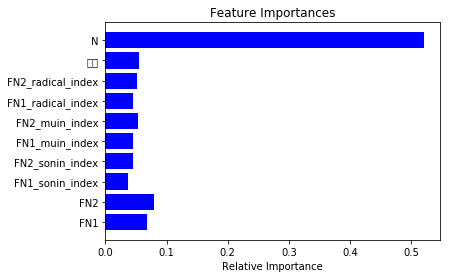

test dataset 有 96234 個名字, 48517 種名字
Train Accuracy ::  0.539773587595
Test Accuracy  ::  0.751584679011576
沒在train裡面的名字的正確率：： 0.9956412681442494
CPU times: user 13min 14s, sys: 696 ms, total: 13min 15s
Wall time: 12min 57s


In [53]:
%%time
x_feature = [ 'FN1', 'FN2', 'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', '地格','N' ]

y_feature = ['BirthYear']
#Imbalanced_resample_classifier_ts(resampled_Real_data_df, x_feature , y_feature ,1,2)

print('x_feature:',x_feature)
print('y_feature:',y_feature)
#N fold cross-validation
Train_accuracy_score=0
Test_accuracy_score=0
    
data_df = resampled_Real_data_df
Validation_times=1

for i in range(Validation_times):
    train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)
    test_index = test_x.index
    train_index= train_x.index
    
    test_name_list = []
    data_df.loc[test_index].FirstName.apply(lambda x:make_name_list(x,test_name_list))
    train_name_list =[]
    data_df.loc[train_index].FirstName.apply(lambda x:make_name_list(x,train_name_list))
    
    #只存在於test 裡面的名字
    unique_test_name_list = list (set(test_name_list) - set (train_name_list))
    
    # Create random forest classifier instance
    trained_model = random_forest_classifier(train_x, train_y)
    print('Finished training')

    predictions = trained_model.predict(test_x)

    # Train and Test Accuracy
    if(Validation_times!=1):
        print('Run times:',i+1)

    features = x_feature
    importances = trained_model.feature_importances_
    #indices = np.argsort(importances)
    print(importances)
    plt.title('Feature Importances')
    plt.barh(range(len(importances)), importances, color='b', align='center')
    plt.yticks(range(len(importances)), features) ## removed [indices]
    plt.xlabel('Relative Importance')
    plt.show()
    test_name_dict_list= get_test_name_dict_list(test_x,test_y,data_df)


    print('test dataset 有',len(test_x),'個名字,',len(test_name_dict_list),'種名字')    

    accuracy=0
    Total_unique_name=0
    unique_name_score=0
    for index,year in enumerate(predictions):
        #print(test_x.iloc[index])
        name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
        #print(name)

        ##test 是不是印正確的名字
#             df_index = test_x.iloc[index].name
#             name = data_df.loc[df_index].FirstName
        #print(name)
    
        if name in test_name_dict_list:
            if name in unique_test_name_list:
                Total_unique_name+=1
            if year in test_name_dict_list[name]:
                accuracy+=1
                if name in unique_test_name_list:
                    unique_name_score+=1
        else:
            print('wtf')

    accuracy/=len(predictions)      

    print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
    print ("Test Accuracy  :: ", accuracy)
    #看一下放兩個字的名字能不能有效提高accuracy並且如果碰到train裡面沒有的名字會怎樣
    print('沒在train裡面的名字的正確率：：',unique_name_score/Total_unique_name)

    #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

#     Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
#     Test_accuracy_score+= accuracy
#     calculate_errorr_multi_answer( predictions, test_x ,test_name_dict_list,data_df)
#     validate_error_multi_answer( predictions, data_df,test_y,test_x ,test_name_dict_list)
        


In [58]:
train_name_list.index('健彬')

ValueError: '健彬' is not in list

In [63]:
accuracy=0
Total_unique_name=0
unique_name_score=0
Total_common_name=0
common_name_score=0
for index,year in enumerate(predictions):
    #print(test_x.iloc[index])
    name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
    #print(name)

    ##test 是不是印正確的名字
#             df_index = test_x.iloc[index].name
#             name = data_df.loc[df_index].FirstName
    #print(name)

    if name in test_name_dict_list:
        if name in unique_test_name_list:
            Total_unique_name+=1
        else:
            Total_common_name+=1
        if year in test_name_dict_list[name]:
            accuracy+=1
            if name in unique_test_name_list:
                unique_name_score+=1
#                 if index %10==0:
#                     print(name,test_name_dict_list[name],year)
            else:
                common_name_score+=1
                if index %1000==0:
                    print(name,test_name_dict_list[name],year)
    else:
        print('wtf')

accuracy/=len(predictions)      

print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
print ("Test Accuracy  :: ", accuracy)
#看一下放兩個字的名字能不能有效提高accuracy並且如果碰到train裡面沒有的名字會怎樣
print('沒在train裡面的名字的正確率：：',unique_name_score/Total_unique_name)
print('在train裡面的名字的正確率：：',common_name_score/Total_common_name)

瑞芳 {1: 1, 2: 1, 3: 1, 4: 1, 5: 2, 6: 4, 7: 1, 8: 1} 6
靜芬 {3: 1, 4: 1, 5: 2, 6: 2, 7: 3, 8: 4, 9: 2} 6
搝香 {1: 3, 4: 1, 6: 1} 1
文淵 {3: 2, 4: 1, 5: 2, 6: 1, 7: 1} 4
麗惠 {1: 1, 2: 1, 3: 2, 4: 2, 5: 6, 6: 6, 7: 2, 9: 1} 6
祐寧 {8: 1, 10: 2} 10
振武 {2: 1, 4: 1, 6: 2} 6
景賢 {9: 1, 3: 1, 4: 1, 6: 1} 3
耿瑤 {2: 2} 2
金蘭 {1: 1, 2: 3, 3: 2, 4: 1, 5: 3, 6: 3, 8: 1, 10: 1} 3
正宏 {9: 1, 2: 1, 4: 3, 5: 2, 6: 2} 5
永川 {1: 1, 2: 1, 3: 1, 4: 1, 6: 1} 3
樹梅 {1: 2} 1
三貴 {2: 3} 2
映汝 {8: 1, 10: 2} 10
淑如 {1: 1, 2: 2, 3: 1, 4: 2, 5: 6, 6: 7, 7: 3, 9: 2} 6
月華 {1: 7, 2: 3, 3: 1, 4: 4, 5: 1} 2
雅惠 {1: 3, 2: 2, 3: 2, 4: 2, 5: 6, 6: 14, 7: 29, 8: 10, 9: 4, 10: 5} 7
美慧 {2: 2, 3: 5, 4: 10, 5: 8, 6: 7, 7: 2, 8: 1, 9: 2} 6
秀鳳 {1: 10, 2: 9, 3: 6, 4: 11, 5: 9, 6: 6, 8: 1} 5
大偉 {1: 2, 2: 2, 3: 3, 4: 2, 5: 2, 6: 3, 7: 2, 8: 1} 4
麗娜 {1: 2, 2: 6, 3: 4, 4: 4, 5: 3, 6: 6} 2
燕慈 {2: 1} 2
錦蓮 {1: 2, 2: 2, 4: 1, 9: 1} 2
鳳敏 {1: 1, 3: 1, 4: 1} 4
惟浩 {3: 1} 3
搝滿 {1: 5, 2: 5, 3: 5, 4: 2, 5: 3} 1
志偉 {1: 1, 2: 1, 3: 1, 4: 3, 5: 5, 6: 6, 7: 15, 8: 11

# 做ONE HOT ENCODING

In [20]:
resampled_Real_data_df.head()

,FirstName,LastName,gender,message,name,FN1,FN2,FN1_sonin,FN1_muin,FN2_sonin,...,FN12PY6,FN12PY7,FN12PY8,FN12PY9,FN12PY10,BFN12P,FirstName1,FirstName2,Female_prob,Male_prob
0,秀珠,吳,NaN,1947,吳秀珠,70,596,x,iù,zh,...,6.210836692534809e-05,5.203210e-06,1.471218e-06,4.373961e-07,1.777982e-07,1,秀,珠,1.000000,0.000000
1,豐博,林,NaN,1945,林豐博,277,72,f,ēng,b,...,2.323744254756398e-06,1.994415e-06,1.856148e-06,1.630811e-06,1.844540e-06,6,豐,博,0.074219,0.925781
2,義勝,康,1.0,1945,康義勝,650,156,y,ì,sh,...,9.928475992778838e-06,3.392891e-06,2.636946e-06,1.398486e-06,9.426678e-07,1,義,勝,0.007812,0.992188
3,麗,吳,0.0,1946,吳麗,-1,203,-1,-1,l,...,6.5610780451926784e-06,6.301545e-07,5.702879e-07,3.260080e-07,2.072494e-07,6,,麗,0.992188,0.007812
4,淡浪,張,NaN,1948,張淡浪,1008,104,d,àn,l,...,2.2503096845533253e-08,1.300891e-11,1.218327e-11,7.897016e-10,6.691779e-10,6,淡,浪,0.335938,0.664062


In [28]:
resampled_Real_data_df.dtypes

FirstName         object
LastName          object
FN1                int64
FN2                int64
FN1_sonin         object
FN1_muin          object
FN2_sonin         object
FN2_muin          object
BirthYear          int64
FN1_radical       object
FN2_radical       object
GuessedGender      int64
天格                 int64
人格                 int64
地格                 int64
外格                 int64
總格                 int64
BFN12P             int64
FirstName1        object
FirstName2        object
Female_prob      float64
Male_prob        float64
dtype: object

In [422]:
#check_memory_usage():
# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
object_size = sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)
for index,obj in enumerate(object_size):
    if index>10:
        break
    print('FileName:',obj[0],'FileSize:',obj[1]/1000000,'MB')

FileName: small_df FileSize: 2239.27022 MB
FileName: resampled_Real_data_df FileSize: 295.418494 MB
FileName: train_compare_df FileSize: 201.600104 MB
FileName: resampled_FB_data_df FileSize: 200.91009 MB
FileName: rs_train_compare_df FileSize: 75.152056 MB
FileName: prediction_proba FileSize: 16.936272 MB
FileName: age_prob_df FileSize: 16.936264 MB
FileName: tmp_df FileSize: 16.800104 MB
FileName: indice FileSize: 14.696992 MB
FileName: result_list FileSize: 9.784696 MB
FileName: test_prediction_proba FileSize: 7.258512 MB


In [26]:
#resampled_Real_data_df = resampled_Real_data_df.drop('gender',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('message',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY1',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY2',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY3',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY4',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY5',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY6',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY7',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY8',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY9',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('FN12PY10',1)
# resampled_Real_data_df = resampled_Real_data_df.drop('name',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN1_radical_index',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN2_radical_index',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN1_sonin_index',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN2_sonin_index',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN1_muin_index',1)
resampled_Real_data_df = resampled_Real_data_df.drop('FN2_muin_index',1)

In [25]:
resampled_Real_data_df['FirstName1'] =  resampled_Real_data_df.FirstName.apply(lambda x:x[0])
resampled_Real_data_df['FirstName2'] =  resampled_Real_data_df.FirstName.apply(lambda x:x[1])

In [29]:
#把名字含只有出現過1次的字丟掉
character_dict ={}
def add_charater(FN):
    for c in FN:
        if c not in character_dict:
            character_dict[c]=1
        else:
            character_dict[c]+=1
    
resampled_Real_data_df.FirstName.apply(lambda x: add_charater(x))
print(len(character_dict))

4466


In [31]:
sorted_character_dict = sorted(character_dict.items(), key=operator.itemgetter(1))
#sorted_character_dict

In [32]:
rare_name_list = []

rare=len(resampled_Real_data_df)/10000
print('rare',rare)
for index,c in enumerate(sorted_character_dict):
    if  character_dict[c[0]]> rare:
        print(index)
        break
    rare_name_list.append(c[0])

rare 32.078
3304


In [6]:
#print(rare_name_list)

In [34]:
def is_ssr(FN):
    for c in FN:
        if c in rare_name_list:
            return 1
    return 0

In [35]:
small_df = resampled_Real_data_df[resampled_Real_data_df.FirstName.apply(lambda x:is_ssr(x)==0)]

In [33]:
small_df

,FirstName,LastName,message,name,FN1,FN2,FN1_sonin,FN1_muin,FN2_sonin,FN2_muin,...,FN12PY6,FN12PY7,FN12PY8,FN12PY9,FN12PY10,BFN12P,FirstName1,FirstName2,Female_prob,Male_prob
0,秀珠,吳,1947,吳秀珠,70,596,x,iù,zh,ū,...,6.210836692534809e-05,5.203210e-06,1.471218e-06,4.373961e-07,1.777982e-07,1,秀,珠,1.000000,0.000000
1,豐博,林,1945,林豐博,277,72,f,ēng,b,ó,...,2.323744254756398e-06,1.994415e-06,1.856148e-06,1.630811e-06,1.844540e-06,6,豐,博,0.074219,0.925781
2,義勝,康,1945,康義勝,650,156,y,ì,sh,èng,...,9.928475992778838e-06,3.392891e-06,2.636946e-06,1.398486e-06,9.426678e-07,1,義,勝,0.007812,0.992188
3,麗,吳,1946,吳麗,-1,203,-1,-1,l,ì,...,6.5610780451926784e-06,6.301545e-07,5.702879e-07,3.260080e-07,2.072494e-07,6,,麗,0.992188,0.007812
4,淡浪,張,1948,張淡浪,1008,104,d,àn,l,àng,...,2.2503096845533253e-08,1.300891e-11,1.218327e-11,7.897016e-10,6.691779e-10,6,淡,浪,0.335938,0.664062
5,世慶,林,1947,林世慶,537,269,sh,ì,q,ìng,...,1.7579373292137834e-05,1.217653e-05,8.265918e-06,4.256565e-06,3.283069e-06,6,世,慶,0.031250,0.968750
6,秀藝,林,1946,林秀藝,70,867,x,iù,y,ì,...,4.445070683206058e-06,1.444822e-06,1.100743e-06,8.142813e-07,5.479438e-07,6,秀,藝,0.882812,0.117188
7,麗凰,陳,1949,陳麗凰,203,1443,l,ì,h,uáng,...,2.3965163398999487e-06,8.556334e-07,4.265120e-07,1.654510e-07,8.194188e-08,6,麗,凰,0.964844,0.035156
8,翰祥,袁,1945,袁翰祥,257,165,h,àn,x,iáng,...,2.943093247628158e-06,5.446529e-06,8.221426e-06,1.097776e-05,1.124377e-05,10,翰,祥,0.019531,0.980469
9,林,吳,1946,吳林,-1,96,-1,-1,l,ín,...,3.046736902119992e-07,1.027016e-07,1.696191e-07,1.599682e-07,1.735001e-07,6,,林,1.000000,0.000000


In [36]:
#check_memory_usage():
# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
object_size = sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)
for index,obj in enumerate(object_size):
    if index>10:
        break
    print('FileName:',obj[0],'FileSize:',obj[1]/1000000,'MB')

FileName: resampled_Real_data_df FileSize: 287.892717 MB
FileName: small_df FileSize: 273.885736 MB
FileName: character_dict FileSize: 0.196704 MB
FileName: sorted_character_dict FileSize: 0.040304 MB
FileName: rare_name_list FileSize: 0.026736 MB
FileName: Taiwan_LastName_List FileSize: 0.012096 MB
FileName: Taiwan_LastName_len1_List FileSize: 0.011184 MB
FileName: BalanceCascade FileSize: 0.001016 MB
FileName: HanziConv FileSize: 0.001016 MB
FileName: PCA FileSize: 0.001016 MB
FileName: RandomForestClassifier FileSize: 0.001016 MB


In [37]:
def one_hot_encodeing(df):
    df = pd.get_dummies(df, columns=["FN2_radical"])
    df = pd.get_dummies(df, columns=["FN1_radical"])
    df = pd.get_dummies(df, columns=["FN1_sonin"])
    df = pd.get_dummies(df, columns=["FN2_sonin"])
    df =  pd.get_dummies(df, columns=["FN1_muin"])
    df = pd.get_dummies(df, columns=["FN2_muin"])
    df = pd.get_dummies(df, columns=["FirstName1"])
    df = pd.get_dummies(df, columns=["FirstName2"])
    return df

In [38]:
small_df = one_hot_encodeing(small_df)

In [67]:
#check_memory_usage():
# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
object_size = sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)
for index,obj in enumerate(object_size):
    if index>10:
        break
    print('FileName:',obj[0],'FileSize:',obj[1]/1000000,'MB')

FileName: small_df FileSize: 978.873882 MB
FileName: resampled_Real_data_df FileSize: 295.418098 MB
FileName: character_dict FileSize: 0.196704 MB
FileName: sorted_character_dict FileSize: 0.040304 MB
FileName: word_list FileSize: 0.038216 MB
FileName: rare_name_list FileSize: 0.026736 MB
FileName: x_feature FileSize: 0.023728 MB
FileName: Taiwan_LastName_List FileSize: 0.012096 MB
FileName: Taiwan_LastName_len1_List FileSize: 0.011184 MB
FileName: RandomForestClassifier FileSize: 0.002456 MB
FileName: BalanceCascade FileSize: 0.001016 MB


In [38]:
len(small_df.columns.values)

5507

In [346]:
#x_feature = []
for index, x in enumerate(small_df.columns.values):
    if 'FirstName' in x and '_' in x:
        x_feature.append(x)
print(len(x_feature))

3432


In [75]:
x_feature = []

In [42]:
%%time
#只有FirstName1.2   2個字的
y_feature = ['BirthYear']
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.248542493561
Test Accuracy  ::  0.200851652962
CPU times: user 15min 6s, sys: 4.25 s, total: 15min 10s
Wall time: 4min 5s


In [76]:
for index, x in enumerate(small_df.columns.values):
    if 'FN1_radical_' in x or 'FN2_radical_' in x:
        x_feature.append(x)
print(len(x_feature))

315


In [44]:
%%time
#加上部首

y_feature = ['BirthYear']
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.285455501665
Test Accuracy  ::  0.1996140292
CPU times: user 6min 11s, sys: 9.55 s, total: 6min 21s
Wall time: 2min 3s


In [77]:
for index, x in enumerate(small_df.columns.values):
    if 'FN1_muin_' in x or 'FN2_muin_' in x or 'FN1_sonin_' in x or 'FN2_sonin_' in x:
        x_feature.append(x)
print(len(x_feature))

612


In [46]:
%%time
#加上發音

y_feature = ['BirthYear']
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.334149926507
Test Accuracy  ::  0.207448816916
CPU times: user 5min, sys: 10.3 s, total: 5min 10s
Wall time: 1min 44s


In [78]:
#x_feature.append('外格')
x_feature.append('地格')
#x_feature.append('總格')

In [47]:
%%time

basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.383527592608
Test Accuracy  ::  0.209168904179
CPU times: user 4min 38s, sys: 9.8 s, total: 4min 48s
Wall time: 1min 38s


In [48]:
%%time

x_feature.append('BFN12P')
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.378012217433
Test Accuracy  ::  0.211455361638
CPU times: user 4min 31s, sys: 9.58 s, total: 4min 41s
Wall time: 1min 36s


In [79]:
x_feature.append('BFN12P')
x_feature.append('Male_prob')
x_feature.append('Female_prob')

In [59]:
%%time
y_feature = ['BirthYear']
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.397979044271
Test Accuracy  ::  0.217549085417
CPU times: user 5min 12s, sys: 16.5 s, total: 5min 29s
Wall time: 1min 53s


In [350]:
%%time
##篩掉萬分之一以下的字只留地格的測試
y_feature = ['BirthYear']
trained_model = basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.677159403312
Test Accuracy  ::  0.216334178331
CPU times: user 8min 16s, sys: 6.25 s, total: 8min 22s
Wall time: 2min 22s


In [49]:
%%time
x_numerical_feature = [ 'FN1', 'FN2','Male_prob','Female_prob',
    'FN1_sonin_index',
       'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index',
       'FN2_radical_index', '地格','總格','外格' ,'BFN12P']

basic_RFClassifier(small_df,x_numerical_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.686733882024
Test Accuracy  ::  0.226967612015
CPU times: user 31.9 s, sys: 192 ms, total: 32.1 s
Wall time: 8.76 s


In [56]:
basic_RFClassifier_ts(small_df,x_numerical_feature,y_feature,1)

x_feature: ['FN1', 'FN2', 'FN1_sonin_index', 'FN2_sonin_index', 'FN1_muin_index', 'FN2_muin_index', 'FN1_radical_index', 'FN2_radical_index', '地格', '總格', '外格', 'BFN12P']
y_feature: ['BirthYear']


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
test dataset 有 95344 個名字, 47813 種名字
Train Accuracy ::  0.656235250754
Test Accuracy  ::  0.5164352240308777
平均絕對值誤差： 1.1457
RMSE: 2.0851
Name: 政良
answer: {8: 3, 9: 2, 5: 2, 6: 1} Classifier result: 10
Name: 澤煜
answer: {9: 1} Classifier result: 10
Name: 宇瑄
answer: {9: 4} Classifier result: 10
Name: 上平
answer: {3: 1} Classifier result: 3
Name: 慈惠
answer: {1: 2, 2: 2, 7: 1, 9: 1} Classifier result: 8
Name: 瑞郎
answer: {1: 2, 5: 1} Classifier result: 1
Name: 盈芳
answer: {8: 1, 1: 1} Classifier result: 10
Name: 拯黎
answer: {1: 1} Classifier result: 1
Name: 鳳珠
answer: {1: 3, 2: 7, 3: 4, 4: 3, 5: 5, 6: 3, 7: 2} Classifier result: 4
Name: 千群
answer: {9: 1} Classifier result: 9


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=3, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=32, n_jobs=4,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [91]:
#silver!!
#multi-answer RFC
def basic_RFClassifier_ts(data_df,x_feature,y_feature,Validation_times):
    print('x_feature:',x_feature)
    print('y_feature:',y_feature)
    #N fold cross-validation
    Train_accuracy_score=0
    Test_accuracy_score=0
    
    
    for i in range(Validation_times):
        train_x, test_x, train_y, test_y = split_dataset(data_df, 0.7, x_feature, y_feature)
        train_index = train_x.index
        test_index = test_x.index
        # Create random forest classifier instance
        trained_model = random_forest_classifier(train_x, train_y)
        print('Finished training')
        
        predictions = trained_model.predict(test_x)
        print('Finished prdeiction')
        # Train and Test Accuracy
        if(Validation_times!=1):
            print('Run times:',i+1)

        #test_name_dict_list= get_test_name_dict_list(test_x,test_y,data_df)
        test_name_dict_list= get_test_name_dict_list2(test_index,data_df)
        
        print('test dataset 有',len(test_x),'個名字,',len(test_name_dict_list),'種名字')    
        
        accuracy=0
        for index,year in enumerate(predictions):
            #print(test_x.iloc[index])
            #name = Totalname_list[ int ( test_x.iloc[index].FN1)]+Totalname_list[ int(test_x.iloc[index].FN2)]
            #print(name)
            
            ##test 是不是印正確的名字
            df_index = test_x.iloc[index].name
            name = data_df.loc[df_index].FirstName
            #print(name)
    
            if name in test_name_dict_list:
                if year in test_name_dict_list[name]:
                    accuracy+=1
            else:
                print('wtf')
        
        accuracy/=len(predictions)      

        print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
        print ("Test Accuracy  :: ", accuracy)
        
        #print (" Confusion matrix\n ", confusion_matrix(test_y, predictions))

#         Train_accuracy_score+=accuracy_score(train_y, trained_model.predict(train_x))
#         Test_accuracy_score+= accuracy
#         calculate_errorr_multi_answer( predictions, test_x ,test_name_dict_list,data_df)
#         validate_error_multi_answer( predictions, data_df,test_y,test_x ,test_name_dict_list)
        
#     if(Validation_times!=1):
#         Train_accuracy_score/=Validation_times
#         Test_accuracy_score/=Validation_times
#         print ("Average Train Accuracy :: ", Train_accuracy_score)
#         print ("Average Test Accuracy  :: ",Test_accuracy_score)
    
    return trained_model


In [446]:
%%time
basic_RFClassifier_ts(small_df,x_feature,y_feature,1)

x_feature: ['FN2_radical_一', 'FN2_radical_丨', 'FN2_radical_丶', 'FN2_radical_丿', 'FN2_radical_乙', 'FN2_radical_亅', 'FN2_radical_二', 'FN2_radical_亠', 'FN2_radical_人', 'FN2_radical_儿', 'FN2_radical_入', 'FN2_radical_八', 'FN2_radical_冂', 'FN2_radical_冖', 'FN2_radical_冫', 'FN2_radical_几', 'FN2_radical_凵', 'FN2_radical_刀', 'FN2_radical_力', 'FN2_radical_勹', 'FN2_radical_匕', 'FN2_radical_匚', 'FN2_radical_十', 'FN2_radical_卩', 'FN2_radical_厂', 'FN2_radical_又', 'FN2_radical_口', 'FN2_radical_囗', 'FN2_radical_土', 'FN2_radical_士', 'FN2_radical_夊', 'FN2_radical_夕', 'FN2_radical_大', 'FN2_radical_女', 'FN2_radical_子', 'FN2_radical_宀', 'FN2_radical_寸', 'FN2_radical_小', 'FN2_radical_尢', 'FN2_radical_尸', 'FN2_radical_山', 'FN2_radical_巛', 'FN2_radical_工', 'FN2_radical_巾', 'FN2_radical_干', 'FN2_radical_幺', 'FN2_radical_广', 'FN2_radical_廴', 'FN2_radical_弋', 'FN2_radical_弓', 'FN2_radical_彡', 'FN2_radical_彳', 'FN2_radical_心', 'FN2_radical_戈', 'FN2_radical_手', 'FN2_radical_攴', 'FN2_radical_文', 'FN2_radical_斤', 'F

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
Finished prdeiction
test dataset 有 90730 個名字, 43098 種名字
Train Accuracy ::  0.678883524955
Test Accuracy  ::  0.5224512289209743
CPU times: user 24min 9s, sys: 8.36 s, total: 24min 18s
Wall time: 15min 4s


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=32, n_jobs=4,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [442]:
trained_model 

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=32, n_jobs=4,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [5]:
#print(len(x_feature),x_feature)

In [49]:
%%time 
    
trained_model = basic_RFClassifier_ts(small_df,x_feature,y_feature,1)

x_feature: ['FirstName1_ ', 'FirstName1_一', 'FirstName1_丁', 'FirstName1_三', 'FirstName1_上', 'FirstName1_丕', 'FirstName1_世', 'FirstName1_丞', 'FirstName1_中', 'FirstName1_丰', 'FirstName1_丹', 'FirstName1_主', 'FirstName1_乃', 'FirstName1_久', 'FirstName1_之', 'FirstName1_乙', 'FirstName1_九', 'FirstName1_也', 'FirstName1_乾', 'FirstName1_予', 'FirstName1_二', 'FirstName1_于', 'FirstName1_云', 'FirstName1_五', 'FirstName1_亞', 'FirstName1_亦', 'FirstName1_亨', 'FirstName1_享', 'FirstName1_京', 'FirstName1_亭', 'FirstName1_亮', 'FirstName1_人', 'FirstName1_仁', 'FirstName1_今', 'FirstName1_介', 'FirstName1_仕', 'FirstName1_仙', 'FirstName1_代', 'FirstName1_令', 'FirstName1_以', 'FirstName1_仰', 'FirstName1_仲', 'FirstName1_任', 'FirstName1_伊', 'FirstName1_伍', 'FirstName1_伯', 'FirstName1_伶', 'FirstName1_伸', 'FirstName1_位', 'FirstName1_佐', 'FirstName1_佑', 'FirstName1_余', 'FirstName1_作', 'FirstName1_佩', 'FirstName1_佳', 'FirstName1_佾', 'FirstName1_侃', 'FirstName1_來', 'FirstName1_侑', 'FirstName1_依', 'FirstName1_俊', 'FirstName1_

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
Finished prdeiction
test dataset 有 90730 個名字, 43327 種名字
Train Accuracy ::  0.679072469792
Test Accuracy  ::  0.5261214592747713
平均絕對值誤差： 1.0968
RMSE: 2.0022
Name: 芬華
answer: {1: 1, 3: 3, 4: 1} Classifier result: 2
Name: 政倫
answer: {9: 3} Classifier result: 8
Name: 文旺
answer: {5: 1, 6: 1, 7: 1} Classifier result: 2
Name: 胤洲
answer: {8: 1} Classifier result: 1
Name: 芙萱
answer: {10: 1} Classifier result: 10
Name: 全誠
answer: {5: 1} Classifier result: 3
Name: 宗和
answer: {1: 1, 2: 1, 4: 1, 5: 1, 6: 2, 7: 1, 8: 1} Classifier result: 3
Name: 珮綺
answer: {8: 2, 9: 2, 10: 2, 5: 1, 7: 4} Classifier result: 10
Name: 素真
answer: {1: 4, 2: 5, 3: 6, 4: 3, 5: 10, 6: 4, 7: 2, 8: 1} Classifier result: 2
Name: 哲胤
answer: {8: 1} Classifier result: 4


ValueError: too many values to unpack (expected 3)

In [52]:
#使用word to vector
from gensim.models import word2vec
moe_model = word2vec.Word2Vec.load("./data_output/dict_to_vector/moe_med250.model.bin")

In [69]:
small_df['FirstName1'] =  small_df.FirstName.apply(lambda x:x[0])
small_df['FirstName2'] =  small_df.FirstName.apply(lambda x:x[1])

In [81]:
%%time 

def add_word_vector(word,n):
    if word in moe_model.wv:
        return moe_model.wv[word][n]
    else:
        return 0
    
wv_feature = []

for i in range(0,250):
#     small_df['FN1_wv_'+str(i)] = small_df.FirstName1.apply(lambda x:add_word_vector(x,i))
#     small_df['FN2_wv_'+str(i)] = small_df.FirstName2.apply(lambda x:add_word_vector(x,i))
    x_feature.append('FN1_wv_'+str(i))
    x_feature.append('FN2_wv_'+str(i))
    

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 375 µs


In [419]:
# Get a sorted list of the objects and their sizes
object_size = sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)
for index,obj in enumerate(object_size):
    if index>10:
        break
    print('FileName:',obj[0],'FileSize:',obj[1]/1000000,'MB')

FileName: small_df FileSize: 2239.27022 MB
FileName: resampled_Real_data_df FileSize: 295.418494 MB
FileName: train_compare_df FileSize: 201.600104 MB
FileName: resampled_FB_data_df FileSize: 200.91009 MB
FileName: rs_train_compare_df FileSize: 75.152056 MB
FileName: prediction_proba FileSize: 16.936272 MB
FileName: age_prob_df FileSize: 16.936264 MB
FileName: tmp_df FileSize: 16.800104 MB
FileName: indice FileSize: 14.696992 MB
FileName: result_list FileSize: 9.784696 MB
FileName: test_prediction_proba FileSize: 7.258512 MB


In [74]:
%%time
#加入W2V的測試
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.678746539948
Test Accuracy  ::  0.220764906867
CPU times: user 33min 3s, sys: 8.98 s, total: 33min 12s
Wall time: 8min 45s


In [86]:
len(small_df)

302432

In [88]:
%%time
#加入W2V的測試
basic_RFClassifier(small_df,x_feature,y_feature,1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train Accuracy ::  0.678902419439
Test Accuracy  ::  0.221822991293
CPU times: user 32min 50s, sys: 5.71 s, total: 32min 56s
Wall time: 8min 31s


In [92]:
%%time

trained_model = basic_RFClassifier_ts(small_df,x_feature,y_feature,1)

x_feature: ['FN2_radical_一', 'FN2_radical_丨', 'FN2_radical_丶', 'FN2_radical_丿', 'FN2_radical_乙', 'FN2_radical_亅', 'FN2_radical_二', 'FN2_radical_亠', 'FN2_radical_人', 'FN2_radical_儿', 'FN2_radical_入', 'FN2_radical_八', 'FN2_radical_冂', 'FN2_radical_冖', 'FN2_radical_冫', 'FN2_radical_几', 'FN2_radical_凵', 'FN2_radical_刀', 'FN2_radical_力', 'FN2_radical_勹', 'FN2_radical_匕', 'FN2_radical_匚', 'FN2_radical_十', 'FN2_radical_卩', 'FN2_radical_厂', 'FN2_radical_又', 'FN2_radical_口', 'FN2_radical_囗', 'FN2_radical_土', 'FN2_radical_士', 'FN2_radical_夊', 'FN2_radical_夕', 'FN2_radical_大', 'FN2_radical_女', 'FN2_radical_子', 'FN2_radical_宀', 'FN2_radical_寸', 'FN2_radical_小', 'FN2_radical_尢', 'FN2_radical_尸', 'FN2_radical_山', 'FN2_radical_巛', 'FN2_radical_工', 'FN2_radical_巾', 'FN2_radical_干', 'FN2_radical_幺', 'FN2_radical_广', 'FN2_radical_廴', 'FN2_radical_弋', 'FN2_radical_弓', 'FN2_radical_彡', 'FN2_radical_彳', 'FN2_radical_心', 'FN2_radical_戈', 'FN2_radical_手', 'FN2_radical_攴', 'FN2_radical_文', 'FN2_radical_斤', 'F

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
Finished prdeiction
test dataset 有 90730 個名字, 43213 種名字
Train Accuracy ::  0.677669554374
Test Accuracy  ::  0.5205775377493662
CPU times: user 11min 8s, sys: 2.96 s, total: 11min 11s
Wall time: 8min 16s


# Compartive classifier

In [95]:
small_name_dict={}

def get_name_dict(row,name_dict):
    FN = row['FirstName']
    BirthYear= row['BirthYear']
    
    if FN not in name_dict:
        name_dict[ FN ]={}
        name_dict[ FN ][BirthYear]=1
    else:
        if BirthYear not in name_dict[FN]:
            name_dict[FN][BirthYear]=1
        else:
            name_dict[FN][BirthYear]+=1
#FB_name_dict = {}
#resampled_FB_data_df.apply(lambda row: get_name_dict(row,FB_name_dict),axis=1)
#print('resample FB有幾種名字:',len(FB_name_dict),'幾個名字:',len(resampled_FB_data_df))

#Real_name_dict = {}
#resampled_Real_data_df.apply(lambda row: get_name_dict(row,Real_name_dict),axis=1)
#print('resample Real有幾種名字:',len(Real_name_dict),'幾個名字:',len(resampled_Real_data_df))

small_df.apply(lambda row: get_name_dict(row,small_name_dict),axis=1)
print('small_df有幾種名字:',len(small_name_dict),'幾個名字:',len(small_df))

small_df有幾種名字: 93522 幾個名字: 302432


In [96]:
y_feature = 'BirthYear' 
print(len(x_feature),y_feature)

1116 BirthYear


In [97]:
train_x, test_x, train_y, test_y = split_dataset(small_df, 0.7, x_feature, y_feature)
train_index = train_x.index
test_index = test_x.index
%xdel train_x
%xdel test_x
%xdel train_y
%xdel test_y


/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



In [98]:
%%time
# Create random forest classifier instance
trained_model = random_forest_classifier(small_df.loc[train_index][x_feature], small_df.loc[train_index][y_feature])

CPU times: user 3min 49s, sys: 1.8 s, total: 3min 51s
Wall time: 1min 6s


In [49]:
#{10:name*n  9:name*n}
#只要只出現在某一年的名字
def get_unique_name(FB_name_dict,start,end):
    FB_unique_name={}
    #7 14
    for label in range(start,end+1):
        unique_name = []
        for name in  FB_name_dict:
            if name[0] in rare_name_list or name[1] in rare_name_list:
                continue
            #if label in FB_name_dict[name] and len(FB_name_dict[name])!=(end+1-start):
            if label in FB_name_dict[name] and len(FB_name_dict[name])==1:
            #print(FB_name_dict[name])
                biggest = FB_name_dict[name][label]
                for year in FB_name_dict[name]:
                    if FB_name_dict[name][year]>=biggest and year!=label:
                        biggest = FB_name_dict[name][year]+1
                if  biggest == FB_name_dict[name][label]  and biggest!=1:
                    unique_name.append(name)
                    #print(name,FB_name_dict[name])    

        FB_unique_name[label] = unique_name
 

    return FB_unique_name
#FB_unique_name = get_unique_name(FB_name_dict,7,13)   
Real_unique_name = get_unique_name(Real_name_dict,1,10)   
#print(FB_unique_name)

In [68]:
print(len(Real_name_dict))
for i in range(1,10):
    print(i,len(Real_unique_name[i]))


109496
1 2936
2 2499
3 2238
4 1925
5 1643
6 1784
7 1485
8 1559
9 1940


In [50]:
print(len(Real_name_dict))
for i in range(1,11):
    print(i,len(Real_unique_name[i]))


109496
1 1110
2 846
3 757
4 604
5 398
6 553
7 286
8 344
9 454
10 684


In [352]:
#second compare layer input
prediction_proba = trained_model.predict_proba( small_df.loc[train_index][x_feature])

In [59]:

target_name_dict = {}
sample_times=10
trainName_list = small_df.loc[train_index]['FirstName'].tolist()
for year in range(1,11):
    #每年取10*n個代表性的名字出來
    target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( Real_unique_name[year] )-1 )
        target_name = Real_unique_name[year][sample]
        if target_name  in trainName_list:
            target_name_list.append(target_name)
        else:
            print(target_name,'not in train')

    target_name_dict[year] = target_name_list
print(target_name_dict)
#print(target_name_list)


教誠 not in train
能靜 not in train
家璁 not in train
銓泰 not in train
詩青 not in train
如憶 not in train
{1: ['崑燦', '自揚', '襄珍', '椿齡', '南焜', '培桂', ' 梨', '酉明', '靜妹', '芝遠'], 2: ['庚辰', '秋苡', '君恒', '象乾', '彰賓', '阿勤', '皓川', '兆祺', '聖壽'], 3: ['阿甜', '拯方', '孫霖', '繼先', '肇南', '素錠', '家咏', '至堅', '序智'], 4: ['秀興', '筱俐', '暖瑋', '瓈惠', '運正', '行平', '雙林', '小媚', '盈位', '章發'], 5: ['愛楠', '福金', '少依', '春誼', '威琪', '宜隆', '琬頻', '友禮', '少依', '右政'], 6: ['芥芥', '枝文', '可成', '盛益', '忠琦', '益助', '明璁', '奉珍', '旭晴'], 7: ['宜龍', '敬貿', '舒萍', '建賓', '福鈞', '喬雁', '介均', '昆原'], 8: ['瑋聖', '立家', '凱貞', '博尹', '宜烜', '昇白', '義閔', '飛鳴', '乾庭', '依禎'], 9: ['辰晏', '宸佑', '凡綺', '驛翔', '之瑞', '聿芃', '岳隆', '佳卉', '杰霖'], 10: ['暐智', '伊均', '思尹', '昱程', '煒竣', '宜蘋', '秉賢', '郡庭', '昀倩', '育耘']}


In [353]:
def make_age_prob_df(prediction_proba):
    age_prob_df = pd.DataFrame()
    age_prob_list = [[ ]for x in range(1,11)]

    for i in range(0,10):
        tmp_prob_list = []
        for prob_list in (prediction_proba):
             tmp_prob_list.append(prob_list[i])
        age_prob_list[i] = tmp_prob_list

    print(len(age_prob_list[0]),len(age_prob_list))

    for i in range(1,11):
        age_prob_df[str(i)+'_prob'] = age_prob_list[i-1]
    return age_prob_df
age_prob_df = make_age_prob_df(prediction_proba)
age_prob_df

211702 10


,1_prob,2_prob,3_prob,4_prob,5_prob,6_prob,7_prob,8_prob,9_prob,10_prob
0,0.104241,0.384010,0.121529,0.119917,0.120982,0.000000,0.000000,0.000000,0.149321,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.093750,0.230208,0.531250,0.144792
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.573438,0.426562,0.000000,0.000000
3,0.013851,0.033436,0.027058,0.026883,0.079948,0.182156,0.370478,0.132932,0.096210,0.037047
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.256291,0.338680,0.085146,0.319883
5,0.031250,0.000000,0.031250,0.000000,0.000000,0.031250,0.000000,0.718750,0.125000,0.062500
6,0.490104,0.000000,0.000000,0.000000,0.264063,0.000000,0.245833,0.000000,0.000000,0.000000
7,0.000000,0.571429,0.031250,0.062500,0.023438,0.062500,0.039062,0.000000,0.084821,0.125000
8,0.000000,0.000000,0.000000,0.005208,0.041667,0.450521,0.502604,0.000000,0.000000,0.000000
9,0.197826,0.234489,0.160367,0.159962,0.135274,0.024680,0.000000,0.055093,0.032310,0.000000


In [101]:
x_prob_feature = []
for i in range(1,11):
    x_prob_feature.append('target_'+str(i)+'_prob')
    x_prob_feature.append(str(i)+'_prob')

x_prob_feature

['target_1_prob',
 '1_prob',
 'target_2_prob',
 '2_prob',
 'target_3_prob',
 '3_prob',
 'target_4_prob',
 '4_prob',
 'target_5_prob',
 '5_prob',
 'target_6_prob',
 '6_prob',
 'target_7_prob',
 '7_prob',
 'target_8_prob',
 '8_prob',
 'target_9_prob',
 '9_prob',
 'target_10_prob',
 '10_prob']

In [65]:
%%time

compare_classifier_list=[]
for i in range(1,11):
    target_age = i
    print('label',i)
    compare_df = pd.DataFrame()
    for target_name in  target_name_dict[i]:
        tmp_df = age_prob_df
        compare_result_list =  compare_year(small_df.loc[train_index]['BirthYear'].tolist(),target_age)
        tmp_df['compare_result'] = compare_result_list
        print('complete compare name'+target_name+'!')
        
        target_pro =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0] 
        for j in range(1,11):
            tmp_df['target_'+str(j)+'_prob'] = target_pro[j-1]
        print('complete  add target prob!')
        
#         if len(compare_df)==0:
#             compare_df = tmp_df
#         else:
        compare_df = pd.concat([tmp_df,compare_df])
    print(compare_df.columns.values)
    
#     prob_train_x, prob_test_x, prob_train_y, prob_test_y = split_dataset(compare_df, 0.7, x_prob_feature, 'compare_result')
#     compare_classifier = random_forest_classifier(prob_train_x, prob_train_y)
#     cpredictions = compare_classifier.predict(prob_test_x)
#     print ("Train Accuracy :: ", accuracy_score(prob_train_y, compare_classifier.predict(prob_train_x)))
#     print ("Test Accuracy  :: ", accuracy_score(prob_test_y, cpredictions))

    compare_classifier = random_forest_classifier(compare_df[x_prob_feature], compare_df['compare_result'])
    compare_classifier_list.append(compare_classifier)

label 1
complete compare name崑燦!
complete  add target prob!
complete compare name自揚!
complete  add target prob!
complete compare name襄珍!
complete  add target prob!
complete compare name椿齡!
complete  add target prob!
complete compare name南焜!
complete  add target prob!
complete compare name培桂!
complete  add target prob!
complete compare name 梨!
complete  add target prob!
complete compare name酉明!
complete  add target prob!
complete compare name靜妹!
complete  add target prob!
complete compare name芝遠!
complete  add target prob!
['1_prob' '2_prob' '3_prob' '4_prob' '5_prob' '6_prob' '7_prob' '8_prob'
 '9_prob' '10_prob' 'compare_result' 'target_1_prob' 'target_2_prob'
 'target_3_prob' 'target_4_prob' 'target_5_prob' 'target_6_prob'
 'target_7_prob' 'target_8_prob' 'target_9_prob' 'target_10_prob']
label 2
complete compare name庚辰!
complete  add target prob!
complete compare name秋苡!
complete  add target prob!
complete compare name君恒!
complete  add target prob!
complete compare name象乾!
complete 

In [100]:
target_name_prob_answer_list=[]
for i in range(1,11):
    prob_answer_list = []
    for target_name in  target_name_dict[test_compare_age]:
        target_pro =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0]
        prob_answer_list.append(target_pro)
    target_name_prob_answer_list.append(prob_answer_list)

In [135]:
#%%time
#test compare
start =0
end=9
test_compare_age = int(start+end/2) 

# test_prediction_proba = trained_model.predict_proba( small_df.loc[test_index][x_feature])
# test_age_prob_df = make_age_prob_df(test_prediction_proba)

# single_answer_list = small_df.loc[test_index]['BirthYear'].tolist()
s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1)],columns=list(x_prob_feature))

single_answer_score = 0

test_predict_answer_list = []
for test_no in range(len(test_prediction_proba)):
    print(test_no)
    test_age_prob_df = df
    for i in range(1,11):
        test_age_prob_df[str(i)+'_prob'] = test_prediction_proba[test_no][i-1]
    #test_age_prob_df = make_age_prob_df(test_prediction_proba[test_no])
    
    Find_answer=False
    
    start =0
    end=9
    test_compare_age = int(start+end/2) 
    
    predict_answer_list=[]
    for i in range(0,10):
        smaller=0
        equal=0
        bigger=0
        test_compare_age = i
        
        target_predict_answer_list = []
        #for target_name in  target_name_dict[test_compare_age+1]:
        for index,target_prob in enumerate( target_name_prob_answer_list[i]):
            #target_prob =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0] 
            
            for j in range(1,11):
                test_age_prob_df['target_'+str(j)+'_prob'] = target_prob[j-1]
            #print('complete  add target prob!')  

            compare_predict_proba = compare_classifier_list[test_compare_age].predict_proba(test_age_prob_df)
            #compare_predict = compare_classifier_list[test_compare_age].predict(test_age_prob_df)
            #print('label',i,compare_predict_proba)#,compare_predict)
            #print('label',i,'completed compare test name',small_df.loc[test_index].iloc[test_no].FirstName,'with target name',target_name)
            
            #print('label',i,'completed compare test name',small_df.loc[test_index].iloc[test_no].FirstName,'with target name',target_name_dict[test_compare_age+1][index])
            #break
            #print(compare_predict_proba)
            target_predict_answer_list.append(compare_predict_proba)
#             if(i==0):
#                 equal+=compare_predict_proba[0][0]
#                 bigger+=compare_predict_proba[0][1]
                
#             elif i>0 and i<9: 
#                 smaller+=compare_predict_proba[0][0]
#                 equal+=compare_predict_proba[0][1]
#                 bigger+=compare_predict_proba[0][2]
                
#             elif(i==9):
#                 smaller+=compare_predict_proba[0][0]
#                 equal+=compare_predict_proba[0][1]

        predict_answer_list.append(target_predict_answer_list)
    test_predict_answer_list.append(predict_answer_list)
    
            #break
        #print(smaller,equal,bigger)    
        #一層一層往上找答案
#         if equal>smaller and equal>bigger:
#             predict_answer = test_compare_age+1
#             Find_answer=True
#             print('predict:',predict_answer,'answer:',single_answer_list[test_no])  
#             if predict_answer==single_answer_list[test_no]:
#                 single_answer_score+=1
#             break
        
        
#     if Find_answer!=True:
#         predict_answer=9
#         print('predict:',predict_answer,'answer:',single_answer_list[test_no])  
#         if predict_answer==single_answer_list[test_no]:
#             single_answer_score+=1
#     print(test_no,'Current single answer accuracy:',single_answer_score/(test_no+1))
#     elif smaller>equal and smaller>bigger:
    
#     elif bigger>smaller and bigger>equall:
    #print('single_answer_list',single_answer_list[test_no])
    #break

#print('single_answer_accuarcy:',single_answer_score/len(test_prediction_proba))
        


    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

KeyboardInterrupt: 

In [153]:
#test_name_dict_list= get_test_name_dict_list2(test_index,small_df)
print('test dataset 有',len(test_index),'個名字,',len(test_name_dict_list),'種名字')   

test dataset 有 95344 個名字, 47586 種名字


In [217]:

#print(test_predict_answer_list[0][0][0])
#print(len(test_predict_answer_list[0]),len(test_predict_answer_list[0][0]),len(test_predict_answer_list[0][0][0]))
single_answer_score = 0
multi_answer_score =0
a_score=0
Error=0
Min_error_answer_list = []
#FN_list = small_df.loc[test_index].FirstName.tolist()
for test_no in range(len(test_predict_answer_list_rs)):
    #print(test_no)
    
    #print( single_answer_list[test_no] )
    equal_list =[]
    a_list = []
    Find_answer=False
    for i,target_label in enumerate(test_predict_answer_list_rs[test_no]):

        test_compare_age=i
        smaller=0
        equal=0
        bigger=0
        
        for compare_predict_proba in target_label:
            if(i==0):
                equal+=compare_predict_proba[0][0]
                bigger+=compare_predict_proba[0][1]

            elif i>0 and i<9: 
                smaller+=compare_predict_proba[0][0]
                equal+=compare_predict_proba[0][1]
                bigger+=compare_predict_proba[0][2]

            elif(i==9):
                smaller+=compare_predict_proba[0][0]
                equal+=compare_predict_proba[0][1]     
            break
         
        equal_list.append(equal)
        #一層一層往上找答案
        if equal>smaller and equal>bigger:
            print(smaller,equal,bigger)
            predict_answer = test_compare_age+1
            a_list.append(predict_answer)
            if Find_answer!=True:
                print('predict:',predict_answer,'answer:',single_answer_list[test_no])  

                if predict_answer==single_answer_list[test_no]:
                    single_answer_score+=1
                if predict_answer in test_name_dict_list[ FN_list[test_no]] :
                    multi_answer_score+=1
                    Min_error_answer_list.append(single_answer_list[test_no])

                else:
                    smallest_dist = 99
                    min_error_answer=0
                    for answer in test_name_dict_list[ FN_list[test_no]]:
                        dist = abs(answer - predict_answer)
                        if(dist<smallest_dist):
                            smallest_dist=dist
                            min_error_answer=answer
                    Min_error_answer_list.append(min_error_answer)
                    Error += smallest_dist
            #break
            Find_answer=True
            
    if Find_answer==False:
        predict_answer = equal_list.index(max(equal_list))+1
        a_list.append(predict_answer)
        #predict_answer=9
        print(smaller,equal,bigger)
        print('predict:',predict_answer,'answer:',single_answer_list[test_no])  

        
        if predict_answer==single_answer_list[test_no]:
            single_answer_score+=1
        if predict_answer in test_name_dict_list[ FN_list[test_no]] :
            multi_answer_score+=1 
            
            Min_error_answer_list.append(single_answer_list[test_no])
                
        else:
            smallest_dist = 99
            min_error_answer=0
            for answer in test_name_dict_list[ FN_list[test_no]]:
                dist = abs(answer - predict_answer)
                if(dist<smallest_dist):
                    smallest_dist=dist
                    min_error_answer=answer
            Min_error_answer_list.append(min_error_answer)
            Error += smallest_dist
            
    average_score=0
    print(a_list)
    for a in a_list:
        if a in test_name_dict_list[ FN_list[test_no]]:
            average_score+=1
    average_score/=len(a_list)
    a_score+=average_score
    
    print(test_no,'Current single answer accuracy:',single_answer_score/(test_no+1)) 
    print(test_no,'Current multi answer accuracy:',multi_answer_score/(test_no+1)) 
    print(test_no,'Current average answer accuracy:',a_score/(test_no+1)) 
    print(FN_list[test_no],test_name_dict_list[ FN_list[test_no]])     
    print('平均絕對值誤差：',round(Error/(test_no+1),4))
    print(' ')
    #print('RMSE:',round(sqrt(mean_squared_error(Min_error_answer_list,predictions)),4))

0.103100198413 0.896899801587 0
predict: 10 answer: 10
[10]
0 Current single answer accuracy: 1.0
0 Current multi answer accuracy: 1.0
0 Current average answer accuracy: 1.0
家齊 {1: 2, 3: 1, 5: 2, 7: 1, 8: 1, 9: 3, 10: 5}
平均絕對值誤差： 0.0
 
0.0696180555556 0.85560515873 0.0747767857143
predict: 9 answer: 10
[9]
1 Current single answer accuracy: 0.5
1 Current multi answer accuracy: 0.5
1 Current average answer accuracy: 0.5
文翔 {10: 2, 7: 1}
平均絕對值誤差： 0.5
 
0.121205357143 0.821726190476 0.057068452381
predict: 2 answer: 2
[2]
2 Current single answer accuracy: 0.6666666666666666
2 Current multi answer accuracy: 0.6666666666666666
2 Current average answer accuracy: 0.6666666666666666
蓮香 {1: 1, 2: 1, 5: 1}
平均絕對值誤差： 0.3333
 
0.35 0.65 0
predict: 10 answer: 9
[10]
3 Current single answer accuracy: 0.5
3 Current multi answer accuracy: 0.5
3 Current average answer accuracy: 0.5
輝昱 {9: 1}
平均絕對值誤差： 0.5
 
0.01875 0.96171875 0.01953125
predict: 8 answer: 8
[8]
4 Current single answer accuracy: 0.6
4 Curr

predict: 7 answer: 9
[7]
60 Current single answer accuracy: 0.29508196721311475
60 Current multi answer accuracy: 0.5901639344262295
60 Current average answer accuracy: 0.5464480874316939
宛臻 {8: 2, 9: 5, 10: 1}
平均絕對值誤差： 0.8689
 
0.283692956349 0.507242063492 0.209064980159
predict: 3 answer: 2
0.33148336039 0.511696203102 0.156820436508
0.237847222222 0.712917334402 0.0492354433761
[3, 4, 5]
61 Current single answer accuracy: 0.2903225806451613
61 Current multi answer accuracy: 0.5967741935483871
61 Current average answer accuracy: 0.543010752688172
清榮 {1: 3, 2: 1, 3: 4}
平均絕對值誤差： 0.8548
 
0 0.955989583333 0.0440104166667
predict: 1 answer: 5
0.477566964286 0.506808035714 0.015625
[1, 5]
62 Current single answer accuracy: 0.2857142857142857
62 Current multi answer accuracy: 0.6031746031746031
62 Current average answer accuracy: 0.5502645502645502
木生 {1: 1, 2: 2, 3: 1, 5: 1, 6: 1}
平均絕對值誤差： 0.8413
 
0.00909090909091 0.916256313131 0.0746527777778
predict: 7 answer: 7
0.217113095238 0.7685

117 Current single answer accuracy: 0.2542372881355932
117 Current multi answer accuracy: 0.5508474576271186
117 Current average answer accuracy: 0.5409604519774011
英慈 {9: 1, 7: 1}
平均絕對值誤差： 1.0508
 
0.0375 0.9625 0
predict: 10 answer: 7
[10]
118 Current single answer accuracy: 0.25210084033613445
118 Current multi answer accuracy: 0.5546218487394958
118 Current average answer accuracy: 0.5448179271708683
逸安 {9: 1, 10: 1, 7: 1}
平均絕對值誤差： 1.042
 
0.0 0.92384672619 0.0761532738095
predict: 4 answer: 3
0.0515128968254 0.941108630952 0.00737847222222
[4, 5]
119 Current single answer accuracy: 0.25
119 Current multi answer accuracy: 0.55
119 Current average answer accuracy: 0.5444444444444444
文惠 {1: 1, 3: 4, 5: 3, 6: 2, 7: 1, 8: 1, 10: 1}
平均絕對值誤差： 1.0417
 
0.634201388889 0.365798611111 0
predict: 10 answer: 10
[10]
120 Current single answer accuracy: 0.256198347107438
120 Current multi answer accuracy: 0.5537190082644629
120 Current average answer accuracy: 0.5482093663911846
勝群 {10: 1, 7: 1}

金塗 {1: 2, 2: 1, 4: 1, 5: 1}
平均絕對值誤差： 1.1684
 
0.0 0.849450549451 0.150549450549
predict: 3 answer: 6
0.281334897741 0.668665102259 0.05
[3, 7]
190 Current single answer accuracy: 0.23036649214659685
190 Current multi answer accuracy: 0.5026178010471204
190 Current average answer accuracy: 0.4969458987783595
嘉哲 {8: 1, 9: 2, 10: 1, 6: 2}
平均絕對值誤差： 1.178
 
0.180295138889 0.590290178571 0.22941468254
predict: 2 answer: 3
0.255036181139 0.69727036648 0.047693452381
[2, 3]
191 Current single answer accuracy: 0.22916666666666666
191 Current multi answer accuracy: 0.5052083333333334
191 Current average answer accuracy: 0.49956597222222215
海鵬 {2: 2, 3: 1, 5: 1}
平均絕對值誤差： 1.1719
 
0 0.670228542474 0.329771457526
predict: 1 answer: 1
0.297457143551 0.427754276973 0.274788579476
0.287366452991 0.712633547009 0.0
[1, 3, 7]
192 Current single answer accuracy: 0.23316062176165803
192 Current multi answer accuracy: 0.5077720207253886
192 Current average answer accuracy: 0.5004317789291882
月霞 {1: 13, 2: 

思穎 {8: 3, 9: 9, 10: 4, 7: 3}
平均絕對值誤差： 1.1877
 
0.0396103896104 0.712772470585 0.247617139805
predict: 8 answer: 10
0.0974104888167 0.894218975469 0.00837053571429
[8, 9]
293 Current single answer accuracy: 0.20748299319727892
293 Current multi answer accuracy: 0.4897959183673469
293 Current average answer accuracy: 0.4797619047619048
怡樺 {9: 4, 10: 2, 7: 2}
平均絕對值誤差： 1.1871
 
0.02890625 0.639462187118 0.331631562882
predict: 3 answer: 2
0.193506493506 0.701925505051 0.104568001443
0.118678120287 0.563830700549 0.317491179164
0.393934537685 0.595648795649 0.0104166666667
[3, 4, 5, 7]
294 Current single answer accuracy: 0.20677966101694914
294 Current multi answer accuracy: 0.4915254237288136
294 Current average answer accuracy: 0.48067796610169494
美蓉 {1: 2, 2: 2, 3: 5, 4: 4, 5: 3, 6: 2}
平均絕對值誤差： 1.1831
 
0 0.686755952381 0.313244047619
predict: 1 answer: 3
0.462892316017 0.501339285714 0.0357683982684
[1, 2]
295 Current single answer accuracy: 0.20608108108108109
295 Current multi answer 

平均絕對值誤差： 1.1684
 
0.763504464286 0.236495535714 0
predict: 4 answer: 8
[4]
386 Current single answer accuracy: 0.20930232558139536
386 Current multi answer accuracy: 0.4909560723514212
386 Current average answer accuracy: 0.4802325581395349
伍宏 {8: 1}
平均絕對值誤差： 1.1757
 
0.0193452380952 0.750639204545 0.230015557359
predict: 4 answer: 7
0.263157242063 0.624274553571 0.112568204365
0.309635416667 0.607378472222 0.0829861111111
0.246378968254 0.667770337302 0.0858506944444
[4, 5, 6, 7]
387 Current single answer accuracy: 0.20876288659793815
387 Current multi answer accuracy: 0.49226804123711343
387 Current average answer accuracy: 0.4815721649484537
建華 {1: 1, 2: 3, 3: 3, 4: 7, 5: 2, 6: 3, 7: 6}
平均絕對值誤差： 1.1727
 
0.0385416666667 0.832217261905 0.129241071429
predict: 5 answer: 5
0.258233173077 0.715725160256 0.0260416666667
[5, 7]
388 Current single answer accuracy: 0.21079691516709512
388 Current multi answer accuracy: 0.493573264781491
388 Current average answer accuracy: 0.481619537275064

0.362016369048 0.557254464286 0.0807291666667
predict: 9 answer: 3
[9]
437 Current single answer accuracy: 0.20319634703196346
437 Current multi answer accuracy: 0.4794520547945205
437 Current average answer accuracy: 0.47207001522070025
志亭 {3: 1}
平均絕對值誤差： 1.1963
 
0.0659722222222 0.851649305556 0.0823784722222
predict: 2 answer: 3
[2]
438 Current single answer accuracy: 0.20273348519362186
438 Current multi answer accuracy: 0.4783599088838269
438 Current average answer accuracy: 0.47099468488990137
玉煙 {3: 1}
平均絕對值誤差： 1.1959
 
0 0.829861111111 0.170138888889
predict: 1 answer: 1
0.141232638889 0.532638888889 0.326128472222
0.347209821429 0.617299107143 0.0354910714286
[1, 6, 7]
439 Current single answer accuracy: 0.20454545454545456
439 Current multi answer accuracy: 0.47954545454545455
439 Current average answer accuracy: 0.4721969696969698
小萍 {1: 4, 2: 3, 3: 1, 4: 2, 5: 3, 6: 4, 7: 4}
平均絕對值誤差： 1.1932
 
0.079677901594 0.59192980813 0.328392290276
predict: 9 answer: 8
0.279300647269 0.

怡君 {3: 1, 4: 4, 5: 5, 6: 11, 7: 38, 8: 32, 9: 16, 10: 17}
平均絕對值誤差： 1.1676
 
0.0405381944444 0.53584878663 0.423613018926
predict: 6 answer: 6
0.168874007937 0.80248015873 0.0286458333333
[6, 7]
525 Current single answer accuracy: 0.21292775665399238
525 Current multi answer accuracy: 0.4828897338403042
525 Current average answer accuracy: 0.48434727503168573
元傑 {8: 1, 9: 1, 10: 1, 4: 2, 6: 1}
平均絕對值誤差： 1.1654
 
0.0859375 0.499479166667 0.414583333333
predict: 4 answer: 9
0.466145833333 0.533854166667 0
[4, 10]
526 Current single answer accuracy: 0.2125237191650854
526 Current multi answer accuracy: 0.4819734345351044
526 Current average answer accuracy: 0.483428209993675
力綱 {9: 1}
平均絕對值誤差： 1.1727
 
0 0.686495535714 0.313504464286
predict: 1 answer: 6
0.300782377345 0.504721320346 0.194496302309
0.227781159812 0.717456935426 0.0547619047619
[1, 2, 5]
527 Current single answer accuracy: 0.21212121212121213
527 Current multi answer accuracy: 0.48295454545454547
527 Current average answer a

587 Current single answer accuracy: 0.2108843537414966
587 Current multi answer accuracy: 0.47959183673469385
587 Current average answer accuracy: 0.4845804988662132
福財 {1: 3, 2: 2, 3: 3, 4: 3, 5: 3}
平均絕對值誤差： 1.2092
 
0.3171875 0.6828125 0
predict: 10 answer: 4
[10]
588 Current single answer accuracy: 0.21052631578947367
588 Current multi answer accuracy: 0.47877758913412566
588 Current average answer accuracy: 0.4837577815506508
尹凱 {4: 1}
平均絕對值誤差： 1.2173
 
0.0178571428571 0.958915693681 0.0232271634615
predict: 4 answer: 9
[4]
589 Current single answer accuracy: 0.21016949152542372
589 Current multi answer accuracy: 0.47966101694915253
589 Current average answer accuracy: 0.4846327683615819
國書 {1: 1, 4: 1, 5: 2, 6: 1, 7: 1, 9: 1, 10: 1}
平均絕對值誤差： 1.2153
 
0.0572916666667 0.740066964286 0.202641369048
predict: 2 answer: 3
0.168774801587 0.504985119048 0.326240079365
0.443117559524 0.529203869048 0.0276785714286
[2, 3, 6]
590 Current single answer accuracy: 0.2098138747884941
590 Current

0 0.614298115079 0.385701884921
predict: 1 answer: 8
0.464267175307 0.512295324693 0.0234375
[1, 2]
644 Current single answer accuracy: 0.20930232558139536
644 Current multi answer accuracy: 0.48372093023255813
644 Current average answer accuracy: 0.49054263565891476
正坤 {8: 1, 4: 1}
平均絕對值誤差： 1.2109
 
0.0203125 0.9796875 0
predict: 10 answer: 9
[10]
645 Current single answer accuracy: 0.2089783281733746
645 Current multi answer accuracy: 0.48297213622291024
645 Current average answer accuracy: 0.4897832817337462
博軒 {8: 2, 9: 1}
平均絕對值誤差： 1.2105
 
0.257718930375 0.453575937951 0.288705131674
predict: 4 answer: 6
0.105198187229 0.852391098485 0.0424107142857
[4, 6]
646 Current single answer accuracy: 0.20865533230293662
646 Current multi answer accuracy: 0.48377125193199383
646 Current average answer accuracy: 0.4905718701700155
文清 {3: 1, 4: 5, 5: 1, 6: 4, 7: 1}
平均絕對值誤差： 1.2087
 
0.142447916667 0.512354572511 0.345197510823
predict: 8 answer: 8
0.183671536797 0.495701433983 0.320627029221


平均絕對值誤差： 1.169
 
0.0 0.570864335317 0.429135664683
predict: 2 answer: 7
0.185207335046 0.567964794091 0.246827870863
0.268810348627 0.587622539934 0.14356711144
0.456101893087 0.485112575118 0.0587855317949
[2, 3, 5, 6]
716 Current single answer accuracy: 0.21896792189679218
716 Current multi answer accuracy: 0.49232914923291493
716 Current average answer accuracy: 0.498000929800093
淑珍 {1: 5, 2: 6, 3: 16, 4: 9, 5: 16, 6: 10, 7: 9}
平均絕對值誤差： 1.1674
 
0.158110119048 0.544047619048 0.297842261905
predict: 3 answer: 3
0.190811011905 0.800260416667 0.00892857142857
[3, 7]
717 Current single answer accuracy: 0.2200557103064067
717 Current multi answer accuracy: 0.49303621169916434
717 Current average answer accuracy: 0.4980037140204271
應民 {3: 1}
平均絕對值誤差： 1.1657
 
0.124255952381 0.702008928571 0.173735119048
predict: 2 answer: 4
[2]
718 Current single answer accuracy: 0.21974965229485396
718 Current multi answer accuracy: 0.49235048678720444
718 Current average answer accuracy: 0.4973110802039

0.133908539377 0.866091460623 0
predict: 10 answer: 9
[10]
775 Current single answer accuracy: 0.21520618556701032
775 Current multi answer accuracy: 0.48582474226804123
775 Current average answer accuracy: 0.4928908934707904
子玲 {8: 1, 9: 2, 6: 1}
平均絕對值誤差： 1.192
 
0.0591517857143 0.501711309524 0.439136904762
predict: 3 answer: 1
0.201822916667 0.798177083333 0
[3, 10]
776 Current single answer accuracy: 0.21492921492921493
776 Current multi answer accuracy: 0.4851994851994852
776 Current average answer accuracy: 0.49225654225654225
輝勝 {1: 1, 2: 1}
平均絕對值誤差： 1.1918
 
0.0434681394774 0.516361081585 0.440170778937
predict: 7 answer: 9
0.0765292894601 0.484233553866 0.439237156674
0.105805927492 0.575103041669 0.31909103084
0.463366321179 0.536633678821 0
[7, 8, 9, 10]
777 Current single answer accuracy: 0.21465295629820053
777 Current multi answer accuracy: 0.48586118251928023
777 Current average answer accuracy: 0.4929091688089118
欣怡 {5: 1, 6: 2, 7: 17, 8: 20, 9: 12, 10: 10}
平均絕對值誤差： 1.1

0.0598958333333 0.940104166667 0
predict: 10 answer: 7
[10]
828 Current single answer accuracy: 0.21230398069963813
828 Current multi answer accuracy: 0.4837153196622437
828 Current average answer accuracy: 0.4910333735424206
佑展 {7: 1}
平均絕對值誤差： 1.193
 
0.243936011905 0.67421875 0.0818452380952
predict: 3 answer: 6
[3]
829 Current single answer accuracy: 0.21204819277108433
829 Current multi answer accuracy: 0.4843373493975904
829 Current average answer accuracy: 0.4916465863453815
瑞蘭 {3: 2, 5: 3, 6: 2, 7: 1}
平均絕對值誤差： 1.1916
 
0.0390625 0.63410218254 0.32683531746
predict: 2 answer: 4
0.113020833333 0.852680479243 0.0342986874237
[2, 3]
830 Current single answer accuracy: 0.21179302045728038
830 Current multi answer accuracy: 0.48495788206979545
830 Current average answer accuracy: 0.4922583233052547
文忠 {1: 3, 2: 5, 3: 1, 4: 6, 5: 5, 6: 5, 7: 3, 8: 2, 9: 2}
平均絕對值誤差： 1.1901
 
0 0.627876984127 0.372123015873
predict: 1 answer: 5
0.299640376984 0.379422949735 0.32093667328
0.43566468254 0.

0.290289051227 0.370061102092 0.339649846681
0.191981195887 0.808018804113 0
[7, 9, 10]
908 Current single answer accuracy: 0.2145214521452145
908 Current multi answer accuracy: 0.49064906490649063
908 Current average answer accuracy: 0.4953795379537954
佩怡 {8: 1, 9: 3, 7: 3}
平均絕對值誤差： 1.1771
 
0.00446428571429 0.702040494228 0.293495220058
predict: 2 answer: 5
0.32450127997 0.584724390193 0.0907743298368
[2, 8]
909 Current single answer accuracy: 0.21428571428571427
909 Current multi answer accuracy: 0.4912087912087912
909 Current average answer accuracy: 0.4953846153846154
慶隆 {2: 2, 3: 2, 4: 2, 5: 5, 7: 1, 10: 1}
平均絕對值誤差： 1.1758
 
0.048530982906 0.773942876976 0.177526140118
predict: 6 answer: 7
0.0460670405983 0.712497832029 0.241435127373
0.261705221861 0.465338654401 0.272956123737
0.416109758297 0.424153363997 0.159736877706
[6, 7, 8, 9]
910 Current single answer accuracy: 0.21405049396267836
910 Current multi answer accuracy: 0.49176728869374314
910 Current average answer accuracy

[7, 8, 10]
962 Current single answer accuracy: 0.21703011422637591
962 Current multi answer accuracy: 0.5015576323987538
962 Current average answer accuracy: 0.5023883696780893
婉瑜 {1: 1, 4: 1, 6: 1, 7: 1, 8: 4, 9: 3, 10: 4}
平均絕對值誤差： 1.163
 
0.105003720238 0.73761780754 0.157378472222
predict: 4 answer: 3
[4]
963 Current single answer accuracy: 0.21680497925311204
963 Current multi answer accuracy: 0.5020746887966805
963 Current average answer accuracy: 0.5029045643153527
麗妙 {3: 1, 4: 1}
平均絕對值誤差： 1.1618
 
0.0630208333333 0.618923611111 0.318055555556
predict: 3 answer: 8
0.0697916666667 0.523042929293 0.40716540404
0.148214285714 0.843262987013 0.00852272727273
[3, 4, 7]
964 Current single answer accuracy: 0.21658031088082902
964 Current multi answer accuracy: 0.5015544041450777
964 Current average answer accuracy: 0.5027288428324697
秀雯 {8: 4, 1: 1, 2: 1, 6: 3, 7: 4}
平均絕對值誤差： 1.1617
 
0 0.580952380952 0.419047619048
predict: 1 answer: 4
0.283159722222 0.671701388889 0.0451388888889
[1, 

In [180]:
%%time

def get_compare_classifier_list_rs():
    Train_BirthYear_list = small_df.loc[train_index]['BirthYear'].tolist()
    compare_classifier_list_rs=[]
    for i in range(1,11):
        target_age = i
        print('label',i)
        compare_df = pd.DataFrame()
        for target_name in  target_name_dict[i]:
            tmp_df = age_prob_df
            compare_result_list =  compare_year(Train_BirthYear_list,target_age)
            tmp_df['compare_result'] = compare_result_list
            print('complete compare name'+target_name+'!')

            target_pro =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0] 
            for j in range(1,11):
                tmp_df['target_'+str(j)+'_prob'] = target_pro[j-1]
            print('complete  add target prob!')

    #         if len(compare_df)==0:
    #             compare_df = tmp_df
    #         else:
            compare_df = pd.concat([tmp_df,compare_df])

        # Apply Balance Cascade method
        bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
        X_resampled, y_resampled,indice = bc.fit_sample(compare_df[x_prob_feature], compare_df['compare_result'])

        print('Resample後data總數',len(X_resampled[0]))

        compare_df = compare_df.iloc[indice[0]]
        print(compare_df['compare_result'].value_counts())

    #     prob_train_x, prob_test_x, prob_train_y, prob_test_y = split_dataset(compare_df, 0.7, x_prob_feature, 'compare_result')
    #     compare_classifier = random_forest_classifier(prob_train_x, prob_train_y)
    #     cpredictions = compare_classifier.predict(prob_test_x)
    #     print ("Train Accuracy :: ", accuracy_score(prob_train_y, compare_classifier.predict(prob_train_x)))
    #     print ("Test Accuracy  :: ", accuracy_score(prob_test_y, cpredictions))

        compare_classifier = random_forest_classifier(compare_df[x_prob_feature], compare_df['compare_result'])
        compare_classifier_list_rs.append(compare_classifier)
    return compare_classifier_list_rs

CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 8.34 µs


In [181]:
compare_classifier_list_rs = get_compare_classifier_list_rs()

label 1
complete compare name崑燦!
complete  add target prob!
complete compare name自揚!
complete  add target prob!
complete compare name襄珍!
complete  add target prob!
complete compare name椿齡!
complete  add target prob!
complete compare name南焜!
complete  add target prob!
complete compare name培桂!
complete  add target prob!
complete compare name 梨!
complete  add target prob!
complete compare name酉明!
complete  add target prob!
complete compare name靜妹!
complete  add target prob!
complete compare name芝遠!
complete  add target prob!
Resample後data總數 440840
1    220420
0    220420
Name: compare_result, dtype: int64
label 2
complete compare name庚辰!
complete  add target prob!
complete compare name秋苡!
complete  add target prob!
complete compare name君恒!
complete  add target prob!
complete compare name象乾!
complete  add target prob!
complete compare name彰賓!
complete  add target prob!
complete compare name阿勤!
complete  add target prob!
complete compare name皓川!
complete  add target prob!
complete compare n

In [216]:
#%%time
#test compare
start =0
end=9
test_compare_age = int(start+end/2) 

# test_prediction_proba = trained_model.predict_proba( small_df.loc[test_index][x_feature])
# test_age_prob_df = make_age_prob_df(test_prediction_proba)

# single_answer_list = small_df.loc[test_index]['BirthYear'].tolist()
s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1)],columns=list(x_prob_feature))

single_answer_score = 0

#test_predict_answer_list_rs = []
#for test_no in range(len(test_prediction_proba)):
for test_no in range(496,len(test_prediction_proba)):
    print(test_no)
    test_age_prob_df = df
    for i in range(1,11):
        test_age_prob_df[str(i)+'_prob'] = test_prediction_proba[test_no][i-1]
    #test_age_prob_df = make_age_prob_df(test_prediction_proba[test_no])
    
    Find_answer=False
    
    start =0
    end=9
    test_compare_age = int(start+end/2) 
    
    predict_answer_list=[]
    for i in range(0,10):
        smaller=0
        equal=0
        bigger=0
        test_compare_age = i
        
        target_predict_answer_list = []
        #for target_name in  target_name_dict[test_compare_age+1]:
        for index,target_prob in enumerate( target_name_prob_answer_list[i]):
            #target_prob =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0] 
            
            for j in range(1,11):
                test_age_prob_df['target_'+str(j)+'_prob'] = target_prob[j-1]
            #print('complete  add target prob!')  

            compare_predict_proba = compare_classifier_list_rs[test_compare_age].predict_proba(test_age_prob_df)
            target_predict_answer_list.append(compare_predict_proba)
            break

        predict_answer_list.append(target_predict_answer_list)
    test_predict_answer_list_rs.append(predict_answer_list)
    

496
497
498
499
500
501
502
503
504
505
506
507
508
509
510
511
512
513
514
515
516
517
518
519
520
521
522
523
524
525
526
527
528
529
530
531
532
533
534
535
536
537
538
539
540
541
542
543
544
545
546
547
548
549
550
551
552
553
554
555
556
557
558
559
560
561
562
563
564
565
566
567
568
569
570
571
572
573
574
575
576
577
578
579
580
581
582
583
584
585
586
587
588
589
590
591
592
593
594
595
596
597
598
599
600
601
602
603
604
605
606
607
608
609
610
611
612
613
614
615
616
617
618
619
620
621
622
623
624
625
626
627
628
629
630
631
632
633
634
635
636
637
638
639
640
641
642
643
644
645
646
647
648
649
650
651
652
653
654
655
656
657
658
659
660
661
662
663
664
665
666
667
668
669
670
671
672
673
674
675
676
677
678
679
680
681
682
683
684
685
686
687
688
689
690
691
692
693
694
695
696
697
698
699
700
701
702
703
704
705
706
707
708
709
710
711
712
713
714
715
716
717
718
719
720
721
722
723
724
725
726
727
728
729
730
731
732
733
734
735
736
737
738
739
740
741
742
743
744
745


KeyboardInterrupt: 

In [94]:
trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== '文智')][x_feature])[0]

array([ 0.12789253,  0.09558431,  0.09686936,  0.11755036,  0.1875971 ,
        0.10545186,  0.07544692,  0.14108195,  0.03302399,  0.01950163])

In [63]:
def compare_year(BirthYear,target_year):
    compare_result_list =[]
    for  i in range(len(BirthYear)):
        if BirthYear[i]>target_year:
            compare_result_list.append(1)
        elif BirthYear[i]==target_year:
            compare_result_list.append(0)
        elif BirthYear[i]<target_year:
            compare_result_list.append(-1)
    return compare_result_list

# Compartive classifier2

In [ ]:
#這次直接random Pick一堆兩個名字兩兩比較

In [137]:
#make name_average_age_dict
name_average_age_dict = {}

train_name_dict_list = get_test_name_dict_list2(train_index,small_df)
for name in train_name_dict_list:
    total_year=0
    total_name=0
    for year in train_name_dict_list[name]:
        total_year+=year*train_name_dict_list[name][year]
        total_name+=train_name_dict_list[name][year]
    average_year = round( total_year / total_name , 0)
    name_average_age_dict[name] = average_year



In [107]:
name_average_age_list = []
for name in name_average_age_dict:
    name_average_age_list.append(name)

In [112]:
train_name_dict_list['志明']

{1: 13, 2: 20, 3: 19, 4: 20, 5: 35, 6: 34, 7: 17, 8: 9, 9: 6, 10: 1}

In [354]:
# { 1:30萬個 ,2:30萬個...}
age_prob_dict ={}

for i in range(1,11):
    age_prob_dict[i] = age_prob_df[str(i)+'_prob'].tolist()


In [113]:
test_name_dict_list = get_test_name_dict_list2(test_index,small_df)

In [358]:
#random guess test
test_score=0
for name in test_name_dict_list:
    p = random.randint(1,11)
    if p in test_name_dict_list[name]:
        name_muber=0
        for y in test_name_dict_list[name]:
            name_muber+=test_name_dict_list[name][y]
        test_score+=name_muber
print(test_score/len(test_index))

0.2970241375509754


In [359]:

train_name_list = small_df.loc[train_index].FirstName.tolist()
for i in range(1,11):
    print(age_prob_dict[i][train_name_list.index('志明')])

0.1060070858155717
0.13076011470197754
0.1353357153634157
0.08879653170700333
0.23921181489835344
0.08198738120980276
0.11918010844457029
0.061511637936340284
0.029705721047035373
0.007503888875929572


In [361]:
%%time
sample_time =1200000

s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1)],columns=list(x_prob_feature))
#train_compare_df = pd.DataFrame()

name1p_list = [ [ ]  for x in range(10)]
name2p_list = [[ ]  for x in range(10)]
result_list =[]

average_age_list_len = len( name_average_age_list)

for i in range(sample_time):
    #tmp_df = df
    name1 =  name_average_age_list [ random.randint( 0,average_age_list_len-1)  ]
    name2 =  name_average_age_list [ random.randint( 0,average_age_list_len)-1  ]
    #print(name1,name2)
    name1_index = train_name_list.index(name1)
    name2_index =train_name_list.index(name2)

    
    for year in range(1,11):
#         tmp_df[str(year)+'_prob']= age_prob_dict[year][name1_index]
#         tmp_df['target_'+str(year)+'_prob']= age_prob_dict[year][name2_index]
        name1p_list[year-1].append( age_prob_dict[year][name1_index] )
        name2p_list[year-1].append( age_prob_dict[year][name2_index] )
        
    #print(name_average_age_dict[name1] , name_average_age_dict[name2])
    name1_average_year = name_average_age_dict[name1]
    name2_average_year = name_average_age_dict[name2]
    if name1_average_year > name2_average_year:
        #tmp_df['compare_result'] = 1
        result_list.append(1)
    elif  name1_average_year == name2_average_year:
        #tmp_df['compare_result'] = 0
        result_list.append(0)
    elif  name1_average_year < name2_average_year:
        #tmp_df['compare_result'] = -1
        result_list.append(-1)
    #train_compare_df = pd.concat([train_compare_df,tmp_df])
    

    #train_compare_df

CPU times: user 4h 34min 22s, sys: 0 ns, total: 4h 34min 22s
Wall time: 4h 34min 31s


In [392]:
s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1) for x in range(1200000)],columns=list(x_prob_feature))
train_compare_df = df
for year in range(1,11):
    train_compare_df[str(year)+'_prob']= name1p_list[year-1]
    train_compare_df['target_'+str(year)+'_prob']= name2p_list[year-1]
train_compare_df['compare_result'] = result_list
train_compare_df

,target_1_prob,1_prob,target_2_prob,2_prob,target_3_prob,3_prob,target_4_prob,4_prob,target_5_prob,5_prob,...,6_prob,target_7_prob,7_prob,target_8_prob,8_prob,target_9_prob,9_prob,target_10_prob,10_prob,compare_result
0,0.112500,0.093750,0.145833,0.531250,0.075000,0.072917,0.000000,0.052083,0.145833,0.031250,...,0.031250,0.156250,0.000000,0.031250,0.125000,0.031250,0.031250,0.135417,0.031250,-1
1,0.160938,0.000000,0.189062,0.249405,0.068750,0.000000,0.147917,0.000000,0.135417,0.000000,...,0.000000,0.068750,0.000000,0.072917,0.160888,0.000000,0.589707,0.031250,0.000000,1
2,0.000000,0.000000,0.031250,0.093750,0.093750,0.000000,0.000000,0.031250,0.031250,0.031250,...,0.656250,0.718750,0.000000,0.062500,0.000000,0.000000,0.093750,0.062500,0.093750,-1
3,0.031250,0.062500,0.000000,0.000000,0.031250,0.031250,0.000000,0.031250,0.031250,0.093750,...,0.062500,0.193750,0.156250,0.187500,0.218750,0.262500,0.218750,0.231250,0.125000,-1
4,0.000000,0.031250,0.000000,0.000000,0.000000,0.656250,0.000000,0.000000,0.000000,0.031250,...,0.250000,0.000000,0.000000,0.000000,0.000000,0.739583,0.000000,0.260417,0.031250,-1
5,0.198539,0.400521,0.172270,0.000000,0.234372,0.443229,0.000000,0.000000,0.075927,0.000000,...,0.000000,0.000000,0.000000,0.098999,0.000000,0.014466,0.062500,0.205428,0.093750,-1
6,0.000000,0.000000,0.000000,0.781250,0.000000,0.062500,0.000000,0.093750,0.000000,0.031250,...,0.000000,0.700521,0.000000,0.268229,0.000000,0.000000,0.031250,0.031250,0.000000,-1
7,0.739583,0.187500,0.000000,0.093750,0.031250,0.000000,0.000000,0.062500,0.044643,0.562500,...,0.000000,0.013393,0.031250,0.093750,0.031250,0.035714,0.031250,0.031250,0.000000,1
8,0.015625,0.000000,0.000000,0.031250,0.023438,0.000000,0.054688,0.000000,0.093750,0.000000,...,0.000000,0.128906,0.421354,0.171875,0.031250,0.074219,0.516146,0.421875,0.000000,-1
9,0.937500,0.000000,0.000000,0.000000,0.031250,0.031250,0.000000,0.000000,0.000000,0.031250,...,0.031250,0.031250,0.031250,0.000000,0.000000,0.000000,0.140625,0.000000,0.734375,1


In [393]:
train_compare_df

,target_1_prob,1_prob,target_2_prob,2_prob,target_3_prob,3_prob,target_4_prob,4_prob,target_5_prob,5_prob,...,6_prob,target_7_prob,7_prob,target_8_prob,8_prob,target_9_prob,9_prob,target_10_prob,10_prob,compare_result
0,0.112500,0.093750,0.145833,0.531250,0.075000,0.072917,0.000000,0.052083,0.145833,0.031250,...,0.031250,0.156250,0.000000,0.031250,0.125000,0.031250,0.031250,0.135417,0.031250,-1
1,0.160938,0.000000,0.189062,0.249405,0.068750,0.000000,0.147917,0.000000,0.135417,0.000000,...,0.000000,0.068750,0.000000,0.072917,0.160888,0.000000,0.589707,0.031250,0.000000,1
2,0.000000,0.000000,0.031250,0.093750,0.093750,0.000000,0.000000,0.031250,0.031250,0.031250,...,0.656250,0.718750,0.000000,0.062500,0.000000,0.000000,0.093750,0.062500,0.093750,-1
3,0.031250,0.062500,0.000000,0.000000,0.031250,0.031250,0.000000,0.031250,0.031250,0.093750,...,0.062500,0.193750,0.156250,0.187500,0.218750,0.262500,0.218750,0.231250,0.125000,-1
4,0.000000,0.031250,0.000000,0.000000,0.000000,0.656250,0.000000,0.000000,0.000000,0.031250,...,0.250000,0.000000,0.000000,0.000000,0.000000,0.739583,0.000000,0.260417,0.031250,-1
5,0.198539,0.400521,0.172270,0.000000,0.234372,0.443229,0.000000,0.000000,0.075927,0.000000,...,0.000000,0.000000,0.000000,0.098999,0.000000,0.014466,0.062500,0.205428,0.093750,-1
6,0.000000,0.000000,0.000000,0.781250,0.000000,0.062500,0.000000,0.093750,0.000000,0.031250,...,0.000000,0.700521,0.000000,0.268229,0.000000,0.000000,0.031250,0.031250,0.000000,-1
7,0.739583,0.187500,0.000000,0.093750,0.031250,0.000000,0.000000,0.062500,0.044643,0.562500,...,0.000000,0.013393,0.031250,0.093750,0.031250,0.035714,0.031250,0.031250,0.000000,1
8,0.015625,0.000000,0.000000,0.031250,0.023438,0.000000,0.054688,0.000000,0.093750,0.000000,...,0.000000,0.128906,0.421354,0.171875,0.031250,0.074219,0.516146,0.421875,0.000000,-1
9,0.937500,0.000000,0.000000,0.000000,0.031250,0.031250,0.000000,0.000000,0.000000,0.031250,...,0.031250,0.031250,0.031250,0.000000,0.000000,0.000000,0.140625,0.000000,0.734375,1


In [394]:
# Apply Balance Cascade method
bc = BalanceCascade( return_indices = True , classifier = 'random-forest')
X_resampled, y_resampled,indice = bc.fit_sample(train_compare_df[x_prob_feature],train_compare_df['compare_result'])
%xdel X_resampled
%xdel y_resampled
rs_train_compare_df = train_compare_df.iloc[indice[0]]
rs_train_compare_df.compare_result.value_counts()

-1    122474
 1    122474
 0    122474
Name: compare_result, dtype: int64

In [9]:
#rs_train_compare_df

In [385]:
comprae_trained_model = basic_RFClassifier(train_compare_df,x_prob_feature,'compare_result',1)

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.



Train Accuracy ::  0.449322619048
Test Accuracy  ::  0.448455555556


In [438]:
#rs_comprae_trained_model = basic_RFClassifier(rs_train_compare_df,x_prob_feature,'compare_result',1)
rs_comprae_trained_model =  random_forest_classifier(rs_train_compare_df[x_prob_feature], rs_train_compare_df['compare_result'])

In [370]:
#working

target_name_dict = {}
sample_times=25
trainName_list = small_df.loc[train_index]['FirstName'].tolist()
for year in range(1,11):
    #每年取10*n個代表性的名字出來
    target_name_list = []
    for i in range(sample_times):
        sample = random.randint(0, len( small_unique_name[year] )-1 )
        target_name = small_unique_name[year][sample]
        if target_name  in trainName_list:
            target_name_list.append(target_name)
        else:
            print(target_name,'not in train')

    target_name_dict[year] = target_name_list
print(target_name_dict)
#print(target_name_list)


台聲 not in train
藹農 not in train
台聲 not in train
延傑 not in train
連緞 not in train
開琳 not in train
仰雲 not in train
永椿 not in train
定軒 not in train
{1: ['百花', '有靜', '智田', '穗英', '德勤', '作青', '四川', '行憲', '明季', '廣榮', ' 憲', '洪炳', '祖煒', '寧生', '渝生', '龍雄', '升橋', '龍光', '賢熙', '積亮', '四川', '榮照', '慕正', '台正', '成炎'], 2: ['豐森', '坤盛', '莉玫', '理成', '耀寰', '聲揚', '經福', '士同', '聯國', '煒賢', '肇堂', '豐森', '明庚', '繼才', '群正', '岳輝', '家英', '翠霓', '華卿', '會明', '肇堂', '業錚'], 3: ['豐里', '登榮', '芳雪', '麗蕙', '紹維', '春申', '夢禹', '壹珍', '東標', '惟均', '鴻玲', '豐里', '綺思', '綺思', '守道', '君白', '朝蕙', '振瀚', '敬成', '倫銓', '枝明', '先澍', '實宏'], 4: ['東財', '昊文', '尚凡', '衍文', '顯立', '仁坤', '堯彬', '綺珠', '顯立', '岳林', '寶光', '敬真', '名洲', '名洲', '禮全', '文濤', '文濤', '中莉', '之慧', '金仁', '中莉', '玉鶴', '喬棟', '興健'], 5: ['彬如', '昌曉', '淑湄', '懷婷', '大杰', '彬如', '依文', '正士', '紹盈', '亨安', '昌曉', '大杰', '恒琪', '采華', '隆炫', '正士', '中峯', '良進', '正露', '峰立', '良進', '隆炫', '紹盈', '紹盈', '藝娟'], 6: ['穆鶯', '妃華', '百勝', '用和', '碧祝', '妃萍', '錫男', '明璁', '宗模', '宗模', '瑞波', '繼隆', '新慧', '麗紋', '用和', '碧祝', '媛雯', '行易', '宗模'

In [371]:
test_prediction_proba = trained_model.predict_proba( small_df.loc[test_index][x_feature])
test_age_prob_df = make_age_prob_df(test_prediction_proba)
#single_answer_list = small_df.loc[test_index]['BirthYear'].tolist()

90730 10


In [372]:
target_name_prob_answer_list=[]
for i in range(1,11):
    prob_answer_list = []
    
    for target_name in  target_name_dict[i]:
        target_pro = []
        print(target_name)
        for year in range(1,11):
            target_pro.append(age_prob_dict[year][train_name_list.index(target_name)])
        #target_pro = age_prob_dict[year][train_name_list.index(target_name)]# 
        #target_pro = trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0]
        prob_answer_list.append(target_pro)
    target_name_prob_answer_list.append(prob_answer_list)

百花
有靜
智田
穗英
德勤
作青
四川
行憲
明季
廣榮
 憲
洪炳
祖煒
寧生
渝生
龍雄
升橋
龍光
賢熙
積亮
四川
榮照
慕正
台正
成炎
豐森
坤盛
莉玫
理成
耀寰
聲揚
經福
士同
聯國
煒賢
肇堂
豐森
明庚
繼才
群正
岳輝
家英
翠霓
華卿
會明
肇堂
業錚
豐里
登榮
芳雪
麗蕙
紹維
春申
夢禹
壹珍
東標
惟均
鴻玲
豐里
綺思
綺思
守道
君白
朝蕙
振瀚
敬成
倫銓
枝明
先澍
實宏
東財
昊文
尚凡
衍文
顯立
仁坤
堯彬
綺珠
顯立
岳林
寶光
敬真
名洲
名洲
禮全
文濤
文濤
中莉
之慧
金仁
中莉
玉鶴
喬棟
興健
彬如
昌曉
淑湄
懷婷
大杰
彬如
依文
正士
紹盈
亨安
昌曉
大杰
恒琪
采華
隆炫
正士
中峯
良進
正露
峰立
良進
隆炫
紹盈
紹盈
藝娟
穆鶯
妃華
百勝
用和
碧祝
妃萍
錫男
明璁
宗模
宗模
瑞波
繼隆
新慧
麗紋
用和
碧祝
媛雯
行易
宗模
碧祝
斐方
端瑩
世雅
田陽
宏龍
揚斌
東偉
鈺然
佑青
宗恆
正儒
佑青
章智
光桓
良瑋
鈺然
威程
東偉
宏龍
光桓
良瑋
銘嘉
哲寬
威程
如盈
舒萍
怡純
怡純
正儒
蕙琪
哲伶
佳娜
愷翔
喬涵
穎如
喬涵
喬涵
愷翔
昱昀
馨德
俊帆
祐偉
富銓
詩倩
廷倫
富銓
姿勻
蕙琪
富銓
馨德
幸婷
愷翔
珮貞
暄雅
筱彤
劭安
姍珊
偉瑄
俞汝
尚旻
劭安
韋帆
祐廷
英庭
殷如
暄雅
誌緯
殷如
華萱
英庭
筑涵
葦婷
筑涵
筑涵
怡旻
偉瑄
敏珊
蓓雯
子勛
佩郁
璿文
純寧
騰遠
映儒
旻均
思尹
皓然
昀廷
思予
承楷
儀靜
歆雅
璨鴻
立昕
純寧
郁鈞
紫羚
竣彥
儀靜
秉學
紫羚
伊均


In [10]:
#target_name_dict

In [415]:
print(len(test_index),len(train_index))

90730 211702


In [407]:
# print(test_prediction_proba[0],test)
test_name_list = small_df.loc[test_index].FirstName.tolist()

In [411]:
only_in_test_name_list = list(set(test_name_list)-set(train_name_list))
print(len(only_in_test_name_list),only_in_test_name_list)

17989 ['錦桓', '世綸', '菡潔', '道鈞', '伯農', '魯芳', '聿銘', '妙黛', '財輝', '雋仁', '肇璋', '瑞椿', '秀竹', '聖紘', '伸賢', '惇孟', '綺鑾', '義士', '北宏', '溥鄉', '嘉胤', '駿貿', '緯淳', '景風', '烜睿', '妙珀', '淑璧', '緯育', '能權', '百佐', '克章', '權祐', '品韻', '仲炫', '淑坤', '朝海', '泰岳', '中青', '弘熙', '魁柏', '秀善', '吉齡', '筱瑤', '秉天', '露姿', '莊華', '鎧平', '宛芬', '時超', '書純', '育瀅', '瑩絜', '亦明', '翊僑', '祥耀', '珮意', '貴完', '靜楓', '熙河', '尉滿', '宗樹', '欣甫', '財新', '火隆', ' 賀', '昌瑾', '尚吾', '能信', '仕正', '鳳婉', '必璇', '和懋', '青臨', '芃吾', '宇秀', '馥鍾', '惠尤', '勳武', '成治', '偉臻', '煜宏', '季孜', '守臣', '素婕', '鴻燁', '美乃', '岱侑', '宥昀', '迪祈', '善詩', '愷妤', '愛雯', '素紀', '安善', '千宥', '蓬德', '晃瑞', '修皓', '千翠', '翔睿', '靜逸', '凱陵', '季燁', '議霈', '碧梧', '凱男', '慈乾', '容珍', '文耕', '奕祈', '明癸', '泓詠', '大頌', '冠諺', '翊睿', '梅冬', '敬妤', '僑光', '志雅', '虹仰', '琳惟', '香金', '格蕾', '良璘', '女緞', '乙蓉', '志崇', '成珍', '力魁', '曦璇', '品震', '瑞遠', '毓威', '重旭', '鉦暘', '宏超', '喬岳', '沛秋', '明沁', '倩郁', '宸奕', '堅菁', '淮君', '欽湧', '生力', '鶴文', '應志', '洪寬', '仕鳴', '佩加', '瑩暄', '斐晴', '宗榕', '聯榮', '平聖', '敏滄', '穗明', '興怡', '招斌', '守廉', '青瑾', '書正', '川偉', '芝媛', '文致', '浩嶽

In [440]:
print ("Train Accuracy :: ", accuracy_score(small_df.loc[train_index][y_feature], trained_model.predict(small_df.loc[train_index][x_feature])))
print ("Test Accuracy  :: ", accuracy_score(small_df.loc[test_index][y_feature], trained_model.predict(small_df.loc[test_index][x_feature])))

Train Accuracy ::  0.538658113764
Test Accuracy  ::  0.539578970572


In [463]:
def get_min_dinstance(a,b_list):
    a=1940+a*5
    smallest_dist = 999
    min_error_answer=0
    for number in b_list:
        dist = abs(a - number)
        if(dist<smallest_dist):
            smallest_dist=dist
    return smallest_dist

In [460]:
test_year_name_dict_list = get_test_name_dict_list2(test_index,resampled_Real_data_df,'message')

In [461]:
test_year_name_dict_list

{'珮如': {1973: 2, 1982: 2, 1984: 2, 1986: 2, 1988: 2, 1994: 1},
 '寶鋒': {1969: 1},
 '伯皇': {1949: 1},
 '旻蓉': {1988: 1},
 '忠麗': {1947: 1},
 '家玲': {1957: 1, 1958: 1, 1971: 1, 1972: 1, 1979: 1, 1983: 1},
 '世綸': {1957: 1, 1979: 1},
 '修堂': {1965: 1},
 '如璧': {1952: 1, 1953: 1},
 '菡潔': {1985: 1},
 '金慧': {1977: 1},
 '慧淑': {1947: 1, 1957: 2},
 '竹楓': {1970: 1},
 '建超': {1982: 1},
 '伯農': {1981: 1},
 '魯芳': {1956: 1},
 '嘉棟': {1948: 1},
 '育鑫': {1994: 1},
 '哲良': {1969: 1},
 '肇璋': {1976: 1},
 '宏全': {1969: 1},
 '蕙華': {1963: 1, 1968: 1, 1971: 1},
 '復朝': {1952: 1},
 '建祿': {1979: 1},
 '北宏': {1977: 1},
 '仕基': {1945: 1},
 '溥鄉': {1953: 1},
 '阿雙': {1964: 1, 1972: 1},
 '蔚珊': {1985: 1},
 '天麗': {1952: 1, 1986: 1},
 '文淵': {1950: 1,
  1956: 1,
  1957: 1,
  1958: 2,
  1959: 1,
  1960: 1,
  1963: 1,
  1966: 1,
  1967: 1,
  1971: 1,
  1979: 1},
 '錦桓': {1979: 1},
 '藍慧': {1971: 1},
 '駿延': {1994: 1},
 '運笙': {1954: 1},
 '映叡': {1984: 1},
 '仁鎧': {1978: 1},
 '逸能': {1984: 1},
 '清傳': {1965: 1},
 '濬鴻': {1989: 1},
 '烜睿': {1985: 1},

In [459]:
resampled_Real_data_df['message'] = resampled_Real_data_df.message.apply(lambda x: int(x))

In [455]:
#check_memory_usage():
# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
object_size = sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)
for index,obj in enumerate(object_size):
    if index>10:
        break
    print('FileName:',obj[0],'FileSize:',obj[1]/1000000,'MB')

FileName: small_df FileSize: 2239.27022 MB
FileName: resampled_Real_data_df FileSize: 295.418494 MB
FileName: train_compare_df FileSize: 201.600104 MB
FileName: resampled_FB_data_df FileSize: 200.91009 MB
FileName: rs_train_compare_df FileSize: 75.152056 MB
FileName: prediction_proba FileSize: 16.936272 MB
FileName: age_prob_df FileSize: 16.936264 MB
FileName: tmp_df FileSize: 16.800104 MB
FileName: indice FileSize: 14.696992 MB
FileName: result_list FileSize: 9.784696 MB
FileName: test_prediction_proba FileSize: 7.258512 MB


In [456]:
%xdel tmp_df
%xdel resampled_FB_data_df
%xdel indice

In [464]:
multi_answer_score=0
Total_count=0
print('Test 有',len(test_name_dict_list),'種名字')
single_score=0
single_count=0
s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1) ],columns=list(x_prob_feature))
error_distance =0
for test_no,name in enumerate(test_name_dict_list):
#for test_no,name in enumerate(only_in_test_name_list):
    test_name_year_range =len(test_name_dict_list[name])
    if test_name_year_range==1:
        single_count+=1
        
    name_number=0
    for year in test_name_dict_list[name]:
        name_number+=test_name_dict_list[name][year]
    Total_count+=  name_number
    
    
    test_age_prob_df = df
    test_name_index = test_name_list.index(name)
    for i in range(1,11):
        test_age_prob_df[str(i)+'_prob'] = test_prediction_proba[test_name_index][i-1]
    
    equal_list=[]
    Find_answer=False
    predict_answer=0
    for i in range(10):
        big=0
        equal=0
        small=0
        test_time=1
        used_list=[]
        for t in range(test_time):
            label_unique_name_len=len(target_name_prob_answer_list[i])-1
            r = random.randint(0,label_unique_name_len)
            if r  not in used_list:
                used_list.append(r)
            else:
                r = random.randint(0,label_unique_name_len)
                if r  not in used_list:
                    used_list.append(r)
                else:
                    r = random.randint(0,label_unique_name_len)
                
            target_prob = target_name_prob_answer_list[i][r]
#         for index,target_prob in enumerate( target_name_prob_answer_list[i]):
            for j,p in enumerate(target_prob):
                test_age_prob_df['target_'+str(j+1)+'_prob'] = p
            #print(test_age_prob_df)
            compare_predict_proba =rs_comprae_trained_model.predict_proba(test_age_prob_df)

            #print('compare name:',name,'with label',i+1,'target name:',target_name_dict[i+1][r])
            #print(compare_predict_proba)
#             print(rs_comprae_trained_model.predict(test_age_prob_df))
            big+=compare_predict_proba[0][2]
            equal+=compare_predict_proba[0][1]
            small+=compare_predict_proba[0][0]
            
            #break

        equal_list.append(equal)
        if equal >= big and equal >= small:
            predict_answer=i+1
            if predict_answer in test_name_dict_list[name]:
                multi_answer_score+=name_number
                Find_answer=True
                if test_name_year_range==1:
                    single_score+=1
            else:
                error_distance +=get_min_dinstance(predict_answer ,  test_year_name_dict_list[name])

            break
    
    if Find_answer ==False:
        predict_answer=equal_list.index(max(equal_list))+1
        if predict_answer in test_name_dict_list[name]:
            multi_answer_score+=name_number
            if test_name_year_range==1:
                single_score+=1
        else:
            error_distance +=get_min_dinstance(predict_answer ,  test_year_name_dict_list[name])

    if test_no%5==0:
        print('name',name,'predict',predict_answer,'answer',test_name_dict_list[name])
        print('No',test_no+1,'Current multi answer accuracy:',multi_answer_score/(Total_count))
        if test_name_year_range==1:
            print('single name accuracy',single_score/(single_count))
        print('平均絕對值年份誤差：',round(error_distance/(test_no+1),4))

Test 有 43334 種名字
name 珮如 predict 7 answer {8: 4, 9: 4, 10: 1, 6: 2}
No 1 Current multi answer accuracy: 0.0
平均絕對值年份誤差： 4.0
name 家玲 predict 4 answer {8: 1, 3: 2, 6: 2, 7: 1}
No 6 Current multi answer accuracy: 0.09523809523809523
平均絕對值年份誤差： 7.0
name 金慧 predict 5 answer {7: 1}
No 11 Current multi answer accuracy: 0.14285714285714285
single name accuracy 0.5
平均絕對值年份誤差： 7.8182
name 魯芳 predict 2 answer {3: 1}
No 16 Current multi answer accuracy: 0.17142857142857143
single name accuracy 0.5
平均絕對值年份誤差： 9.875
name 宏全 predict 5 answer {5: 1}
No 21 Current multi answer accuracy: 0.2
single name accuracy 0.47058823529411764
平均絕對值年份誤差： 12.0
name 仕基 predict 2 answer {1: 1}
No 26 Current multi answer accuracy: 0.2765957446808511
single name accuracy 0.47619047619047616
平均絕對值年份誤差： 10.7692
name 文淵 predict 2 answer {2: 1, 3: 5, 4: 2, 5: 2, 6: 1, 7: 1}
No 31 Current multi answer accuracy: 0.46153846153846156
平均絕對值年份誤差： 10.7742
name 映叡 predict 8 answer {8: 1}
No 36 Current multi answer accuracy: 0.457142

name 保勇 predict 1 answer {1: 1}
No 301 Current multi answer accuracy: 0.6214876033057851
single name accuracy 0.47706422018348627
平均絕對值年份誤差： 8.5748
name 宛禎 predict 8 answer {9: 1}
No 306 Current multi answer accuracy: 0.6196721311475409
single name accuracy 0.47533632286995514
平均絕對值年份誤差： 8.6438
name 昇鴻 predict 8 answer {9: 2, 7: 1}
No 311 Current multi answer accuracy: 0.6064
平均絕對值年份誤差： 8.7106
name 瑋芃 predict 8 answer {8: 1}
No 316 Current multi answer accuracy: 0.6085578446909667
single name accuracy 0.4782608695652174
平均絕對值年份誤差： 8.7057
name 雅禎 predict 7 answer {7: 1}
No 321 Current multi answer accuracy: 0.610062893081761
single name accuracy 0.4851063829787234
平均絕對值年份誤差： 8.6324
name 詩宇 predict 8 answer {7: 1}
No 326 Current multi answer accuracy: 0.609984399375975
single name accuracy 0.4875
平均絕對值年份誤差： 8.6963


KeyboardInterrupt: 

In [226]:
#%%time
#test compare
start =0
end=9
test_compare_age = int(start+end/2) 

s1 = pd.Series([ 0 for x in range(len(x_prob_feature))])
df = pd.DataFrame( [list(s1)],columns=list(x_prob_feature))

single_answer_score = 0

test_predict_answer_list_rs = []
for test_no in range(len(test_prediction_proba)):
    print(test_no)
    test_age_prob_df = df
    for i in range(1,11):
        test_age_prob_df[str(i)+'_prob'] = test_prediction_proba[test_no][i-1]
    
    
    Find_answer=False
    
    start =0
    end=9
    test_compare_age = int(start+end/2) 
    
    predict_answer_list=[]
    for i in range(0,10):
        smaller=0
        equal=0
        bigger=0
        test_compare_age = i
        
        target_predict_answer_list = []
        #for target_name in  target_name_dict[test_compare_age+1]:
        for index,target_prob in enumerate( target_name_prob_answer_list[i]):
            #target_prob =  trained_model.predict_proba(small_df[small_df.FirstName.apply(lambda x:x== target_name)][x_feature])[0] 
            
            for j in range(1,11):
                test_age_prob_df['target_'+str(j)+'_prob'] = target_prob[j-1]
            #print('complete  add target prob!')  

            compare_predict_proba =rs_comprae_trained_model.predict_proba(test_age_prob_df)
            target_predict_answer_list.append(compare_predict_proba)
            break

        predict_answer_list.append(target_predict_answer_list)
    test_predict_answer_list_rs.append(predict_answer_list)
    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228


KeyboardInterrupt: 

In [225]:

#print(test_predict_answer_list[0][0][0])
#print(len(test_predict_answer_list[0]),len(test_predict_answer_list[0][0]),len(test_predict_answer_list[0][0][0]))
single_answer_score = 0
multi_answer_score =0
a_score=0
Error=0
Min_error_answer_list = []
FN_list = small_df.loc[test_index].FirstName.tolist()
for test_no in range(len(test_predict_answer_list_rs)):
    #print(test_no)
    
    #print( single_answer_list[test_no] )
    equal_list =[]
    a_list = []
    Find_answer=False
    for i,target_label in enumerate(test_predict_answer_list_rs[test_no]):

        test_compare_age=i
        smaller=0
        equal=0
        bigger=0
        
        for compare_predict_proba in target_label:
            if(i==0):
                equal+=compare_predict_proba[0][0]
                bigger+=compare_predict_proba[0][1]

            elif i>0 and i<9: 
                smaller+=compare_predict_proba[0][0]
                equal+=compare_predict_proba[0][1]
                bigger+=compare_predict_proba[0][2]

            elif(i==9):
                smaller+=compare_predict_proba[0][0]
                equal+=compare_predict_proba[0][1]     
            break
         
        equal_list.append(equal)
        #一層一層往上找答案
        if equal>smaller and equal>bigger:
            print(smaller,equal,bigger)
            predict_answer = test_compare_age+1
            a_list.append(predict_answer)
            if Find_answer!=True:
                print('predict:',predict_answer,'answer:',single_answer_list[test_no])  

                if predict_answer==single_answer_list[test_no]:
                    single_answer_score+=1
                if predict_answer in test_name_dict_list[ FN_list[test_no]] :
                    multi_answer_score+=1
                    Min_error_answer_list.append(single_answer_list[test_no])

                else:
                    smallest_dist = 99
                    min_error_answer=0
                    for answer in test_name_dict_list[ FN_list[test_no]]:
                        dist = abs(answer - predict_answer)
                        if(dist<smallest_dist):
                            smallest_dist=dist
                            min_error_answer=answer
                    Min_error_answer_list.append(min_error_answer)
                    Error += smallest_dist
            #break
            Find_answer=True
            
    if Find_answer==False:
        predict_answer = equal_list.index(max(equal_list))+1
        a_list.append(predict_answer)
        #predict_answer=9
        print(smaller,equal,bigger)
        print('predict:',predict_answer,'answer:',single_answer_list[test_no])  

        
        if predict_answer==single_answer_list[test_no]:
            single_answer_score+=1
        if predict_answer in test_name_dict_list[ FN_list[test_no]] :
            multi_answer_score+=1 
            
            Min_error_answer_list.append(single_answer_list[test_no])
                
        else:
            smallest_dist = 99
            min_error_answer=0
            for answer in test_name_dict_list[ FN_list[test_no]]:
                dist = abs(answer - predict_answer)
                if(dist<smallest_dist):
                    smallest_dist=dist
                    min_error_answer=answer
            Min_error_answer_list.append(min_error_answer)
            Error += smallest_dist
            
    average_score=0
    print(a_list)
    for a in a_list:
        if a in test_name_dict_list[ FN_list[test_no]]:
            average_score+=1
    average_score/=len(a_list)
    a_score+=average_score
    
    print(test_no,'Current single answer accuracy:',single_answer_score/(test_no+1)) 
    print(test_no,'Current multi answer accuracy:',multi_answer_score/(test_no+1)) 
    print(test_no,'Current average answer accuracy:',a_score/(test_no+1)) 
    print(FN_list[test_no],test_name_dict_list[ FN_list[test_no]])     
    print('平均絕對值誤差：',round(Error/(test_no+1),4))
    print(' ')
    #print('RMSE:',round(sqrt(mean_squared_error(Min_error_answer_list,predictions)),4))

0.0 0.5625 0.4375
predict: 5 answer: 5
[5]
0 Current single answer accuracy: 1.0
0 Current multi answer accuracy: 1.0
0 Current average answer accuracy: 1.0
慈慶 {5: 1}
平均絕對值誤差： 0.0
 
0 0.03125 0.0
predict: 1 answer: 10
0.09375 0.53125 0.375
0.03125 0.9375 0.03125
[1, 8, 9]
1 Current single answer accuracy: 0.5
1 Current multi answer accuracy: 0.5
1 Current average answer accuracy: 0.5
玟綾 {10: 1}
平均絕對值誤差： 4.5
 
0 0.0625 0.03125
predict: 1 answer: 3
0.09375 0.59375 0.3125
0.3125 0.40625 0.28125
0.375 0.625 0.0
[1, 6, 7, 8]
2 Current single answer accuracy: 0.3333333333333333
2 Current multi answer accuracy: 0.3333333333333333
2 Current average answer accuracy: 0.4166666666666667
梅桂 {2: 2, 3: 1, 5: 2, 6: 1}
平均絕對值誤差： 3.3333
 
0.0625 0.90625 0
predict: 10 answer: 10
[10]
3 Current single answer accuracy: 0.5
3 Current multi answer accuracy: 0.5
3 Current average answer accuracy: 0.5625
泓均 {10: 1, 4: 1}
平均絕對值誤差： 2.5
 
0.1875 0.53125 0.28125
predict: 6 answer: 10
0.28125 0.5 0.21875
[6, 7]
4 C

57 Current single answer accuracy: 0.15517241379310345
57 Current multi answer accuracy: 0.5862068965517241
57 Current average answer accuracy: 0.5933908045977012
韋彥 {10: 1}
平均絕對值誤差： 1.1207
 
0.1875 0.46875 0.34375
predict: 3 answer: 7
0.15625 0.59375 0.25
0.375 0.4375 0.1875
[3, 4, 5]
58 Current single answer accuracy: 0.15254237288135594
58 Current multi answer accuracy: 0.576271186440678
58 Current average answer accuracy: 0.5833333333333334
雲浩 {7: 1}
平均絕對值誤差： 1.1695
 
0 0.59375 0.34375
predict: 1 answer: 4
[1]
59 Current single answer accuracy: 0.15
59 Current multi answer accuracy: 0.5666666666666667
59 Current average answer accuracy: 0.5736111111111112
榮堅 {3: 1, 4: 1}
平均絕對值誤差： 1.1833
 
0.0625 0.6875 0.25
predict: 8 answer: 8
0.09375 0.8125 0.09375
[8, 9]
60 Current single answer accuracy: 0.16393442622950818
60 Current multi answer accuracy: 0.5737704918032787
60 Current average answer accuracy: 0.5806010928961749
哲宇 {8: 4, 9: 1, 10: 7, 7: 1}
平均絕對值誤差： 1.1639
 
0.0625 0.90625 0.0

# 對於Catgorical type的錯誤測試，實際上還是丟index

In [52]:
%%time
# x_feature = [ 'FirstName1_cat', 'FirstName2_cat',
#     'FN1_sonin_cat',
#        'FN2_sonin_cat', 'FN1_muin_cat', 'FN2_muin_cat', 'FN1_radical_cat',
#        'FN2_radical_cat', '地格' ,'BFN12P'
#             ]

y_feature = ['BirthYear']
train_x, test_x, train_y, test_y = split_dataset(df, 0.7, x_feature, y_feature)
# Create random forest classifier instance
trained_model = random_forest_classifier(train_x, train_y)
print('Finished training')

predictions = trained_model.predict(test_x)

features = x_feature
importances = trained_model.feature_importances_
#indices = np.argsort(importances)
print(importances)
plt.title('Feature Importances')
plt.barh(range(len(importances)), importances, color='b', align='center')
plt.yticks(range(len(importances)), features) ## removed [indices]
plt.xlabel('Relative Importance')
plt.show()


print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
print ("Test Accuracy  :: ", accuracy_score(test_y, predictions))


NameError: name 'df' is not defined

/usr/local/lib/python3.5/dist-packages/sklearn/model_selection/_split.py:2010: FutureWarning:

From version 0.21, test_size will always complement train_size unless both are specified.

/home/john/.local/lib/python3.5/site-packages/ipykernel_launcher.py:39: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Finished training
[ 0.105361    0.11944786  0.07546227  0.08439722  0.09676893  0.10721862
  0.07792202  0.08208288  0.1170283   0.1343109 ]


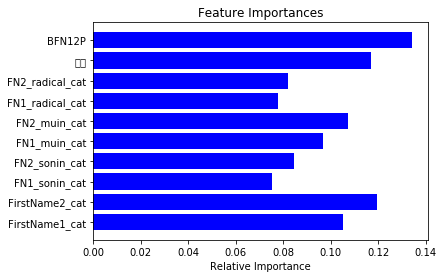

test dataset 有 96234 個名字, 48297 種名字
Train Accuracy ::  0.530332314982
Test Accuracy  ::  0.207993017021
Multi-answer Test Accuracy:: 0.5104536858075108
CPU times: user 2min 40s, sys: 452 ms, total: 2min 41s
Wall time: 2min 23s


In [107]:
%%time
x_feature = [ 'FirstName1_cat', 'FirstName2_cat',
    'FN1_sonin_cat',
       'FN2_sonin_cat', 'FN1_muin_cat', 'FN2_muin_cat', 'FN1_radical_cat',
       'FN2_radical_cat', '地格' ,'BFN12P'
            ]

y_feature = ['BirthYear']
train_x, test_x, train_y, test_y = split_dataset(df, 0.7, x_feature, y_feature)
train_index = train_x.index
test_index = test_x.index

# Create random forest classifier instance
trained_model = random_forest_classifier(train_x, train_y)
print('Finished training')

predictions = trained_model.predict(test_x)

features = x_feature
importances = trained_model.feature_importances_
#indices = np.argsort(importances)
print(importances)
plt.title('Feature Importances')
plt.barh(range(len(importances)), importances, color='b', align='center')
plt.yticks(range(len(importances)), features) ## removed [indices]
plt.xlabel('Relative Importance')
plt.show()

test_name_dict_list= get_test_name_dict_list(test_x,test_y,df.loc[test_index])
print('test dataset 有',len(test_x),'個名字,',len(test_name_dict_list),'種名字')    

accuracy=0
for index,year in enumerate(predictions):
    #print(test_x.iloc[index])
    
    #print(name)

    ##test 是不是印正確的名字
#             df_index = test_x.iloc[index].name
#             name = data_df.loc[df_index].FirstName
    #print(name)
    name = df.loc[ test_x.iloc[index].name ].FirstName
    if name in test_name_dict_list:
        if year in test_name_dict_list[name]:
            accuracy+=1
    else:
        print('wtf')
        
accuracy/=len(predictions)    
print ("Train Accuracy :: ", accuracy_score(train_y, trained_model.predict(train_x)))
print ("Test Accuracy  :: ", accuracy_score(test_y, predictions))
print('Multi-answer Test Accuracy::',accuracy)
